# **Predicting incidents** 

# Necessary libraries & datasets

First, we load all the packages that are needed for the project:

In [1]:
# Standard libraries
import datetime, warnings
import time
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.patches import ConnectionPatch
from collections import OrderedDict
from matplotlib.gridspec import GridSpec
from pprint import pprint

# Applicable sklearn libraries
from sklearn import metrics, linear_model, tree
from sklearn.feature_selection import RFE
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, GridSearchCV, KFold

# RandomForest 
from sklearn.ensemble import RandomForestRegressor 

# GradientBoostRegressor 
from sklearn.ensemble import GradientBoostingRegressor

# Adaboost
from sklearn.ensemble import AdaBoostRegressor

# XGBoost 
from xgboost import XGBRegressor

# CatBoost
from catboost import CatBoostRegressor

plt.rcParams["patch.force_edgecolor"] = True
plt.style.use('fivethirtyeight')
mpl.rc('patch', edgecolor = 'dimgray', linewidth=1)

from IPython.core.interactiveshell import InteractiveShell

InteractiveShell.ast_node_interactivity = "last_expr"
pd.options.display.max_columns = 50
%matplotlib inline
warnings.filterwarnings("ignore")

C:\Users\richa\Anaconda3\lib\site-packages\dask\dataframe\utils.py:14: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
df_kadaster = pd.read_csv('all_features.csv')
print('Dataframe dimensions:', df_kadaster.shape)
df_kadaster

Dataframe dimensions: (479, 66)


,Unnamed: 0,BuurtCode,Neighborhood,TotalResidents,Age 0-15,% age 0-15,Age 65+,%Age 65+,AverageSizeofHoushold,Population Density,Building year before 2000,Building year after 2000,woning,horeca,winkel,bedrijf_en_kantoor,kerk_en_gebedsruimte,cultuur_en_musea,medisch,bejaardenhuis_tehuis_en_bijzondere_woonfunctie,kinderdagverblijf_en_basisschool,middelbaar_en_speciaal_onderwijs,beroeps_en_wetenschappelijk_onderwijs,garage_en_parkeerplaats,nr_of_rent,...,nr_of_inspections_without_observation,industrie,sport,x,y,lon,lat,gem_gas_woning,gem_gas_woning_cor,gem_elektriciteit_woning,gem_gas_bedrijf,gem_elektriciteit_bedrijf,potent_pand_asbest,gebouwen_gebruik_gas,meer_reg_woning,meer_reg_industrie,hoge_gas_verbruik,hoge_asbest_buurt,hoge_dichtheid_buurt,industrie_buurt,industriegebied,env_effect,Supermarkt,Verzorghuizen,Museum
0,0,BU03630000,Kop Zeedijk,1110.0,45.0,4.054054,100.0,9.009009,1.4,18349,96.0,4.0,162.0,120.0,29.0,18.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,5.0,195.0,...,24.0,20.0,0.0,121824.740361,487631.554156,4.900018,52.375553,791.0,918.0,1695.0,3402.0,17082.0,19.0,1035.0,743.0,10.0,0.0,1.0,0.0,1.0,1.0,3.0,NaN,NaN,NaN
1,1,BU03630001,Oude Kerk e.o.,695.0,20.0,2.877698,70.0,10.071942,1.4,7910,87.0,13.0,101.0,43.0,24.0,73.0,0.0,3.0,0.0,0.0,1.0,0.0,0.0,1.0,150.0,...,52.0,106.0,0.0,121595.371677,487447.889546,4.896668,52.373888,732.0,850.0,1591.0,5048.0,31608.0,32.0,765.0,513.0,102.0,0.0,1.0,0.0,1.0,1.0,3.0,NaN,NaN,NaN
2,2,BU03630002,Burgwallen Oost,1645.0,90.0,5.471125,180.0,10.942249,1.4,26460,96.0,4.0,274.0,47.0,53.0,73.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,2.0,298.0,...,30.0,41.0,0.0,121736.890103,487329.844480,4.898758,52.372836,901.0,1045.0,1816.0,2571.0,12513.0,25.0,1459.0,1027.0,32.0,0.0,1.0,1.0,1.0,1.0,4.0,NaN,NaN,NaN
3,3,BU03630003,Nes e.o.,365.0,25.0,6.849315,30.0,8.219178,1.5,6883,98.0,2.0,53.0,48.0,41.0,74.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,111.0,...,33.0,12.0,0.0,121415.085604,487117.492764,4.894054,52.370908,882.0,1021.0,1745.0,4927.0,30261.0,4.0,425.0,240.0,3.0,0.0,0.0,0.0,1.0,1.0,2.0,NaN,NaN,NaN
4,4,BU03630004,BG-terrein e.o.,690.0,40.0,5.797101,80.0,11.594203,1.4,8161,100.0,0.0,97.0,18.0,8.0,10.0,0.0,1.0,0.0,0.0,0.0,0.0,5.0,1.0,97.0,...,45.0,8.0,0.0,121534.142532,487008.012912,4.895813,52.369931,954.0,1108.0,1880.0,4356.0,24764.0,0.0,515.0,367.0,4.0,0.0,0.0,0.0,1.0,1.0,2.0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
474,474,BU03639701,Gein Zuidwest,1665.0,310.0,18.618619,125.0,7.507508,1.9,9544,100.0,0.0,209.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,170.0,...,1.0,2.0,0.0,127571.049934,478601.865966,4.985137,52.294716,964.0,1118.0,2089.0,0.0,381.0,0.0,755.0,747.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN
475,475,BU03639702,Gein Noordoost,3245.0,450.0,13.867488,660.0,20.338983,2.3,5109,100.0,0.0,147.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,20.0,...,0.0,0.0,0.0,128208.920095,479088.995253,4.994448,52.299125,989.0,1147.0,3025.0,0.0,0.0,0.0,1264.0,1245.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,NaN,NaN,NaN
476,476,BU03639703,Gein Zuidoost,3355.0,510.0,15.201192,630.0,18.777943,2.0,4676,100.0,0.0,266.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,218.0,...,0.0,0.0,0.0,127916.351954,478425.038846,4.990213,52.293144,1009.0,1171.0,2458.0,0.0,0.0,0.0,1563.0,1527.0,0.0,1.0,0.0,1.0,0.0,0.0,2.0,NaN,NaN,NaN
477,477,BU03639800,Dorp Driemond,1480.0,265.0,17.905405,275.0,18.581081,2.3,5099,94.0,6.0,92.0,0.0,0.0,6.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,57.0,...,2.0,4.0,0.0,129716.746223,479805.037571,5.016499,52.305632,1120.0,1301.0,2837.0,0.0,871.0,249.0,676.0,630.0,3.0,1.0,1.0,0.0,1.0,1.0,4.0,NaN,NaN,NaN


In [3]:
df_building = pd.read_csv('building_year_set.csv').rename(columns = {'buurtnaam':'Neighborhood'})
print('Dataframe dimensions:', df_building.shape)
df_building

Dataframe dimensions: (477, 7)


,Unnamed: 0,Neighborhood,before_1940,1940-1959,1960-1979,1980-1999,after_2000
0,0,,1,0,0,1,480
1,1,AMC,0,0,0,23,14
2,2,Aalsmeerwegbuurt Oost,1224,0,0,90,16
3,3,Aalsmeerwegbuurt West,1510,2,0,0,0
4,4,Afrikahaven,0,0,0,3,102
...,...,...,...,...,...,...,...
472,472,Zuidwestkwadrant Osdorp Noord,1,0,347,84,937
473,473,Zuidwestkwadrant Osdorp Zuid,0,0,313,342,2000
474,474,Zunderdorp,29,7,51,59,80
475,475,Zwarte Gouw,0,0,16,2,16


In [4]:
df_features = pd.merge(df_kadaster, df_building, on = 'Neighborhood')
df_features

,Unnamed: 0_x,BuurtCode,Neighborhood,TotalResidents,Age 0-15,% age 0-15,Age 65+,%Age 65+,AverageSizeofHoushold,Population Density,Building year before 2000,Building year after 2000,woning,horeca,winkel,bedrijf_en_kantoor,kerk_en_gebedsruimte,cultuur_en_musea,medisch,bejaardenhuis_tehuis_en_bijzondere_woonfunctie,kinderdagverblijf_en_basisschool,middelbaar_en_speciaal_onderwijs,beroeps_en_wetenschappelijk_onderwijs,garage_en_parkeerplaats,nr_of_rent,...,lat,gem_gas_woning,gem_gas_woning_cor,gem_elektriciteit_woning,gem_gas_bedrijf,gem_elektriciteit_bedrijf,potent_pand_asbest,gebouwen_gebruik_gas,meer_reg_woning,meer_reg_industrie,hoge_gas_verbruik,hoge_asbest_buurt,hoge_dichtheid_buurt,industrie_buurt,industriegebied,env_effect,Supermarkt,Verzorghuizen,Museum,Unnamed: 0_y,before_1940,1940-1959,1960-1979,1980-1999,after_2000
0,0,BU03630000,Kop Zeedijk,1110.0,45.0,4.054054,100.0,9.009009,1.4,18349,96.0,4.0,162.0,120.0,29.0,18.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,5.0,195.0,...,52.375553,791.0,918.0,1695.0,3402.0,17082.0,19.0,1035.0,743.0,10.0,0.0,1.0,0.0,1.0,1.0,3.0,NaN,NaN,NaN,221,829,13,10,113,37
1,1,BU03630001,Oude Kerk e.o.,695.0,20.0,2.877698,70.0,10.071942,1.4,7910,87.0,13.0,101.0,43.0,24.0,73.0,0.0,3.0,0.0,0.0,1.0,0.0,0.0,1.0,150.0,...,52.373888,732.0,850.0,1591.0,5048.0,31608.0,32.0,765.0,513.0,102.0,0.0,1.0,0.0,1.0,1.0,3.0,NaN,NaN,NaN,315,648,8,29,101,101
2,2,BU03630002,Burgwallen Oost,1645.0,90.0,5.471125,180.0,10.942249,1.4,26460,96.0,4.0,274.0,47.0,53.0,73.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,2.0,298.0,...,52.372836,901.0,1045.0,1816.0,2571.0,12513.0,25.0,1459.0,1027.0,32.0,0.0,1.0,1.0,1.0,1.0,4.0,NaN,NaN,NaN,76,1290,14,23,92,40
3,3,BU03630003,Nes e.o.,365.0,25.0,6.849315,30.0,8.219178,1.5,6883,98.0,2.0,53.0,48.0,41.0,74.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,111.0,...,52.370908,882.0,1021.0,1745.0,4927.0,30261.0,4.0,425.0,240.0,3.0,0.0,0.0,0.0,1.0,1.0,2.0,NaN,NaN,NaN,272,396,0,4,33,22
4,4,BU03630004,BG-terrein e.o.,690.0,40.0,5.797101,80.0,11.594203,1.4,8161,100.0,0.0,97.0,18.0,8.0,10.0,0.0,1.0,0.0,0.0,0.0,0.0,5.0,1.0,97.0,...,52.369931,954.0,1108.0,1880.0,4356.0,24764.0,0.0,515.0,367.0,4.0,0.0,0.0,0.0,1.0,1.0,2.0,NaN,NaN,NaN,24,435,0,0,104,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
470,474,BU03639701,Gein Zuidwest,1665.0,310.0,18.618619,125.0,7.507508,1.9,9544,100.0,0.0,209.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,170.0,...,52.294716,964.0,1118.0,2089.0,0.0,381.0,0.0,755.0,747.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,161,18,0,0,744,0
471,475,BU03639702,Gein Noordoost,3245.0,450.0,13.867488,660.0,20.338983,2.3,5109,100.0,0.0,147.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,20.0,...,52.299125,989.0,1147.0,3025.0,0.0,0.0,0.0,1264.0,1245.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,NaN,NaN,NaN,158,0,0,0,1262,1
472,476,BU03639703,Gein Zuidoost,3355.0,510.0,15.201192,630.0,18.777943,2.0,4676,100.0,0.0,266.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,218.0,...,52.293144,1009.0,1171.0,2458.0,0.0,0.0,0.0,1563.0,1527.0,0.0,1.0,0.0,1.0,0.0,0.0,2.0,NaN,NaN,NaN,160,1,0,0,1561,0
473,477,BU03639800,Dorp Driemond,1480.0,265.0,17.905405,275.0,18.581081,2.3,5099,94.0,6.0,92.0,0.0,0.0,6.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,57.0,...,52.305632,1120.0,1301.0,2837.0,0.0,871.0,249.0,676.0,630.0,3.0,1.0,1.0,0.0,1.0,1.0,4.0,NaN,NaN,NaN,124,146,45,248,202,40


In [5]:
pd.set_option('display.max_rows', 73)
df_features.dtypes

Unnamed: 0_x                                        int64
BuurtCode                                          object
Neighborhood                                       object
TotalResidents                                    float64
Age 0-15                                          float64
% age 0-15                                        float64
Age 65+                                           float64
%Age 65+                                          float64
AverageSizeofHoushold                              object
Population Density                                 object
Building year before 2000                         float64
Building year after 2000                          float64
woning                                            float64
horeca                                            float64
winkel                                            float64
bedrijf_en_kantoor                                float64
kerk_en_gebedsruimte                              float64
cultuur_en_mus

___
## 1. Cleaning
___
### 1.1 Filling factor

Examining how complete the dataset is: 

In [6]:
missing_df = df_features.isnull().sum(axis = 0).reset_index()
missing_df.columns = ['variable', 'missing values']
missing_df['filling factor (%)'] = (df_features.shape[0] - missing_df['missing values'])/df_features.shape[0] * 100
missing_df.sort_values('filling factor (%)').reset_index(drop = True)
missing_df

,variable,missing values,filling factor (%)
0,Unnamed: 0_x,0,100.000000
1,BuurtCode,0,100.000000
2,Neighborhood,0,100.000000
3,TotalResidents,0,100.000000
4,Age 0-15,0,100.000000
5,% age 0-15,16,96.631579
6,Age 65+,0,100.000000
7,%Age 65+,15,96.842105
8,AverageSizeofHoushold,0,100.000000
9,Population Density,0,100.000000


As you can see, there are some missing values within the dataset, so these ones will be encoded to 0 instead of NaN. 

In [7]:
df_features = df_features.fillna(0)

missing_df = df_features.isnull().sum(axis = 0).reset_index()
missing_df.columns = ['variable', 'missing values']
missing_df['filling factor (%)'] = (df_features.shape[0] - missing_df['missing values'])/df_features.shape[0] * 100
missing_df.sort_values('filling factor (%)').reset_index(drop = True)
missing_df

,variable,missing values,filling factor (%)
0,Unnamed: 0_x,0,100.0
1,BuurtCode,0,100.0
2,Neighborhood,0,100.0
3,TotalResidents,0,100.0
4,Age 0-15,0,100.0
5,% age 0-15,0,100.0
6,Age 65+,0,100.0
7,%Age 65+,0,100.0
8,AverageSizeofHoushold,0,100.0
9,Population Density,0,100.0


In [8]:
df_features = df_features.replace('       .', np.nan)

Now everything is filled up and '       .' are converted to NaN. 

### 1.2 Data preprocessing


In [9]:
# See which features have a contribution to the "incident" and which not within the features set

corr_matrix = df_features.corr()
corr_matrix['incident'].sort_values(ascending = False)

incident                                          1.000000
TotalResidents                                    0.706040
meer_reg_woning                                   0.702646
nr_of_rent                                        0.688940
gebouwen_gebruik_gas                              0.661538
woning                                            0.646861
hoge_dichtheid_buurt                              0.605723
Age 0-15                                          0.598183
nr_of_tussengebouw                                0.588237
Age 65+                                           0.543105
nr_of_possession                                  0.529680
nr_of_hoekgebouw                                  0.405282
winkel                                            0.390832
potent_pand_asbest                                0.383408
before_1940                                       0.363600
env_effect                                        0.345748
nr_of_monuments                                   0.3138

In [10]:
df_features_clean = df_features[["TotalResidents", "% age 0-15", "%Age 65+", "AverageSizeofHoushold", "Population Density", 
                                 "Building year before 2000", "floorsize_accomodation", "env_effect", "nr_of_monuments", 
                                 "cultuur_en_musea", "incident"]].copy()
df_features_clean

,TotalResidents,% age 0-15,%Age 65+,AverageSizeofHoushold,Population Density,Building year before 2000,floorsize_accomodation,env_effect,nr_of_monuments,cultuur_en_musea,incident
0,1110.0,4.054054,9.009009,1.4,18349,96.0,1716.0,3.0,20.0,4.0,3.0
1,695.0,2.877698,10.071942,1.4,7910,87.0,117.0,3.0,23.0,3.0,8.0
2,1645.0,5.471125,10.942249,1.4,26460,96.0,86.0,4.0,12.0,2.0,8.0
3,365.0,6.849315,8.219178,1.5,6883,98.0,442.0,2.0,69.0,1.0,5.0
4,690.0,5.797101,11.594203,1.4,8161,100.0,680.0,2.0,32.0,1.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...
470,1665.0,18.618619,7.507508,1.9,9544,100.0,93.0,0.0,0.0,1.0,3.0
471,3245.0,13.867488,20.338983,2.3,5109,100.0,80.0,1.0,0.0,0.0,6.0
472,3355.0,15.201192,18.777943,2.0,4676,100.0,74.0,2.0,0.0,0.0,7.0
473,1480.0,17.905405,18.581081,2.3,5099,94.0,73.0,4.0,0.0,0.0,0.0


We also need to check if there are infinite values that need to be converted. That is something which will be done with the function below. 

In [11]:
def clean_data(df):
    assert isinstance(df, pd.DataFrame), "df needs to be a dataframe"
    df.dropna(inplace = True)
    indices = ~df.isin([np.nan, np.inf, -np.inf]).any(1)
    return df[indices].astype(np.float64)

In [12]:
df_features_clean = clean_data(df_features_clean)

In [13]:
X = df_features_clean.drop(columns = 'incident')
X[['AverageSizeofHoushold', 'Population Density']] = X[['AverageSizeofHoushold', 'Population Density']].astype(float)

y = df_features_clean.incident

___
## 2. Predicting incidents
### 2.1 Train-test split (hold-out)

In [14]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 0)

### 2.1.1 Random forest

In [15]:
start_time = time.time()

reg_rf = RandomForestRegressor()
reg_rf.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Elapsed time:  0.23601579666137695


In [16]:
y_pred = reg_rf.predict(X_test)

In [17]:
# R2 score of the model
reg_rf.score(X_train, y_train)

0.9333139114007001

In [18]:
# Prediction score between incidents from test set and predicted incidents: mean absolute errors and (root) mean squared errors
print('MAE:', metrics.mean_absolute_error(y_test, y_pred))
print('MSE:', metrics.mean_squared_error(y_test, y_pred))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

MAE: 2.0916964285714283
MSE: 9.31643482142857
RMSE: 3.052283542108854


In [19]:
feature_list = list(X_train.columns)

# Get numerical feature importances
importances = list(reg_rf.feature_importances_)

# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_list, importances)]

# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)

# Print out the feature and importances 
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances]

Variable: TotalResidents       Importance: 0.6
Variable: nr_of_monuments      Importance: 0.09
Variable: Population Density   Importance: 0.06
Variable: % age 0-15           Importance: 0.05
Variable: %Age 65+             Importance: 0.05
Variable: AverageSizeofHoushold Importance: 0.04
Variable: floorsize_accomodation Importance: 0.04
Variable: Building year before 2000 Importance: 0.03
Variable: env_effect           Importance: 0.03
Variable: cultuur_en_musea     Importance: 0.01


[None, None, None, None, None, None, None, None, None, None]

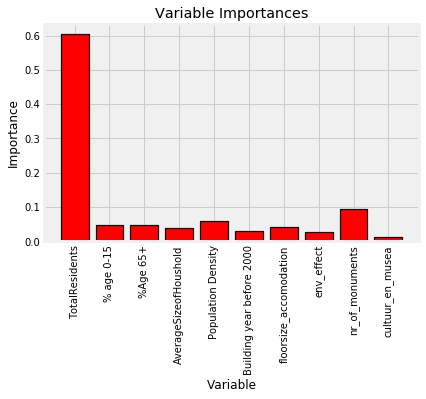

In [20]:
# list of x locations for plotting
x_values = list(range(len(importances)))

# Make a bar chart
plt.bar(x_values, importances, orientation = 'vertical', color = 'r', edgecolor = 'k', linewidth = 1.2)

# Tick labels for x axis
plt.xticks(x_values, feature_list, rotation='vertical')

# Axis labels and title
plt.ylabel('Importance'); plt.xlabel('Variable'); plt.title('Variable Importances');

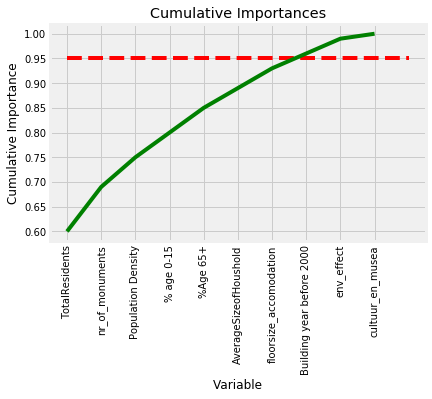

In [21]:
# List of features sorted from most to least important
sorted_importances = [importance[1] for importance in feature_importances]
sorted_features = [importance[0] for importance in feature_importances]

# Cumulative importances
cumulative_importances = np.cumsum(sorted_importances)

# Make a line graph
plt.plot(x_values, cumulative_importances, 'g-')

# Draw line at 95% of importance retained
plt.hlines(y = 0.95, xmin=0, xmax=len(sorted_importances), color = 'r', linestyles = 'dashed')

# Format x ticks and labels
plt.xticks(x_values, sorted_features, rotation = 'vertical')

# Axis labels and title
plt.xlabel('Variable'); plt.ylabel('Cumulative Importance'); plt.title('Cumulative Importances');

In [22]:
print('Number of features for 95% importance:', np.where(cumulative_importances > 0.95)[0][0] + 1)

Number of features for 95% importance: 8


In [23]:
feature_list

['TotalResidents',
 '% age 0-15',
 '%Age 65+',
 'AverageSizeofHoushold',
 'Population Density',
 'Building year before 2000',
 'floorsize_accomodation',
 'env_effect',
 'nr_of_monuments',
 'cultuur_en_musea']

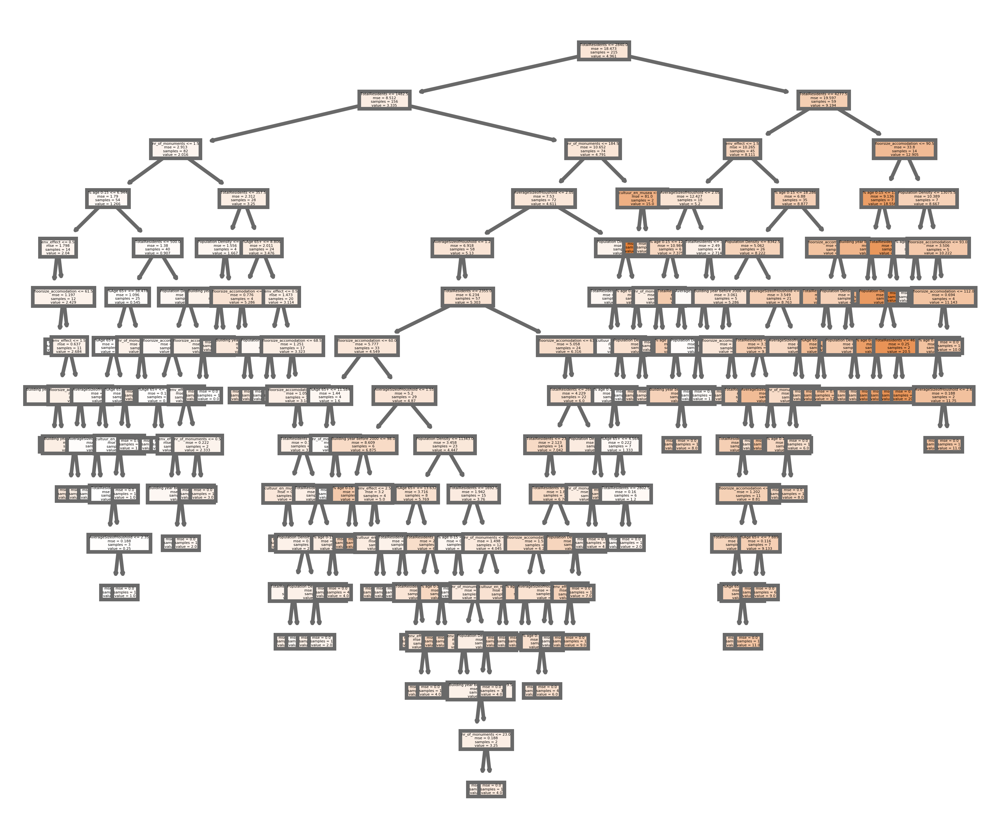

In [24]:
fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (4,4), dpi=800)
tree.plot_tree(reg_rf.estimators_[0],
               feature_names = feature_list, 
               class_names = y_test,
               filled = True);

### 2.1.2 AdaBoost

In [25]:
start_time = time.time()

reg_ada = AdaBoostRegressor()
reg_ada.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Elapsed time:  0.05401778221130371


In [26]:
y_pred = reg_ada.predict(X_test)

In [27]:
# R2 score of the model
reg_ada.score(X_train, y_train)

0.7351936552898242

In [28]:
# Prediction score between incidents from test set and predicted incidents: mean absolute errors and (root) mean squared errors
print('MAE:', metrics.mean_absolute_error(y_test, y_pred))
print('MSE:', metrics.mean_squared_error(y_test, y_pred))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

MAE: 2.467576299265066
MSE: 9.842691457619065
RMSE: 3.1373064016157337


In [29]:
# Get numerical feature importances
importances = list(reg_ada.feature_importances_)

# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_list, importances)]

# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)

# Print out the feature and importances 
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances]

Variable: TotalResidents       Importance: 0.5
Variable: nr_of_monuments      Importance: 0.2
Variable: Population Density   Importance: 0.08
Variable: AverageSizeofHoushold Importance: 0.07
Variable: floorsize_accomodation Importance: 0.05
Variable: env_effect           Importance: 0.04
Variable: cultuur_en_musea     Importance: 0.03
Variable: Building year before 2000 Importance: 0.02
Variable: % age 0-15           Importance: 0.01
Variable: %Age 65+             Importance: 0.0


[None, None, None, None, None, None, None, None, None, None]

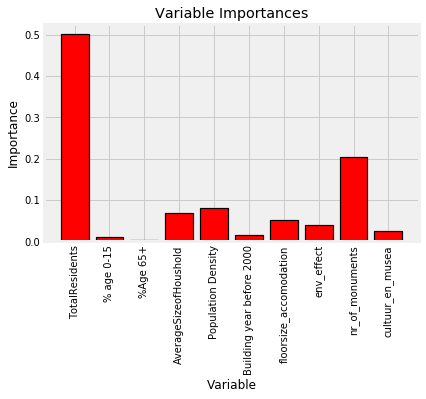

In [30]:
# list of x locations for plotting
x_values = list(range(len(importances)))

# Make a bar chart
plt.bar(x_values, importances, orientation = 'vertical', color = 'r', edgecolor = 'k', linewidth = 1.2)

# Tick labels for x axis
plt.xticks(x_values, feature_list, rotation='vertical')

# Axis labels and title
plt.ylabel('Importance'); plt.xlabel('Variable'); plt.title('Variable Importances');

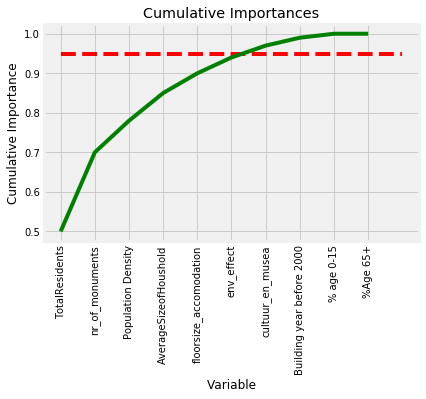

In [31]:
# List of features sorted from most to least important
sorted_importances = [importance[1] for importance in feature_importances]
sorted_features = [importance[0] for importance in feature_importances]

# Cumulative importances
cumulative_importances = np.cumsum(sorted_importances)

# Make a line graph
plt.plot(x_values, cumulative_importances, 'g-')

# Draw line at 95% of importance retained
plt.hlines(y = 0.95, xmin=0, xmax=len(sorted_importances), color = 'r', linestyles = 'dashed')

# Format x ticks and labels
plt.xticks(x_values, sorted_features, rotation = 'vertical')

# Axis labels and title
plt.xlabel('Variable'); plt.ylabel('Cumulative Importance'); plt.title('Cumulative Importances');

In [32]:
print('Number of features for 95% importance:', np.where(cumulative_importances > 0.95)[0][0] + 1)

Number of features for 95% importance: 7


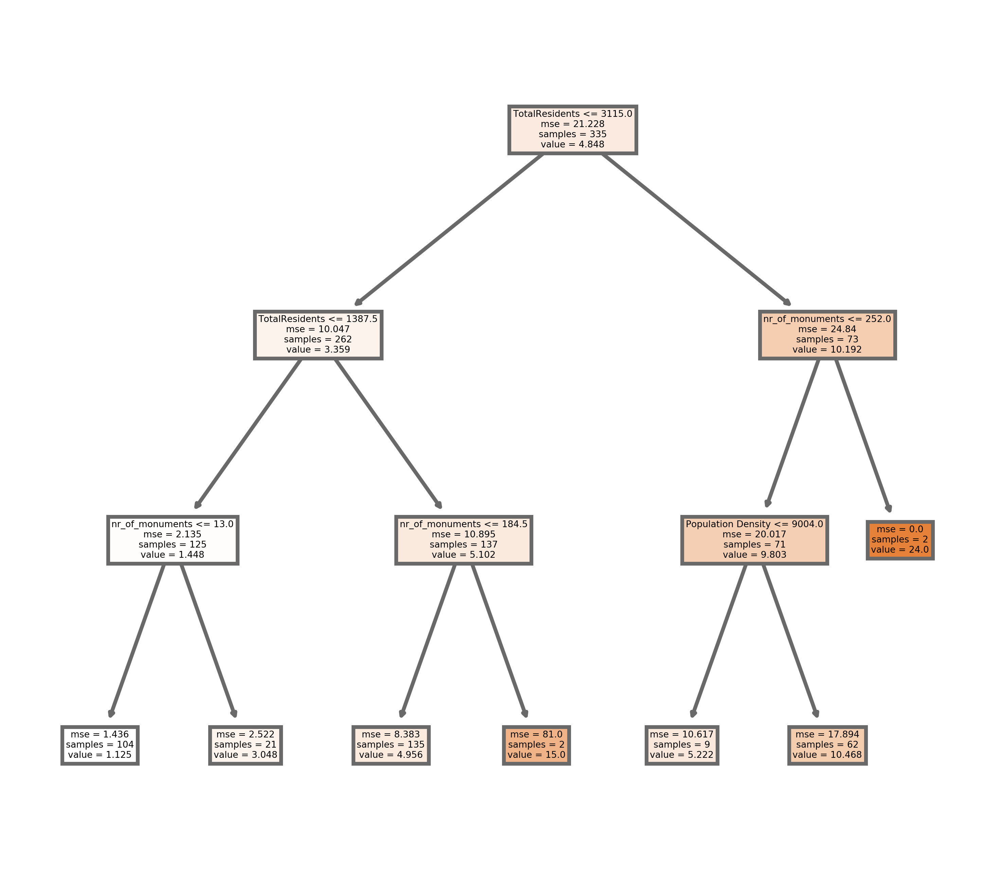

In [33]:
fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (4,4), dpi=800)
tree.plot_tree(reg_ada.estimators_[0],
               feature_names = feature_list, 
               class_names = y_test,
               filled = True);

### 2.1.3 Gradient Boosting Tree

In [34]:
start_time = time.time()

reg_gbt = GradientBoostingRegressor()
reg_gbt.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Elapsed time:  0.08999848365783691


In [35]:
y_pred = reg_gbt.predict(X_test)

In [36]:
# R2 score of the model
reg_gbt.score(X_train, y_train)

0.9200771052129882

In [37]:
# Prediction score between incidents from test set and predicted incidents: mean absolute errors and (root) mean squared errors
print('MAE:', metrics.mean_absolute_error(y_test, y_pred))
print('MSE:', metrics.mean_squared_error(y_test, y_pred))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

MAE: 2.266013231172791
MSE: 10.122118274223025
RMSE: 3.1815276635954346


As noticed from the scores above, the Gradient Boosting Tree (without tweaking the hyperparameters) makes more prediction errors in comparison to the random forest method. 

In [38]:
# Get numerical feature importances
importances = list(reg_gbt.feature_importances_)

# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_list, importances)]

# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)

# Print out the feature and importances 
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances]

Variable: TotalResidents       Importance: 0.64
Variable: nr_of_monuments      Importance: 0.11
Variable: Population Density   Importance: 0.08
Variable: %Age 65+             Importance: 0.04
Variable: AverageSizeofHoushold Importance: 0.04
Variable: % age 0-15           Importance: 0.02
Variable: Building year before 2000 Importance: 0.02
Variable: floorsize_accomodation Importance: 0.02
Variable: env_effect           Importance: 0.02
Variable: cultuur_en_musea     Importance: 0.02


[None, None, None, None, None, None, None, None, None, None]

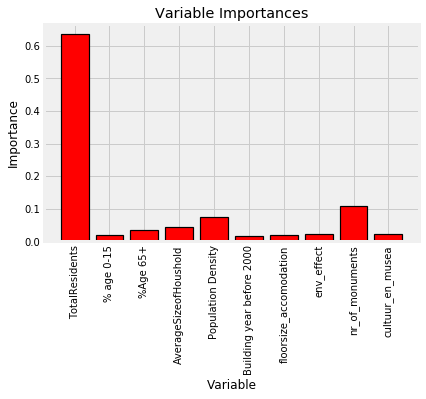

In [39]:
# list of x locations for plotting
x_values = list(range(len(importances)))

# Make a bar chart
plt.bar(x_values, importances, orientation = 'vertical', color = 'r', edgecolor = 'k', linewidth = 1.2)

# Tick labels for x axis
plt.xticks(x_values, feature_list, rotation='vertical')

# Axis labels and title
plt.ylabel('Importance'); plt.xlabel('Variable'); plt.title('Variable Importances');

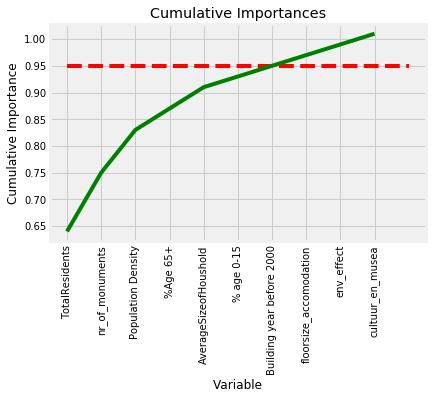

In [40]:
# List of features sorted from most to least important
sorted_importances = [importance[1] for importance in feature_importances]
sorted_features = [importance[0] for importance in feature_importances]

# Cumulative importances
cumulative_importances = np.cumsum(sorted_importances)

# Make a line graph
plt.plot(x_values, cumulative_importances, 'g-')

# Draw line at 95% of importance retained
plt.hlines(y = 0.95, xmin=0, xmax=len(sorted_importances), color = 'r', linestyles = 'dashed')

# Format x ticks and labels
plt.xticks(x_values, sorted_features, rotation = 'vertical')

# Axis labels and title
plt.xlabel('Variable'); plt.ylabel('Cumulative Importance'); plt.title('Cumulative Importances');

In [41]:
print('Number of features for 95% importance:', np.where(cumulative_importances > 0.95)[0][0] + 1)

Number of features for 95% importance: 7


### 2.1.4 XGBoost

In [42]:
start_time = time.time()

reg_xgb = XGBRegressor()
reg_xgb.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Elapsed time:  0.3130016326904297


In [43]:
y_pred = reg_xgb.predict(X_test)

In [44]:
# Worse accuracy results on the train set (generalises better than random forest), but quicker to train 

reg_xgb.score(X_train, y_train)

0.999992014524401

In [45]:
print('MAE:', metrics.mean_absolute_error(y_test, y_pred))
print('MSE:', metrics.mean_squared_error(y_test, y_pred))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

MAE: 2.251481404794114
MSE: 9.280539341978413
RMSE: 3.0463977648984732


In [46]:
# Get numerical feature importances
importances = list(reg_xgb.feature_importances_)

# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_list, importances)]

# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)

# Print out the feature and importances 
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances]

Variable: TotalResidents       Importance: 0.3199999928474426
Variable: nr_of_monuments      Importance: 0.18000000715255737
Variable: cultuur_en_musea     Importance: 0.10999999940395355
Variable: AverageSizeofHoushold Importance: 0.10000000149011612
Variable: Population Density   Importance: 0.07000000029802322
Variable: env_effect           Importance: 0.05999999865889549
Variable: % age 0-15           Importance: 0.05000000074505806
Variable: Building year before 2000 Importance: 0.03999999910593033
Variable: floorsize_accomodation Importance: 0.03999999910593033
Variable: %Age 65+             Importance: 0.029999999329447746


[None, None, None, None, None, None, None, None, None, None]

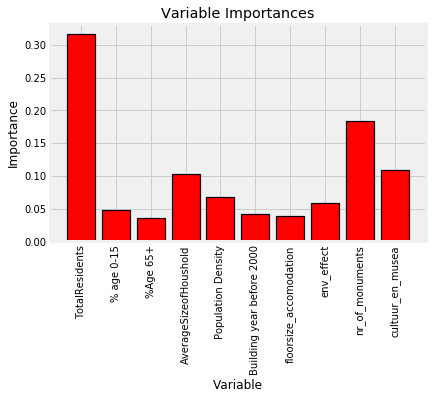

In [47]:
# list of x locations for plotting
x_values = list(range(len(importances)))

# Make a bar chart
plt.bar(x_values, importances, orientation = 'vertical', color = 'r', edgecolor = 'k', linewidth = 1.2)

# Tick labels for x axis
plt.xticks(x_values, feature_list, rotation='vertical')

# Axis labels and title
plt.ylabel('Importance'); plt.xlabel('Variable'); plt.title('Variable Importances');

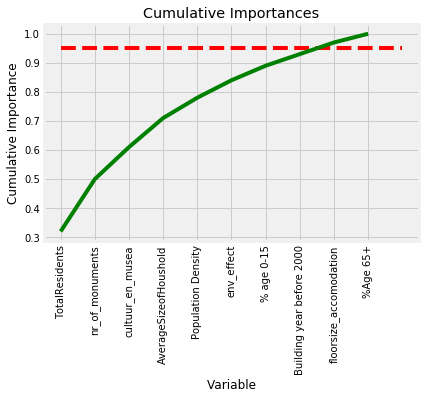

In [48]:
# List of features sorted from most to least important
sorted_importances = [importance[1] for importance in feature_importances]
sorted_features = [importance[0] for importance in feature_importances]

# Cumulative importances
cumulative_importances = np.cumsum(sorted_importances)

# Make a line graph
plt.plot(x_values, cumulative_importances, 'g-')

# Draw line at 95% of importance retained
plt.hlines(y = 0.95, xmin=0, xmax=len(sorted_importances), color = 'r', linestyles = 'dashed')

# Format x ticks and labels
plt.xticks(x_values, sorted_features, rotation = 'vertical')

# Axis labels and title
plt.xlabel('Variable'); plt.ylabel('Cumulative Importance'); plt.title('Cumulative Importances');

In [49]:
print('Number of features for 95% importance:', np.where(cumulative_importances > 0.95)[0][0] + 1)

Number of features for 95% importance: 9


### 2.1.5 CatBoost

In [50]:
start_time = time.time()

reg_cat = CatBoostRegressor()
reg_cat.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Learning rate set to 0.034446
0:	learn: 4.5572941	total: 149ms	remaining: 2m 28s
1:	learn: 4.4902587	total: 151ms	remaining: 1m 15s
2:	learn: 4.4253837	total: 153ms	remaining: 50.7s
3:	learn: 4.3662093	total: 154ms	remaining: 38.4s
4:	learn: 4.3077307	total: 155ms	remaining: 30.9s
5:	learn: 4.2523057	total: 157ms	remaining: 26s
6:	learn: 4.1981435	total: 158ms	remaining: 22.5s
7:	learn: 4.1449215	total: 160ms	remaining: 19.9s
8:	learn: 4.0947864	total: 162ms	remaining: 17.8s
9:	learn: 4.0424012	total: 163ms	remaining: 16.1s
10:	learn: 3.9904097	total: 165ms	remaining: 14.9s
11:	learn: 3.9404084	total: 169ms	remaining: 13.9s
12:	learn: 3.8986094	total: 171ms	remaining: 13s
13:	learn: 3.8506734	total: 173ms	remaining: 12.2s
14:	learn: 3.8074714	total: 174ms	remaining: 11.4s
15:	learn: 3.7655093	total: 176ms	remaining: 10.8s
16:	learn: 3.7242996	total: 177ms	remaining: 10.2s
17:	learn: 3.6907999	total: 178ms	remaining: 9.74s
18:	learn: 3.6512823	total: 180ms	remaining: 9.29s
19:	learn: 3.

173:	learn: 1.9296619	total: 447ms	remaining: 2.12s
174:	learn: 1.9244478	total: 449ms	remaining: 2.12s
175:	learn: 1.9195172	total: 453ms	remaining: 2.12s
176:	learn: 1.9162085	total: 455ms	remaining: 2.12s
177:	learn: 1.9108943	total: 458ms	remaining: 2.11s
178:	learn: 1.9056871	total: 459ms	remaining: 2.11s
179:	learn: 1.9028433	total: 461ms	remaining: 2.1s
180:	learn: 1.8996150	total: 462ms	remaining: 2.09s
181:	learn: 1.8941199	total: 464ms	remaining: 2.08s
182:	learn: 1.8893979	total: 466ms	remaining: 2.08s
183:	learn: 1.8837289	total: 469ms	remaining: 2.08s
184:	learn: 1.8781571	total: 472ms	remaining: 2.08s
185:	learn: 1.8741005	total: 476ms	remaining: 2.08s
186:	learn: 1.8716011	total: 479ms	remaining: 2.08s
187:	learn: 1.8669606	total: 481ms	remaining: 2.08s
188:	learn: 1.8618007	total: 482ms	remaining: 2.07s
189:	learn: 1.8563524	total: 484ms	remaining: 2.06s
190:	learn: 1.8516056	total: 486ms	remaining: 2.06s
191:	learn: 1.8468389	total: 487ms	remaining: 2.05s
192:	learn: 1

332:	learn: 1.3605545	total: 757ms	remaining: 1.52s
333:	learn: 1.3558884	total: 759ms	remaining: 1.51s
334:	learn: 1.3513619	total: 764ms	remaining: 1.52s
335:	learn: 1.3511755	total: 766ms	remaining: 1.51s
336:	learn: 1.3480224	total: 783ms	remaining: 1.54s
337:	learn: 1.3436670	total: 787ms	remaining: 1.54s
338:	learn: 1.3434582	total: 788ms	remaining: 1.54s
339:	learn: 1.3432431	total: 790ms	remaining: 1.53s
340:	learn: 1.3395643	total: 792ms	remaining: 1.53s
341:	learn: 1.3363055	total: 793ms	remaining: 1.53s
342:	learn: 1.3313963	total: 795ms	remaining: 1.52s
343:	learn: 1.3280072	total: 796ms	remaining: 1.52s
344:	learn: 1.3231043	total: 798ms	remaining: 1.51s
345:	learn: 1.3174684	total: 799ms	remaining: 1.51s
346:	learn: 1.3127415	total: 801ms	remaining: 1.51s
347:	learn: 1.3088121	total: 802ms	remaining: 1.5s
348:	learn: 1.3048711	total: 805ms	remaining: 1.5s
349:	learn: 1.3028531	total: 808ms	remaining: 1.5s
350:	learn: 1.3009596	total: 809ms	remaining: 1.5s
351:	learn: 1.29

495:	learn: 1.0050546	total: 1.07s	remaining: 1.08s
496:	learn: 1.0028526	total: 1.07s	remaining: 1.08s
497:	learn: 1.0024827	total: 1.07s	remaining: 1.08s
498:	learn: 1.0016069	total: 1.07s	remaining: 1.08s
499:	learn: 1.0014994	total: 1.08s	remaining: 1.08s
500:	learn: 0.9988196	total: 1.08s	remaining: 1.07s
501:	learn: 0.9973416	total: 1.08s	remaining: 1.07s
502:	learn: 0.9969337	total: 1.08s	remaining: 1.07s
503:	learn: 0.9943459	total: 1.08s	remaining: 1.07s
504:	learn: 0.9925731	total: 1.08s	remaining: 1.06s
505:	learn: 0.9898238	total: 1.09s	remaining: 1.06s
506:	learn: 0.9869264	total: 1.09s	remaining: 1.06s
507:	learn: 0.9865979	total: 1.09s	remaining: 1.06s
508:	learn: 0.9838768	total: 1.09s	remaining: 1.06s
509:	learn: 0.9817020	total: 1.1s	remaining: 1.05s
510:	learn: 0.9794396	total: 1.1s	remaining: 1.05s
511:	learn: 0.9777232	total: 1.1s	remaining: 1.05s
512:	learn: 0.9765062	total: 1.1s	remaining: 1.05s
513:	learn: 0.9763797	total: 1.1s	remaining: 1.04s
514:	learn: 0.974

665:	learn: 0.7487026	total: 1.38s	remaining: 690ms
666:	learn: 0.7480284	total: 1.38s	remaining: 688ms
667:	learn: 0.7475527	total: 1.38s	remaining: 687ms
668:	learn: 0.7468602	total: 1.38s	remaining: 685ms
669:	learn: 0.7465664	total: 1.39s	remaining: 683ms
670:	learn: 0.7443838	total: 1.39s	remaining: 681ms
671:	learn: 0.7432852	total: 1.39s	remaining: 678ms
672:	learn: 0.7416211	total: 1.39s	remaining: 676ms
673:	learn: 0.7400079	total: 1.39s	remaining: 674ms
674:	learn: 0.7388821	total: 1.39s	remaining: 671ms
675:	learn: 0.7365644	total: 1.4s	remaining: 669ms
676:	learn: 0.7350574	total: 1.4s	remaining: 667ms
677:	learn: 0.7326933	total: 1.4s	remaining: 665ms
678:	learn: 0.7322438	total: 1.4s	remaining: 663ms
679:	learn: 0.7305303	total: 1.4s	remaining: 661ms
680:	learn: 0.7291878	total: 1.41s	remaining: 659ms
681:	learn: 0.7276183	total: 1.41s	remaining: 656ms
682:	learn: 0.7267818	total: 1.41s	remaining: 654ms
683:	learn: 0.7253122	total: 1.41s	remaining: 652ms
684:	learn: 0.723

838:	learn: 0.5692554	total: 1.68s	remaining: 323ms
839:	learn: 0.5685287	total: 1.68s	remaining: 321ms
840:	learn: 0.5680014	total: 1.69s	remaining: 319ms
841:	learn: 0.5665915	total: 1.69s	remaining: 317ms
842:	learn: 0.5663825	total: 1.69s	remaining: 315ms
843:	learn: 0.5658868	total: 1.69s	remaining: 313ms
844:	learn: 0.5645705	total: 1.69s	remaining: 311ms
845:	learn: 0.5638713	total: 1.69s	remaining: 309ms
846:	learn: 0.5635644	total: 1.7s	remaining: 306ms
847:	learn: 0.5627059	total: 1.7s	remaining: 304ms
848:	learn: 0.5622020	total: 1.7s	remaining: 302ms
849:	learn: 0.5621059	total: 1.7s	remaining: 300ms
850:	learn: 0.5606734	total: 1.7s	remaining: 298ms
851:	learn: 0.5601357	total: 1.7s	remaining: 296ms
852:	learn: 0.5589957	total: 1.71s	remaining: 294ms
853:	learn: 0.5572508	total: 1.71s	remaining: 292ms
854:	learn: 0.5564752	total: 1.71s	remaining: 290ms
855:	learn: 0.5553870	total: 1.71s	remaining: 288ms
856:	learn: 0.5549258	total: 1.71s	remaining: 286ms
857:	learn: 0.5534

In [51]:
y_pred = reg_cat.predict(X_test)

In [52]:
# Worse training results, quicker to train and generalise better than random forest

reg_cat.score(X_train, y_train)

0.9907544390605402

In [53]:
print('MAE:', metrics.mean_absolute_error(y_test, y_pred))
print('MSE:', metrics.mean_squared_error(y_test, y_pred))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

MAE: 2.2038673345833746
MSE: 9.562286077231219
RMSE: 3.0922946297581704


In [54]:
# Get numerical feature importances
importances = list(reg_cat.feature_importances_)

# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_list, importances)]

# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)

# Print out the feature and importances 
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances]

Variable: TotalResidents       Importance: 40.89
Variable: Population Density   Importance: 10.72
Variable: %Age 65+             Importance: 8.32
Variable: % age 0-15           Importance: 7.72
Variable: nr_of_monuments      Importance: 7.61
Variable: floorsize_accomodation Importance: 6.51
Variable: AverageSizeofHoushold Importance: 5.94
Variable: env_effect           Importance: 5.26
Variable: Building year before 2000 Importance: 4.52
Variable: cultuur_en_musea     Importance: 2.52


[None, None, None, None, None, None, None, None, None, None]

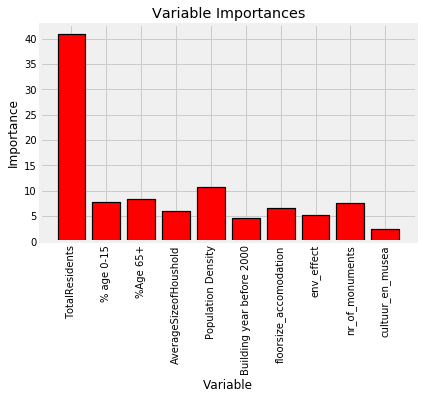

In [55]:
# list of x locations for plotting
x_values = list(range(len(importances)))

# Make a bar chart
plt.bar(x_values, importances, orientation = 'vertical', color = 'r', edgecolor = 'k', linewidth = 1.2)

# Tick labels for x axis
plt.xticks(x_values, feature_list, rotation='vertical')

# Axis labels and title
plt.ylabel('Importance'); plt.xlabel('Variable'); plt.title('Variable Importances');

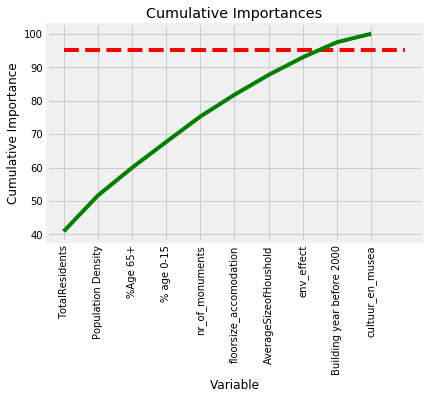

In [56]:
# List of features sorted from most to least important
sorted_importances = [importance[1] for importance in feature_importances]
sorted_features = [importance[0] for importance in feature_importances]

# Cumulative importances
cumulative_importances = np.cumsum(sorted_importances)

# Make a line graph
plt.plot(x_values, cumulative_importances, 'g-')

# Draw line at 95% of importance retained
plt.hlines(y = 95, xmin = 0, xmax = len(sorted_importances), color = 'r', linestyles = 'dashed')

# Format x ticks and labels
plt.xticks(x_values, sorted_features, rotation = 'vertical')

# Axis labels and title
plt.xlabel('Variable'); plt.ylabel('Cumulative Importance'); plt.title('Cumulative Importances');

In [57]:
print('Number of features for 95% importance:', np.where(cumulative_importances > 95)[0][0] + 1)

Number of features for 95% importance: 9


### 2.2 Using Cross-validation
### 2.2.1 Random forest

In [58]:
start_time = time.time()

fold = KFold(n_splits = 5, shuffle = True, random_state = 100)

hyper_params = [{'n_features_to_select': list(range(1, 14))}]

rf_cv = RFE(reg_rf)             

reg_rf_cv = GridSearchCV(estimator = rf_cv, 
                         param_grid = hyper_params, 
                         scoring= 'r2', 
                         cv = fold, 
                         verbose = 1,
                         return_train_score = True)      

reg_rf_cv.fit(X_train, y_train)   

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Fitting 5 folds for each of 13 candidates, totalling 65 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  65 out of  65 | elapsed:   56.2s finished


Elapsed time:  56.90264415740967


In [59]:
cv_result = pd.DataFrame(reg_rf_cv.cv_results_)
cv_result

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_features_to_select,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,1.747981,0.054066,0.007399,0.001357,1,{'n_features_to_select': 1},0.307082,0.429199,0.359414,0.054892,0.463239,0.322765,0.144504,13,0.879998,0.851142,0.897426,0.873817,0.855082,0.871493,0.016933
1,1.589092,0.026916,0.007388,0.001740,2,{'n_features_to_select': 2},0.463165,0.530331,0.546158,0.211588,0.535464,0.457341,0.126292,11,0.927931,0.924548,0.921382,0.929584,0.914874,0.923664,0.005225
2,1.446813,0.008486,0.006988,0.001656,3,{'n_features_to_select': 3},0.417585,0.557462,0.578055,0.158511,0.490249,0.440372,0.151736,12,0.924055,0.922984,0.921310,0.938802,0.924370,0.926304,0.006340
3,1.279384,0.015497,0.006824,0.001612,4,{'n_features_to_select': 4},0.388061,0.542504,0.603538,0.245440,0.525822,0.461073,0.128801,10,0.933718,0.920416,0.925651,0.942668,0.930547,0.930600,0.007531
4,1.154098,0.021091,0.007783,0.001463,5,{'n_features_to_select': 5},0.389800,0.544953,0.614837,0.252022,0.515629,0.463448,0.128382,9,0.933666,0.928893,0.926342,0.942981,0.931466,0.932670,0.005711
5,1.134475,0.137929,0.011414,0.002396,6,{'n_features_to_select': 6},0.405133,0.537871,0.637705,0.295616,0.572582,0.489781,0.123220,8,0.934003,0.925885,0.926692,0.941194,0.925619,0.930679,0.006101
6,0.822781,0.060192,0.007197,0.001472,7,{'n_features_to_select': 7},0.456853,0.566277,0.639477,0.253376,0.586616,0.500520,0.137137,7,0.934720,0.923734,0.929113,0.940075,0.935218,0.932572,0.005621
7,0.610253,0.025949,0.006420,0.000816,8,{'n_features_to_select': 8},0.475677,0.588240,0.647710,0.274642,0.605184,0.518291,0.134442,1,0.933877,0.930811,0.933252,0.941257,0.932438,0.934327,0.003614
8,0.418185,0.021614,0.007606,0.001210,9,{'n_features_to_select': 9},0.482855,0.609639,0.630680,0.282175,0.582424,0.517555,0.128135,2,0.935476,0.932160,0.927821,0.942279,0.929104,0.933368,0.005182
9,0.209833,0.009399,0.006605,0.000795,10,{'n_features_to_select': 10},0.487219,0.598743,0.595044,0.265788,0.582547,0.505868,0.126841,6,0.931241,0.933332,0.927724,0.943120,0.933309,0.933745,0.005114


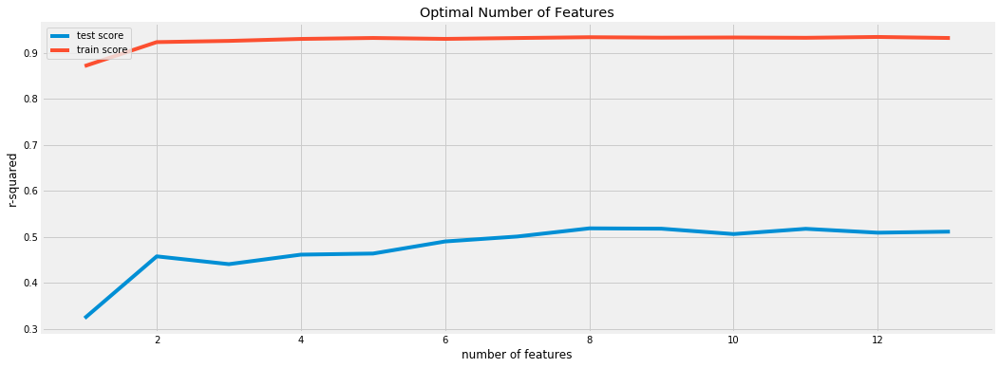

In [60]:
plt.figure(figsize=(16,6))

plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_test_score"])
plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_train_score"])
plt.xlabel('number of features')
plt.ylabel('r-squared')
plt.title("Optimal Number of Features")
plt.legend(['test score', 'train score'], loc='upper left')

Deriving from the plot, 8 features seem like the optimal value of number of feutures to build the final random forest model. Even though the model is performing pretty bad on the test set in comparison to the train set. 

In [61]:
# Final model - Random Forest

start_time = time.time()

n_optimal = 10

rfe = RFE(reg_rf, n_features_to_select = n_optimal)             
reg_rf_optima = rfe.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Elapsed time:  0.26003336906433105


In [62]:
# R2 score model with hold-out set 
print(metrics.r2_score(y_train, reg_rf.predict(X_train)))
print(metrics.r2_score(y_test, reg_rf.predict(X_test)))

0.9333139114007001
0.3800509347083415


In [63]:
# R2 score model with optimal RF model 
print(metrics.r2_score(y_train, reg_rf_optima.predict(X_train)))
print(metrics.r2_score(y_test, reg_rf_optima.predict(X_test)))

0.933191295187219
0.38118223523670103


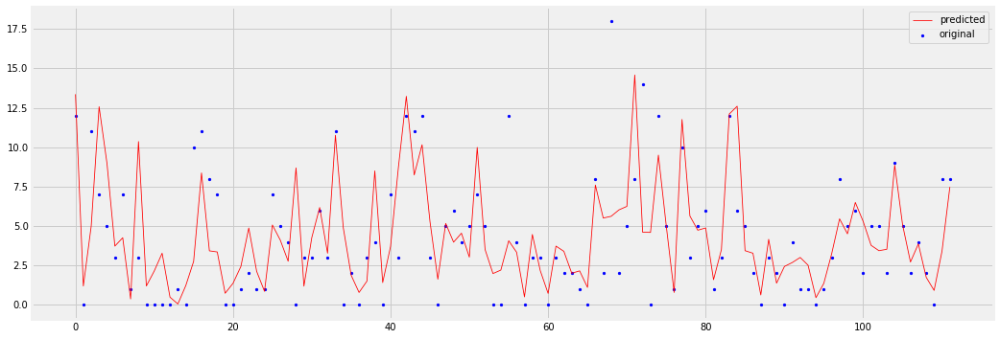

In [64]:
# Plotting performance of the optimal model (few outliers can be identified)

plt.figure(figsize=(16,6))

x_ax = range(len(y_test))
plt.scatter(x_ax, y_test, s = 5, color = "blue", label = "original")
plt.plot(x_ax, reg_rf_optima.predict(X_test), lw = 0.8, color = "red", label = "predicted")
plt.legend()
plt.show()

### 2.2.2 AdaBoost

In [65]:
start_time = time.time()

fold = KFold(n_splits = 5, shuffle = True, random_state = 100) 

hyper_params = [{'n_features_to_select': list(range(1, 14))}]

ada_cv = RFE(reg_ada)             

reg_ada_cv = GridSearchCV(estimator = ada_cv, 
                          param_grid = hyper_params,
                          scoring= 'r2',
                          cv = fold,
                          verbose = 1,
                          return_train_score = True)      

reg_ada_cv.fit(X_train, y_train)   

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Fitting 5 folds for each of 13 candidates, totalling 65 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Elapsed time:  22.8354971408844


[Parallel(n_jobs=1)]: Done  65 out of  65 | elapsed:   22.6s finished


In [66]:
cv_result = pd.DataFrame(reg_ada_cv.cv_results_)
cv_result

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_features_to_select,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.636080,0.097850,0.003597,0.001869,1,{'n_features_to_select': 1},0.401885,0.602524,0.369785,0.237666,0.510876,0.424547,0.124551,3,0.613342,0.610190,0.650413,0.655086,0.591535,0.624113,0.024585
1,0.683776,0.067674,0.004399,0.001942,2,{'n_features_to_select': 2},0.485100,0.608219,0.570317,-0.272870,0.408085,0.359770,0.323831,13,0.660592,0.702730,0.670955,0.689936,0.686620,0.682166,0.014793
2,0.563549,0.076291,0.004013,0.001417,3,{'n_features_to_select': 3},0.451112,0.609944,0.561038,-0.178660,0.537284,0.396143,0.291973,12,0.669923,0.669174,0.739780,0.743721,0.729448,0.710409,0.033688
3,0.491765,0.051480,0.004382,0.000496,4,{'n_features_to_select': 4},0.507762,0.631109,0.533572,-0.163477,0.533056,0.408404,0.289041,6,0.733008,0.742499,0.718257,0.746529,0.732764,0.734611,0.009774
4,0.493524,0.030404,0.005791,0.001715,5,{'n_features_to_select': 5},0.484918,0.623757,0.550478,-0.198064,0.526824,0.397582,0.301217,11,0.728006,0.737402,0.753732,0.751296,0.747090,0.743505,0.009545
5,0.389914,0.043217,0.005025,0.000898,6,{'n_features_to_select': 6},0.476872,0.672977,0.547756,-0.146775,0.527540,0.415674,0.288534,5,0.755536,0.741929,0.735669,0.760638,0.736460,0.746046,0.010193
6,0.321721,0.024513,0.005593,0.002340,7,{'n_features_to_select': 7},0.468596,0.612007,0.582207,-0.145277,0.504488,0.404404,0.279642,9,0.745263,0.750680,0.745684,0.763019,0.752758,0.751481,0.006444
7,0.269143,0.036459,0.005796,0.000755,8,{'n_features_to_select': 8},0.483016,0.639921,0.538109,-0.177383,0.507157,0.398164,0.292699,10,0.765359,0.759578,0.747841,0.763126,0.767520,0.760685,0.006939
8,0.173035,0.018421,0.007404,0.002227,9,{'n_features_to_select': 9},0.465243,0.628331,0.554718,-0.162358,0.552903,0.407768,0.289708,8,0.750215,0.752891,0.749348,0.784897,0.774982,0.762466,0.014654
9,0.093013,0.009102,0.005190,0.000989,10,{'n_features_to_select': 10},0.501968,0.636322,0.554869,-0.126039,0.527894,0.419003,0.276224,4,0.771768,0.751648,0.763857,0.784545,0.763935,0.767151,0.010820


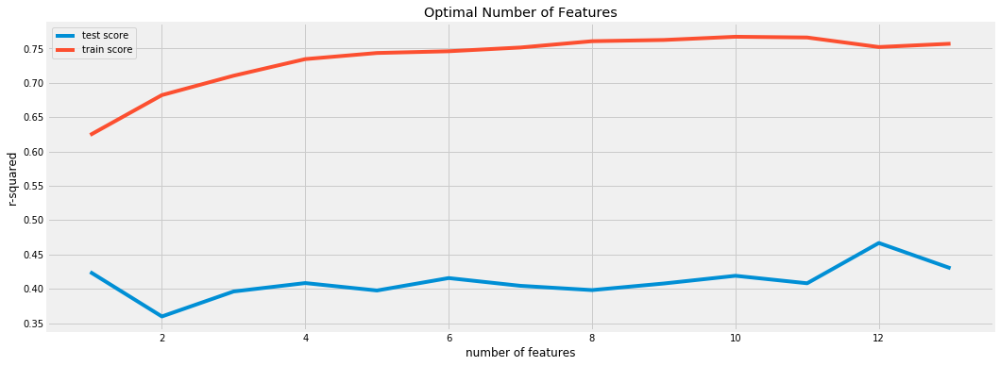

In [67]:
plt.figure(figsize=(16,6))

plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_test_score"])
plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_train_score"])
plt.xlabel('number of features')
plt.ylabel('r-squared')
plt.title("Optimal Number of Features")
plt.legend(['test score', 'train score'], loc='upper left')

Same as Random Forest, AdaBoost need to have 10 features, but after that, it degrades in performance afterwards. 

In [68]:
# Final model - AdaBoost

start_time = time.time()

n_optimal = 10

rfe = RFE(reg_ada, n_features_to_select = n_optimal)             
reg_ada_optima = rfe.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Elapsed time:  0.09703922271728516


In [69]:
# R2 score model with hold-out set 
print(metrics.r2_score(y_train, reg_ada.predict(X_train)))
print(metrics.r2_score(y_test, reg_ada.predict(X_test)))

0.7351936552898242
0.3450319262610949


In [70]:
# R2 score model with optimal Ada model 
print(metrics.r2_score(y_train, reg_ada_optima.predict(X_train)))
print(metrics.r2_score(y_test, reg_ada_optima.predict(X_test)))

0.7312334802809075
0.31411403357592493


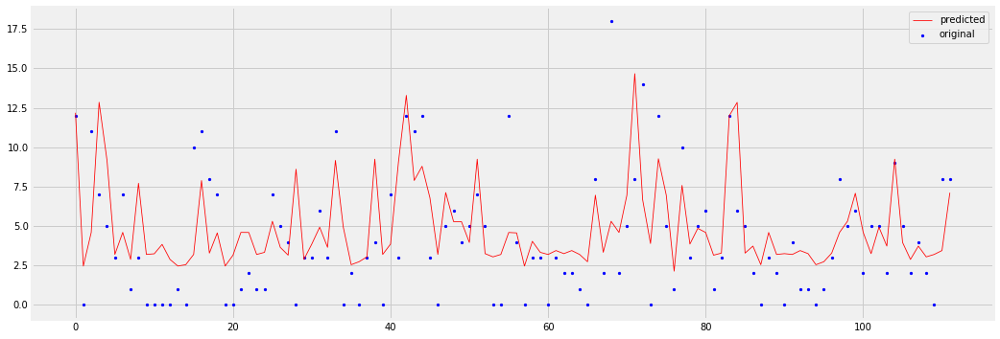

In [71]:
# The AdaBoost model seem to underfit the data

plt.figure(figsize=(16,6))

x_ax = range(len(y_test))
plt.scatter(x_ax, y_test, s = 5, color = "blue", label = "original")
plt.plot(x_ax, reg_ada_optima.predict(X_test), lw = 0.8, color = "red", label = "predicted")
plt.legend()
plt.show()

### 2.2.3 Gradient Boosting Tree

In [72]:
start_time = time.time()

fold = KFold(n_splits = 5, shuffle = True, random_state = 100) 

hyper_params = [{'n_features_to_select': list(range(1, 14))}]

gbt_cv = RFE(reg_gbt)             

reg_gbt_cv = GridSearchCV(estimator = gbt_cv, 
                          param_grid = hyper_params,
                          scoring = 'r2',
                          cv = fold,
                          verbose = 1,
                          return_train_score = True)      

reg_gbt_cv.fit(X_train, y_train)   

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Fitting 5 folds for each of 13 candidates, totalling 65 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Elapsed time:  19.402201175689697


[Parallel(n_jobs=1)]: Done  65 out of  65 | elapsed:   19.2s finished


In [73]:
cv_result = pd.DataFrame(reg_gbt_cv.cv_results_)
cv_result

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_features_to_select,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.559702,0.028523,0.002391,0.000800,1,{'n_features_to_select': 1},0.383314,0.530772,0.498637,0.095236,0.542386,0.410069,0.167187,13,0.800165,0.797125,0.822072,0.809590,0.775290,0.800848,0.015456
1,0.545482,0.038404,0.001999,0.000634,2,{'n_features_to_select': 2},0.478600,0.631042,0.591891,0.067996,0.585377,0.470981,0.207740,7,0.871696,0.861527,0.869127,0.864739,0.843908,0.862200,0.009794
2,0.487795,0.025275,0.002791,0.000983,3,{'n_features_to_select': 3},0.463439,0.575777,0.621742,0.014826,0.482393,0.431636,0.216442,11,0.884214,0.904212,0.889413,0.891019,0.895137,0.892799,0.006694
3,0.453041,0.031516,0.001979,0.000017,4,{'n_features_to_select': 4},0.425894,0.425729,0.600812,0.097605,0.519378,0.413883,0.171107,12,0.913775,0.913070,0.898938,0.907967,0.907340,0.908218,0.005317
4,0.408339,0.030822,0.003381,0.000813,5,{'n_features_to_select': 5},0.473779,0.482328,0.564244,0.143232,0.519523,0.436621,0.150138,10,0.921446,0.924062,0.913287,0.929430,0.922437,0.922132,0.005211
5,0.336385,0.011928,0.002989,0.001087,6,{'n_features_to_select': 6},0.465121,0.525598,0.550125,0.160794,0.580872,0.456502,0.152660,8,0.924750,0.931094,0.926137,0.931220,0.927420,0.928124,0.002616
6,0.291661,0.014491,0.002602,0.000488,7,{'n_features_to_select': 7},0.483935,0.521090,0.586951,0.118766,0.563180,0.454784,0.171681,9,0.937214,0.934465,0.931547,0.931869,0.942408,0.935501,0.004013
7,0.219130,0.013368,0.002195,0.000388,8,{'n_features_to_select': 8},0.501140,0.490655,0.602865,0.159533,0.619683,0.474775,0.165970,6,0.936026,0.937111,0.933179,0.937548,0.934358,0.935644,0.001653
8,0.160900,0.009547,0.002589,0.001006,9,{'n_features_to_select': 9},0.501686,0.532825,0.604265,0.136712,0.609367,0.476971,0.175065,2,0.937701,0.943626,0.934459,0.934023,0.929575,0.935877,0.004659
9,0.103118,0.010780,0.002203,0.000397,10,{'n_features_to_select': 10},0.510445,0.544696,0.612070,0.109291,0.600667,0.475434,0.186781,4,0.942050,0.939719,0.939846,0.936989,0.933742,0.938469,0.002857


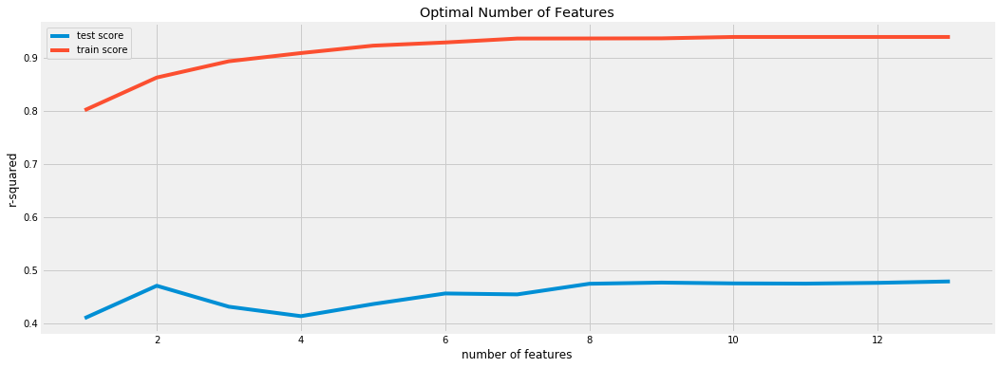

In [74]:
plt.figure(figsize=(16,6))

plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_test_score"])
plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_train_score"])
plt.xlabel('number of features')
plt.ylabel('r-squared')
plt.title("Optimal Number of Features")
plt.legend(['test score', 'train score'], loc='upper left')

In [75]:
# Final model - Gradient Boosting Tree
start_time = time.time()

n_optimal = 8

rfe = RFE(reg_gbt, n_features_to_select = n_optimal)             
reg_gbt_optima = rfe.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Elapsed time:  0.2720327377319336


In [76]:
# R2 score model with hold-out set 
print(metrics.r2_score(y_train, reg_gbt.predict(X_train)))
print(metrics.r2_score(y_test, reg_gbt.predict(X_test)))

0.9200771052129882
0.3264378613541409


In [77]:
# R2 score model with optimal Gbt model 
print(metrics.r2_score(y_train, reg_gbt_optima.predict(X_train)))
print(metrics.r2_score(y_test, reg_gbt_optima.predict(X_test)))

0.9122886648670091
0.2880281752546504


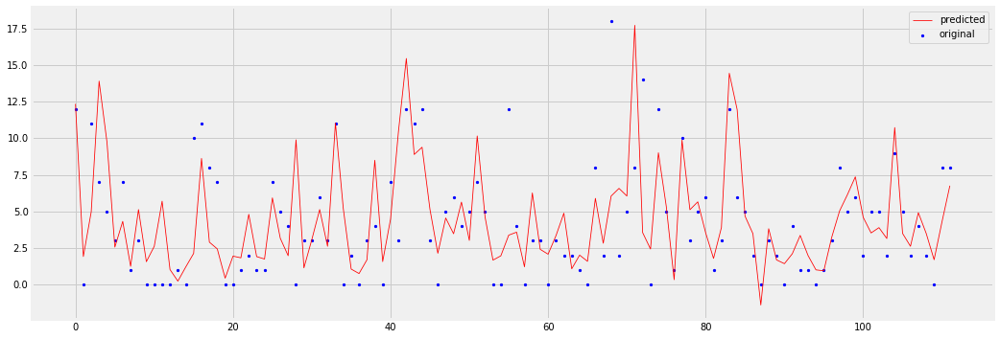

In [78]:
plt.figure(figsize=(16,6))

x_ax = range(len(y_test))
plt.scatter(x_ax, y_test, s = 5, color = "blue", label = "original")
plt.plot(x_ax, reg_gbt_optima.predict(X_test), lw = 0.8, color = "red", label = "predicted")
plt.legend()
plt.show()

### 2.2.4 XGBoost

In [79]:
start_time = time.time()

fold = KFold(n_splits = 5, shuffle = True, random_state = 100) 

hyper_params = [{'n_features_to_select': list(range(1, 14))}]

xgb_cv = RFE(reg_xgb)             

reg_xgb_cv = GridSearchCV(estimator = xgb_cv, 
                          param_grid = hyper_params,
                          scoring = 'r2',
                          cv = fold,
                          verbose = 1,
                          return_train_score = True)      

reg_xgb_cv.fit(X_train, y_train)   

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Fitting 5 folds for each of 13 candidates, totalling 65 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Elapsed time:  37.772125482559204


[Parallel(n_jobs=1)]: Done  65 out of  65 | elapsed:   37.6s finished


In [80]:
cv_result = pd.DataFrame(reg_xgb_cv.cv_results_)
cv_result

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_features_to_select,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,1.331313,0.044095,0.004199,0.000979,1,{'n_features_to_select': 1},0.165599,0.448907,0.123493,-0.189022,0.391489,0.188093,0.226402,13,0.955155,0.925249,0.968510,0.924375,0.911644,0.936987,0.021274
1,1.195994,0.052563,0.004601,0.001358,2,{'n_features_to_select': 2},0.120843,0.527639,0.433473,-0.353183,0.472621,0.240279,0.328739,12,0.969223,0.987539,0.993845,0.991938,0.987043,0.985917,0.008737
2,1.095377,0.070431,0.004602,0.001356,3,{'n_features_to_select': 3},0.180639,0.449984,0.373456,-0.234544,0.544908,0.262889,0.276032,11,0.988053,0.999123,0.999146,0.998481,0.988347,0.994630,0.005256
3,0.952732,0.037468,0.006401,0.002652,4,{'n_features_to_select': 4},0.418248,0.471150,0.433741,-0.208213,0.316396,0.286264,0.252495,10,0.999834,0.999475,0.998874,0.999530,0.998057,0.999154,0.000631
4,0.835466,0.047961,0.006199,0.002485,5,{'n_features_to_select': 5},0.445821,0.480043,0.362029,-0.128652,0.487540,0.329356,0.233294,9,0.999958,0.999740,0.999780,0.999954,0.999811,0.999849,0.000091
5,0.687838,0.050186,0.003800,0.000401,6,{'n_features_to_select': 6},0.484510,0.453181,0.463584,-0.119463,0.592423,0.374847,0.252079,8,0.999976,0.999968,0.999963,0.999986,0.999967,0.999972,0.000008
6,0.491429,0.017586,0.003202,0.000404,7,{'n_features_to_select': 7},0.445299,0.557468,0.509059,-0.099073,0.552589,0.393069,0.249343,7,0.999992,0.999997,0.999992,0.999986,0.999983,0.999990,0.000005
7,0.363281,0.030453,0.005372,0.001417,8,{'n_features_to_select': 8},0.411636,0.555543,0.564225,-0.077219,0.569973,0.404832,0.248117,5,0.999999,0.999997,0.999995,0.999992,0.999991,0.999995,0.000003
8,0.205709,0.008211,0.003800,0.001168,9,{'n_features_to_select': 9},0.409853,0.571962,0.497659,-0.076678,0.597823,0.400124,0.247209,6,0.999999,0.999999,0.999998,0.999994,0.999997,0.999997,0.000002
9,0.060802,0.001325,0.004401,0.001355,10,{'n_features_to_select': 10},0.416958,0.570472,0.517661,0.021147,0.617709,0.428789,0.214465,1,0.999999,0.999996,0.999999,0.999999,0.999996,0.999998,0.000001


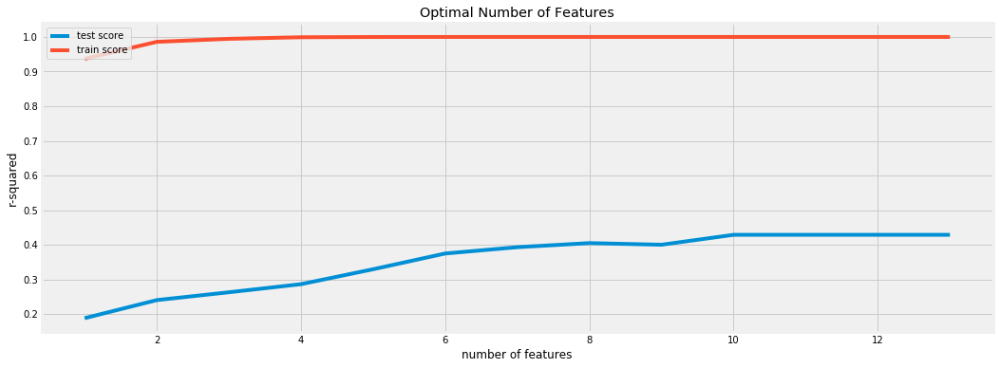

In [81]:
plt.figure(figsize = (16,6))

plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_test_score"])
plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_train_score"])
plt.xlabel('number of features')
plt.ylabel('r-squared')
plt.title("Optimal Number of Features")
plt.legend(['test score', 'train score'], loc='upper left')

In [82]:
# Final model - XGBoost
start_time = time.time()

n_optimal = 10

rfe = RFE(reg_xgb, n_features_to_select = n_optimal)             
reg_xgb_optima = rfe.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Elapsed time:  0.06600022315979004


In [83]:
# R2 score model with hold-out set 
print(metrics.r2_score(y_train, reg_xgb.predict(X_train)))
print(metrics.r2_score(y_test, reg_xgb.predict(X_test)))

0.999992014524401
0.38243954895401155


In [84]:
# R2 score model with optimal Ada model 
print(metrics.r2_score(y_train, reg_xgb_optima.predict(X_train)))
print(metrics.r2_score(y_test, reg_xgb_optima.predict(X_test)))

0.999992014524401
0.38243954895401155


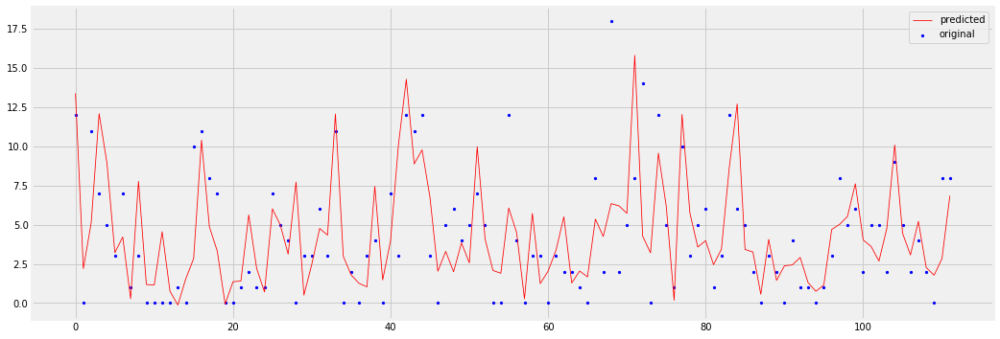

In [92]:
plt.figure(figsize = (16,6))

x_ax = range(len(y_test))
plt.scatter(x_ax, y_test, s = 5, color = "blue", label = "original")
plt.plot(x_ax, reg_xgb_optima.predict(X_test), lw = 0.8, color = "red", label = "predicted")
plt.legend()
plt.show()

### 2.2.5 CatBoost

In [85]:
start_time = time.time()

fold = KFold(n_splits = 5, shuffle = True, random_state = 100) 

hyper_params = [{'n_features_to_select': list(range(1, 14))}]

cat_cv = RFE(reg_cat)             

reg_cat_cv = GridSearchCV(estimator = cat_cv, 
                          param_grid = hyper_params,
                          scoring = 'r2',
                          cv = fold,
                          verbose = 1,
                          return_train_score = True)      

reg_cat_cv.fit(X_train, y_train)   

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Fitting 5 folds for each of 13 candidates, totalling 65 fits
Learning rate set to 0.033253
0:	learn: 4.3233381	total: 1.96ms	remaining: 1.95s
1:	learn: 4.2558863	total: 3.67ms	remaining: 1.83s
2:	learn: 4.1923927	total: 8.05ms	remaining: 2.67s
3:	learn: 4.1408067	total: 11.6ms	remaining: 2.9s
4:	learn: 4.0920662	total: 14.2ms	remaining: 2.82s
5:	learn: 4.0375908	total: 15.6ms	remaining: 2.59s
6:	learn: 3.9826475	total: 17.1ms	remaining: 2.43s
7:	learn: 3.9341773	total: 18.6ms	remaining: 2.31s
8:	learn: 3.8883683	total: 20.1ms	remaining: 2.21s
9:	learn: 3.8366270	total: 21.5ms	remaining: 2.13s
10:	learn: 3.7895540	total: 22.9ms	remaining: 2.06s
11:	learn: 3.7514314	total: 25.1ms	remaining: 2.06s
12:	learn: 3.7091128	total: 28.4ms	remaining: 2.15s
13:	learn: 3.6657312	total: 30.2ms	remaining: 2.13s
14:	learn: 3.6215135	total: 31.8ms	remaining: 2.09s
15:	learn: 3.5844467	total: 33.3ms	remaining: 2.05s
16:	learn: 3.5407414	total: 34.8ms	remaining: 2.01s
17:	learn: 3.5026775	total: 36.3ms	r

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


57:	learn: 2.5579448	total: 119ms	remaining: 1.93s
58:	learn: 2.5430328	total: 121ms	remaining: 1.93s
59:	learn: 2.5303228	total: 122ms	remaining: 1.92s
60:	learn: 2.5191292	total: 126ms	remaining: 1.94s
61:	learn: 2.5088498	total: 131ms	remaining: 1.98s
62:	learn: 2.4955794	total: 133ms	remaining: 1.98s
63:	learn: 2.4844955	total: 135ms	remaining: 1.97s
64:	learn: 2.4708783	total: 136ms	remaining: 1.96s
65:	learn: 2.4571732	total: 138ms	remaining: 1.95s
66:	learn: 2.4442052	total: 140ms	remaining: 1.94s
67:	learn: 2.4291327	total: 141ms	remaining: 1.94s
68:	learn: 2.4209018	total: 143ms	remaining: 1.92s
69:	learn: 2.4065832	total: 144ms	remaining: 1.91s
70:	learn: 2.3966226	total: 148ms	remaining: 1.93s
71:	learn: 2.3859395	total: 150ms	remaining: 1.93s
72:	learn: 2.3728319	total: 152ms	remaining: 1.93s
73:	learn: 2.3656972	total: 154ms	remaining: 1.93s
74:	learn: 2.3592707	total: 155ms	remaining: 1.92s
75:	learn: 2.3471102	total: 157ms	remaining: 1.91s
76:	learn: 2.3339256	total: 158

242:	learn: 1.4262814	total: 516ms	remaining: 1.61s
243:	learn: 1.4242159	total: 530ms	remaining: 1.64s
244:	learn: 1.4238292	total: 534ms	remaining: 1.65s
245:	learn: 1.4225091	total: 537ms	remaining: 1.65s
246:	learn: 1.4187232	total: 539ms	remaining: 1.64s
247:	learn: 1.4157594	total: 541ms	remaining: 1.64s
248:	learn: 1.4125038	total: 542ms	remaining: 1.64s
249:	learn: 1.4082899	total: 544ms	remaining: 1.63s
250:	learn: 1.4056824	total: 546ms	remaining: 1.63s
251:	learn: 1.4032600	total: 547ms	remaining: 1.63s
252:	learn: 1.4006205	total: 549ms	remaining: 1.62s
253:	learn: 1.3968462	total: 553ms	remaining: 1.62s
254:	learn: 1.3894333	total: 558ms	remaining: 1.63s
255:	learn: 1.3856172	total: 560ms	remaining: 1.63s
256:	learn: 1.3837433	total: 561ms	remaining: 1.62s
257:	learn: 1.3812136	total: 563ms	remaining: 1.62s
258:	learn: 1.3792398	total: 565ms	remaining: 1.62s
259:	learn: 1.3762395	total: 567ms	remaining: 1.61s
260:	learn: 1.3757243	total: 568ms	remaining: 1.61s
261:	learn: 

401:	learn: 0.9911378	total: 856ms	remaining: 1.27s
402:	learn: 0.9881681	total: 860ms	remaining: 1.27s
403:	learn: 0.9875857	total: 862ms	remaining: 1.27s
404:	learn: 0.9841529	total: 864ms	remaining: 1.27s
405:	learn: 0.9818934	total: 865ms	remaining: 1.27s
406:	learn: 0.9796200	total: 867ms	remaining: 1.26s
407:	learn: 0.9767379	total: 869ms	remaining: 1.26s
408:	learn: 0.9744200	total: 871ms	remaining: 1.26s
409:	learn: 0.9740164	total: 873ms	remaining: 1.26s
410:	learn: 0.9734016	total: 875ms	remaining: 1.25s
411:	learn: 0.9721244	total: 879ms	remaining: 1.25s
412:	learn: 0.9701342	total: 882ms	remaining: 1.25s
413:	learn: 0.9664297	total: 884ms	remaining: 1.25s
414:	learn: 0.9649700	total: 886ms	remaining: 1.25s
415:	learn: 0.9633913	total: 888ms	remaining: 1.25s
416:	learn: 0.9607081	total: 890ms	remaining: 1.24s
417:	learn: 0.9574672	total: 892ms	remaining: 1.24s
418:	learn: 0.9554901	total: 894ms	remaining: 1.24s
419:	learn: 0.9545648	total: 898ms	remaining: 1.24s
420:	learn: 

597:	learn: 0.6725638	total: 1.27s	remaining: 856ms
598:	learn: 0.6711696	total: 1.27s	remaining: 853ms
599:	learn: 0.6695297	total: 1.27s	remaining: 851ms
600:	learn: 0.6676890	total: 1.28s	remaining: 848ms
601:	learn: 0.6660040	total: 1.28s	remaining: 846ms
602:	learn: 0.6654170	total: 1.28s	remaining: 846ms
603:	learn: 0.6645893	total: 1.29s	remaining: 844ms
604:	learn: 0.6640375	total: 1.29s	remaining: 842ms
605:	learn: 0.6627020	total: 1.29s	remaining: 840ms
606:	learn: 0.6611680	total: 1.29s	remaining: 837ms
607:	learn: 0.6593095	total: 1.29s	remaining: 835ms
608:	learn: 0.6578099	total: 1.3s	remaining: 832ms
609:	learn: 0.6568093	total: 1.3s	remaining: 830ms
610:	learn: 0.6565361	total: 1.3s	remaining: 827ms
611:	learn: 0.6537575	total: 1.3s	remaining: 824ms
612:	learn: 0.6523812	total: 1.3s	remaining: 823ms
613:	learn: 0.6521891	total: 1.31s	remaining: 822ms
614:	learn: 0.6515462	total: 1.31s	remaining: 820ms
615:	learn: 0.6511141	total: 1.31s	remaining: 818ms
616:	learn: 0.649

755:	learn: 0.4973310	total: 1.58s	remaining: 510ms
756:	learn: 0.4954424	total: 1.58s	remaining: 507ms
757:	learn: 0.4939357	total: 1.58s	remaining: 505ms
758:	learn: 0.4932234	total: 1.58s	remaining: 503ms
759:	learn: 0.4916139	total: 1.58s	remaining: 500ms
760:	learn: 0.4902608	total: 1.59s	remaining: 499ms
761:	learn: 0.4890351	total: 1.59s	remaining: 497ms
762:	learn: 0.4872523	total: 1.59s	remaining: 495ms
763:	learn: 0.4855484	total: 1.59s	remaining: 493ms
764:	learn: 0.4849089	total: 1.6s	remaining: 490ms
765:	learn: 0.4835825	total: 1.6s	remaining: 488ms
766:	learn: 0.4830645	total: 1.6s	remaining: 486ms
767:	learn: 0.4828260	total: 1.6s	remaining: 484ms
768:	learn: 0.4823389	total: 1.6s	remaining: 482ms
769:	learn: 0.4812723	total: 1.61s	remaining: 480ms
770:	learn: 0.4793179	total: 1.61s	remaining: 478ms
771:	learn: 0.4786288	total: 1.61s	remaining: 476ms
772:	learn: 0.4782740	total: 1.61s	remaining: 474ms
773:	learn: 0.4772904	total: 1.62s	remaining: 472ms
774:	learn: 0.476

916:	learn: 0.3710092	total: 1.9s	remaining: 172ms
917:	learn: 0.3703854	total: 1.91s	remaining: 170ms
918:	learn: 0.3695001	total: 1.91s	remaining: 168ms
919:	learn: 0.3687039	total: 1.91s	remaining: 166ms
920:	learn: 0.3682003	total: 1.91s	remaining: 164ms
921:	learn: 0.3675751	total: 1.91s	remaining: 162ms
922:	learn: 0.3671087	total: 1.92s	remaining: 160ms
923:	learn: 0.3669736	total: 1.92s	remaining: 158ms
924:	learn: 0.3663438	total: 1.92s	remaining: 156ms
925:	learn: 0.3661111	total: 1.92s	remaining: 154ms
926:	learn: 0.3651848	total: 1.92s	remaining: 152ms
927:	learn: 0.3644747	total: 1.93s	remaining: 149ms
928:	learn: 0.3644002	total: 1.93s	remaining: 147ms
929:	learn: 0.3641320	total: 1.93s	remaining: 145ms
930:	learn: 0.3635449	total: 1.93s	remaining: 143ms
931:	learn: 0.3631367	total: 1.93s	remaining: 141ms
932:	learn: 0.3627591	total: 1.94s	remaining: 139ms
933:	learn: 0.3623486	total: 1.94s	remaining: 137ms
934:	learn: 0.3620542	total: 1.94s	remaining: 135ms
935:	learn: 0

94:	learn: 2.1671998	total: 242ms	remaining: 2.3s
95:	learn: 2.1541091	total: 243ms	remaining: 2.29s
96:	learn: 2.1467190	total: 245ms	remaining: 2.28s
97:	learn: 2.1387882	total: 247ms	remaining: 2.27s
98:	learn: 2.1307224	total: 249ms	remaining: 2.26s
99:	learn: 2.1244786	total: 254ms	remaining: 2.28s
100:	learn: 2.1205490	total: 257ms	remaining: 2.29s
101:	learn: 2.1151961	total: 259ms	remaining: 2.28s
102:	learn: 2.1085204	total: 261ms	remaining: 2.27s
103:	learn: 2.1047733	total: 263ms	remaining: 2.26s
104:	learn: 2.0959647	total: 265ms	remaining: 2.26s
105:	learn: 2.0870083	total: 266ms	remaining: 2.25s
106:	learn: 2.0804805	total: 268ms	remaining: 2.24s
107:	learn: 2.0756993	total: 272ms	remaining: 2.25s
108:	learn: 2.0654333	total: 278ms	remaining: 2.27s
109:	learn: 2.0594144	total: 280ms	remaining: 2.27s
110:	learn: 2.0519808	total: 282ms	remaining: 2.26s
111:	learn: 2.0444561	total: 284ms	remaining: 2.25s
112:	learn: 2.0355517	total: 285ms	remaining: 2.24s
113:	learn: 2.02732

266:	learn: 1.3576368	total: 578ms	remaining: 1.58s
267:	learn: 1.3534058	total: 581ms	remaining: 1.59s
268:	learn: 1.3525803	total: 582ms	remaining: 1.58s
269:	learn: 1.3504352	total: 584ms	remaining: 1.58s
270:	learn: 1.3484617	total: 586ms	remaining: 1.57s
271:	learn: 1.3469592	total: 587ms	remaining: 1.57s
272:	learn: 1.3458019	total: 588ms	remaining: 1.57s
273:	learn: 1.3400548	total: 590ms	remaining: 1.56s
274:	learn: 1.3381849	total: 591ms	remaining: 1.56s
275:	learn: 1.3341152	total: 594ms	remaining: 1.56s
276:	learn: 1.3314774	total: 597ms	remaining: 1.56s
277:	learn: 1.3250542	total: 599ms	remaining: 1.56s
278:	learn: 1.3242308	total: 601ms	remaining: 1.55s
279:	learn: 1.3186026	total: 603ms	remaining: 1.55s
280:	learn: 1.3152167	total: 604ms	remaining: 1.55s
281:	learn: 1.3121060	total: 606ms	remaining: 1.54s
282:	learn: 1.3085381	total: 607ms	remaining: 1.54s
283:	learn: 1.3040212	total: 609ms	remaining: 1.53s
284:	learn: 1.3002712	total: 611ms	remaining: 1.53s
285:	learn: 

431:	learn: 0.9457386	total: 906ms	remaining: 1.19s
432:	learn: 0.9433776	total: 921ms	remaining: 1.21s
433:	learn: 0.9403963	total: 925ms	remaining: 1.21s
434:	learn: 0.9386466	total: 927ms	remaining: 1.2s
435:	learn: 0.9363448	total: 928ms	remaining: 1.2s
436:	learn: 0.9356427	total: 931ms	remaining: 1.2s
437:	learn: 0.9338669	total: 932ms	remaining: 1.2s
438:	learn: 0.9326186	total: 934ms	remaining: 1.19s
439:	learn: 0.9321800	total: 935ms	remaining: 1.19s
440:	learn: 0.9310681	total: 941ms	remaining: 1.19s
441:	learn: 0.9278845	total: 945ms	remaining: 1.19s
442:	learn: 0.9265390	total: 948ms	remaining: 1.19s
443:	learn: 0.9263905	total: 950ms	remaining: 1.19s
444:	learn: 0.9244109	total: 952ms	remaining: 1.19s
445:	learn: 0.9234523	total: 953ms	remaining: 1.18s
446:	learn: 0.9219276	total: 955ms	remaining: 1.18s
447:	learn: 0.9202068	total: 957ms	remaining: 1.18s
448:	learn: 0.9174501	total: 961ms	remaining: 1.18s
449:	learn: 0.9165364	total: 965ms	remaining: 1.18s
450:	learn: 0.91

627:	learn: 0.6552376	total: 1.29s	remaining: 767ms
628:	learn: 0.6541280	total: 1.29s	remaining: 764ms
629:	learn: 0.6524872	total: 1.3s	remaining: 762ms
630:	learn: 0.6513783	total: 1.3s	remaining: 760ms
631:	learn: 0.6502891	total: 1.3s	remaining: 759ms
632:	learn: 0.6479546	total: 1.31s	remaining: 757ms
633:	learn: 0.6473698	total: 1.31s	remaining: 755ms
634:	learn: 0.6467918	total: 1.31s	remaining: 753ms
635:	learn: 0.6458872	total: 1.31s	remaining: 750ms
636:	learn: 0.6440763	total: 1.31s	remaining: 748ms
637:	learn: 0.6429060	total: 1.31s	remaining: 746ms
638:	learn: 0.6408215	total: 1.31s	remaining: 743ms
639:	learn: 0.6404205	total: 1.32s	remaining: 741ms
640:	learn: 0.6391351	total: 1.32s	remaining: 738ms
641:	learn: 0.6379157	total: 1.32s	remaining: 737ms
642:	learn: 0.6372703	total: 1.32s	remaining: 736ms
643:	learn: 0.6367716	total: 1.33s	remaining: 734ms
644:	learn: 0.6354469	total: 1.33s	remaining: 731ms
645:	learn: 0.6344489	total: 1.33s	remaining: 729ms
646:	learn: 0.6

797:	learn: 0.5070224	total: 1.6s	remaining: 404ms
798:	learn: 0.5065679	total: 1.6s	remaining: 402ms
799:	learn: 0.5064156	total: 1.6s	remaining: 400ms
800:	learn: 0.5055255	total: 1.6s	remaining: 398ms
801:	learn: 0.5039273	total: 1.6s	remaining: 396ms
802:	learn: 0.5028141	total: 1.61s	remaining: 394ms
803:	learn: 0.5026044	total: 1.61s	remaining: 392ms
804:	learn: 0.5024260	total: 1.61s	remaining: 390ms
805:	learn: 0.5013126	total: 1.61s	remaining: 388ms
806:	learn: 0.5010737	total: 1.61s	remaining: 386ms
807:	learn: 0.5002303	total: 1.61s	remaining: 384ms
808:	learn: 0.4996080	total: 1.62s	remaining: 382ms
809:	learn: 0.4989463	total: 1.62s	remaining: 379ms
810:	learn: 0.4981079	total: 1.62s	remaining: 377ms
811:	learn: 0.4975745	total: 1.62s	remaining: 375ms
812:	learn: 0.4966553	total: 1.62s	remaining: 374ms
813:	learn: 0.4965478	total: 1.63s	remaining: 372ms
814:	learn: 0.4963180	total: 1.63s	remaining: 370ms
815:	learn: 0.4961860	total: 1.63s	remaining: 368ms
816:	learn: 0.494

958:	learn: 0.3870137	total: 1.9s	remaining: 81.2ms
959:	learn: 0.3867689	total: 1.9s	remaining: 79.2ms
960:	learn: 0.3867147	total: 1.9s	remaining: 77.2ms
961:	learn: 0.3853509	total: 1.9s	remaining: 75.2ms
962:	learn: 0.3842249	total: 1.91s	remaining: 73.3ms
963:	learn: 0.3835443	total: 1.91s	remaining: 71.3ms
964:	learn: 0.3827719	total: 1.91s	remaining: 69.3ms
965:	learn: 0.3820695	total: 1.91s	remaining: 67.4ms
966:	learn: 0.3819901	total: 1.92s	remaining: 65.4ms
967:	learn: 0.3812870	total: 1.92s	remaining: 63.4ms
968:	learn: 0.3811702	total: 1.92s	remaining: 61.4ms
969:	learn: 0.3803514	total: 1.92s	remaining: 59.4ms
970:	learn: 0.3802484	total: 1.92s	remaining: 57.4ms
971:	learn: 0.3797292	total: 1.92s	remaining: 55.4ms
972:	learn: 0.3788743	total: 1.93s	remaining: 53.5ms
973:	learn: 0.3785446	total: 1.93s	remaining: 51.5ms
974:	learn: 0.3773334	total: 1.93s	remaining: 49.5ms
975:	learn: 0.3770595	total: 1.93s	remaining: 47.5ms
976:	learn: 0.3761867	total: 1.93s	remaining: 45.5

120:	learn: 2.0232706	total: 219ms	remaining: 1.59s
121:	learn: 2.0178586	total: 220ms	remaining: 1.58s
122:	learn: 2.0128376	total: 222ms	remaining: 1.59s
123:	learn: 2.0069484	total: 224ms	remaining: 1.58s
124:	learn: 1.9987815	total: 228ms	remaining: 1.59s
125:	learn: 1.9935945	total: 231ms	remaining: 1.6s
126:	learn: 1.9873076	total: 233ms	remaining: 1.6s
127:	learn: 1.9803321	total: 234ms	remaining: 1.6s
128:	learn: 1.9753476	total: 236ms	remaining: 1.59s
129:	learn: 1.9706497	total: 238ms	remaining: 1.59s
130:	learn: 1.9653690	total: 239ms	remaining: 1.59s
131:	learn: 1.9595081	total: 241ms	remaining: 1.58s
132:	learn: 1.9513679	total: 243ms	remaining: 1.58s
133:	learn: 1.9467353	total: 244ms	remaining: 1.58s
134:	learn: 1.9413405	total: 249ms	remaining: 1.59s
135:	learn: 1.9352078	total: 251ms	remaining: 1.59s
136:	learn: 1.9314303	total: 252ms	remaining: 1.59s
137:	learn: 1.9267358	total: 254ms	remaining: 1.59s
138:	learn: 1.9228257	total: 256ms	remaining: 1.59s
139:	learn: 1.9

291:	learn: 1.2986995	total: 519ms	remaining: 1.26s
292:	learn: 1.2975211	total: 520ms	remaining: 1.25s
293:	learn: 1.2968478	total: 522ms	remaining: 1.25s
294:	learn: 1.2921393	total: 524ms	remaining: 1.25s
295:	learn: 1.2915559	total: 525ms	remaining: 1.25s
296:	learn: 1.2871932	total: 529ms	remaining: 1.25s
297:	learn: 1.2851275	total: 532ms	remaining: 1.25s
298:	learn: 1.2810912	total: 534ms	remaining: 1.25s
299:	learn: 1.2785493	total: 536ms	remaining: 1.25s
300:	learn: 1.2778271	total: 537ms	remaining: 1.25s
301:	learn: 1.2732965	total: 539ms	remaining: 1.24s
302:	learn: 1.2681620	total: 540ms	remaining: 1.24s
303:	learn: 1.2648106	total: 541ms	remaining: 1.24s
304:	learn: 1.2601318	total: 543ms	remaining: 1.24s
305:	learn: 1.2579807	total: 545ms	remaining: 1.24s
306:	learn: 1.2553223	total: 548ms	remaining: 1.24s
307:	learn: 1.2548967	total: 551ms	remaining: 1.24s
308:	learn: 1.2529764	total: 553ms	remaining: 1.24s
309:	learn: 1.2483344	total: 554ms	remaining: 1.23s
310:	learn: 

459:	learn: 0.9145815	total: 819ms	remaining: 962ms
460:	learn: 0.9127626	total: 821ms	remaining: 960ms
461:	learn: 0.9101854	total: 823ms	remaining: 959ms
462:	learn: 0.9098782	total: 825ms	remaining: 957ms
463:	learn: 0.9094419	total: 828ms	remaining: 956ms
464:	learn: 0.9083853	total: 831ms	remaining: 956ms
465:	learn: 0.9053061	total: 833ms	remaining: 955ms
466:	learn: 0.9050347	total: 835ms	remaining: 953ms
467:	learn: 0.9028933	total: 836ms	remaining: 951ms
468:	learn: 0.9010140	total: 838ms	remaining: 949ms
469:	learn: 0.9000372	total: 839ms	remaining: 946ms
470:	learn: 0.8995106	total: 841ms	remaining: 944ms
471:	learn: 0.8959006	total: 842ms	remaining: 942ms
472:	learn: 0.8919990	total: 844ms	remaining: 940ms
473:	learn: 0.8895981	total: 846ms	remaining: 939ms
474:	learn: 0.8868566	total: 850ms	remaining: 939ms
475:	learn: 0.8839019	total: 854ms	remaining: 940ms
476:	learn: 0.8811620	total: 855ms	remaining: 938ms
477:	learn: 0.8798100	total: 857ms	remaining: 936ms
478:	learn: 

627:	learn: 0.6763489	total: 1.12s	remaining: 665ms
628:	learn: 0.6748916	total: 1.12s	remaining: 663ms
629:	learn: 0.6728634	total: 1.13s	remaining: 661ms
630:	learn: 0.6725532	total: 1.13s	remaining: 659ms
631:	learn: 0.6708923	total: 1.13s	remaining: 658ms
632:	learn: 0.6693431	total: 1.13s	remaining: 657ms
633:	learn: 0.6681019	total: 1.14s	remaining: 655ms
634:	learn: 0.6657338	total: 1.14s	remaining: 653ms
635:	learn: 0.6654313	total: 1.14s	remaining: 651ms
636:	learn: 0.6648230	total: 1.14s	remaining: 650ms
637:	learn: 0.6621217	total: 1.14s	remaining: 648ms
638:	learn: 0.6606516	total: 1.14s	remaining: 646ms
639:	learn: 0.6597613	total: 1.14s	remaining: 644ms
640:	learn: 0.6593927	total: 1.15s	remaining: 642ms
641:	learn: 0.6586372	total: 1.15s	remaining: 640ms
642:	learn: 0.6572035	total: 1.15s	remaining: 639ms
643:	learn: 0.6566407	total: 1.15s	remaining: 638ms
644:	learn: 0.6553313	total: 1.16s	remaining: 636ms
645:	learn: 0.6538384	total: 1.16s	remaining: 634ms
646:	learn: 

793:	learn: 0.5025096	total: 1.43s	remaining: 370ms
794:	learn: 0.5015533	total: 1.43s	remaining: 368ms
795:	learn: 0.5007649	total: 1.43s	remaining: 366ms
796:	learn: 0.4998403	total: 1.43s	remaining: 365ms
797:	learn: 0.4987582	total: 1.44s	remaining: 364ms
798:	learn: 0.4984117	total: 1.44s	remaining: 362ms
799:	learn: 0.4975480	total: 1.44s	remaining: 360ms
800:	learn: 0.4972645	total: 1.44s	remaining: 358ms
801:	learn: 0.4959885	total: 1.44s	remaining: 357ms
802:	learn: 0.4948010	total: 1.45s	remaining: 355ms
803:	learn: 0.4936393	total: 1.45s	remaining: 353ms
804:	learn: 0.4925631	total: 1.45s	remaining: 351ms
805:	learn: 0.4917008	total: 1.46s	remaining: 351ms
806:	learn: 0.4914056	total: 1.46s	remaining: 349ms
807:	learn: 0.4904165	total: 1.46s	remaining: 347ms
808:	learn: 0.4897325	total: 1.46s	remaining: 345ms
809:	learn: 0.4883073	total: 1.46s	remaining: 343ms
810:	learn: 0.4876980	total: 1.47s	remaining: 342ms
811:	learn: 0.4874131	total: 1.47s	remaining: 340ms
812:	learn: 

957:	learn: 0.3851179	total: 1.73s	remaining: 75.7ms
958:	learn: 0.3843167	total: 1.73s	remaining: 73.9ms
959:	learn: 0.3835049	total: 1.73s	remaining: 72.1ms
960:	learn: 0.3828405	total: 1.73s	remaining: 70.3ms
961:	learn: 0.3823667	total: 1.74s	remaining: 68.6ms
962:	learn: 0.3817441	total: 1.74s	remaining: 66.9ms
963:	learn: 0.3809072	total: 1.74s	remaining: 65ms
964:	learn: 0.3808617	total: 1.74s	remaining: 63.2ms
965:	learn: 0.3800558	total: 1.74s	remaining: 61.4ms
966:	learn: 0.3795135	total: 1.75s	remaining: 59.6ms
967:	learn: 0.3792371	total: 1.75s	remaining: 57.8ms
968:	learn: 0.3791358	total: 1.75s	remaining: 56ms
969:	learn: 0.3784069	total: 1.75s	remaining: 54.1ms
970:	learn: 0.3778074	total: 1.75s	remaining: 52.3ms
971:	learn: 0.3773263	total: 1.75s	remaining: 50.6ms
972:	learn: 0.3767842	total: 1.76s	remaining: 48.8ms
973:	learn: 0.3752521	total: 1.76s	remaining: 47ms
974:	learn: 0.3751735	total: 1.76s	remaining: 45.2ms
975:	learn: 0.3746884	total: 1.76s	remaining: 43.4ms

121:	learn: 2.0250016	total: 209ms	remaining: 1.51s
122:	learn: 2.0206807	total: 214ms	remaining: 1.52s
123:	learn: 2.0116455	total: 217ms	remaining: 1.53s
124:	learn: 2.0056041	total: 219ms	remaining: 1.53s
125:	learn: 2.0015999	total: 220ms	remaining: 1.53s
126:	learn: 1.9920567	total: 222ms	remaining: 1.52s
127:	learn: 1.9821234	total: 223ms	remaining: 1.52s
128:	learn: 1.9744738	total: 225ms	remaining: 1.52s
129:	learn: 1.9672933	total: 226ms	remaining: 1.51s
130:	learn: 1.9591174	total: 228ms	remaining: 1.51s
131:	learn: 1.9535099	total: 229ms	remaining: 1.5s
132:	learn: 1.9459658	total: 239ms	remaining: 1.56s
133:	learn: 1.9406740	total: 240ms	remaining: 1.55s
134:	learn: 1.9360110	total: 242ms	remaining: 1.55s
135:	learn: 1.9305045	total: 243ms	remaining: 1.54s
136:	learn: 1.9281382	total: 244ms	remaining: 1.54s
137:	learn: 1.9218980	total: 246ms	remaining: 1.53s
138:	learn: 1.9149145	total: 247ms	remaining: 1.53s
139:	learn: 1.9070298	total: 248ms	remaining: 1.52s
140:	learn: 1

286:	learn: 1.3303991	total: 509ms	remaining: 1.26s
287:	learn: 1.3276553	total: 512ms	remaining: 1.27s
288:	learn: 1.3272730	total: 515ms	remaining: 1.26s
289:	learn: 1.3252261	total: 516ms	remaining: 1.26s
290:	learn: 1.3248100	total: 518ms	remaining: 1.26s
291:	learn: 1.3228139	total: 519ms	remaining: 1.26s
292:	learn: 1.3223951	total: 520ms	remaining: 1.25s
293:	learn: 1.3184348	total: 522ms	remaining: 1.25s
294:	learn: 1.3151650	total: 524ms	remaining: 1.25s
295:	learn: 1.3141401	total: 525ms	remaining: 1.25s
296:	learn: 1.3133240	total: 526ms	remaining: 1.25s
297:	learn: 1.3084117	total: 532ms	remaining: 1.25s
298:	learn: 1.3053628	total: 534ms	remaining: 1.25s
299:	learn: 1.3039697	total: 536ms	remaining: 1.25s
300:	learn: 1.2992986	total: 537ms	remaining: 1.25s
301:	learn: 1.2988431	total: 538ms	remaining: 1.24s
302:	learn: 1.2957796	total: 540ms	remaining: 1.24s
303:	learn: 1.2931422	total: 541ms	remaining: 1.24s
304:	learn: 1.2920887	total: 542ms	remaining: 1.24s
305:	learn: 

456:	learn: 0.9398218	total: 812ms	remaining: 964ms
457:	learn: 0.9369878	total: 814ms	remaining: 963ms
458:	learn: 0.9359168	total: 816ms	remaining: 961ms
459:	learn: 0.9339500	total: 817ms	remaining: 959ms
460:	learn: 0.9327356	total: 818ms	remaining: 957ms
461:	learn: 0.9300176	total: 820ms	remaining: 955ms
462:	learn: 0.9270652	total: 822ms	remaining: 953ms
463:	learn: 0.9268919	total: 824ms	remaining: 952ms
464:	learn: 0.9248523	total: 825ms	remaining: 950ms
465:	learn: 0.9222328	total: 827ms	remaining: 948ms
466:	learn: 0.9197690	total: 831ms	remaining: 948ms
467:	learn: 0.9178574	total: 833ms	remaining: 947ms
468:	learn: 0.9172062	total: 835ms	remaining: 945ms
469:	learn: 0.9167762	total: 837ms	remaining: 943ms
470:	learn: 0.9155337	total: 838ms	remaining: 941ms
471:	learn: 0.9126907	total: 840ms	remaining: 939ms
472:	learn: 0.9119937	total: 841ms	remaining: 937ms
473:	learn: 0.9101552	total: 842ms	remaining: 935ms
474:	learn: 0.9065244	total: 844ms	remaining: 932ms
475:	learn: 

627:	learn: 0.6808159	total: 1.11s	remaining: 658ms
628:	learn: 0.6789200	total: 1.11s	remaining: 657ms
629:	learn: 0.6783562	total: 1.11s	remaining: 655ms
630:	learn: 0.6778559	total: 1.12s	remaining: 654ms
631:	learn: 0.6773459	total: 1.12s	remaining: 652ms
632:	learn: 0.6759280	total: 1.12s	remaining: 650ms
633:	learn: 0.6757110	total: 1.12s	remaining: 648ms
634:	learn: 0.6749459	total: 1.12s	remaining: 646ms
635:	learn: 0.6727374	total: 1.12s	remaining: 644ms
636:	learn: 0.6725184	total: 1.13s	remaining: 642ms
637:	learn: 0.6722641	total: 1.13s	remaining: 640ms
638:	learn: 0.6715777	total: 1.13s	remaining: 639ms
639:	learn: 0.6696970	total: 1.13s	remaining: 638ms
640:	learn: 0.6671062	total: 1.14s	remaining: 636ms
641:	learn: 0.6652115	total: 1.14s	remaining: 634ms
642:	learn: 0.6640529	total: 1.14s	remaining: 632ms
643:	learn: 0.6620419	total: 1.14s	remaining: 630ms
644:	learn: 0.6607892	total: 1.14s	remaining: 628ms
645:	learn: 0.6605048	total: 1.14s	remaining: 626ms
646:	learn: 

792:	learn: 0.5237109	total: 1.42s	remaining: 370ms
793:	learn: 0.5223550	total: 1.42s	remaining: 368ms
794:	learn: 0.5219884	total: 1.42s	remaining: 367ms
795:	learn: 0.5204803	total: 1.42s	remaining: 365ms
796:	learn: 0.5203842	total: 1.42s	remaining: 363ms
797:	learn: 0.5197906	total: 1.43s	remaining: 361ms
798:	learn: 0.5193839	total: 1.43s	remaining: 359ms
799:	learn: 0.5188842	total: 1.43s	remaining: 357ms
800:	learn: 0.5186245	total: 1.43s	remaining: 356ms
801:	learn: 0.5178166	total: 1.44s	remaining: 355ms
802:	learn: 0.5176793	total: 1.44s	remaining: 353ms
803:	learn: 0.5174338	total: 1.44s	remaining: 351ms
804:	learn: 0.5170692	total: 1.44s	remaining: 349ms
805:	learn: 0.5164653	total: 1.44s	remaining: 347ms
806:	learn: 0.5158395	total: 1.44s	remaining: 345ms
807:	learn: 0.5149217	total: 1.45s	remaining: 343ms
808:	learn: 0.5131732	total: 1.45s	remaining: 342ms
809:	learn: 0.5121423	total: 1.45s	remaining: 340ms
810:	learn: 0.5108297	total: 1.45s	remaining: 338ms
811:	learn: 

997:	learn: 0.3705839	total: 1.8s	remaining: 3.62ms
998:	learn: 0.3699585	total: 1.81s	remaining: 1.81ms
999:	learn: 0.3695185	total: 1.81s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.3136193	total: 1.69ms	remaining: 1.68s
1:	learn: 4.2604657	total: 3.16ms	remaining: 1.58s
2:	learn: 4.2035305	total: 4.45ms	remaining: 1.48s
3:	learn: 4.1504319	total: 5.84ms	remaining: 1.45s
4:	learn: 4.1011317	total: 9.63ms	remaining: 1.92s
5:	learn: 4.0503852	total: 12.2ms	remaining: 2.02s
6:	learn: 4.0060125	total: 13.9ms	remaining: 1.97s
7:	learn: 3.9609909	total: 15.6ms	remaining: 1.93s
8:	learn: 3.9197548	total: 17.6ms	remaining: 1.94s
9:	learn: 3.8728150	total: 19.4ms	remaining: 1.92s
10:	learn: 3.8302992	total: 20.8ms	remaining: 1.87s
11:	learn: 3.7808141	total: 22.2ms	remaining: 1.82s
12:	learn: 3.7452012	total: 23.4ms	remaining: 1.78s
13:	learn: 3.7012874	total: 24.6ms	remaining: 1.73s
14:	learn: 3.6587999	total: 25.9ms	remaining: 1.7s
15:	learn: 3.6249731	total: 31.7ms	remaining: 

173:	learn: 1.7692602	total: 294ms	remaining: 1.4s
174:	learn: 1.7647633	total: 296ms	remaining: 1.39s
175:	learn: 1.7611990	total: 297ms	remaining: 1.39s
176:	learn: 1.7537277	total: 298ms	remaining: 1.39s
177:	learn: 1.7495140	total: 300ms	remaining: 1.38s
178:	learn: 1.7438321	total: 301ms	remaining: 1.38s
179:	learn: 1.7378996	total: 302ms	remaining: 1.38s
180:	learn: 1.7308053	total: 303ms	remaining: 1.37s
181:	learn: 1.7264646	total: 305ms	remaining: 1.37s
182:	learn: 1.7198086	total: 308ms	remaining: 1.37s
183:	learn: 1.7143844	total: 310ms	remaining: 1.38s
184:	learn: 1.7095716	total: 312ms	remaining: 1.37s
185:	learn: 1.7043230	total: 314ms	remaining: 1.37s
186:	learn: 1.6994288	total: 316ms	remaining: 1.37s
187:	learn: 1.6945899	total: 317ms	remaining: 1.37s
188:	learn: 1.6916531	total: 319ms	remaining: 1.37s
189:	learn: 1.6876278	total: 320ms	remaining: 1.36s
190:	learn: 1.6839893	total: 321ms	remaining: 1.36s
191:	learn: 1.6765484	total: 323ms	remaining: 1.36s
192:	learn: 1

331:	learn: 1.2010561	total: 556ms	remaining: 1.12s
332:	learn: 1.1990780	total: 557ms	remaining: 1.12s
333:	learn: 1.1980830	total: 558ms	remaining: 1.11s
334:	learn: 1.1939718	total: 560ms	remaining: 1.11s
335:	learn: 1.1910606	total: 561ms	remaining: 1.11s
336:	learn: 1.1905871	total: 562ms	remaining: 1.1s
337:	learn: 1.1889058	total: 564ms	remaining: 1.1s
338:	learn: 1.1869979	total: 565ms	remaining: 1.1s
339:	learn: 1.1866184	total: 570ms	remaining: 1.1s
340:	learn: 1.1830565	total: 571ms	remaining: 1.1s
341:	learn: 1.1786760	total: 574ms	remaining: 1.1s
342:	learn: 1.1748770	total: 575ms	remaining: 1.1s
343:	learn: 1.1723820	total: 577ms	remaining: 1.1s
344:	learn: 1.1704168	total: 578ms	remaining: 1.1s
345:	learn: 1.1682622	total: 579ms	remaining: 1.09s
346:	learn: 1.1669188	total: 580ms	remaining: 1.09s
347:	learn: 1.1646261	total: 582ms	remaining: 1.09s
348:	learn: 1.1619869	total: 584ms	remaining: 1.09s
349:	learn: 1.1613028	total: 585ms	remaining: 1.09s
350:	learn: 1.1597443

509:	learn: 0.8733086	total: 855ms	remaining: 821ms
510:	learn: 0.8729943	total: 857ms	remaining: 820ms
511:	learn: 0.8727580	total: 858ms	remaining: 818ms
512:	learn: 0.8704671	total: 860ms	remaining: 816ms
513:	learn: 0.8701902	total: 861ms	remaining: 814ms
514:	learn: 0.8698995	total: 862ms	remaining: 812ms
515:	learn: 0.8696337	total: 864ms	remaining: 810ms
516:	learn: 0.8685950	total: 865ms	remaining: 808ms
517:	learn: 0.8684032	total: 869ms	remaining: 808ms
518:	learn: 0.8669152	total: 871ms	remaining: 807ms
519:	learn: 0.8666625	total: 873ms	remaining: 806ms
520:	learn: 0.8647338	total: 875ms	remaining: 805ms
521:	learn: 0.8644375	total: 877ms	remaining: 803ms
522:	learn: 0.8643054	total: 878ms	remaining: 801ms
523:	learn: 0.8626446	total: 879ms	remaining: 799ms
524:	learn: 0.8597284	total: 881ms	remaining: 797ms
525:	learn: 0.8581292	total: 882ms	remaining: 795ms
526:	learn: 0.8575540	total: 883ms	remaining: 793ms
527:	learn: 0.8566564	total: 884ms	remaining: 791ms
528:	learn: 

671:	learn: 0.6864712	total: 1.16s	remaining: 565ms
672:	learn: 0.6858858	total: 1.16s	remaining: 563ms
673:	learn: 0.6847002	total: 1.16s	remaining: 561ms
674:	learn: 0.6839681	total: 1.16s	remaining: 560ms
675:	learn: 0.6833176	total: 1.16s	remaining: 558ms
676:	learn: 0.6817465	total: 1.16s	remaining: 556ms
677:	learn: 0.6806927	total: 1.17s	remaining: 554ms
678:	learn: 0.6800517	total: 1.17s	remaining: 552ms
679:	learn: 0.6798943	total: 1.17s	remaining: 552ms
680:	learn: 0.6789854	total: 1.18s	remaining: 551ms
681:	learn: 0.6782652	total: 1.18s	remaining: 549ms
682:	learn: 0.6777559	total: 1.18s	remaining: 547ms
683:	learn: 0.6766218	total: 1.18s	remaining: 545ms
684:	learn: 0.6744452	total: 1.18s	remaining: 543ms
685:	learn: 0.6737359	total: 1.18s	remaining: 541ms
686:	learn: 0.6723748	total: 1.18s	remaining: 539ms
687:	learn: 0.6704307	total: 1.19s	remaining: 537ms
688:	learn: 0.6698224	total: 1.19s	remaining: 536ms
689:	learn: 0.6681086	total: 1.19s	remaining: 534ms
690:	learn: 

850:	learn: 0.5171958	total: 1.46s	remaining: 255ms
851:	learn: 0.5166496	total: 1.46s	remaining: 253ms
852:	learn: 0.5159349	total: 1.46s	remaining: 252ms
853:	learn: 0.5145311	total: 1.46s	remaining: 250ms
854:	learn: 0.5134784	total: 1.46s	remaining: 248ms
855:	learn: 0.5130404	total: 1.46s	remaining: 246ms
856:	learn: 0.5125815	total: 1.47s	remaining: 245ms
857:	learn: 0.5117664	total: 1.47s	remaining: 243ms
858:	learn: 0.5113895	total: 1.47s	remaining: 242ms
859:	learn: 0.5098779	total: 1.47s	remaining: 240ms
860:	learn: 0.5088022	total: 1.47s	remaining: 238ms
861:	learn: 0.5081411	total: 1.48s	remaining: 236ms
862:	learn: 0.5079138	total: 1.48s	remaining: 235ms
863:	learn: 0.5075026	total: 1.48s	remaining: 233ms
864:	learn: 0.5067256	total: 1.48s	remaining: 231ms
865:	learn: 0.5059894	total: 1.48s	remaining: 229ms
866:	learn: 0.5052683	total: 1.48s	remaining: 227ms
867:	learn: 0.5049443	total: 1.48s	remaining: 226ms
868:	learn: 0.5043017	total: 1.49s	remaining: 224ms
869:	learn: 

27:	learn: 3.1693589	total: 55.6ms	remaining: 1.93s
28:	learn: 3.1413756	total: 57ms	remaining: 1.91s
29:	learn: 3.1168192	total: 58.5ms	remaining: 1.89s
30:	learn: 3.0926434	total: 59.7ms	remaining: 1.87s
31:	learn: 3.0722473	total: 61ms	remaining: 1.84s
32:	learn: 3.0488266	total: 62.2ms	remaining: 1.82s
33:	learn: 3.0264653	total: 63.6ms	remaining: 1.81s
34:	learn: 3.0042216	total: 64.8ms	remaining: 1.78s
35:	learn: 2.9866570	total: 66ms	remaining: 1.77s
36:	learn: 2.9648039	total: 68.2ms	remaining: 1.77s
37:	learn: 2.9476106	total: 71.2ms	remaining: 1.8s
38:	learn: 2.9271896	total: 74.1ms	remaining: 1.83s
39:	learn: 2.9115082	total: 75.8ms	remaining: 1.82s
40:	learn: 2.8893094	total: 77.3ms	remaining: 1.81s
41:	learn: 2.8691838	total: 78.5ms	remaining: 1.79s
42:	learn: 2.8513291	total: 80ms	remaining: 1.78s
43:	learn: 2.8347486	total: 81.3ms	remaining: 1.77s
44:	learn: 2.8202494	total: 82.6ms	remaining: 1.75s
45:	learn: 2.7988723	total: 84ms	remaining: 1.74s
46:	learn: 2.7842741	to

205:	learn: 1.6746418	total: 359ms	remaining: 1.39s
206:	learn: 1.6708083	total: 361ms	remaining: 1.38s
207:	learn: 1.6654605	total: 362ms	remaining: 1.38s
208:	learn: 1.6620973	total: 364ms	remaining: 1.38s
209:	learn: 1.6578877	total: 365ms	remaining: 1.37s
210:	learn: 1.6564180	total: 367ms	remaining: 1.37s
211:	learn: 1.6531694	total: 368ms	remaining: 1.37s
212:	learn: 1.6524345	total: 371ms	remaining: 1.37s
213:	learn: 1.6483982	total: 374ms	remaining: 1.37s
214:	learn: 1.6428858	total: 376ms	remaining: 1.37s
215:	learn: 1.6417805	total: 378ms	remaining: 1.37s
216:	learn: 1.6366662	total: 380ms	remaining: 1.37s
217:	learn: 1.6308160	total: 381ms	remaining: 1.37s
218:	learn: 1.6258022	total: 383ms	remaining: 1.36s
219:	learn: 1.6211308	total: 384ms	remaining: 1.36s
220:	learn: 1.6179699	total: 386ms	remaining: 1.36s
221:	learn: 1.6171265	total: 387ms	remaining: 1.35s
222:	learn: 1.6120603	total: 388ms	remaining: 1.35s
223:	learn: 1.6082128	total: 392ms	remaining: 1.36s
224:	learn: 

365:	learn: 1.2346234	total: 620ms	remaining: 1.07s
366:	learn: 1.2330486	total: 621ms	remaining: 1.07s
367:	learn: 1.2315771	total: 623ms	remaining: 1.07s
368:	learn: 1.2281700	total: 624ms	remaining: 1.07s
369:	learn: 1.2259811	total: 626ms	remaining: 1.06s
370:	learn: 1.2229137	total: 627ms	remaining: 1.06s
371:	learn: 1.2200150	total: 628ms	remaining: 1.06s
372:	learn: 1.2167752	total: 631ms	remaining: 1.06s
373:	learn: 1.2144076	total: 633ms	remaining: 1.06s
374:	learn: 1.2138362	total: 636ms	remaining: 1.06s
375:	learn: 1.2125362	total: 638ms	remaining: 1.06s
376:	learn: 1.2097513	total: 640ms	remaining: 1.06s
377:	learn: 1.2091168	total: 641ms	remaining: 1.05s
378:	learn: 1.2081052	total: 642ms	remaining: 1.05s
379:	learn: 1.2049298	total: 644ms	remaining: 1.05s
380:	learn: 1.2029887	total: 645ms	remaining: 1.05s
381:	learn: 1.2013483	total: 646ms	remaining: 1.04s
382:	learn: 1.1987343	total: 648ms	remaining: 1.04s
383:	learn: 1.1953835	total: 649ms	remaining: 1.04s
384:	learn: 

552:	learn: 0.9275334	total: 918ms	remaining: 742ms
553:	learn: 0.9267238	total: 920ms	remaining: 741ms
554:	learn: 0.9244542	total: 922ms	remaining: 739ms
555:	learn: 0.9231052	total: 923ms	remaining: 737ms
556:	learn: 0.9221641	total: 925ms	remaining: 735ms
557:	learn: 0.9212207	total: 926ms	remaining: 733ms
558:	learn: 0.9210554	total: 928ms	remaining: 732ms
559:	learn: 0.9190606	total: 932ms	remaining: 732ms
560:	learn: 0.9163879	total: 934ms	remaining: 731ms
561:	learn: 0.9154645	total: 936ms	remaining: 729ms
562:	learn: 0.9148809	total: 937ms	remaining: 727ms
563:	learn: 0.9139832	total: 939ms	remaining: 726ms
564:	learn: 0.9119342	total: 940ms	remaining: 724ms
565:	learn: 0.9116080	total: 942ms	remaining: 722ms
566:	learn: 0.9114147	total: 943ms	remaining: 720ms
567:	learn: 0.9098279	total: 945ms	remaining: 719ms
568:	learn: 0.9094931	total: 946ms	remaining: 717ms
569:	learn: 0.9075594	total: 952ms	remaining: 718ms
570:	learn: 0.9073880	total: 954ms	remaining: 717ms
571:	learn: 

743:	learn: 0.7034110	total: 1.36s	remaining: 469ms
744:	learn: 0.7017882	total: 1.36s	remaining: 467ms
745:	learn: 0.7010567	total: 1.37s	remaining: 465ms
746:	learn: 0.7006818	total: 1.37s	remaining: 463ms
747:	learn: 0.6999186	total: 1.37s	remaining: 461ms
748:	learn: 0.6986180	total: 1.37s	remaining: 459ms
749:	learn: 0.6973728	total: 1.37s	remaining: 457ms
750:	learn: 0.6964630	total: 1.37s	remaining: 455ms
751:	learn: 0.6953463	total: 1.37s	remaining: 453ms
752:	learn: 0.6951429	total: 1.38s	remaining: 452ms
753:	learn: 0.6944627	total: 1.38s	remaining: 451ms
754:	learn: 0.6942845	total: 1.38s	remaining: 449ms
755:	learn: 0.6931554	total: 1.39s	remaining: 447ms
756:	learn: 0.6918693	total: 1.39s	remaining: 445ms
757:	learn: 0.6908176	total: 1.39s	remaining: 444ms
758:	learn: 0.6901492	total: 1.39s	remaining: 442ms
759:	learn: 0.6887006	total: 1.39s	remaining: 440ms
760:	learn: 0.6871431	total: 1.39s	remaining: 438ms
761:	learn: 0.6866821	total: 1.4s	remaining: 437ms
762:	learn: 0

902:	learn: 0.5652819	total: 1.66s	remaining: 178ms
903:	learn: 0.5646946	total: 1.66s	remaining: 177ms
904:	learn: 0.5642582	total: 1.66s	remaining: 175ms
905:	learn: 0.5641674	total: 1.67s	remaining: 173ms
906:	learn: 0.5634141	total: 1.67s	remaining: 171ms
907:	learn: 0.5622104	total: 1.67s	remaining: 169ms
908:	learn: 0.5613111	total: 1.67s	remaining: 167ms
909:	learn: 0.5599064	total: 1.67s	remaining: 165ms
910:	learn: 0.5587217	total: 1.67s	remaining: 163ms
911:	learn: 0.5575868	total: 1.68s	remaining: 162ms
912:	learn: 0.5564190	total: 1.68s	remaining: 160ms
913:	learn: 0.5558880	total: 1.68s	remaining: 158ms
914:	learn: 0.5551802	total: 1.68s	remaining: 156ms
915:	learn: 0.5547356	total: 1.69s	remaining: 155ms
916:	learn: 0.5544086	total: 1.69s	remaining: 153ms
917:	learn: 0.5539776	total: 1.69s	remaining: 151ms
918:	learn: 0.5527001	total: 1.69s	remaining: 149ms
919:	learn: 0.5511145	total: 1.69s	remaining: 147ms
920:	learn: 0.5506433	total: 1.7s	remaining: 146ms
921:	learn: 0

63:	learn: 2.5699689	total: 107ms	remaining: 1.57s
64:	learn: 2.5582444	total: 110ms	remaining: 1.59s
65:	learn: 2.5474355	total: 112ms	remaining: 1.59s
66:	learn: 2.5383187	total: 114ms	remaining: 1.58s
67:	learn: 2.5287278	total: 115ms	remaining: 1.58s
68:	learn: 2.5203510	total: 117ms	remaining: 1.57s
69:	learn: 2.5111330	total: 118ms	remaining: 1.57s
70:	learn: 2.5039249	total: 119ms	remaining: 1.56s
71:	learn: 2.4947385	total: 121ms	remaining: 1.56s
72:	learn: 2.4858673	total: 122ms	remaining: 1.55s
73:	learn: 2.4768648	total: 123ms	remaining: 1.54s
74:	learn: 2.4678870	total: 125ms	remaining: 1.54s
75:	learn: 2.4627001	total: 127ms	remaining: 1.54s
76:	learn: 2.4532084	total: 129ms	remaining: 1.55s
77:	learn: 2.4445670	total: 131ms	remaining: 1.55s
78:	learn: 2.4381217	total: 133ms	remaining: 1.55s
79:	learn: 2.4283101	total: 134ms	remaining: 1.54s
80:	learn: 2.4179447	total: 136ms	remaining: 1.54s
81:	learn: 2.4107968	total: 137ms	remaining: 1.53s
82:	learn: 2.3996139	total: 138

242:	learn: 1.6957775	total: 406ms	remaining: 1.26s
243:	learn: 1.6948641	total: 409ms	remaining: 1.27s
244:	learn: 1.6912305	total: 411ms	remaining: 1.27s
245:	learn: 1.6902389	total: 413ms	remaining: 1.26s
246:	learn: 1.6883663	total: 414ms	remaining: 1.26s
247:	learn: 1.6870398	total: 415ms	remaining: 1.26s
248:	learn: 1.6815662	total: 417ms	remaining: 1.26s
249:	learn: 1.6785363	total: 418ms	remaining: 1.25s
250:	learn: 1.6750214	total: 419ms	remaining: 1.25s
251:	learn: 1.6740015	total: 421ms	remaining: 1.25s
252:	learn: 1.6698999	total: 422ms	remaining: 1.25s
253:	learn: 1.6655607	total: 423ms	remaining: 1.24s
254:	learn: 1.6600289	total: 426ms	remaining: 1.24s
255:	learn: 1.6571733	total: 430ms	remaining: 1.25s
256:	learn: 1.6561590	total: 432ms	remaining: 1.25s
257:	learn: 1.6534967	total: 433ms	remaining: 1.25s
258:	learn: 1.6509190	total: 435ms	remaining: 1.24s
259:	learn: 1.6480632	total: 436ms	remaining: 1.24s
260:	learn: 1.6471868	total: 438ms	remaining: 1.24s
261:	learn: 

412:	learn: 1.3262475	total: 736ms	remaining: 1.04s
413:	learn: 1.3236894	total: 740ms	remaining: 1.05s
414:	learn: 1.3234771	total: 743ms	remaining: 1.05s
415:	learn: 1.3223737	total: 744ms	remaining: 1.04s
416:	learn: 1.3187974	total: 746ms	remaining: 1.04s
417:	learn: 1.3171097	total: 747ms	remaining: 1.04s
418:	learn: 1.3157084	total: 748ms	remaining: 1.04s
419:	learn: 1.3137477	total: 750ms	remaining: 1.03s
420:	learn: 1.3117142	total: 751ms	remaining: 1.03s
421:	learn: 1.3097498	total: 753ms	remaining: 1.03s
422:	learn: 1.3068918	total: 754ms	remaining: 1.03s
423:	learn: 1.3064859	total: 756ms	remaining: 1.03s
424:	learn: 1.3036119	total: 757ms	remaining: 1.02s
425:	learn: 1.3002697	total: 761ms	remaining: 1.02s
426:	learn: 1.2974020	total: 763ms	remaining: 1.02s
427:	learn: 1.2956442	total: 765ms	remaining: 1.02s
428:	learn: 1.2933671	total: 767ms	remaining: 1.02s
429:	learn: 1.2928315	total: 768ms	remaining: 1.02s
430:	learn: 1.2887053	total: 770ms	remaining: 1.02s
431:	learn: 

579:	learn: 1.0423022	total: 1.03s	remaining: 744ms
580:	learn: 1.0419610	total: 1.03s	remaining: 743ms
581:	learn: 1.0401676	total: 1.05s	remaining: 753ms
582:	learn: 1.0393942	total: 1.05s	remaining: 751ms
583:	learn: 1.0383875	total: 1.05s	remaining: 749ms
584:	learn: 1.0378181	total: 1.05s	remaining: 748ms
585:	learn: 1.0353821	total: 1.06s	remaining: 747ms
586:	learn: 1.0348256	total: 1.06s	remaining: 745ms
587:	learn: 1.0344727	total: 1.06s	remaining: 743ms
588:	learn: 1.0334569	total: 1.06s	remaining: 741ms
589:	learn: 1.0310555	total: 1.06s	remaining: 739ms
590:	learn: 1.0308987	total: 1.06s	remaining: 737ms
591:	learn: 1.0305860	total: 1.06s	remaining: 735ms
592:	learn: 1.0297904	total: 1.07s	remaining: 732ms
593:	learn: 1.0295143	total: 1.07s	remaining: 730ms
594:	learn: 1.0266403	total: 1.07s	remaining: 728ms
595:	learn: 1.0255401	total: 1.07s	remaining: 726ms
596:	learn: 1.0250721	total: 1.07s	remaining: 725ms
597:	learn: 1.0235324	total: 1.08s	remaining: 723ms
598:	learn: 

779:	learn: 0.8410547	total: 1.41s	remaining: 396ms
780:	learn: 0.8409664	total: 1.41s	remaining: 395ms
781:	learn: 0.8395406	total: 1.41s	remaining: 393ms
782:	learn: 0.8387524	total: 1.41s	remaining: 391ms
783:	learn: 0.8378079	total: 1.41s	remaining: 389ms
784:	learn: 0.8374244	total: 1.42s	remaining: 388ms
785:	learn: 0.8371342	total: 1.42s	remaining: 386ms
786:	learn: 0.8361119	total: 1.42s	remaining: 384ms
787:	learn: 0.8359065	total: 1.42s	remaining: 382ms
788:	learn: 0.8341239	total: 1.42s	remaining: 380ms
789:	learn: 0.8335265	total: 1.42s	remaining: 378ms
790:	learn: 0.8329873	total: 1.43s	remaining: 377ms
791:	learn: 0.8325687	total: 1.43s	remaining: 375ms
792:	learn: 0.8324728	total: 1.43s	remaining: 373ms
793:	learn: 0.8323157	total: 1.43s	remaining: 371ms
794:	learn: 0.8316524	total: 1.43s	remaining: 369ms
795:	learn: 0.8306415	total: 1.43s	remaining: 367ms
796:	learn: 0.8300756	total: 1.44s	remaining: 366ms
797:	learn: 0.8279044	total: 1.44s	remaining: 364ms
798:	learn: 

944:	learn: 0.7122889	total: 1.7s	remaining: 99ms
945:	learn: 0.7109088	total: 1.7s	remaining: 97.2ms
946:	learn: 0.7096496	total: 1.7s	remaining: 95.3ms
947:	learn: 0.7089724	total: 1.7s	remaining: 93.5ms
948:	learn: 0.7083077	total: 1.71s	remaining: 91.7ms
949:	learn: 0.7075356	total: 1.71s	remaining: 90ms
950:	learn: 0.7060119	total: 1.71s	remaining: 88.2ms
951:	learn: 0.7046319	total: 1.71s	remaining: 86.4ms
952:	learn: 0.7030607	total: 1.72s	remaining: 84.6ms
953:	learn: 0.7024374	total: 1.72s	remaining: 82.8ms
954:	learn: 0.7022812	total: 1.72s	remaining: 81ms
955:	learn: 0.7021355	total: 1.72s	remaining: 79.1ms
956:	learn: 0.7020751	total: 1.72s	remaining: 77.3ms
957:	learn: 0.7019986	total: 1.72s	remaining: 75.5ms
958:	learn: 0.7007363	total: 1.72s	remaining: 73.7ms
959:	learn: 0.7001805	total: 1.72s	remaining: 71.9ms
960:	learn: 0.6994314	total: 1.73s	remaining: 70ms
961:	learn: 0.6987379	total: 1.73s	remaining: 68.3ms
962:	learn: 0.6967931	total: 1.73s	remaining: 66.5ms
963:	

114:	learn: 2.2814669	total: 201ms	remaining: 1.55s
115:	learn: 2.2757806	total: 203ms	remaining: 1.54s
116:	learn: 2.2706538	total: 204ms	remaining: 1.54s
117:	learn: 2.2660319	total: 206ms	remaining: 1.54s
118:	learn: 2.2613413	total: 207ms	remaining: 1.53s
119:	learn: 2.2563077	total: 212ms	remaining: 1.55s
120:	learn: 2.2514283	total: 215ms	remaining: 1.56s
121:	learn: 2.2444759	total: 216ms	remaining: 1.56s
122:	learn: 2.2384582	total: 218ms	remaining: 1.55s
123:	learn: 2.2331363	total: 219ms	remaining: 1.55s
124:	learn: 2.2293113	total: 220ms	remaining: 1.54s
125:	learn: 2.2227073	total: 222ms	remaining: 1.54s
126:	learn: 2.2181335	total: 224ms	remaining: 1.54s
127:	learn: 2.2132198	total: 225ms	remaining: 1.53s
128:	learn: 2.2105673	total: 226ms	remaining: 1.53s
129:	learn: 2.2017096	total: 229ms	remaining: 1.53s
130:	learn: 2.1970438	total: 232ms	remaining: 1.54s
131:	learn: 2.1923258	total: 234ms	remaining: 1.54s
132:	learn: 2.1886342	total: 236ms	remaining: 1.54s
133:	learn: 

274:	learn: 1.7573938	total: 492ms	remaining: 1.3s
275:	learn: 1.7564534	total: 493ms	remaining: 1.29s
276:	learn: 1.7544947	total: 495ms	remaining: 1.29s
277:	learn: 1.7520153	total: 496ms	remaining: 1.29s
278:	learn: 1.7470493	total: 498ms	remaining: 1.29s
279:	learn: 1.7452823	total: 502ms	remaining: 1.29s
280:	learn: 1.7437577	total: 505ms	remaining: 1.29s
281:	learn: 1.7426117	total: 507ms	remaining: 1.29s
282:	learn: 1.7418331	total: 509ms	remaining: 1.29s
283:	learn: 1.7379635	total: 511ms	remaining: 1.29s
284:	learn: 1.7352871	total: 513ms	remaining: 1.28s
285:	learn: 1.7347512	total: 514ms	remaining: 1.28s
286:	learn: 1.7312731	total: 515ms	remaining: 1.28s
287:	learn: 1.7273684	total: 517ms	remaining: 1.28s
288:	learn: 1.7255380	total: 520ms	remaining: 1.28s
289:	learn: 1.7240842	total: 524ms	remaining: 1.28s
290:	learn: 1.7216778	total: 527ms	remaining: 1.28s
291:	learn: 1.7204117	total: 529ms	remaining: 1.28s
292:	learn: 1.7196919	total: 531ms	remaining: 1.28s
293:	learn: 1

448:	learn: 1.4739856	total: 818ms	remaining: 1s
449:	learn: 1.4716849	total: 820ms	remaining: 1s
450:	learn: 1.4704288	total: 821ms	remaining: 1000ms
451:	learn: 1.4698699	total: 823ms	remaining: 997ms
452:	learn: 1.4691168	total: 824ms	remaining: 995ms
453:	learn: 1.4680209	total: 825ms	remaining: 993ms
454:	learn: 1.4677854	total: 826ms	remaining: 990ms
455:	learn: 1.4660242	total: 829ms	remaining: 989ms
456:	learn: 1.4648264	total: 832ms	remaining: 989ms
457:	learn: 1.4634419	total: 834ms	remaining: 988ms
458:	learn: 1.4630792	total: 836ms	remaining: 986ms
459:	learn: 1.4610980	total: 838ms	remaining: 984ms
460:	learn: 1.4602419	total: 839ms	remaining: 981ms
461:	learn: 1.4583819	total: 841ms	remaining: 980ms
462:	learn: 1.4572982	total: 843ms	remaining: 977ms
463:	learn: 1.4568317	total: 844ms	remaining: 975ms
464:	learn: 1.4562974	total: 845ms	remaining: 972ms
465:	learn: 1.4559591	total: 847ms	remaining: 970ms
466:	learn: 1.4552087	total: 851ms	remaining: 971ms
467:	learn: 1.451

620:	learn: 1.2763348	total: 1.11s	remaining: 680ms
621:	learn: 1.2760939	total: 1.11s	remaining: 678ms
622:	learn: 1.2758102	total: 1.12s	remaining: 675ms
623:	learn: 1.2741612	total: 1.12s	remaining: 674ms
624:	learn: 1.2725945	total: 1.12s	remaining: 671ms
625:	learn: 1.2719946	total: 1.12s	remaining: 669ms
626:	learn: 1.2712738	total: 1.12s	remaining: 667ms
627:	learn: 1.2686533	total: 1.12s	remaining: 665ms
628:	learn: 1.2663073	total: 1.13s	remaining: 665ms
629:	learn: 1.2660777	total: 1.13s	remaining: 663ms
630:	learn: 1.2658052	total: 1.13s	remaining: 662ms
631:	learn: 1.2635768	total: 1.13s	remaining: 660ms
632:	learn: 1.2626491	total: 1.13s	remaining: 658ms
633:	learn: 1.2610466	total: 1.14s	remaining: 656ms
634:	learn: 1.2606975	total: 1.14s	remaining: 654ms
635:	learn: 1.2586057	total: 1.14s	remaining: 652ms
636:	learn: 1.2578412	total: 1.14s	remaining: 650ms
637:	learn: 1.2559799	total: 1.14s	remaining: 648ms
638:	learn: 1.2556983	total: 1.15s	remaining: 647ms
639:	learn: 

790:	learn: 1.0984655	total: 1.41s	remaining: 372ms
791:	learn: 1.0964714	total: 1.41s	remaining: 370ms
792:	learn: 1.0960701	total: 1.41s	remaining: 368ms
793:	learn: 1.0958426	total: 1.41s	remaining: 366ms
794:	learn: 1.0951125	total: 1.41s	remaining: 365ms
795:	learn: 1.0933215	total: 1.41s	remaining: 363ms
796:	learn: 1.0931668	total: 1.42s	remaining: 361ms
797:	learn: 1.0930241	total: 1.42s	remaining: 359ms
798:	learn: 1.0921319	total: 1.42s	remaining: 358ms
799:	learn: 1.0911194	total: 1.42s	remaining: 356ms
800:	learn: 1.0907425	total: 1.42s	remaining: 354ms
801:	learn: 1.0888433	total: 1.43s	remaining: 352ms
802:	learn: 1.0874152	total: 1.43s	remaining: 350ms
803:	learn: 1.0865882	total: 1.43s	remaining: 348ms
804:	learn: 1.0860787	total: 1.43s	remaining: 346ms
805:	learn: 1.0843797	total: 1.43s	remaining: 345ms
806:	learn: 1.0830886	total: 1.43s	remaining: 343ms
807:	learn: 1.0814881	total: 1.43s	remaining: 341ms
808:	learn: 1.0811865	total: 1.44s	remaining: 340ms
809:	learn: 

963:	learn: 0.9605807	total: 1.7s	remaining: 63.4ms
964:	learn: 0.9604072	total: 1.7s	remaining: 61.7ms
965:	learn: 0.9597544	total: 1.7s	remaining: 59.9ms
966:	learn: 0.9586501	total: 1.7s	remaining: 58.1ms
967:	learn: 0.9583261	total: 1.7s	remaining: 56.4ms
968:	learn: 0.9576088	total: 1.71s	remaining: 54.6ms
969:	learn: 0.9567451	total: 1.71s	remaining: 52.8ms
970:	learn: 0.9561263	total: 1.72s	remaining: 51.3ms
971:	learn: 0.9547784	total: 1.72s	remaining: 49.5ms
972:	learn: 0.9542949	total: 1.72s	remaining: 47.8ms
973:	learn: 0.9541617	total: 1.72s	remaining: 46ms
974:	learn: 0.9540193	total: 1.72s	remaining: 44.2ms
975:	learn: 0.9538975	total: 1.73s	remaining: 42.4ms
976:	learn: 0.9535041	total: 1.73s	remaining: 40.6ms
977:	learn: 0.9521598	total: 1.73s	remaining: 38.9ms
978:	learn: 0.9511595	total: 1.73s	remaining: 37.2ms
979:	learn: 0.9500019	total: 1.73s	remaining: 35.4ms
980:	learn: 0.9481824	total: 1.74s	remaining: 33.6ms
981:	learn: 0.9472937	total: 1.74s	remaining: 31.9ms


161:	learn: 2.3119477	total: 281ms	remaining: 1.45s
162:	learn: 2.3094860	total: 282ms	remaining: 1.45s
163:	learn: 2.3058366	total: 283ms	remaining: 1.44s
164:	learn: 2.3029954	total: 284ms	remaining: 1.44s
165:	learn: 2.3011653	total: 285ms	remaining: 1.43s
166:	learn: 2.2989070	total: 287ms	remaining: 1.43s
167:	learn: 2.2966625	total: 288ms	remaining: 1.42s
168:	learn: 2.2935167	total: 289ms	remaining: 1.42s
169:	learn: 2.2917847	total: 291ms	remaining: 1.42s
170:	learn: 2.2902994	total: 294ms	remaining: 1.43s
171:	learn: 2.2872737	total: 295ms	remaining: 1.42s
172:	learn: 2.2857471	total: 296ms	remaining: 1.42s
173:	learn: 2.2821707	total: 298ms	remaining: 1.41s
174:	learn: 2.2804586	total: 299ms	remaining: 1.41s
175:	learn: 2.2780232	total: 300ms	remaining: 1.4s
176:	learn: 2.2760872	total: 301ms	remaining: 1.4s
177:	learn: 2.2742604	total: 303ms	remaining: 1.4s
178:	learn: 2.2723262	total: 304ms	remaining: 1.39s
179:	learn: 2.2703240	total: 305ms	remaining: 1.39s
180:	learn: 2.2

343:	learn: 1.9954548	total: 568ms	remaining: 1.08s
344:	learn: 1.9947852	total: 569ms	remaining: 1.08s
345:	learn: 1.9933771	total: 571ms	remaining: 1.08s
346:	learn: 1.9925890	total: 572ms	remaining: 1.07s
347:	learn: 1.9920604	total: 573ms	remaining: 1.07s
348:	learn: 1.9915575	total: 574ms	remaining: 1.07s
349:	learn: 1.9906891	total: 576ms	remaining: 1.07s
350:	learn: 1.9901361	total: 578ms	remaining: 1.07s
351:	learn: 1.9885271	total: 580ms	remaining: 1.07s
352:	learn: 1.9873657	total: 582ms	remaining: 1.07s
353:	learn: 1.9835288	total: 584ms	remaining: 1.06s
354:	learn: 1.9790421	total: 585ms	remaining: 1.06s
355:	learn: 1.9744947	total: 586ms	remaining: 1.06s
356:	learn: 1.9726290	total: 587ms	remaining: 1.06s
357:	learn: 1.9682719	total: 589ms	remaining: 1.05s
358:	learn: 1.9674461	total: 590ms	remaining: 1.05s
359:	learn: 1.9669527	total: 592ms	remaining: 1.05s
360:	learn: 1.9663740	total: 593ms	remaining: 1.05s
361:	learn: 1.9656270	total: 594ms	remaining: 1.05s
362:	learn: 

529:	learn: 1.7248464	total: 855ms	remaining: 758ms
530:	learn: 1.7232113	total: 856ms	remaining: 756ms
531:	learn: 1.7218196	total: 858ms	remaining: 754ms
532:	learn: 1.7210609	total: 859ms	remaining: 753ms
533:	learn: 1.7207476	total: 860ms	remaining: 751ms
534:	learn: 1.7181145	total: 862ms	remaining: 749ms
535:	learn: 1.7177659	total: 865ms	remaining: 749ms
536:	learn: 1.7173313	total: 868ms	remaining: 748ms
537:	learn: 1.7155802	total: 871ms	remaining: 748ms
538:	learn: 1.7142791	total: 873ms	remaining: 747ms
539:	learn: 1.7139710	total: 875ms	remaining: 745ms
540:	learn: 1.7115433	total: 876ms	remaining: 743ms
541:	learn: 1.7100790	total: 878ms	remaining: 742ms
542:	learn: 1.7097833	total: 879ms	remaining: 740ms
543:	learn: 1.7094233	total: 883ms	remaining: 740ms
544:	learn: 1.7091256	total: 885ms	remaining: 739ms
545:	learn: 1.7070740	total: 887ms	remaining: 737ms
546:	learn: 1.7052580	total: 888ms	remaining: 736ms
547:	learn: 1.7050579	total: 890ms	remaining: 734ms
548:	learn: 

734:	learn: 1.5004903	total: 1.28s	remaining: 462ms
735:	learn: 1.4983667	total: 1.28s	remaining: 460ms
736:	learn: 1.4967479	total: 1.28s	remaining: 459ms
737:	learn: 1.4955179	total: 1.29s	remaining: 457ms
738:	learn: 1.4951635	total: 1.29s	remaining: 455ms
739:	learn: 1.4939474	total: 1.29s	remaining: 453ms
740:	learn: 1.4926862	total: 1.29s	remaining: 451ms
741:	learn: 1.4921451	total: 1.29s	remaining: 449ms
742:	learn: 1.4915415	total: 1.29s	remaining: 448ms
743:	learn: 1.4902545	total: 1.29s	remaining: 446ms
744:	learn: 1.4900267	total: 1.3s	remaining: 444ms
745:	learn: 1.4887143	total: 1.3s	remaining: 443ms
746:	learn: 1.4886731	total: 1.3s	remaining: 441ms
747:	learn: 1.4883430	total: 1.3s	remaining: 439ms
748:	learn: 1.4864169	total: 1.3s	remaining: 437ms
749:	learn: 1.4854343	total: 1.31s	remaining: 436ms
750:	learn: 1.4847714	total: 1.31s	remaining: 434ms
751:	learn: 1.4846541	total: 1.31s	remaining: 432ms
752:	learn: 1.4826950	total: 1.31s	remaining: 430ms
753:	learn: 1.481

897:	learn: 1.3556797	total: 1.58s	remaining: 179ms
898:	learn: 1.3544746	total: 1.58s	remaining: 178ms
899:	learn: 1.3534061	total: 1.58s	remaining: 176ms
900:	learn: 1.3516399	total: 1.59s	remaining: 175ms
901:	learn: 1.3509151	total: 1.59s	remaining: 173ms
902:	learn: 1.3504979	total: 1.59s	remaining: 171ms
903:	learn: 1.3490846	total: 1.59s	remaining: 169ms
904:	learn: 1.3487207	total: 1.6s	remaining: 168ms
905:	learn: 1.3481427	total: 1.6s	remaining: 166ms
906:	learn: 1.3472278	total: 1.6s	remaining: 164ms
907:	learn: 1.3467092	total: 1.6s	remaining: 162ms
908:	learn: 1.3460471	total: 1.6s	remaining: 160ms
909:	learn: 1.3459595	total: 1.61s	remaining: 159ms
910:	learn: 1.3432463	total: 1.61s	remaining: 157ms
911:	learn: 1.3431972	total: 1.61s	remaining: 156ms
912:	learn: 1.3423835	total: 1.61s	remaining: 154ms
913:	learn: 1.3422664	total: 1.62s	remaining: 152ms
914:	learn: 1.3410620	total: 1.62s	remaining: 150ms
915:	learn: 1.3403164	total: 1.62s	remaining: 149ms
916:	learn: 1.340

100:	learn: 2.7786594	total: 140ms	remaining: 1.25s
101:	learn: 2.7771520	total: 141ms	remaining: 1.25s
102:	learn: 2.7742594	total: 143ms	remaining: 1.24s
103:	learn: 2.7722693	total: 144ms	remaining: 1.24s
104:	learn: 2.7713430	total: 145ms	remaining: 1.23s
105:	learn: 2.7697075	total: 146ms	remaining: 1.23s
106:	learn: 2.7683971	total: 149ms	remaining: 1.24s
107:	learn: 2.7666096	total: 150ms	remaining: 1.24s
108:	learn: 2.7661427	total: 152ms	remaining: 1.24s
109:	learn: 2.7625674	total: 154ms	remaining: 1.24s
110:	learn: 2.7608002	total: 155ms	remaining: 1.24s
111:	learn: 2.7590248	total: 156ms	remaining: 1.24s
112:	learn: 2.7558881	total: 157ms	remaining: 1.23s
113:	learn: 2.7542012	total: 158ms	remaining: 1.23s
114:	learn: 2.7520336	total: 159ms	remaining: 1.23s
115:	learn: 2.7490223	total: 161ms	remaining: 1.22s
116:	learn: 2.7480733	total: 162ms	remaining: 1.22s
117:	learn: 2.7472548	total: 163ms	remaining: 1.22s
118:	learn: 2.7461627	total: 164ms	remaining: 1.22s
119:	learn: 

277:	learn: 2.5001600	total: 388ms	remaining: 1.01s
278:	learn: 2.4988745	total: 389ms	remaining: 1s
279:	learn: 2.4980881	total: 391ms	remaining: 1s
280:	learn: 2.4975798	total: 392ms	remaining: 1s
281:	learn: 2.4949982	total: 393ms	remaining: 1s
282:	learn: 2.4942975	total: 395ms	remaining: 1s
283:	learn: 2.4926340	total: 397ms	remaining: 1s
284:	learn: 2.4919549	total: 399ms	remaining: 1s
285:	learn: 2.4894440	total: 402ms	remaining: 1s
286:	learn: 2.4885841	total: 403ms	remaining: 1s
287:	learn: 2.4878375	total: 404ms	remaining: 1000ms
288:	learn: 2.4871357	total: 406ms	remaining: 998ms
289:	learn: 2.4863945	total: 407ms	remaining: 996ms
290:	learn: 2.4857515	total: 408ms	remaining: 994ms
291:	learn: 2.4839650	total: 409ms	remaining: 993ms
292:	learn: 2.4835647	total: 411ms	remaining: 991ms
293:	learn: 2.4809725	total: 413ms	remaining: 993ms
294:	learn: 2.4802372	total: 415ms	remaining: 992ms
295:	learn: 2.4781613	total: 417ms	remaining: 991ms
296:	learn: 2.4771279	total: 418ms	rem

457:	learn: 2.3082441	total: 650ms	remaining: 769ms
458:	learn: 2.3064658	total: 651ms	remaining: 767ms
459:	learn: 2.3049776	total: 652ms	remaining: 766ms
460:	learn: 2.3035849	total: 653ms	remaining: 764ms
461:	learn: 2.3023654	total: 655ms	remaining: 762ms
462:	learn: 2.3002842	total: 656ms	remaining: 761ms
463:	learn: 2.2990867	total: 660ms	remaining: 762ms
464:	learn: 2.2988918	total: 662ms	remaining: 761ms
465:	learn: 2.2979987	total: 665ms	remaining: 762ms
466:	learn: 2.2967235	total: 666ms	remaining: 760ms
467:	learn: 2.2960654	total: 668ms	remaining: 759ms
468:	learn: 2.2948952	total: 669ms	remaining: 757ms
469:	learn: 2.2945784	total: 670ms	remaining: 755ms
470:	learn: 2.2939684	total: 671ms	remaining: 754ms
471:	learn: 2.2929499	total: 672ms	remaining: 752ms
472:	learn: 2.2926440	total: 673ms	remaining: 750ms
473:	learn: 2.2901300	total: 674ms	remaining: 748ms
474:	learn: 2.2895232	total: 677ms	remaining: 749ms
475:	learn: 2.2884591	total: 679ms	remaining: 748ms
476:	learn: 

652:	learn: 2.1373177	total: 917ms	remaining: 487ms
653:	learn: 2.1352407	total: 918ms	remaining: 486ms
654:	learn: 2.1351004	total: 919ms	remaining: 484ms
655:	learn: 2.1348582	total: 920ms	remaining: 482ms
656:	learn: 2.1334358	total: 921ms	remaining: 481ms
657:	learn: 2.1333394	total: 922ms	remaining: 479ms
658:	learn: 2.1325792	total: 924ms	remaining: 478ms
659:	learn: 2.1324841	total: 925ms	remaining: 477ms
660:	learn: 2.1319497	total: 927ms	remaining: 475ms
661:	learn: 2.1300044	total: 928ms	remaining: 474ms
662:	learn: 2.1290715	total: 930ms	remaining: 472ms
663:	learn: 2.1289913	total: 931ms	remaining: 471ms
664:	learn: 2.1286314	total: 932ms	remaining: 469ms
665:	learn: 2.1271351	total: 933ms	remaining: 468ms
666:	learn: 2.1262008	total: 934ms	remaining: 466ms
667:	learn: 2.1251800	total: 935ms	remaining: 465ms
668:	learn: 2.1250327	total: 936ms	remaining: 463ms
669:	learn: 2.1239547	total: 937ms	remaining: 462ms
670:	learn: 2.1236865	total: 939ms	remaining: 460ms
671:	learn: 

841:	learn: 2.0118846	total: 1.18s	remaining: 222ms
842:	learn: 2.0115460	total: 1.18s	remaining: 220ms
843:	learn: 2.0107612	total: 1.18s	remaining: 219ms
844:	learn: 2.0106145	total: 1.18s	remaining: 217ms
845:	learn: 2.0096309	total: 1.19s	remaining: 216ms
846:	learn: 2.0080451	total: 1.19s	remaining: 215ms
847:	learn: 2.0068514	total: 1.19s	remaining: 213ms
848:	learn: 2.0055574	total: 1.19s	remaining: 212ms
849:	learn: 2.0053356	total: 1.19s	remaining: 210ms
850:	learn: 2.0049567	total: 1.19s	remaining: 209ms
851:	learn: 2.0037819	total: 1.2s	remaining: 208ms
852:	learn: 2.0020401	total: 1.2s	remaining: 206ms
853:	learn: 2.0015876	total: 1.2s	remaining: 205ms
854:	learn: 2.0006216	total: 1.2s	remaining: 203ms
855:	learn: 1.9999865	total: 1.2s	remaining: 202ms
856:	learn: 1.9995452	total: 1.2s	remaining: 201ms
857:	learn: 1.9990332	total: 1.21s	remaining: 199ms
858:	learn: 1.9989445	total: 1.21s	remaining: 198ms
859:	learn: 1.9982542	total: 1.21s	remaining: 197ms
860:	learn: 1.9980

0:	learn: 4.6279715	total: 2.18ms	remaining: 2.18s
1:	learn: 4.5630248	total: 4.08ms	remaining: 2.04s
2:	learn: 4.5036099	total: 9.99ms	remaining: 3.32s
3:	learn: 4.4426312	total: 15.5ms	remaining: 3.87s
4:	learn: 4.3897697	total: 17.8ms	remaining: 3.54s
5:	learn: 4.3353259	total: 20.2ms	remaining: 3.35s
6:	learn: 4.2875540	total: 22.5ms	remaining: 3.19s
7:	learn: 4.2348400	total: 24.3ms	remaining: 3.01s
8:	learn: 4.1884898	total: 29ms	remaining: 3.19s
9:	learn: 4.1346385	total: 33ms	remaining: 3.27s
10:	learn: 4.0833644	total: 35.1ms	remaining: 3.16s
11:	learn: 4.0362404	total: 37.3ms	remaining: 3.07s
12:	learn: 3.9867997	total: 40ms	remaining: 3.04s
13:	learn: 3.9403325	total: 42.2ms	remaining: 2.97s
14:	learn: 3.8911548	total: 44.4ms	remaining: 2.92s
15:	learn: 3.8463952	total: 49.6ms	remaining: 3.05s
16:	learn: 3.8080858	total: 53.9ms	remaining: 3.11s
17:	learn: 3.7745908	total: 56.1ms	remaining: 3.06s
18:	learn: 3.7311993	total: 58.8ms	remaining: 3.04s
19:	learn: 3.6912865	total: 

195:	learn: 1.7200805	total: 449ms	remaining: 1.84s
196:	learn: 1.7147764	total: 451ms	remaining: 1.84s
197:	learn: 1.7115362	total: 456ms	remaining: 1.85s
198:	learn: 1.7063851	total: 459ms	remaining: 1.85s
199:	learn: 1.7011993	total: 461ms	remaining: 1.84s
200:	learn: 1.6979265	total: 463ms	remaining: 1.84s
201:	learn: 1.6946956	total: 465ms	remaining: 1.83s
202:	learn: 1.6921467	total: 466ms	remaining: 1.83s
203:	learn: 1.6873600	total: 469ms	remaining: 1.83s
204:	learn: 1.6842383	total: 470ms	remaining: 1.82s
205:	learn: 1.6815712	total: 475ms	remaining: 1.83s
206:	learn: 1.6770393	total: 478ms	remaining: 1.83s
207:	learn: 1.6708208	total: 482ms	remaining: 1.83s
208:	learn: 1.6668482	total: 484ms	remaining: 1.83s
209:	learn: 1.6623153	total: 486ms	remaining: 1.83s
210:	learn: 1.6574947	total: 489ms	remaining: 1.83s
211:	learn: 1.6541735	total: 490ms	remaining: 1.82s
212:	learn: 1.6512835	total: 495ms	remaining: 1.83s
213:	learn: 1.6480319	total: 500ms	remaining: 1.84s
214:	learn: 

390:	learn: 1.0276925	total: 906ms	remaining: 1.41s
391:	learn: 1.0254990	total: 908ms	remaining: 1.41s
392:	learn: 1.0220945	total: 910ms	remaining: 1.41s
393:	learn: 1.0195642	total: 912ms	remaining: 1.4s
394:	learn: 1.0192610	total: 914ms	remaining: 1.4s
395:	learn: 1.0169735	total: 915ms	remaining: 1.4s
396:	learn: 1.0165603	total: 918ms	remaining: 1.39s
397:	learn: 1.0163722	total: 921ms	remaining: 1.39s
398:	learn: 1.0132943	total: 924ms	remaining: 1.39s
399:	learn: 1.0109138	total: 925ms	remaining: 1.39s
400:	learn: 1.0085874	total: 927ms	remaining: 1.39s
401:	learn: 1.0056982	total: 929ms	remaining: 1.38s
402:	learn: 1.0026024	total: 931ms	remaining: 1.38s
403:	learn: 1.0009213	total: 933ms	remaining: 1.38s
404:	learn: 0.9985720	total: 934ms	remaining: 1.37s
405:	learn: 0.9970173	total: 940ms	remaining: 1.37s
406:	learn: 0.9947920	total: 943ms	remaining: 1.37s
407:	learn: 0.9924679	total: 953ms	remaining: 1.38s
408:	learn: 0.9897787	total: 955ms	remaining: 1.38s
409:	learn: 0.9

563:	learn: 0.7064851	total: 1.25s	remaining: 964ms
564:	learn: 0.7054871	total: 1.25s	remaining: 962ms
565:	learn: 0.7050366	total: 1.25s	remaining: 959ms
566:	learn: 0.7020462	total: 1.25s	remaining: 956ms
567:	learn: 0.7012349	total: 1.25s	remaining: 953ms
568:	learn: 0.7005518	total: 1.25s	remaining: 950ms
569:	learn: 0.7000769	total: 1.26s	remaining: 948ms
570:	learn: 0.6983353	total: 1.26s	remaining: 945ms
571:	learn: 0.6967071	total: 1.26s	remaining: 942ms
572:	learn: 0.6947465	total: 1.26s	remaining: 939ms
573:	learn: 0.6935746	total: 1.26s	remaining: 939ms
574:	learn: 0.6920707	total: 1.27s	remaining: 937ms
575:	learn: 0.6915903	total: 1.27s	remaining: 934ms
576:	learn: 0.6906222	total: 1.27s	remaining: 932ms
577:	learn: 0.6891503	total: 1.27s	remaining: 929ms
578:	learn: 0.6887977	total: 1.27s	remaining: 926ms
579:	learn: 0.6872218	total: 1.27s	remaining: 923ms
580:	learn: 0.6856687	total: 1.28s	remaining: 921ms
581:	learn: 0.6836899	total: 1.28s	remaining: 918ms
582:	learn: 

753:	learn: 0.5083045	total: 1.65s	remaining: 537ms
754:	learn: 0.5068546	total: 1.65s	remaining: 535ms
755:	learn: 0.5065764	total: 1.65s	remaining: 533ms
756:	learn: 0.5056715	total: 1.65s	remaining: 531ms
757:	learn: 0.5051526	total: 1.66s	remaining: 529ms
758:	learn: 0.5037664	total: 1.66s	remaining: 527ms
759:	learn: 0.5035535	total: 1.66s	remaining: 524ms
760:	learn: 0.5029709	total: 1.66s	remaining: 522ms
761:	learn: 0.5012634	total: 1.66s	remaining: 520ms
762:	learn: 0.4994183	total: 1.67s	remaining: 517ms
763:	learn: 0.4992137	total: 1.67s	remaining: 515ms
764:	learn: 0.4979145	total: 1.67s	remaining: 513ms
765:	learn: 0.4967219	total: 1.67s	remaining: 511ms
766:	learn: 0.4949847	total: 1.68s	remaining: 509ms
767:	learn: 0.4942275	total: 1.68s	remaining: 506ms
768:	learn: 0.4941309	total: 1.68s	remaining: 504ms
769:	learn: 0.4932326	total: 1.68s	remaining: 502ms
770:	learn: 0.4918943	total: 1.68s	remaining: 499ms
771:	learn: 0.4900237	total: 1.68s	remaining: 497ms
772:	learn: 

915:	learn: 0.3812740	total: 1.95s	remaining: 179ms
916:	learn: 0.3806917	total: 1.96s	remaining: 177ms
917:	learn: 0.3800624	total: 1.96s	remaining: 175ms
918:	learn: 0.3799938	total: 1.96s	remaining: 173ms
919:	learn: 0.3787583	total: 1.96s	remaining: 171ms
920:	learn: 0.3780972	total: 1.96s	remaining: 169ms
921:	learn: 0.3773318	total: 1.97s	remaining: 166ms
922:	learn: 0.3764704	total: 1.97s	remaining: 164ms
923:	learn: 0.3756254	total: 1.97s	remaining: 162ms
924:	learn: 0.3750571	total: 1.97s	remaining: 160ms
925:	learn: 0.3741280	total: 1.97s	remaining: 158ms
926:	learn: 0.3733355	total: 1.98s	remaining: 156ms
927:	learn: 0.3727799	total: 1.98s	remaining: 154ms
928:	learn: 0.3725781	total: 1.98s	remaining: 151ms
929:	learn: 0.3725229	total: 1.98s	remaining: 149ms
930:	learn: 0.3715574	total: 1.98s	remaining: 147ms
931:	learn: 0.3703013	total: 1.99s	remaining: 145ms
932:	learn: 0.3693834	total: 1.99s	remaining: 143ms
933:	learn: 0.3693075	total: 1.99s	remaining: 141ms
934:	learn: 

81:	learn: 2.5068590	total: 143ms	remaining: 1.6s
82:	learn: 2.4958976	total: 144ms	remaining: 1.59s
83:	learn: 2.4903998	total: 146ms	remaining: 1.59s
84:	learn: 2.4811387	total: 150ms	remaining: 1.61s
85:	learn: 2.4709839	total: 152ms	remaining: 1.61s
86:	learn: 2.4616939	total: 153ms	remaining: 1.61s
87:	learn: 2.4508625	total: 155ms	remaining: 1.61s
88:	learn: 2.4419831	total: 157ms	remaining: 1.61s
89:	learn: 2.4317353	total: 159ms	remaining: 1.6s
90:	learn: 2.4214449	total: 160ms	remaining: 1.6s
91:	learn: 2.4104999	total: 162ms	remaining: 1.59s
92:	learn: 2.4032801	total: 164ms	remaining: 1.6s
93:	learn: 2.3919499	total: 165ms	remaining: 1.59s
94:	learn: 2.3821701	total: 168ms	remaining: 1.6s
95:	learn: 2.3742312	total: 170ms	remaining: 1.6s
96:	learn: 2.3673110	total: 172ms	remaining: 1.6s
97:	learn: 2.3612111	total: 174ms	remaining: 1.6s
98:	learn: 2.3538320	total: 175ms	remaining: 1.59s
99:	learn: 2.3424151	total: 176ms	remaining: 1.59s
100:	learn: 2.3392978	total: 177ms	rema

242:	learn: 1.5466825	total: 442ms	remaining: 1.38s
243:	learn: 1.5428728	total: 444ms	remaining: 1.37s
244:	learn: 1.5371368	total: 448ms	remaining: 1.38s
245:	learn: 1.5322606	total: 451ms	remaining: 1.38s
246:	learn: 1.5290162	total: 453ms	remaining: 1.38s
247:	learn: 1.5256229	total: 454ms	remaining: 1.38s
248:	learn: 1.5198756	total: 456ms	remaining: 1.37s
249:	learn: 1.5130399	total: 457ms	remaining: 1.37s
250:	learn: 1.5122085	total: 459ms	remaining: 1.37s
251:	learn: 1.5063340	total: 460ms	remaining: 1.37s
252:	learn: 1.5012168	total: 462ms	remaining: 1.36s
253:	learn: 1.4985884	total: 464ms	remaining: 1.36s
254:	learn: 1.4934529	total: 468ms	remaining: 1.36s
255:	learn: 1.4908238	total: 470ms	remaining: 1.37s
256:	learn: 1.4850782	total: 473ms	remaining: 1.37s
257:	learn: 1.4801064	total: 474ms	remaining: 1.36s
258:	learn: 1.4746418	total: 476ms	remaining: 1.36s
259:	learn: 1.4687643	total: 478ms	remaining: 1.36s
260:	learn: 1.4656622	total: 479ms	remaining: 1.36s
261:	learn: 

402:	learn: 1.0109843	total: 745ms	remaining: 1.1s
403:	learn: 1.0103015	total: 746ms	remaining: 1.1s
404:	learn: 1.0073961	total: 750ms	remaining: 1.1s
405:	learn: 1.0050723	total: 753ms	remaining: 1.1s
406:	learn: 1.0030231	total: 756ms	remaining: 1.1s
407:	learn: 1.0000584	total: 758ms	remaining: 1.1s
408:	learn: 0.9996318	total: 759ms	remaining: 1.1s
409:	learn: 0.9986908	total: 760ms	remaining: 1.09s
410:	learn: 0.9967501	total: 762ms	remaining: 1.09s
411:	learn: 0.9940046	total: 769ms	remaining: 1.1s
412:	learn: 0.9910469	total: 774ms	remaining: 1.1s
413:	learn: 0.9895531	total: 782ms	remaining: 1.11s
414:	learn: 0.9879890	total: 784ms	remaining: 1.1s
415:	learn: 0.9862787	total: 785ms	remaining: 1.1s
416:	learn: 0.9829852	total: 786ms	remaining: 1.1s
417:	learn: 0.9806487	total: 788ms	remaining: 1.1s
418:	learn: 0.9779891	total: 790ms	remaining: 1.09s
419:	learn: 0.9762510	total: 793ms	remaining: 1.09s
420:	learn: 0.9741879	total: 796ms	remaining: 1.09s
421:	learn: 0.9731086	tot

562:	learn: 0.7114448	total: 1.05s	remaining: 816ms
563:	learn: 0.7107470	total: 1.05s	remaining: 815ms
564:	learn: 0.7091267	total: 1.06s	remaining: 815ms
565:	learn: 0.7083900	total: 1.06s	remaining: 813ms
566:	learn: 0.7067557	total: 1.06s	remaining: 811ms
567:	learn: 0.7058756	total: 1.06s	remaining: 809ms
568:	learn: 0.7050411	total: 1.06s	remaining: 806ms
569:	learn: 0.7029994	total: 1.07s	remaining: 804ms
570:	learn: 0.7017980	total: 1.07s	remaining: 802ms
571:	learn: 0.7000362	total: 1.07s	remaining: 800ms
572:	learn: 0.6983401	total: 1.07s	remaining: 798ms
573:	learn: 0.6975678	total: 1.07s	remaining: 796ms
574:	learn: 0.6959693	total: 1.08s	remaining: 797ms
575:	learn: 0.6940559	total: 1.08s	remaining: 796ms
576:	learn: 0.6919829	total: 1.08s	remaining: 794ms
577:	learn: 0.6900361	total: 1.08s	remaining: 791ms
578:	learn: 0.6889146	total: 1.08s	remaining: 789ms
579:	learn: 0.6881291	total: 1.09s	remaining: 787ms
580:	learn: 0.6864977	total: 1.09s	remaining: 784ms
581:	learn: 

721:	learn: 0.5374586	total: 1.36s	remaining: 524ms
722:	learn: 0.5364832	total: 1.36s	remaining: 522ms
723:	learn: 0.5356602	total: 1.36s	remaining: 521ms
724:	learn: 0.5343227	total: 1.37s	remaining: 519ms
725:	learn: 0.5341493	total: 1.37s	remaining: 517ms
726:	learn: 0.5333419	total: 1.37s	remaining: 515ms
727:	learn: 0.5320203	total: 1.37s	remaining: 513ms
728:	learn: 0.5304786	total: 1.38s	remaining: 511ms
729:	learn: 0.5297463	total: 1.38s	remaining: 509ms
730:	learn: 0.5291497	total: 1.38s	remaining: 507ms
731:	learn: 0.5281639	total: 1.38s	remaining: 505ms
732:	learn: 0.5273147	total: 1.38s	remaining: 503ms
733:	learn: 0.5259052	total: 1.38s	remaining: 502ms
734:	learn: 0.5246876	total: 1.39s	remaining: 500ms
735:	learn: 0.5244384	total: 1.39s	remaining: 498ms
736:	learn: 0.5234454	total: 1.39s	remaining: 497ms
737:	learn: 0.5221218	total: 1.39s	remaining: 495ms
738:	learn: 0.5210206	total: 1.39s	remaining: 493ms
739:	learn: 0.5196246	total: 1.4s	remaining: 490ms
740:	learn: 0

894:	learn: 0.3972004	total: 1.66s	remaining: 195ms
895:	learn: 0.3971255	total: 1.67s	remaining: 194ms
896:	learn: 0.3966958	total: 1.67s	remaining: 192ms
897:	learn: 0.3958837	total: 1.67s	remaining: 190ms
898:	learn: 0.3949186	total: 1.68s	remaining: 188ms
899:	learn: 0.3948013	total: 1.68s	remaining: 186ms
900:	learn: 0.3939494	total: 1.68s	remaining: 184ms
901:	learn: 0.3937763	total: 1.68s	remaining: 183ms
902:	learn: 0.3931498	total: 1.68s	remaining: 181ms
903:	learn: 0.3920632	total: 1.68s	remaining: 179ms
904:	learn: 0.3917553	total: 1.68s	remaining: 177ms
905:	learn: 0.3903725	total: 1.69s	remaining: 175ms
906:	learn: 0.3899265	total: 1.69s	remaining: 173ms
907:	learn: 0.3896309	total: 1.69s	remaining: 172ms
908:	learn: 0.3886273	total: 1.7s	remaining: 170ms
909:	learn: 0.3884216	total: 1.7s	remaining: 168ms
910:	learn: 0.3871561	total: 1.7s	remaining: 166ms
911:	learn: 0.3866372	total: 1.7s	remaining: 164ms
912:	learn: 0.3853489	total: 1.7s	remaining: 162ms
913:	learn: 0.385

94:	learn: 2.3881643	total: 178ms	remaining: 1.69s
95:	learn: 2.3806684	total: 180ms	remaining: 1.69s
96:	learn: 2.3743058	total: 181ms	remaining: 1.69s
97:	learn: 2.3708108	total: 183ms	remaining: 1.68s
98:	learn: 2.3631342	total: 184ms	remaining: 1.68s
99:	learn: 2.3560114	total: 185ms	remaining: 1.67s
100:	learn: 2.3504290	total: 194ms	remaining: 1.73s
101:	learn: 2.3465021	total: 197ms	remaining: 1.73s
102:	learn: 2.3385476	total: 199ms	remaining: 1.73s
103:	learn: 2.3300738	total: 201ms	remaining: 1.73s
104:	learn: 2.3183959	total: 202ms	remaining: 1.72s
105:	learn: 2.3078761	total: 204ms	remaining: 1.72s
106:	learn: 2.2981987	total: 205ms	remaining: 1.71s
107:	learn: 2.2873769	total: 207ms	remaining: 1.71s
108:	learn: 2.2778329	total: 210ms	remaining: 1.71s
109:	learn: 2.2712179	total: 213ms	remaining: 1.72s
110:	learn: 2.2596759	total: 217ms	remaining: 1.74s
111:	learn: 2.2543753	total: 219ms	remaining: 1.73s
112:	learn: 2.2456706	total: 221ms	remaining: 1.73s
113:	learn: 2.2376

257:	learn: 1.5106930	total: 522ms	remaining: 1.5s
258:	learn: 1.5091433	total: 523ms	remaining: 1.5s
259:	learn: 1.5072552	total: 525ms	remaining: 1.49s
260:	learn: 1.5026246	total: 526ms	remaining: 1.49s
261:	learn: 1.4984675	total: 527ms	remaining: 1.49s
262:	learn: 1.4942816	total: 529ms	remaining: 1.48s
263:	learn: 1.4900809	total: 530ms	remaining: 1.48s
264:	learn: 1.4860363	total: 531ms	remaining: 1.47s
265:	learn: 1.4826558	total: 535ms	remaining: 1.48s
266:	learn: 1.4786934	total: 537ms	remaining: 1.48s
267:	learn: 1.4751605	total: 540ms	remaining: 1.47s
268:	learn: 1.4685882	total: 541ms	remaining: 1.47s
269:	learn: 1.4646906	total: 543ms	remaining: 1.47s
270:	learn: 1.4592105	total: 544ms	remaining: 1.46s
271:	learn: 1.4566020	total: 545ms	remaining: 1.46s
272:	learn: 1.4522332	total: 547ms	remaining: 1.46s
273:	learn: 1.4479981	total: 548ms	remaining: 1.45s
274:	learn: 1.4437229	total: 550ms	remaining: 1.45s
275:	learn: 1.4406121	total: 552ms	remaining: 1.45s
276:	learn: 1.

417:	learn: 1.0155576	total: 827ms	remaining: 1.15s
418:	learn: 1.0141362	total: 829ms	remaining: 1.15s
419:	learn: 1.0106170	total: 830ms	remaining: 1.15s
420:	learn: 1.0086159	total: 832ms	remaining: 1.14s
421:	learn: 1.0052157	total: 833ms	remaining: 1.14s
422:	learn: 1.0044286	total: 834ms	remaining: 1.14s
423:	learn: 1.0032512	total: 836ms	remaining: 1.14s
424:	learn: 1.0021061	total: 841ms	remaining: 1.14s
425:	learn: 1.0010059	total: 843ms	remaining: 1.14s
426:	learn: 0.9983799	total: 845ms	remaining: 1.13s
427:	learn: 0.9951358	total: 847ms	remaining: 1.13s
428:	learn: 0.9911466	total: 849ms	remaining: 1.13s
429:	learn: 0.9905946	total: 857ms	remaining: 1.14s
430:	learn: 0.9890979	total: 860ms	remaining: 1.14s
431:	learn: 0.9875678	total: 862ms	remaining: 1.13s
432:	learn: 0.9863912	total: 864ms	remaining: 1.13s
433:	learn: 0.9838625	total: 866ms	remaining: 1.13s
434:	learn: 0.9828387	total: 867ms	remaining: 1.13s
435:	learn: 0.9823439	total: 868ms	remaining: 1.12s
436:	learn: 

586:	learn: 0.7419487	total: 1.13s	remaining: 792ms
587:	learn: 0.7412073	total: 1.13s	remaining: 790ms
588:	learn: 0.7400320	total: 1.13s	remaining: 788ms
589:	learn: 0.7384111	total: 1.13s	remaining: 786ms
590:	learn: 0.7376229	total: 1.13s	remaining: 783ms
591:	learn: 0.7359653	total: 1.13s	remaining: 781ms
592:	learn: 0.7338670	total: 1.13s	remaining: 779ms
593:	learn: 0.7331976	total: 1.14s	remaining: 777ms
594:	learn: 0.7328259	total: 1.14s	remaining: 776ms
595:	learn: 0.7308825	total: 1.14s	remaining: 774ms
596:	learn: 0.7288734	total: 1.14s	remaining: 772ms
597:	learn: 0.7272042	total: 1.15s	remaining: 770ms
598:	learn: 0.7261177	total: 1.15s	remaining: 768ms
599:	learn: 0.7251768	total: 1.15s	remaining: 766ms
600:	learn: 0.7235302	total: 1.15s	remaining: 764ms
601:	learn: 0.7234298	total: 1.15s	remaining: 762ms
602:	learn: 0.7216582	total: 1.15s	remaining: 759ms
603:	learn: 0.7205929	total: 1.15s	remaining: 757ms
604:	learn: 0.7199252	total: 1.16s	remaining: 755ms
605:	learn: 

745:	learn: 0.5553793	total: 1.39s	remaining: 473ms
746:	learn: 0.5545245	total: 1.39s	remaining: 471ms
747:	learn: 0.5534324	total: 1.39s	remaining: 469ms
748:	learn: 0.5530357	total: 1.39s	remaining: 467ms
749:	learn: 0.5519059	total: 1.4s	remaining: 465ms
750:	learn: 0.5508554	total: 1.4s	remaining: 463ms
751:	learn: 0.5502675	total: 1.4s	remaining: 462ms
752:	learn: 0.5493388	total: 1.4s	remaining: 460ms
753:	learn: 0.5486224	total: 1.41s	remaining: 458ms
754:	learn: 0.5481499	total: 1.41s	remaining: 456ms
755:	learn: 0.5476677	total: 1.41s	remaining: 454ms
756:	learn: 0.5471136	total: 1.41s	remaining: 453ms
757:	learn: 0.5466178	total: 1.41s	remaining: 450ms
758:	learn: 0.5454207	total: 1.41s	remaining: 449ms
759:	learn: 0.5441675	total: 1.41s	remaining: 447ms
760:	learn: 0.5435262	total: 1.42s	remaining: 444ms
761:	learn: 0.5425821	total: 1.42s	remaining: 443ms
762:	learn: 0.5417975	total: 1.42s	remaining: 441ms
763:	learn: 0.5409103	total: 1.42s	remaining: 439ms
764:	learn: 0.53

917:	learn: 0.4144524	total: 1.73s	remaining: 155ms
918:	learn: 0.4136344	total: 1.73s	remaining: 153ms
919:	learn: 0.4126848	total: 1.74s	remaining: 151ms
920:	learn: 0.4124753	total: 1.74s	remaining: 149ms
921:	learn: 0.4122665	total: 1.74s	remaining: 147ms
922:	learn: 0.4120770	total: 1.74s	remaining: 145ms
923:	learn: 0.4118179	total: 1.74s	remaining: 143ms
924:	learn: 0.4116047	total: 1.75s	remaining: 142ms
925:	learn: 0.4110076	total: 1.75s	remaining: 140ms
926:	learn: 0.4106019	total: 1.75s	remaining: 138ms
927:	learn: 0.4100140	total: 1.75s	remaining: 136ms
928:	learn: 0.4087784	total: 1.75s	remaining: 134ms
929:	learn: 0.4085885	total: 1.75s	remaining: 132ms
930:	learn: 0.4081615	total: 1.75s	remaining: 130ms
931:	learn: 0.4076817	total: 1.76s	remaining: 128ms
932:	learn: 0.4065110	total: 1.76s	remaining: 126ms
933:	learn: 0.4062893	total: 1.76s	remaining: 124ms
934:	learn: 0.4049188	total: 1.76s	remaining: 123ms
935:	learn: 0.4039511	total: 1.77s	remaining: 121ms
936:	learn: 

76:	learn: 2.5940865	total: 149ms	remaining: 1.79s
77:	learn: 2.5804285	total: 151ms	remaining: 1.78s
78:	learn: 2.5700247	total: 154ms	remaining: 1.8s
79:	learn: 2.5604854	total: 158ms	remaining: 1.82s
80:	learn: 2.5489907	total: 162ms	remaining: 1.84s
81:	learn: 2.5391673	total: 164ms	remaining: 1.84s
82:	learn: 2.5281560	total: 166ms	remaining: 1.83s
83:	learn: 2.5174576	total: 167ms	remaining: 1.82s
84:	learn: 2.5091941	total: 169ms	remaining: 1.82s
85:	learn: 2.4997282	total: 170ms	remaining: 1.81s
86:	learn: 2.4897799	total: 172ms	remaining: 1.8s
87:	learn: 2.4778269	total: 174ms	remaining: 1.81s
88:	learn: 2.4673726	total: 179ms	remaining: 1.83s
89:	learn: 2.4583183	total: 181ms	remaining: 1.83s
90:	learn: 2.4512178	total: 183ms	remaining: 1.83s
91:	learn: 2.4428014	total: 184ms	remaining: 1.82s
92:	learn: 2.4344941	total: 186ms	remaining: 1.81s
93:	learn: 2.4254423	total: 187ms	remaining: 1.8s
94:	learn: 2.4184496	total: 188ms	remaining: 1.79s
95:	learn: 2.4099990	total: 190ms	

275:	learn: 1.4732977	total: 545ms	remaining: 1.43s
276:	learn: 1.4695280	total: 547ms	remaining: 1.43s
277:	learn: 1.4667318	total: 549ms	remaining: 1.42s
278:	learn: 1.4640204	total: 550ms	remaining: 1.42s
279:	learn: 1.4599360	total: 552ms	remaining: 1.42s
280:	learn: 1.4564915	total: 553ms	remaining: 1.42s
281:	learn: 1.4532355	total: 555ms	remaining: 1.41s
282:	learn: 1.4500611	total: 556ms	remaining: 1.41s
283:	learn: 1.4474235	total: 558ms	remaining: 1.41s
284:	learn: 1.4440274	total: 563ms	remaining: 1.41s
285:	learn: 1.4410083	total: 565ms	remaining: 1.41s
286:	learn: 1.4386841	total: 567ms	remaining: 1.41s
287:	learn: 1.4327292	total: 568ms	remaining: 1.41s
288:	learn: 1.4301199	total: 570ms	remaining: 1.4s
289:	learn: 1.4273932	total: 572ms	remaining: 1.4s
290:	learn: 1.4225694	total: 573ms	remaining: 1.4s
291:	learn: 1.4174686	total: 575ms	remaining: 1.39s
292:	learn: 1.4125440	total: 577ms	remaining: 1.39s
293:	learn: 1.4093988	total: 578ms	remaining: 1.39s
294:	learn: 1.4

450:	learn: 1.0031557	total: 844ms	remaining: 1.03s
451:	learn: 1.0010816	total: 846ms	remaining: 1.03s
452:	learn: 0.9983516	total: 848ms	remaining: 1.02s
453:	learn: 0.9961250	total: 850ms	remaining: 1.02s
454:	learn: 0.9927266	total: 851ms	remaining: 1.02s
455:	learn: 0.9904639	total: 853ms	remaining: 1.02s
456:	learn: 0.9890553	total: 854ms	remaining: 1.01s
457:	learn: 0.9878643	total: 855ms	remaining: 1.01s
458:	learn: 0.9869466	total: 857ms	remaining: 1.01s
459:	learn: 0.9838301	total: 858ms	remaining: 1.01s
460:	learn: 0.9819790	total: 860ms	remaining: 1s
461:	learn: 0.9794907	total: 863ms	remaining: 1s
462:	learn: 0.9777280	total: 865ms	remaining: 1s
463:	learn: 0.9751975	total: 868ms	remaining: 1s
464:	learn: 0.9728750	total: 869ms	remaining: 1s
465:	learn: 0.9710406	total: 871ms	remaining: 998ms
466:	learn: 0.9693015	total: 873ms	remaining: 996ms
467:	learn: 0.9665192	total: 874ms	remaining: 993ms
468:	learn: 0.9645181	total: 875ms	remaining: 991ms
469:	learn: 0.9624922	total

615:	learn: 0.7323691	total: 1.15s	remaining: 717ms
616:	learn: 0.7318803	total: 1.15s	remaining: 715ms
617:	learn: 0.7294848	total: 1.15s	remaining: 713ms
618:	learn: 0.7287094	total: 1.16s	remaining: 711ms
619:	learn: 0.7277734	total: 1.16s	remaining: 709ms
620:	learn: 0.7263740	total: 1.16s	remaining: 707ms
621:	learn: 0.7245838	total: 1.16s	remaining: 705ms
622:	learn: 0.7231726	total: 1.16s	remaining: 703ms
623:	learn: 0.7216785	total: 1.17s	remaining: 702ms
624:	learn: 0.7209967	total: 1.17s	remaining: 701ms
625:	learn: 0.7207405	total: 1.17s	remaining: 699ms
626:	learn: 0.7203884	total: 1.17s	remaining: 698ms
627:	learn: 0.7188526	total: 1.17s	remaining: 696ms
628:	learn: 0.7169963	total: 1.18s	remaining: 693ms
629:	learn: 0.7148315	total: 1.18s	remaining: 691ms
630:	learn: 0.7141069	total: 1.18s	remaining: 689ms
631:	learn: 0.7130498	total: 1.18s	remaining: 687ms
632:	learn: 0.7123636	total: 1.18s	remaining: 685ms
633:	learn: 0.7107616	total: 1.18s	remaining: 683ms
634:	learn: 

789:	learn: 0.5565381	total: 1.45s	remaining: 385ms
790:	learn: 0.5559544	total: 1.45s	remaining: 383ms
791:	learn: 0.5556856	total: 1.45s	remaining: 381ms
792:	learn: 0.5548805	total: 1.45s	remaining: 379ms
793:	learn: 0.5546834	total: 1.46s	remaining: 378ms
794:	learn: 0.5544575	total: 1.46s	remaining: 376ms
795:	learn: 0.5536955	total: 1.46s	remaining: 374ms
796:	learn: 0.5532392	total: 1.46s	remaining: 372ms
797:	learn: 0.5525124	total: 1.46s	remaining: 370ms
798:	learn: 0.5518815	total: 1.46s	remaining: 368ms
799:	learn: 0.5508269	total: 1.46s	remaining: 366ms
800:	learn: 0.5507413	total: 1.47s	remaining: 365ms
801:	learn: 0.5496576	total: 1.47s	remaining: 363ms
802:	learn: 0.5491068	total: 1.47s	remaining: 361ms
803:	learn: 0.5486520	total: 1.47s	remaining: 359ms
804:	learn: 0.5482968	total: 1.47s	remaining: 357ms
805:	learn: 0.5482010	total: 1.48s	remaining: 355ms
806:	learn: 0.5473396	total: 1.48s	remaining: 353ms
807:	learn: 0.5464744	total: 1.48s	remaining: 351ms
808:	learn: 

953:	learn: 0.4502523	total: 1.83s	remaining: 88.1ms
954:	learn: 0.4488608	total: 1.83s	remaining: 86.2ms
955:	learn: 0.4477751	total: 1.83s	remaining: 84.2ms
956:	learn: 0.4476105	total: 1.83s	remaining: 82.3ms
957:	learn: 0.4471457	total: 1.83s	remaining: 80.4ms
958:	learn: 0.4467312	total: 1.83s	remaining: 78.4ms
959:	learn: 0.4466178	total: 1.84s	remaining: 76.5ms
960:	learn: 0.4459354	total: 1.84s	remaining: 74.8ms
961:	learn: 0.4450459	total: 1.84s	remaining: 72.9ms
962:	learn: 0.4444816	total: 1.85s	remaining: 71ms
963:	learn: 0.4442894	total: 1.85s	remaining: 69ms
964:	learn: 0.4440177	total: 1.85s	remaining: 67.1ms
965:	learn: 0.4439089	total: 1.85s	remaining: 65.2ms
966:	learn: 0.4427501	total: 1.85s	remaining: 63.2ms
967:	learn: 0.4424917	total: 1.85s	remaining: 61.3ms
968:	learn: 0.4418678	total: 1.85s	remaining: 59.4ms
969:	learn: 0.4414389	total: 1.86s	remaining: 57.4ms
970:	learn: 0.4407293	total: 1.86s	remaining: 55.6ms
971:	learn: 0.4397268	total: 1.86s	remaining: 53.7

178:	learn: 1.9441024	total: 298ms	remaining: 1.37s
179:	learn: 1.9409839	total: 301ms	remaining: 1.37s
180:	learn: 1.9353759	total: 304ms	remaining: 1.38s
181:	learn: 1.9295755	total: 307ms	remaining: 1.38s
182:	learn: 1.9261321	total: 308ms	remaining: 1.38s
183:	learn: 1.9212478	total: 309ms	remaining: 1.37s
184:	learn: 1.9173134	total: 311ms	remaining: 1.37s
185:	learn: 1.9148340	total: 312ms	remaining: 1.37s
186:	learn: 1.9096886	total: 314ms	remaining: 1.36s
187:	learn: 1.9057688	total: 315ms	remaining: 1.36s
188:	learn: 1.8982971	total: 316ms	remaining: 1.36s
189:	learn: 1.8947336	total: 318ms	remaining: 1.35s
190:	learn: 1.8841994	total: 320ms	remaining: 1.35s
191:	learn: 1.8776782	total: 323ms	remaining: 1.36s
192:	learn: 1.8735398	total: 324ms	remaining: 1.36s
193:	learn: 1.8700217	total: 326ms	remaining: 1.35s
194:	learn: 1.8667754	total: 328ms	remaining: 1.35s
195:	learn: 1.8611112	total: 329ms	remaining: 1.35s
196:	learn: 1.8554373	total: 331ms	remaining: 1.35s
197:	learn: 

358:	learn: 1.2053818	total: 601ms	remaining: 1.07s
359:	learn: 1.2027176	total: 604ms	remaining: 1.07s
360:	learn: 1.1997410	total: 606ms	remaining: 1.07s
361:	learn: 1.1967979	total: 608ms	remaining: 1.07s
362:	learn: 1.1925378	total: 609ms	remaining: 1.07s
363:	learn: 1.1893890	total: 611ms	remaining: 1.07s
364:	learn: 1.1867554	total: 613ms	remaining: 1.06s
365:	learn: 1.1842826	total: 614ms	remaining: 1.06s
366:	learn: 1.1835375	total: 616ms	remaining: 1.06s
367:	learn: 1.1814882	total: 618ms	remaining: 1.06s
368:	learn: 1.1781825	total: 622ms	remaining: 1.06s
369:	learn: 1.1763960	total: 627ms	remaining: 1.07s
370:	learn: 1.1741387	total: 629ms	remaining: 1.06s
371:	learn: 1.1708536	total: 630ms	remaining: 1.06s
372:	learn: 1.1680584	total: 632ms	remaining: 1.06s
373:	learn: 1.1669391	total: 633ms	remaining: 1.06s
374:	learn: 1.1639243	total: 635ms	remaining: 1.06s
375:	learn: 1.1613978	total: 637ms	remaining: 1.06s
376:	learn: 1.1573642	total: 641ms	remaining: 1.06s
377:	learn: 

523:	learn: 0.8875661	total: 900ms	remaining: 818ms
524:	learn: 0.8846033	total: 903ms	remaining: 817ms
525:	learn: 0.8837586	total: 905ms	remaining: 815ms
526:	learn: 0.8815166	total: 907ms	remaining: 814ms
527:	learn: 0.8798019	total: 909ms	remaining: 813ms
528:	learn: 0.8776756	total: 910ms	remaining: 810ms
529:	learn: 0.8755549	total: 911ms	remaining: 808ms
530:	learn: 0.8737952	total: 913ms	remaining: 806ms
531:	learn: 0.8732629	total: 914ms	remaining: 804ms
532:	learn: 0.8715706	total: 915ms	remaining: 802ms
533:	learn: 0.8703505	total: 917ms	remaining: 800ms
534:	learn: 0.8680407	total: 918ms	remaining: 798ms
535:	learn: 0.8672588	total: 921ms	remaining: 797ms
536:	learn: 0.8666160	total: 924ms	remaining: 796ms
537:	learn: 0.8660405	total: 926ms	remaining: 795ms
538:	learn: 0.8644232	total: 927ms	remaining: 793ms
539:	learn: 0.8623904	total: 929ms	remaining: 791ms
540:	learn: 0.8605019	total: 930ms	remaining: 789ms
541:	learn: 0.8590551	total: 931ms	remaining: 787ms
542:	learn: 

708:	learn: 0.6657477	total: 1.21s	remaining: 495ms
709:	learn: 0.6652273	total: 1.21s	remaining: 493ms
710:	learn: 0.6641897	total: 1.21s	remaining: 491ms
711:	learn: 0.6634866	total: 1.21s	remaining: 490ms
712:	learn: 0.6616572	total: 1.21s	remaining: 488ms
713:	learn: 0.6609978	total: 1.21s	remaining: 486ms
714:	learn: 0.6609148	total: 1.22s	remaining: 484ms
715:	learn: 0.6594650	total: 1.22s	remaining: 483ms
716:	learn: 0.6586054	total: 1.22s	remaining: 481ms
717:	learn: 0.6578370	total: 1.22s	remaining: 479ms
718:	learn: 0.6572958	total: 1.22s	remaining: 477ms
719:	learn: 0.6562168	total: 1.22s	remaining: 476ms
720:	learn: 0.6554953	total: 1.23s	remaining: 474ms
721:	learn: 0.6553751	total: 1.23s	remaining: 473ms
722:	learn: 0.6547678	total: 1.23s	remaining: 471ms
723:	learn: 0.6534136	total: 1.23s	remaining: 470ms
724:	learn: 0.6523449	total: 1.23s	remaining: 468ms
725:	learn: 0.6513814	total: 1.23s	remaining: 466ms
726:	learn: 0.6501787	total: 1.24s	remaining: 464ms
727:	learn: 

886:	learn: 0.5220600	total: 1.51s	remaining: 192ms
887:	learn: 0.5207656	total: 1.51s	remaining: 190ms
888:	learn: 0.5191200	total: 1.51s	remaining: 189ms
889:	learn: 0.5177129	total: 1.51s	remaining: 187ms
890:	learn: 0.5173689	total: 1.51s	remaining: 185ms
891:	learn: 0.5166004	total: 1.52s	remaining: 184ms
892:	learn: 0.5161919	total: 1.52s	remaining: 182ms
893:	learn: 0.5158399	total: 1.52s	remaining: 180ms
894:	learn: 0.5152903	total: 1.52s	remaining: 179ms
895:	learn: 0.5152506	total: 1.52s	remaining: 177ms
896:	learn: 0.5150856	total: 1.53s	remaining: 176ms
897:	learn: 0.5141549	total: 1.53s	remaining: 174ms
898:	learn: 0.5139158	total: 1.53s	remaining: 172ms
899:	learn: 0.5137179	total: 1.53s	remaining: 170ms
900:	learn: 0.5131885	total: 1.53s	remaining: 169ms
901:	learn: 0.5131401	total: 1.54s	remaining: 167ms
902:	learn: 0.5120834	total: 1.54s	remaining: 165ms
903:	learn: 0.5109812	total: 1.54s	remaining: 163ms
904:	learn: 0.5103075	total: 1.54s	remaining: 162ms
905:	learn: 

58:	learn: 2.8496274	total: 88ms	remaining: 1.4s
59:	learn: 2.8415607	total: 89.3ms	remaining: 1.4s
60:	learn: 2.8273019	total: 92.4ms	remaining: 1.42s
61:	learn: 2.8130972	total: 95.2ms	remaining: 1.44s
62:	learn: 2.8015529	total: 97ms	remaining: 1.44s
63:	learn: 2.7865766	total: 98.3ms	remaining: 1.44s
64:	learn: 2.7705161	total: 99.6ms	remaining: 1.43s
65:	learn: 2.7553574	total: 101ms	remaining: 1.43s
66:	learn: 2.7405414	total: 102ms	remaining: 1.43s
67:	learn: 2.7351008	total: 104ms	remaining: 1.42s
68:	learn: 2.7236695	total: 105ms	remaining: 1.42s
69:	learn: 2.7096899	total: 106ms	remaining: 1.41s
70:	learn: 2.6967306	total: 107ms	remaining: 1.41s
71:	learn: 2.6858389	total: 109ms	remaining: 1.4s
72:	learn: 2.6714250	total: 112ms	remaining: 1.42s
73:	learn: 2.6600837	total: 114ms	remaining: 1.42s
74:	learn: 2.6523808	total: 115ms	remaining: 1.42s
75:	learn: 2.6409765	total: 117ms	remaining: 1.42s
76:	learn: 2.6318024	total: 118ms	remaining: 1.42s
77:	learn: 2.6223184	total: 120

235:	learn: 1.7549906	total: 352ms	remaining: 1.14s
236:	learn: 1.7512525	total: 354ms	remaining: 1.14s
237:	learn: 1.7491932	total: 357ms	remaining: 1.14s
238:	learn: 1.7445844	total: 358ms	remaining: 1.14s
239:	learn: 1.7378298	total: 359ms	remaining: 1.14s
240:	learn: 1.7350803	total: 361ms	remaining: 1.14s
241:	learn: 1.7291656	total: 363ms	remaining: 1.14s
242:	learn: 1.7234595	total: 364ms	remaining: 1.13s
243:	learn: 1.7208462	total: 365ms	remaining: 1.13s
244:	learn: 1.7141448	total: 367ms	remaining: 1.13s
245:	learn: 1.7115911	total: 369ms	remaining: 1.13s
246:	learn: 1.7075802	total: 373ms	remaining: 1.14s
247:	learn: 1.7009336	total: 376ms	remaining: 1.14s
248:	learn: 1.6957551	total: 378ms	remaining: 1.14s
249:	learn: 1.6927265	total: 379ms	remaining: 1.14s
250:	learn: 1.6892247	total: 381ms	remaining: 1.14s
251:	learn: 1.6840300	total: 382ms	remaining: 1.13s
252:	learn: 1.6818398	total: 384ms	remaining: 1.13s
253:	learn: 1.6785923	total: 385ms	remaining: 1.13s
254:	learn: 

424:	learn: 1.2119659	total: 648ms	remaining: 877ms
425:	learn: 1.2094795	total: 650ms	remaining: 876ms
426:	learn: 1.2085978	total: 652ms	remaining: 875ms
427:	learn: 1.2084209	total: 653ms	remaining: 873ms
428:	learn: 1.2063610	total: 655ms	remaining: 871ms
429:	learn: 1.2047094	total: 656ms	remaining: 869ms
430:	learn: 1.2001504	total: 657ms	remaining: 868ms
431:	learn: 1.1988087	total: 659ms	remaining: 866ms
432:	learn: 1.1960830	total: 660ms	remaining: 864ms
433:	learn: 1.1935954	total: 662ms	remaining: 863ms
434:	learn: 1.1898389	total: 663ms	remaining: 861ms
435:	learn: 1.1895016	total: 664ms	remaining: 859ms
436:	learn: 1.1873849	total: 667ms	remaining: 859ms
437:	learn: 1.1839834	total: 670ms	remaining: 860ms
438:	learn: 1.1835531	total: 672ms	remaining: 858ms
439:	learn: 1.1821394	total: 673ms	remaining: 857ms
440:	learn: 1.1813710	total: 675ms	remaining: 855ms
441:	learn: 1.1803646	total: 676ms	remaining: 853ms
442:	learn: 1.1789092	total: 677ms	remaining: 851ms
443:	learn: 

623:	learn: 0.8948301	total: 946ms	remaining: 570ms
624:	learn: 0.8935311	total: 948ms	remaining: 569ms
625:	learn: 0.8930390	total: 950ms	remaining: 568ms
626:	learn: 0.8915103	total: 951ms	remaining: 566ms
627:	learn: 0.8899500	total: 953ms	remaining: 564ms
628:	learn: 0.8885119	total: 954ms	remaining: 563ms
629:	learn: 0.8873567	total: 955ms	remaining: 561ms
630:	learn: 0.8854994	total: 956ms	remaining: 559ms
631:	learn: 0.8852677	total: 958ms	remaining: 558ms
632:	learn: 0.8850625	total: 959ms	remaining: 556ms
633:	learn: 0.8846971	total: 961ms	remaining: 555ms
634:	learn: 0.8826702	total: 962ms	remaining: 553ms
635:	learn: 0.8800595	total: 968ms	remaining: 554ms
636:	learn: 0.8786458	total: 969ms	remaining: 552ms
637:	learn: 0.8772557	total: 971ms	remaining: 551ms
638:	learn: 0.8754929	total: 972ms	remaining: 549ms
639:	learn: 0.8733411	total: 974ms	remaining: 548ms
640:	learn: 0.8715971	total: 975ms	remaining: 546ms
641:	learn: 0.8703143	total: 976ms	remaining: 544ms
642:	learn: 

810:	learn: 0.7091889	total: 1.25s	remaining: 290ms
811:	learn: 0.7090626	total: 1.25s	remaining: 289ms
812:	learn: 0.7089466	total: 1.25s	remaining: 287ms
813:	learn: 0.7088123	total: 1.25s	remaining: 286ms
814:	learn: 0.7079317	total: 1.25s	remaining: 284ms
815:	learn: 0.7078624	total: 1.25s	remaining: 283ms
816:	learn: 0.7077916	total: 1.25s	remaining: 281ms
817:	learn: 0.7066826	total: 1.26s	remaining: 279ms
818:	learn: 0.7058573	total: 1.26s	remaining: 278ms
819:	learn: 0.7047824	total: 1.26s	remaining: 276ms
820:	learn: 0.7028518	total: 1.26s	remaining: 275ms
821:	learn: 0.7019003	total: 1.26s	remaining: 273ms
822:	learn: 0.7000405	total: 1.26s	remaining: 272ms
823:	learn: 0.6993967	total: 1.27s	remaining: 271ms
824:	learn: 0.6982936	total: 1.27s	remaining: 269ms
825:	learn: 0.6982170	total: 1.27s	remaining: 268ms
826:	learn: 0.6978575	total: 1.27s	remaining: 266ms
827:	learn: 0.6966988	total: 1.27s	remaining: 265ms
828:	learn: 0.6961925	total: 1.27s	remaining: 263ms
829:	learn: 

978:	learn: 0.5881129	total: 1.54s	remaining: 33.1ms
979:	learn: 0.5878225	total: 1.54s	remaining: 31.5ms
980:	learn: 0.5864187	total: 1.54s	remaining: 29.9ms
981:	learn: 0.5854114	total: 1.55s	remaining: 28.4ms
982:	learn: 0.5853066	total: 1.55s	remaining: 26.8ms
983:	learn: 0.5845587	total: 1.55s	remaining: 25.2ms
984:	learn: 0.5844516	total: 1.55s	remaining: 23.6ms
985:	learn: 0.5830089	total: 1.55s	remaining: 22ms
986:	learn: 0.5821736	total: 1.55s	remaining: 20.5ms
987:	learn: 0.5821059	total: 1.56s	remaining: 18.9ms
988:	learn: 0.5816972	total: 1.56s	remaining: 17.3ms
989:	learn: 0.5797782	total: 1.56s	remaining: 15.8ms
990:	learn: 0.5782727	total: 1.56s	remaining: 14.2ms
991:	learn: 0.5771005	total: 1.56s	remaining: 12.6ms
992:	learn: 0.5770352	total: 1.56s	remaining: 11ms
993:	learn: 0.5753962	total: 1.57s	remaining: 9.46ms
994:	learn: 0.5753533	total: 1.57s	remaining: 7.88ms
995:	learn: 0.5744259	total: 1.57s	remaining: 6.3ms
996:	learn: 0.5743186	total: 1.57s	remaining: 4.73m

144:	learn: 2.2096652	total: 223ms	remaining: 1.32s
145:	learn: 2.2058650	total: 225ms	remaining: 1.32s
146:	learn: 2.2009892	total: 227ms	remaining: 1.32s
147:	learn: 2.1971879	total: 228ms	remaining: 1.31s
148:	learn: 2.1937479	total: 229ms	remaining: 1.31s
149:	learn: 2.1895755	total: 231ms	remaining: 1.31s
150:	learn: 2.1852554	total: 232ms	remaining: 1.3s
151:	learn: 2.1827034	total: 233ms	remaining: 1.3s
152:	learn: 2.1782484	total: 234ms	remaining: 1.3s
153:	learn: 2.1748447	total: 236ms	remaining: 1.29s
154:	learn: 2.1715843	total: 237ms	remaining: 1.29s
155:	learn: 2.1672097	total: 238ms	remaining: 1.29s
156:	learn: 2.1642101	total: 241ms	remaining: 1.29s
157:	learn: 2.1587770	total: 244ms	remaining: 1.3s
158:	learn: 2.1548916	total: 246ms	remaining: 1.3s
159:	learn: 2.1505264	total: 248ms	remaining: 1.3s
160:	learn: 2.1450888	total: 249ms	remaining: 1.3s
161:	learn: 2.1422926	total: 250ms	remaining: 1.29s
162:	learn: 2.1374929	total: 252ms	remaining: 1.29s
163:	learn: 2.13334

334:	learn: 1.5644058	total: 522ms	remaining: 1.04s
335:	learn: 1.5630296	total: 524ms	remaining: 1.03s
336:	learn: 1.5603602	total: 525ms	remaining: 1.03s
337:	learn: 1.5573754	total: 527ms	remaining: 1.03s
338:	learn: 1.5531163	total: 528ms	remaining: 1.03s
339:	learn: 1.5498203	total: 529ms	remaining: 1.03s
340:	learn: 1.5481963	total: 530ms	remaining: 1.02s
341:	learn: 1.5449059	total: 531ms	remaining: 1.02s
342:	learn: 1.5414513	total: 532ms	remaining: 1.02s
343:	learn: 1.5390741	total: 534ms	remaining: 1.02s
344:	learn: 1.5357915	total: 535ms	remaining: 1.01s
345:	learn: 1.5345659	total: 536ms	remaining: 1.01s
346:	learn: 1.5322282	total: 538ms	remaining: 1.01s
347:	learn: 1.5312577	total: 541ms	remaining: 1.01s
348:	learn: 1.5283415	total: 543ms	remaining: 1.01s
349:	learn: 1.5249017	total: 544ms	remaining: 1.01s
350:	learn: 1.5228353	total: 546ms	remaining: 1.01s
351:	learn: 1.5220358	total: 547ms	remaining: 1.01s
352:	learn: 1.5201316	total: 548ms	remaining: 1s
353:	learn: 1.5

523:	learn: 1.1871917	total: 819ms	remaining: 744ms
524:	learn: 1.1862616	total: 821ms	remaining: 743ms
525:	learn: 1.1858845	total: 823ms	remaining: 741ms
526:	learn: 1.1830558	total: 824ms	remaining: 740ms
527:	learn: 1.1817904	total: 825ms	remaining: 738ms
528:	learn: 1.1813830	total: 827ms	remaining: 736ms
529:	learn: 1.1801489	total: 828ms	remaining: 734ms
530:	learn: 1.1789747	total: 829ms	remaining: 732ms
531:	learn: 1.1774354	total: 830ms	remaining: 731ms
532:	learn: 1.1770194	total: 832ms	remaining: 729ms
533:	learn: 1.1757089	total: 834ms	remaining: 728ms
534:	learn: 1.1742224	total: 837ms	remaining: 727ms
535:	learn: 1.1721720	total: 839ms	remaining: 726ms
536:	learn: 1.1698326	total: 841ms	remaining: 725ms
537:	learn: 1.1679152	total: 842ms	remaining: 723ms
538:	learn: 1.1676421	total: 843ms	remaining: 721ms
539:	learn: 1.1654902	total: 845ms	remaining: 719ms
540:	learn: 1.1634600	total: 846ms	remaining: 718ms
541:	learn: 1.1628005	total: 847ms	remaining: 716ms
542:	learn: 

708:	learn: 0.9500098	total: 1.11s	remaining: 458ms
709:	learn: 0.9496480	total: 1.12s	remaining: 456ms
710:	learn: 0.9483709	total: 1.12s	remaining: 455ms
711:	learn: 0.9482339	total: 1.12s	remaining: 453ms
712:	learn: 0.9476110	total: 1.12s	remaining: 451ms
713:	learn: 0.9466548	total: 1.12s	remaining: 450ms
714:	learn: 0.9462617	total: 1.12s	remaining: 448ms
715:	learn: 0.9459673	total: 1.12s	remaining: 446ms
716:	learn: 0.9441242	total: 1.13s	remaining: 444ms
717:	learn: 0.9429865	total: 1.13s	remaining: 443ms
718:	learn: 0.9415079	total: 1.13s	remaining: 441ms
719:	learn: 0.9389255	total: 1.13s	remaining: 440ms
720:	learn: 0.9374959	total: 1.13s	remaining: 439ms
721:	learn: 0.9367341	total: 1.14s	remaining: 438ms
722:	learn: 0.9363128	total: 1.14s	remaining: 436ms
723:	learn: 0.9358093	total: 1.14s	remaining: 434ms
724:	learn: 0.9352509	total: 1.14s	remaining: 433ms
725:	learn: 0.9344236	total: 1.14s	remaining: 431ms
726:	learn: 0.9340047	total: 1.14s	remaining: 430ms
727:	learn: 

894:	learn: 0.7867456	total: 1.41s	remaining: 165ms
895:	learn: 0.7858515	total: 1.41s	remaining: 164ms
896:	learn: 0.7848673	total: 1.41s	remaining: 162ms
897:	learn: 0.7841963	total: 1.41s	remaining: 160ms
898:	learn: 0.7832923	total: 1.41s	remaining: 159ms
899:	learn: 0.7826144	total: 1.41s	remaining: 157ms
900:	learn: 0.7820191	total: 1.42s	remaining: 156ms
901:	learn: 0.7815930	total: 1.42s	remaining: 154ms
902:	learn: 0.7807211	total: 1.42s	remaining: 152ms
903:	learn: 0.7801761	total: 1.42s	remaining: 151ms
904:	learn: 0.7791953	total: 1.42s	remaining: 149ms
905:	learn: 0.7782964	total: 1.42s	remaining: 148ms
906:	learn: 0.7774998	total: 1.43s	remaining: 146ms
907:	learn: 0.7763435	total: 1.43s	remaining: 145ms
908:	learn: 0.7757942	total: 1.43s	remaining: 143ms
909:	learn: 0.7754944	total: 1.43s	remaining: 142ms
910:	learn: 0.7736665	total: 1.43s	remaining: 140ms
911:	learn: 0.7732855	total: 1.44s	remaining: 139ms
912:	learn: 0.7715216	total: 1.44s	remaining: 137ms
913:	learn: 

70:	learn: 2.8984356	total: 110ms	remaining: 1.44s
71:	learn: 2.8914058	total: 112ms	remaining: 1.44s
72:	learn: 2.8827848	total: 113ms	remaining: 1.44s
73:	learn: 2.8770998	total: 114ms	remaining: 1.43s
74:	learn: 2.8702690	total: 116ms	remaining: 1.43s
75:	learn: 2.8636826	total: 117ms	remaining: 1.42s
76:	learn: 2.8549274	total: 118ms	remaining: 1.42s
77:	learn: 2.8458056	total: 120ms	remaining: 1.41s
78:	learn: 2.8412923	total: 121ms	remaining: 1.41s
79:	learn: 2.8336072	total: 122ms	remaining: 1.4s
80:	learn: 2.8244346	total: 123ms	remaining: 1.4s
81:	learn: 2.8170235	total: 125ms	remaining: 1.4s
82:	learn: 2.8109585	total: 128ms	remaining: 1.41s
83:	learn: 2.8010074	total: 130ms	remaining: 1.42s
84:	learn: 2.7928862	total: 132ms	remaining: 1.42s
85:	learn: 2.7909534	total: 133ms	remaining: 1.42s
86:	learn: 2.7843276	total: 135ms	remaining: 1.41s
87:	learn: 2.7806881	total: 136ms	remaining: 1.41s
88:	learn: 2.7743121	total: 137ms	remaining: 1.41s
89:	learn: 2.7690644	total: 139ms	

247:	learn: 2.0832328	total: 368ms	remaining: 1.12s
248:	learn: 2.0806237	total: 370ms	remaining: 1.12s
249:	learn: 2.0786126	total: 371ms	remaining: 1.11s
250:	learn: 2.0760282	total: 373ms	remaining: 1.11s
251:	learn: 2.0734866	total: 374ms	remaining: 1.11s
252:	learn: 2.0718985	total: 375ms	remaining: 1.11s
253:	learn: 2.0703510	total: 376ms	remaining: 1.1s
254:	learn: 2.0667279	total: 377ms	remaining: 1.1s
255:	learn: 2.0611136	total: 379ms	remaining: 1.1s
256:	learn: 2.0581606	total: 380ms	remaining: 1.1s
257:	learn: 2.0549615	total: 381ms	remaining: 1.1s
258:	learn: 2.0537255	total: 384ms	remaining: 1.1s
259:	learn: 2.0507297	total: 386ms	remaining: 1.1s
260:	learn: 2.0476131	total: 388ms	remaining: 1.1s
261:	learn: 2.0455392	total: 389ms	remaining: 1.1s
262:	learn: 2.0433962	total: 391ms	remaining: 1.09s
263:	learn: 2.0416234	total: 392ms	remaining: 1.09s
264:	learn: 2.0395568	total: 394ms	remaining: 1.09s
265:	learn: 2.0370866	total: 395ms	remaining: 1.09s
266:	learn: 2.0360310

443:	learn: 1.6334137	total: 664ms	remaining: 832ms
444:	learn: 1.6308080	total: 667ms	remaining: 832ms
445:	learn: 1.6274857	total: 669ms	remaining: 830ms
446:	learn: 1.6263763	total: 670ms	remaining: 829ms
447:	learn: 1.6259287	total: 672ms	remaining: 828ms
448:	learn: 1.6236043	total: 673ms	remaining: 826ms
449:	learn: 1.6212241	total: 674ms	remaining: 824ms
450:	learn: 1.6177140	total: 675ms	remaining: 822ms
451:	learn: 1.6141285	total: 677ms	remaining: 821ms
452:	learn: 1.6128253	total: 680ms	remaining: 821ms
453:	learn: 1.6122421	total: 682ms	remaining: 820ms
454:	learn: 1.6111652	total: 683ms	remaining: 819ms
455:	learn: 1.6106822	total: 685ms	remaining: 818ms
456:	learn: 1.6079609	total: 687ms	remaining: 816ms
457:	learn: 1.6066180	total: 688ms	remaining: 814ms
458:	learn: 1.6049385	total: 690ms	remaining: 813ms
459:	learn: 1.6031817	total: 691ms	remaining: 812ms
460:	learn: 1.6028401	total: 693ms	remaining: 810ms
461:	learn: 1.6004042	total: 694ms	remaining: 808ms
462:	learn: 

620:	learn: 1.3565617	total: 956ms	remaining: 583ms
621:	learn: 1.3553659	total: 958ms	remaining: 582ms
622:	learn: 1.3548308	total: 959ms	remaining: 580ms
623:	learn: 1.3542160	total: 960ms	remaining: 579ms
624:	learn: 1.3521052	total: 962ms	remaining: 577ms
625:	learn: 1.3501275	total: 963ms	remaining: 575ms
626:	learn: 1.3490910	total: 964ms	remaining: 574ms
627:	learn: 1.3473786	total: 965ms	remaining: 572ms
628:	learn: 1.3459056	total: 967ms	remaining: 570ms
629:	learn: 1.3451657	total: 968ms	remaining: 569ms
630:	learn: 1.3442017	total: 969ms	remaining: 567ms
631:	learn: 1.3433793	total: 972ms	remaining: 566ms
632:	learn: 1.3410860	total: 974ms	remaining: 565ms
633:	learn: 1.3383183	total: 976ms	remaining: 564ms
634:	learn: 1.3358581	total: 978ms	remaining: 562ms
635:	learn: 1.3356525	total: 979ms	remaining: 561ms
636:	learn: 1.3344633	total: 981ms	remaining: 559ms
637:	learn: 1.3341001	total: 982ms	remaining: 557ms
638:	learn: 1.3328274	total: 984ms	remaining: 556ms
639:	learn: 

802:	learn: 1.1363073	total: 1.25s	remaining: 307ms
803:	learn: 1.1353230	total: 1.25s	remaining: 306ms
804:	learn: 1.1350790	total: 1.25s	remaining: 304ms
805:	learn: 1.1331216	total: 1.26s	remaining: 302ms
806:	learn: 1.1306583	total: 1.26s	remaining: 301ms
807:	learn: 1.1299023	total: 1.26s	remaining: 299ms
808:	learn: 1.1283328	total: 1.26s	remaining: 297ms
809:	learn: 1.1266191	total: 1.26s	remaining: 296ms
810:	learn: 1.1259592	total: 1.26s	remaining: 294ms
811:	learn: 1.1240257	total: 1.26s	remaining: 293ms
812:	learn: 1.1229407	total: 1.26s	remaining: 291ms
813:	learn: 1.1219093	total: 1.27s	remaining: 290ms
814:	learn: 1.1199144	total: 1.27s	remaining: 288ms
815:	learn: 1.1189177	total: 1.27s	remaining: 287ms
816:	learn: 1.1162174	total: 1.27s	remaining: 285ms
817:	learn: 1.1143515	total: 1.27s	remaining: 284ms
818:	learn: 1.1141065	total: 1.28s	remaining: 282ms
819:	learn: 1.1126652	total: 1.28s	remaining: 281ms
820:	learn: 1.1117884	total: 1.28s	remaining: 279ms
821:	learn: 

996:	learn: 0.9409476	total: 1.55s	remaining: 4.65ms
997:	learn: 0.9407864	total: 1.55s	remaining: 3.1ms
998:	learn: 0.9400398	total: 1.55s	remaining: 1.55ms
999:	learn: 0.9387165	total: 1.55s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.6109979	total: 1.77ms	remaining: 1.76s
1:	learn: 4.5424732	total: 3.18ms	remaining: 1.58s
2:	learn: 4.4785429	total: 4.46ms	remaining: 1.48s
3:	learn: 4.4150911	total: 5.68ms	remaining: 1.42s
4:	learn: 4.3510046	total: 6.84ms	remaining: 1.36s
5:	learn: 4.2975247	total: 8.1ms	remaining: 1.34s
6:	learn: 4.2412471	total: 9.36ms	remaining: 1.33s
7:	learn: 4.1872305	total: 10.8ms	remaining: 1.33s
8:	learn: 4.1302995	total: 12.9ms	remaining: 1.42s
9:	learn: 4.0808264	total: 14.7ms	remaining: 1.45s
10:	learn: 4.0288197	total: 16.2ms	remaining: 1.46s
11:	learn: 3.9866237	total: 18ms	remaining: 1.48s
12:	learn: 3.9460420	total: 19.3ms	remaining: 1.46s
13:	learn: 3.9043599	total: 20.4ms	remaining: 1.44s
14:	learn: 3.8651519	total: 21.6ms	remaining: 1

189:	learn: 2.4638547	total: 253ms	remaining: 1.08s
190:	learn: 2.4606430	total: 255ms	remaining: 1.08s
191:	learn: 2.4586635	total: 256ms	remaining: 1.08s
192:	learn: 2.4572906	total: 257ms	remaining: 1.07s
193:	learn: 2.4540814	total: 258ms	remaining: 1.07s
194:	learn: 2.4523035	total: 260ms	remaining: 1.07s
195:	learn: 2.4498931	total: 261ms	remaining: 1.07s
196:	learn: 2.4474049	total: 262ms	remaining: 1.07s
197:	learn: 2.4442876	total: 263ms	remaining: 1.06s
198:	learn: 2.4419307	total: 264ms	remaining: 1.06s
199:	learn: 2.4387326	total: 265ms	remaining: 1.06s
200:	learn: 2.4370345	total: 268ms	remaining: 1.07s
201:	learn: 2.4345729	total: 270ms	remaining: 1.07s
202:	learn: 2.4323633	total: 272ms	remaining: 1.07s
203:	learn: 2.4310884	total: 273ms	remaining: 1.07s
204:	learn: 2.4284337	total: 275ms	remaining: 1.06s
205:	learn: 2.4255044	total: 276ms	remaining: 1.06s
206:	learn: 2.4234965	total: 277ms	remaining: 1.06s
207:	learn: 2.4213504	total: 278ms	remaining: 1.06s
208:	learn: 

391:	learn: 2.0266090	total: 540ms	remaining: 837ms
392:	learn: 2.0252824	total: 541ms	remaining: 836ms
393:	learn: 2.0234598	total: 543ms	remaining: 834ms
394:	learn: 2.0220552	total: 544ms	remaining: 833ms
395:	learn: 2.0201229	total: 544ms	remaining: 830ms
396:	learn: 2.0196459	total: 546ms	remaining: 829ms
397:	learn: 2.0170813	total: 547ms	remaining: 827ms
398:	learn: 2.0166141	total: 548ms	remaining: 825ms
399:	learn: 2.0164335	total: 549ms	remaining: 824ms
400:	learn: 2.0147412	total: 550ms	remaining: 822ms
401:	learn: 2.0132939	total: 552ms	remaining: 821ms
402:	learn: 2.0124837	total: 553ms	remaining: 819ms
403:	learn: 2.0083643	total: 555ms	remaining: 819ms
404:	learn: 2.0069620	total: 558ms	remaining: 819ms
405:	learn: 2.0053055	total: 560ms	remaining: 819ms
406:	learn: 2.0044085	total: 561ms	remaining: 818ms
407:	learn: 2.0020963	total: 563ms	remaining: 816ms
408:	learn: 2.0001377	total: 564ms	remaining: 815ms
409:	learn: 1.9981617	total: 565ms	remaining: 814ms
410:	learn: 

606:	learn: 1.7198836	total: 833ms	remaining: 539ms
607:	learn: 1.7178800	total: 834ms	remaining: 538ms
608:	learn: 1.7156220	total: 836ms	remaining: 536ms
609:	learn: 1.7154811	total: 837ms	remaining: 535ms
610:	learn: 1.7142824	total: 838ms	remaining: 534ms
611:	learn: 1.7140772	total: 839ms	remaining: 532ms
612:	learn: 1.7128584	total: 840ms	remaining: 531ms
613:	learn: 1.7116338	total: 841ms	remaining: 529ms
614:	learn: 1.7105370	total: 843ms	remaining: 528ms
615:	learn: 1.7082528	total: 844ms	remaining: 526ms
616:	learn: 1.7057972	total: 845ms	remaining: 525ms
617:	learn: 1.7045371	total: 847ms	remaining: 524ms
618:	learn: 1.7043482	total: 849ms	remaining: 523ms
619:	learn: 1.7022000	total: 851ms	remaining: 521ms
620:	learn: 1.7013933	total: 852ms	remaining: 520ms
621:	learn: 1.7005412	total: 854ms	remaining: 519ms
622:	learn: 1.7003862	total: 855ms	remaining: 517ms
623:	learn: 1.7002933	total: 856ms	remaining: 516ms
624:	learn: 1.6989794	total: 858ms	remaining: 515ms
625:	learn: 

820:	learn: 1.4800569	total: 1.12s	remaining: 245ms
821:	learn: 1.4798030	total: 1.13s	remaining: 244ms
822:	learn: 1.4784340	total: 1.13s	remaining: 242ms
823:	learn: 1.4780966	total: 1.13s	remaining: 241ms
824:	learn: 1.4779798	total: 1.13s	remaining: 240ms
825:	learn: 1.4775158	total: 1.13s	remaining: 238ms
826:	learn: 1.4764809	total: 1.13s	remaining: 237ms
827:	learn: 1.4750435	total: 1.13s	remaining: 235ms
828:	learn: 1.4749538	total: 1.13s	remaining: 234ms
829:	learn: 1.4741024	total: 1.14s	remaining: 233ms
830:	learn: 1.4729575	total: 1.14s	remaining: 231ms
831:	learn: 1.4710061	total: 1.14s	remaining: 230ms
832:	learn: 1.4682906	total: 1.14s	remaining: 229ms
833:	learn: 1.4671660	total: 1.14s	remaining: 227ms
834:	learn: 1.4662819	total: 1.14s	remaining: 226ms
835:	learn: 1.4653885	total: 1.14s	remaining: 225ms
836:	learn: 1.4643827	total: 1.15s	remaining: 223ms
837:	learn: 1.4639515	total: 1.15s	remaining: 222ms
838:	learn: 1.4630728	total: 1.15s	remaining: 220ms
839:	learn: 

7:	learn: 4.1966555	total: 10.6ms	remaining: 1.31s
8:	learn: 4.1467437	total: 11.6ms	remaining: 1.28s
9:	learn: 4.1018400	total: 12.7ms	remaining: 1.26s
10:	learn: 4.0593185	total: 14.5ms	remaining: 1.3s
11:	learn: 4.0174045	total: 15.5ms	remaining: 1.27s
12:	learn: 3.9764796	total: 16.1ms	remaining: 1.22s
13:	learn: 3.9367785	total: 17.2ms	remaining: 1.21s
14:	learn: 3.9001290	total: 18.1ms	remaining: 1.19s
15:	learn: 3.8643079	total: 19.3ms	remaining: 1.19s
16:	learn: 3.8302837	total: 20.4ms	remaining: 1.18s
17:	learn: 3.7951585	total: 21.4ms	remaining: 1.17s
18:	learn: 3.7631377	total: 22.5ms	remaining: 1.16s
19:	learn: 3.7308401	total: 24ms	remaining: 1.18s
20:	learn: 3.7019396	total: 25.9ms	remaining: 1.21s
21:	learn: 3.6767502	total: 27.2ms	remaining: 1.21s
22:	learn: 3.6506178	total: 28.6ms	remaining: 1.21s
23:	learn: 3.6261197	total: 29.6ms	remaining: 1.2s
24:	learn: 3.6031558	total: 30.7ms	remaining: 1.2s
25:	learn: 3.5821946	total: 31.8ms	remaining: 1.19s
26:	learn: 3.5616491

166:	learn: 2.9523624	total: 185ms	remaining: 921ms
167:	learn: 2.9505532	total: 186ms	remaining: 919ms
168:	learn: 2.9475169	total: 187ms	remaining: 918ms
169:	learn: 2.9452795	total: 188ms	remaining: 916ms
170:	learn: 2.9413569	total: 188ms	remaining: 914ms
171:	learn: 2.9394394	total: 189ms	remaining: 912ms
172:	learn: 2.9391202	total: 191ms	remaining: 913ms
173:	learn: 2.9365111	total: 192ms	remaining: 914ms
174:	learn: 2.9345629	total: 194ms	remaining: 913ms
175:	learn: 2.9323921	total: 195ms	remaining: 911ms
176:	learn: 2.9308849	total: 196ms	remaining: 910ms
177:	learn: 2.9278190	total: 197ms	remaining: 908ms
178:	learn: 2.9241229	total: 198ms	remaining: 907ms
179:	learn: 2.9208029	total: 199ms	remaining: 904ms
180:	learn: 2.9181762	total: 200ms	remaining: 903ms
181:	learn: 2.9143106	total: 200ms	remaining: 901ms
182:	learn: 2.9130880	total: 201ms	remaining: 899ms
183:	learn: 2.9096958	total: 202ms	remaining: 897ms
184:	learn: 2.9076672	total: 203ms	remaining: 896ms
185:	learn: 

400:	learn: 2.5606191	total: 431ms	remaining: 643ms
401:	learn: 2.5597095	total: 432ms	remaining: 642ms
402:	learn: 2.5587791	total: 433ms	remaining: 641ms
403:	learn: 2.5576854	total: 434ms	remaining: 640ms
404:	learn: 2.5573285	total: 435ms	remaining: 640ms
405:	learn: 2.5564726	total: 437ms	remaining: 639ms
406:	learn: 2.5553724	total: 438ms	remaining: 638ms
407:	learn: 2.5530095	total: 439ms	remaining: 637ms
408:	learn: 2.5511237	total: 440ms	remaining: 636ms
409:	learn: 2.5506703	total: 441ms	remaining: 635ms
410:	learn: 2.5495895	total: 442ms	remaining: 634ms
411:	learn: 2.5477384	total: 443ms	remaining: 632ms
412:	learn: 2.5466780	total: 444ms	remaining: 631ms
413:	learn: 2.5461840	total: 445ms	remaining: 630ms
414:	learn: 2.5452906	total: 446ms	remaining: 629ms
415:	learn: 2.5429743	total: 447ms	remaining: 627ms
416:	learn: 2.5419327	total: 448ms	remaining: 626ms
417:	learn: 2.5401123	total: 449ms	remaining: 625ms
418:	learn: 2.5389756	total: 450ms	remaining: 624ms
419:	learn: 

559:	learn: 2.3947217	total: 606ms	remaining: 476ms
560:	learn: 2.3934093	total: 607ms	remaining: 475ms
561:	learn: 2.3927110	total: 608ms	remaining: 474ms
562:	learn: 2.3907015	total: 609ms	remaining: 473ms
563:	learn: 2.3901446	total: 610ms	remaining: 472ms
564:	learn: 2.3894551	total: 611ms	remaining: 470ms
565:	learn: 2.3884857	total: 612ms	remaining: 469ms
566:	learn: 2.3879535	total: 613ms	remaining: 468ms
567:	learn: 2.3873272	total: 614ms	remaining: 467ms
568:	learn: 2.3859619	total: 615ms	remaining: 466ms
569:	learn: 2.3853251	total: 616ms	remaining: 464ms
570:	learn: 2.3851684	total: 617ms	remaining: 463ms
571:	learn: 2.3849409	total: 618ms	remaining: 462ms
572:	learn: 2.3846845	total: 619ms	remaining: 461ms
573:	learn: 2.3831733	total: 620ms	remaining: 460ms
574:	learn: 2.3811187	total: 622ms	remaining: 459ms
575:	learn: 2.3804348	total: 623ms	remaining: 459ms
576:	learn: 2.3802165	total: 624ms	remaining: 458ms
577:	learn: 2.3794308	total: 625ms	remaining: 456ms
578:	learn: 

791:	learn: 2.2211495	total: 855ms	remaining: 224ms
792:	learn: 2.2201057	total: 856ms	remaining: 223ms
793:	learn: 2.2195671	total: 857ms	remaining: 222ms
794:	learn: 2.2188567	total: 858ms	remaining: 221ms
795:	learn: 2.2176617	total: 859ms	remaining: 220ms
796:	learn: 2.2168355	total: 859ms	remaining: 219ms
797:	learn: 2.2162439	total: 860ms	remaining: 218ms
798:	learn: 2.2150726	total: 861ms	remaining: 217ms
799:	learn: 2.2141614	total: 862ms	remaining: 216ms
800:	learn: 2.2133295	total: 863ms	remaining: 214ms
801:	learn: 2.2124734	total: 864ms	remaining: 213ms
802:	learn: 2.2120895	total: 865ms	remaining: 212ms
803:	learn: 2.2116733	total: 866ms	remaining: 211ms
804:	learn: 2.2113350	total: 866ms	remaining: 210ms
805:	learn: 2.2112255	total: 868ms	remaining: 209ms
806:	learn: 2.2107376	total: 870ms	remaining: 208ms
807:	learn: 2.2097832	total: 871ms	remaining: 207ms
808:	learn: 2.2089730	total: 873ms	remaining: 206ms
809:	learn: 2.2082110	total: 874ms	remaining: 205ms
810:	learn: 

960:	learn: 2.1013068	total: 1.03s	remaining: 41.8ms
961:	learn: 2.1001259	total: 1.03s	remaining: 40.8ms
962:	learn: 2.0991181	total: 1.03s	remaining: 39.7ms
963:	learn: 2.0989897	total: 1.03s	remaining: 38.6ms
964:	learn: 2.0982185	total: 1.03s	remaining: 37.5ms
965:	learn: 2.0979649	total: 1.04s	remaining: 36.5ms
966:	learn: 2.0973919	total: 1.04s	remaining: 35.4ms
967:	learn: 2.0966272	total: 1.04s	remaining: 34.4ms
968:	learn: 2.0963584	total: 1.04s	remaining: 33.3ms
969:	learn: 2.0950995	total: 1.04s	remaining: 32.2ms
970:	learn: 2.0943829	total: 1.04s	remaining: 31.2ms
971:	learn: 2.0942141	total: 1.04s	remaining: 30.1ms
972:	learn: 2.0939199	total: 1.04s	remaining: 29ms
973:	learn: 2.0932068	total: 1.05s	remaining: 27.9ms
974:	learn: 2.0924315	total: 1.05s	remaining: 26.9ms
975:	learn: 2.0917505	total: 1.05s	remaining: 25.8ms
976:	learn: 2.0913392	total: 1.05s	remaining: 24.7ms
977:	learn: 2.0906420	total: 1.05s	remaining: 23.6ms
978:	learn: 2.0891033	total: 1.05s	remaining: 22

163:	learn: 1.9070370	total: 335ms	remaining: 1.71s
164:	learn: 1.9031817	total: 337ms	remaining: 1.71s
165:	learn: 1.8967332	total: 339ms	remaining: 1.7s
166:	learn: 1.8908632	total: 340ms	remaining: 1.7s
167:	learn: 1.8839771	total: 341ms	remaining: 1.69s
168:	learn: 1.8802275	total: 343ms	remaining: 1.69s
169:	learn: 1.8751167	total: 344ms	remaining: 1.68s
170:	learn: 1.8718785	total: 347ms	remaining: 1.68s
171:	learn: 1.8636248	total: 352ms	remaining: 1.7s
172:	learn: 1.8608547	total: 381ms	remaining: 1.82s
173:	learn: 1.8554835	total: 384ms	remaining: 1.82s
174:	learn: 1.8506966	total: 386ms	remaining: 1.82s
175:	learn: 1.8444859	total: 388ms	remaining: 1.82s
176:	learn: 1.8399797	total: 391ms	remaining: 1.81s
177:	learn: 1.8349205	total: 396ms	remaining: 1.83s
178:	learn: 1.8316284	total: 399ms	remaining: 1.83s
179:	learn: 1.8294552	total: 401ms	remaining: 1.83s
180:	learn: 1.8252491	total: 403ms	remaining: 1.82s
181:	learn: 1.8231054	total: 405ms	remaining: 1.82s
182:	learn: 1.8

337:	learn: 1.3011685	total: 684ms	remaining: 1.34s
338:	learn: 1.3005870	total: 686ms	remaining: 1.34s
339:	learn: 1.2981010	total: 687ms	remaining: 1.33s
340:	learn: 1.2950046	total: 689ms	remaining: 1.33s
341:	learn: 1.2931690	total: 690ms	remaining: 1.33s
342:	learn: 1.2929065	total: 692ms	remaining: 1.32s
343:	learn: 1.2877718	total: 693ms	remaining: 1.32s
344:	learn: 1.2853189	total: 695ms	remaining: 1.32s
345:	learn: 1.2824278	total: 696ms	remaining: 1.32s
346:	learn: 1.2790370	total: 699ms	remaining: 1.32s
347:	learn: 1.2746214	total: 702ms	remaining: 1.31s
348:	learn: 1.2742670	total: 704ms	remaining: 1.31s
349:	learn: 1.2704467	total: 705ms	remaining: 1.31s
350:	learn: 1.2682608	total: 707ms	remaining: 1.31s
351:	learn: 1.2670472	total: 709ms	remaining: 1.3s
352:	learn: 1.2667745	total: 710ms	remaining: 1.3s
353:	learn: 1.2652746	total: 712ms	remaining: 1.3s
354:	learn: 1.2618734	total: 713ms	remaining: 1.29s
355:	learn: 1.2597380	total: 714ms	remaining: 1.29s
356:	learn: 1.2

508:	learn: 0.9525075	total: 986ms	remaining: 951ms
509:	learn: 0.9494501	total: 988ms	remaining: 949ms
510:	learn: 0.9471981	total: 989ms	remaining: 947ms
511:	learn: 0.9467803	total: 991ms	remaining: 945ms
512:	learn: 0.9437359	total: 993ms	remaining: 943ms
513:	learn: 0.9422991	total: 995ms	remaining: 940ms
514:	learn: 0.9390823	total: 996ms	remaining: 938ms
515:	learn: 0.9377746	total: 997ms	remaining: 935ms
516:	learn: 0.9344741	total: 1s	remaining: 936ms
517:	learn: 0.9338374	total: 1s	remaining: 935ms
518:	learn: 0.9317511	total: 1.01s	remaining: 933ms
519:	learn: 0.9316241	total: 1.01s	remaining: 931ms
520:	learn: 0.9284650	total: 1.01s	remaining: 928ms
521:	learn: 0.9260544	total: 1.01s	remaining: 926ms
522:	learn: 0.9241548	total: 1.01s	remaining: 924ms
523:	learn: 0.9212861	total: 1.01s	remaining: 921ms
524:	learn: 0.9192276	total: 1.01s	remaining: 919ms
525:	learn: 0.9180116	total: 1.02s	remaining: 917ms
526:	learn: 0.9146660	total: 1.02s	remaining: 915ms
527:	learn: 0.9122

670:	learn: 0.6902369	total: 1.29s	remaining: 634ms
671:	learn: 0.6877644	total: 1.29s	remaining: 632ms
672:	learn: 0.6853380	total: 1.3s	remaining: 630ms
673:	learn: 0.6847543	total: 1.3s	remaining: 628ms
674:	learn: 0.6831740	total: 1.3s	remaining: 626ms
675:	learn: 0.6824598	total: 1.3s	remaining: 624ms
676:	learn: 0.6809296	total: 1.3s	remaining: 621ms
677:	learn: 0.6802666	total: 1.3s	remaining: 619ms
678:	learn: 0.6778838	total: 1.31s	remaining: 618ms
679:	learn: 0.6765385	total: 1.31s	remaining: 617ms
680:	learn: 0.6755673	total: 1.31s	remaining: 615ms
681:	learn: 0.6751657	total: 1.31s	remaining: 613ms
682:	learn: 0.6745768	total: 1.31s	remaining: 610ms
683:	learn: 0.6723052	total: 1.32s	remaining: 608ms
684:	learn: 0.6706955	total: 1.32s	remaining: 606ms
685:	learn: 0.6699393	total: 1.32s	remaining: 604ms
686:	learn: 0.6688873	total: 1.32s	remaining: 602ms
687:	learn: 0.6675268	total: 1.32s	remaining: 600ms
688:	learn: 0.6662550	total: 1.32s	remaining: 598ms
689:	learn: 0.6657

839:	learn: 0.5087961	total: 1.6s	remaining: 304ms
840:	learn: 0.5074895	total: 1.6s	remaining: 302ms
841:	learn: 0.5069723	total: 1.6s	remaining: 301ms
842:	learn: 0.5068944	total: 1.6s	remaining: 299ms
843:	learn: 0.5065650	total: 1.6s	remaining: 297ms
844:	learn: 0.5051205	total: 1.61s	remaining: 295ms
845:	learn: 0.5043516	total: 1.61s	remaining: 293ms
846:	learn: 0.5037762	total: 1.61s	remaining: 291ms
847:	learn: 0.5036873	total: 1.61s	remaining: 289ms
848:	learn: 0.5029909	total: 1.61s	remaining: 287ms
849:	learn: 0.5022766	total: 1.62s	remaining: 285ms
850:	learn: 0.5009269	total: 1.62s	remaining: 283ms
851:	learn: 0.5003772	total: 1.62s	remaining: 282ms
852:	learn: 0.4992159	total: 1.62s	remaining: 280ms
853:	learn: 0.4980096	total: 1.62s	remaining: 278ms
854:	learn: 0.4978361	total: 1.63s	remaining: 276ms
855:	learn: 0.4972807	total: 1.63s	remaining: 274ms
856:	learn: 0.4960416	total: 1.63s	remaining: 272ms
857:	learn: 0.4950232	total: 1.63s	remaining: 270ms
858:	learn: 0.494

998:	learn: 0.3990727	total: 1.9s	remaining: 1.9ms
999:	learn: 0.3983766	total: 1.9s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.5946240	total: 4.92ms	remaining: 4.91s
1:	learn: 4.5344827	total: 6.32ms	remaining: 3.15s
2:	learn: 4.4784129	total: 7.57ms	remaining: 2.52s
3:	learn: 4.4292332	total: 19.6ms	remaining: 4.88s
4:	learn: 4.3687989	total: 20.9ms	remaining: 4.16s
5:	learn: 4.3089970	total: 22.2ms	remaining: 3.68s
6:	learn: 4.2495973	total: 23.5ms	remaining: 3.33s
7:	learn: 4.1957263	total: 25ms	remaining: 3.1s
8:	learn: 4.1505467	total: 26.4ms	remaining: 2.9s
9:	learn: 4.1037642	total: 27.7ms	remaining: 2.74s
10:	learn: 4.0579708	total: 29ms	remaining: 2.61s
11:	learn: 4.0093174	total: 30.3ms	remaining: 2.5s
12:	learn: 3.9632231	total: 35.3ms	remaining: 2.68s
13:	learn: 3.9183541	total: 37.9ms	remaining: 2.67s
14:	learn: 3.8759603	total: 40ms	remaining: 2.63s
15:	learn: 3.8383560	total: 41.4ms	remaining: 2.55s
16:	learn: 3.7991059	total: 42.7ms	remaining: 2.47s
17:	l

213:	learn: 1.7339595	total: 377ms	remaining: 1.38s
214:	learn: 1.7300705	total: 380ms	remaining: 1.39s
215:	learn: 1.7230844	total: 382ms	remaining: 1.38s
216:	learn: 1.7185929	total: 383ms	remaining: 1.38s
217:	learn: 1.7162609	total: 384ms	remaining: 1.38s
218:	learn: 1.7098919	total: 386ms	remaining: 1.38s
219:	learn: 1.7075253	total: 387ms	remaining: 1.37s
220:	learn: 1.7001700	total: 389ms	remaining: 1.37s
221:	learn: 1.6970016	total: 390ms	remaining: 1.37s
222:	learn: 1.6913564	total: 392ms	remaining: 1.36s
223:	learn: 1.6896013	total: 393ms	remaining: 1.36s
224:	learn: 1.6834984	total: 394ms	remaining: 1.36s
225:	learn: 1.6801398	total: 398ms	remaining: 1.36s
226:	learn: 1.6758955	total: 400ms	remaining: 1.36s
227:	learn: 1.6721004	total: 401ms	remaining: 1.36s
228:	learn: 1.6656467	total: 403ms	remaining: 1.36s
229:	learn: 1.6595213	total: 405ms	remaining: 1.36s
230:	learn: 1.6539969	total: 407ms	remaining: 1.35s
231:	learn: 1.6490270	total: 408ms	remaining: 1.35s
232:	learn: 

394:	learn: 1.1479930	total: 677ms	remaining: 1.04s
395:	learn: 1.1444332	total: 680ms	remaining: 1.04s
396:	learn: 1.1406076	total: 682ms	remaining: 1.03s
397:	learn: 1.1380246	total: 684ms	remaining: 1.03s
398:	learn: 1.1378555	total: 685ms	remaining: 1.03s
399:	learn: 1.1369323	total: 687ms	remaining: 1.03s
400:	learn: 1.1365515	total: 689ms	remaining: 1.03s
401:	learn: 1.1345400	total: 690ms	remaining: 1.03s
402:	learn: 1.1343541	total: 692ms	remaining: 1.02s
403:	learn: 1.1311656	total: 693ms	remaining: 1.02s
404:	learn: 1.1274650	total: 695ms	remaining: 1.02s
405:	learn: 1.1265994	total: 700ms	remaining: 1.02s
406:	learn: 1.1263368	total: 702ms	remaining: 1.02s
407:	learn: 1.1250779	total: 705ms	remaining: 1.02s
408:	learn: 1.1231573	total: 706ms	remaining: 1.02s
409:	learn: 1.1227960	total: 708ms	remaining: 1.02s
410:	learn: 1.1213592	total: 710ms	remaining: 1.02s
411:	learn: 1.1195342	total: 711ms	remaining: 1.01s
412:	learn: 1.1158619	total: 713ms	remaining: 1.01s
413:	learn: 

562:	learn: 0.8322048	total: 980ms	remaining: 761ms
563:	learn: 0.8301186	total: 985ms	remaining: 761ms
564:	learn: 0.8278571	total: 986ms	remaining: 759ms
565:	learn: 0.8259373	total: 989ms	remaining: 758ms
566:	learn: 0.8245158	total: 990ms	remaining: 756ms
567:	learn: 0.8230855	total: 992ms	remaining: 754ms
568:	learn: 0.8219451	total: 993ms	remaining: 753ms
569:	learn: 0.8199050	total: 995ms	remaining: 751ms
570:	learn: 0.8195647	total: 996ms	remaining: 749ms
571:	learn: 0.8181033	total: 998ms	remaining: 747ms
572:	learn: 0.8161675	total: 1s	remaining: 746ms
573:	learn: 0.8142611	total: 1s	remaining: 745ms
574:	learn: 0.8124245	total: 1.01s	remaining: 744ms
575:	learn: 0.8100434	total: 1.01s	remaining: 742ms
576:	learn: 0.8086628	total: 1.01s	remaining: 740ms
577:	learn: 0.8064226	total: 1.01s	remaining: 738ms
578:	learn: 0.8041737	total: 1.01s	remaining: 736ms
579:	learn: 0.8028126	total: 1.01s	remaining: 734ms
580:	learn: 0.8012389	total: 1.01s	remaining: 732ms
581:	learn: 0.7983

742:	learn: 0.5908458	total: 1.28s	remaining: 444ms
743:	learn: 0.5895550	total: 1.29s	remaining: 443ms
744:	learn: 0.5888602	total: 1.29s	remaining: 441ms
745:	learn: 0.5875361	total: 1.29s	remaining: 439ms
746:	learn: 0.5873565	total: 1.29s	remaining: 438ms
747:	learn: 0.5860630	total: 1.29s	remaining: 436ms
748:	learn: 0.5852879	total: 1.29s	remaining: 434ms
749:	learn: 0.5832585	total: 1.3s	remaining: 432ms
750:	learn: 0.5826385	total: 1.3s	remaining: 430ms
751:	learn: 0.5821223	total: 1.3s	remaining: 429ms
752:	learn: 0.5807236	total: 1.3s	remaining: 428ms
753:	learn: 0.5794713	total: 1.31s	remaining: 427ms
754:	learn: 0.5778728	total: 1.31s	remaining: 425ms
755:	learn: 0.5773496	total: 1.31s	remaining: 423ms
756:	learn: 0.5764506	total: 1.31s	remaining: 421ms
757:	learn: 0.5744982	total: 1.31s	remaining: 419ms
758:	learn: 0.5741145	total: 1.31s	remaining: 417ms
759:	learn: 0.5731797	total: 1.31s	remaining: 415ms
760:	learn: 0.5724376	total: 1.32s	remaining: 414ms
761:	learn: 0.57

916:	learn: 0.4384754	total: 1.58s	remaining: 143ms
917:	learn: 0.4374671	total: 1.59s	remaining: 142ms
918:	learn: 0.4358074	total: 1.59s	remaining: 140ms
919:	learn: 0.4355864	total: 1.59s	remaining: 138ms
920:	learn: 0.4352344	total: 1.59s	remaining: 137ms
921:	learn: 0.4347036	total: 1.59s	remaining: 135ms
922:	learn: 0.4343342	total: 1.59s	remaining: 133ms
923:	learn: 0.4340787	total: 1.6s	remaining: 131ms
924:	learn: 0.4334795	total: 1.6s	remaining: 130ms
925:	learn: 0.4329551	total: 1.6s	remaining: 128ms
926:	learn: 0.4328705	total: 1.6s	remaining: 126ms
927:	learn: 0.4314886	total: 1.61s	remaining: 125ms
928:	learn: 0.4305997	total: 1.61s	remaining: 123ms
929:	learn: 0.4295254	total: 1.61s	remaining: 122ms
930:	learn: 0.4288895	total: 1.62s	remaining: 120ms
931:	learn: 0.4278384	total: 1.62s	remaining: 118ms
932:	learn: 0.4268399	total: 1.62s	remaining: 116ms
933:	learn: 0.4263434	total: 1.62s	remaining: 115ms
934:	learn: 0.4251348	total: 1.62s	remaining: 113ms
935:	learn: 0.42

82:	learn: 2.4974072	total: 150ms	remaining: 1.66s
83:	learn: 2.4880464	total: 155ms	remaining: 1.69s
84:	learn: 2.4805520	total: 157ms	remaining: 1.69s
85:	learn: 2.4723610	total: 159ms	remaining: 1.69s
86:	learn: 2.4634574	total: 161ms	remaining: 1.69s
87:	learn: 2.4539181	total: 162ms	remaining: 1.68s
88:	learn: 2.4442830	total: 164ms	remaining: 1.67s
89:	learn: 2.4357919	total: 165ms	remaining: 1.67s
90:	learn: 2.4269138	total: 166ms	remaining: 1.66s
91:	learn: 2.4204776	total: 167ms	remaining: 1.65s
92:	learn: 2.4112559	total: 169ms	remaining: 1.65s
93:	learn: 2.3993150	total: 171ms	remaining: 1.64s
94:	learn: 2.3920115	total: 174ms	remaining: 1.66s
95:	learn: 2.3829170	total: 176ms	remaining: 1.66s
96:	learn: 2.3743307	total: 179ms	remaining: 1.66s
97:	learn: 2.3674317	total: 180ms	remaining: 1.66s
98:	learn: 2.3638848	total: 181ms	remaining: 1.65s
99:	learn: 2.3531321	total: 183ms	remaining: 1.64s
100:	learn: 2.3444197	total: 184ms	remaining: 1.64s
101:	learn: 2.3369322	total: 1

243:	learn: 1.6206442	total: 414ms	remaining: 1.28s
244:	learn: 1.6155358	total: 417ms	remaining: 1.28s
245:	learn: 1.6125288	total: 418ms	remaining: 1.28s
246:	learn: 1.6102446	total: 419ms	remaining: 1.28s
247:	learn: 1.6076951	total: 421ms	remaining: 1.28s
248:	learn: 1.6045198	total: 422ms	remaining: 1.27s
249:	learn: 1.6027923	total: 424ms	remaining: 1.27s
250:	learn: 1.5990910	total: 425ms	remaining: 1.27s
251:	learn: 1.5936364	total: 427ms	remaining: 1.27s
252:	learn: 1.5920620	total: 428ms	remaining: 1.26s
253:	learn: 1.5880330	total: 429ms	remaining: 1.26s
254:	learn: 1.5840995	total: 432ms	remaining: 1.26s
255:	learn: 1.5802574	total: 435ms	remaining: 1.26s
256:	learn: 1.5743298	total: 437ms	remaining: 1.26s
257:	learn: 1.5680768	total: 439ms	remaining: 1.26s
258:	learn: 1.5639466	total: 440ms	remaining: 1.26s
259:	learn: 1.5604518	total: 441ms	remaining: 1.25s
260:	learn: 1.5562516	total: 442ms	remaining: 1.25s
261:	learn: 1.5545152	total: 444ms	remaining: 1.25s
262:	learn: 

413:	learn: 1.1510980	total: 718ms	remaining: 1.02s
414:	learn: 1.1470923	total: 719ms	remaining: 1.01s
415:	learn: 1.1437206	total: 721ms	remaining: 1.01s
416:	learn: 1.1400886	total: 722ms	remaining: 1.01s
417:	learn: 1.1358488	total: 724ms	remaining: 1.01s
418:	learn: 1.1332935	total: 725ms	remaining: 1s
419:	learn: 1.1329615	total: 727ms	remaining: 1s
420:	learn: 1.1306827	total: 729ms	remaining: 1s
421:	learn: 1.1304732	total: 730ms	remaining: 1s
422:	learn: 1.1270393	total: 734ms	remaining: 1s
423:	learn: 1.1267863	total: 737ms	remaining: 1s
424:	learn: 1.1239786	total: 740ms	remaining: 1s
425:	learn: 1.1206547	total: 742ms	remaining: 999ms
426:	learn: 1.1204228	total: 743ms	remaining: 998ms
427:	learn: 1.1171213	total: 745ms	remaining: 995ms
428:	learn: 1.1169200	total: 746ms	remaining: 993ms
429:	learn: 1.1144911	total: 747ms	remaining: 990ms
430:	learn: 1.1139976	total: 748ms	remaining: 988ms
431:	learn: 1.1137305	total: 750ms	remaining: 986ms
432:	learn: 1.1120329	total: 751m

574:	learn: 0.8627605	total: 1.01s	remaining: 750ms
575:	learn: 0.8604073	total: 1.02s	remaining: 749ms
576:	learn: 0.8589458	total: 1.02s	remaining: 747ms
577:	learn: 0.8583317	total: 1.02s	remaining: 744ms
578:	learn: 0.8565238	total: 1.02s	remaining: 742ms
579:	learn: 0.8561542	total: 1.02s	remaining: 740ms
580:	learn: 0.8549698	total: 1.02s	remaining: 738ms
581:	learn: 0.8530966	total: 1.02s	remaining: 736ms
582:	learn: 0.8502850	total: 1.03s	remaining: 734ms
583:	learn: 0.8491350	total: 1.03s	remaining: 732ms
584:	learn: 0.8469197	total: 1.03s	remaining: 731ms
585:	learn: 0.8468041	total: 1.03s	remaining: 730ms
586:	learn: 0.8450598	total: 1.03s	remaining: 729ms
587:	learn: 0.8427097	total: 1.04s	remaining: 727ms
588:	learn: 0.8417477	total: 1.04s	remaining: 725ms
589:	learn: 0.8416133	total: 1.04s	remaining: 723ms
590:	learn: 0.8392827	total: 1.04s	remaining: 721ms
591:	learn: 0.8387446	total: 1.04s	remaining: 719ms
592:	learn: 0.8362026	total: 1.04s	remaining: 717ms
593:	learn: 

746:	learn: 0.6449235	total: 1.32s	remaining: 447ms
747:	learn: 0.6432265	total: 1.32s	remaining: 445ms
748:	learn: 0.6413384	total: 1.32s	remaining: 443ms
749:	learn: 0.6412405	total: 1.32s	remaining: 441ms
750:	learn: 0.6407601	total: 1.32s	remaining: 439ms
751:	learn: 0.6407064	total: 1.33s	remaining: 438ms
752:	learn: 0.6394466	total: 1.33s	remaining: 436ms
753:	learn: 0.6386332	total: 1.33s	remaining: 434ms
754:	learn: 0.6378559	total: 1.33s	remaining: 433ms
755:	learn: 0.6367756	total: 1.34s	remaining: 432ms
756:	learn: 0.6350136	total: 1.34s	remaining: 431ms
757:	learn: 0.6329482	total: 1.34s	remaining: 429ms
758:	learn: 0.6315487	total: 1.34s	remaining: 427ms
759:	learn: 0.6304721	total: 1.35s	remaining: 425ms
760:	learn: 0.6293742	total: 1.35s	remaining: 423ms
761:	learn: 0.6284524	total: 1.35s	remaining: 422ms
762:	learn: 0.6264556	total: 1.35s	remaining: 420ms
763:	learn: 0.6259551	total: 1.35s	remaining: 418ms
764:	learn: 0.6241097	total: 1.36s	remaining: 417ms
765:	learn: 

926:	learn: 0.4800677	total: 1.66s	remaining: 131ms
927:	learn: 0.4789202	total: 1.66s	remaining: 129ms
928:	learn: 0.4783445	total: 1.66s	remaining: 127ms
929:	learn: 0.4778768	total: 1.67s	remaining: 125ms
930:	learn: 0.4771496	total: 1.67s	remaining: 124ms
931:	learn: 0.4757178	total: 1.67s	remaining: 122ms
932:	learn: 0.4744397	total: 1.67s	remaining: 120ms
933:	learn: 0.4735949	total: 1.67s	remaining: 118ms
934:	learn: 0.4730117	total: 1.67s	remaining: 116ms
935:	learn: 0.4720931	total: 1.67s	remaining: 114ms
936:	learn: 0.4716891	total: 1.68s	remaining: 113ms
937:	learn: 0.4712233	total: 1.68s	remaining: 111ms
938:	learn: 0.4707086	total: 1.68s	remaining: 109ms
939:	learn: 0.4703370	total: 1.68s	remaining: 108ms
940:	learn: 0.4695259	total: 1.69s	remaining: 106ms
941:	learn: 0.4682117	total: 1.69s	remaining: 104ms
942:	learn: 0.4675179	total: 1.69s	remaining: 102ms
943:	learn: 0.4667631	total: 1.69s	remaining: 100ms
944:	learn: 0.4654849	total: 1.69s	remaining: 98.5ms
945:	learn:

136:	learn: 2.1310233	total: 259ms	remaining: 1.63s
137:	learn: 2.1240055	total: 261ms	remaining: 1.63s
138:	learn: 2.1194037	total: 262ms	remaining: 1.62s
139:	learn: 2.1117008	total: 264ms	remaining: 1.62s
140:	learn: 2.1092448	total: 265ms	remaining: 1.61s
141:	learn: 2.1042532	total: 269ms	remaining: 1.62s
142:	learn: 2.0994258	total: 271ms	remaining: 1.63s
143:	learn: 2.0932951	total: 274ms	remaining: 1.63s
144:	learn: 2.0863845	total: 275ms	remaining: 1.62s
145:	learn: 2.0818970	total: 277ms	remaining: 1.62s
146:	learn: 2.0740936	total: 278ms	remaining: 1.61s
147:	learn: 2.0687417	total: 280ms	remaining: 1.61s
148:	learn: 2.0648297	total: 281ms	remaining: 1.6s
149:	learn: 2.0596371	total: 283ms	remaining: 1.6s
150:	learn: 2.0548100	total: 284ms	remaining: 1.6s
151:	learn: 2.0481757	total: 287ms	remaining: 1.6s
152:	learn: 2.0404358	total: 289ms	remaining: 1.6s
153:	learn: 2.0348464	total: 291ms	remaining: 1.6s
154:	learn: 2.0251165	total: 293ms	remaining: 1.6s
155:	learn: 2.02124

310:	learn: 1.4260407	total: 560ms	remaining: 1.24s
311:	learn: 1.4213421	total: 562ms	remaining: 1.24s
312:	learn: 1.4157676	total: 563ms	remaining: 1.24s
313:	learn: 1.4137531	total: 564ms	remaining: 1.23s
314:	learn: 1.4124598	total: 566ms	remaining: 1.23s
315:	learn: 1.4072647	total: 570ms	remaining: 1.23s
316:	learn: 1.4045796	total: 572ms	remaining: 1.23s
317:	learn: 1.4006940	total: 574ms	remaining: 1.23s
318:	learn: 1.4000499	total: 576ms	remaining: 1.23s
319:	learn: 1.3958365	total: 577ms	remaining: 1.23s
320:	learn: 1.3933733	total: 578ms	remaining: 1.22s
321:	learn: 1.3912821	total: 580ms	remaining: 1.22s
322:	learn: 1.3885462	total: 581ms	remaining: 1.22s
323:	learn: 1.3882650	total: 582ms	remaining: 1.21s
324:	learn: 1.3850682	total: 584ms	remaining: 1.21s
325:	learn: 1.3832009	total: 585ms	remaining: 1.21s
326:	learn: 1.3791522	total: 588ms	remaining: 1.21s
327:	learn: 1.3759813	total: 590ms	remaining: 1.21s
328:	learn: 1.3756297	total: 592ms	remaining: 1.21s
329:	learn: 

485:	learn: 1.0555895	total: 862ms	remaining: 911ms
486:	learn: 1.0543404	total: 863ms	remaining: 909ms
487:	learn: 1.0515435	total: 865ms	remaining: 907ms
488:	learn: 1.0503684	total: 866ms	remaining: 905ms
489:	learn: 1.0501956	total: 867ms	remaining: 903ms
490:	learn: 1.0472347	total: 870ms	remaining: 902ms
491:	learn: 1.0460515	total: 873ms	remaining: 902ms
492:	learn: 1.0459176	total: 875ms	remaining: 900ms
493:	learn: 1.0425232	total: 877ms	remaining: 898ms
494:	learn: 1.0398633	total: 878ms	remaining: 896ms
495:	learn: 1.0394539	total: 879ms	remaining: 894ms
496:	learn: 1.0370837	total: 881ms	remaining: 891ms
497:	learn: 1.0354546	total: 882ms	remaining: 889ms
498:	learn: 1.0347017	total: 884ms	remaining: 887ms
499:	learn: 1.0328471	total: 885ms	remaining: 885ms
500:	learn: 1.0324609	total: 887ms	remaining: 883ms
501:	learn: 1.0320311	total: 889ms	remaining: 882ms
502:	learn: 1.0298699	total: 892ms	remaining: 881ms
503:	learn: 1.0281895	total: 893ms	remaining: 879ms
504:	learn: 

649:	learn: 0.8404338	total: 1.17s	remaining: 629ms
650:	learn: 0.8402489	total: 1.17s	remaining: 627ms
651:	learn: 0.8386750	total: 1.17s	remaining: 625ms
652:	learn: 0.8369860	total: 1.17s	remaining: 623ms
653:	learn: 0.8352445	total: 1.18s	remaining: 623ms
654:	learn: 0.8335110	total: 1.18s	remaining: 621ms
655:	learn: 0.8331019	total: 1.18s	remaining: 619ms
656:	learn: 0.8310705	total: 1.18s	remaining: 618ms
657:	learn: 0.8308678	total: 1.18s	remaining: 615ms
658:	learn: 0.8300976	total: 1.19s	remaining: 614ms
659:	learn: 0.8285760	total: 1.19s	remaining: 612ms
660:	learn: 0.8280741	total: 1.19s	remaining: 609ms
661:	learn: 0.8270426	total: 1.19s	remaining: 607ms
662:	learn: 0.8249816	total: 1.19s	remaining: 605ms
663:	learn: 0.8225055	total: 1.2s	remaining: 605ms
664:	learn: 0.8206439	total: 1.2s	remaining: 604ms
665:	learn: 0.8195656	total: 1.2s	remaining: 602ms
666:	learn: 0.8177646	total: 1.2s	remaining: 600ms
667:	learn: 0.8169463	total: 1.2s	remaining: 598ms
668:	learn: 0.816

817:	learn: 0.6589239	total: 1.51s	remaining: 336ms
818:	learn: 0.6584229	total: 1.51s	remaining: 335ms
819:	learn: 0.6575638	total: 1.51s	remaining: 333ms
820:	learn: 0.6568358	total: 1.52s	remaining: 331ms
821:	learn: 0.6556189	total: 1.52s	remaining: 329ms
822:	learn: 0.6552941	total: 1.52s	remaining: 327ms
823:	learn: 0.6551690	total: 1.52s	remaining: 326ms
824:	learn: 0.6549268	total: 1.53s	remaining: 324ms
825:	learn: 0.6536887	total: 1.53s	remaining: 322ms
826:	learn: 0.6529980	total: 1.53s	remaining: 320ms
827:	learn: 0.6512427	total: 1.53s	remaining: 318ms
828:	learn: 0.6505478	total: 1.53s	remaining: 316ms
829:	learn: 0.6494376	total: 1.53s	remaining: 314ms
830:	learn: 0.6493691	total: 1.54s	remaining: 313ms
831:	learn: 0.6479812	total: 1.54s	remaining: 311ms
832:	learn: 0.6465825	total: 1.54s	remaining: 309ms
833:	learn: 0.6459230	total: 1.54s	remaining: 307ms
834:	learn: 0.6451887	total: 1.55s	remaining: 306ms
835:	learn: 0.6447846	total: 1.55s	remaining: 304ms
836:	learn: 

993:	learn: 0.5217918	total: 1.81s	remaining: 11ms
994:	learn: 0.5203823	total: 1.82s	remaining: 9.13ms
995:	learn: 0.5203200	total: 1.82s	remaining: 7.3ms
996:	learn: 0.5197153	total: 1.82s	remaining: 5.47ms
997:	learn: 0.5194032	total: 1.82s	remaining: 3.65ms
998:	learn: 0.5187699	total: 1.82s	remaining: 1.82ms
999:	learn: 0.5182331	total: 1.82s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.5895920	total: 1.58ms	remaining: 1.58s
1:	learn: 4.5235522	total: 2.95ms	remaining: 1.47s
2:	learn: 4.4573489	total: 6.23ms	remaining: 2.07s
3:	learn: 4.4065534	total: 8.06ms	remaining: 2.01s
4:	learn: 4.3493732	total: 9.73ms	remaining: 1.94s
5:	learn: 4.2936896	total: 11.1ms	remaining: 1.84s
6:	learn: 4.2377348	total: 12.4ms	remaining: 1.76s
7:	learn: 4.1898513	total: 13.9ms	remaining: 1.73s
8:	learn: 4.1432031	total: 15.1ms	remaining: 1.67s
9:	learn: 4.0978163	total: 16.4ms	remaining: 1.62s
10:	learn: 4.0458799	total: 17.6ms	remaining: 1.58s
11:	learn: 3.9989005	total: 18.8ms	remainin

210:	learn: 1.8043214	total: 368ms	remaining: 1.38s
211:	learn: 1.8002541	total: 371ms	remaining: 1.38s
212:	learn: 1.7949593	total: 372ms	remaining: 1.38s
213:	learn: 1.7932745	total: 374ms	remaining: 1.37s
214:	learn: 1.7896877	total: 375ms	remaining: 1.37s
215:	learn: 1.7848934	total: 377ms	remaining: 1.37s
216:	learn: 1.7806732	total: 378ms	remaining: 1.36s
217:	learn: 1.7768560	total: 380ms	remaining: 1.36s
218:	learn: 1.7736809	total: 381ms	remaining: 1.36s
219:	learn: 1.7703848	total: 384ms	remaining: 1.36s
220:	learn: 1.7678550	total: 388ms	remaining: 1.37s
221:	learn: 1.7611043	total: 390ms	remaining: 1.37s
222:	learn: 1.7537782	total: 392ms	remaining: 1.36s
223:	learn: 1.7521488	total: 393ms	remaining: 1.36s
224:	learn: 1.7488850	total: 395ms	remaining: 1.36s
225:	learn: 1.7475826	total: 397ms	remaining: 1.36s
226:	learn: 1.7433645	total: 398ms	remaining: 1.36s
227:	learn: 1.7396900	total: 400ms	remaining: 1.35s
228:	learn: 1.7331436	total: 401ms	remaining: 1.35s
229:	learn: 

390:	learn: 1.2750770	total: 671ms	remaining: 1.04s
391:	learn: 1.2738958	total: 673ms	remaining: 1.04s
392:	learn: 1.2707468	total: 675ms	remaining: 1.04s
393:	learn: 1.2690687	total: 677ms	remaining: 1.04s
394:	learn: 1.2664291	total: 678ms	remaining: 1.04s
395:	learn: 1.2617386	total: 679ms	remaining: 1.04s
396:	learn: 1.2588146	total: 681ms	remaining: 1.03s
397:	learn: 1.2553140	total: 682ms	remaining: 1.03s
398:	learn: 1.2541604	total: 683ms	remaining: 1.03s
399:	learn: 1.2537006	total: 687ms	remaining: 1.03s
400:	learn: 1.2532890	total: 690ms	remaining: 1.03s
401:	learn: 1.2511959	total: 692ms	remaining: 1.03s
402:	learn: 1.2465278	total: 693ms	remaining: 1.03s
403:	learn: 1.2446966	total: 695ms	remaining: 1.02s
404:	learn: 1.2429246	total: 697ms	remaining: 1.02s
405:	learn: 1.2401284	total: 698ms	remaining: 1.02s
406:	learn: 1.2375892	total: 699ms	remaining: 1.02s
407:	learn: 1.2360104	total: 701ms	remaining: 1.02s
408:	learn: 1.2357076	total: 702ms	remaining: 1.01s
409:	learn: 

559:	learn: 0.9638830	total: 970ms	remaining: 762ms
560:	learn: 0.9617867	total: 972ms	remaining: 761ms
561:	learn: 0.9597763	total: 973ms	remaining: 759ms
562:	learn: 0.9585006	total: 975ms	remaining: 757ms
563:	learn: 0.9570268	total: 976ms	remaining: 755ms
564:	learn: 0.9555113	total: 978ms	remaining: 753ms
565:	learn: 0.9536380	total: 979ms	remaining: 751ms
566:	learn: 0.9506923	total: 980ms	remaining: 749ms
567:	learn: 0.9477705	total: 982ms	remaining: 747ms
568:	learn: 0.9449826	total: 983ms	remaining: 745ms
569:	learn: 0.9425736	total: 987ms	remaining: 745ms
570:	learn: 0.9417364	total: 990ms	remaining: 744ms
571:	learn: 0.9403826	total: 992ms	remaining: 743ms
572:	learn: 0.9390427	total: 994ms	remaining: 741ms
573:	learn: 0.9376582	total: 996ms	remaining: 739ms
574:	learn: 0.9362080	total: 997ms	remaining: 737ms
575:	learn: 0.9346980	total: 998ms	remaining: 735ms
576:	learn: 0.9334290	total: 1000ms	remaining: 733ms
577:	learn: 0.9314349	total: 1s	remaining: 731ms
578:	learn: 0.

741:	learn: 0.7216131	total: 1.27s	remaining: 443ms
742:	learn: 0.7207953	total: 1.27s	remaining: 441ms
743:	learn: 0.7207363	total: 1.27s	remaining: 439ms
744:	learn: 0.7196068	total: 1.28s	remaining: 437ms
745:	learn: 0.7188814	total: 1.28s	remaining: 435ms
746:	learn: 0.7178471	total: 1.28s	remaining: 433ms
747:	learn: 0.7169924	total: 1.28s	remaining: 432ms
748:	learn: 0.7162371	total: 1.28s	remaining: 430ms
749:	learn: 0.7153221	total: 1.28s	remaining: 428ms
750:	learn: 0.7139476	total: 1.28s	remaining: 426ms
751:	learn: 0.7121009	total: 1.29s	remaining: 425ms
752:	learn: 0.7112475	total: 1.29s	remaining: 423ms
753:	learn: 0.7094441	total: 1.29s	remaining: 422ms
754:	learn: 0.7089987	total: 1.29s	remaining: 420ms
755:	learn: 0.7079996	total: 1.29s	remaining: 418ms
756:	learn: 0.7069532	total: 1.3s	remaining: 416ms
757:	learn: 0.7061941	total: 1.3s	remaining: 415ms
758:	learn: 0.7052780	total: 1.3s	remaining: 413ms
759:	learn: 0.7039713	total: 1.3s	remaining: 411ms
760:	learn: 0.70

928:	learn: 0.5558366	total: 1.57s	remaining: 120ms
929:	learn: 0.5551069	total: 1.57s	remaining: 118ms
930:	learn: 0.5541110	total: 1.57s	remaining: 117ms
931:	learn: 0.5536419	total: 1.57s	remaining: 115ms
932:	learn: 0.5525415	total: 1.58s	remaining: 113ms
933:	learn: 0.5520374	total: 1.58s	remaining: 112ms
934:	learn: 0.5517234	total: 1.58s	remaining: 110ms
935:	learn: 0.5508180	total: 1.58s	remaining: 108ms
936:	learn: 0.5500733	total: 1.58s	remaining: 106ms
937:	learn: 0.5483925	total: 1.58s	remaining: 105ms
938:	learn: 0.5475555	total: 1.59s	remaining: 103ms
939:	learn: 0.5468446	total: 1.59s	remaining: 101ms
940:	learn: 0.5461029	total: 1.59s	remaining: 99.8ms
941:	learn: 0.5453895	total: 1.59s	remaining: 98.1ms
942:	learn: 0.5448040	total: 1.59s	remaining: 96.4ms
943:	learn: 0.5438156	total: 1.6s	remaining: 94.7ms
944:	learn: 0.5435580	total: 1.6s	remaining: 93ms
945:	learn: 0.5420112	total: 1.6s	remaining: 91.3ms
946:	learn: 0.5416078	total: 1.6s	remaining: 89.5ms
947:	learn:

91:	learn: 2.6089718	total: 149ms	remaining: 1.47s
92:	learn: 2.5987257	total: 150ms	remaining: 1.46s
93:	learn: 2.5882243	total: 152ms	remaining: 1.46s
94:	learn: 2.5817246	total: 153ms	remaining: 1.46s
95:	learn: 2.5735112	total: 154ms	remaining: 1.45s
96:	learn: 2.5663764	total: 155ms	remaining: 1.44s
97:	learn: 2.5590868	total: 157ms	remaining: 1.44s
98:	learn: 2.5487692	total: 158ms	remaining: 1.44s
99:	learn: 2.5425969	total: 159ms	remaining: 1.43s
100:	learn: 2.5350230	total: 161ms	remaining: 1.43s
101:	learn: 2.5276703	total: 164ms	remaining: 1.44s
102:	learn: 2.5207437	total: 166ms	remaining: 1.45s
103:	learn: 2.5164403	total: 168ms	remaining: 1.45s
104:	learn: 2.5072364	total: 170ms	remaining: 1.45s
105:	learn: 2.5013659	total: 172ms	remaining: 1.45s
106:	learn: 2.4941625	total: 173ms	remaining: 1.44s
107:	learn: 2.4895753	total: 174ms	remaining: 1.44s
108:	learn: 2.4812008	total: 176ms	remaining: 1.44s
109:	learn: 2.4769755	total: 177ms	remaining: 1.43s
110:	learn: 2.4726449

280:	learn: 1.6521585	total: 448ms	remaining: 1.15s
281:	learn: 1.6487342	total: 449ms	remaining: 1.14s
282:	learn: 1.6460516	total: 450ms	remaining: 1.14s
283:	learn: 1.6425583	total: 452ms	remaining: 1.14s
284:	learn: 1.6418244	total: 453ms	remaining: 1.14s
285:	learn: 1.6394398	total: 454ms	remaining: 1.13s
286:	learn: 1.6361873	total: 456ms	remaining: 1.13s
287:	learn: 1.6300527	total: 457ms	remaining: 1.13s
288:	learn: 1.6252631	total: 458ms	remaining: 1.13s
289:	learn: 1.6225117	total: 459ms	remaining: 1.12s
290:	learn: 1.6220367	total: 462ms	remaining: 1.13s
291:	learn: 1.6191663	total: 465ms	remaining: 1.13s
292:	learn: 1.6169014	total: 468ms	remaining: 1.13s
293:	learn: 1.6122685	total: 469ms	remaining: 1.13s
294:	learn: 1.6102583	total: 470ms	remaining: 1.12s
295:	learn: 1.6073921	total: 472ms	remaining: 1.12s
296:	learn: 1.6067412	total: 474ms	remaining: 1.12s
297:	learn: 1.6051403	total: 475ms	remaining: 1.12s
298:	learn: 1.5993858	total: 476ms	remaining: 1.12s
299:	learn: 

464:	learn: 1.2181118	total: 747ms	remaining: 859ms
465:	learn: 1.2165002	total: 749ms	remaining: 858ms
466:	learn: 1.2133726	total: 750ms	remaining: 856ms
467:	learn: 1.2107986	total: 751ms	remaining: 854ms
468:	learn: 1.2065583	total: 753ms	remaining: 852ms
469:	learn: 1.2039939	total: 754ms	remaining: 850ms
470:	learn: 1.2000273	total: 755ms	remaining: 848ms
471:	learn: 1.1978651	total: 757ms	remaining: 846ms
472:	learn: 1.1967660	total: 758ms	remaining: 844ms
473:	learn: 1.1965252	total: 759ms	remaining: 842ms
474:	learn: 1.1962735	total: 763ms	remaining: 844ms
475:	learn: 1.1933445	total: 766ms	remaining: 843ms
476:	learn: 1.1920854	total: 769ms	remaining: 843ms
477:	learn: 1.1905305	total: 770ms	remaining: 841ms
478:	learn: 1.1886558	total: 771ms	remaining: 839ms
479:	learn: 1.1863178	total: 773ms	remaining: 837ms
480:	learn: 1.1826106	total: 774ms	remaining: 835ms
481:	learn: 1.1812665	total: 776ms	remaining: 833ms
482:	learn: 1.1808743	total: 777ms	remaining: 832ms
483:	learn: 

630:	learn: 0.9459103	total: 1.05s	remaining: 614ms
631:	learn: 0.9441118	total: 1.05s	remaining: 612ms
632:	learn: 0.9437199	total: 1.05s	remaining: 610ms
633:	learn: 0.9423844	total: 1.05s	remaining: 608ms
634:	learn: 0.9416476	total: 1.05s	remaining: 607ms
635:	learn: 0.9413832	total: 1.06s	remaining: 605ms
636:	learn: 0.9398627	total: 1.06s	remaining: 603ms
637:	learn: 0.9388187	total: 1.06s	remaining: 601ms
638:	learn: 0.9370084	total: 1.06s	remaining: 599ms
639:	learn: 0.9348153	total: 1.06s	remaining: 599ms
640:	learn: 0.9325730	total: 1.07s	remaining: 598ms
641:	learn: 0.9306257	total: 1.07s	remaining: 596ms
642:	learn: 0.9293764	total: 1.07s	remaining: 595ms
643:	learn: 0.9281967	total: 1.07s	remaining: 593ms
644:	learn: 0.9271324	total: 1.07s	remaining: 592ms
645:	learn: 0.9260550	total: 1.08s	remaining: 590ms
646:	learn: 0.9248954	total: 1.08s	remaining: 588ms
647:	learn: 0.9216631	total: 1.08s	remaining: 586ms
648:	learn: 0.9203594	total: 1.08s	remaining: 584ms
649:	learn: 

789:	learn: 0.7350667	total: 1.35s	remaining: 359ms
790:	learn: 0.7340230	total: 1.35s	remaining: 357ms
791:	learn: 0.7331412	total: 1.35s	remaining: 356ms
792:	learn: 0.7314285	total: 1.35s	remaining: 354ms
793:	learn: 0.7292812	total: 1.36s	remaining: 352ms
794:	learn: 0.7289387	total: 1.36s	remaining: 350ms
795:	learn: 0.7263843	total: 1.36s	remaining: 348ms
796:	learn: 0.7246087	total: 1.36s	remaining: 347ms
797:	learn: 0.7236267	total: 1.36s	remaining: 345ms
798:	learn: 0.7221746	total: 1.37s	remaining: 344ms
799:	learn: 0.7209192	total: 1.37s	remaining: 342ms
800:	learn: 0.7188140	total: 1.37s	remaining: 340ms
801:	learn: 0.7174226	total: 1.37s	remaining: 339ms
802:	learn: 0.7166125	total: 1.37s	remaining: 337ms
803:	learn: 0.7144968	total: 1.38s	remaining: 335ms
804:	learn: 0.7143250	total: 1.38s	remaining: 333ms
805:	learn: 0.7138434	total: 1.38s	remaining: 332ms
806:	learn: 0.7135616	total: 1.38s	remaining: 330ms
807:	learn: 0.7117390	total: 1.38s	remaining: 328ms
808:	learn: 

968:	learn: 0.5690868	total: 1.65s	remaining: 52.8ms
969:	learn: 0.5678215	total: 1.65s	remaining: 51.1ms
970:	learn: 0.5659026	total: 1.65s	remaining: 49.4ms
971:	learn: 0.5655462	total: 1.65s	remaining: 47.7ms
972:	learn: 0.5640208	total: 1.66s	remaining: 45.9ms
973:	learn: 0.5635172	total: 1.66s	remaining: 44.2ms
974:	learn: 0.5633064	total: 1.66s	remaining: 42.5ms
975:	learn: 0.5631528	total: 1.66s	remaining: 40.8ms
976:	learn: 0.5618750	total: 1.66s	remaining: 39.1ms
977:	learn: 0.5608045	total: 1.66s	remaining: 37.4ms
978:	learn: 0.5604733	total: 1.67s	remaining: 35.8ms
979:	learn: 0.5591606	total: 1.67s	remaining: 34.1ms
980:	learn: 0.5588029	total: 1.67s	remaining: 32.4ms
981:	learn: 0.5575623	total: 1.67s	remaining: 30.7ms
982:	learn: 0.5557951	total: 1.68s	remaining: 29ms
983:	learn: 0.5545249	total: 1.68s	remaining: 27.3ms
984:	learn: 0.5541230	total: 1.68s	remaining: 25.6ms
985:	learn: 0.5526033	total: 1.68s	remaining: 23.8ms
986:	learn: 0.5519705	total: 1.68s	remaining: 22

126:	learn: 2.4485545	total: 206ms	remaining: 1.42s
127:	learn: 2.4457600	total: 208ms	remaining: 1.41s
128:	learn: 2.4392920	total: 209ms	remaining: 1.41s
129:	learn: 2.4363646	total: 210ms	remaining: 1.41s
130:	learn: 2.4321976	total: 211ms	remaining: 1.4s
131:	learn: 2.4294192	total: 213ms	remaining: 1.4s
132:	learn: 2.4261571	total: 214ms	remaining: 1.39s
133:	learn: 2.4224459	total: 215ms	remaining: 1.39s
134:	learn: 2.4173273	total: 217ms	remaining: 1.39s
135:	learn: 2.4145317	total: 219ms	remaining: 1.39s
136:	learn: 2.4099277	total: 222ms	remaining: 1.4s
137:	learn: 2.4016292	total: 224ms	remaining: 1.4s
138:	learn: 2.3953743	total: 225ms	remaining: 1.4s
139:	learn: 2.3895506	total: 227ms	remaining: 1.39s
140:	learn: 2.3855336	total: 228ms	remaining: 1.39s
141:	learn: 2.3806945	total: 230ms	remaining: 1.39s
142:	learn: 2.3722420	total: 231ms	remaining: 1.39s
143:	learn: 2.3638488	total: 233ms	remaining: 1.38s
144:	learn: 2.3616462	total: 234ms	remaining: 1.38s
145:	learn: 2.357

310:	learn: 1.7953132	total: 502ms	remaining: 1.11s
311:	learn: 1.7947343	total: 503ms	remaining: 1.11s
312:	learn: 1.7916062	total: 505ms	remaining: 1.11s
313:	learn: 1.7870135	total: 507ms	remaining: 1.11s
314:	learn: 1.7863698	total: 508ms	remaining: 1.1s
315:	learn: 1.7857608	total: 510ms	remaining: 1.1s
316:	learn: 1.7852902	total: 511ms	remaining: 1.1s
317:	learn: 1.7837816	total: 512ms	remaining: 1.1s
318:	learn: 1.7792098	total: 515ms	remaining: 1.1s
319:	learn: 1.7783303	total: 517ms	remaining: 1.1s
320:	learn: 1.7777267	total: 519ms	remaining: 1.1s
321:	learn: 1.7756050	total: 521ms	remaining: 1.1s
322:	learn: 1.7746158	total: 523ms	remaining: 1.09s
323:	learn: 1.7726428	total: 525ms	remaining: 1.09s
324:	learn: 1.7681927	total: 526ms	remaining: 1.09s
325:	learn: 1.7677313	total: 527ms	remaining: 1.09s
326:	learn: 1.7671348	total: 529ms	remaining: 1.09s
327:	learn: 1.7652665	total: 530ms	remaining: 1.09s
328:	learn: 1.7646875	total: 534ms	remaining: 1.09s
329:	learn: 1.760356

485:	learn: 1.4493504	total: 797ms	remaining: 843ms
486:	learn: 1.4480325	total: 799ms	remaining: 841ms
487:	learn: 1.4468057	total: 800ms	remaining: 839ms
488:	learn: 1.4448145	total: 801ms	remaining: 837ms
489:	learn: 1.4414143	total: 803ms	remaining: 835ms
490:	learn: 1.4379368	total: 804ms	remaining: 833ms
491:	learn: 1.4372356	total: 805ms	remaining: 831ms
492:	learn: 1.4343907	total: 807ms	remaining: 829ms
493:	learn: 1.4311233	total: 808ms	remaining: 828ms
494:	learn: 1.4280585	total: 810ms	remaining: 827ms
495:	learn: 1.4279295	total: 812ms	remaining: 825ms
496:	learn: 1.4242683	total: 814ms	remaining: 824ms
497:	learn: 1.4228042	total: 816ms	remaining: 822ms
498:	learn: 1.4201479	total: 817ms	remaining: 821ms
499:	learn: 1.4178825	total: 819ms	remaining: 819ms
500:	learn: 1.4148138	total: 826ms	remaining: 822ms
501:	learn: 1.4129409	total: 848ms	remaining: 842ms
502:	learn: 1.4096350	total: 860ms	remaining: 849ms
503:	learn: 1.4050245	total: 870ms	remaining: 856ms
504:	learn: 

648:	learn: 1.1762400	total: 1.15s	remaining: 623ms
649:	learn: 1.1746798	total: 1.16s	remaining: 622ms
650:	learn: 1.1723119	total: 1.16s	remaining: 622ms
651:	learn: 1.1700797	total: 1.16s	remaining: 621ms
652:	learn: 1.1677579	total: 1.17s	remaining: 619ms
653:	learn: 1.1667018	total: 1.17s	remaining: 617ms
654:	learn: 1.1643948	total: 1.17s	remaining: 615ms
655:	learn: 1.1621679	total: 1.17s	remaining: 613ms
656:	learn: 1.1607893	total: 1.21s	remaining: 630ms
657:	learn: 1.1598715	total: 1.21s	remaining: 629ms
658:	learn: 1.1594290	total: 1.21s	remaining: 627ms
659:	learn: 1.1585434	total: 1.21s	remaining: 625ms
660:	learn: 1.1563044	total: 1.21s	remaining: 623ms
661:	learn: 1.1545988	total: 1.22s	remaining: 621ms
662:	learn: 1.1526004	total: 1.22s	remaining: 619ms
663:	learn: 1.1517633	total: 1.22s	remaining: 617ms
664:	learn: 1.1516807	total: 1.22s	remaining: 614ms
665:	learn: 1.1495303	total: 1.22s	remaining: 613ms
666:	learn: 1.1473630	total: 1.22s	remaining: 611ms
667:	learn: 

815:	learn: 0.9735565	total: 1.46s	remaining: 328ms
816:	learn: 0.9729039	total: 1.46s	remaining: 327ms
817:	learn: 0.9721438	total: 1.46s	remaining: 325ms
818:	learn: 0.9711101	total: 1.46s	remaining: 323ms
819:	learn: 0.9693933	total: 1.46s	remaining: 321ms
820:	learn: 0.9672720	total: 1.47s	remaining: 320ms
821:	learn: 0.9661846	total: 1.47s	remaining: 318ms
822:	learn: 0.9651554	total: 1.47s	remaining: 316ms
823:	learn: 0.9635121	total: 1.47s	remaining: 314ms
824:	learn: 0.9623070	total: 1.47s	remaining: 312ms
825:	learn: 0.9612204	total: 1.47s	remaining: 310ms
826:	learn: 0.9590785	total: 1.47s	remaining: 308ms
827:	learn: 0.9583370	total: 1.47s	remaining: 306ms
828:	learn: 0.9560664	total: 1.48s	remaining: 304ms
829:	learn: 0.9547386	total: 1.48s	remaining: 302ms
830:	learn: 0.9537644	total: 1.48s	remaining: 301ms
831:	learn: 0.9526577	total: 1.48s	remaining: 299ms
832:	learn: 0.9505364	total: 1.48s	remaining: 298ms
833:	learn: 0.9488444	total: 1.49s	remaining: 296ms
834:	learn: 

999:	learn: 0.7879640	total: 1.75s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.5967592	total: 1.41ms	remaining: 1.41s
1:	learn: 4.5341096	total: 2.78ms	remaining: 1.39s
2:	learn: 4.4704045	total: 4.93ms	remaining: 1.64s
3:	learn: 4.4073181	total: 8.69ms	remaining: 2.16s
4:	learn: 4.3503386	total: 10.7ms	remaining: 2.12s
5:	learn: 4.2929414	total: 11.9ms	remaining: 1.97s
6:	learn: 4.2349561	total: 13ms	remaining: 1.84s
7:	learn: 4.1853819	total: 14.1ms	remaining: 1.74s
8:	learn: 4.1409419	total: 15.3ms	remaining: 1.69s
9:	learn: 4.0904693	total: 16.5ms	remaining: 1.64s
10:	learn: 4.0411706	total: 17.6ms	remaining: 1.58s
11:	learn: 3.9945494	total: 18.8ms	remaining: 1.54s
12:	learn: 3.9508938	total: 20ms	remaining: 1.52s
13:	learn: 3.9103021	total: 21ms	remaining: 1.48s
14:	learn: 3.8717989	total: 22.2ms	remaining: 1.46s
15:	learn: 3.8386188	total: 23.6ms	remaining: 1.45s
16:	learn: 3.8002744	total: 26.1ms	remaining: 1.51s
17:	learn: 3.7658979	total: 27.8ms	remaining: 1.52s


205:	learn: 2.2366477	total: 353ms	remaining: 1.36s
206:	learn: 2.2302592	total: 355ms	remaining: 1.36s
207:	learn: 2.2265613	total: 357ms	remaining: 1.36s
208:	learn: 2.2251381	total: 359ms	remaining: 1.36s
209:	learn: 2.2217404	total: 361ms	remaining: 1.36s
210:	learn: 2.2193597	total: 362ms	remaining: 1.35s
211:	learn: 2.2163980	total: 363ms	remaining: 1.35s
212:	learn: 2.2127016	total: 364ms	remaining: 1.34s
213:	learn: 2.2111992	total: 365ms	remaining: 1.34s
214:	learn: 2.2072603	total: 367ms	remaining: 1.34s
215:	learn: 2.2060167	total: 368ms	remaining: 1.33s
216:	learn: 2.2045332	total: 369ms	remaining: 1.33s
217:	learn: 2.2033689	total: 371ms	remaining: 1.33s
218:	learn: 2.2022882	total: 373ms	remaining: 1.33s
219:	learn: 2.1983498	total: 377ms	remaining: 1.33s
220:	learn: 2.1967567	total: 378ms	remaining: 1.33s
221:	learn: 2.1922757	total: 380ms	remaining: 1.33s
222:	learn: 2.1876772	total: 381ms	remaining: 1.33s
223:	learn: 2.1838782	total: 383ms	remaining: 1.33s
224:	learn: 

392:	learn: 1.7822447	total: 654ms	remaining: 1.01s
393:	learn: 1.7815510	total: 655ms	remaining: 1.01s
394:	learn: 1.7795364	total: 656ms	remaining: 1s
395:	learn: 1.7750093	total: 658ms	remaining: 1s
396:	learn: 1.7692584	total: 659ms	remaining: 1s
397:	learn: 1.7670198	total: 660ms	remaining: 998ms
398:	learn: 1.7664848	total: 661ms	remaining: 996ms
399:	learn: 1.7654376	total: 662ms	remaining: 993ms
400:	learn: 1.7643846	total: 663ms	remaining: 991ms
401:	learn: 1.7631744	total: 666ms	remaining: 990ms
402:	learn: 1.7611363	total: 669ms	remaining: 991ms
403:	learn: 1.7572131	total: 671ms	remaining: 990ms
404:	learn: 1.7555751	total: 673ms	remaining: 989ms
405:	learn: 1.7549117	total: 674ms	remaining: 987ms
406:	learn: 1.7529505	total: 676ms	remaining: 984ms
407:	learn: 1.7513439	total: 677ms	remaining: 982ms
408:	learn: 1.7508966	total: 678ms	remaining: 980ms
409:	learn: 1.7499014	total: 679ms	remaining: 978ms
410:	learn: 1.7489576	total: 681ms	remaining: 975ms
411:	learn: 1.7470331

582:	learn: 1.4380338	total: 938ms	remaining: 671ms
583:	learn: 1.4355442	total: 940ms	remaining: 670ms
584:	learn: 1.4343308	total: 943ms	remaining: 669ms
585:	learn: 1.4334079	total: 945ms	remaining: 667ms
586:	learn: 1.4305195	total: 946ms	remaining: 666ms
587:	learn: 1.4302924	total: 948ms	remaining: 664ms
588:	learn: 1.4281947	total: 949ms	remaining: 662ms
589:	learn: 1.4254074	total: 950ms	remaining: 660ms
590:	learn: 1.4245242	total: 952ms	remaining: 659ms
591:	learn: 1.4225042	total: 953ms	remaining: 657ms
592:	learn: 1.4214692	total: 954ms	remaining: 655ms
593:	learn: 1.4202220	total: 955ms	remaining: 653ms
594:	learn: 1.4176019	total: 958ms	remaining: 652ms
595:	learn: 1.4165424	total: 960ms	remaining: 651ms
596:	learn: 1.4136443	total: 962ms	remaining: 650ms
597:	learn: 1.4109247	total: 964ms	remaining: 648ms
598:	learn: 1.4091765	total: 965ms	remaining: 646ms
599:	learn: 1.4083672	total: 967ms	remaining: 644ms
600:	learn: 1.4071924	total: 968ms	remaining: 642ms
601:	learn: 

782:	learn: 1.1740825	total: 1.23s	remaining: 342ms
783:	learn: 1.1723331	total: 1.24s	remaining: 341ms
784:	learn: 1.1713937	total: 1.24s	remaining: 340ms
785:	learn: 1.1703746	total: 1.24s	remaining: 338ms
786:	learn: 1.1683583	total: 1.24s	remaining: 336ms
787:	learn: 1.1678056	total: 1.24s	remaining: 335ms
788:	learn: 1.1669580	total: 1.25s	remaining: 333ms
789:	learn: 1.1653626	total: 1.25s	remaining: 331ms
790:	learn: 1.1651413	total: 1.25s	remaining: 330ms
791:	learn: 1.1642794	total: 1.25s	remaining: 328ms
792:	learn: 1.1626206	total: 1.25s	remaining: 326ms
793:	learn: 1.1622247	total: 1.25s	remaining: 325ms
794:	learn: 1.1606441	total: 1.25s	remaining: 323ms
795:	learn: 1.1601251	total: 1.26s	remaining: 322ms
796:	learn: 1.1581483	total: 1.26s	remaining: 320ms
797:	learn: 1.1568780	total: 1.26s	remaining: 319ms
798:	learn: 1.1566350	total: 1.26s	remaining: 317ms
799:	learn: 1.1557738	total: 1.26s	remaining: 316ms
800:	learn: 1.1533934	total: 1.26s	remaining: 314ms
801:	learn: 

971:	learn: 0.9896922	total: 1.53s	remaining: 44ms
972:	learn: 0.9888774	total: 1.53s	remaining: 42.5ms
973:	learn: 0.9876008	total: 1.53s	remaining: 40.9ms
974:	learn: 0.9860906	total: 1.53s	remaining: 39.3ms
975:	learn: 0.9848272	total: 1.53s	remaining: 37.8ms
976:	learn: 0.9846459	total: 1.54s	remaining: 36.2ms
977:	learn: 0.9843510	total: 1.54s	remaining: 34.6ms
978:	learn: 0.9836894	total: 1.54s	remaining: 33ms
979:	learn: 0.9827312	total: 1.54s	remaining: 31.4ms
980:	learn: 0.9817310	total: 1.54s	remaining: 29.9ms
981:	learn: 0.9815994	total: 1.54s	remaining: 28.3ms
982:	learn: 0.9813054	total: 1.54s	remaining: 26.7ms
983:	learn: 0.9794259	total: 1.55s	remaining: 25.2ms
984:	learn: 0.9788886	total: 1.55s	remaining: 23.6ms
985:	learn: 0.9787314	total: 1.55s	remaining: 22.1ms
986:	learn: 0.9785568	total: 1.56s	remaining: 20.5ms
987:	learn: 0.9767900	total: 1.56s	remaining: 19ms
988:	learn: 0.9758965	total: 1.57s	remaining: 17.4ms
989:	learn: 0.9750523	total: 1.58s	remaining: 15.9ms

185:	learn: 2.4779581	total: 310ms	remaining: 1.36s
186:	learn: 2.4754936	total: 311ms	remaining: 1.35s
187:	learn: 2.4704231	total: 313ms	remaining: 1.35s
188:	learn: 2.4686383	total: 314ms	remaining: 1.35s
189:	learn: 2.4640382	total: 316ms	remaining: 1.35s
190:	learn: 2.4620380	total: 317ms	remaining: 1.34s
191:	learn: 2.4600048	total: 319ms	remaining: 1.34s
192:	learn: 2.4579435	total: 321ms	remaining: 1.34s
193:	learn: 2.4532134	total: 322ms	remaining: 1.34s
194:	learn: 2.4513362	total: 324ms	remaining: 1.34s
195:	learn: 2.4503573	total: 325ms	remaining: 1.33s
196:	learn: 2.4454181	total: 327ms	remaining: 1.33s
197:	learn: 2.4419063	total: 328ms	remaining: 1.33s
198:	learn: 2.4408569	total: 329ms	remaining: 1.33s
199:	learn: 2.4392121	total: 331ms	remaining: 1.32s
200:	learn: 2.4351796	total: 332ms	remaining: 1.32s
201:	learn: 2.4325053	total: 334ms	remaining: 1.32s
202:	learn: 2.4277766	total: 335ms	remaining: 1.32s
203:	learn: 2.4268331	total: 337ms	remaining: 1.31s
204:	learn: 

398:	learn: 2.0523555	total: 603ms	remaining: 908ms
399:	learn: 2.0521504	total: 605ms	remaining: 907ms
400:	learn: 2.0495823	total: 606ms	remaining: 905ms
401:	learn: 2.0478095	total: 607ms	remaining: 904ms
402:	learn: 2.0455766	total: 609ms	remaining: 902ms
403:	learn: 2.0429806	total: 610ms	remaining: 900ms
404:	learn: 2.0412413	total: 611ms	remaining: 898ms
405:	learn: 2.0395385	total: 613ms	remaining: 896ms
406:	learn: 2.0361522	total: 614ms	remaining: 895ms
407:	learn: 2.0341724	total: 616ms	remaining: 894ms
408:	learn: 2.0319945	total: 617ms	remaining: 892ms
409:	learn: 2.0275185	total: 619ms	remaining: 890ms
410:	learn: 2.0244445	total: 620ms	remaining: 888ms
411:	learn: 2.0240741	total: 621ms	remaining: 886ms
412:	learn: 2.0234319	total: 623ms	remaining: 885ms
413:	learn: 2.0215110	total: 624ms	remaining: 883ms
414:	learn: 2.0201061	total: 625ms	remaining: 881ms
415:	learn: 2.0194648	total: 627ms	remaining: 880ms
416:	learn: 2.0165926	total: 628ms	remaining: 878ms
417:	learn: 

576:	learn: 1.7652839	total: 886ms	remaining: 649ms
577:	learn: 1.7639334	total: 887ms	remaining: 648ms
578:	learn: 1.7621541	total: 889ms	remaining: 646ms
579:	learn: 1.7597051	total: 890ms	remaining: 645ms
580:	learn: 1.7592433	total: 892ms	remaining: 643ms
581:	learn: 1.7555949	total: 894ms	remaining: 642ms
582:	learn: 1.7531781	total: 896ms	remaining: 641ms
583:	learn: 1.7510818	total: 897ms	remaining: 639ms
584:	learn: 1.7499025	total: 900ms	remaining: 638ms
585:	learn: 1.7497233	total: 902ms	remaining: 637ms
586:	learn: 1.7482544	total: 903ms	remaining: 635ms
587:	learn: 1.7474787	total: 905ms	remaining: 634ms
588:	learn: 1.7465294	total: 906ms	remaining: 632ms
589:	learn: 1.7444543	total: 908ms	remaining: 631ms
590:	learn: 1.7431213	total: 910ms	remaining: 630ms
591:	learn: 1.7428301	total: 911ms	remaining: 628ms
592:	learn: 1.7419437	total: 914ms	remaining: 627ms
593:	learn: 1.7402212	total: 917ms	remaining: 627ms
594:	learn: 1.7383114	total: 919ms	remaining: 625ms
595:	learn: 

747:	learn: 1.5331349	total: 1.17s	remaining: 396ms
748:	learn: 1.5326849	total: 1.18s	remaining: 394ms
749:	learn: 1.5310820	total: 1.18s	remaining: 392ms
750:	learn: 1.5288448	total: 1.18s	remaining: 391ms
751:	learn: 1.5286812	total: 1.18s	remaining: 389ms
752:	learn: 1.5275144	total: 1.18s	remaining: 388ms
753:	learn: 1.5268789	total: 1.19s	remaining: 387ms
754:	learn: 1.5267107	total: 1.19s	remaining: 385ms
755:	learn: 1.5252491	total: 1.19s	remaining: 384ms
756:	learn: 1.5235401	total: 1.19s	remaining: 382ms
757:	learn: 1.5233188	total: 1.19s	remaining: 381ms
758:	learn: 1.5226102	total: 1.19s	remaining: 379ms
759:	learn: 1.5221577	total: 1.19s	remaining: 377ms
760:	learn: 1.5211953	total: 1.2s	remaining: 376ms
761:	learn: 1.5185088	total: 1.2s	remaining: 374ms
762:	learn: 1.5183607	total: 1.2s	remaining: 373ms
763:	learn: 1.5182300	total: 1.2s	remaining: 371ms
764:	learn: 1.5162891	total: 1.2s	remaining: 370ms
765:	learn: 1.5160858	total: 1.21s	remaining: 369ms
766:	learn: 1.514

911:	learn: 1.3855693	total: 1.46s	remaining: 141ms
912:	learn: 1.3848302	total: 1.46s	remaining: 139ms
913:	learn: 1.3842491	total: 1.46s	remaining: 138ms
914:	learn: 1.3835197	total: 1.47s	remaining: 136ms
915:	learn: 1.3807145	total: 1.47s	remaining: 135ms
916:	learn: 1.3805274	total: 1.47s	remaining: 133ms
917:	learn: 1.3794328	total: 1.47s	remaining: 131ms
918:	learn: 1.3785331	total: 1.47s	remaining: 130ms
919:	learn: 1.3773003	total: 1.47s	remaining: 128ms
920:	learn: 1.3757991	total: 1.48s	remaining: 127ms
921:	learn: 1.3753305	total: 1.48s	remaining: 125ms
922:	learn: 1.3752409	total: 1.48s	remaining: 123ms
923:	learn: 1.3745998	total: 1.48s	remaining: 122ms
924:	learn: 1.3738795	total: 1.48s	remaining: 120ms
925:	learn: 1.3726144	total: 1.48s	remaining: 118ms
926:	learn: 1.3724036	total: 1.48s	remaining: 117ms
927:	learn: 1.3717748	total: 1.49s	remaining: 115ms
928:	learn: 1.3714069	total: 1.49s	remaining: 114ms
929:	learn: 1.3713157	total: 1.49s	remaining: 112ms
930:	learn: 

98:	learn: 3.0832875	total: 129ms	remaining: 1.17s
99:	learn: 3.0812844	total: 130ms	remaining: 1.17s
100:	learn: 3.0783117	total: 131ms	remaining: 1.17s
101:	learn: 3.0774177	total: 132ms	remaining: 1.17s
102:	learn: 3.0755190	total: 133ms	remaining: 1.16s
103:	learn: 3.0735597	total: 135ms	remaining: 1.16s
104:	learn: 3.0698738	total: 137ms	remaining: 1.16s
105:	learn: 3.0671661	total: 138ms	remaining: 1.16s
106:	learn: 3.0651483	total: 139ms	remaining: 1.16s
107:	learn: 3.0629057	total: 140ms	remaining: 1.16s
108:	learn: 3.0617503	total: 142ms	remaining: 1.16s
109:	learn: 3.0602497	total: 143ms	remaining: 1.15s
110:	learn: 3.0582368	total: 144ms	remaining: 1.15s
111:	learn: 3.0559427	total: 145ms	remaining: 1.15s
112:	learn: 3.0536330	total: 146ms	remaining: 1.15s
113:	learn: 3.0503937	total: 148ms	remaining: 1.15s
114:	learn: 3.0494645	total: 149ms	remaining: 1.15s
115:	learn: 3.0479643	total: 150ms	remaining: 1.15s
116:	learn: 3.0448801	total: 152ms	remaining: 1.15s
117:	learn: 3.

271:	learn: 2.7723042	total: 346ms	remaining: 926ms
272:	learn: 2.7686141	total: 347ms	remaining: 924ms
273:	learn: 2.7676708	total: 348ms	remaining: 923ms
274:	learn: 2.7656237	total: 349ms	remaining: 921ms
275:	learn: 2.7647272	total: 351ms	remaining: 920ms
276:	learn: 2.7611977	total: 352ms	remaining: 918ms
277:	learn: 2.7602495	total: 354ms	remaining: 918ms
278:	learn: 2.7591532	total: 355ms	remaining: 918ms
279:	learn: 2.7582717	total: 356ms	remaining: 916ms
280:	learn: 2.7548338	total: 357ms	remaining: 914ms
281:	learn: 2.7537186	total: 358ms	remaining: 913ms
282:	learn: 2.7503719	total: 359ms	remaining: 911ms
283:	learn: 2.7473431	total: 360ms	remaining: 909ms
284:	learn: 2.7442425	total: 362ms	remaining: 907ms
285:	learn: 2.7430752	total: 363ms	remaining: 905ms
286:	learn: 2.7417203	total: 364ms	remaining: 904ms
287:	learn: 2.7401245	total: 365ms	remaining: 903ms
288:	learn: 2.7399875	total: 367ms	remaining: 902ms
289:	learn: 2.7392663	total: 368ms	remaining: 900ms
290:	learn: 

430:	learn: 2.5160490	total: 540ms	remaining: 712ms
431:	learn: 2.5131080	total: 541ms	remaining: 711ms
432:	learn: 2.5108752	total: 542ms	remaining: 710ms
433:	learn: 2.5098287	total: 543ms	remaining: 708ms
434:	learn: 2.5088040	total: 544ms	remaining: 706ms
435:	learn: 2.5069761	total: 545ms	remaining: 705ms
436:	learn: 2.5059375	total: 546ms	remaining: 703ms
437:	learn: 2.5035247	total: 547ms	remaining: 702ms
438:	learn: 2.5025312	total: 548ms	remaining: 700ms
439:	learn: 2.5015968	total: 549ms	remaining: 699ms
440:	learn: 2.5003802	total: 550ms	remaining: 697ms
441:	learn: 2.4991510	total: 551ms	remaining: 696ms
442:	learn: 2.4980824	total: 552ms	remaining: 694ms
443:	learn: 2.4979040	total: 553ms	remaining: 693ms
444:	learn: 2.4975257	total: 555ms	remaining: 692ms
445:	learn: 2.4955868	total: 556ms	remaining: 691ms
446:	learn: 2.4952298	total: 558ms	remaining: 690ms
447:	learn: 2.4938975	total: 559ms	remaining: 689ms
448:	learn: 2.4933043	total: 560ms	remaining: 687ms
449:	learn: 

631:	learn: 2.2999408	total: 764ms	remaining: 445ms
632:	learn: 2.2986153	total: 766ms	remaining: 444ms
633:	learn: 2.2983094	total: 767ms	remaining: 443ms
634:	learn: 2.2974237	total: 768ms	remaining: 441ms
635:	learn: 2.2965301	total: 769ms	remaining: 440ms
636:	learn: 2.2955589	total: 769ms	remaining: 439ms
637:	learn: 2.2951508	total: 770ms	remaining: 437ms
638:	learn: 2.2948011	total: 771ms	remaining: 436ms
639:	learn: 2.2937413	total: 772ms	remaining: 434ms
640:	learn: 2.2921677	total: 773ms	remaining: 433ms
641:	learn: 2.2920930	total: 774ms	remaining: 432ms
642:	learn: 2.2905735	total: 775ms	remaining: 430ms
643:	learn: 2.2902469	total: 776ms	remaining: 429ms
644:	learn: 2.2873802	total: 777ms	remaining: 428ms
645:	learn: 2.2852296	total: 778ms	remaining: 426ms
646:	learn: 2.2846070	total: 779ms	remaining: 425ms
647:	learn: 2.2828948	total: 780ms	remaining: 424ms
648:	learn: 2.2823152	total: 781ms	remaining: 423ms
649:	learn: 2.2819955	total: 783ms	remaining: 421ms
650:	learn: 

817:	learn: 2.1163432	total: 963ms	remaining: 214ms
818:	learn: 2.1158551	total: 964ms	remaining: 213ms
819:	learn: 2.1153754	total: 965ms	remaining: 212ms
820:	learn: 2.1149038	total: 966ms	remaining: 211ms
821:	learn: 2.1143271	total: 966ms	remaining: 209ms
822:	learn: 2.1139711	total: 968ms	remaining: 208ms
823:	learn: 2.1137483	total: 969ms	remaining: 207ms
824:	learn: 2.1122106	total: 971ms	remaining: 206ms
825:	learn: 2.1121249	total: 972ms	remaining: 205ms
826:	learn: 2.1104393	total: 973ms	remaining: 204ms
827:	learn: 2.1089264	total: 974ms	remaining: 202ms
828:	learn: 2.1085405	total: 976ms	remaining: 201ms
829:	learn: 2.1081304	total: 976ms	remaining: 200ms
830:	learn: 2.1076923	total: 977ms	remaining: 199ms
831:	learn: 2.1075092	total: 979ms	remaining: 198ms
832:	learn: 2.1064011	total: 980ms	remaining: 196ms
833:	learn: 2.1059929	total: 980ms	remaining: 195ms
834:	learn: 2.1049216	total: 981ms	remaining: 194ms
835:	learn: 2.1035052	total: 982ms	remaining: 193ms
836:	learn: 

3:	learn: 4.5408669	total: 5.85ms	remaining: 1.46s
4:	learn: 4.4847141	total: 7.69ms	remaining: 1.53s
5:	learn: 4.4238932	total: 9.28ms	remaining: 1.54s
6:	learn: 4.3707475	total: 10.8ms	remaining: 1.53s
7:	learn: 4.3139788	total: 12.2ms	remaining: 1.51s
8:	learn: 4.2627372	total: 14.8ms	remaining: 1.63s
9:	learn: 4.2080135	total: 17.6ms	remaining: 1.74s
10:	learn: 4.1552910	total: 19.3ms	remaining: 1.74s
11:	learn: 4.1082146	total: 20.9ms	remaining: 1.72s
12:	learn: 4.0627002	total: 22.3ms	remaining: 1.69s
13:	learn: 4.0113362	total: 23.7ms	remaining: 1.67s
14:	learn: 3.9643764	total: 25.2ms	remaining: 1.65s
15:	learn: 3.9129292	total: 26.6ms	remaining: 1.64s
16:	learn: 3.8652536	total: 28.2ms	remaining: 1.63s
17:	learn: 3.8304364	total: 29.8ms	remaining: 1.63s
18:	learn: 3.7835307	total: 31.5ms	remaining: 1.63s
19:	learn: 3.7347334	total: 32.9ms	remaining: 1.61s
20:	learn: 3.6997125	total: 34.9ms	remaining: 1.63s
21:	learn: 3.6558160	total: 36.9ms	remaining: 1.64s
22:	learn: 3.612715

188:	learn: 1.8765566	total: 318ms	remaining: 1.36s
189:	learn: 1.8718674	total: 320ms	remaining: 1.36s
190:	learn: 1.8663926	total: 321ms	remaining: 1.36s
191:	learn: 1.8617723	total: 326ms	remaining: 1.37s
192:	learn: 1.8555876	total: 329ms	remaining: 1.38s
193:	learn: 1.8517501	total: 333ms	remaining: 1.38s
194:	learn: 1.8442098	total: 336ms	remaining: 1.39s
195:	learn: 1.8351048	total: 337ms	remaining: 1.38s
196:	learn: 1.8301201	total: 339ms	remaining: 1.38s
197:	learn: 1.8280920	total: 341ms	remaining: 1.38s
198:	learn: 1.8257455	total: 343ms	remaining: 1.38s
199:	learn: 1.8210561	total: 346ms	remaining: 1.38s
200:	learn: 1.8119204	total: 349ms	remaining: 1.39s
201:	learn: 1.8024225	total: 351ms	remaining: 1.39s
202:	learn: 1.7942770	total: 353ms	remaining: 1.38s
203:	learn: 1.7907670	total: 354ms	remaining: 1.38s
204:	learn: 1.7878108	total: 356ms	remaining: 1.38s
205:	learn: 1.7848904	total: 357ms	remaining: 1.38s
206:	learn: 1.7793105	total: 358ms	remaining: 1.37s
207:	learn: 

359:	learn: 1.2254232	total: 619ms	remaining: 1.1s
360:	learn: 1.2231179	total: 620ms	remaining: 1.1s
361:	learn: 1.2178802	total: 622ms	remaining: 1.1s
362:	learn: 1.2158000	total: 624ms	remaining: 1.09s
363:	learn: 1.2154387	total: 626ms	remaining: 1.09s
364:	learn: 1.2112156	total: 628ms	remaining: 1.09s
365:	learn: 1.2091334	total: 630ms	remaining: 1.09s
366:	learn: 1.2070914	total: 634ms	remaining: 1.09s
367:	learn: 1.2058160	total: 636ms	remaining: 1.09s
368:	learn: 1.2018704	total: 646ms	remaining: 1.1s
369:	learn: 1.1962170	total: 649ms	remaining: 1.1s
370:	learn: 1.1956322	total: 652ms	remaining: 1.1s
371:	learn: 1.1914108	total: 655ms	remaining: 1.1s
372:	learn: 1.1909922	total: 657ms	remaining: 1.1s
373:	learn: 1.1870361	total: 670ms	remaining: 1.12s
374:	learn: 1.1813780	total: 673ms	remaining: 1.12s
375:	learn: 1.1766708	total: 675ms	remaining: 1.12s
376:	learn: 1.1740703	total: 679ms	remaining: 1.12s
377:	learn: 1.1711587	total: 682ms	remaining: 1.12s
378:	learn: 1.170793

518:	learn: 0.8772358	total: 992ms	remaining: 919ms
519:	learn: 0.8740980	total: 996ms	remaining: 919ms
520:	learn: 0.8723210	total: 998ms	remaining: 917ms
521:	learn: 0.8703481	total: 1s	remaining: 916ms
522:	learn: 0.8692963	total: 1s	remaining: 915ms
523:	learn: 0.8686061	total: 1.01s	remaining: 915ms
524:	learn: 0.8662838	total: 1.01s	remaining: 915ms
525:	learn: 0.8654955	total: 1.01s	remaining: 915ms
526:	learn: 0.8634324	total: 1.02s	remaining: 913ms
527:	learn: 0.8626070	total: 1.02s	remaining: 912ms
528:	learn: 0.8597279	total: 1.02s	remaining: 911ms
529:	learn: 0.8576625	total: 1.03s	remaining: 910ms
530:	learn: 0.8553868	total: 1.03s	remaining: 909ms
531:	learn: 0.8536043	total: 1.03s	remaining: 909ms
532:	learn: 0.8530787	total: 1.04s	remaining: 909ms
533:	learn: 0.8509286	total: 1.04s	remaining: 907ms
534:	learn: 0.8491041	total: 1.04s	remaining: 905ms
535:	learn: 0.8466233	total: 1.04s	remaining: 904ms
536:	learn: 0.8437394	total: 1.04s	remaining: 902ms
537:	learn: 0.8435

694:	learn: 0.6254171	total: 1.45s	remaining: 637ms
695:	learn: 0.6240270	total: 1.45s	remaining: 635ms
696:	learn: 0.6216317	total: 1.46s	remaining: 633ms
697:	learn: 0.6212778	total: 1.46s	remaining: 630ms
698:	learn: 0.6200441	total: 1.46s	remaining: 628ms
699:	learn: 0.6191659	total: 1.46s	remaining: 626ms
700:	learn: 0.6180872	total: 1.46s	remaining: 623ms
701:	learn: 0.6172587	total: 1.46s	remaining: 621ms
702:	learn: 0.6171195	total: 1.47s	remaining: 619ms
703:	learn: 0.6161435	total: 1.47s	remaining: 617ms
704:	learn: 0.6150902	total: 1.47s	remaining: 615ms
705:	learn: 0.6133539	total: 1.47s	remaining: 613ms
706:	learn: 0.6126524	total: 1.47s	remaining: 611ms
707:	learn: 0.6125234	total: 1.48s	remaining: 608ms
708:	learn: 0.6108246	total: 1.48s	remaining: 606ms
709:	learn: 0.6095283	total: 1.48s	remaining: 604ms
710:	learn: 0.6079516	total: 1.48s	remaining: 602ms
711:	learn: 0.6068616	total: 1.48s	remaining: 600ms
712:	learn: 0.6067505	total: 1.49s	remaining: 598ms
713:	learn: 

858:	learn: 0.4727738	total: 1.85s	remaining: 304ms
859:	learn: 0.4715971	total: 1.85s	remaining: 302ms
860:	learn: 0.4701573	total: 1.85s	remaining: 300ms
861:	learn: 0.4697642	total: 1.86s	remaining: 297ms
862:	learn: 0.4693004	total: 1.86s	remaining: 295ms
863:	learn: 0.4687881	total: 1.86s	remaining: 293ms
864:	learn: 0.4683937	total: 1.87s	remaining: 291ms
865:	learn: 0.4675202	total: 1.87s	remaining: 289ms
866:	learn: 0.4670943	total: 1.87s	remaining: 287ms
867:	learn: 0.4664268	total: 1.88s	remaining: 285ms
868:	learn: 0.4659664	total: 1.88s	remaining: 283ms
869:	learn: 0.4652153	total: 1.88s	remaining: 281ms
870:	learn: 0.4639755	total: 1.88s	remaining: 279ms
871:	learn: 0.4628459	total: 1.89s	remaining: 277ms
872:	learn: 0.4614662	total: 1.89s	remaining: 275ms
873:	learn: 0.4604821	total: 1.9s	remaining: 273ms
874:	learn: 0.4595078	total: 1.9s	remaining: 271ms
875:	learn: 0.4593786	total: 1.9s	remaining: 269ms
876:	learn: 0.4587226	total: 1.91s	remaining: 267ms
877:	learn: 0.4

17:	learn: 3.8363217	total: 41.1ms	remaining: 2.24s
18:	learn: 3.7914437	total: 43.5ms	remaining: 2.25s
19:	learn: 3.7503197	total: 45.8ms	remaining: 2.25s
20:	learn: 3.7171437	total: 48.2ms	remaining: 2.25s
21:	learn: 3.6815542	total: 50.6ms	remaining: 2.25s
22:	learn: 3.6492609	total: 55.5ms	remaining: 2.36s
23:	learn: 3.6142194	total: 58.4ms	remaining: 2.38s
24:	learn: 3.5743911	total: 61ms	remaining: 2.38s
25:	learn: 3.5338591	total: 63ms	remaining: 2.36s
26:	learn: 3.5047412	total: 64.8ms	remaining: 2.34s
27:	learn: 3.4736053	total: 67.2ms	remaining: 2.33s
28:	learn: 3.4418922	total: 69.3ms	remaining: 2.32s
29:	learn: 3.4144598	total: 71.5ms	remaining: 2.31s
30:	learn: 3.3826070	total: 74.5ms	remaining: 2.33s
31:	learn: 3.3518753	total: 77.3ms	remaining: 2.34s
32:	learn: 3.3274316	total: 80.5ms	remaining: 2.36s
33:	learn: 3.2946751	total: 82.5ms	remaining: 2.34s
34:	learn: 3.2666979	total: 84.5ms	remaining: 2.33s
35:	learn: 3.2394474	total: 86.3ms	remaining: 2.31s
36:	learn: 3.216

193:	learn: 1.8222330	total: 626ms	remaining: 2.6s
194:	learn: 1.8178845	total: 632ms	remaining: 2.61s
195:	learn: 1.8149872	total: 639ms	remaining: 2.62s
196:	learn: 1.8110182	total: 643ms	remaining: 2.62s
197:	learn: 1.8073234	total: 648ms	remaining: 2.62s
198:	learn: 1.8027328	total: 650ms	remaining: 2.62s
199:	learn: 1.7974015	total: 652ms	remaining: 2.61s
200:	learn: 1.7939990	total: 657ms	remaining: 2.61s
201:	learn: 1.7902977	total: 662ms	remaining: 2.61s
202:	learn: 1.7878583	total: 664ms	remaining: 2.61s
203:	learn: 1.7823376	total: 667ms	remaining: 2.6s
204:	learn: 1.7781315	total: 670ms	remaining: 2.6s
205:	learn: 1.7750155	total: 671ms	remaining: 2.59s
206:	learn: 1.7702716	total: 676ms	remaining: 2.59s
207:	learn: 1.7690271	total: 683ms	remaining: 2.6s
208:	learn: 1.7641600	total: 685ms	remaining: 2.59s
209:	learn: 1.7594334	total: 687ms	remaining: 2.58s
210:	learn: 1.7566165	total: 691ms	remaining: 2.58s
211:	learn: 1.7528224	total: 693ms	remaining: 2.58s
212:	learn: 1.74

385:	learn: 1.1420663	total: 1.07s	remaining: 1.7s
386:	learn: 1.1379120	total: 1.07s	remaining: 1.7s
387:	learn: 1.1363283	total: 1.07s	remaining: 1.69s
388:	learn: 1.1320663	total: 1.07s	remaining: 1.69s
389:	learn: 1.1290418	total: 1.08s	remaining: 1.68s
390:	learn: 1.1257990	total: 1.08s	remaining: 1.68s
391:	learn: 1.1242581	total: 1.08s	remaining: 1.67s
392:	learn: 1.1197625	total: 1.08s	remaining: 1.67s
393:	learn: 1.1177159	total: 1.09s	remaining: 1.67s
394:	learn: 1.1137800	total: 1.09s	remaining: 1.67s
395:	learn: 1.1118910	total: 1.09s	remaining: 1.67s
396:	learn: 1.1095691	total: 1.09s	remaining: 1.66s
397:	learn: 1.1068635	total: 1.09s	remaining: 1.66s
398:	learn: 1.1065459	total: 1.1s	remaining: 1.65s
399:	learn: 1.1063075	total: 1.1s	remaining: 1.65s
400:	learn: 1.1031114	total: 1.11s	remaining: 1.65s
401:	learn: 1.1008830	total: 1.11s	remaining: 1.65s
402:	learn: 1.1006293	total: 1.11s	remaining: 1.65s
403:	learn: 1.0996427	total: 1.11s	remaining: 1.64s
404:	learn: 1.09

584:	learn: 0.7630742	total: 1.71s	remaining: 1.21s
585:	learn: 0.7618209	total: 1.71s	remaining: 1.21s
586:	learn: 0.7616745	total: 1.71s	remaining: 1.2s
587:	learn: 0.7608314	total: 1.71s	remaining: 1.2s
588:	learn: 0.7593121	total: 1.71s	remaining: 1.2s
589:	learn: 0.7587368	total: 1.72s	remaining: 1.19s
590:	learn: 0.7571971	total: 1.72s	remaining: 1.19s
591:	learn: 0.7565193	total: 1.72s	remaining: 1.18s
592:	learn: 0.7546561	total: 1.72s	remaining: 1.18s
593:	learn: 0.7540298	total: 1.73s	remaining: 1.18s
594:	learn: 0.7521309	total: 1.73s	remaining: 1.18s
595:	learn: 0.7519688	total: 1.73s	remaining: 1.17s
596:	learn: 0.7518278	total: 1.73s	remaining: 1.17s
597:	learn: 0.7514907	total: 1.73s	remaining: 1.16s
598:	learn: 0.7502476	total: 1.73s	remaining: 1.16s
599:	learn: 0.7499551	total: 1.74s	remaining: 1.16s
600:	learn: 0.7494376	total: 1.74s	remaining: 1.15s
601:	learn: 0.7487679	total: 1.74s	remaining: 1.15s
602:	learn: 0.7469066	total: 1.75s	remaining: 1.15s
603:	learn: 0.7

797:	learn: 0.5275248	total: 2.16s	remaining: 547ms
798:	learn: 0.5269761	total: 2.16s	remaining: 544ms
799:	learn: 0.5250834	total: 2.16s	remaining: 541ms
800:	learn: 0.5244807	total: 2.16s	remaining: 537ms
801:	learn: 0.5240852	total: 2.16s	remaining: 534ms
802:	learn: 0.5233098	total: 2.17s	remaining: 532ms
803:	learn: 0.5228255	total: 2.17s	remaining: 529ms
804:	learn: 0.5215604	total: 2.17s	remaining: 527ms
805:	learn: 0.5211654	total: 2.17s	remaining: 524ms
806:	learn: 0.5196654	total: 2.18s	remaining: 521ms
807:	learn: 0.5190810	total: 2.18s	remaining: 518ms
808:	learn: 0.5181774	total: 2.18s	remaining: 515ms
809:	learn: 0.5167453	total: 2.18s	remaining: 512ms
810:	learn: 0.5145721	total: 2.18s	remaining: 509ms
811:	learn: 0.5130961	total: 2.18s	remaining: 506ms
812:	learn: 0.5130312	total: 2.19s	remaining: 503ms
813:	learn: 0.5129683	total: 2.19s	remaining: 500ms
814:	learn: 0.5125552	total: 2.19s	remaining: 498ms
815:	learn: 0.5113880	total: 2.19s	remaining: 495ms
816:	learn: 

964:	learn: 0.3989968	total: 2.47s	remaining: 89.5ms
965:	learn: 0.3987794	total: 2.47s	remaining: 86.9ms
966:	learn: 0.3982360	total: 2.47s	remaining: 84.3ms
967:	learn: 0.3976786	total: 2.47s	remaining: 81.7ms
968:	learn: 0.3972878	total: 2.47s	remaining: 79.1ms
969:	learn: 0.3971137	total: 2.48s	remaining: 76.6ms
970:	learn: 0.3968340	total: 2.48s	remaining: 74ms
971:	learn: 0.3959084	total: 2.48s	remaining: 71.4ms
972:	learn: 0.3949632	total: 2.48s	remaining: 68.9ms
973:	learn: 0.3944809	total: 2.48s	remaining: 66.3ms
974:	learn: 0.3940407	total: 2.48s	remaining: 63.7ms
975:	learn: 0.3934725	total: 2.49s	remaining: 61.2ms
976:	learn: 0.3926690	total: 2.49s	remaining: 58.6ms
977:	learn: 0.3918221	total: 2.49s	remaining: 56ms
978:	learn: 0.3910215	total: 2.49s	remaining: 53.4ms
979:	learn: 0.3895810	total: 2.49s	remaining: 50.9ms
980:	learn: 0.3885557	total: 2.5s	remaining: 48.4ms
981:	learn: 0.3875181	total: 2.5s	remaining: 45.8ms
982:	learn: 0.3874433	total: 2.5s	remaining: 43.2ms


141:	learn: 2.0818156	total: 243ms	remaining: 1.47s
142:	learn: 2.0772192	total: 245ms	remaining: 1.47s
143:	learn: 2.0726218	total: 246ms	remaining: 1.46s
144:	learn: 2.0698198	total: 247ms	remaining: 1.46s
145:	learn: 2.0668476	total: 248ms	remaining: 1.45s
146:	learn: 2.0631648	total: 250ms	remaining: 1.45s
147:	learn: 2.0601185	total: 251ms	remaining: 1.44s
148:	learn: 2.0541177	total: 252ms	remaining: 1.44s
149:	learn: 2.0514621	total: 254ms	remaining: 1.44s
150:	learn: 2.0473324	total: 257ms	remaining: 1.44s
151:	learn: 2.0439023	total: 259ms	remaining: 1.44s
152:	learn: 2.0391796	total: 261ms	remaining: 1.44s
153:	learn: 2.0297649	total: 262ms	remaining: 1.44s
154:	learn: 2.0271433	total: 263ms	remaining: 1.44s
155:	learn: 2.0259968	total: 264ms	remaining: 1.43s
156:	learn: 2.0208090	total: 265ms	remaining: 1.42s
157:	learn: 2.0115569	total: 266ms	remaining: 1.42s
158:	learn: 2.0023634	total: 268ms	remaining: 1.42s
159:	learn: 1.9967634	total: 269ms	remaining: 1.41s
160:	learn: 

350:	learn: 1.2828673	total: 664ms	remaining: 1.23s
351:	learn: 1.2805431	total: 666ms	remaining: 1.23s
352:	learn: 1.2781731	total: 667ms	remaining: 1.22s
353:	learn: 1.2744174	total: 669ms	remaining: 1.22s
354:	learn: 1.2740355	total: 670ms	remaining: 1.22s
355:	learn: 1.2718541	total: 671ms	remaining: 1.21s
356:	learn: 1.2712964	total: 672ms	remaining: 1.21s
357:	learn: 1.2671611	total: 674ms	remaining: 1.21s
358:	learn: 1.2619351	total: 675ms	remaining: 1.21s
359:	learn: 1.2615220	total: 677ms	remaining: 1.2s
360:	learn: 1.2581899	total: 681ms	remaining: 1.21s
361:	learn: 1.2570997	total: 683ms	remaining: 1.2s
362:	learn: 1.2544186	total: 684ms	remaining: 1.2s
363:	learn: 1.2515564	total: 686ms	remaining: 1.2s
364:	learn: 1.2503937	total: 687ms	remaining: 1.2s
365:	learn: 1.2499205	total: 689ms	remaining: 1.19s
366:	learn: 1.2466500	total: 690ms	remaining: 1.19s
367:	learn: 1.2430470	total: 692ms	remaining: 1.19s
368:	learn: 1.2386039	total: 693ms	remaining: 1.19s
369:	learn: 1.232

527:	learn: 0.8717917	total: 971ms	remaining: 868ms
528:	learn: 0.8715272	total: 972ms	remaining: 866ms
529:	learn: 0.8708326	total: 974ms	remaining: 864ms
530:	learn: 0.8689044	total: 976ms	remaining: 862ms
531:	learn: 0.8678349	total: 977ms	remaining: 859ms
532:	learn: 0.8669087	total: 978ms	remaining: 857ms
533:	learn: 0.8644446	total: 979ms	remaining: 855ms
534:	learn: 0.8629973	total: 981ms	remaining: 852ms
535:	learn: 0.8619339	total: 982ms	remaining: 850ms
536:	learn: 0.8591974	total: 983ms	remaining: 848ms
537:	learn: 0.8565361	total: 988ms	remaining: 848ms
538:	learn: 0.8534986	total: 991ms	remaining: 848ms
539:	learn: 0.8513631	total: 993ms	remaining: 846ms
540:	learn: 0.8479846	total: 994ms	remaining: 844ms
541:	learn: 0.8455862	total: 996ms	remaining: 842ms
542:	learn: 0.8446444	total: 998ms	remaining: 840ms
543:	learn: 0.8426674	total: 1s	remaining: 839ms
544:	learn: 0.8403925	total: 1s	remaining: 837ms
545:	learn: 0.8390030	total: 1s	remaining: 835ms
546:	learn: 0.8358448

699:	learn: 0.6286876	total: 1.43s	remaining: 611ms
700:	learn: 0.6277360	total: 1.43s	remaining: 609ms
701:	learn: 0.6270431	total: 1.43s	remaining: 607ms
702:	learn: 0.6249762	total: 1.43s	remaining: 605ms
703:	learn: 0.6245872	total: 1.44s	remaining: 604ms
704:	learn: 0.6235693	total: 1.44s	remaining: 602ms
705:	learn: 0.6230717	total: 1.44s	remaining: 600ms
706:	learn: 0.6224424	total: 1.44s	remaining: 598ms
707:	learn: 0.6210029	total: 1.44s	remaining: 596ms
708:	learn: 0.6189858	total: 1.45s	remaining: 594ms
709:	learn: 0.6179663	total: 1.45s	remaining: 591ms
710:	learn: 0.6164878	total: 1.45s	remaining: 589ms
711:	learn: 0.6163181	total: 1.45s	remaining: 587ms
712:	learn: 0.6146668	total: 1.46s	remaining: 587ms
713:	learn: 0.6131730	total: 1.46s	remaining: 585ms
714:	learn: 0.6126585	total: 1.46s	remaining: 583ms
715:	learn: 0.6111395	total: 1.46s	remaining: 580ms
716:	learn: 0.6106180	total: 1.46s	remaining: 578ms
717:	learn: 0.6094615	total: 1.47s	remaining: 576ms
718:	learn: 

858:	learn: 0.4784755	total: 1.73s	remaining: 285ms
859:	learn: 0.4778602	total: 1.74s	remaining: 283ms
860:	learn: 0.4770654	total: 1.74s	remaining: 280ms
861:	learn: 0.4767668	total: 1.74s	remaining: 278ms
862:	learn: 0.4752255	total: 1.74s	remaining: 276ms
863:	learn: 0.4736802	total: 1.74s	remaining: 275ms
864:	learn: 0.4733936	total: 1.75s	remaining: 273ms
865:	learn: 0.4720959	total: 1.75s	remaining: 271ms
866:	learn: 0.4706706	total: 1.75s	remaining: 269ms
867:	learn: 0.4705901	total: 1.75s	remaining: 266ms
868:	learn: 0.4704723	total: 1.75s	remaining: 264ms
869:	learn: 0.4696725	total: 1.75s	remaining: 262ms
870:	learn: 0.4688855	total: 1.76s	remaining: 260ms
871:	learn: 0.4679607	total: 1.76s	remaining: 258ms
872:	learn: 0.4668397	total: 1.76s	remaining: 256ms
873:	learn: 0.4667268	total: 1.76s	remaining: 254ms
874:	learn: 0.4649549	total: 1.77s	remaining: 252ms
875:	learn: 0.4642062	total: 1.77s	remaining: 250ms
876:	learn: 0.4641483	total: 1.77s	remaining: 248ms
877:	learn: 

31:	learn: 3.3735577	total: 63.5ms	remaining: 1.92s
32:	learn: 3.3439173	total: 65.2ms	remaining: 1.91s
33:	learn: 3.3174223	total: 66.6ms	remaining: 1.89s
34:	learn: 3.2922448	total: 67.9ms	remaining: 1.87s
35:	learn: 3.2699784	total: 69.2ms	remaining: 1.85s
36:	learn: 3.2453142	total: 70.5ms	remaining: 1.83s
37:	learn: 3.2184231	total: 73.5ms	remaining: 1.86s
38:	learn: 3.1947681	total: 74.8ms	remaining: 1.84s
39:	learn: 3.1703108	total: 77.1ms	remaining: 1.85s
40:	learn: 3.1466498	total: 78.5ms	remaining: 1.83s
41:	learn: 3.1263358	total: 79.7ms	remaining: 1.82s
42:	learn: 3.1080324	total: 80.9ms	remaining: 1.8s
43:	learn: 3.0797340	total: 82.1ms	remaining: 1.78s
44:	learn: 3.0669249	total: 83.3ms	remaining: 1.77s
45:	learn: 3.0489075	total: 84.6ms	remaining: 1.75s
46:	learn: 3.0298196	total: 85.8ms	remaining: 1.74s
47:	learn: 3.0128491	total: 87ms	remaining: 1.72s
48:	learn: 2.9936327	total: 88.1ms	remaining: 1.71s
49:	learn: 2.9768032	total: 89.4ms	remaining: 1.7s
50:	learn: 2.956

195:	learn: 1.8783125	total: 327ms	remaining: 1.34s
196:	learn: 1.8741796	total: 328ms	remaining: 1.34s
197:	learn: 1.8692806	total: 330ms	remaining: 1.33s
198:	learn: 1.8657475	total: 331ms	remaining: 1.33s
199:	learn: 1.8612353	total: 334ms	remaining: 1.33s
200:	learn: 1.8545489	total: 336ms	remaining: 1.33s
201:	learn: 1.8508121	total: 338ms	remaining: 1.33s
202:	learn: 1.8423532	total: 339ms	remaining: 1.33s
203:	learn: 1.8405174	total: 340ms	remaining: 1.33s
204:	learn: 1.8331539	total: 342ms	remaining: 1.32s
205:	learn: 1.8302398	total: 343ms	remaining: 1.32s
206:	learn: 1.8261831	total: 344ms	remaining: 1.32s
207:	learn: 1.8221920	total: 346ms	remaining: 1.32s
208:	learn: 1.8177923	total: 348ms	remaining: 1.32s
209:	learn: 1.8154990	total: 349ms	remaining: 1.31s
210:	learn: 1.8115384	total: 351ms	remaining: 1.31s
211:	learn: 1.8081513	total: 354ms	remaining: 1.31s
212:	learn: 1.8049128	total: 357ms	remaining: 1.32s
213:	learn: 1.8017957	total: 359ms	remaining: 1.32s
214:	learn: 

365:	learn: 1.2683174	total: 631ms	remaining: 1.09s
366:	learn: 1.2680619	total: 633ms	remaining: 1.09s
367:	learn: 1.2676021	total: 635ms	remaining: 1.09s
368:	learn: 1.2634601	total: 638ms	remaining: 1.09s
369:	learn: 1.2591244	total: 640ms	remaining: 1.09s
370:	learn: 1.2553058	total: 642ms	remaining: 1.09s
371:	learn: 1.2500943	total: 644ms	remaining: 1.09s
372:	learn: 1.2469380	total: 646ms	remaining: 1.08s
373:	learn: 1.2421622	total: 647ms	remaining: 1.08s
374:	learn: 1.2410884	total: 649ms	remaining: 1.08s
375:	learn: 1.2405789	total: 650ms	remaining: 1.08s
376:	learn: 1.2375352	total: 651ms	remaining: 1.08s
377:	learn: 1.2362571	total: 653ms	remaining: 1.07s
378:	learn: 1.2356210	total: 657ms	remaining: 1.08s
379:	learn: 1.2341992	total: 659ms	remaining: 1.07s
380:	learn: 1.2307860	total: 660ms	remaining: 1.07s
381:	learn: 1.2281086	total: 662ms	remaining: 1.07s
382:	learn: 1.2277367	total: 663ms	remaining: 1.07s
383:	learn: 1.2274645	total: 664ms	remaining: 1.06s
384:	learn: 

523:	learn: 0.9292084	total: 968ms	remaining: 880ms
524:	learn: 0.9288076	total: 970ms	remaining: 878ms
525:	learn: 0.9266232	total: 972ms	remaining: 876ms
526:	learn: 0.9241691	total: 974ms	remaining: 874ms
527:	learn: 0.9204418	total: 979ms	remaining: 876ms
528:	learn: 0.9184194	total: 982ms	remaining: 875ms
529:	learn: 0.9158392	total: 984ms	remaining: 872ms
530:	learn: 0.9141444	total: 986ms	remaining: 871ms
531:	learn: 0.9112134	total: 987ms	remaining: 869ms
532:	learn: 0.9097593	total: 990ms	remaining: 867ms
533:	learn: 0.9080060	total: 992ms	remaining: 865ms
534:	learn: 0.9077227	total: 994ms	remaining: 864ms
535:	learn: 0.9052183	total: 1s	remaining: 867ms
536:	learn: 0.9048422	total: 1s	remaining: 865ms
537:	learn: 0.9015816	total: 1s	remaining: 862ms
538:	learn: 0.9005406	total: 1.01s	remaining: 862ms
539:	learn: 0.8991311	total: 1.01s	remaining: 861ms
540:	learn: 0.8970678	total: 1.01s	remaining: 860ms
541:	learn: 0.8955931	total: 1.02s	remaining: 863ms
542:	learn: 0.8936502

688:	learn: 0.7101403	total: 1.43s	remaining: 645ms
689:	learn: 0.7077768	total: 1.43s	remaining: 643ms
690:	learn: 0.7076033	total: 1.43s	remaining: 641ms
691:	learn: 0.7059543	total: 1.44s	remaining: 639ms
692:	learn: 0.7042281	total: 1.44s	remaining: 637ms
693:	learn: 0.7033600	total: 1.44s	remaining: 636ms
694:	learn: 0.7024423	total: 1.45s	remaining: 635ms
695:	learn: 0.7007387	total: 1.45s	remaining: 633ms
696:	learn: 0.6998055	total: 1.45s	remaining: 631ms
697:	learn: 0.6975020	total: 1.45s	remaining: 628ms
698:	learn: 0.6974008	total: 1.45s	remaining: 626ms
699:	learn: 0.6957109	total: 1.46s	remaining: 624ms
700:	learn: 0.6947545	total: 1.46s	remaining: 625ms
701:	learn: 0.6935881	total: 1.47s	remaining: 623ms
702:	learn: 0.6928683	total: 1.47s	remaining: 621ms
703:	learn: 0.6911824	total: 1.47s	remaining: 619ms
704:	learn: 0.6899629	total: 1.47s	remaining: 616ms
705:	learn: 0.6895536	total: 1.47s	remaining: 614ms
706:	learn: 0.6890426	total: 1.48s	remaining: 612ms
707:	learn: 

890:	learn: 0.4975512	total: 1.84s	remaining: 225ms
891:	learn: 0.4971516	total: 1.84s	remaining: 223ms
892:	learn: 0.4956336	total: 1.84s	remaining: 221ms
893:	learn: 0.4946843	total: 1.85s	remaining: 219ms
894:	learn: 0.4940118	total: 1.85s	remaining: 217ms
895:	learn: 0.4930833	total: 1.85s	remaining: 215ms
896:	learn: 0.4930056	total: 1.85s	remaining: 213ms
897:	learn: 0.4924829	total: 1.85s	remaining: 210ms
898:	learn: 0.4917242	total: 1.85s	remaining: 208ms
899:	learn: 0.4909864	total: 1.85s	remaining: 206ms
900:	learn: 0.4903600	total: 1.86s	remaining: 204ms
901:	learn: 0.4902821	total: 1.86s	remaining: 202ms
902:	learn: 0.4894971	total: 1.86s	remaining: 200ms
903:	learn: 0.4886247	total: 1.86s	remaining: 197ms
904:	learn: 0.4883141	total: 1.86s	remaining: 195ms
905:	learn: 0.4869652	total: 1.86s	remaining: 193ms
906:	learn: 0.4861679	total: 1.86s	remaining: 191ms
907:	learn: 0.4859348	total: 1.87s	remaining: 189ms
908:	learn: 0.4847866	total: 1.87s	remaining: 187ms
909:	learn: 

53:	learn: 2.8797753	total: 87.7ms	remaining: 1.54s
54:	learn: 2.8608822	total: 89.1ms	remaining: 1.53s
55:	learn: 2.8449576	total: 91ms	remaining: 1.53s
56:	learn: 2.8368075	total: 93.3ms	remaining: 1.54s
57:	learn: 2.8198048	total: 96ms	remaining: 1.56s
58:	learn: 2.8048222	total: 97.9ms	remaining: 1.56s
59:	learn: 2.7955099	total: 99.4ms	remaining: 1.56s
60:	learn: 2.7809991	total: 101ms	remaining: 1.55s
61:	learn: 2.7676748	total: 102ms	remaining: 1.54s
62:	learn: 2.7533306	total: 103ms	remaining: 1.53s
63:	learn: 2.7414592	total: 104ms	remaining: 1.53s
64:	learn: 2.7297051	total: 106ms	remaining: 1.52s
65:	learn: 2.7145625	total: 107ms	remaining: 1.51s
66:	learn: 2.7028368	total: 108ms	remaining: 1.51s
67:	learn: 2.6908179	total: 110ms	remaining: 1.5s
68:	learn: 2.6786298	total: 113ms	remaining: 1.52s
69:	learn: 2.6680054	total: 115ms	remaining: 1.52s
70:	learn: 2.6560478	total: 117ms	remaining: 1.53s
71:	learn: 2.6450767	total: 118ms	remaining: 1.53s
72:	learn: 2.6340599	total: 1

234:	learn: 1.8156663	total: 388ms	remaining: 1.26s
235:	learn: 1.8113943	total: 390ms	remaining: 1.26s
236:	learn: 1.8066611	total: 393ms	remaining: 1.26s
237:	learn: 1.8036772	total: 396ms	remaining: 1.27s
238:	learn: 1.8019671	total: 398ms	remaining: 1.27s
239:	learn: 1.8011842	total: 399ms	remaining: 1.26s
240:	learn: 1.7928501	total: 401ms	remaining: 1.26s
241:	learn: 1.7896402	total: 402ms	remaining: 1.26s
242:	learn: 1.7863298	total: 403ms	remaining: 1.26s
243:	learn: 1.7794221	total: 405ms	remaining: 1.25s
244:	learn: 1.7788813	total: 406ms	remaining: 1.25s
245:	learn: 1.7747388	total: 407ms	remaining: 1.25s
246:	learn: 1.7714250	total: 409ms	remaining: 1.25s
247:	learn: 1.7688739	total: 410ms	remaining: 1.24s
248:	learn: 1.7683480	total: 414ms	remaining: 1.25s
249:	learn: 1.7663341	total: 417ms	remaining: 1.25s
250:	learn: 1.7585874	total: 419ms	remaining: 1.25s
251:	learn: 1.7554041	total: 420ms	remaining: 1.25s
252:	learn: 1.7481573	total: 422ms	remaining: 1.25s
253:	learn: 

427:	learn: 1.1784327	total: 691ms	remaining: 924ms
428:	learn: 1.1777685	total: 693ms	remaining: 922ms
429:	learn: 1.1774560	total: 695ms	remaining: 922ms
430:	learn: 1.1754728	total: 698ms	remaining: 921ms
431:	learn: 1.1735841	total: 700ms	remaining: 920ms
432:	learn: 1.1701235	total: 701ms	remaining: 918ms
433:	learn: 1.1697930	total: 702ms	remaining: 916ms
434:	learn: 1.1649887	total: 704ms	remaining: 914ms
435:	learn: 1.1644454	total: 705ms	remaining: 912ms
436:	learn: 1.1641841	total: 706ms	remaining: 910ms
437:	learn: 1.1638410	total: 708ms	remaining: 908ms
438:	learn: 1.1636032	total: 709ms	remaining: 906ms
439:	learn: 1.1633673	total: 710ms	remaining: 904ms
440:	learn: 1.1618400	total: 711ms	remaining: 902ms
441:	learn: 1.1591661	total: 712ms	remaining: 899ms
442:	learn: 1.1581214	total: 714ms	remaining: 897ms
443:	learn: 1.1546589	total: 718ms	remaining: 899ms
444:	learn: 1.1514912	total: 719ms	remaining: 897ms
445:	learn: 1.1488898	total: 721ms	remaining: 895ms
446:	learn: 

615:	learn: 0.8444883	total: 992ms	remaining: 618ms
616:	learn: 0.8437343	total: 993ms	remaining: 617ms
617:	learn: 0.8427177	total: 999ms	remaining: 617ms
618:	learn: 0.8415960	total: 1000ms	remaining: 615ms
619:	learn: 0.8387337	total: 1s	remaining: 614ms
620:	learn: 0.8380432	total: 1s	remaining: 612ms
621:	learn: 0.8349915	total: 1s	remaining: 610ms
622:	learn: 0.8327003	total: 1s	remaining: 609ms
623:	learn: 0.8321473	total: 1.01s	remaining: 607ms
624:	learn: 0.8304378	total: 1.01s	remaining: 605ms
625:	learn: 0.8300102	total: 1.01s	remaining: 603ms
626:	learn: 0.8291760	total: 1.01s	remaining: 602ms
627:	learn: 0.8280990	total: 1.01s	remaining: 600ms
628:	learn: 0.8265924	total: 1.01s	remaining: 598ms
629:	learn: 0.8254222	total: 1.02s	remaining: 598ms
630:	learn: 0.8243138	total: 1.02s	remaining: 596ms
631:	learn: 0.8232936	total: 1.02s	remaining: 594ms
632:	learn: 0.8206488	total: 1.02s	remaining: 593ms
633:	learn: 0.8196637	total: 1.04s	remaining: 600ms
634:	learn: 0.8195661	t

803:	learn: 0.6293145	total: 1.3s	remaining: 316ms
804:	learn: 0.6284135	total: 1.3s	remaining: 315ms
805:	learn: 0.6274361	total: 1.3s	remaining: 313ms
806:	learn: 0.6253944	total: 1.3s	remaining: 312ms
807:	learn: 0.6243157	total: 1.31s	remaining: 310ms
808:	learn: 0.6241360	total: 1.31s	remaining: 309ms
809:	learn: 0.6237387	total: 1.31s	remaining: 307ms
810:	learn: 0.6221948	total: 1.31s	remaining: 305ms
811:	learn: 0.6209068	total: 1.31s	remaining: 304ms
812:	learn: 0.6208285	total: 1.31s	remaining: 302ms
813:	learn: 0.6194634	total: 1.31s	remaining: 300ms
814:	learn: 0.6192766	total: 1.31s	remaining: 298ms
815:	learn: 0.6190640	total: 1.32s	remaining: 297ms
816:	learn: 0.6179776	total: 1.32s	remaining: 295ms
817:	learn: 0.6156177	total: 1.32s	remaining: 293ms
818:	learn: 0.6152450	total: 1.32s	remaining: 292ms
819:	learn: 0.6129886	total: 1.32s	remaining: 291ms
820:	learn: 0.6116663	total: 1.32s	remaining: 289ms
821:	learn: 0.6104791	total: 1.33s	remaining: 287ms
822:	learn: 0.60

993:	learn: 0.4693328	total: 1.6s	remaining: 9.65ms
994:	learn: 0.4681254	total: 1.6s	remaining: 8.04ms
995:	learn: 0.4672180	total: 1.6s	remaining: 6.44ms
996:	learn: 0.4671540	total: 1.61s	remaining: 4.83ms
997:	learn: 0.4670424	total: 1.61s	remaining: 3.22ms
998:	learn: 0.4669893	total: 1.61s	remaining: 1.61ms
999:	learn: 0.4654336	total: 1.61s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.7348778	total: 1.75ms	remaining: 1.75s
1:	learn: 4.6717852	total: 3.25ms	remaining: 1.62s
2:	learn: 4.5981911	total: 4.52ms	remaining: 1.5s
3:	learn: 4.5449693	total: 5.9ms	remaining: 1.47s
4:	learn: 4.4825054	total: 7.03ms	remaining: 1.4s
5:	learn: 4.4318186	total: 8.15ms	remaining: 1.35s
6:	learn: 4.3624872	total: 9.28ms	remaining: 1.32s
7:	learn: 4.3048065	total: 10.4ms	remaining: 1.29s
8:	learn: 4.2539487	total: 11.6ms	remaining: 1.28s
9:	learn: 4.1952098	total: 12.8ms	remaining: 1.27s
10:	learn: 4.1403653	total: 13.9ms	remaining: 1.25s
11:	learn: 4.1008900	total: 15.1ms	remaining: 

178:	learn: 2.0779269	total: 254ms	remaining: 1.17s
179:	learn: 2.0706902	total: 263ms	remaining: 1.2s
180:	learn: 2.0648351	total: 264ms	remaining: 1.2s
181:	learn: 2.0622018	total: 266ms	remaining: 1.19s
182:	learn: 2.0585740	total: 267ms	remaining: 1.19s
183:	learn: 2.0553154	total: 268ms	remaining: 1.19s
184:	learn: 2.0519425	total: 270ms	remaining: 1.19s
185:	learn: 2.0454303	total: 272ms	remaining: 1.19s
186:	learn: 2.0439049	total: 273ms	remaining: 1.19s
187:	learn: 2.0411206	total: 275ms	remaining: 1.19s
188:	learn: 2.0361145	total: 277ms	remaining: 1.19s
189:	learn: 2.0329692	total: 280ms	remaining: 1.2s
190:	learn: 2.0292575	total: 283ms	remaining: 1.2s
191:	learn: 2.0259553	total: 284ms	remaining: 1.2s
192:	learn: 2.0223075	total: 286ms	remaining: 1.2s
193:	learn: 2.0170831	total: 288ms	remaining: 1.19s
194:	learn: 2.0155050	total: 289ms	remaining: 1.19s
195:	learn: 2.0103719	total: 290ms	remaining: 1.19s
196:	learn: 2.0089937	total: 292ms	remaining: 1.19s
197:	learn: 2.0054

371:	learn: 1.4282302	total: 555ms	remaining: 936ms
372:	learn: 1.4279648	total: 557ms	remaining: 937ms
373:	learn: 1.4236630	total: 560ms	remaining: 937ms
374:	learn: 1.4199943	total: 561ms	remaining: 935ms
375:	learn: 1.4191954	total: 563ms	remaining: 934ms
376:	learn: 1.4139010	total: 564ms	remaining: 932ms
377:	learn: 1.4109417	total: 565ms	remaining: 930ms
378:	learn: 1.4074135	total: 566ms	remaining: 928ms
379:	learn: 1.4047355	total: 567ms	remaining: 926ms
380:	learn: 1.4002487	total: 569ms	remaining: 924ms
381:	learn: 1.3955691	total: 570ms	remaining: 922ms
382:	learn: 1.3931519	total: 571ms	remaining: 920ms
383:	learn: 1.3908142	total: 572ms	remaining: 918ms
384:	learn: 1.3905942	total: 573ms	remaining: 916ms
385:	learn: 1.3903319	total: 574ms	remaining: 913ms
386:	learn: 1.3891674	total: 575ms	remaining: 911ms
387:	learn: 1.3837859	total: 578ms	remaining: 911ms
388:	learn: 1.3806080	total: 580ms	remaining: 910ms
389:	learn: 1.3801850	total: 581ms	remaining: 909ms
390:	learn: 

575:	learn: 1.0323856	total: 855ms	remaining: 629ms
576:	learn: 1.0298272	total: 858ms	remaining: 629ms
577:	learn: 1.0270601	total: 861ms	remaining: 628ms
578:	learn: 1.0260918	total: 863ms	remaining: 627ms
579:	learn: 1.0239061	total: 864ms	remaining: 626ms
580:	learn: 1.0234652	total: 865ms	remaining: 624ms
581:	learn: 1.0200415	total: 866ms	remaining: 622ms
582:	learn: 1.0194855	total: 868ms	remaining: 621ms
583:	learn: 1.0190263	total: 869ms	remaining: 619ms
584:	learn: 1.0187174	total: 870ms	remaining: 617ms
585:	learn: 1.0157722	total: 871ms	remaining: 615ms
586:	learn: 1.0154002	total: 872ms	remaining: 614ms
587:	learn: 1.0150198	total: 873ms	remaining: 612ms
588:	learn: 1.0129197	total: 875ms	remaining: 610ms
589:	learn: 1.0123226	total: 876ms	remaining: 609ms
590:	learn: 1.0104174	total: 878ms	remaining: 608ms
591:	learn: 1.0097516	total: 880ms	remaining: 607ms
592:	learn: 1.0085936	total: 882ms	remaining: 605ms
593:	learn: 1.0076292	total: 883ms	remaining: 604ms
594:	learn: 

783:	learn: 0.7652978	total: 1.16s	remaining: 318ms
784:	learn: 0.7648504	total: 1.16s	remaining: 317ms
785:	learn: 0.7635843	total: 1.16s	remaining: 316ms
786:	learn: 0.7630607	total: 1.16s	remaining: 315ms
787:	learn: 0.7624229	total: 1.16s	remaining: 313ms
788:	learn: 0.7615521	total: 1.17s	remaining: 312ms
789:	learn: 0.7609338	total: 1.17s	remaining: 310ms
790:	learn: 0.7600028	total: 1.17s	remaining: 309ms
791:	learn: 0.7598598	total: 1.17s	remaining: 307ms
792:	learn: 0.7593363	total: 1.17s	remaining: 306ms
793:	learn: 0.7573422	total: 1.17s	remaining: 304ms
794:	learn: 0.7563079	total: 1.17s	remaining: 303ms
795:	learn: 0.7557989	total: 1.17s	remaining: 301ms
796:	learn: 0.7553788	total: 1.18s	remaining: 299ms
797:	learn: 0.7552741	total: 1.18s	remaining: 298ms
798:	learn: 0.7546611	total: 1.18s	remaining: 297ms
799:	learn: 0.7525107	total: 1.18s	remaining: 296ms
800:	learn: 0.7524270	total: 1.18s	remaining: 294ms
801:	learn: 0.7515336	total: 1.19s	remaining: 293ms
802:	learn: 

981:	learn: 0.6050123	total: 1.46s	remaining: 26.7ms
982:	learn: 0.6047328	total: 1.46s	remaining: 25.3ms
983:	learn: 0.6041349	total: 1.46s	remaining: 23.8ms
984:	learn: 0.6026100	total: 1.46s	remaining: 22.3ms
985:	learn: 0.6023026	total: 1.47s	remaining: 20.8ms
986:	learn: 0.6018182	total: 1.47s	remaining: 19.3ms
987:	learn: 0.6011630	total: 1.47s	remaining: 17.8ms
988:	learn: 0.6006733	total: 1.47s	remaining: 16.3ms
989:	learn: 0.6002653	total: 1.47s	remaining: 14.9ms
990:	learn: 0.5992484	total: 1.47s	remaining: 13.4ms
991:	learn: 0.5984267	total: 1.47s	remaining: 11.9ms
992:	learn: 0.5981389	total: 1.47s	remaining: 10.4ms
993:	learn: 0.5972374	total: 1.48s	remaining: 8.91ms
994:	learn: 0.5960797	total: 1.48s	remaining: 7.43ms
995:	learn: 0.5958044	total: 1.48s	remaining: 5.95ms
996:	learn: 0.5956474	total: 1.48s	remaining: 4.46ms
997:	learn: 0.5949571	total: 1.48s	remaining: 2.97ms
998:	learn: 0.5946407	total: 1.49s	remaining: 1.49ms
999:	learn: 0.5939776	total: 1.49s	remaining: 

170:	learn: 2.1628077	total: 235ms	remaining: 1.14s
171:	learn: 2.1610109	total: 237ms	remaining: 1.14s
172:	learn: 2.1575476	total: 239ms	remaining: 1.14s
173:	learn: 2.1534580	total: 241ms	remaining: 1.14s
174:	learn: 2.1499035	total: 242ms	remaining: 1.14s
175:	learn: 2.1490792	total: 242ms	remaining: 1.13s
176:	learn: 2.1468584	total: 243ms	remaining: 1.13s
177:	learn: 2.1421156	total: 245ms	remaining: 1.13s
178:	learn: 2.1394369	total: 246ms	remaining: 1.13s
179:	learn: 2.1352938	total: 247ms	remaining: 1.12s
180:	learn: 2.1331058	total: 248ms	remaining: 1.12s
181:	learn: 2.1278636	total: 249ms	remaining: 1.12s
182:	learn: 2.1244762	total: 250ms	remaining: 1.12s
183:	learn: 2.1207897	total: 251ms	remaining: 1.11s
184:	learn: 2.1179013	total: 252ms	remaining: 1.11s
185:	learn: 2.1165468	total: 255ms	remaining: 1.11s
186:	learn: 2.1114378	total: 257ms	remaining: 1.12s
187:	learn: 2.1098756	total: 259ms	remaining: 1.12s
188:	learn: 2.1052251	total: 261ms	remaining: 1.12s
189:	learn: 

377:	learn: 1.5694676	total: 534ms	remaining: 878ms
378:	learn: 1.5668444	total: 536ms	remaining: 879ms
379:	learn: 1.5630265	total: 538ms	remaining: 878ms
380:	learn: 1.5596508	total: 539ms	remaining: 876ms
381:	learn: 1.5582441	total: 541ms	remaining: 875ms
382:	learn: 1.5574705	total: 542ms	remaining: 873ms
383:	learn: 1.5545923	total: 543ms	remaining: 871ms
384:	learn: 1.5515966	total: 544ms	remaining: 869ms
385:	learn: 1.5478861	total: 545ms	remaining: 867ms
386:	learn: 1.5474909	total: 546ms	remaining: 865ms
387:	learn: 1.5448734	total: 547ms	remaining: 863ms
388:	learn: 1.5435732	total: 549ms	remaining: 862ms
389:	learn: 1.5401107	total: 550ms	remaining: 860ms
390:	learn: 1.5396225	total: 551ms	remaining: 858ms
391:	learn: 1.5348738	total: 552ms	remaining: 856ms
392:	learn: 1.5331148	total: 554ms	remaining: 856ms
393:	learn: 1.5307568	total: 556ms	remaining: 855ms
394:	learn: 1.5305481	total: 557ms	remaining: 854ms
395:	learn: 1.5283266	total: 559ms	remaining: 853ms
396:	learn: 

594:	learn: 1.1556094	total: 836ms	remaining: 569ms
595:	learn: 1.1550232	total: 838ms	remaining: 568ms
596:	learn: 1.1542304	total: 840ms	remaining: 567ms
597:	learn: 1.1526328	total: 841ms	remaining: 565ms
598:	learn: 1.1494578	total: 842ms	remaining: 564ms
599:	learn: 1.1464692	total: 843ms	remaining: 562ms
600:	learn: 1.1452450	total: 844ms	remaining: 561ms
601:	learn: 1.1445538	total: 845ms	remaining: 559ms
602:	learn: 1.1421358	total: 847ms	remaining: 557ms
603:	learn: 1.1400638	total: 848ms	remaining: 556ms
604:	learn: 1.1380582	total: 849ms	remaining: 554ms
605:	learn: 1.1360873	total: 850ms	remaining: 553ms
606:	learn: 1.1356808	total: 851ms	remaining: 551ms
607:	learn: 1.1335748	total: 854ms	remaining: 551ms
608:	learn: 1.1330778	total: 856ms	remaining: 550ms
609:	learn: 1.1302327	total: 858ms	remaining: 549ms
610:	learn: 1.1287557	total: 859ms	remaining: 547ms
611:	learn: 1.1271200	total: 861ms	remaining: 546ms
612:	learn: 1.1264495	total: 862ms	remaining: 544ms
613:	learn: 

800:	learn: 0.9057749	total: 1.13s	remaining: 281ms
801:	learn: 0.9052089	total: 1.13s	remaining: 279ms
802:	learn: 0.9044195	total: 1.13s	remaining: 278ms
803:	learn: 0.9036644	total: 1.14s	remaining: 277ms
804:	learn: 0.9029510	total: 1.14s	remaining: 276ms
805:	learn: 0.9022850	total: 1.14s	remaining: 274ms
806:	learn: 0.9003492	total: 1.14s	remaining: 273ms
807:	learn: 0.8997985	total: 1.14s	remaining: 271ms
808:	learn: 0.8990355	total: 1.14s	remaining: 270ms
809:	learn: 0.8984583	total: 1.14s	remaining: 268ms
810:	learn: 0.8982414	total: 1.14s	remaining: 267ms
811:	learn: 0.8973121	total: 1.15s	remaining: 265ms
812:	learn: 0.8971685	total: 1.15s	remaining: 264ms
813:	learn: 0.8958388	total: 1.15s	remaining: 263ms
814:	learn: 0.8944625	total: 1.15s	remaining: 261ms
815:	learn: 0.8942607	total: 1.15s	remaining: 260ms
816:	learn: 0.8932143	total: 1.15s	remaining: 259ms
817:	learn: 0.8917399	total: 1.16s	remaining: 257ms
818:	learn: 0.8898455	total: 1.16s	remaining: 256ms
819:	learn: 

0:	learn: 4.7333394	total: 1.56ms	remaining: 1.56s
1:	learn: 4.6592768	total: 2.86ms	remaining: 1.43s
2:	learn: 4.5847200	total: 3.99ms	remaining: 1.33s
3:	learn: 4.5190415	total: 5.06ms	remaining: 1.26s
4:	learn: 4.4604407	total: 7.12ms	remaining: 1.42s
5:	learn: 4.4018863	total: 9.3ms	remaining: 1.54s
6:	learn: 4.3309155	total: 11.6ms	remaining: 1.65s
7:	learn: 4.2756436	total: 13.1ms	remaining: 1.63s
8:	learn: 4.2191159	total: 14.4ms	remaining: 1.59s
9:	learn: 4.1714187	total: 15.6ms	remaining: 1.55s
10:	learn: 4.1148897	total: 16.7ms	remaining: 1.5s
11:	learn: 4.0635126	total: 17.8ms	remaining: 1.46s
12:	learn: 4.0179346	total: 18.8ms	remaining: 1.43s
13:	learn: 3.9785594	total: 19.9ms	remaining: 1.4s
14:	learn: 3.9327882	total: 21ms	remaining: 1.38s
15:	learn: 3.8931960	total: 22.1ms	remaining: 1.36s
16:	learn: 3.8525505	total: 23.2ms	remaining: 1.34s
17:	learn: 3.8111863	total: 24.2ms	remaining: 1.32s
18:	learn: 3.7723881	total: 25.3ms	remaining: 1.3s
19:	learn: 3.7469427	total: 

204:	learn: 2.2535852	total: 294ms	remaining: 1.14s
205:	learn: 2.2499578	total: 295ms	remaining: 1.14s
206:	learn: 2.2463772	total: 296ms	remaining: 1.14s
207:	learn: 2.2445000	total: 298ms	remaining: 1.13s
208:	learn: 2.2427875	total: 299ms	remaining: 1.13s
209:	learn: 2.2408544	total: 300ms	remaining: 1.13s
210:	learn: 2.2327267	total: 303ms	remaining: 1.13s
211:	learn: 2.2296648	total: 305ms	remaining: 1.13s
212:	learn: 2.2278334	total: 305ms	remaining: 1.13s
213:	learn: 2.2241695	total: 307ms	remaining: 1.13s
214:	learn: 2.2220778	total: 308ms	remaining: 1.12s
215:	learn: 2.2180226	total: 309ms	remaining: 1.12s
216:	learn: 2.2151091	total: 310ms	remaining: 1.12s
217:	learn: 2.2118465	total: 311ms	remaining: 1.12s
218:	learn: 2.2107122	total: 313ms	remaining: 1.11s
219:	learn: 2.2099747	total: 314ms	remaining: 1.11s
220:	learn: 2.2063634	total: 315ms	remaining: 1.11s
221:	learn: 2.2056362	total: 316ms	remaining: 1.11s
222:	learn: 2.2034447	total: 317ms	remaining: 1.1s
223:	learn: 2

424:	learn: 1.7263187	total: 591ms	remaining: 799ms
425:	learn: 1.7261436	total: 592ms	remaining: 798ms
426:	learn: 1.7224321	total: 594ms	remaining: 797ms
427:	learn: 1.7192454	total: 595ms	remaining: 795ms
428:	learn: 1.7171931	total: 596ms	remaining: 793ms
429:	learn: 1.7163111	total: 598ms	remaining: 793ms
430:	learn: 1.7161352	total: 600ms	remaining: 792ms
431:	learn: 1.7115895	total: 603ms	remaining: 792ms
432:	learn: 1.7058402	total: 604ms	remaining: 791ms
433:	learn: 1.7041417	total: 606ms	remaining: 790ms
434:	learn: 1.7014971	total: 607ms	remaining: 788ms
435:	learn: 1.7003505	total: 608ms	remaining: 787ms
436:	learn: 1.6995684	total: 610ms	remaining: 786ms
437:	learn: 1.6978765	total: 611ms	remaining: 784ms
438:	learn: 1.6954583	total: 612ms	remaining: 782ms
439:	learn: 1.6947334	total: 613ms	remaining: 780ms
440:	learn: 1.6921698	total: 614ms	remaining: 779ms
441:	learn: 1.6905490	total: 615ms	remaining: 777ms
442:	learn: 1.6903839	total: 618ms	remaining: 777ms
443:	learn: 

626:	learn: 1.3603861	total: 886ms	remaining: 527ms
627:	learn: 1.3600747	total: 888ms	remaining: 526ms
628:	learn: 1.3591044	total: 889ms	remaining: 524ms
629:	learn: 1.3574779	total: 890ms	remaining: 523ms
630:	learn: 1.3571123	total: 893ms	remaining: 522ms
631:	learn: 1.3559603	total: 895ms	remaining: 521ms
632:	learn: 1.3554238	total: 896ms	remaining: 519ms
633:	learn: 1.3548846	total: 897ms	remaining: 518ms
634:	learn: 1.3538583	total: 899ms	remaining: 517ms
635:	learn: 1.3529379	total: 900ms	remaining: 515ms
636:	learn: 1.3526794	total: 901ms	remaining: 514ms
637:	learn: 1.3510078	total: 902ms	remaining: 512ms
638:	learn: 1.3506991	total: 903ms	remaining: 510ms
639:	learn: 1.3501613	total: 905ms	remaining: 509ms
640:	learn: 1.3497068	total: 906ms	remaining: 507ms
641:	learn: 1.3492166	total: 907ms	remaining: 506ms
642:	learn: 1.3469231	total: 908ms	remaining: 504ms
643:	learn: 1.3459462	total: 909ms	remaining: 503ms
644:	learn: 1.3446257	total: 910ms	remaining: 501ms
645:	learn: 

841:	learn: 1.1112108	total: 1.18s	remaining: 222ms
842:	learn: 1.1085221	total: 1.18s	remaining: 220ms
843:	learn: 1.1077590	total: 1.18s	remaining: 219ms
844:	learn: 1.1064990	total: 1.19s	remaining: 218ms
845:	learn: 1.1062325	total: 1.19s	remaining: 216ms
846:	learn: 1.1060409	total: 1.19s	remaining: 215ms
847:	learn: 1.1052724	total: 1.19s	remaining: 214ms
848:	learn: 1.1048232	total: 1.19s	remaining: 212ms
849:	learn: 1.1042751	total: 1.19s	remaining: 211ms
850:	learn: 1.1022134	total: 1.2s	remaining: 209ms
851:	learn: 1.0996995	total: 1.2s	remaining: 208ms
852:	learn: 1.0989146	total: 1.2s	remaining: 207ms
853:	learn: 1.0985101	total: 1.2s	remaining: 205ms
854:	learn: 1.0983587	total: 1.2s	remaining: 204ms
855:	learn: 1.0976354	total: 1.2s	remaining: 202ms
856:	learn: 1.0970982	total: 1.2s	remaining: 201ms
857:	learn: 1.0958714	total: 1.2s	remaining: 199ms
858:	learn: 1.0948924	total: 1.21s	remaining: 198ms
859:	learn: 1.0947097	total: 1.21s	remaining: 197ms
860:	learn: 1.094239

26:	learn: 3.4941417	total: 36.3ms	remaining: 1.31s
27:	learn: 3.4664893	total: 37.5ms	remaining: 1.3s
28:	learn: 3.4397510	total: 38.8ms	remaining: 1.3s
29:	learn: 3.4164197	total: 40ms	remaining: 1.29s
30:	learn: 3.3901423	total: 41.7ms	remaining: 1.3s
31:	learn: 3.3657489	total: 43.9ms	remaining: 1.33s
32:	learn: 3.3430136	total: 45.4ms	remaining: 1.33s
33:	learn: 3.3231729	total: 47.5ms	remaining: 1.35s
34:	learn: 3.3033060	total: 48.9ms	remaining: 1.35s
35:	learn: 3.2828463	total: 50.3ms	remaining: 1.35s
36:	learn: 3.2655870	total: 51.7ms	remaining: 1.34s
37:	learn: 3.2492027	total: 52.8ms	remaining: 1.34s
38:	learn: 3.2260360	total: 54ms	remaining: 1.33s
39:	learn: 3.2073689	total: 55.1ms	remaining: 1.32s
40:	learn: 3.1907604	total: 56.2ms	remaining: 1.31s
41:	learn: 3.1749275	total: 57.3ms	remaining: 1.3s
42:	learn: 3.1596461	total: 58.4ms	remaining: 1.3s
43:	learn: 3.1443289	total: 59.5ms	remaining: 1.29s
44:	learn: 3.1306530	total: 61.6ms	remaining: 1.31s
45:	learn: 3.1188758	

228:	learn: 2.3148701	total: 328ms	remaining: 1.1s
229:	learn: 2.3127278	total: 329ms	remaining: 1.1s
230:	learn: 2.3106456	total: 330ms	remaining: 1.1s
231:	learn: 2.3094477	total: 336ms	remaining: 1.11s
232:	learn: 2.3072927	total: 338ms	remaining: 1.11s
233:	learn: 2.3051956	total: 340ms	remaining: 1.11s
234:	learn: 2.3038057	total: 342ms	remaining: 1.11s
235:	learn: 2.3017279	total: 343ms	remaining: 1.11s
236:	learn: 2.3000251	total: 345ms	remaining: 1.11s
237:	learn: 2.2973594	total: 347ms	remaining: 1.11s
238:	learn: 2.2940772	total: 349ms	remaining: 1.11s
239:	learn: 2.2921536	total: 350ms	remaining: 1.11s
240:	learn: 2.2892368	total: 354ms	remaining: 1.11s
241:	learn: 2.2856450	total: 358ms	remaining: 1.12s
242:	learn: 2.2835409	total: 359ms	remaining: 1.12s
243:	learn: 2.2811111	total: 362ms	remaining: 1.12s
244:	learn: 2.2786617	total: 365ms	remaining: 1.12s
245:	learn: 2.2752855	total: 366ms	remaining: 1.12s
246:	learn: 2.2744683	total: 370ms	remaining: 1.13s
247:	learn: 2.2

389:	learn: 1.9940428	total: 649ms	remaining: 1.01s
390:	learn: 1.9924640	total: 651ms	remaining: 1.01s
391:	learn: 1.9886964	total: 653ms	remaining: 1.01s
392:	learn: 1.9878918	total: 654ms	remaining: 1.01s
393:	learn: 1.9876897	total: 656ms	remaining: 1.01s
394:	learn: 1.9875564	total: 657ms	remaining: 1.01s
395:	learn: 1.9865058	total: 659ms	remaining: 1s
396:	learn: 1.9856686	total: 667ms	remaining: 1.01s
397:	learn: 1.9844402	total: 669ms	remaining: 1.01s
398:	learn: 1.9840397	total: 670ms	remaining: 1.01s
399:	learn: 1.9836223	total: 672ms	remaining: 1.01s
400:	learn: 1.9828250	total: 674ms	remaining: 1.01s
401:	learn: 1.9815306	total: 675ms	remaining: 1s
402:	learn: 1.9806084	total: 677ms	remaining: 1s
403:	learn: 1.9754594	total: 678ms	remaining: 1s
404:	learn: 1.9733394	total: 680ms	remaining: 999ms
405:	learn: 1.9715086	total: 684ms	remaining: 1s
406:	learn: 1.9709051	total: 687ms	remaining: 1s
407:	learn: 1.9700953	total: 689ms	remaining: 1s
408:	learn: 1.9697362	total: 691m

572:	learn: 1.7378793	total: 1.03s	remaining: 772ms
573:	learn: 1.7377649	total: 1.04s	remaining: 770ms
574:	learn: 1.7348241	total: 1.04s	remaining: 768ms
575:	learn: 1.7346352	total: 1.04s	remaining: 765ms
576:	learn: 1.7329914	total: 1.04s	remaining: 763ms
577:	learn: 1.7318433	total: 1.04s	remaining: 761ms
578:	learn: 1.7307747	total: 1.04s	remaining: 759ms
579:	learn: 1.7293883	total: 1.05s	remaining: 758ms
580:	learn: 1.7288359	total: 1.05s	remaining: 759ms
581:	learn: 1.7279119	total: 1.06s	remaining: 759ms
582:	learn: 1.7264084	total: 1.06s	remaining: 758ms
583:	learn: 1.7238657	total: 1.06s	remaining: 756ms
584:	learn: 1.7209100	total: 1.06s	remaining: 754ms
585:	learn: 1.7196963	total: 1.06s	remaining: 752ms
586:	learn: 1.7171562	total: 1.06s	remaining: 750ms
587:	learn: 1.7153270	total: 1.07s	remaining: 749ms
588:	learn: 1.7132481	total: 1.07s	remaining: 750ms
589:	learn: 1.7127320	total: 1.08s	remaining: 748ms
590:	learn: 1.7116843	total: 1.08s	remaining: 746ms
591:	learn: 

748:	learn: 1.5350688	total: 1.37s	remaining: 458ms
749:	learn: 1.5346378	total: 1.37s	remaining: 456ms
750:	learn: 1.5338013	total: 1.37s	remaining: 454ms
751:	learn: 1.5336705	total: 1.37s	remaining: 452ms
752:	learn: 1.5335264	total: 1.37s	remaining: 451ms
753:	learn: 1.5317099	total: 1.38s	remaining: 449ms
754:	learn: 1.5312548	total: 1.38s	remaining: 447ms
755:	learn: 1.5302261	total: 1.38s	remaining: 445ms
756:	learn: 1.5299398	total: 1.38s	remaining: 443ms
757:	learn: 1.5289213	total: 1.38s	remaining: 441ms
758:	learn: 1.5276822	total: 1.38s	remaining: 439ms
759:	learn: 1.5270239	total: 1.38s	remaining: 437ms
760:	learn: 1.5262696	total: 1.38s	remaining: 435ms
761:	learn: 1.5259276	total: 1.39s	remaining: 433ms
762:	learn: 1.5258459	total: 1.39s	remaining: 431ms
763:	learn: 1.5253970	total: 1.39s	remaining: 429ms
764:	learn: 1.5239462	total: 1.39s	remaining: 427ms
765:	learn: 1.5238360	total: 1.39s	remaining: 425ms
766:	learn: 1.5234898	total: 1.39s	remaining: 424ms
767:	learn: 

937:	learn: 1.3468772	total: 1.66s	remaining: 110ms
938:	learn: 1.3461269	total: 1.66s	remaining: 108ms
939:	learn: 1.3456913	total: 1.66s	remaining: 106ms
940:	learn: 1.3448928	total: 1.66s	remaining: 104ms
941:	learn: 1.3438576	total: 1.67s	remaining: 103ms
942:	learn: 1.3418908	total: 1.67s	remaining: 101ms
943:	learn: 1.3416639	total: 1.67s	remaining: 99.1ms
944:	learn: 1.3414129	total: 1.67s	remaining: 97.3ms
945:	learn: 1.3397669	total: 1.67s	remaining: 95.5ms
946:	learn: 1.3393372	total: 1.67s	remaining: 93.7ms
947:	learn: 1.3372838	total: 1.68s	remaining: 91.9ms
948:	learn: 1.3370199	total: 1.68s	remaining: 90.1ms
949:	learn: 1.3360097	total: 1.68s	remaining: 88.3ms
950:	learn: 1.3331149	total: 1.68s	remaining: 86.5ms
951:	learn: 1.3317482	total: 1.68s	remaining: 84.7ms
952:	learn: 1.3306618	total: 1.68s	remaining: 82.9ms
953:	learn: 1.3299256	total: 1.68s	remaining: 81.1ms
954:	learn: 1.3289576	total: 1.69s	remaining: 79.4ms
955:	learn: 1.3288976	total: 1.69s	remaining: 77.7ms

121:	learn: 2.9428757	total: 132ms	remaining: 952ms
122:	learn: 2.9404166	total: 135ms	remaining: 962ms
123:	learn: 2.9383219	total: 136ms	remaining: 963ms
124:	learn: 2.9378750	total: 138ms	remaining: 965ms
125:	learn: 2.9362508	total: 139ms	remaining: 964ms
126:	learn: 2.9352014	total: 140ms	remaining: 962ms
127:	learn: 2.9332453	total: 141ms	remaining: 962ms
128:	learn: 2.9296907	total: 142ms	remaining: 960ms
129:	learn: 2.9285205	total: 143ms	remaining: 958ms
130:	learn: 2.9270673	total: 144ms	remaining: 956ms
131:	learn: 2.9268061	total: 145ms	remaining: 954ms
132:	learn: 2.9252598	total: 146ms	remaining: 952ms
133:	learn: 2.9217484	total: 147ms	remaining: 949ms
134:	learn: 2.9199815	total: 148ms	remaining: 947ms
135:	learn: 2.9193813	total: 149ms	remaining: 945ms
136:	learn: 2.9188772	total: 149ms	remaining: 939ms
137:	learn: 2.9178603	total: 150ms	remaining: 937ms
138:	learn: 2.9127394	total: 151ms	remaining: 935ms
139:	learn: 2.9105493	total: 152ms	remaining: 937ms
140:	learn: 

282:	learn: 2.7064890	total: 304ms	remaining: 771ms
283:	learn: 2.7057846	total: 306ms	remaining: 771ms
284:	learn: 2.7051153	total: 307ms	remaining: 770ms
285:	learn: 2.7024143	total: 308ms	remaining: 768ms
286:	learn: 2.7006864	total: 309ms	remaining: 767ms
287:	learn: 2.7003697	total: 309ms	remaining: 765ms
288:	learn: 2.6986573	total: 310ms	remaining: 763ms
289:	learn: 2.6972237	total: 311ms	remaining: 762ms
290:	learn: 2.6955240	total: 312ms	remaining: 760ms
291:	learn: 2.6944247	total: 313ms	remaining: 759ms
292:	learn: 2.6919039	total: 314ms	remaining: 757ms
293:	learn: 2.6914216	total: 315ms	remaining: 756ms
294:	learn: 2.6899918	total: 316ms	remaining: 754ms
295:	learn: 2.6895032	total: 317ms	remaining: 754ms
296:	learn: 2.6886578	total: 318ms	remaining: 754ms
297:	learn: 2.6844734	total: 319ms	remaining: 752ms
298:	learn: 2.6841801	total: 321ms	remaining: 751ms
299:	learn: 2.6833487	total: 322ms	remaining: 750ms
300:	learn: 2.6818695	total: 322ms	remaining: 749ms
301:	learn: 

497:	learn: 2.4405493	total: 546ms	remaining: 550ms
498:	learn: 2.4393325	total: 548ms	remaining: 550ms
499:	learn: 2.4391220	total: 549ms	remaining: 549ms
500:	learn: 2.4380549	total: 550ms	remaining: 548ms
501:	learn: 2.4366028	total: 551ms	remaining: 546ms
502:	learn: 2.4363554	total: 552ms	remaining: 545ms
503:	learn: 2.4348983	total: 553ms	remaining: 544ms
504:	learn: 2.4346566	total: 554ms	remaining: 543ms
505:	learn: 2.4334191	total: 555ms	remaining: 542ms
506:	learn: 2.4325070	total: 557ms	remaining: 541ms
507:	learn: 2.4318413	total: 559ms	remaining: 541ms
508:	learn: 2.4304407	total: 560ms	remaining: 540ms
509:	learn: 2.4275752	total: 561ms	remaining: 539ms
510:	learn: 2.4271751	total: 562ms	remaining: 538ms
511:	learn: 2.4268062	total: 563ms	remaining: 537ms
512:	learn: 2.4260043	total: 565ms	remaining: 536ms
513:	learn: 2.4258825	total: 566ms	remaining: 535ms
514:	learn: 2.4251276	total: 567ms	remaining: 534ms
515:	learn: 2.4239793	total: 568ms	remaining: 532ms
516:	learn: 

729:	learn: 2.2482803	total: 819ms	remaining: 303ms
730:	learn: 2.2478591	total: 820ms	remaining: 302ms
731:	learn: 2.2455254	total: 821ms	remaining: 301ms
732:	learn: 2.2433498	total: 822ms	remaining: 300ms
733:	learn: 2.2429520	total: 823ms	remaining: 298ms
734:	learn: 2.2425334	total: 824ms	remaining: 297ms
735:	learn: 2.2424389	total: 825ms	remaining: 296ms
736:	learn: 2.2416594	total: 826ms	remaining: 295ms
737:	learn: 2.2406654	total: 827ms	remaining: 294ms
738:	learn: 2.2405553	total: 829ms	remaining: 293ms
739:	learn: 2.2403870	total: 831ms	remaining: 292ms
740:	learn: 2.2389050	total: 832ms	remaining: 291ms
741:	learn: 2.2385062	total: 834ms	remaining: 290ms
742:	learn: 2.2378078	total: 835ms	remaining: 289ms
743:	learn: 2.2376828	total: 836ms	remaining: 288ms
744:	learn: 2.2354303	total: 837ms	remaining: 287ms
745:	learn: 2.2353421	total: 838ms	remaining: 285ms
746:	learn: 2.2343146	total: 839ms	remaining: 284ms
747:	learn: 2.2332969	total: 840ms	remaining: 283ms
748:	learn: 

983:	learn: 2.0922373	total: 1.1s	remaining: 17.8ms
984:	learn: 2.0915263	total: 1.1s	remaining: 16.7ms
985:	learn: 2.0913509	total: 1.1s	remaining: 15.6ms
986:	learn: 2.0912280	total: 1.1s	remaining: 14.5ms
987:	learn: 2.0897961	total: 1.1s	remaining: 13.4ms
988:	learn: 2.0891773	total: 1.1s	remaining: 12.3ms
989:	learn: 2.0885116	total: 1.1s	remaining: 11.1ms
990:	learn: 2.0871215	total: 1.1s	remaining: 10ms
991:	learn: 2.0864409	total: 1.1s	remaining: 8.91ms
992:	learn: 2.0852094	total: 1.11s	remaining: 7.8ms
993:	learn: 2.0841130	total: 1.11s	remaining: 6.69ms
994:	learn: 2.0829650	total: 1.11s	remaining: 5.58ms
995:	learn: 2.0827820	total: 1.11s	remaining: 4.46ms
996:	learn: 2.0826938	total: 1.11s	remaining: 3.34ms
997:	learn: 2.0810473	total: 1.11s	remaining: 2.23ms
998:	learn: 2.0804452	total: 1.11s	remaining: 1.11ms
999:	learn: 2.0801747	total: 1.11s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.5577725	total: 1.67ms	remaining: 1.66s
1:	learn: 4.4891944	total: 3.02ms

164:	learn: 1.8935448	total: 302ms	remaining: 1.53s
165:	learn: 1.8906780	total: 304ms	remaining: 1.53s
166:	learn: 1.8867730	total: 306ms	remaining: 1.52s
167:	learn: 1.8819140	total: 307ms	remaining: 1.52s
168:	learn: 1.8759482	total: 309ms	remaining: 1.52s
169:	learn: 1.8732500	total: 310ms	remaining: 1.51s
170:	learn: 1.8684906	total: 311ms	remaining: 1.51s
171:	learn: 1.8637160	total: 313ms	remaining: 1.5s
172:	learn: 1.8603742	total: 314ms	remaining: 1.5s
173:	learn: 1.8530606	total: 315ms	remaining: 1.5s
174:	learn: 1.8501446	total: 317ms	remaining: 1.49s
175:	learn: 1.8475110	total: 321ms	remaining: 1.5s
176:	learn: 1.8444571	total: 324ms	remaining: 1.51s
177:	learn: 1.8415546	total: 326ms	remaining: 1.51s
178:	learn: 1.8379577	total: 328ms	remaining: 1.5s
179:	learn: 1.8344690	total: 329ms	remaining: 1.5s
180:	learn: 1.8315832	total: 331ms	remaining: 1.5s
181:	learn: 1.8283865	total: 333ms	remaining: 1.5s
182:	learn: 1.8232776	total: 334ms	remaining: 1.49s
183:	learn: 1.819917

323:	learn: 1.3237652	total: 621ms	remaining: 1.3s
324:	learn: 1.3224823	total: 623ms	remaining: 1.29s
325:	learn: 1.3193265	total: 625ms	remaining: 1.29s
326:	learn: 1.3139733	total: 627ms	remaining: 1.29s
327:	learn: 1.3126928	total: 637ms	remaining: 1.3s
328:	learn: 1.3099462	total: 639ms	remaining: 1.3s
329:	learn: 1.3048343	total: 641ms	remaining: 1.3s
330:	learn: 1.3007856	total: 642ms	remaining: 1.3s
331:	learn: 1.2977213	total: 643ms	remaining: 1.29s
332:	learn: 1.2943248	total: 645ms	remaining: 1.29s
333:	learn: 1.2895499	total: 646ms	remaining: 1.29s
334:	learn: 1.2859480	total: 648ms	remaining: 1.28s
335:	learn: 1.2802862	total: 649ms	remaining: 1.28s
336:	learn: 1.2767601	total: 653ms	remaining: 1.28s
337:	learn: 1.2727985	total: 655ms	remaining: 1.28s
338:	learn: 1.2689534	total: 657ms	remaining: 1.28s
339:	learn: 1.2655394	total: 658ms	remaining: 1.28s
340:	learn: 1.2618546	total: 660ms	remaining: 1.27s
341:	learn: 1.2603644	total: 661ms	remaining: 1.27s
342:	learn: 1.256

483:	learn: 0.9305228	total: 1.02s	remaining: 1.09s
484:	learn: 0.9280534	total: 1.02s	remaining: 1.09s
485:	learn: 0.9252138	total: 1.02s	remaining: 1.08s
486:	learn: 0.9246876	total: 1.03s	remaining: 1.08s
487:	learn: 0.9243774	total: 1.03s	remaining: 1.08s
488:	learn: 0.9230571	total: 1.03s	remaining: 1.08s
489:	learn: 0.9211120	total: 1.03s	remaining: 1.07s
490:	learn: 0.9208283	total: 1.04s	remaining: 1.07s
491:	learn: 0.9169692	total: 1.04s	remaining: 1.08s
492:	learn: 0.9166845	total: 1.04s	remaining: 1.07s
493:	learn: 0.9140018	total: 1.05s	remaining: 1.07s
494:	learn: 0.9117002	total: 1.05s	remaining: 1.07s
495:	learn: 0.9112143	total: 1.05s	remaining: 1.07s
496:	learn: 0.9087625	total: 1.05s	remaining: 1.06s
497:	learn: 0.9063731	total: 1.05s	remaining: 1.06s
498:	learn: 0.9057072	total: 1.06s	remaining: 1.06s
499:	learn: 0.9044850	total: 1.06s	remaining: 1.06s
500:	learn: 0.9021847	total: 1.07s	remaining: 1.06s
501:	learn: 0.9006356	total: 1.07s	remaining: 1.06s
502:	learn: 

651:	learn: 0.6897181	total: 1.48s	remaining: 790ms
652:	learn: 0.6873125	total: 1.48s	remaining: 788ms
653:	learn: 0.6853178	total: 1.49s	remaining: 787ms
654:	learn: 0.6844659	total: 1.49s	remaining: 785ms
655:	learn: 0.6842340	total: 1.49s	remaining: 783ms
656:	learn: 0.6816949	total: 1.5s	remaining: 781ms
657:	learn: 0.6793292	total: 1.5s	remaining: 779ms
658:	learn: 0.6776162	total: 1.5s	remaining: 777ms
659:	learn: 0.6772265	total: 1.5s	remaining: 774ms
660:	learn: 0.6766739	total: 1.51s	remaining: 773ms
661:	learn: 0.6765500	total: 1.51s	remaining: 771ms
662:	learn: 0.6746319	total: 1.51s	remaining: 769ms
663:	learn: 0.6731887	total: 1.51s	remaining: 766ms
664:	learn: 0.6714160	total: 1.52s	remaining: 764ms
665:	learn: 0.6697049	total: 1.52s	remaining: 762ms
666:	learn: 0.6682162	total: 1.52s	remaining: 760ms
667:	learn: 0.6675011	total: 1.53s	remaining: 759ms
668:	learn: 0.6668105	total: 1.53s	remaining: 758ms
669:	learn: 0.6654654	total: 1.53s	remaining: 755ms
670:	learn: 0.66

828:	learn: 0.5027981	total: 1.94s	remaining: 400ms
829:	learn: 0.5016001	total: 1.94s	remaining: 398ms
830:	learn: 0.5008631	total: 1.94s	remaining: 395ms
831:	learn: 0.5001659	total: 1.94s	remaining: 393ms
832:	learn: 0.4993415	total: 1.95s	remaining: 390ms
833:	learn: 0.4977590	total: 1.95s	remaining: 388ms
834:	learn: 0.4962572	total: 1.95s	remaining: 385ms
835:	learn: 0.4950221	total: 1.95s	remaining: 383ms
836:	learn: 0.4946812	total: 1.96s	remaining: 381ms
837:	learn: 0.4938344	total: 1.96s	remaining: 379ms
838:	learn: 0.4926723	total: 1.96s	remaining: 377ms
839:	learn: 0.4924187	total: 1.97s	remaining: 375ms
840:	learn: 0.4905715	total: 1.97s	remaining: 372ms
841:	learn: 0.4889600	total: 1.97s	remaining: 370ms
842:	learn: 0.4876004	total: 1.98s	remaining: 368ms
843:	learn: 0.4874528	total: 1.98s	remaining: 366ms
844:	learn: 0.4873424	total: 1.98s	remaining: 363ms
845:	learn: 0.4866542	total: 1.98s	remaining: 361ms
846:	learn: 0.4857923	total: 1.98s	remaining: 359ms
847:	learn: 

988:	learn: 0.3745776	total: 2.31s	remaining: 25.7ms
989:	learn: 0.3735807	total: 2.31s	remaining: 23.3ms
990:	learn: 0.3728328	total: 2.31s	remaining: 21ms
991:	learn: 0.3721852	total: 2.31s	remaining: 18.6ms
992:	learn: 0.3718185	total: 2.31s	remaining: 16.3ms
993:	learn: 0.3712717	total: 2.31s	remaining: 14ms
994:	learn: 0.3708311	total: 2.32s	remaining: 11.6ms
995:	learn: 0.3702173	total: 2.32s	remaining: 9.31ms
996:	learn: 0.3697877	total: 2.32s	remaining: 6.99ms
997:	learn: 0.3692578	total: 2.32s	remaining: 4.66ms
998:	learn: 0.3684027	total: 2.33s	remaining: 2.33ms
999:	learn: 0.3682656	total: 2.33s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.5514983	total: 2.11ms	remaining: 2.11s
1:	learn: 4.4922167	total: 5.92ms	remaining: 2.95s
2:	learn: 4.4386715	total: 10.7ms	remaining: 3.57s
3:	learn: 4.3845403	total: 12.8ms	remaining: 3.19s
4:	learn: 4.3275873	total: 14.8ms	remaining: 2.94s
5:	learn: 4.2694047	total: 16.5ms	remaining: 2.73s
6:	learn: 4.2155809	total: 18.2ms	r

158:	learn: 1.9717244	total: 471ms	remaining: 2.49s
159:	learn: 1.9648256	total: 473ms	remaining: 2.48s
160:	learn: 1.9566495	total: 475ms	remaining: 2.48s
161:	learn: 1.9489146	total: 477ms	remaining: 2.47s
162:	learn: 1.9439340	total: 479ms	remaining: 2.46s
163:	learn: 1.9415599	total: 481ms	remaining: 2.45s
164:	learn: 1.9369298	total: 483ms	remaining: 2.44s
165:	learn: 1.9329864	total: 488ms	remaining: 2.45s
166:	learn: 1.9255880	total: 490ms	remaining: 2.45s
167:	learn: 1.9179473	total: 492ms	remaining: 2.44s
168:	learn: 1.9133856	total: 494ms	remaining: 2.43s
169:	learn: 1.9121279	total: 496ms	remaining: 2.42s
170:	learn: 1.9096836	total: 498ms	remaining: 2.41s
171:	learn: 1.9056089	total: 499ms	remaining: 2.4s
172:	learn: 1.9006401	total: 501ms	remaining: 2.39s
173:	learn: 1.8960806	total: 503ms	remaining: 2.38s
174:	learn: 1.8906952	total: 507ms	remaining: 2.39s
175:	learn: 1.8838309	total: 514ms	remaining: 2.41s
176:	learn: 1.8813521	total: 517ms	remaining: 2.4s
177:	learn: 1.

321:	learn: 1.3240524	total: 923ms	remaining: 1.94s
322:	learn: 1.3211506	total: 925ms	remaining: 1.94s
323:	learn: 1.3193026	total: 928ms	remaining: 1.94s
324:	learn: 1.3160105	total: 933ms	remaining: 1.94s
325:	learn: 1.3128069	total: 935ms	remaining: 1.93s
326:	learn: 1.3096102	total: 937ms	remaining: 1.93s
327:	learn: 1.3065027	total: 938ms	remaining: 1.92s
328:	learn: 1.3042003	total: 940ms	remaining: 1.92s
329:	learn: 1.3010416	total: 942ms	remaining: 1.91s
330:	learn: 1.2988483	total: 944ms	remaining: 1.91s
331:	learn: 1.2957667	total: 948ms	remaining: 1.91s
332:	learn: 1.2943517	total: 951ms	remaining: 1.9s
333:	learn: 1.2924153	total: 953ms	remaining: 1.9s
334:	learn: 1.2881100	total: 955ms	remaining: 1.9s
335:	learn: 1.2844115	total: 957ms	remaining: 1.89s
336:	learn: 1.2787341	total: 959ms	remaining: 1.89s
337:	learn: 1.2767991	total: 961ms	remaining: 1.88s
338:	learn: 1.2710475	total: 963ms	remaining: 1.88s
339:	learn: 1.2673440	total: 965ms	remaining: 1.87s
340:	learn: 1.2

514:	learn: 0.8843942	total: 1.38s	remaining: 1.3s
515:	learn: 0.8820100	total: 1.38s	remaining: 1.3s
516:	learn: 0.8804721	total: 1.39s	remaining: 1.29s
517:	learn: 0.8785958	total: 1.39s	remaining: 1.29s
518:	learn: 0.8757136	total: 1.39s	remaining: 1.29s
519:	learn: 0.8753709	total: 1.39s	remaining: 1.28s
520:	learn: 0.8735326	total: 1.39s	remaining: 1.28s
521:	learn: 0.8707880	total: 1.39s	remaining: 1.27s
522:	learn: 0.8698072	total: 1.39s	remaining: 1.27s
523:	learn: 0.8688973	total: 1.4s	remaining: 1.27s
524:	learn: 0.8667889	total: 1.4s	remaining: 1.27s
525:	learn: 0.8641589	total: 1.4s	remaining: 1.26s
526:	learn: 0.8610683	total: 1.41s	remaining: 1.26s
527:	learn: 0.8596618	total: 1.41s	remaining: 1.26s
528:	learn: 0.8582476	total: 1.41s	remaining: 1.25s
529:	learn: 0.8566757	total: 1.41s	remaining: 1.25s
530:	learn: 0.8533355	total: 1.41s	remaining: 1.25s
531:	learn: 0.8492129	total: 1.41s	remaining: 1.24s
532:	learn: 0.8458047	total: 1.41s	remaining: 1.24s
533:	learn: 0.844

693:	learn: 0.6320634	total: 1.74s	remaining: 769ms
694:	learn: 0.6314273	total: 1.75s	remaining: 766ms
695:	learn: 0.6306103	total: 1.75s	remaining: 763ms
696:	learn: 0.6304748	total: 1.75s	remaining: 760ms
697:	learn: 0.6287573	total: 1.75s	remaining: 757ms
698:	learn: 0.6283168	total: 1.75s	remaining: 754ms
699:	learn: 0.6263444	total: 1.75s	remaining: 751ms
700:	learn: 0.6257220	total: 1.75s	remaining: 748ms
701:	learn: 0.6254712	total: 1.75s	remaining: 745ms
702:	learn: 0.6251900	total: 1.76s	remaining: 743ms
703:	learn: 0.6247836	total: 1.76s	remaining: 740ms
704:	learn: 0.6238471	total: 1.76s	remaining: 738ms
705:	learn: 0.6223958	total: 1.76s	remaining: 735ms
706:	learn: 0.6217695	total: 1.76s	remaining: 732ms
707:	learn: 0.6205510	total: 1.77s	remaining: 729ms
708:	learn: 0.6191531	total: 1.77s	remaining: 726ms
709:	learn: 0.6187988	total: 1.77s	remaining: 723ms
710:	learn: 0.6186084	total: 1.77s	remaining: 720ms
711:	learn: 0.6175839	total: 1.77s	remaining: 717ms
712:	learn: 

852:	learn: 0.4900966	total: 2.05s	remaining: 354ms
853:	learn: 0.4899476	total: 2.05s	remaining: 351ms
854:	learn: 0.4879600	total: 2.06s	remaining: 349ms
855:	learn: 0.4878504	total: 2.06s	remaining: 346ms
856:	learn: 0.4877600	total: 2.06s	remaining: 344ms
857:	learn: 0.4874693	total: 2.06s	remaining: 342ms
858:	learn: 0.4866780	total: 2.07s	remaining: 339ms
859:	learn: 0.4863404	total: 2.07s	remaining: 337ms
860:	learn: 0.4851596	total: 2.07s	remaining: 334ms
861:	learn: 0.4845378	total: 2.07s	remaining: 332ms
862:	learn: 0.4838860	total: 2.07s	remaining: 329ms
863:	learn: 0.4822921	total: 2.07s	remaining: 327ms
864:	learn: 0.4813449	total: 2.08s	remaining: 324ms
865:	learn: 0.4802959	total: 2.08s	remaining: 321ms
866:	learn: 0.4797784	total: 2.08s	remaining: 319ms
867:	learn: 0.4787848	total: 2.08s	remaining: 317ms
868:	learn: 0.4780719	total: 2.09s	remaining: 315ms
869:	learn: 0.4774355	total: 2.09s	remaining: 312ms
870:	learn: 0.4769520	total: 2.09s	remaining: 310ms
871:	learn: 

38:	learn: 3.1081507	total: 66.5ms	remaining: 1.64s
39:	learn: 3.0848770	total: 68ms	remaining: 1.63s
40:	learn: 3.0643478	total: 69.6ms	remaining: 1.63s
41:	learn: 3.0448488	total: 72.6ms	remaining: 1.66s
42:	learn: 3.0271491	total: 75.7ms	remaining: 1.69s
43:	learn: 3.0060783	total: 78.2ms	remaining: 1.7s
44:	learn: 2.9905935	total: 80.1ms	remaining: 1.7s
45:	learn: 2.9745308	total: 81.4ms	remaining: 1.69s
46:	learn: 2.9612960	total: 82.8ms	remaining: 1.68s
47:	learn: 2.9425538	total: 84.1ms	remaining: 1.67s
48:	learn: 2.9258919	total: 85.5ms	remaining: 1.66s
49:	learn: 2.9072722	total: 86.9ms	remaining: 1.65s
50:	learn: 2.8879004	total: 88.4ms	remaining: 1.64s
51:	learn: 2.8699729	total: 89.7ms	remaining: 1.64s
52:	learn: 2.8553109	total: 96.2ms	remaining: 1.72s
53:	learn: 2.8418341	total: 98.7ms	remaining: 1.73s
54:	learn: 2.8310949	total: 100ms	remaining: 1.73s
55:	learn: 2.8151014	total: 102ms	remaining: 1.72s
56:	learn: 2.8111967	total: 103ms	remaining: 1.71s
57:	learn: 2.797539

208:	learn: 1.7886407	total: 371ms	remaining: 1.4s
209:	learn: 1.7868073	total: 372ms	remaining: 1.4s
210:	learn: 1.7857296	total: 373ms	remaining: 1.4s
211:	learn: 1.7812340	total: 378ms	remaining: 1.41s
212:	learn: 1.7775991	total: 380ms	remaining: 1.4s
213:	learn: 1.7757780	total: 382ms	remaining: 1.4s
214:	learn: 1.7713788	total: 383ms	remaining: 1.4s
215:	learn: 1.7673672	total: 384ms	remaining: 1.39s
216:	learn: 1.7636115	total: 385ms	remaining: 1.39s
217:	learn: 1.7603639	total: 387ms	remaining: 1.39s
218:	learn: 1.7590459	total: 388ms	remaining: 1.38s
219:	learn: 1.7532011	total: 389ms	remaining: 1.38s
220:	learn: 1.7507946	total: 391ms	remaining: 1.38s
221:	learn: 1.7486585	total: 392ms	remaining: 1.37s
222:	learn: 1.7438952	total: 393ms	remaining: 1.37s
223:	learn: 1.7419835	total: 395ms	remaining: 1.37s
224:	learn: 1.7368048	total: 399ms	remaining: 1.37s
225:	learn: 1.7344170	total: 401ms	remaining: 1.37s
226:	learn: 1.7319672	total: 403ms	remaining: 1.37s
227:	learn: 1.7253

374:	learn: 1.2349402	total: 673ms	remaining: 1.12s
375:	learn: 1.2324041	total: 675ms	remaining: 1.12s
376:	learn: 1.2307524	total: 676ms	remaining: 1.12s
377:	learn: 1.2272537	total: 677ms	remaining: 1.11s
378:	learn: 1.2240166	total: 682ms	remaining: 1.12s
379:	learn: 1.2229112	total: 684ms	remaining: 1.11s
380:	learn: 1.2205969	total: 685ms	remaining: 1.11s
381:	learn: 1.2176748	total: 687ms	remaining: 1.11s
382:	learn: 1.2143784	total: 688ms	remaining: 1.11s
383:	learn: 1.2120382	total: 689ms	remaining: 1.1s
384:	learn: 1.2077874	total: 691ms	remaining: 1.1s
385:	learn: 1.2021261	total: 692ms	remaining: 1.1s
386:	learn: 1.2014624	total: 693ms	remaining: 1.1s
387:	learn: 1.1989406	total: 694ms	remaining: 1.09s
388:	learn: 1.1961078	total: 695ms	remaining: 1.09s
389:	learn: 1.1932878	total: 697ms	remaining: 1.09s
390:	learn: 1.1908054	total: 700ms	remaining: 1.09s
391:	learn: 1.1861664	total: 703ms	remaining: 1.09s
392:	learn: 1.1833839	total: 705ms	remaining: 1.09s
393:	learn: 1.18

552:	learn: 0.8444308	total: 979ms	remaining: 792ms
553:	learn: 0.8418039	total: 981ms	remaining: 790ms
554:	learn: 0.8381574	total: 983ms	remaining: 788ms
555:	learn: 0.8378423	total: 986ms	remaining: 788ms
556:	learn: 0.8357156	total: 988ms	remaining: 786ms
557:	learn: 0.8321825	total: 990ms	remaining: 784ms
558:	learn: 0.8303484	total: 992ms	remaining: 782ms
559:	learn: 0.8291822	total: 993ms	remaining: 780ms
560:	learn: 0.8263965	total: 995ms	remaining: 779ms
561:	learn: 0.8238060	total: 996ms	remaining: 777ms
562:	learn: 0.8216017	total: 998ms	remaining: 775ms
563:	learn: 0.8200043	total: 1000ms	remaining: 773ms
564:	learn: 0.8184603	total: 1s	remaining: 771ms
565:	learn: 0.8180005	total: 1s	remaining: 770ms
566:	learn: 0.8163740	total: 1.01s	remaining: 769ms
567:	learn: 0.8156278	total: 1.01s	remaining: 768ms
568:	learn: 0.8143836	total: 1.01s	remaining: 766ms
569:	learn: 0.8142181	total: 1.01s	remaining: 763ms
570:	learn: 0.8138446	total: 1.01s	remaining: 761ms
571:	learn: 0.812

732:	learn: 0.6032636	total: 1.28s	remaining: 468ms
733:	learn: 0.6020513	total: 1.29s	remaining: 466ms
734:	learn: 0.6012830	total: 1.29s	remaining: 464ms
735:	learn: 0.6008038	total: 1.29s	remaining: 463ms
736:	learn: 0.5997586	total: 1.29s	remaining: 462ms
737:	learn: 0.5992949	total: 1.29s	remaining: 460ms
738:	learn: 0.5985365	total: 1.3s	remaining: 458ms
739:	learn: 0.5969777	total: 1.3s	remaining: 456ms
740:	learn: 0.5957343	total: 1.3s	remaining: 454ms
741:	learn: 0.5950031	total: 1.3s	remaining: 452ms
742:	learn: 0.5941370	total: 1.3s	remaining: 450ms
743:	learn: 0.5939360	total: 1.3s	remaining: 449ms
744:	learn: 0.5924772	total: 1.3s	remaining: 447ms
745:	learn: 0.5918061	total: 1.3s	remaining: 445ms
746:	learn: 0.5911242	total: 1.31s	remaining: 443ms
747:	learn: 0.5895723	total: 1.31s	remaining: 441ms
748:	learn: 0.5872289	total: 1.31s	remaining: 439ms
749:	learn: 0.5866826	total: 1.31s	remaining: 438ms
750:	learn: 0.5842147	total: 1.31s	remaining: 436ms
751:	learn: 0.583030

913:	learn: 0.4479959	total: 1.59s	remaining: 149ms
914:	learn: 0.4477730	total: 1.59s	remaining: 148ms
915:	learn: 0.4470200	total: 1.59s	remaining: 146ms
916:	learn: 0.4469063	total: 1.59s	remaining: 144ms
917:	learn: 0.4466171	total: 1.61s	remaining: 144ms
918:	learn: 0.4458630	total: 1.61s	remaining: 142ms
919:	learn: 0.4442587	total: 1.61s	remaining: 140ms
920:	learn: 0.4437997	total: 1.61s	remaining: 138ms
921:	learn: 0.4429457	total: 1.62s	remaining: 137ms
922:	learn: 0.4424003	total: 1.62s	remaining: 135ms
923:	learn: 0.4413918	total: 1.62s	remaining: 133ms
924:	learn: 0.4407929	total: 1.62s	remaining: 132ms
925:	learn: 0.4407173	total: 1.62s	remaining: 130ms
926:	learn: 0.4393818	total: 1.62s	remaining: 128ms
927:	learn: 0.4392508	total: 1.63s	remaining: 126ms
928:	learn: 0.4387944	total: 1.63s	remaining: 124ms
929:	learn: 0.4384600	total: 1.63s	remaining: 123ms
930:	learn: 0.4371211	total: 1.63s	remaining: 121ms
931:	learn: 0.4362154	total: 1.63s	remaining: 119ms
932:	learn: 

96:	learn: 2.3779651	total: 151ms	remaining: 1.4s
97:	learn: 2.3710107	total: 153ms	remaining: 1.41s
98:	learn: 2.3607440	total: 154ms	remaining: 1.4s
99:	learn: 2.3532753	total: 156ms	remaining: 1.4s
100:	learn: 2.3450063	total: 157ms	remaining: 1.39s
101:	learn: 2.3366198	total: 158ms	remaining: 1.39s
102:	learn: 2.3286394	total: 159ms	remaining: 1.39s
103:	learn: 2.3218093	total: 160ms	remaining: 1.38s
104:	learn: 2.3133511	total: 162ms	remaining: 1.38s
105:	learn: 2.3032751	total: 163ms	remaining: 1.37s
106:	learn: 2.2938417	total: 164ms	remaining: 1.37s
107:	learn: 2.2867960	total: 165ms	remaining: 1.37s
108:	learn: 2.2797816	total: 167ms	remaining: 1.36s
109:	learn: 2.2731548	total: 170ms	remaining: 1.38s
110:	learn: 2.2670342	total: 172ms	remaining: 1.38s
111:	learn: 2.2603660	total: 174ms	remaining: 1.38s
112:	learn: 2.2548749	total: 175ms	remaining: 1.38s
113:	learn: 2.2479768	total: 177ms	remaining: 1.37s
114:	learn: 2.2424871	total: 178ms	remaining: 1.37s
115:	learn: 2.23652

291:	learn: 1.4659083	total: 454ms	remaining: 1.1s
292:	learn: 1.4634007	total: 456ms	remaining: 1.1s
293:	learn: 1.4602843	total: 458ms	remaining: 1.1s
294:	learn: 1.4593182	total: 459ms	remaining: 1.1s
295:	learn: 1.4571244	total: 460ms	remaining: 1.09s
296:	learn: 1.4552396	total: 461ms	remaining: 1.09s
297:	learn: 1.4529558	total: 463ms	remaining: 1.09s
298:	learn: 1.4487286	total: 464ms	remaining: 1.09s
299:	learn: 1.4430946	total: 465ms	remaining: 1.08s
300:	learn: 1.4410543	total: 466ms	remaining: 1.08s
301:	learn: 1.4369480	total: 468ms	remaining: 1.08s
302:	learn: 1.4325481	total: 470ms	remaining: 1.08s
303:	learn: 1.4270959	total: 473ms	remaining: 1.08s
304:	learn: 1.4248783	total: 475ms	remaining: 1.08s
305:	learn: 1.4232442	total: 476ms	remaining: 1.08s
306:	learn: 1.4176912	total: 477ms	remaining: 1.08s
307:	learn: 1.4148577	total: 479ms	remaining: 1.07s
308:	learn: 1.4107115	total: 480ms	remaining: 1.07s
309:	learn: 1.4068123	total: 481ms	remaining: 1.07s
310:	learn: 1.40

478:	learn: 1.0111864	total: 755ms	remaining: 821ms
479:	learn: 1.0091839	total: 757ms	remaining: 820ms
480:	learn: 1.0066581	total: 758ms	remaining: 818ms
481:	learn: 1.0062942	total: 759ms	remaining: 816ms
482:	learn: 1.0044935	total: 761ms	remaining: 814ms
483:	learn: 1.0040600	total: 762ms	remaining: 812ms
484:	learn: 1.0022067	total: 771ms	remaining: 818ms
485:	learn: 0.9999873	total: 773ms	remaining: 818ms
486:	learn: 0.9981117	total: 775ms	remaining: 816ms
487:	learn: 0.9971735	total: 777ms	remaining: 815ms
488:	learn: 0.9966568	total: 778ms	remaining: 813ms
489:	learn: 0.9945787	total: 779ms	remaining: 811ms
490:	learn: 0.9930079	total: 780ms	remaining: 809ms
491:	learn: 0.9913261	total: 782ms	remaining: 807ms
492:	learn: 0.9880883	total: 783ms	remaining: 805ms
493:	learn: 0.9851759	total: 784ms	remaining: 803ms
494:	learn: 0.9840912	total: 785ms	remaining: 801ms
495:	learn: 0.9816083	total: 787ms	remaining: 799ms
496:	learn: 0.9797679	total: 788ms	remaining: 797ms
497:	learn: 

656:	learn: 0.7389920	total: 1.07s	remaining: 559ms
657:	learn: 0.7377151	total: 1.07s	remaining: 557ms
658:	learn: 0.7369097	total: 1.07s	remaining: 556ms
659:	learn: 0.7357107	total: 1.07s	remaining: 554ms
660:	learn: 0.7348615	total: 1.08s	remaining: 554ms
661:	learn: 0.7346706	total: 1.08s	remaining: 552ms
662:	learn: 0.7326050	total: 1.08s	remaining: 550ms
663:	learn: 0.7316526	total: 1.08s	remaining: 549ms
664:	learn: 0.7307616	total: 1.09s	remaining: 547ms
665:	learn: 0.7280592	total: 1.09s	remaining: 545ms
666:	learn: 0.7264101	total: 1.09s	remaining: 543ms
667:	learn: 0.7250665	total: 1.09s	remaining: 542ms
668:	learn: 0.7242973	total: 1.09s	remaining: 540ms
669:	learn: 0.7219483	total: 1.09s	remaining: 538ms
670:	learn: 0.7206928	total: 1.09s	remaining: 536ms
671:	learn: 0.7201980	total: 1.09s	remaining: 535ms
672:	learn: 0.7189206	total: 1.1s	remaining: 533ms
673:	learn: 0.7175845	total: 1.1s	remaining: 532ms
674:	learn: 0.7164052	total: 1.1s	remaining: 530ms
675:	learn: 0.7

846:	learn: 0.5536124	total: 1.37s	remaining: 248ms
847:	learn: 0.5532361	total: 1.38s	remaining: 246ms
848:	learn: 0.5524140	total: 1.38s	remaining: 245ms
849:	learn: 0.5520930	total: 1.38s	remaining: 243ms
850:	learn: 0.5515679	total: 1.38s	remaining: 242ms
851:	learn: 0.5505116	total: 1.38s	remaining: 240ms
852:	learn: 0.5494709	total: 1.39s	remaining: 239ms
853:	learn: 0.5491771	total: 1.39s	remaining: 237ms
854:	learn: 0.5473153	total: 1.39s	remaining: 235ms
855:	learn: 0.5459446	total: 1.39s	remaining: 234ms
856:	learn: 0.5449213	total: 1.39s	remaining: 232ms
857:	learn: 0.5443920	total: 1.39s	remaining: 230ms
858:	learn: 0.5432905	total: 1.39s	remaining: 229ms
859:	learn: 0.5423409	total: 1.39s	remaining: 227ms
860:	learn: 0.5419420	total: 1.4s	remaining: 225ms
861:	learn: 0.5403933	total: 1.4s	remaining: 224ms
862:	learn: 0.5399615	total: 1.4s	remaining: 222ms
863:	learn: 0.5385746	total: 1.4s	remaining: 221ms
864:	learn: 0.5377542	total: 1.4s	remaining: 219ms
865:	learn: 0.537

8:	learn: 4.1166521	total: 24.2ms	remaining: 2.67s
9:	learn: 4.0710166	total: 25.7ms	remaining: 2.54s
10:	learn: 4.0219610	total: 27.1ms	remaining: 2.43s
11:	learn: 3.9745232	total: 28.9ms	remaining: 2.38s
12:	learn: 3.9369886	total: 31.4ms	remaining: 2.38s
13:	learn: 3.8904297	total: 32.9ms	remaining: 2.31s
14:	learn: 3.8448170	total: 34.6ms	remaining: 2.27s
15:	learn: 3.8082626	total: 36ms	remaining: 2.21s
16:	learn: 3.7734126	total: 37.2ms	remaining: 2.15s
17:	learn: 3.7381959	total: 38.4ms	remaining: 2.1s
18:	learn: 3.7001605	total: 39.6ms	remaining: 2.04s
19:	learn: 3.6615156	total: 40.9ms	remaining: 2s
20:	learn: 3.6287419	total: 42ms	remaining: 1.96s
21:	learn: 3.5958669	total: 43.1ms	remaining: 1.92s
22:	learn: 3.5641263	total: 44.3ms	remaining: 1.88s
23:	learn: 3.5347855	total: 45.8ms	remaining: 1.86s
24:	learn: 3.4996456	total: 47ms	remaining: 1.83s
25:	learn: 3.4657265	total: 48.1ms	remaining: 1.8s
26:	learn: 3.4397696	total: 52.5ms	remaining: 1.89s
27:	learn: 3.4137181	tota

211:	learn: 1.8525845	total: 326ms	remaining: 1.21s
212:	learn: 1.8491710	total: 328ms	remaining: 1.21s
213:	learn: 1.8464156	total: 329ms	remaining: 1.21s
214:	learn: 1.8409024	total: 332ms	remaining: 1.21s
215:	learn: 1.8349102	total: 335ms	remaining: 1.22s
216:	learn: 1.8331577	total: 336ms	remaining: 1.21s
217:	learn: 1.8311066	total: 338ms	remaining: 1.21s
218:	learn: 1.8263922	total: 339ms	remaining: 1.21s
219:	learn: 1.8232658	total: 340ms	remaining: 1.21s
220:	learn: 1.8186169	total: 342ms	remaining: 1.2s
221:	learn: 1.8143073	total: 343ms	remaining: 1.2s
222:	learn: 1.8092029	total: 345ms	remaining: 1.2s
223:	learn: 1.8057575	total: 346ms	remaining: 1.2s
224:	learn: 1.8006610	total: 347ms	remaining: 1.2s
225:	learn: 1.7936977	total: 348ms	remaining: 1.19s
226:	learn: 1.7876954	total: 351ms	remaining: 1.19s
227:	learn: 1.7813925	total: 354ms	remaining: 1.2s
228:	learn: 1.7777460	total: 356ms	remaining: 1.2s
229:	learn: 1.7699234	total: 358ms	remaining: 1.2s
230:	learn: 1.765424

401:	learn: 1.2406657	total: 627ms	remaining: 932ms
402:	learn: 1.2373497	total: 628ms	remaining: 931ms
403:	learn: 1.2361683	total: 630ms	remaining: 929ms
404:	learn: 1.2347196	total: 631ms	remaining: 927ms
405:	learn: 1.2312188	total: 634ms	remaining: 928ms
406:	learn: 1.2288977	total: 636ms	remaining: 926ms
407:	learn: 1.2266516	total: 637ms	remaining: 925ms
408:	learn: 1.2241498	total: 639ms	remaining: 923ms
409:	learn: 1.2220968	total: 640ms	remaining: 921ms
410:	learn: 1.2183418	total: 641ms	remaining: 919ms
411:	learn: 1.2167316	total: 643ms	remaining: 917ms
412:	learn: 1.2134946	total: 644ms	remaining: 915ms
413:	learn: 1.2131806	total: 645ms	remaining: 913ms
414:	learn: 1.2124182	total: 646ms	remaining: 911ms
415:	learn: 1.2116991	total: 647ms	remaining: 908ms
416:	learn: 1.2092751	total: 648ms	remaining: 906ms
417:	learn: 1.2076029	total: 650ms	remaining: 904ms
418:	learn: 1.2071574	total: 651ms	remaining: 902ms
419:	learn: 1.2028548	total: 654ms	remaining: 903ms
420:	learn: 

594:	learn: 0.8878503	total: 947ms	remaining: 644ms
595:	learn: 0.8864194	total: 948ms	remaining: 643ms
596:	learn: 0.8847763	total: 950ms	remaining: 641ms
597:	learn: 0.8836118	total: 952ms	remaining: 640ms
598:	learn: 0.8827958	total: 953ms	remaining: 638ms
599:	learn: 0.8815072	total: 954ms	remaining: 636ms
600:	learn: 0.8791300	total: 956ms	remaining: 634ms
601:	learn: 0.8770745	total: 958ms	remaining: 633ms
602:	learn: 0.8762105	total: 960ms	remaining: 632ms
603:	learn: 0.8738282	total: 962ms	remaining: 631ms
604:	learn: 0.8729412	total: 964ms	remaining: 630ms
605:	learn: 0.8705203	total: 966ms	remaining: 628ms
606:	learn: 0.8683965	total: 967ms	remaining: 626ms
607:	learn: 0.8675891	total: 969ms	remaining: 624ms
608:	learn: 0.8674428	total: 970ms	remaining: 623ms
609:	learn: 0.8655946	total: 972ms	remaining: 621ms
610:	learn: 0.8648528	total: 973ms	remaining: 620ms
611:	learn: 0.8645664	total: 974ms	remaining: 618ms
612:	learn: 0.8629808	total: 976ms	remaining: 616ms
613:	learn: 

775:	learn: 0.6603802	total: 1.25s	remaining: 361ms
776:	learn: 0.6598598	total: 1.25s	remaining: 359ms
777:	learn: 0.6582534	total: 1.25s	remaining: 358ms
778:	learn: 0.6571591	total: 1.25s	remaining: 356ms
779:	learn: 0.6567028	total: 1.26s	remaining: 354ms
780:	learn: 0.6553620	total: 1.26s	remaining: 353ms
781:	learn: 0.6545159	total: 1.26s	remaining: 351ms
782:	learn: 0.6529236	total: 1.26s	remaining: 349ms
783:	learn: 0.6524100	total: 1.26s	remaining: 348ms
784:	learn: 0.6513076	total: 1.27s	remaining: 347ms
785:	learn: 0.6505333	total: 1.27s	remaining: 346ms
786:	learn: 0.6504227	total: 1.27s	remaining: 344ms
787:	learn: 0.6498248	total: 1.27s	remaining: 342ms
788:	learn: 0.6495963	total: 1.27s	remaining: 340ms
789:	learn: 0.6491454	total: 1.27s	remaining: 339ms
790:	learn: 0.6478930	total: 1.27s	remaining: 337ms
791:	learn: 0.6471664	total: 1.28s	remaining: 335ms
792:	learn: 0.6461488	total: 1.28s	remaining: 334ms
793:	learn: 0.6448419	total: 1.28s	remaining: 332ms
794:	learn: 

967:	learn: 0.5007238	total: 1.55s	remaining: 51.3ms
968:	learn: 0.4989513	total: 1.55s	remaining: 49.7ms
969:	learn: 0.4986702	total: 1.55s	remaining: 48.1ms
970:	learn: 0.4978496	total: 1.56s	remaining: 46.5ms
971:	learn: 0.4973656	total: 1.56s	remaining: 44.9ms
972:	learn: 0.4967187	total: 1.56s	remaining: 43.3ms
973:	learn: 0.4963011	total: 1.56s	remaining: 41.6ms
974:	learn: 0.4961817	total: 1.56s	remaining: 40ms
975:	learn: 0.4960689	total: 1.56s	remaining: 38.4ms
976:	learn: 0.4954681	total: 1.56s	remaining: 36.9ms
977:	learn: 0.4947921	total: 1.57s	remaining: 35.3ms
978:	learn: 0.4946538	total: 1.57s	remaining: 33.7ms
979:	learn: 0.4933459	total: 1.57s	remaining: 32ms
980:	learn: 0.4929682	total: 1.57s	remaining: 30.4ms
981:	learn: 0.4928786	total: 1.57s	remaining: 28.8ms
982:	learn: 0.4926027	total: 1.57s	remaining: 27.2ms
983:	learn: 0.4913609	total: 1.57s	remaining: 25.6ms
984:	learn: 0.4904630	total: 1.58s	remaining: 24ms
985:	learn: 0.4899186	total: 1.58s	remaining: 22.4ms

151:	learn: 2.1233409	total: 218ms	remaining: 1.22s
152:	learn: 2.1192763	total: 220ms	remaining: 1.22s
153:	learn: 2.1174702	total: 221ms	remaining: 1.21s
154:	learn: 2.1126950	total: 222ms	remaining: 1.21s
155:	learn: 2.1111806	total: 223ms	remaining: 1.21s
156:	learn: 2.1053680	total: 224ms	remaining: 1.2s
157:	learn: 2.1010132	total: 225ms	remaining: 1.2s
158:	learn: 2.0959135	total: 226ms	remaining: 1.2s
159:	learn: 2.0937795	total: 228ms	remaining: 1.2s
160:	learn: 2.0929801	total: 229ms	remaining: 1.19s
161:	learn: 2.0881416	total: 231ms	remaining: 1.19s
162:	learn: 2.0825258	total: 232ms	remaining: 1.19s
163:	learn: 2.0774716	total: 234ms	remaining: 1.19s
164:	learn: 2.0750834	total: 235ms	remaining: 1.19s
165:	learn: 2.0709004	total: 237ms	remaining: 1.19s
166:	learn: 2.0669754	total: 238ms	remaining: 1.19s
167:	learn: 2.0629199	total: 239ms	remaining: 1.18s
168:	learn: 2.0590933	total: 240ms	remaining: 1.18s
169:	learn: 2.0560284	total: 242ms	remaining: 1.18s
170:	learn: 2.05

362:	learn: 1.4106759	total: 514ms	remaining: 903ms
363:	learn: 1.4100361	total: 516ms	remaining: 901ms
364:	learn: 1.4076026	total: 517ms	remaining: 899ms
365:	learn: 1.4060590	total: 518ms	remaining: 898ms
366:	learn: 1.4044330	total: 520ms	remaining: 897ms
367:	learn: 1.4000321	total: 521ms	remaining: 895ms
368:	learn: 1.3981049	total: 522ms	remaining: 893ms
369:	learn: 1.3955229	total: 524ms	remaining: 892ms
370:	learn: 1.3929846	total: 527ms	remaining: 893ms
371:	learn: 1.3890981	total: 529ms	remaining: 893ms
372:	learn: 1.3859154	total: 531ms	remaining: 892ms
373:	learn: 1.3842242	total: 532ms	remaining: 891ms
374:	learn: 1.3832284	total: 533ms	remaining: 889ms
375:	learn: 1.3808975	total: 535ms	remaining: 887ms
376:	learn: 1.3759964	total: 536ms	remaining: 885ms
377:	learn: 1.3728825	total: 537ms	remaining: 883ms
378:	learn: 1.3723111	total: 538ms	remaining: 882ms
379:	learn: 1.3699398	total: 540ms	remaining: 880ms
380:	learn: 1.3677313	total: 541ms	remaining: 879ms
381:	learn: 

548:	learn: 1.0543729	total: 814ms	remaining: 669ms
549:	learn: 1.0529136	total: 816ms	remaining: 667ms
550:	learn: 1.0497762	total: 817ms	remaining: 666ms
551:	learn: 1.0474852	total: 818ms	remaining: 664ms
552:	learn: 1.0441542	total: 819ms	remaining: 662ms
553:	learn: 1.0423715	total: 820ms	remaining: 660ms
554:	learn: 1.0419739	total: 822ms	remaining: 659ms
555:	learn: 1.0402413	total: 823ms	remaining: 657ms
556:	learn: 1.0391548	total: 824ms	remaining: 656ms
557:	learn: 1.0371577	total: 826ms	remaining: 655ms
558:	learn: 1.0365199	total: 828ms	remaining: 653ms
559:	learn: 1.0361571	total: 830ms	remaining: 652ms
560:	learn: 1.0357938	total: 831ms	remaining: 650ms
561:	learn: 1.0320212	total: 832ms	remaining: 649ms
562:	learn: 1.0295500	total: 834ms	remaining: 647ms
563:	learn: 1.0287598	total: 835ms	remaining: 646ms
564:	learn: 1.0284506	total: 836ms	remaining: 644ms
565:	learn: 1.0273022	total: 838ms	remaining: 643ms
566:	learn: 1.0255346	total: 839ms	remaining: 641ms
567:	learn: 

756:	learn: 0.7847776	total: 1.11s	remaining: 357ms
757:	learn: 0.7836317	total: 1.11s	remaining: 356ms
758:	learn: 0.7830669	total: 1.11s	remaining: 354ms
759:	learn: 0.7816607	total: 1.12s	remaining: 353ms
760:	learn: 0.7814642	total: 1.12s	remaining: 351ms
761:	learn: 0.7812796	total: 1.12s	remaining: 350ms
762:	learn: 0.7809188	total: 1.12s	remaining: 348ms
763:	learn: 0.7802505	total: 1.12s	remaining: 347ms
764:	learn: 0.7798580	total: 1.13s	remaining: 346ms
765:	learn: 0.7796611	total: 1.13s	remaining: 344ms
766:	learn: 0.7784662	total: 1.13s	remaining: 343ms
767:	learn: 0.7775613	total: 1.13s	remaining: 341ms
768:	learn: 0.7764450	total: 1.13s	remaining: 340ms
769:	learn: 0.7753610	total: 1.13s	remaining: 338ms
770:	learn: 0.7740146	total: 1.13s	remaining: 337ms
771:	learn: 0.7738330	total: 1.14s	remaining: 335ms
772:	learn: 0.7736854	total: 1.14s	remaining: 334ms
773:	learn: 0.7727546	total: 1.14s	remaining: 332ms
774:	learn: 0.7725654	total: 1.14s	remaining: 331ms
775:	learn: 

968:	learn: 0.5992967	total: 1.41s	remaining: 45.2ms
969:	learn: 0.5986856	total: 1.41s	remaining: 43.7ms
970:	learn: 0.5974582	total: 1.41s	remaining: 42.2ms
971:	learn: 0.5961750	total: 1.42s	remaining: 40.8ms
972:	learn: 0.5956594	total: 1.42s	remaining: 39.3ms
973:	learn: 0.5948368	total: 1.42s	remaining: 37.8ms
974:	learn: 0.5946668	total: 1.42s	remaining: 36.4ms
975:	learn: 0.5937515	total: 1.42s	remaining: 34.9ms
976:	learn: 0.5925285	total: 1.42s	remaining: 33.5ms
977:	learn: 0.5924610	total: 1.42s	remaining: 32ms
978:	learn: 0.5910135	total: 1.43s	remaining: 30.6ms
979:	learn: 0.5905906	total: 1.43s	remaining: 29.1ms
980:	learn: 0.5895030	total: 1.43s	remaining: 27.7ms
981:	learn: 0.5890278	total: 1.43s	remaining: 26.2ms
982:	learn: 0.5889007	total: 1.43s	remaining: 24.7ms
983:	learn: 0.5888049	total: 1.43s	remaining: 23.3ms
984:	learn: 0.5878840	total: 1.43s	remaining: 21.8ms
985:	learn: 0.5866163	total: 1.43s	remaining: 20.4ms
986:	learn: 0.5864502	total: 1.44s	remaining: 18

161:	learn: 2.1167008	total: 221ms	remaining: 1.14s
162:	learn: 2.1138121	total: 222ms	remaining: 1.14s
163:	learn: 2.1111121	total: 224ms	remaining: 1.14s
164:	learn: 2.1063824	total: 225ms	remaining: 1.14s
165:	learn: 2.1024512	total: 226ms	remaining: 1.14s
166:	learn: 2.0982684	total: 228ms	remaining: 1.14s
167:	learn: 2.0929637	total: 229ms	remaining: 1.13s
168:	learn: 2.0896328	total: 231ms	remaining: 1.14s
169:	learn: 2.0860775	total: 234ms	remaining: 1.14s
170:	learn: 2.0829034	total: 236ms	remaining: 1.14s
171:	learn: 2.0801083	total: 237ms	remaining: 1.14s
172:	learn: 2.0756529	total: 238ms	remaining: 1.14s
173:	learn: 2.0730261	total: 240ms	remaining: 1.14s
174:	learn: 2.0682415	total: 241ms	remaining: 1.13s
175:	learn: 2.0648336	total: 242ms	remaining: 1.13s
176:	learn: 2.0608869	total: 243ms	remaining: 1.13s
177:	learn: 2.0590776	total: 244ms	remaining: 1.13s
178:	learn: 2.0556638	total: 245ms	remaining: 1.13s
179:	learn: 2.0525702	total: 247ms	remaining: 1.12s
180:	learn: 

379:	learn: 1.4591624	total: 518ms	remaining: 845ms
380:	learn: 1.4570692	total: 519ms	remaining: 843ms
381:	learn: 1.4548911	total: 520ms	remaining: 842ms
382:	learn: 1.4529643	total: 521ms	remaining: 840ms
383:	learn: 1.4521370	total: 522ms	remaining: 838ms
384:	learn: 1.4501274	total: 523ms	remaining: 836ms
385:	learn: 1.4471114	total: 524ms	remaining: 834ms
386:	learn: 1.4446403	total: 526ms	remaining: 833ms
387:	learn: 1.4427886	total: 528ms	remaining: 833ms
388:	learn: 1.4409943	total: 530ms	remaining: 833ms
389:	learn: 1.4392927	total: 532ms	remaining: 832ms
390:	learn: 1.4376648	total: 533ms	remaining: 830ms
391:	learn: 1.4358341	total: 534ms	remaining: 829ms
392:	learn: 1.4339241	total: 536ms	remaining: 827ms
393:	learn: 1.4334886	total: 537ms	remaining: 826ms
394:	learn: 1.4315301	total: 538ms	remaining: 824ms
395:	learn: 1.4298071	total: 539ms	remaining: 822ms
396:	learn: 1.4259227	total: 540ms	remaining: 820ms
397:	learn: 1.4243305	total: 541ms	remaining: 819ms
398:	learn: 

596:	learn: 1.1152686	total: 815ms	remaining: 550ms
597:	learn: 1.1131705	total: 816ms	remaining: 549ms
598:	learn: 1.1114310	total: 817ms	remaining: 547ms
599:	learn: 1.1108889	total: 819ms	remaining: 546ms
600:	learn: 1.1096928	total: 820ms	remaining: 544ms
601:	learn: 1.1074988	total: 821ms	remaining: 543ms
602:	learn: 1.1057258	total: 822ms	remaining: 541ms
603:	learn: 1.1036930	total: 824ms	remaining: 540ms
604:	learn: 1.1015766	total: 826ms	remaining: 540ms
605:	learn: 1.1007756	total: 828ms	remaining: 538ms
606:	learn: 1.1004297	total: 829ms	remaining: 537ms
607:	learn: 1.0996565	total: 831ms	remaining: 536ms
608:	learn: 1.0977763	total: 832ms	remaining: 534ms
609:	learn: 1.0962732	total: 833ms	remaining: 532ms
610:	learn: 1.0939404	total: 834ms	remaining: 531ms
611:	learn: 1.0924310	total: 835ms	remaining: 530ms
612:	learn: 1.0911120	total: 837ms	remaining: 528ms
613:	learn: 1.0893988	total: 838ms	remaining: 527ms
614:	learn: 1.0884535	total: 839ms	remaining: 526ms
615:	learn: 

788:	learn: 0.8949210	total: 1.11s	remaining: 297ms
789:	learn: 0.8936137	total: 1.11s	remaining: 296ms
790:	learn: 0.8924220	total: 1.11s	remaining: 294ms
791:	learn: 0.8905845	total: 1.11s	remaining: 293ms
792:	learn: 0.8885820	total: 1.12s	remaining: 291ms
793:	learn: 0.8877291	total: 1.12s	remaining: 290ms
794:	learn: 0.8861650	total: 1.12s	remaining: 289ms
795:	learn: 0.8853954	total: 1.12s	remaining: 288ms
796:	learn: 0.8846213	total: 1.12s	remaining: 286ms
797:	learn: 0.8834937	total: 1.13s	remaining: 285ms
798:	learn: 0.8824279	total: 1.13s	remaining: 283ms
799:	learn: 0.8814087	total: 1.13s	remaining: 282ms
800:	learn: 0.8807568	total: 1.13s	remaining: 281ms
801:	learn: 0.8793869	total: 1.13s	remaining: 279ms
802:	learn: 0.8788659	total: 1.13s	remaining: 278ms
803:	learn: 0.8777607	total: 1.13s	remaining: 276ms
804:	learn: 0.8772616	total: 1.13s	remaining: 275ms
805:	learn: 0.8769946	total: 1.13s	remaining: 273ms
806:	learn: 0.8758308	total: 1.14s	remaining: 272ms
807:	learn: 

0:	learn: 4.5571216	total: 1.52ms	remaining: 1.52s
1:	learn: 4.4879492	total: 3.2ms	remaining: 1.6s
2:	learn: 4.4274956	total: 4.71ms	remaining: 1.56s
3:	learn: 4.3692566	total: 6.68ms	remaining: 1.66s
4:	learn: 4.3087176	total: 8.8ms	remaining: 1.75s
5:	learn: 4.2497253	total: 10.7ms	remaining: 1.77s
6:	learn: 4.2055697	total: 14.3ms	remaining: 2.03s
7:	learn: 4.1606666	total: 15.7ms	remaining: 1.95s
8:	learn: 4.1037391	total: 16.9ms	remaining: 1.86s
9:	learn: 4.0591602	total: 18.1ms	remaining: 1.79s
10:	learn: 4.0153084	total: 19.3ms	remaining: 1.74s
11:	learn: 3.9709625	total: 20.4ms	remaining: 1.68s
12:	learn: 3.9270696	total: 21.6ms	remaining: 1.64s
13:	learn: 3.8853651	total: 23.1ms	remaining: 1.62s
14:	learn: 3.8450041	total: 24.6ms	remaining: 1.61s
15:	learn: 3.8092902	total: 25.8ms	remaining: 1.59s
16:	learn: 3.7755783	total: 28.2ms	remaining: 1.63s
17:	learn: 3.7393672	total: 30.4ms	remaining: 1.66s
18:	learn: 3.7028692	total: 31.9ms	remaining: 1.65s
19:	learn: 3.6700831	tota

204:	learn: 2.1929440	total: 289ms	remaining: 1.12s
205:	learn: 2.1890617	total: 290ms	remaining: 1.12s
206:	learn: 2.1862496	total: 292ms	remaining: 1.12s
207:	learn: 2.1817644	total: 293ms	remaining: 1.11s
208:	learn: 2.1796586	total: 294ms	remaining: 1.11s
209:	learn: 2.1757605	total: 295ms	remaining: 1.11s
210:	learn: 2.1736381	total: 296ms	remaining: 1.11s
211:	learn: 2.1718534	total: 298ms	remaining: 1.1s
212:	learn: 2.1676509	total: 299ms	remaining: 1.1s
213:	learn: 2.1654668	total: 300ms	remaining: 1.1s
214:	learn: 2.1625952	total: 302ms	remaining: 1.1s
215:	learn: 2.1609246	total: 304ms	remaining: 1.1s
216:	learn: 2.1571581	total: 306ms	remaining: 1.1s
217:	learn: 2.1547908	total: 307ms	remaining: 1.1s
218:	learn: 2.1493099	total: 309ms	remaining: 1.1s
219:	learn: 2.1434668	total: 310ms	remaining: 1.1s
220:	learn: 2.1422565	total: 312ms	remaining: 1.1s
221:	learn: 2.1390041	total: 313ms	remaining: 1.1s
222:	learn: 2.1342629	total: 314ms	remaining: 1.09s
223:	learn: 2.1319465	t

423:	learn: 1.6731554	total: 588ms	remaining: 799ms
424:	learn: 1.6702988	total: 589ms	remaining: 797ms
425:	learn: 1.6676483	total: 591ms	remaining: 796ms
426:	learn: 1.6648410	total: 592ms	remaining: 794ms
427:	learn: 1.6638858	total: 593ms	remaining: 793ms
428:	learn: 1.6632499	total: 594ms	remaining: 791ms
429:	learn: 1.6612496	total: 595ms	remaining: 789ms
430:	learn: 1.6609022	total: 596ms	remaining: 787ms
431:	learn: 1.6580751	total: 598ms	remaining: 786ms
432:	learn: 1.6558332	total: 599ms	remaining: 785ms
433:	learn: 1.6549619	total: 601ms	remaining: 784ms
434:	learn: 1.6517686	total: 603ms	remaining: 784ms
435:	learn: 1.6509715	total: 604ms	remaining: 782ms
436:	learn: 1.6500654	total: 606ms	remaining: 781ms
437:	learn: 1.6471825	total: 607ms	remaining: 779ms
438:	learn: 1.6458406	total: 608ms	remaining: 777ms
439:	learn: 1.6439142	total: 610ms	remaining: 776ms
440:	learn: 1.6396001	total: 611ms	remaining: 774ms
441:	learn: 1.6382610	total: 612ms	remaining: 772ms
442:	learn: 

638:	learn: 1.3406172	total: 881ms	remaining: 498ms
639:	learn: 1.3392147	total: 882ms	remaining: 496ms
640:	learn: 1.3369374	total: 884ms	remaining: 495ms
641:	learn: 1.3347294	total: 885ms	remaining: 494ms
642:	learn: 1.3326571	total: 886ms	remaining: 492ms
643:	learn: 1.3279033	total: 888ms	remaining: 491ms
644:	learn: 1.3268906	total: 889ms	remaining: 489ms
645:	learn: 1.3248414	total: 890ms	remaining: 488ms
646:	learn: 1.3242731	total: 892ms	remaining: 486ms
647:	learn: 1.3226929	total: 893ms	remaining: 485ms
648:	learn: 1.3216987	total: 895ms	remaining: 484ms
649:	learn: 1.3197968	total: 897ms	remaining: 483ms
650:	learn: 1.3177393	total: 898ms	remaining: 482ms
651:	learn: 1.3170190	total: 900ms	remaining: 480ms
652:	learn: 1.3150809	total: 901ms	remaining: 479ms
653:	learn: 1.3141756	total: 902ms	remaining: 477ms
654:	learn: 1.3123340	total: 903ms	remaining: 476ms
655:	learn: 1.3116592	total: 904ms	remaining: 474ms
656:	learn: 1.3108470	total: 906ms	remaining: 473ms
657:	learn: 

854:	learn: 1.0804004	total: 1.18s	remaining: 200ms
855:	learn: 1.0799723	total: 1.18s	remaining: 199ms
856:	learn: 1.0791060	total: 1.18s	remaining: 197ms
857:	learn: 1.0782252	total: 1.18s	remaining: 196ms
858:	learn: 1.0779692	total: 1.18s	remaining: 194ms
859:	learn: 1.0772802	total: 1.19s	remaining: 193ms
860:	learn: 1.0766823	total: 1.19s	remaining: 192ms
861:	learn: 1.0763072	total: 1.19s	remaining: 190ms
862:	learn: 1.0748888	total: 1.19s	remaining: 189ms
863:	learn: 1.0737353	total: 1.19s	remaining: 187ms
864:	learn: 1.0732333	total: 1.19s	remaining: 186ms
865:	learn: 1.0721207	total: 1.2s	remaining: 185ms
866:	learn: 1.0712719	total: 1.2s	remaining: 184ms
867:	learn: 1.0697443	total: 1.2s	remaining: 183ms
868:	learn: 1.0692052	total: 1.2s	remaining: 181ms
869:	learn: 1.0682479	total: 1.2s	remaining: 180ms
870:	learn: 1.0677101	total: 1.21s	remaining: 179ms
871:	learn: 1.0672524	total: 1.21s	remaining: 177ms
872:	learn: 1.0666233	total: 1.21s	remaining: 176ms
873:	learn: 1.066

16:	learn: 3.7592642	total: 24.7ms	remaining: 1.43s
17:	learn: 3.7225779	total: 26.1ms	remaining: 1.42s
18:	learn: 3.6896894	total: 27.3ms	remaining: 1.41s
19:	learn: 3.6594566	total: 28.5ms	remaining: 1.4s
20:	learn: 3.6276486	total: 29.7ms	remaining: 1.39s
21:	learn: 3.5980575	total: 30.9ms	remaining: 1.37s
22:	learn: 3.5718286	total: 32ms	remaining: 1.36s
23:	learn: 3.5438778	total: 32.8ms	remaining: 1.33s
24:	learn: 3.5166617	total: 34.4ms	remaining: 1.34s
25:	learn: 3.4921716	total: 35.6ms	remaining: 1.33s
26:	learn: 3.4667347	total: 38.9ms	remaining: 1.4s
27:	learn: 3.4398621	total: 40.6ms	remaining: 1.41s
28:	learn: 3.4131815	total: 42ms	remaining: 1.41s
29:	learn: 3.3917905	total: 43.3ms	remaining: 1.4s
30:	learn: 3.3691979	total: 44.5ms	remaining: 1.39s
31:	learn: 3.3490635	total: 45.6ms	remaining: 1.38s
32:	learn: 3.3282025	total: 46.7ms	remaining: 1.37s
33:	learn: 3.3065421	total: 47.7ms	remaining: 1.36s
34:	learn: 3.2863993	total: 49ms	remaining: 1.35s
35:	learn: 3.2697486	

237:	learn: 2.3851543	total: 320ms	remaining: 1.02s
238:	learn: 2.3802282	total: 321ms	remaining: 1.02s
239:	learn: 2.3788654	total: 322ms	remaining: 1.02s
240:	learn: 2.3777757	total: 324ms	remaining: 1.02s
241:	learn: 2.3743520	total: 325ms	remaining: 1.02s
242:	learn: 2.3729465	total: 326ms	remaining: 1.01s
243:	learn: 2.3687971	total: 327ms	remaining: 1.01s
244:	learn: 2.3679547	total: 328ms	remaining: 1.01s
245:	learn: 2.3668149	total: 329ms	remaining: 1.01s
246:	learn: 2.3659215	total: 330ms	remaining: 1.01s
247:	learn: 2.3652464	total: 331ms	remaining: 1s
248:	learn: 2.3615991	total: 333ms	remaining: 1s
249:	learn: 2.3607376	total: 335ms	remaining: 1.01s
250:	learn: 2.3593460	total: 337ms	remaining: 1s
251:	learn: 2.3572388	total: 338ms	remaining: 1s
252:	learn: 2.3554726	total: 339ms	remaining: 1s
253:	learn: 2.3545330	total: 340ms	remaining: 999ms
254:	learn: 2.3528583	total: 341ms	remaining: 997ms
255:	learn: 2.3513043	total: 342ms	remaining: 995ms
256:	learn: 2.3482733	total

467:	learn: 1.9475599	total: 616ms	remaining: 700ms
468:	learn: 1.9469094	total: 617ms	remaining: 699ms
469:	learn: 1.9443032	total: 618ms	remaining: 697ms
470:	learn: 1.9430868	total: 620ms	remaining: 696ms
471:	learn: 1.9425912	total: 621ms	remaining: 694ms
472:	learn: 1.9411718	total: 622ms	remaining: 693ms
473:	learn: 1.9407216	total: 623ms	remaining: 691ms
474:	learn: 1.9381902	total: 624ms	remaining: 690ms
475:	learn: 1.9366121	total: 625ms	remaining: 688ms
476:	learn: 1.9344773	total: 626ms	remaining: 687ms
477:	learn: 1.9316741	total: 628ms	remaining: 685ms
478:	learn: 1.9296532	total: 630ms	remaining: 685ms
479:	learn: 1.9268908	total: 632ms	remaining: 685ms
480:	learn: 1.9255341	total: 634ms	remaining: 684ms
481:	learn: 1.9231917	total: 635ms	remaining: 683ms
482:	learn: 1.9209238	total: 637ms	remaining: 681ms
483:	learn: 1.9193307	total: 638ms	remaining: 680ms
484:	learn: 1.9164134	total: 639ms	remaining: 679ms
485:	learn: 1.9135216	total: 640ms	remaining: 677ms
486:	learn: 

674:	learn: 1.6255961	total: 907ms	remaining: 437ms
675:	learn: 1.6253922	total: 909ms	remaining: 435ms
676:	learn: 1.6246528	total: 910ms	remaining: 434ms
677:	learn: 1.6239136	total: 911ms	remaining: 433ms
678:	learn: 1.6232116	total: 912ms	remaining: 431ms
679:	learn: 1.6218050	total: 914ms	remaining: 430ms
680:	learn: 1.6180462	total: 915ms	remaining: 429ms
681:	learn: 1.6156023	total: 916ms	remaining: 427ms
682:	learn: 1.6141911	total: 917ms	remaining: 426ms
683:	learn: 1.6131335	total: 918ms	remaining: 424ms
684:	learn: 1.6110017	total: 921ms	remaining: 424ms
685:	learn: 1.6094728	total: 924ms	remaining: 423ms
686:	learn: 1.6083926	total: 925ms	remaining: 422ms
687:	learn: 1.6075095	total: 926ms	remaining: 420ms
688:	learn: 1.6063396	total: 928ms	remaining: 419ms
689:	learn: 1.6041648	total: 929ms	remaining: 417ms
690:	learn: 1.6038244	total: 930ms	remaining: 416ms
691:	learn: 1.6027511	total: 932ms	remaining: 415ms
692:	learn: 1.6018345	total: 933ms	remaining: 413ms
693:	learn: 

862:	learn: 1.4152573	total: 1.2s	remaining: 190ms
863:	learn: 1.4134832	total: 1.2s	remaining: 189ms
864:	learn: 1.4130651	total: 1.2s	remaining: 187ms
865:	learn: 1.4108356	total: 1.2s	remaining: 186ms
866:	learn: 1.4092845	total: 1.2s	remaining: 185ms
867:	learn: 1.4086856	total: 1.2s	remaining: 183ms
868:	learn: 1.4074705	total: 1.21s	remaining: 182ms
869:	learn: 1.4061693	total: 1.21s	remaining: 180ms
870:	learn: 1.4048686	total: 1.21s	remaining: 179ms
871:	learn: 1.4030086	total: 1.21s	remaining: 177ms
872:	learn: 1.4020165	total: 1.21s	remaining: 176ms
873:	learn: 1.4010748	total: 1.21s	remaining: 175ms
874:	learn: 1.3997228	total: 1.22s	remaining: 174ms
875:	learn: 1.3991631	total: 1.22s	remaining: 172ms
876:	learn: 1.3978697	total: 1.22s	remaining: 171ms
877:	learn: 1.3951892	total: 1.22s	remaining: 169ms
878:	learn: 1.3947323	total: 1.22s	remaining: 168ms
879:	learn: 1.3935125	total: 1.22s	remaining: 167ms
880:	learn: 1.3934232	total: 1.22s	remaining: 165ms
881:	learn: 1.3922

78:	learn: 3.0275190	total: 78.7ms	remaining: 917ms
79:	learn: 3.0257308	total: 79.7ms	remaining: 917ms
80:	learn: 3.0240994	total: 80.6ms	remaining: 915ms
81:	learn: 3.0207358	total: 81.6ms	remaining: 914ms
82:	learn: 3.0177443	total: 82.5ms	remaining: 912ms
83:	learn: 3.0145892	total: 83.4ms	remaining: 910ms
84:	learn: 3.0116278	total: 84.3ms	remaining: 907ms
85:	learn: 3.0085053	total: 85.2ms	remaining: 905ms
86:	learn: 3.0062920	total: 86.1ms	remaining: 903ms
87:	learn: 3.0050667	total: 86.7ms	remaining: 898ms
88:	learn: 3.0030419	total: 87.6ms	remaining: 896ms
89:	learn: 2.9999712	total: 88.5ms	remaining: 895ms
90:	learn: 2.9967024	total: 89.3ms	remaining: 892ms
91:	learn: 2.9928493	total: 90.8ms	remaining: 896ms
92:	learn: 2.9917975	total: 92.5ms	remaining: 902ms
93:	learn: 2.9907820	total: 93.9ms	remaining: 905ms
94:	learn: 2.9887460	total: 94.9ms	remaining: 904ms
95:	learn: 2.9856618	total: 96ms	remaining: 904ms
96:	learn: 2.9841013	total: 97ms	remaining: 903ms
97:	learn: 2.983

365:	learn: 2.6019437	total: 360ms	remaining: 623ms
366:	learn: 2.6012713	total: 361ms	remaining: 623ms
367:	learn: 2.6002546	total: 362ms	remaining: 622ms
368:	learn: 2.5980421	total: 363ms	remaining: 621ms
369:	learn: 2.5964837	total: 364ms	remaining: 620ms
370:	learn: 2.5935925	total: 365ms	remaining: 618ms
371:	learn: 2.5922139	total: 366ms	remaining: 617ms
372:	learn: 2.5910847	total: 366ms	remaining: 616ms
373:	learn: 2.5906759	total: 367ms	remaining: 615ms
374:	learn: 2.5897002	total: 368ms	remaining: 614ms
375:	learn: 2.5884087	total: 369ms	remaining: 613ms
376:	learn: 2.5877674	total: 370ms	remaining: 612ms
377:	learn: 2.5874025	total: 371ms	remaining: 610ms
378:	learn: 2.5863942	total: 373ms	remaining: 611ms
379:	learn: 2.5861858	total: 375ms	remaining: 611ms
380:	learn: 2.5846511	total: 376ms	remaining: 611ms
381:	learn: 2.5842123	total: 377ms	remaining: 610ms
382:	learn: 2.5831229	total: 378ms	remaining: 609ms
383:	learn: 2.5824656	total: 379ms	remaining: 608ms
384:	learn: 

655:	learn: 2.3336352	total: 643ms	remaining: 337ms
656:	learn: 2.3331748	total: 644ms	remaining: 336ms
657:	learn: 2.3323870	total: 645ms	remaining: 335ms
658:	learn: 2.3317113	total: 646ms	remaining: 334ms
659:	learn: 2.3300026	total: 647ms	remaining: 333ms
660:	learn: 2.3288843	total: 648ms	remaining: 332ms
661:	learn: 2.3279894	total: 648ms	remaining: 331ms
662:	learn: 2.3276512	total: 649ms	remaining: 330ms
663:	learn: 2.3274441	total: 650ms	remaining: 329ms
664:	learn: 2.3256504	total: 651ms	remaining: 328ms
665:	learn: 2.3254590	total: 652ms	remaining: 327ms
666:	learn: 2.3244398	total: 653ms	remaining: 326ms
667:	learn: 2.3242710	total: 654ms	remaining: 325ms
668:	learn: 2.3228425	total: 654ms	remaining: 324ms
669:	learn: 2.3225794	total: 657ms	remaining: 323ms
670:	learn: 2.3222765	total: 658ms	remaining: 323ms
671:	learn: 2.3212665	total: 660ms	remaining: 322ms
672:	learn: 2.3198975	total: 661ms	remaining: 321ms
673:	learn: 2.3191844	total: 662ms	remaining: 320ms
674:	learn: 

938:	learn: 2.1639758	total: 924ms	remaining: 60ms
939:	learn: 2.1639098	total: 925ms	remaining: 59.1ms
940:	learn: 2.1632904	total: 926ms	remaining: 58.1ms
941:	learn: 2.1630053	total: 927ms	remaining: 57.1ms
942:	learn: 2.1628527	total: 928ms	remaining: 56.1ms
943:	learn: 2.1627522	total: 929ms	remaining: 55.1ms
944:	learn: 2.1614049	total: 930ms	remaining: 54.1ms
945:	learn: 2.1612694	total: 931ms	remaining: 53.1ms
946:	learn: 2.1598775	total: 932ms	remaining: 52.1ms
947:	learn: 2.1587754	total: 932ms	remaining: 51.1ms
948:	learn: 2.1582763	total: 933ms	remaining: 50.2ms
949:	learn: 2.1581984	total: 934ms	remaining: 49.2ms
950:	learn: 2.1574944	total: 935ms	remaining: 48.2ms
951:	learn: 2.1572683	total: 938ms	remaining: 47.3ms
952:	learn: 2.1559861	total: 939ms	remaining: 46.3ms
953:	learn: 2.1558564	total: 940ms	remaining: 45.3ms
954:	learn: 2.1556551	total: 941ms	remaining: 44.3ms
955:	learn: 2.1553627	total: 942ms	remaining: 43.4ms
956:	learn: 2.1552896	total: 943ms	remaining: 42

119:	learn: 1.9972048	total: 195ms	remaining: 1.43s
120:	learn: 1.9902903	total: 197ms	remaining: 1.43s
121:	learn: 1.9835087	total: 199ms	remaining: 1.43s
122:	learn: 1.9813812	total: 200ms	remaining: 1.43s
123:	learn: 1.9764370	total: 201ms	remaining: 1.42s
124:	learn: 1.9715320	total: 202ms	remaining: 1.42s
125:	learn: 1.9646366	total: 204ms	remaining: 1.41s
126:	learn: 1.9568178	total: 205ms	remaining: 1.41s
127:	learn: 1.9519672	total: 206ms	remaining: 1.41s
128:	learn: 1.9449655	total: 209ms	remaining: 1.41s
129:	learn: 1.9369820	total: 212ms	remaining: 1.42s
130:	learn: 1.9315318	total: 214ms	remaining: 1.42s
131:	learn: 1.9253052	total: 215ms	remaining: 1.41s
132:	learn: 1.9210677	total: 216ms	remaining: 1.41s
133:	learn: 1.9166549	total: 218ms	remaining: 1.41s
134:	learn: 1.9125867	total: 219ms	remaining: 1.4s
135:	learn: 1.9071879	total: 220ms	remaining: 1.4s
136:	learn: 1.9014519	total: 222ms	remaining: 1.4s
137:	learn: 1.8971415	total: 223ms	remaining: 1.39s
138:	learn: 1.8

292:	learn: 1.2864566	total: 501ms	remaining: 1.21s
293:	learn: 1.2803221	total: 503ms	remaining: 1.21s
294:	learn: 1.2724598	total: 504ms	remaining: 1.2s
295:	learn: 1.2690785	total: 506ms	remaining: 1.2s
296:	learn: 1.2663316	total: 507ms	remaining: 1.2s
297:	learn: 1.2625933	total: 508ms	remaining: 1.2s
298:	learn: 1.2585771	total: 510ms	remaining: 1.2s
299:	learn: 1.2546080	total: 511ms	remaining: 1.19s
300:	learn: 1.2536750	total: 514ms	remaining: 1.19s
301:	learn: 1.2500605	total: 517ms	remaining: 1.19s
302:	learn: 1.2489529	total: 519ms	remaining: 1.19s
303:	learn: 1.2459702	total: 520ms	remaining: 1.19s
304:	learn: 1.2445748	total: 521ms	remaining: 1.19s
305:	learn: 1.2397414	total: 522ms	remaining: 1.18s
306:	learn: 1.2394634	total: 524ms	remaining: 1.18s
307:	learn: 1.2350621	total: 525ms	remaining: 1.18s
308:	learn: 1.2311519	total: 526ms	remaining: 1.18s
309:	learn: 1.2276985	total: 528ms	remaining: 1.17s
310:	learn: 1.2272930	total: 529ms	remaining: 1.17s
311:	learn: 1.224

465:	learn: 0.8687710	total: 807ms	remaining: 925ms
466:	learn: 0.8668457	total: 808ms	remaining: 922ms
467:	learn: 0.8657104	total: 810ms	remaining: 921ms
468:	learn: 0.8626176	total: 811ms	remaining: 919ms
469:	learn: 0.8608391	total: 813ms	remaining: 916ms
470:	learn: 0.8593873	total: 814ms	remaining: 914ms
471:	learn: 0.8577045	total: 815ms	remaining: 912ms
472:	learn: 0.8572524	total: 817ms	remaining: 910ms
473:	learn: 0.8561872	total: 820ms	remaining: 910ms
474:	learn: 0.8542884	total: 838ms	remaining: 926ms
475:	learn: 0.8525692	total: 839ms	remaining: 924ms
476:	learn: 0.8521310	total: 843ms	remaining: 925ms
477:	learn: 0.8515056	total: 845ms	remaining: 923ms
478:	learn: 0.8494852	total: 847ms	remaining: 922ms
479:	learn: 0.8462916	total: 849ms	remaining: 919ms
480:	learn: 0.8447652	total: 850ms	remaining: 918ms
481:	learn: 0.8421647	total: 852ms	remaining: 915ms
482:	learn: 0.8401619	total: 853ms	remaining: 913ms
483:	learn: 0.8391466	total: 854ms	remaining: 911ms
484:	learn: 

635:	learn: 0.6182997	total: 1.11s	remaining: 638ms
636:	learn: 0.6171681	total: 1.12s	remaining: 636ms
637:	learn: 0.6159365	total: 1.12s	remaining: 634ms
638:	learn: 0.6154084	total: 1.12s	remaining: 632ms
639:	learn: 0.6149586	total: 1.12s	remaining: 630ms
640:	learn: 0.6141934	total: 1.12s	remaining: 628ms
641:	learn: 0.6140480	total: 1.12s	remaining: 626ms
642:	learn: 0.6125977	total: 1.12s	remaining: 624ms
643:	learn: 0.6123230	total: 1.13s	remaining: 624ms
644:	learn: 0.6113995	total: 1.13s	remaining: 623ms
645:	learn: 0.6110853	total: 1.13s	remaining: 621ms
646:	learn: 0.6096352	total: 1.13s	remaining: 619ms
647:	learn: 0.6078929	total: 1.14s	remaining: 617ms
648:	learn: 0.6076562	total: 1.14s	remaining: 615ms
649:	learn: 0.6061716	total: 1.14s	remaining: 613ms
650:	learn: 0.6045120	total: 1.14s	remaining: 611ms
651:	learn: 0.6028653	total: 1.14s	remaining: 609ms
652:	learn: 0.6016427	total: 1.14s	remaining: 607ms
653:	learn: 0.6001328	total: 1.14s	remaining: 605ms
654:	learn: 

820:	learn: 0.4370569	total: 1.42s	remaining: 309ms
821:	learn: 0.4361064	total: 1.42s	remaining: 307ms
822:	learn: 0.4354353	total: 1.42s	remaining: 306ms
823:	learn: 0.4346023	total: 1.42s	remaining: 304ms
824:	learn: 0.4342233	total: 1.42s	remaining: 302ms
825:	learn: 0.4338624	total: 1.42s	remaining: 300ms
826:	learn: 0.4336558	total: 1.43s	remaining: 298ms
827:	learn: 0.4327529	total: 1.43s	remaining: 297ms
828:	learn: 0.4315439	total: 1.43s	remaining: 295ms
829:	learn: 0.4308603	total: 1.43s	remaining: 294ms
830:	learn: 0.4293003	total: 1.44s	remaining: 292ms
831:	learn: 0.4288414	total: 1.44s	remaining: 290ms
832:	learn: 0.4281817	total: 1.44s	remaining: 288ms
833:	learn: 0.4273294	total: 1.44s	remaining: 287ms
834:	learn: 0.4259518	total: 1.44s	remaining: 285ms
835:	learn: 0.4254813	total: 1.44s	remaining: 283ms
836:	learn: 0.4247651	total: 1.44s	remaining: 281ms
837:	learn: 0.4238142	total: 1.45s	remaining: 279ms
838:	learn: 0.4232673	total: 1.45s	remaining: 278ms
839:	learn: 

995:	learn: 0.3178539	total: 1.72s	remaining: 6.92ms
996:	learn: 0.3172376	total: 1.73s	remaining: 5.19ms
997:	learn: 0.3171169	total: 1.73s	remaining: 3.46ms
998:	learn: 0.3170002	total: 1.73s	remaining: 1.73ms
999:	learn: 0.3163892	total: 1.73s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.3286479	total: 9.53ms	remaining: 9.52s
1:	learn: 4.2756783	total: 11.9ms	remaining: 5.92s
2:	learn: 4.2187572	total: 13.4ms	remaining: 4.45s
3:	learn: 4.1741090	total: 14.7ms	remaining: 3.67s
4:	learn: 4.1230033	total: 16ms	remaining: 3.17s
5:	learn: 4.0660568	total: 17.2ms	remaining: 2.85s
6:	learn: 4.0163819	total: 18.4ms	remaining: 2.62s
7:	learn: 3.9571483	total: 20.1ms	remaining: 2.49s
8:	learn: 3.9084250	total: 21.5ms	remaining: 2.37s
9:	learn: 3.8640046	total: 23ms	remaining: 2.27s
10:	learn: 3.8224028	total: 24.4ms	remaining: 2.19s
11:	learn: 3.7797902	total: 27.5ms	remaining: 2.27s
12:	learn: 3.7357180	total: 29.3ms	remaining: 2.22s
13:	learn: 3.6913808	total: 32.1ms	remaining: 

211:	learn: 1.5305409	total: 422ms	remaining: 1.57s
212:	learn: 1.5254770	total: 424ms	remaining: 1.57s
213:	learn: 1.5205567	total: 425ms	remaining: 1.56s
214:	learn: 1.5153422	total: 427ms	remaining: 1.56s
215:	learn: 1.5109601	total: 428ms	remaining: 1.55s
216:	learn: 1.5051979	total: 430ms	remaining: 1.55s
217:	learn: 1.5002202	total: 431ms	remaining: 1.54s
218:	learn: 1.4980036	total: 432ms	remaining: 1.54s
219:	learn: 1.4923165	total: 433ms	remaining: 1.54s
220:	learn: 1.4891047	total: 435ms	remaining: 1.53s
221:	learn: 1.4847255	total: 439ms	remaining: 1.54s
222:	learn: 1.4796789	total: 443ms	remaining: 1.54s
223:	learn: 1.4748409	total: 445ms	remaining: 1.54s
224:	learn: 1.4741719	total: 446ms	remaining: 1.54s
225:	learn: 1.4704597	total: 448ms	remaining: 1.53s
226:	learn: 1.4660321	total: 449ms	remaining: 1.53s
227:	learn: 1.4623687	total: 450ms	remaining: 1.52s
228:	learn: 1.4597184	total: 451ms	remaining: 1.52s
229:	learn: 1.4583741	total: 453ms	remaining: 1.51s
230:	learn: 

379:	learn: 1.0438308	total: 761ms	remaining: 1.24s
380:	learn: 1.0395294	total: 764ms	remaining: 1.24s
381:	learn: 1.0341069	total: 766ms	remaining: 1.24s
382:	learn: 1.0338838	total: 769ms	remaining: 1.24s
383:	learn: 1.0332958	total: 770ms	remaining: 1.24s
384:	learn: 1.0311914	total: 772ms	remaining: 1.23s
385:	learn: 1.0293031	total: 773ms	remaining: 1.23s
386:	learn: 1.0287772	total: 774ms	remaining: 1.23s
387:	learn: 1.0270488	total: 776ms	remaining: 1.22s
388:	learn: 1.0238492	total: 777ms	remaining: 1.22s
389:	learn: 1.0236129	total: 778ms	remaining: 1.22s
390:	learn: 1.0209229	total: 780ms	remaining: 1.21s
391:	learn: 1.0206936	total: 781ms	remaining: 1.21s
392:	learn: 1.0184958	total: 784ms	remaining: 1.21s
393:	learn: 1.0164255	total: 786ms	remaining: 1.21s
394:	learn: 1.0139788	total: 788ms	remaining: 1.21s
395:	learn: 1.0126512	total: 790ms	remaining: 1.21s
396:	learn: 1.0110377	total: 792ms	remaining: 1.2s
397:	learn: 1.0086706	total: 793ms	remaining: 1.2s
398:	learn: 1.

541:	learn: 0.7681500	total: 1.03s	remaining: 868ms
542:	learn: 0.7653546	total: 1.03s	remaining: 866ms
543:	learn: 0.7637528	total: 1.03s	remaining: 864ms
544:	learn: 0.7624339	total: 1.03s	remaining: 862ms
545:	learn: 0.7619513	total: 1.03s	remaining: 859ms
546:	learn: 0.7595405	total: 1.03s	remaining: 857ms
547:	learn: 0.7590703	total: 1.04s	remaining: 855ms
548:	learn: 0.7585042	total: 1.04s	remaining: 852ms
549:	learn: 0.7571267	total: 1.04s	remaining: 850ms
550:	learn: 0.7545857	total: 1.04s	remaining: 848ms
551:	learn: 0.7519968	total: 1.04s	remaining: 845ms
552:	learn: 0.7512877	total: 1.04s	remaining: 843ms
553:	learn: 0.7497210	total: 1.05s	remaining: 842ms
554:	learn: 0.7489358	total: 1.05s	remaining: 841ms
555:	learn: 0.7484410	total: 1.05s	remaining: 839ms
556:	learn: 0.7480959	total: 1.05s	remaining: 837ms
557:	learn: 0.7466637	total: 1.05s	remaining: 834ms
558:	learn: 0.7464338	total: 1.05s	remaining: 832ms
559:	learn: 0.7440640	total: 1.05s	remaining: 830ms
560:	learn: 

729:	learn: 0.5602157	total: 1.33s	remaining: 493ms
730:	learn: 0.5595770	total: 1.33s	remaining: 491ms
731:	learn: 0.5583574	total: 1.33s	remaining: 489ms
732:	learn: 0.5573092	total: 1.34s	remaining: 487ms
733:	learn: 0.5569975	total: 1.34s	remaining: 485ms
734:	learn: 0.5568383	total: 1.34s	remaining: 483ms
735:	learn: 0.5551311	total: 1.34s	remaining: 481ms
736:	learn: 0.5547383	total: 1.34s	remaining: 479ms
737:	learn: 0.5527602	total: 1.34s	remaining: 477ms
738:	learn: 0.5519336	total: 1.34s	remaining: 475ms
739:	learn: 0.5508263	total: 1.35s	remaining: 473ms
740:	learn: 0.5504536	total: 1.35s	remaining: 472ms
741:	learn: 0.5501870	total: 1.35s	remaining: 470ms
742:	learn: 0.5493775	total: 1.35s	remaining: 468ms
743:	learn: 0.5491761	total: 1.35s	remaining: 466ms
744:	learn: 0.5482714	total: 1.36s	remaining: 464ms
745:	learn: 0.5480271	total: 1.36s	remaining: 462ms
746:	learn: 0.5476786	total: 1.36s	remaining: 460ms
747:	learn: 0.5461453	total: 1.36s	remaining: 458ms
748:	learn: 

910:	learn: 0.4204426	total: 1.63s	remaining: 160ms
911:	learn: 0.4198941	total: 1.64s	remaining: 158ms
912:	learn: 0.4198031	total: 1.64s	remaining: 156ms
913:	learn: 0.4190653	total: 1.64s	remaining: 154ms
914:	learn: 0.4176113	total: 1.64s	remaining: 152ms
915:	learn: 0.4161123	total: 1.64s	remaining: 150ms
916:	learn: 0.4156135	total: 1.64s	remaining: 149ms
917:	learn: 0.4147725	total: 1.64s	remaining: 147ms
918:	learn: 0.4139866	total: 1.64s	remaining: 145ms
919:	learn: 0.4133936	total: 1.65s	remaining: 143ms
920:	learn: 0.4131616	total: 1.65s	remaining: 141ms
921:	learn: 0.4126312	total: 1.65s	remaining: 140ms
922:	learn: 0.4120228	total: 1.65s	remaining: 138ms
923:	learn: 0.4111320	total: 1.66s	remaining: 136ms
924:	learn: 0.4107502	total: 1.66s	remaining: 134ms
925:	learn: 0.4099778	total: 1.66s	remaining: 133ms
926:	learn: 0.4093191	total: 1.66s	remaining: 131ms
927:	learn: 0.4081976	total: 1.66s	remaining: 129ms
928:	learn: 0.4071747	total: 1.67s	remaining: 127ms
929:	learn: 

78:	learn: 2.3378104	total: 143ms	remaining: 1.67s
79:	learn: 2.3246530	total: 144ms	remaining: 1.66s
80:	learn: 2.3168228	total: 146ms	remaining: 1.65s
81:	learn: 2.3089663	total: 147ms	remaining: 1.64s
82:	learn: 2.3016776	total: 148ms	remaining: 1.64s
83:	learn: 2.2926600	total: 150ms	remaining: 1.63s
84:	learn: 2.2832522	total: 151ms	remaining: 1.62s
85:	learn: 2.2746392	total: 155ms	remaining: 1.65s
86:	learn: 2.2672162	total: 156ms	remaining: 1.64s
87:	learn: 2.2577763	total: 158ms	remaining: 1.64s
88:	learn: 2.2527616	total: 159ms	remaining: 1.63s
89:	learn: 2.2455336	total: 160ms	remaining: 1.62s
90:	learn: 2.2358744	total: 161ms	remaining: 1.61s
91:	learn: 2.2240194	total: 162ms	remaining: 1.6s
92:	learn: 2.2150213	total: 164ms	remaining: 1.6s
93:	learn: 2.2068227	total: 165ms	remaining: 1.59s
94:	learn: 2.2010527	total: 166ms	remaining: 1.58s
95:	learn: 2.1939075	total: 168ms	remaining: 1.58s
96:	learn: 2.1847972	total: 169ms	remaining: 1.57s
97:	learn: 2.1782922	total: 171ms

240:	learn: 1.4449858	total: 444ms	remaining: 1.4s
241:	learn: 1.4421425	total: 446ms	remaining: 1.4s
242:	learn: 1.4407963	total: 448ms	remaining: 1.4s
243:	learn: 1.4337530	total: 450ms	remaining: 1.39s
244:	learn: 1.4307506	total: 452ms	remaining: 1.39s
245:	learn: 1.4262115	total: 456ms	remaining: 1.4s
246:	learn: 1.4241583	total: 458ms	remaining: 1.4s
247:	learn: 1.4186919	total: 459ms	remaining: 1.39s
248:	learn: 1.4138611	total: 461ms	remaining: 1.39s
249:	learn: 1.4131621	total: 462ms	remaining: 1.39s
250:	learn: 1.4084890	total: 463ms	remaining: 1.38s
251:	learn: 1.4033563	total: 464ms	remaining: 1.38s
252:	learn: 1.4022962	total: 466ms	remaining: 1.38s
253:	learn: 1.3984916	total: 467ms	remaining: 1.37s
254:	learn: 1.3965302	total: 468ms	remaining: 1.37s
255:	learn: 1.3957301	total: 470ms	remaining: 1.36s
256:	learn: 1.3916726	total: 474ms	remaining: 1.37s
257:	learn: 1.3901507	total: 477ms	remaining: 1.37s
258:	learn: 1.3880632	total: 479ms	remaining: 1.37s
259:	learn: 1.387

432:	learn: 0.9594817	total: 853ms	remaining: 1.12s
433:	learn: 0.9577278	total: 854ms	remaining: 1.11s
434:	learn: 0.9552202	total: 855ms	remaining: 1.11s
435:	learn: 0.9527636	total: 857ms	remaining: 1.11s
436:	learn: 0.9499956	total: 858ms	remaining: 1.1s
437:	learn: 0.9496729	total: 862ms	remaining: 1.1s
438:	learn: 0.9471988	total: 864ms	remaining: 1.1s
439:	learn: 0.9465929	total: 866ms	remaining: 1.1s
440:	learn: 0.9450133	total: 868ms	remaining: 1.1s
441:	learn: 0.9443506	total: 870ms	remaining: 1.1s
442:	learn: 0.9427042	total: 871ms	remaining: 1.09s
443:	learn: 0.9402301	total: 873ms	remaining: 1.09s
444:	learn: 0.9398944	total: 875ms	remaining: 1.09s
445:	learn: 0.9366083	total: 876ms	remaining: 1.09s
446:	learn: 0.9363887	total: 878ms	remaining: 1.09s
447:	learn: 0.9360891	total: 881ms	remaining: 1.08s
448:	learn: 0.9337301	total: 883ms	remaining: 1.08s
449:	learn: 0.9333195	total: 886ms	remaining: 1.08s
450:	learn: 0.9328172	total: 910ms	remaining: 1.11s
451:	learn: 0.9299

592:	learn: 0.7185625	total: 1.21s	remaining: 830ms
593:	learn: 0.7175967	total: 1.21s	remaining: 828ms
594:	learn: 0.7174310	total: 1.21s	remaining: 826ms
595:	learn: 0.7151890	total: 1.21s	remaining: 823ms
596:	learn: 0.7136325	total: 1.22s	remaining: 821ms
597:	learn: 0.7132918	total: 1.22s	remaining: 818ms
598:	learn: 0.7111168	total: 1.22s	remaining: 816ms
599:	learn: 0.7095308	total: 1.22s	remaining: 814ms
600:	learn: 0.7089500	total: 1.22s	remaining: 812ms
601:	learn: 0.7079275	total: 1.23s	remaining: 812ms
602:	learn: 0.7078335	total: 1.23s	remaining: 810ms
603:	learn: 0.7075778	total: 1.23s	remaining: 808ms
604:	learn: 0.7060622	total: 1.23s	remaining: 805ms
605:	learn: 0.7045829	total: 1.23s	remaining: 803ms
606:	learn: 0.7023531	total: 1.24s	remaining: 800ms
607:	learn: 0.7010846	total: 1.24s	remaining: 798ms
608:	learn: 0.6992283	total: 1.24s	remaining: 795ms
609:	learn: 0.6987850	total: 1.24s	remaining: 793ms
610:	learn: 0.6967571	total: 1.24s	remaining: 791ms
611:	learn: 

752:	learn: 0.5416968	total: 1.51s	remaining: 495ms
753:	learn: 0.5403372	total: 1.51s	remaining: 493ms
754:	learn: 0.5402021	total: 1.51s	remaining: 491ms
755:	learn: 0.5387728	total: 1.51s	remaining: 489ms
756:	learn: 0.5367468	total: 1.51s	remaining: 486ms
757:	learn: 0.5346234	total: 1.52s	remaining: 484ms
758:	learn: 0.5343351	total: 1.52s	remaining: 482ms
759:	learn: 0.5334148	total: 1.52s	remaining: 480ms
760:	learn: 0.5320876	total: 1.52s	remaining: 478ms
761:	learn: 0.5316836	total: 1.52s	remaining: 475ms
762:	learn: 0.5294337	total: 1.52s	remaining: 473ms
763:	learn: 0.5290611	total: 1.53s	remaining: 472ms
764:	learn: 0.5280688	total: 1.53s	remaining: 470ms
765:	learn: 0.5272026	total: 1.53s	remaining: 468ms
766:	learn: 0.5258106	total: 1.53s	remaining: 466ms
767:	learn: 0.5243153	total: 1.53s	remaining: 463ms
768:	learn: 0.5230173	total: 1.53s	remaining: 461ms
769:	learn: 0.5221305	total: 1.54s	remaining: 459ms
770:	learn: 0.5204842	total: 1.54s	remaining: 457ms
771:	learn: 

914:	learn: 0.4156400	total: 1.82s	remaining: 169ms
915:	learn: 0.4155557	total: 1.83s	remaining: 168ms
916:	learn: 0.4152321	total: 1.83s	remaining: 166ms
917:	learn: 0.4147949	total: 1.83s	remaining: 164ms
918:	learn: 0.4136358	total: 1.84s	remaining: 162ms
919:	learn: 0.4124662	total: 1.84s	remaining: 160ms
920:	learn: 0.4115757	total: 1.84s	remaining: 158ms
921:	learn: 0.4108213	total: 1.84s	remaining: 156ms
922:	learn: 0.4104932	total: 1.85s	remaining: 154ms
923:	learn: 0.4096090	total: 1.85s	remaining: 152ms
924:	learn: 0.4089373	total: 1.85s	remaining: 150ms
925:	learn: 0.4082449	total: 1.85s	remaining: 148ms
926:	learn: 0.4076098	total: 1.85s	remaining: 146ms
927:	learn: 0.4066110	total: 1.85s	remaining: 144ms
928:	learn: 0.4062569	total: 1.85s	remaining: 142ms
929:	learn: 0.4056601	total: 1.86s	remaining: 140ms
930:	learn: 0.4048060	total: 1.86s	remaining: 138ms
931:	learn: 0.4044008	total: 1.86s	remaining: 136ms
932:	learn: 0.4041537	total: 1.86s	remaining: 134ms
933:	learn: 

115:	learn: 2.0589022	total: 206ms	remaining: 1.57s
116:	learn: 2.0528242	total: 209ms	remaining: 1.57s
117:	learn: 2.0478034	total: 210ms	remaining: 1.57s
118:	learn: 2.0432732	total: 211ms	remaining: 1.56s
119:	learn: 2.0378503	total: 213ms	remaining: 1.56s
120:	learn: 2.0307731	total: 214ms	remaining: 1.55s
121:	learn: 2.0250016	total: 215ms	remaining: 1.55s
122:	learn: 2.0206807	total: 217ms	remaining: 1.54s
123:	learn: 2.0116455	total: 218ms	remaining: 1.54s
124:	learn: 2.0056041	total: 219ms	remaining: 1.53s
125:	learn: 2.0015999	total: 223ms	remaining: 1.55s
126:	learn: 1.9920567	total: 226ms	remaining: 1.55s
127:	learn: 1.9821234	total: 228ms	remaining: 1.55s
128:	learn: 1.9744738	total: 229ms	remaining: 1.55s
129:	learn: 1.9672933	total: 231ms	remaining: 1.54s
130:	learn: 1.9591174	total: 232ms	remaining: 1.54s
131:	learn: 1.9535099	total: 233ms	remaining: 1.53s
132:	learn: 1.9459658	total: 234ms	remaining: 1.53s
133:	learn: 1.9406740	total: 235ms	remaining: 1.52s
134:	learn: 

294:	learn: 1.3151650	total: 508ms	remaining: 1.21s
295:	learn: 1.3141401	total: 510ms	remaining: 1.21s
296:	learn: 1.3133240	total: 511ms	remaining: 1.21s
297:	learn: 1.3084117	total: 513ms	remaining: 1.21s
298:	learn: 1.3053628	total: 514ms	remaining: 1.21s
299:	learn: 1.3039697	total: 516ms	remaining: 1.2s
300:	learn: 1.2992986	total: 517ms	remaining: 1.2s
301:	learn: 1.2988431	total: 518ms	remaining: 1.2s
302:	learn: 1.2957796	total: 519ms	remaining: 1.19s
303:	learn: 1.2931422	total: 520ms	remaining: 1.19s
304:	learn: 1.2920887	total: 523ms	remaining: 1.19s
305:	learn: 1.2891396	total: 525ms	remaining: 1.19s
306:	learn: 1.2833867	total: 527ms	remaining: 1.19s
307:	learn: 1.2790275	total: 529ms	remaining: 1.19s
308:	learn: 1.2765103	total: 530ms	remaining: 1.19s
309:	learn: 1.2722432	total: 532ms	remaining: 1.18s
310:	learn: 1.2702612	total: 533ms	remaining: 1.18s
311:	learn: 1.2678140	total: 534ms	remaining: 1.18s
312:	learn: 1.2632094	total: 536ms	remaining: 1.18s
313:	learn: 1.2

478:	learn: 0.8965782	total: 810ms	remaining: 881ms
479:	learn: 0.8934265	total: 812ms	remaining: 880ms
480:	learn: 0.8932002	total: 813ms	remaining: 878ms
481:	learn: 0.8921065	total: 815ms	remaining: 876ms
482:	learn: 0.8900186	total: 816ms	remaining: 873ms
483:	learn: 0.8879223	total: 817ms	remaining: 871ms
484:	learn: 0.8854314	total: 819ms	remaining: 869ms
485:	learn: 0.8821663	total: 820ms	remaining: 867ms
486:	learn: 0.8804291	total: 821ms	remaining: 865ms
487:	learn: 0.8790956	total: 823ms	remaining: 864ms
488:	learn: 0.8764216	total: 826ms	remaining: 863ms
489:	learn: 0.8761240	total: 828ms	remaining: 862ms
490:	learn: 0.8749423	total: 835ms	remaining: 865ms
491:	learn: 0.8725045	total: 836ms	remaining: 863ms
492:	learn: 0.8712014	total: 837ms	remaining: 861ms
493:	learn: 0.8687614	total: 838ms	remaining: 859ms
494:	learn: 0.8683281	total: 840ms	remaining: 856ms
495:	learn: 0.8652312	total: 841ms	remaining: 854ms
496:	learn: 0.8617124	total: 842ms	remaining: 852ms
497:	learn: 

653:	learn: 0.6513449	total: 1.11s	remaining: 588ms
654:	learn: 0.6508702	total: 1.11s	remaining: 586ms
655:	learn: 0.6499181	total: 1.11s	remaining: 584ms
656:	learn: 0.6497180	total: 1.11s	remaining: 582ms
657:	learn: 0.6481711	total: 1.12s	remaining: 580ms
658:	learn: 0.6470415	total: 1.12s	remaining: 578ms
659:	learn: 0.6455577	total: 1.12s	remaining: 576ms
660:	learn: 0.6453507	total: 1.12s	remaining: 574ms
661:	learn: 0.6438840	total: 1.12s	remaining: 572ms
662:	learn: 0.6426797	total: 1.12s	remaining: 571ms
663:	learn: 0.6418935	total: 1.12s	remaining: 569ms
664:	learn: 0.6399102	total: 1.13s	remaining: 567ms
665:	learn: 0.6388529	total: 1.13s	remaining: 566ms
666:	learn: 0.6384120	total: 1.13s	remaining: 564ms
667:	learn: 0.6366571	total: 1.13s	remaining: 562ms
668:	learn: 0.6364414	total: 1.13s	remaining: 560ms
669:	learn: 0.6361732	total: 1.13s	remaining: 558ms
670:	learn: 0.6343963	total: 1.14s	remaining: 557ms
671:	learn: 0.6342296	total: 1.14s	remaining: 555ms
672:	learn: 

849:	learn: 0.4756508	total: 1.42s	remaining: 250ms
850:	learn: 0.4747606	total: 1.42s	remaining: 248ms
851:	learn: 0.4735637	total: 1.42s	remaining: 246ms
852:	learn: 0.4727063	total: 1.42s	remaining: 245ms
853:	learn: 0.4717643	total: 1.42s	remaining: 243ms
854:	learn: 0.4709678	total: 1.42s	remaining: 241ms
855:	learn: 0.4702559	total: 1.42s	remaining: 240ms
856:	learn: 0.4696971	total: 1.43s	remaining: 238ms
857:	learn: 0.4693731	total: 1.43s	remaining: 236ms
858:	learn: 0.4680401	total: 1.43s	remaining: 234ms
859:	learn: 0.4675380	total: 1.43s	remaining: 233ms
860:	learn: 0.4665495	total: 1.43s	remaining: 231ms
861:	learn: 0.4652487	total: 1.44s	remaining: 230ms
862:	learn: 0.4638730	total: 1.44s	remaining: 228ms
863:	learn: 0.4633417	total: 1.44s	remaining: 226ms
864:	learn: 0.4622837	total: 1.44s	remaining: 225ms
865:	learn: 0.4610279	total: 1.44s	remaining: 223ms
866:	learn: 0.4601038	total: 1.44s	remaining: 221ms
867:	learn: 0.4594727	total: 1.44s	remaining: 219ms
868:	learn: 

12:	learn: 3.7452012	total: 20.5ms	remaining: 1.56s
13:	learn: 3.7012874	total: 22.1ms	remaining: 1.55s
14:	learn: 3.6587999	total: 23.7ms	remaining: 1.56s
15:	learn: 3.6249731	total: 25.3ms	remaining: 1.55s
16:	learn: 3.5915381	total: 26.9ms	remaining: 1.55s
17:	learn: 3.5507522	total: 28.3ms	remaining: 1.54s
18:	learn: 3.5076102	total: 29.5ms	remaining: 1.52s
19:	learn: 3.4708705	total: 30.7ms	remaining: 1.51s
20:	learn: 3.4374766	total: 32.1ms	remaining: 1.49s
21:	learn: 3.4073502	total: 36.1ms	remaining: 1.61s
22:	learn: 3.3759316	total: 37.6ms	remaining: 1.6s
23:	learn: 3.3467592	total: 39.4ms	remaining: 1.6s
24:	learn: 3.3121512	total: 41ms	remaining: 1.6s
25:	learn: 3.2847030	total: 42.4ms	remaining: 1.59s
26:	learn: 3.2593820	total: 43.6ms	remaining: 1.57s
27:	learn: 3.2225611	total: 44.7ms	remaining: 1.55s
28:	learn: 3.1913918	total: 45.9ms	remaining: 1.54s
29:	learn: 3.1620548	total: 47.2ms	remaining: 1.52s
30:	learn: 3.1376380	total: 48.4ms	remaining: 1.51s
31:	learn: 3.1102

190:	learn: 1.6839893	total: 320ms	remaining: 1.35s
191:	learn: 1.6765484	total: 322ms	remaining: 1.35s
192:	learn: 1.6730131	total: 323ms	remaining: 1.35s
193:	learn: 1.6667218	total: 325ms	remaining: 1.35s
194:	learn: 1.6608367	total: 326ms	remaining: 1.34s
195:	learn: 1.6570742	total: 327ms	remaining: 1.34s
196:	learn: 1.6531691	total: 329ms	remaining: 1.34s
197:	learn: 1.6482526	total: 330ms	remaining: 1.34s
198:	learn: 1.6418643	total: 332ms	remaining: 1.33s
199:	learn: 1.6374193	total: 334ms	remaining: 1.34s
200:	learn: 1.6324553	total: 338ms	remaining: 1.34s
201:	learn: 1.6283085	total: 340ms	remaining: 1.34s
202:	learn: 1.6248596	total: 342ms	remaining: 1.34s
203:	learn: 1.6213893	total: 343ms	remaining: 1.34s
204:	learn: 1.6162851	total: 345ms	remaining: 1.34s
205:	learn: 1.6125348	total: 346ms	remaining: 1.33s
206:	learn: 1.6087038	total: 347ms	remaining: 1.33s
207:	learn: 1.6031394	total: 348ms	remaining: 1.33s
208:	learn: 1.5984049	total: 350ms	remaining: 1.32s
209:	learn: 

378:	learn: 1.0958196	total: 624ms	remaining: 1.02s
379:	learn: 1.0930712	total: 625ms	remaining: 1.02s
380:	learn: 1.0912734	total: 626ms	remaining: 1.02s
381:	learn: 1.0880767	total: 628ms	remaining: 1.01s
382:	learn: 1.0847592	total: 629ms	remaining: 1.01s
383:	learn: 1.0840993	total: 630ms	remaining: 1.01s
384:	learn: 1.0807313	total: 631ms	remaining: 1.01s
385:	learn: 1.0795753	total: 633ms	remaining: 1.01s
386:	learn: 1.0773339	total: 634ms	remaining: 1s
387:	learn: 1.0756793	total: 635ms	remaining: 1s
388:	learn: 1.0724789	total: 638ms	remaining: 1s
389:	learn: 1.0704025	total: 640ms	remaining: 1s
390:	learn: 1.0695475	total: 642ms	remaining: 999ms
391:	learn: 1.0684642	total: 643ms	remaining: 997ms
392:	learn: 1.0649929	total: 644ms	remaining: 995ms
393:	learn: 1.0613565	total: 646ms	remaining: 993ms
394:	learn: 1.0593141	total: 647ms	remaining: 991ms
395:	learn: 1.0570727	total: 648ms	remaining: 989ms
396:	learn: 1.0549222	total: 650ms	remaining: 987ms
397:	learn: 1.0521141	to

570:	learn: 0.7976531	total: 926ms	remaining: 696ms
571:	learn: 0.7970057	total: 927ms	remaining: 694ms
572:	learn: 0.7964439	total: 929ms	remaining: 692ms
573:	learn: 0.7959407	total: 930ms	remaining: 690ms
574:	learn: 0.7934349	total: 931ms	remaining: 688ms
575:	learn: 0.7929668	total: 932ms	remaining: 686ms
576:	learn: 0.7924586	total: 934ms	remaining: 684ms
577:	learn: 0.7909469	total: 935ms	remaining: 683ms
578:	learn: 0.7907645	total: 936ms	remaining: 681ms
579:	learn: 0.7905475	total: 937ms	remaining: 679ms
580:	learn: 0.7897869	total: 939ms	remaining: 677ms
581:	learn: 0.7893158	total: 942ms	remaining: 676ms
582:	learn: 0.7871139	total: 943ms	remaining: 675ms
583:	learn: 0.7858087	total: 945ms	remaining: 673ms
584:	learn: 0.7839122	total: 946ms	remaining: 671ms
585:	learn: 0.7821904	total: 948ms	remaining: 670ms
586:	learn: 0.7813357	total: 949ms	remaining: 668ms
587:	learn: 0.7809002	total: 951ms	remaining: 666ms
588:	learn: 0.7787056	total: 952ms	remaining: 665ms
589:	learn: 

748:	learn: 0.6089263	total: 1.23s	remaining: 412ms
749:	learn: 0.6082336	total: 1.23s	remaining: 410ms
750:	learn: 0.6061225	total: 1.23s	remaining: 408ms
751:	learn: 0.6054441	total: 1.23s	remaining: 406ms
752:	learn: 0.6031743	total: 1.23s	remaining: 405ms
753:	learn: 0.6024319	total: 1.23s	remaining: 403ms
754:	learn: 0.6013836	total: 1.24s	remaining: 401ms
755:	learn: 0.6005914	total: 1.24s	remaining: 399ms
756:	learn: 0.5999196	total: 1.24s	remaining: 398ms
757:	learn: 0.5979451	total: 1.24s	remaining: 396ms
758:	learn: 0.5964067	total: 1.24s	remaining: 395ms
759:	learn: 0.5953976	total: 1.25s	remaining: 393ms
760:	learn: 0.5946029	total: 1.25s	remaining: 392ms
761:	learn: 0.5936325	total: 1.25s	remaining: 390ms
762:	learn: 0.5932936	total: 1.25s	remaining: 388ms
763:	learn: 0.5928882	total: 1.25s	remaining: 386ms
764:	learn: 0.5912037	total: 1.25s	remaining: 385ms
765:	learn: 0.5910814	total: 1.25s	remaining: 383ms
766:	learn: 0.5901498	total: 1.25s	remaining: 381ms
767:	learn: 

940:	learn: 0.4562291	total: 1.53s	remaining: 96ms
941:	learn: 0.4559487	total: 1.53s	remaining: 94.3ms
942:	learn: 0.4557752	total: 1.53s	remaining: 92.7ms
943:	learn: 0.4551295	total: 1.53s	remaining: 91ms
944:	learn: 0.4547682	total: 1.53s	remaining: 89.4ms
945:	learn: 0.4539362	total: 1.54s	remaining: 87.7ms
946:	learn: 0.4537918	total: 1.54s	remaining: 86.1ms
947:	learn: 0.4535492	total: 1.54s	remaining: 84.4ms
948:	learn: 0.4523906	total: 1.54s	remaining: 82.8ms
949:	learn: 0.4517437	total: 1.54s	remaining: 81.2ms
950:	learn: 0.4515527	total: 1.54s	remaining: 79.6ms
951:	learn: 0.4512487	total: 1.55s	remaining: 78ms
952:	learn: 0.4508723	total: 1.55s	remaining: 76.4ms
953:	learn: 0.4505707	total: 1.55s	remaining: 74.8ms
954:	learn: 0.4502889	total: 1.55s	remaining: 73.1ms
955:	learn: 0.4496143	total: 1.55s	remaining: 71.5ms
956:	learn: 0.4488415	total: 1.55s	remaining: 69.9ms
957:	learn: 0.4479716	total: 1.56s	remaining: 68.2ms
958:	learn: 0.4477062	total: 1.56s	remaining: 66.6ms

100:	learn: 2.2243584	total: 178ms	remaining: 1.59s
101:	learn: 2.2147482	total: 180ms	remaining: 1.58s
102:	learn: 2.2107416	total: 181ms	remaining: 1.57s
103:	learn: 2.2035533	total: 182ms	remaining: 1.57s
104:	learn: 2.1958788	total: 183ms	remaining: 1.56s
105:	learn: 2.1883463	total: 184ms	remaining: 1.55s
106:	learn: 2.1813271	total: 186ms	remaining: 1.55s
107:	learn: 2.1737741	total: 187ms	remaining: 1.54s
108:	learn: 2.1695307	total: 188ms	remaining: 1.54s
109:	learn: 2.1614223	total: 189ms	remaining: 1.53s
110:	learn: 2.1525142	total: 192ms	remaining: 1.54s
111:	learn: 2.1447609	total: 195ms	remaining: 1.54s
112:	learn: 2.1379533	total: 196ms	remaining: 1.54s
113:	learn: 2.1337202	total: 198ms	remaining: 1.54s
114:	learn: 2.1284316	total: 199ms	remaining: 1.53s
115:	learn: 2.1221594	total: 200ms	remaining: 1.53s
116:	learn: 2.1134884	total: 202ms	remaining: 1.52s
117:	learn: 2.1049808	total: 203ms	remaining: 1.52s
118:	learn: 2.0995490	total: 204ms	remaining: 1.51s
119:	learn: 

300:	learn: 1.3725347	total: 478ms	remaining: 1.11s
301:	learn: 1.3681564	total: 480ms	remaining: 1.11s
302:	learn: 1.3665439	total: 481ms	remaining: 1.11s
303:	learn: 1.3622124	total: 482ms	remaining: 1.1s
304:	learn: 1.3614600	total: 484ms	remaining: 1.1s
305:	learn: 1.3564521	total: 485ms	remaining: 1.1s
306:	learn: 1.3546662	total: 486ms	remaining: 1.1s
307:	learn: 1.3515148	total: 487ms	remaining: 1.09s
308:	learn: 1.3499812	total: 488ms	remaining: 1.09s
309:	learn: 1.3492549	total: 490ms	remaining: 1.09s
310:	learn: 1.3489519	total: 493ms	remaining: 1.09s
311:	learn: 1.3485970	total: 495ms	remaining: 1.09s
312:	learn: 1.3445743	total: 496ms	remaining: 1.09s
313:	learn: 1.3437425	total: 498ms	remaining: 1.09s
314:	learn: 1.3419177	total: 499ms	remaining: 1.08s
315:	learn: 1.3410701	total: 500ms	remaining: 1.08s
316:	learn: 1.3407662	total: 502ms	remaining: 1.08s
317:	learn: 1.3391035	total: 503ms	remaining: 1.08s
318:	learn: 1.3384202	total: 504ms	remaining: 1.08s
319:	learn: 1.33

488:	learn: 1.0195229	total: 782ms	remaining: 817ms
489:	learn: 1.0169542	total: 784ms	remaining: 816ms
490:	learn: 1.0151595	total: 785ms	remaining: 814ms
491:	learn: 1.0144807	total: 786ms	remaining: 812ms
492:	learn: 1.0141740	total: 788ms	remaining: 810ms
493:	learn: 1.0133229	total: 789ms	remaining: 808ms
494:	learn: 1.0123815	total: 791ms	remaining: 807ms
495:	learn: 1.0106522	total: 792ms	remaining: 805ms
496:	learn: 1.0103787	total: 793ms	remaining: 803ms
497:	learn: 1.0087095	total: 797ms	remaining: 803ms
498:	learn: 1.0065928	total: 798ms	remaining: 802ms
499:	learn: 1.0055811	total: 800ms	remaining: 800ms
500:	learn: 1.0053323	total: 802ms	remaining: 798ms
501:	learn: 1.0051280	total: 803ms	remaining: 796ms
502:	learn: 1.0030007	total: 804ms	remaining: 795ms
503:	learn: 0.9996375	total: 805ms	remaining: 793ms
504:	learn: 0.9990850	total: 807ms	remaining: 791ms
505:	learn: 0.9983015	total: 808ms	remaining: 789ms
506:	learn: 0.9961356	total: 809ms	remaining: 787ms
507:	learn: 

682:	learn: 0.7711240	total: 1.08s	remaining: 503ms
683:	learn: 0.7705470	total: 1.09s	remaining: 502ms
684:	learn: 0.7688428	total: 1.09s	remaining: 500ms
685:	learn: 0.7677267	total: 1.09s	remaining: 498ms
686:	learn: 0.7675603	total: 1.09s	remaining: 497ms
687:	learn: 0.7672478	total: 1.09s	remaining: 495ms
688:	learn: 0.7671006	total: 1.09s	remaining: 494ms
689:	learn: 0.7666441	total: 1.09s	remaining: 492ms
690:	learn: 0.7651797	total: 1.1s	remaining: 491ms
691:	learn: 0.7643258	total: 1.1s	remaining: 489ms
692:	learn: 0.7626726	total: 1.1s	remaining: 488ms
693:	learn: 0.7622686	total: 1.1s	remaining: 487ms
694:	learn: 0.7606970	total: 1.1s	remaining: 485ms
695:	learn: 0.7589596	total: 1.11s	remaining: 483ms
696:	learn: 0.7587456	total: 1.11s	remaining: 482ms
697:	learn: 0.7568196	total: 1.11s	remaining: 480ms
698:	learn: 0.7562520	total: 1.11s	remaining: 478ms
699:	learn: 0.7542487	total: 1.11s	remaining: 477ms
700:	learn: 0.7532314	total: 1.11s	remaining: 475ms
701:	learn: 0.751

862:	learn: 0.5997912	total: 1.39s	remaining: 220ms
863:	learn: 0.5991943	total: 1.39s	remaining: 219ms
864:	learn: 0.5977993	total: 1.39s	remaining: 217ms
865:	learn: 0.5960738	total: 1.39s	remaining: 215ms
866:	learn: 0.5944604	total: 1.39s	remaining: 214ms
867:	learn: 0.5931075	total: 1.39s	remaining: 212ms
868:	learn: 0.5924762	total: 1.4s	remaining: 210ms
869:	learn: 0.5911867	total: 1.4s	remaining: 209ms
870:	learn: 0.5903309	total: 1.4s	remaining: 207ms
871:	learn: 0.5900903	total: 1.4s	remaining: 206ms
872:	learn: 0.5882958	total: 1.4s	remaining: 204ms
873:	learn: 0.5877492	total: 1.41s	remaining: 203ms
874:	learn: 0.5875303	total: 1.41s	remaining: 201ms
875:	learn: 0.5870710	total: 1.41s	remaining: 199ms
876:	learn: 0.5854916	total: 1.41s	remaining: 198ms
877:	learn: 0.5841503	total: 1.41s	remaining: 196ms
878:	learn: 0.5834904	total: 1.41s	remaining: 194ms
879:	learn: 0.5828288	total: 1.41s	remaining: 193ms
880:	learn: 0.5823901	total: 1.41s	remaining: 191ms
881:	learn: 0.582

38:	learn: 2.9479076	total: 55.4ms	remaining: 1.36s
39:	learn: 2.9283635	total: 56.8ms	remaining: 1.36s
40:	learn: 2.9136321	total: 58.2ms	remaining: 1.36s
41:	learn: 2.8920709	total: 59.6ms	remaining: 1.36s
42:	learn: 2.8738994	total: 60.7ms	remaining: 1.35s
43:	learn: 2.8567918	total: 61.9ms	remaining: 1.34s
44:	learn: 2.8385843	total: 63ms	remaining: 1.34s
45:	learn: 2.8186134	total: 64ms	remaining: 1.33s
46:	learn: 2.8014833	total: 65.2ms	remaining: 1.32s
47:	learn: 2.7851134	total: 67.7ms	remaining: 1.34s
48:	learn: 2.7699543	total: 70ms	remaining: 1.36s
49:	learn: 2.7556733	total: 72.3ms	remaining: 1.37s
50:	learn: 2.7400391	total: 73.7ms	remaining: 1.37s
51:	learn: 2.7230539	total: 74.9ms	remaining: 1.36s
52:	learn: 2.7102679	total: 75.9ms	remaining: 1.36s
53:	learn: 2.6955177	total: 77ms	remaining: 1.35s
54:	learn: 2.6852683	total: 78.1ms	remaining: 1.34s
55:	learn: 2.6686940	total: 79.3ms	remaining: 1.34s
56:	learn: 2.6570931	total: 80.5ms	remaining: 1.33s
57:	learn: 2.6470920

245:	learn: 1.6902389	total: 353ms	remaining: 1.08s
246:	learn: 1.6883663	total: 354ms	remaining: 1.08s
247:	learn: 1.6870398	total: 356ms	remaining: 1.08s
248:	learn: 1.6815662	total: 357ms	remaining: 1.07s
249:	learn: 1.6785363	total: 358ms	remaining: 1.07s
250:	learn: 1.6750214	total: 359ms	remaining: 1.07s
251:	learn: 1.6740015	total: 360ms	remaining: 1.07s
252:	learn: 1.6698999	total: 362ms	remaining: 1.07s
253:	learn: 1.6655607	total: 363ms	remaining: 1.06s
254:	learn: 1.6600289	total: 364ms	remaining: 1.06s
255:	learn: 1.6571733	total: 367ms	remaining: 1.07s
256:	learn: 1.6561590	total: 369ms	remaining: 1.06s
257:	learn: 1.6534967	total: 370ms	remaining: 1.06s
258:	learn: 1.6509190	total: 371ms	remaining: 1.06s
259:	learn: 1.6480632	total: 373ms	remaining: 1.06s
260:	learn: 1.6471868	total: 374ms	remaining: 1.06s
261:	learn: 1.6458679	total: 375ms	remaining: 1.06s
262:	learn: 1.6451463	total: 376ms	remaining: 1.05s
263:	learn: 1.6428330	total: 377ms	remaining: 1.05s
264:	learn: 

455:	learn: 1.2331091	total: 652ms	remaining: 778ms
456:	learn: 1.2326913	total: 653ms	remaining: 776ms
457:	learn: 1.2306736	total: 655ms	remaining: 775ms
458:	learn: 1.2288545	total: 656ms	remaining: 773ms
459:	learn: 1.2270076	total: 657ms	remaining: 771ms
460:	learn: 1.2248414	total: 658ms	remaining: 769ms
461:	learn: 1.2245250	total: 659ms	remaining: 768ms
462:	learn: 1.2221903	total: 660ms	remaining: 766ms
463:	learn: 1.2190911	total: 662ms	remaining: 764ms
464:	learn: 1.2165553	total: 663ms	remaining: 763ms
465:	learn: 1.2142882	total: 665ms	remaining: 762ms
466:	learn: 1.2126204	total: 667ms	remaining: 761ms
467:	learn: 1.2122815	total: 669ms	remaining: 760ms
468:	learn: 1.2120823	total: 670ms	remaining: 758ms
469:	learn: 1.2110556	total: 671ms	remaining: 757ms
470:	learn: 1.2103284	total: 672ms	remaining: 755ms
471:	learn: 1.2066325	total: 673ms	remaining: 753ms
472:	learn: 1.2052018	total: 675ms	remaining: 752ms
473:	learn: 1.2018384	total: 676ms	remaining: 750ms
474:	learn: 

651:	learn: 0.9613419	total: 954ms	remaining: 509ms
652:	learn: 0.9609926	total: 955ms	remaining: 508ms
653:	learn: 0.9592861	total: 957ms	remaining: 506ms
654:	learn: 0.9575651	total: 958ms	remaining: 505ms
655:	learn: 0.9568034	total: 959ms	remaining: 503ms
656:	learn: 0.9553014	total: 961ms	remaining: 502ms
657:	learn: 0.9532046	total: 962ms	remaining: 500ms
658:	learn: 0.9506409	total: 963ms	remaining: 498ms
659:	learn: 0.9503738	total: 964ms	remaining: 497ms
660:	learn: 0.9497225	total: 969ms	remaining: 497ms
661:	learn: 0.9490801	total: 971ms	remaining: 496ms
662:	learn: 0.9474292	total: 973ms	remaining: 494ms
663:	learn: 0.9471528	total: 974ms	remaining: 493ms
664:	learn: 0.9458415	total: 975ms	remaining: 491ms
665:	learn: 0.9456973	total: 977ms	remaining: 490ms
666:	learn: 0.9454958	total: 978ms	remaining: 488ms
667:	learn: 0.9450632	total: 979ms	remaining: 486ms
668:	learn: 0.9437483	total: 980ms	remaining: 485ms
669:	learn: 0.9423589	total: 981ms	remaining: 483ms
670:	learn: 

845:	learn: 0.7875317	total: 1.25s	remaining: 227ms
846:	learn: 0.7869269	total: 1.25s	remaining: 226ms
847:	learn: 0.7853675	total: 1.25s	remaining: 224ms
848:	learn: 0.7844309	total: 1.25s	remaining: 223ms
849:	learn: 0.7835885	total: 1.25s	remaining: 221ms
850:	learn: 0.7831860	total: 1.25s	remaining: 220ms
851:	learn: 0.7828523	total: 1.26s	remaining: 218ms
852:	learn: 0.7818530	total: 1.26s	remaining: 217ms
853:	learn: 0.7812118	total: 1.26s	remaining: 215ms
854:	learn: 0.7791228	total: 1.26s	remaining: 214ms
855:	learn: 0.7788810	total: 1.26s	remaining: 213ms
856:	learn: 0.7778717	total: 1.26s	remaining: 211ms
857:	learn: 0.7770747	total: 1.27s	remaining: 210ms
858:	learn: 0.7769307	total: 1.27s	remaining: 208ms
859:	learn: 0.7758931	total: 1.27s	remaining: 207ms
860:	learn: 0.7750739	total: 1.27s	remaining: 205ms
861:	learn: 0.7744458	total: 1.27s	remaining: 204ms
862:	learn: 0.7743006	total: 1.27s	remaining: 202ms
863:	learn: 0.7726960	total: 1.27s	remaining: 200ms
864:	learn: 

28:	learn: 3.1584770	total: 41.5ms	remaining: 1.39s
29:	learn: 3.1312175	total: 42.8ms	remaining: 1.38s
30:	learn: 3.1059228	total: 43.9ms	remaining: 1.37s
31:	learn: 3.0789517	total: 45.2ms	remaining: 1.37s
32:	learn: 3.0583171	total: 46.3ms	remaining: 1.36s
33:	learn: 3.0384450	total: 47.8ms	remaining: 1.36s
34:	learn: 3.0154056	total: 48.9ms	remaining: 1.35s
35:	learn: 2.9938517	total: 50.1ms	remaining: 1.34s
36:	learn: 2.9764583	total: 51.2ms	remaining: 1.33s
37:	learn: 2.9566882	total: 54.7ms	remaining: 1.39s
38:	learn: 2.9388925	total: 56.4ms	remaining: 1.39s
39:	learn: 2.9213124	total: 57.8ms	remaining: 1.39s
40:	learn: 2.9007905	total: 59.1ms	remaining: 1.38s
41:	learn: 2.8842568	total: 60.3ms	remaining: 1.37s
42:	learn: 2.8657073	total: 61.5ms	remaining: 1.37s
43:	learn: 2.8504441	total: 62.7ms	remaining: 1.36s
44:	learn: 2.8346827	total: 63.9ms	remaining: 1.36s
45:	learn: 2.8192747	total: 65.1ms	remaining: 1.35s
46:	learn: 2.8037978	total: 66.2ms	remaining: 1.34s
47:	learn: 2

241:	learn: 1.8194009	total: 340ms	remaining: 1.06s
242:	learn: 1.8173196	total: 341ms	remaining: 1.06s
243:	learn: 1.8156176	total: 342ms	remaining: 1.06s
244:	learn: 1.8146962	total: 344ms	remaining: 1.06s
245:	learn: 1.8124035	total: 345ms	remaining: 1.06s
246:	learn: 1.8108399	total: 346ms	remaining: 1.05s
247:	learn: 1.8096122	total: 347ms	remaining: 1.05s
248:	learn: 1.8077510	total: 348ms	remaining: 1.05s
249:	learn: 1.8044282	total: 352ms	remaining: 1.05s
250:	learn: 1.8013448	total: 354ms	remaining: 1.06s
251:	learn: 1.7998512	total: 356ms	remaining: 1.05s
252:	learn: 1.7963533	total: 357ms	remaining: 1.05s
253:	learn: 1.7953452	total: 358ms	remaining: 1.05s
254:	learn: 1.7936707	total: 360ms	remaining: 1.05s
255:	learn: 1.7930947	total: 361ms	remaining: 1.05s
256:	learn: 1.7902689	total: 362ms	remaining: 1.05s
257:	learn: 1.7881351	total: 363ms	remaining: 1.04s
258:	learn: 1.7860452	total: 365ms	remaining: 1.04s
259:	learn: 1.7841315	total: 366ms	remaining: 1.04s
260:	learn: 

445:	learn: 1.4767377	total: 634ms	remaining: 788ms
446:	learn: 1.4762633	total: 636ms	remaining: 787ms
447:	learn: 1.4748028	total: 637ms	remaining: 785ms
448:	learn: 1.4739856	total: 638ms	remaining: 783ms
449:	learn: 1.4716849	total: 640ms	remaining: 782ms
450:	learn: 1.4704288	total: 641ms	remaining: 780ms
451:	learn: 1.4698699	total: 642ms	remaining: 778ms
452:	learn: 1.4691168	total: 643ms	remaining: 776ms
453:	learn: 1.4680209	total: 645ms	remaining: 776ms
454:	learn: 1.4677854	total: 647ms	remaining: 774ms
455:	learn: 1.4660242	total: 649ms	remaining: 774ms
456:	learn: 1.4648264	total: 650ms	remaining: 773ms
457:	learn: 1.4634419	total: 652ms	remaining: 771ms
458:	learn: 1.4630792	total: 653ms	remaining: 769ms
459:	learn: 1.4610980	total: 654ms	remaining: 768ms
460:	learn: 1.4602419	total: 655ms	remaining: 766ms
461:	learn: 1.4583819	total: 656ms	remaining: 764ms
462:	learn: 1.4572982	total: 657ms	remaining: 762ms
463:	learn: 1.4568317	total: 658ms	remaining: 761ms
464:	learn: 

652:	learn: 1.2365530	total: 942ms	remaining: 501ms
653:	learn: 1.2355793	total: 944ms	remaining: 499ms
654:	learn: 1.2345765	total: 946ms	remaining: 498ms
655:	learn: 1.2344313	total: 949ms	remaining: 498ms
656:	learn: 1.2342737	total: 950ms	remaining: 496ms
657:	learn: 1.2340313	total: 952ms	remaining: 495ms
658:	learn: 1.2319972	total: 954ms	remaining: 493ms
659:	learn: 1.2303487	total: 955ms	remaining: 492ms
660:	learn: 1.2281442	total: 956ms	remaining: 490ms
661:	learn: 1.2264146	total: 957ms	remaining: 489ms
662:	learn: 1.2261853	total: 958ms	remaining: 487ms
663:	learn: 1.2253788	total: 959ms	remaining: 485ms
664:	learn: 1.2251579	total: 960ms	remaining: 484ms
665:	learn: 1.2226869	total: 962ms	remaining: 482ms
666:	learn: 1.2223943	total: 963ms	remaining: 481ms
667:	learn: 1.2217819	total: 964ms	remaining: 479ms
668:	learn: 1.2194566	total: 968ms	remaining: 479ms
669:	learn: 1.2186930	total: 970ms	remaining: 478ms
670:	learn: 1.2181252	total: 971ms	remaining: 476ms
671:	learn: 

835:	learn: 1.0640288	total: 1.23s	remaining: 242ms
836:	learn: 1.0636915	total: 1.23s	remaining: 240ms
837:	learn: 1.0627886	total: 1.24s	remaining: 239ms
838:	learn: 1.0597564	total: 1.24s	remaining: 237ms
839:	learn: 1.0595924	total: 1.24s	remaining: 236ms
840:	learn: 1.0587258	total: 1.24s	remaining: 234ms
841:	learn: 1.0578471	total: 1.24s	remaining: 233ms
842:	learn: 1.0566235	total: 1.24s	remaining: 231ms
843:	learn: 1.0554416	total: 1.24s	remaining: 230ms
844:	learn: 1.0552016	total: 1.25s	remaining: 229ms
845:	learn: 1.0542655	total: 1.25s	remaining: 227ms
846:	learn: 1.0541083	total: 1.25s	remaining: 226ms
847:	learn: 1.0537025	total: 1.25s	remaining: 224ms
848:	learn: 1.0522458	total: 1.25s	remaining: 223ms
849:	learn: 1.0512574	total: 1.25s	remaining: 221ms
850:	learn: 1.0505971	total: 1.25s	remaining: 220ms
851:	learn: 1.0503698	total: 1.25s	remaining: 218ms
852:	learn: 1.0488209	total: 1.26s	remaining: 217ms
853:	learn: 1.0486101	total: 1.26s	remaining: 215ms
854:	learn: 

17:	learn: 3.4551908	total: 23.5ms	remaining: 1.28s
18:	learn: 3.4200416	total: 24.8ms	remaining: 1.28s
19:	learn: 3.3857814	total: 26.2ms	remaining: 1.28s
20:	learn: 3.3508498	total: 27.4ms	remaining: 1.27s
21:	learn: 3.3193170	total: 28.5ms	remaining: 1.27s
22:	learn: 3.2889557	total: 29.6ms	remaining: 1.25s
23:	learn: 3.2617282	total: 30.6ms	remaining: 1.25s
24:	learn: 3.2349169	total: 31.7ms	remaining: 1.24s
25:	learn: 3.2126518	total: 35.6ms	remaining: 1.33s
26:	learn: 3.1874794	total: 37.2ms	remaining: 1.34s
27:	learn: 3.1667285	total: 38.6ms	remaining: 1.34s
28:	learn: 3.1414996	total: 40ms	remaining: 1.34s
29:	learn: 3.1186016	total: 41.2ms	remaining: 1.33s
30:	learn: 3.0987973	total: 42.3ms	remaining: 1.32s
31:	learn: 3.0782046	total: 43.4ms	remaining: 1.31s
32:	learn: 3.0608046	total: 44.5ms	remaining: 1.3s
33:	learn: 3.0423795	total: 45.5ms	remaining: 1.29s
34:	learn: 3.0236077	total: 46.7ms	remaining: 1.29s
35:	learn: 3.0078910	total: 47.8ms	remaining: 1.28s
36:	learn: 2.99

240:	learn: 2.1430351	total: 320ms	remaining: 1.01s
241:	learn: 2.1416199	total: 321ms	remaining: 1s
242:	learn: 2.1394975	total: 322ms	remaining: 1s
243:	learn: 2.1381335	total: 323ms	remaining: 1s
244:	learn: 2.1365743	total: 324ms	remaining: 999ms
245:	learn: 2.1352412	total: 325ms	remaining: 998ms
246:	learn: 2.1342050	total: 327ms	remaining: 995ms
247:	learn: 2.1319154	total: 328ms	remaining: 996ms
248:	learn: 2.1309769	total: 331ms	remaining: 998ms
249:	learn: 2.1268765	total: 332ms	remaining: 996ms
250:	learn: 2.1256694	total: 333ms	remaining: 995ms
251:	learn: 2.1244556	total: 335ms	remaining: 996ms
252:	learn: 2.1227763	total: 337ms	remaining: 994ms
253:	learn: 2.1213959	total: 338ms	remaining: 992ms
254:	learn: 2.1185149	total: 339ms	remaining: 989ms
255:	learn: 2.1162831	total: 340ms	remaining: 987ms
256:	learn: 2.1150572	total: 341ms	remaining: 986ms
257:	learn: 2.1139627	total: 342ms	remaining: 984ms
258:	learn: 2.1123127	total: 343ms	remaining: 982ms
259:	learn: 2.1111697

471:	learn: 1.8037161	total: 615ms	remaining: 688ms
472:	learn: 1.8031354	total: 616ms	remaining: 686ms
473:	learn: 1.8007705	total: 617ms	remaining: 685ms
474:	learn: 1.8003597	total: 618ms	remaining: 684ms
475:	learn: 1.7978547	total: 620ms	remaining: 682ms
476:	learn: 1.7959147	total: 621ms	remaining: 681ms
477:	learn: 1.7952968	total: 622ms	remaining: 679ms
478:	learn: 1.7922258	total: 623ms	remaining: 678ms
479:	learn: 1.7914062	total: 626ms	remaining: 678ms
480:	learn: 1.7911295	total: 627ms	remaining: 677ms
481:	learn: 1.7898455	total: 629ms	remaining: 676ms
482:	learn: 1.7877383	total: 630ms	remaining: 675ms
483:	learn: 1.7850471	total: 632ms	remaining: 673ms
484:	learn: 1.7839252	total: 633ms	remaining: 672ms
485:	learn: 1.7833780	total: 634ms	remaining: 671ms
486:	learn: 1.7814392	total: 635ms	remaining: 669ms
487:	learn: 1.7810266	total: 636ms	remaining: 668ms
488:	learn: 1.7779148	total: 637ms	remaining: 666ms
489:	learn: 1.7768595	total: 639ms	remaining: 665ms
490:	learn: 

696:	learn: 1.5386362	total: 913ms	remaining: 397ms
697:	learn: 1.5367732	total: 914ms	remaining: 395ms
698:	learn: 1.5358517	total: 915ms	remaining: 394ms
699:	learn: 1.5345747	total: 916ms	remaining: 393ms
700:	learn: 1.5344238	total: 917ms	remaining: 391ms
701:	learn: 1.5332933	total: 918ms	remaining: 390ms
702:	learn: 1.5329592	total: 920ms	remaining: 389ms
703:	learn: 1.5309535	total: 922ms	remaining: 388ms
704:	learn: 1.5303720	total: 924ms	remaining: 387ms
705:	learn: 1.5287771	total: 926ms	remaining: 385ms
706:	learn: 1.5259469	total: 927ms	remaining: 384ms
707:	learn: 1.5255326	total: 928ms	remaining: 383ms
708:	learn: 1.5245729	total: 929ms	remaining: 381ms
709:	learn: 1.5221781	total: 930ms	remaining: 380ms
710:	learn: 1.5213077	total: 931ms	remaining: 379ms
711:	learn: 1.5210350	total: 932ms	remaining: 377ms
712:	learn: 1.5208690	total: 934ms	remaining: 376ms
713:	learn: 1.5206878	total: 935ms	remaining: 374ms
714:	learn: 1.5202435	total: 936ms	remaining: 373ms
715:	learn: 

908:	learn: 1.3460471	total: 1.21s	remaining: 121ms
909:	learn: 1.3459595	total: 1.21s	remaining: 119ms
910:	learn: 1.3432463	total: 1.21s	remaining: 118ms
911:	learn: 1.3431972	total: 1.21s	remaining: 117ms
912:	learn: 1.3423835	total: 1.21s	remaining: 116ms
913:	learn: 1.3422664	total: 1.22s	remaining: 114ms
914:	learn: 1.3410620	total: 1.22s	remaining: 113ms
915:	learn: 1.3403164	total: 1.22s	remaining: 112ms
916:	learn: 1.3401888	total: 1.22s	remaining: 110ms
917:	learn: 1.3387520	total: 1.22s	remaining: 109ms
918:	learn: 1.3384753	total: 1.22s	remaining: 108ms
919:	learn: 1.3378815	total: 1.22s	remaining: 106ms
920:	learn: 1.3376093	total: 1.23s	remaining: 105ms
921:	learn: 1.3367213	total: 1.23s	remaining: 104ms
922:	learn: 1.3358542	total: 1.23s	remaining: 102ms
923:	learn: 1.3350534	total: 1.23s	remaining: 101ms
924:	learn: 1.3338029	total: 1.23s	remaining: 99.8ms
925:	learn: 1.3335428	total: 1.23s	remaining: 98.5ms
926:	learn: 1.3326240	total: 1.23s	remaining: 97.2ms
927:	lear

81:	learn: 2.5161120	total: 148ms	remaining: 1.65s
82:	learn: 2.5066157	total: 149ms	remaining: 1.65s
83:	learn: 2.4950820	total: 154ms	remaining: 1.68s
84:	learn: 2.4878948	total: 155ms	remaining: 1.67s
85:	learn: 2.4822210	total: 157ms	remaining: 1.66s
86:	learn: 2.4735480	total: 158ms	remaining: 1.66s
87:	learn: 2.4619392	total: 159ms	remaining: 1.65s
88:	learn: 2.4507692	total: 161ms	remaining: 1.65s
89:	learn: 2.4392685	total: 162ms	remaining: 1.64s
90:	learn: 2.4303335	total: 163ms	remaining: 1.63s
91:	learn: 2.4237053	total: 165ms	remaining: 1.62s
92:	learn: 2.4148692	total: 166ms	remaining: 1.62s
93:	learn: 2.4042381	total: 167ms	remaining: 1.61s
94:	learn: 2.3974717	total: 168ms	remaining: 1.6s
95:	learn: 2.3907348	total: 170ms	remaining: 1.6s
96:	learn: 2.3819777	total: 176ms	remaining: 1.64s
97:	learn: 2.3702070	total: 178ms	remaining: 1.64s
98:	learn: 2.3650317	total: 180ms	remaining: 1.64s
99:	learn: 2.3551155	total: 181ms	remaining: 1.63s
100:	learn: 2.3500326	total: 182m

246:	learn: 1.5093585	total: 459ms	remaining: 1.4s
247:	learn: 1.5054381	total: 463ms	remaining: 1.4s
248:	learn: 1.5001639	total: 467ms	remaining: 1.41s
249:	learn: 1.4950837	total: 468ms	remaining: 1.4s
250:	learn: 1.4916455	total: 470ms	remaining: 1.4s
251:	learn: 1.4872203	total: 471ms	remaining: 1.4s
252:	learn: 1.4831128	total: 473ms	remaining: 1.4s
253:	learn: 1.4785620	total: 474ms	remaining: 1.39s
254:	learn: 1.4750726	total: 475ms	remaining: 1.39s
255:	learn: 1.4720115	total: 477ms	remaining: 1.39s
256:	learn: 1.4680629	total: 478ms	remaining: 1.38s
257:	learn: 1.4659783	total: 479ms	remaining: 1.38s
258:	learn: 1.4626638	total: 485ms	remaining: 1.39s
259:	learn: 1.4576323	total: 487ms	remaining: 1.39s
260:	learn: 1.4540103	total: 489ms	remaining: 1.38s
261:	learn: 1.4507251	total: 490ms	remaining: 1.38s
262:	learn: 1.4470538	total: 492ms	remaining: 1.38s
263:	learn: 1.4400596	total: 493ms	remaining: 1.37s
264:	learn: 1.4371335	total: 494ms	remaining: 1.37s
265:	learn: 1.4315

418:	learn: 0.9667223	total: 765ms	remaining: 1.06s
419:	learn: 0.9633502	total: 766ms	remaining: 1.06s
420:	learn: 0.9614162	total: 772ms	remaining: 1.06s
421:	learn: 0.9593232	total: 775ms	remaining: 1.06s
422:	learn: 0.9586659	total: 777ms	remaining: 1.06s
423:	learn: 0.9570347	total: 778ms	remaining: 1.06s
424:	learn: 0.9541912	total: 780ms	remaining: 1.05s
425:	learn: 0.9540124	total: 780ms	remaining: 1.05s
426:	learn: 0.9495777	total: 782ms	remaining: 1.05s
427:	learn: 0.9491820	total: 783ms	remaining: 1.05s
428:	learn: 0.9467625	total: 784ms	remaining: 1.04s
429:	learn: 0.9444009	total: 785ms	remaining: 1.04s
430:	learn: 0.9413309	total: 788ms	remaining: 1.04s
431:	learn: 0.9386478	total: 791ms	remaining: 1.04s
432:	learn: 0.9359513	total: 794ms	remaining: 1.04s
433:	learn: 0.9357796	total: 796ms	remaining: 1.04s
434:	learn: 0.9353209	total: 797ms	remaining: 1.03s
435:	learn: 0.9318432	total: 799ms	remaining: 1.03s
436:	learn: 0.9279752	total: 801ms	remaining: 1.03s
437:	learn: 

607:	learn: 0.6539658	total: 1.23s	remaining: 792ms
608:	learn: 0.6529816	total: 1.23s	remaining: 790ms
609:	learn: 0.6525125	total: 1.23s	remaining: 788ms
610:	learn: 0.6519846	total: 1.23s	remaining: 786ms
611:	learn: 0.6504578	total: 1.24s	remaining: 784ms
612:	learn: 0.6497272	total: 1.24s	remaining: 784ms
613:	learn: 0.6474399	total: 1.24s	remaining: 782ms
614:	learn: 0.6460258	total: 1.25s	remaining: 780ms
615:	learn: 0.6454946	total: 1.25s	remaining: 778ms
616:	learn: 0.6448637	total: 1.25s	remaining: 776ms
617:	learn: 0.6432922	total: 1.26s	remaining: 778ms
618:	learn: 0.6429983	total: 1.26s	remaining: 777ms
619:	learn: 0.6416989	total: 1.27s	remaining: 776ms
620:	learn: 0.6402049	total: 1.27s	remaining: 774ms
621:	learn: 0.6389274	total: 1.27s	remaining: 772ms
622:	learn: 0.6385051	total: 1.27s	remaining: 770ms
623:	learn: 0.6379066	total: 1.27s	remaining: 768ms
624:	learn: 0.6376798	total: 1.28s	remaining: 766ms
625:	learn: 0.6366221	total: 1.28s	remaining: 768ms
626:	learn: 

766:	learn: 0.4949847	total: 1.72s	remaining: 522ms
767:	learn: 0.4942275	total: 1.72s	remaining: 520ms
768:	learn: 0.4941309	total: 1.72s	remaining: 517ms
769:	learn: 0.4932326	total: 1.72s	remaining: 515ms
770:	learn: 0.4918943	total: 1.73s	remaining: 513ms
771:	learn: 0.4900237	total: 1.73s	remaining: 512ms
772:	learn: 0.4891809	total: 1.73s	remaining: 509ms
773:	learn: 0.4889849	total: 1.74s	remaining: 507ms
774:	learn: 0.4880302	total: 1.74s	remaining: 505ms
775:	learn: 0.4870252	total: 1.74s	remaining: 503ms
776:	learn: 0.4862909	total: 1.74s	remaining: 501ms
777:	learn: 0.4850593	total: 1.75s	remaining: 498ms
778:	learn: 0.4840443	total: 1.75s	remaining: 497ms
779:	learn: 0.4838929	total: 1.76s	remaining: 495ms
780:	learn: 0.4819973	total: 1.76s	remaining: 493ms
781:	learn: 0.4806257	total: 1.76s	remaining: 491ms
782:	learn: 0.4795452	total: 1.76s	remaining: 488ms
783:	learn: 0.4789326	total: 1.76s	remaining: 486ms
784:	learn: 0.4781476	total: 1.77s	remaining: 484ms
785:	learn: 

935:	learn: 0.3676667	total: 2.14s	remaining: 146ms
936:	learn: 0.3668654	total: 2.14s	remaining: 144ms
937:	learn: 0.3659957	total: 2.14s	remaining: 142ms
938:	learn: 0.3655908	total: 2.14s	remaining: 139ms
939:	learn: 0.3650813	total: 2.15s	remaining: 137ms
940:	learn: 0.3641401	total: 2.15s	remaining: 135ms
941:	learn: 0.3630443	total: 2.15s	remaining: 132ms
942:	learn: 0.3625172	total: 2.16s	remaining: 130ms
943:	learn: 0.3619398	total: 2.16s	remaining: 128ms
944:	learn: 0.3608068	total: 2.16s	remaining: 126ms
945:	learn: 0.3607531	total: 2.16s	remaining: 123ms
946:	learn: 0.3600395	total: 2.16s	remaining: 121ms
947:	learn: 0.3597483	total: 2.17s	remaining: 119ms
948:	learn: 0.3591195	total: 2.17s	remaining: 116ms
949:	learn: 0.3581038	total: 2.17s	remaining: 114ms
950:	learn: 0.3573106	total: 2.18s	remaining: 112ms
951:	learn: 0.3564080	total: 2.18s	remaining: 110ms
952:	learn: 0.3562332	total: 2.18s	remaining: 107ms
953:	learn: 0.3549408	total: 2.18s	remaining: 105ms
954:	learn: 

106:	learn: 2.2870720	total: 302ms	remaining: 2.52s
107:	learn: 2.2746289	total: 310ms	remaining: 2.56s
108:	learn: 2.2673620	total: 312ms	remaining: 2.55s
109:	learn: 2.2626184	total: 315ms	remaining: 2.55s
110:	learn: 2.2557257	total: 317ms	remaining: 2.54s
111:	learn: 2.2468997	total: 318ms	remaining: 2.52s
112:	learn: 2.2380918	total: 321ms	remaining: 2.52s
113:	learn: 2.2309861	total: 326ms	remaining: 2.54s
114:	learn: 2.2201342	total: 330ms	remaining: 2.54s
115:	learn: 2.2116908	total: 332ms	remaining: 2.53s
116:	learn: 2.2038587	total: 334ms	remaining: 2.52s
117:	learn: 2.1971033	total: 336ms	remaining: 2.51s
118:	learn: 2.1896113	total: 338ms	remaining: 2.5s
119:	learn: 2.1843105	total: 340ms	remaining: 2.49s
120:	learn: 2.1792310	total: 344ms	remaining: 2.5s
121:	learn: 2.1748944	total: 346ms	remaining: 2.49s
122:	learn: 2.1696622	total: 348ms	remaining: 2.48s
123:	learn: 2.1628154	total: 350ms	remaining: 2.47s
124:	learn: 2.1555539	total: 352ms	remaining: 2.46s
125:	learn: 2.

341:	learn: 1.1670996	total: 764ms	remaining: 1.47s
342:	learn: 1.1642166	total: 766ms	remaining: 1.47s
343:	learn: 1.1612880	total: 768ms	remaining: 1.46s
344:	learn: 1.1584367	total: 771ms	remaining: 1.46s
345:	learn: 1.1557158	total: 773ms	remaining: 1.46s
346:	learn: 1.1526807	total: 775ms	remaining: 1.46s
347:	learn: 1.1495208	total: 776ms	remaining: 1.45s
348:	learn: 1.1459759	total: 778ms	remaining: 1.45s
349:	learn: 1.1412368	total: 780ms	remaining: 1.45s
350:	learn: 1.1384632	total: 781ms	remaining: 1.44s
351:	learn: 1.1351170	total: 782ms	remaining: 1.44s
352:	learn: 1.1330253	total: 783ms	remaining: 1.44s
353:	learn: 1.1304519	total: 785ms	remaining: 1.43s
354:	learn: 1.1268251	total: 786ms	remaining: 1.43s
355:	learn: 1.1261693	total: 788ms	remaining: 1.43s
356:	learn: 1.1224376	total: 792ms	remaining: 1.43s
357:	learn: 1.1213101	total: 795ms	remaining: 1.43s
358:	learn: 1.1172273	total: 796ms	remaining: 1.42s
359:	learn: 1.1141966	total: 798ms	remaining: 1.42s
360:	learn: 

575:	learn: 0.6940559	total: 1.22s	remaining: 897ms
576:	learn: 0.6919829	total: 1.22s	remaining: 896ms
577:	learn: 0.6900361	total: 1.22s	remaining: 894ms
578:	learn: 0.6889146	total: 1.23s	remaining: 892ms
579:	learn: 0.6881291	total: 1.23s	remaining: 890ms
580:	learn: 0.6864977	total: 1.23s	remaining: 887ms
581:	learn: 0.6846533	total: 1.23s	remaining: 885ms
582:	learn: 0.6836415	total: 1.23s	remaining: 882ms
583:	learn: 0.6825967	total: 1.23s	remaining: 879ms
584:	learn: 0.6813606	total: 1.24s	remaining: 876ms
585:	learn: 0.6808143	total: 1.24s	remaining: 874ms
586:	learn: 0.6805290	total: 1.24s	remaining: 871ms
587:	learn: 0.6783182	total: 1.24s	remaining: 871ms
588:	learn: 0.6772035	total: 1.24s	remaining: 869ms
589:	learn: 0.6761728	total: 1.25s	remaining: 866ms
590:	learn: 0.6759057	total: 1.25s	remaining: 864ms
591:	learn: 0.6737874	total: 1.25s	remaining: 861ms
592:	learn: 0.6721732	total: 1.25s	remaining: 858ms
593:	learn: 0.6714463	total: 1.25s	remaining: 856ms
594:	learn: 

759:	learn: 0.4964513	total: 1.52s	remaining: 482ms
760:	learn: 0.4961394	total: 1.53s	remaining: 480ms
761:	learn: 0.4958763	total: 1.53s	remaining: 478ms
762:	learn: 0.4956196	total: 1.53s	remaining: 476ms
763:	learn: 0.4937773	total: 1.53s	remaining: 474ms
764:	learn: 0.4933055	total: 1.53s	remaining: 472ms
765:	learn: 0.4920923	total: 1.54s	remaining: 469ms
766:	learn: 0.4917648	total: 1.54s	remaining: 467ms
767:	learn: 0.4907236	total: 1.54s	remaining: 465ms
768:	learn: 0.4896382	total: 1.54s	remaining: 463ms
769:	learn: 0.4886084	total: 1.54s	remaining: 461ms
770:	learn: 0.4879725	total: 1.54s	remaining: 458ms
771:	learn: 0.4874349	total: 1.54s	remaining: 456ms
772:	learn: 0.4865387	total: 1.55s	remaining: 455ms
773:	learn: 0.4854432	total: 1.55s	remaining: 453ms
774:	learn: 0.4841449	total: 1.55s	remaining: 451ms
775:	learn: 0.4838510	total: 1.55s	remaining: 449ms
776:	learn: 0.4825912	total: 1.55s	remaining: 446ms
777:	learn: 0.4825032	total: 1.56s	remaining: 444ms
778:	learn: 

935:	learn: 0.3735886	total: 1.83s	remaining: 125ms
936:	learn: 0.3727440	total: 1.83s	remaining: 123ms
937:	learn: 0.3721132	total: 1.83s	remaining: 121ms
938:	learn: 0.3716614	total: 1.84s	remaining: 119ms
939:	learn: 0.3706177	total: 1.84s	remaining: 117ms
940:	learn: 0.3705245	total: 1.84s	remaining: 115ms
941:	learn: 0.3698634	total: 1.84s	remaining: 113ms
942:	learn: 0.3691163	total: 1.84s	remaining: 111ms
943:	learn: 0.3682882	total: 1.84s	remaining: 109ms
944:	learn: 0.3678612	total: 1.84s	remaining: 107ms
945:	learn: 0.3669693	total: 1.85s	remaining: 105ms
946:	learn: 0.3659705	total: 1.85s	remaining: 103ms
947:	learn: 0.3650585	total: 1.85s	remaining: 101ms
948:	learn: 0.3649932	total: 1.85s	remaining: 99.4ms
949:	learn: 0.3645834	total: 1.85s	remaining: 97.6ms
950:	learn: 0.3641839	total: 1.85s	remaining: 95.6ms
951:	learn: 0.3640744	total: 1.86s	remaining: 93.7ms
952:	learn: 0.3635521	total: 1.86s	remaining: 91.7ms
953:	learn: 0.3630269	total: 1.86s	remaining: 89.7ms
954:	l

182:	learn: 1.8494115	total: 316ms	remaining: 1.41s
183:	learn: 1.8458066	total: 318ms	remaining: 1.41s
184:	learn: 1.8419706	total: 319ms	remaining: 1.41s
185:	learn: 1.8388953	total: 320ms	remaining: 1.4s
186:	learn: 1.8362959	total: 322ms	remaining: 1.4s
187:	learn: 1.8323732	total: 323ms	remaining: 1.39s
188:	learn: 1.8276646	total: 324ms	remaining: 1.39s
189:	learn: 1.8219270	total: 326ms	remaining: 1.39s
190:	learn: 1.8158280	total: 327ms	remaining: 1.39s
191:	learn: 1.8129290	total: 331ms	remaining: 1.39s
192:	learn: 1.8068035	total: 333ms	remaining: 1.39s
193:	learn: 1.8026556	total: 334ms	remaining: 1.39s
194:	learn: 1.7978749	total: 336ms	remaining: 1.39s
195:	learn: 1.7901799	total: 337ms	remaining: 1.38s
196:	learn: 1.7862267	total: 338ms	remaining: 1.38s
197:	learn: 1.7823230	total: 339ms	remaining: 1.37s
198:	learn: 1.7779724	total: 340ms	remaining: 1.37s
199:	learn: 1.7728193	total: 342ms	remaining: 1.37s
200:	learn: 1.7685879	total: 343ms	remaining: 1.36s
201:	learn: 1.

355:	learn: 1.1624893	total: 619ms	remaining: 1.12s
356:	learn: 1.1600353	total: 621ms	remaining: 1.12s
357:	learn: 1.1574321	total: 622ms	remaining: 1.11s
358:	learn: 1.1542408	total: 624ms	remaining: 1.11s
359:	learn: 1.1506925	total: 625ms	remaining: 1.11s
360:	learn: 1.1498627	total: 626ms	remaining: 1.11s
361:	learn: 1.1461401	total: 627ms	remaining: 1.1s
362:	learn: 1.1433505	total: 629ms	remaining: 1.1s
363:	learn: 1.1425298	total: 630ms	remaining: 1.1s
364:	learn: 1.1402747	total: 633ms	remaining: 1.1s
365:	learn: 1.1380735	total: 635ms	remaining: 1.1s
366:	learn: 1.1340469	total: 637ms	remaining: 1.1s
367:	learn: 1.1323787	total: 638ms	remaining: 1.1s
368:	learn: 1.1295888	total: 639ms	remaining: 1.09s
369:	learn: 1.1289587	total: 641ms	remaining: 1.09s
370:	learn: 1.1282626	total: 642ms	remaining: 1.09s
371:	learn: 1.1275194	total: 643ms	remaining: 1.09s
372:	learn: 1.1267929	total: 644ms	remaining: 1.08s
373:	learn: 1.1238272	total: 646ms	remaining: 1.08s
374:	learn: 1.12098

546:	learn: 0.7958209	total: 920ms	remaining: 762ms
547:	learn: 0.7951141	total: 921ms	remaining: 760ms
548:	learn: 0.7938192	total: 922ms	remaining: 758ms
549:	learn: 0.7933210	total: 924ms	remaining: 756ms
550:	learn: 0.7920732	total: 925ms	remaining: 754ms
551:	learn: 0.7908097	total: 926ms	remaining: 752ms
552:	learn: 0.7898009	total: 928ms	remaining: 750ms
553:	learn: 0.7866028	total: 929ms	remaining: 748ms
554:	learn: 0.7865088	total: 930ms	remaining: 746ms
555:	learn: 0.7841306	total: 933ms	remaining: 745ms
556:	learn: 0.7825436	total: 935ms	remaining: 744ms
557:	learn: 0.7801031	total: 937ms	remaining: 742ms
558:	learn: 0.7775817	total: 939ms	remaining: 740ms
559:	learn: 0.7767745	total: 940ms	remaining: 739ms
560:	learn: 0.7754887	total: 941ms	remaining: 737ms
561:	learn: 0.7740342	total: 943ms	remaining: 735ms
562:	learn: 0.7733306	total: 944ms	remaining: 733ms
563:	learn: 0.7714592	total: 946ms	remaining: 731ms
564:	learn: 0.7692259	total: 947ms	remaining: 729ms
565:	learn: 

736:	learn: 0.5644627	total: 1.22s	remaining: 437ms
737:	learn: 0.5634953	total: 1.22s	remaining: 435ms
738:	learn: 0.5622218	total: 1.23s	remaining: 433ms
739:	learn: 0.5604565	total: 1.23s	remaining: 431ms
740:	learn: 0.5603640	total: 1.23s	remaining: 430ms
741:	learn: 0.5595727	total: 1.23s	remaining: 428ms
742:	learn: 0.5579241	total: 1.23s	remaining: 426ms
743:	learn: 0.5566651	total: 1.23s	remaining: 425ms
744:	learn: 0.5564104	total: 1.24s	remaining: 424ms
745:	learn: 0.5553793	total: 1.24s	remaining: 422ms
746:	learn: 0.5545245	total: 1.24s	remaining: 420ms
747:	learn: 0.5534324	total: 1.24s	remaining: 418ms
748:	learn: 0.5530357	total: 1.24s	remaining: 417ms
749:	learn: 0.5519059	total: 1.24s	remaining: 415ms
750:	learn: 0.5508554	total: 1.25s	remaining: 413ms
751:	learn: 0.5502675	total: 1.25s	remaining: 411ms
752:	learn: 0.5493388	total: 1.25s	remaining: 409ms
753:	learn: 0.5486224	total: 1.25s	remaining: 408ms
754:	learn: 0.5481499	total: 1.25s	remaining: 406ms
755:	learn: 

914:	learn: 0.4169378	total: 1.53s	remaining: 142ms
915:	learn: 0.4159964	total: 1.53s	remaining: 140ms
916:	learn: 0.4152633	total: 1.53s	remaining: 139ms
917:	learn: 0.4144524	total: 1.53s	remaining: 137ms
918:	learn: 0.4136344	total: 1.53s	remaining: 135ms
919:	learn: 0.4126848	total: 1.53s	remaining: 134ms
920:	learn: 0.4124753	total: 1.54s	remaining: 132ms
921:	learn: 0.4122665	total: 1.54s	remaining: 130ms
922:	learn: 0.4120770	total: 1.54s	remaining: 129ms
923:	learn: 0.4118179	total: 1.54s	remaining: 127ms
924:	learn: 0.4116047	total: 1.55s	remaining: 125ms
925:	learn: 0.4110076	total: 1.55s	remaining: 124ms
926:	learn: 0.4106019	total: 1.55s	remaining: 122ms
927:	learn: 0.4100140	total: 1.55s	remaining: 120ms
928:	learn: 0.4087784	total: 1.55s	remaining: 119ms
929:	learn: 0.4085885	total: 1.55s	remaining: 117ms
930:	learn: 0.4081615	total: 1.55s	remaining: 115ms
931:	learn: 0.4076817	total: 1.56s	remaining: 114ms
932:	learn: 0.4065110	total: 1.56s	remaining: 112ms
933:	learn: 

84:	learn: 2.5091941	total: 143ms	remaining: 1.54s
85:	learn: 2.4997282	total: 145ms	remaining: 1.54s
86:	learn: 2.4897799	total: 146ms	remaining: 1.54s
87:	learn: 2.4778269	total: 148ms	remaining: 1.53s
88:	learn: 2.4673726	total: 151ms	remaining: 1.55s
89:	learn: 2.4583183	total: 154ms	remaining: 1.55s
90:	learn: 2.4512178	total: 156ms	remaining: 1.55s
91:	learn: 2.4428014	total: 157ms	remaining: 1.55s
92:	learn: 2.4344941	total: 159ms	remaining: 1.55s
93:	learn: 2.4254423	total: 160ms	remaining: 1.54s
94:	learn: 2.4184496	total: 161ms	remaining: 1.53s
95:	learn: 2.4099990	total: 163ms	remaining: 1.53s
96:	learn: 2.3992708	total: 164ms	remaining: 1.53s
97:	learn: 2.3936672	total: 165ms	remaining: 1.52s
98:	learn: 2.3844891	total: 167ms	remaining: 1.52s
99:	learn: 2.3771053	total: 169ms	remaining: 1.52s
100:	learn: 2.3698124	total: 171ms	remaining: 1.52s
101:	learn: 2.3616395	total: 173ms	remaining: 1.53s
102:	learn: 2.3537013	total: 175ms	remaining: 1.53s
103:	learn: 2.3471863	total:

270:	learn: 1.4963408	total: 447ms	remaining: 1.2s
271:	learn: 1.4909848	total: 448ms	remaining: 1.2s
272:	learn: 1.4877799	total: 450ms	remaining: 1.2s
273:	learn: 1.4820529	total: 451ms	remaining: 1.19s
274:	learn: 1.4777113	total: 455ms	remaining: 1.2s
275:	learn: 1.4732977	total: 457ms	remaining: 1.2s
276:	learn: 1.4695280	total: 459ms	remaining: 1.2s
277:	learn: 1.4667318	total: 461ms	remaining: 1.2s
278:	learn: 1.4640204	total: 462ms	remaining: 1.19s
279:	learn: 1.4599360	total: 464ms	remaining: 1.19s
280:	learn: 1.4564915	total: 466ms	remaining: 1.19s
281:	learn: 1.4532355	total: 467ms	remaining: 1.19s
282:	learn: 1.4500611	total: 468ms	remaining: 1.19s
283:	learn: 1.4474235	total: 470ms	remaining: 1.18s
284:	learn: 1.4440274	total: 471ms	remaining: 1.18s
285:	learn: 1.4410083	total: 476ms	remaining: 1.19s
286:	learn: 1.4386841	total: 482ms	remaining: 1.2s
287:	learn: 1.4327292	total: 483ms	remaining: 1.19s
288:	learn: 1.4301199	total: 484ms	remaining: 1.19s
289:	learn: 1.427393

452:	learn: 0.9983516	total: 751ms	remaining: 906ms
453:	learn: 0.9961250	total: 752ms	remaining: 904ms
454:	learn: 0.9927266	total: 753ms	remaining: 902ms
455:	learn: 0.9904639	total: 755ms	remaining: 900ms
456:	learn: 0.9890553	total: 759ms	remaining: 901ms
457:	learn: 0.9878643	total: 760ms	remaining: 900ms
458:	learn: 0.9869466	total: 762ms	remaining: 898ms
459:	learn: 0.9838301	total: 764ms	remaining: 896ms
460:	learn: 0.9819790	total: 765ms	remaining: 894ms
461:	learn: 0.9794907	total: 766ms	remaining: 892ms
462:	learn: 0.9777280	total: 767ms	remaining: 890ms
463:	learn: 0.9751975	total: 769ms	remaining: 888ms
464:	learn: 0.9728750	total: 770ms	remaining: 886ms
465:	learn: 0.9710406	total: 771ms	remaining: 884ms
466:	learn: 0.9693015	total: 772ms	remaining: 881ms
467:	learn: 0.9665192	total: 774ms	remaining: 879ms
468:	learn: 0.9645181	total: 775ms	remaining: 877ms
469:	learn: 0.9624922	total: 777ms	remaining: 877ms
470:	learn: 0.9601693	total: 780ms	remaining: 876ms
471:	learn: 

641:	learn: 0.7003462	total: 1.06s	remaining: 589ms
642:	learn: 0.7000789	total: 1.06s	remaining: 588ms
643:	learn: 0.6983453	total: 1.06s	remaining: 587ms
644:	learn: 0.6965378	total: 1.06s	remaining: 585ms
645:	learn: 0.6956536	total: 1.07s	remaining: 584ms
646:	learn: 0.6949592	total: 1.07s	remaining: 583ms
647:	learn: 0.6942258	total: 1.07s	remaining: 581ms
648:	learn: 0.6919347	total: 1.07s	remaining: 579ms
649:	learn: 0.6915560	total: 1.07s	remaining: 578ms
650:	learn: 0.6896295	total: 1.07s	remaining: 577ms
651:	learn: 0.6880258	total: 1.08s	remaining: 575ms
652:	learn: 0.6876444	total: 1.08s	remaining: 576ms
653:	learn: 0.6868219	total: 1.08s	remaining: 574ms
654:	learn: 0.6860569	total: 1.09s	remaining: 573ms
655:	learn: 0.6844779	total: 1.09s	remaining: 571ms
656:	learn: 0.6831156	total: 1.09s	remaining: 569ms
657:	learn: 0.6820508	total: 1.09s	remaining: 568ms
658:	learn: 0.6800516	total: 1.09s	remaining: 566ms
659:	learn: 0.6784802	total: 1.09s	remaining: 564ms
660:	learn: 

863:	learn: 0.5050798	total: 1.52s	remaining: 239ms
864:	learn: 0.5047942	total: 1.52s	remaining: 237ms
865:	learn: 0.5036565	total: 1.52s	remaining: 235ms
866:	learn: 0.5023451	total: 1.52s	remaining: 234ms
867:	learn: 0.5022138	total: 1.52s	remaining: 232ms
868:	learn: 0.5021482	total: 1.52s	remaining: 230ms
869:	learn: 0.5006657	total: 1.53s	remaining: 228ms
870:	learn: 0.5005719	total: 1.53s	remaining: 227ms
871:	learn: 0.5004055	total: 1.54s	remaining: 226ms
872:	learn: 0.5003404	total: 1.54s	remaining: 224ms
873:	learn: 0.4999211	total: 1.54s	remaining: 222ms
874:	learn: 0.4986037	total: 1.54s	remaining: 220ms
875:	learn: 0.4980165	total: 1.54s	remaining: 219ms
876:	learn: 0.4978469	total: 1.55s	remaining: 217ms
877:	learn: 0.4975505	total: 1.55s	remaining: 215ms
878:	learn: 0.4966435	total: 1.55s	remaining: 214ms
879:	learn: 0.4960639	total: 1.55s	remaining: 212ms
880:	learn: 0.4959942	total: 1.56s	remaining: 210ms
881:	learn: 0.4952734	total: 1.56s	remaining: 209ms
882:	learn: 

32:	learn: 3.3257529	total: 78.8ms	remaining: 2.31s
33:	learn: 3.3002302	total: 82.7ms	remaining: 2.35s
34:	learn: 3.2758681	total: 88.9ms	remaining: 2.45s
35:	learn: 3.2560467	total: 91.7ms	remaining: 2.46s
36:	learn: 3.2367924	total: 94ms	remaining: 2.45s
37:	learn: 3.2132460	total: 95.7ms	remaining: 2.42s
38:	learn: 3.1866540	total: 97.9ms	remaining: 2.41s
39:	learn: 3.1620037	total: 99.6ms	remaining: 2.39s
40:	learn: 3.1416932	total: 104ms	remaining: 2.43s
41:	learn: 3.1242990	total: 109ms	remaining: 2.48s
42:	learn: 3.1012800	total: 110ms	remaining: 2.46s
43:	learn: 3.0797718	total: 113ms	remaining: 2.46s
44:	learn: 3.0655086	total: 116ms	remaining: 2.46s
45:	learn: 3.0482794	total: 118ms	remaining: 2.45s
46:	learn: 3.0311062	total: 119ms	remaining: 2.42s
47:	learn: 3.0139149	total: 121ms	remaining: 2.4s
48:	learn: 2.9953115	total: 127ms	remaining: 2.47s
49:	learn: 2.9748904	total: 130ms	remaining: 2.47s
50:	learn: 2.9562031	total: 132ms	remaining: 2.46s
51:	learn: 2.9375537	total

233:	learn: 1.6942411	total: 534ms	remaining: 1.75s
234:	learn: 1.6886187	total: 536ms	remaining: 1.75s
235:	learn: 1.6861459	total: 537ms	remaining: 1.74s
236:	learn: 1.6807913	total: 539ms	remaining: 1.73s
237:	learn: 1.6738987	total: 540ms	remaining: 1.73s
238:	learn: 1.6671405	total: 541ms	remaining: 1.72s
239:	learn: 1.6643424	total: 543ms	remaining: 1.72s
240:	learn: 1.6592689	total: 544ms	remaining: 1.71s
241:	learn: 1.6564947	total: 546ms	remaining: 1.71s
242:	learn: 1.6522673	total: 549ms	remaining: 1.71s
243:	learn: 1.6486284	total: 551ms	remaining: 1.71s
244:	learn: 1.6462582	total: 552ms	remaining: 1.7s
245:	learn: 1.6394125	total: 554ms	remaining: 1.7s
246:	learn: 1.6346528	total: 555ms	remaining: 1.69s
247:	learn: 1.6291974	total: 557ms	remaining: 1.69s
248:	learn: 1.6257821	total: 558ms	remaining: 1.68s
249:	learn: 1.6219174	total: 559ms	remaining: 1.68s
250:	learn: 1.6174434	total: 561ms	remaining: 1.67s
251:	learn: 1.6110975	total: 562ms	remaining: 1.67s
252:	learn: 1.

457:	learn: 0.9919441	total: 992ms	remaining: 1.17s
458:	learn: 0.9886504	total: 997ms	remaining: 1.17s
459:	learn: 0.9867792	total: 999ms	remaining: 1.17s
460:	learn: 0.9858774	total: 1s	remaining: 1.17s
461:	learn: 0.9842874	total: 1s	remaining: 1.17s
462:	learn: 0.9834195	total: 1s	remaining: 1.16s
463:	learn: 0.9810617	total: 1s	remaining: 1.16s
464:	learn: 0.9795780	total: 1.01s	remaining: 1.16s
465:	learn: 0.9777435	total: 1.01s	remaining: 1.15s
466:	learn: 0.9767038	total: 1.01s	remaining: 1.15s
467:	learn: 0.9761836	total: 1.01s	remaining: 1.15s
468:	learn: 0.9746304	total: 1.01s	remaining: 1.15s
469:	learn: 0.9728558	total: 1.01s	remaining: 1.14s
470:	learn: 0.9726631	total: 1.01s	remaining: 1.14s
471:	learn: 0.9716824	total: 1.02s	remaining: 1.14s
472:	learn: 0.9705927	total: 1.02s	remaining: 1.14s
473:	learn: 0.9700887	total: 1.02s	remaining: 1.13s
474:	learn: 0.9691266	total: 1.02s	remaining: 1.13s
475:	learn: 0.9677983	total: 1.02s	remaining: 1.13s
476:	learn: 0.9665278	to

638:	learn: 0.7381212	total: 1.29s	remaining: 731ms
639:	learn: 0.7375635	total: 1.3s	remaining: 730ms
640:	learn: 0.7363355	total: 1.3s	remaining: 729ms
641:	learn: 0.7345630	total: 1.3s	remaining: 727ms
642:	learn: 0.7339206	total: 1.3s	remaining: 724ms
643:	learn: 0.7331377	total: 1.3s	remaining: 722ms
644:	learn: 0.7324105	total: 1.31s	remaining: 719ms
645:	learn: 0.7317733	total: 1.31s	remaining: 717ms
646:	learn: 0.7289010	total: 1.31s	remaining: 715ms
647:	learn: 0.7279483	total: 1.31s	remaining: 712ms
648:	learn: 0.7264955	total: 1.31s	remaining: 710ms
649:	learn: 0.7256292	total: 1.31s	remaining: 707ms
650:	learn: 0.7250962	total: 1.31s	remaining: 705ms
651:	learn: 0.7238157	total: 1.31s	remaining: 702ms
652:	learn: 0.7225674	total: 1.32s	remaining: 702ms
653:	learn: 0.7210365	total: 1.32s	remaining: 700ms
654:	learn: 0.7201486	total: 1.32s	remaining: 698ms
655:	learn: 0.7193694	total: 1.32s	remaining: 695ms
656:	learn: 0.7183182	total: 1.33s	remaining: 693ms
657:	learn: 0.715

824:	learn: 0.5705040	total: 1.76s	remaining: 373ms
825:	learn: 0.5688183	total: 1.76s	remaining: 371ms
826:	learn: 0.5681740	total: 1.76s	remaining: 369ms
827:	learn: 0.5677562	total: 1.76s	remaining: 366ms
828:	learn: 0.5664591	total: 1.76s	remaining: 364ms
829:	learn: 0.5652179	total: 1.77s	remaining: 363ms
830:	learn: 0.5644395	total: 1.77s	remaining: 361ms
831:	learn: 0.5636461	total: 1.78s	remaining: 359ms
832:	learn: 0.5630877	total: 1.78s	remaining: 356ms
833:	learn: 0.5626712	total: 1.78s	remaining: 354ms
834:	learn: 0.5609414	total: 1.78s	remaining: 352ms
835:	learn: 0.5592282	total: 1.78s	remaining: 350ms
836:	learn: 0.5578330	total: 1.78s	remaining: 347ms
837:	learn: 0.5573080	total: 1.79s	remaining: 346ms
838:	learn: 0.5571384	total: 1.79s	remaining: 344ms
839:	learn: 0.5558161	total: 1.79s	remaining: 342ms
840:	learn: 0.5554024	total: 1.8s	remaining: 340ms
841:	learn: 0.5553225	total: 1.8s	remaining: 337ms
842:	learn: 0.5547928	total: 1.8s	remaining: 335ms
843:	learn: 0.5

57:	learn: 2.8609102	total: 84.3ms	remaining: 1.37s
58:	learn: 2.8496274	total: 87.8ms	remaining: 1.4s
59:	learn: 2.8415607	total: 89.5ms	remaining: 1.4s
60:	learn: 2.8273019	total: 91.3ms	remaining: 1.41s
61:	learn: 2.8130972	total: 92.7ms	remaining: 1.4s
62:	learn: 2.8015529	total: 93.9ms	remaining: 1.4s
63:	learn: 2.7865766	total: 95.1ms	remaining: 1.39s
64:	learn: 2.7705161	total: 96.4ms	remaining: 1.39s
65:	learn: 2.7553574	total: 97.6ms	remaining: 1.38s
66:	learn: 2.7405414	total: 98.8ms	remaining: 1.38s
67:	learn: 2.7351008	total: 99.9ms	remaining: 1.37s
68:	learn: 2.7236695	total: 101ms	remaining: 1.36s
69:	learn: 2.7096899	total: 102ms	remaining: 1.36s
70:	learn: 2.6967306	total: 104ms	remaining: 1.35s
71:	learn: 2.6858389	total: 105ms	remaining: 1.36s
72:	learn: 2.6714250	total: 108ms	remaining: 1.37s
73:	learn: 2.6600837	total: 110ms	remaining: 1.37s
74:	learn: 2.6523808	total: 111ms	remaining: 1.37s
75:	learn: 2.6409765	total: 113ms	remaining: 1.37s
76:	learn: 2.6318024	tot

269:	learn: 1.6120375	total: 386ms	remaining: 1.04s
270:	learn: 1.6085940	total: 389ms	remaining: 1.05s
271:	learn: 1.6048008	total: 391ms	remaining: 1.05s
272:	learn: 1.6010137	total: 392ms	remaining: 1.04s
273:	learn: 1.5963128	total: 394ms	remaining: 1.04s
274:	learn: 1.5925703	total: 395ms	remaining: 1.04s
275:	learn: 1.5908063	total: 396ms	remaining: 1.04s
276:	learn: 1.5855236	total: 397ms	remaining: 1.04s
277:	learn: 1.5834356	total: 399ms	remaining: 1.03s
278:	learn: 1.5796009	total: 400ms	remaining: 1.03s
279:	learn: 1.5764559	total: 401ms	remaining: 1.03s
280:	learn: 1.5710216	total: 402ms	remaining: 1.03s
281:	learn: 1.5681722	total: 403ms	remaining: 1.03s
282:	learn: 1.5651615	total: 407ms	remaining: 1.03s
283:	learn: 1.5608739	total: 409ms	remaining: 1.03s
284:	learn: 1.5581659	total: 410ms	remaining: 1.03s
285:	learn: 1.5545555	total: 412ms	remaining: 1.03s
286:	learn: 1.5519725	total: 413ms	remaining: 1.03s
287:	learn: 1.5485742	total: 415ms	remaining: 1.02s
288:	learn: 

465:	learn: 1.1407804	total: 686ms	remaining: 786ms
466:	learn: 1.1398891	total: 689ms	remaining: 786ms
467:	learn: 1.1390875	total: 691ms	remaining: 785ms
468:	learn: 1.1371576	total: 692ms	remaining: 784ms
469:	learn: 1.1356893	total: 694ms	remaining: 782ms
470:	learn: 1.1345942	total: 695ms	remaining: 781ms
471:	learn: 1.1318482	total: 697ms	remaining: 779ms
472:	learn: 1.1315120	total: 698ms	remaining: 778ms
473:	learn: 1.1292059	total: 699ms	remaining: 776ms
474:	learn: 1.1273864	total: 700ms	remaining: 774ms
475:	learn: 1.1269165	total: 702ms	remaining: 772ms
476:	learn: 1.1259932	total: 703ms	remaining: 771ms
477:	learn: 1.1256563	total: 706ms	remaining: 771ms
478:	learn: 1.1230712	total: 708ms	remaining: 770ms
479:	learn: 1.1219197	total: 710ms	remaining: 769ms
480:	learn: 1.1203760	total: 711ms	remaining: 767ms
481:	learn: 1.1174360	total: 712ms	remaining: 765ms
482:	learn: 1.1169140	total: 714ms	remaining: 764ms
483:	learn: 1.1152319	total: 715ms	remaining: 762ms
484:	learn: 

653:	learn: 0.8563148	total: 985ms	remaining: 521ms
654:	learn: 0.8555089	total: 988ms	remaining: 520ms
655:	learn: 0.8538480	total: 992ms	remaining: 520ms
656:	learn: 0.8524311	total: 993ms	remaining: 518ms
657:	learn: 0.8510769	total: 994ms	remaining: 517ms
658:	learn: 0.8506560	total: 995ms	remaining: 515ms
659:	learn: 0.8497346	total: 996ms	remaining: 513ms
660:	learn: 0.8484083	total: 998ms	remaining: 512ms
661:	learn: 0.8472564	total: 999ms	remaining: 510ms
662:	learn: 0.8459817	total: 1000ms	remaining: 508ms
663:	learn: 0.8436266	total: 1s	remaining: 506ms
664:	learn: 0.8421386	total: 1s	remaining: 505ms
665:	learn: 0.8416509	total: 1s	remaining: 503ms
666:	learn: 0.8403192	total: 1s	remaining: 502ms
667:	learn: 0.8398463	total: 1.01s	remaining: 501ms
668:	learn: 0.8380453	total: 1.01s	remaining: 499ms
669:	learn: 0.8374574	total: 1.01s	remaining: 498ms
670:	learn: 0.8362248	total: 1.01s	remaining: 496ms
671:	learn: 0.8353600	total: 1.01s	remaining: 495ms
672:	learn: 0.8346193	t

848:	learn: 0.6816599	total: 1.28s	remaining: 228ms
849:	learn: 0.6805825	total: 1.28s	remaining: 227ms
850:	learn: 0.6803764	total: 1.29s	remaining: 225ms
851:	learn: 0.6788580	total: 1.29s	remaining: 224ms
852:	learn: 0.6787340	total: 1.29s	remaining: 222ms
853:	learn: 0.6773399	total: 1.29s	remaining: 221ms
854:	learn: 0.6764283	total: 1.29s	remaining: 219ms
855:	learn: 0.6763525	total: 1.29s	remaining: 218ms
856:	learn: 0.6754121	total: 1.29s	remaining: 216ms
857:	learn: 0.6746010	total: 1.29s	remaining: 214ms
858:	learn: 0.6739151	total: 1.3s	remaining: 213ms
859:	learn: 0.6738517	total: 1.3s	remaining: 211ms
860:	learn: 0.6726596	total: 1.3s	remaining: 210ms
861:	learn: 0.6722371	total: 1.3s	remaining: 209ms
862:	learn: 0.6717025	total: 1.3s	remaining: 207ms
863:	learn: 0.6715462	total: 1.31s	remaining: 206ms
864:	learn: 0.6691058	total: 1.31s	remaining: 204ms
865:	learn: 0.6683223	total: 1.31s	remaining: 203ms
866:	learn: 0.6677296	total: 1.31s	remaining: 201ms
867:	learn: 0.666

11:	learn: 4.0243801	total: 21.3ms	remaining: 1.75s
12:	learn: 3.9779535	total: 24.8ms	remaining: 1.88s
13:	learn: 3.9311464	total: 27.2ms	remaining: 1.92s
14:	learn: 3.8861499	total: 28.7ms	remaining: 1.89s
15:	learn: 3.8469961	total: 30.1ms	remaining: 1.85s
16:	learn: 3.8093220	total: 31.4ms	remaining: 1.82s
17:	learn: 3.7671731	total: 33.5ms	remaining: 1.83s
18:	learn: 3.7336137	total: 35.1ms	remaining: 1.81s
19:	learn: 3.6932869	total: 36.5ms	remaining: 1.79s
20:	learn: 3.6590899	total: 38ms	remaining: 1.77s
21:	learn: 3.6261194	total: 45.9ms	remaining: 2.04s
22:	learn: 3.5926142	total: 47.9ms	remaining: 2.04s
23:	learn: 3.5576806	total: 49.4ms	remaining: 2.01s
24:	learn: 3.5271313	total: 50.8ms	remaining: 1.98s
25:	learn: 3.4974622	total: 52.3ms	remaining: 1.96s
26:	learn: 3.4707800	total: 53.7ms	remaining: 1.94s
27:	learn: 3.4408933	total: 55.5ms	remaining: 1.93s
28:	learn: 3.4135112	total: 56.9ms	remaining: 1.91s
29:	learn: 3.3861419	total: 58.3ms	remaining: 1.88s
30:	learn: 3.3

187:	learn: 2.0380065	total: 316ms	remaining: 1.37s
188:	learn: 2.0329087	total: 319ms	remaining: 1.37s
189:	learn: 2.0277076	total: 320ms	remaining: 1.37s
190:	learn: 2.0221762	total: 322ms	remaining: 1.36s
191:	learn: 2.0159334	total: 324ms	remaining: 1.36s
192:	learn: 2.0118814	total: 325ms	remaining: 1.36s
193:	learn: 2.0085502	total: 326ms	remaining: 1.35s
194:	learn: 2.0038007	total: 327ms	remaining: 1.35s
195:	learn: 1.9982611	total: 329ms	remaining: 1.35s
196:	learn: 1.9966872	total: 330ms	remaining: 1.34s
197:	learn: 1.9928780	total: 331ms	remaining: 1.34s
198:	learn: 1.9879149	total: 333ms	remaining: 1.34s
199:	learn: 1.9853070	total: 336ms	remaining: 1.34s
200:	learn: 1.9834289	total: 339ms	remaining: 1.35s
201:	learn: 1.9814974	total: 340ms	remaining: 1.34s
202:	learn: 1.9752227	total: 342ms	remaining: 1.34s
203:	learn: 1.9708222	total: 343ms	remaining: 1.34s
204:	learn: 1.9686506	total: 345ms	remaining: 1.34s
205:	learn: 1.9664673	total: 346ms	remaining: 1.33s
206:	learn: 

366:	learn: 1.4875233	total: 610ms	remaining: 1.05s
367:	learn: 1.4854539	total: 612ms	remaining: 1.05s
368:	learn: 1.4839055	total: 614ms	remaining: 1.05s
369:	learn: 1.4799955	total: 616ms	remaining: 1.05s
370:	learn: 1.4789538	total: 618ms	remaining: 1.05s
371:	learn: 1.4775067	total: 619ms	remaining: 1.04s
372:	learn: 1.4743682	total: 620ms	remaining: 1.04s
373:	learn: 1.4712807	total: 622ms	remaining: 1.04s
374:	learn: 1.4681781	total: 623ms	remaining: 1.04s
375:	learn: 1.4648257	total: 624ms	remaining: 1.03s
376:	learn: 1.4631861	total: 625ms	remaining: 1.03s
377:	learn: 1.4601900	total: 631ms	remaining: 1.04s
378:	learn: 1.4582132	total: 632ms	remaining: 1.04s
379:	learn: 1.4566318	total: 634ms	remaining: 1.03s
380:	learn: 1.4550147	total: 635ms	remaining: 1.03s
381:	learn: 1.4534102	total: 637ms	remaining: 1.03s
382:	learn: 1.4504921	total: 638ms	remaining: 1.03s
383:	learn: 1.4477306	total: 639ms	remaining: 1.02s
384:	learn: 1.4454353	total: 641ms	remaining: 1.02s
385:	learn: 

533:	learn: 1.1757089	total: 913ms	remaining: 797ms
534:	learn: 1.1742224	total: 914ms	remaining: 795ms
535:	learn: 1.1721720	total: 916ms	remaining: 793ms
536:	learn: 1.1698326	total: 917ms	remaining: 791ms
537:	learn: 1.1679152	total: 919ms	remaining: 789ms
538:	learn: 1.1676421	total: 920ms	remaining: 787ms
539:	learn: 1.1654902	total: 922ms	remaining: 785ms
540:	learn: 1.1634600	total: 923ms	remaining: 783ms
541:	learn: 1.1628005	total: 924ms	remaining: 781ms
542:	learn: 1.1602646	total: 926ms	remaining: 779ms
543:	learn: 1.1578919	total: 927ms	remaining: 777ms
544:	learn: 1.1560772	total: 929ms	remaining: 776ms
545:	learn: 1.1550900	total: 931ms	remaining: 774ms
546:	learn: 1.1538200	total: 934ms	remaining: 773ms
547:	learn: 1.1526682	total: 937ms	remaining: 773ms
548:	learn: 1.1517200	total: 939ms	remaining: 772ms
549:	learn: 1.1508765	total: 941ms	remaining: 770ms
550:	learn: 1.1485566	total: 942ms	remaining: 768ms
551:	learn: 1.1480411	total: 943ms	remaining: 765ms
552:	learn: 

700:	learn: 0.9569822	total: 1.36s	remaining: 582ms
701:	learn: 0.9567390	total: 1.36s	remaining: 579ms
702:	learn: 0.9561612	total: 1.37s	remaining: 577ms
703:	learn: 0.9552389	total: 1.37s	remaining: 575ms
704:	learn: 0.9539702	total: 1.37s	remaining: 573ms
705:	learn: 0.9524660	total: 1.37s	remaining: 571ms
706:	learn: 0.9523348	total: 1.38s	remaining: 571ms
707:	learn: 0.9518236	total: 1.38s	remaining: 569ms
708:	learn: 0.9500098	total: 1.38s	remaining: 567ms
709:	learn: 0.9496480	total: 1.38s	remaining: 565ms
710:	learn: 0.9483709	total: 1.38s	remaining: 563ms
711:	learn: 0.9482339	total: 1.39s	remaining: 561ms
712:	learn: 0.9476110	total: 1.39s	remaining: 559ms
713:	learn: 0.9466548	total: 1.39s	remaining: 557ms
714:	learn: 0.9462617	total: 1.39s	remaining: 555ms
715:	learn: 0.9459673	total: 1.4s	remaining: 554ms
716:	learn: 0.9441242	total: 1.4s	remaining: 551ms
717:	learn: 0.9429865	total: 1.4s	remaining: 549ms
718:	learn: 0.9415079	total: 1.4s	remaining: 547ms
719:	learn: 0.93

871:	learn: 0.8064362	total: 1.65s	remaining: 243ms
872:	learn: 0.8054663	total: 1.66s	remaining: 241ms
873:	learn: 0.8040907	total: 1.66s	remaining: 239ms
874:	learn: 0.8023546	total: 1.66s	remaining: 237ms
875:	learn: 0.8018324	total: 1.66s	remaining: 235ms
876:	learn: 0.8004983	total: 1.66s	remaining: 233ms
877:	learn: 0.8001358	total: 1.66s	remaining: 231ms
878:	learn: 0.7991504	total: 1.66s	remaining: 229ms
879:	learn: 0.7990225	total: 1.67s	remaining: 227ms
880:	learn: 0.7974255	total: 1.67s	remaining: 225ms
881:	learn: 0.7973410	total: 1.67s	remaining: 223ms
882:	learn: 0.7964555	total: 1.67s	remaining: 221ms
883:	learn: 0.7951463	total: 1.67s	remaining: 219ms
884:	learn: 0.7940649	total: 1.67s	remaining: 217ms
885:	learn: 0.7935135	total: 1.67s	remaining: 215ms
886:	learn: 0.7929837	total: 1.68s	remaining: 213ms
887:	learn: 0.7914779	total: 1.68s	remaining: 211ms
888:	learn: 0.7898955	total: 1.68s	remaining: 209ms
889:	learn: 0.7894612	total: 1.68s	remaining: 208ms
890:	learn: 

60:	learn: 2.9920411	total: 87.2ms	remaining: 1.34s
61:	learn: 2.9806880	total: 88.4ms	remaining: 1.34s
62:	learn: 2.9701642	total: 89.6ms	remaining: 1.33s
63:	learn: 2.9601238	total: 90.7ms	remaining: 1.33s
64:	learn: 2.9496942	total: 91.9ms	remaining: 1.32s
65:	learn: 2.9396452	total: 93.1ms	remaining: 1.32s
66:	learn: 2.9301605	total: 94.6ms	remaining: 1.32s
67:	learn: 2.9217816	total: 97.1ms	remaining: 1.33s
68:	learn: 2.9151108	total: 98.4ms	remaining: 1.33s
69:	learn: 2.9047555	total: 99.8ms	remaining: 1.33s
70:	learn: 2.8984356	total: 101ms	remaining: 1.32s
71:	learn: 2.8914058	total: 102ms	remaining: 1.32s
72:	learn: 2.8827848	total: 103ms	remaining: 1.31s
73:	learn: 2.8770998	total: 105ms	remaining: 1.31s
74:	learn: 2.8702690	total: 106ms	remaining: 1.3s
75:	learn: 2.8636826	total: 107ms	remaining: 1.3s
76:	learn: 2.8549274	total: 108ms	remaining: 1.29s
77:	learn: 2.8458056	total: 109ms	remaining: 1.29s
78:	learn: 2.8412923	total: 111ms	remaining: 1.29s
79:	learn: 2.8336072	to

265:	learn: 2.0370866	total: 388ms	remaining: 1.07s
266:	learn: 2.0360310	total: 390ms	remaining: 1.07s
267:	learn: 2.0339434	total: 391ms	remaining: 1.07s
268:	learn: 2.0290746	total: 392ms	remaining: 1.06s
269:	learn: 2.0272576	total: 393ms	remaining: 1.06s
270:	learn: 2.0255006	total: 394ms	remaining: 1.06s
271:	learn: 2.0202985	total: 396ms	remaining: 1.06s
272:	learn: 2.0192279	total: 398ms	remaining: 1.06s
273:	learn: 2.0167226	total: 400ms	remaining: 1.06s
274:	learn: 2.0142664	total: 402ms	remaining: 1.06s
275:	learn: 2.0121044	total: 403ms	remaining: 1.06s
276:	learn: 2.0085423	total: 404ms	remaining: 1.05s
277:	learn: 2.0064494	total: 406ms	remaining: 1.05s
278:	learn: 2.0037096	total: 407ms	remaining: 1.05s
279:	learn: 1.9990023	total: 408ms	remaining: 1.05s
280:	learn: 1.9969936	total: 409ms	remaining: 1.05s
281:	learn: 1.9929298	total: 411ms	remaining: 1.04s
282:	learn: 1.9920277	total: 412ms	remaining: 1.04s
283:	learn: 1.9908944	total: 413ms	remaining: 1.04s
284:	learn: 

483:	learn: 1.5598075	total: 688ms	remaining: 734ms
484:	learn: 1.5588069	total: 689ms	remaining: 732ms
485:	learn: 1.5574107	total: 691ms	remaining: 730ms
486:	learn: 1.5558467	total: 692ms	remaining: 729ms
487:	learn: 1.5539983	total: 693ms	remaining: 727ms
488:	learn: 1.5521709	total: 694ms	remaining: 725ms
489:	learn: 1.5491089	total: 696ms	remaining: 725ms
490:	learn: 1.5485771	total: 698ms	remaining: 723ms
491:	learn: 1.5460518	total: 700ms	remaining: 722ms
492:	learn: 1.5446783	total: 701ms	remaining: 721ms
493:	learn: 1.5434654	total: 702ms	remaining: 720ms
494:	learn: 1.5431052	total: 704ms	remaining: 718ms
495:	learn: 1.5428687	total: 705ms	remaining: 716ms
496:	learn: 1.5425459	total: 706ms	remaining: 714ms
497:	learn: 1.5398910	total: 707ms	remaining: 713ms
498:	learn: 1.5379177	total: 708ms	remaining: 711ms
499:	learn: 1.5360555	total: 709ms	remaining: 709ms
500:	learn: 1.5347540	total: 710ms	remaining: 708ms
501:	learn: 1.5343293	total: 712ms	remaining: 706ms
502:	learn: 

691:	learn: 1.2685271	total: 985ms	remaining: 439ms
692:	learn: 1.2683664	total: 987ms	remaining: 437ms
693:	learn: 1.2665449	total: 988ms	remaining: 436ms
694:	learn: 1.2646748	total: 989ms	remaining: 434ms
695:	learn: 1.2636460	total: 990ms	remaining: 433ms
696:	learn: 1.2627883	total: 991ms	remaining: 431ms
697:	learn: 1.2606819	total: 994ms	remaining: 430ms
698:	learn: 1.2595542	total: 998ms	remaining: 430ms
699:	learn: 1.2586461	total: 1000ms	remaining: 429ms
700:	learn: 1.2580942	total: 1s	remaining: 427ms
701:	learn: 1.2574201	total: 1s	remaining: 426ms
702:	learn: 1.2564486	total: 1s	remaining: 424ms
703:	learn: 1.2549465	total: 1s	remaining: 423ms
704:	learn: 1.2534480	total: 1.01s	remaining: 421ms
705:	learn: 1.2514349	total: 1.01s	remaining: 420ms
706:	learn: 1.2502195	total: 1.01s	remaining: 418ms
707:	learn: 1.2500696	total: 1.01s	remaining: 416ms
708:	learn: 1.2497732	total: 1.01s	remaining: 415ms
709:	learn: 1.2480180	total: 1.01s	remaining: 413ms
710:	learn: 1.2477674	t

907:	learn: 1.0247466	total: 1.29s	remaining: 130ms
908:	learn: 1.0234069	total: 1.29s	remaining: 129ms
909:	learn: 1.0224313	total: 1.29s	remaining: 128ms
910:	learn: 1.0214000	total: 1.29s	remaining: 126ms
911:	learn: 1.0210781	total: 1.29s	remaining: 125ms
912:	learn: 1.0191661	total: 1.29s	remaining: 123ms
913:	learn: 1.0189221	total: 1.3s	remaining: 122ms
914:	learn: 1.0183040	total: 1.3s	remaining: 121ms
915:	learn: 1.0162943	total: 1.3s	remaining: 119ms
916:	learn: 1.0159657	total: 1.3s	remaining: 118ms
917:	learn: 1.0136647	total: 1.3s	remaining: 116ms
918:	learn: 1.0120876	total: 1.3s	remaining: 115ms
919:	learn: 1.0101330	total: 1.3s	remaining: 113ms
920:	learn: 1.0095775	total: 1.3s	remaining: 112ms
921:	learn: 1.0093668	total: 1.31s	remaining: 111ms
922:	learn: 1.0090438	total: 1.31s	remaining: 109ms
923:	learn: 1.0083795	total: 1.31s	remaining: 108ms
924:	learn: 1.0082634	total: 1.31s	remaining: 106ms
925:	learn: 1.0070536	total: 1.31s	remaining: 105ms
926:	learn: 1.006650

109:	learn: 2.7583970	total: 140ms	remaining: 1.14s
110:	learn: 2.7532961	total: 142ms	remaining: 1.13s
111:	learn: 2.7483227	total: 143ms	remaining: 1.13s
112:	learn: 2.7458457	total: 144ms	remaining: 1.13s
113:	learn: 2.7447306	total: 145ms	remaining: 1.13s
114:	learn: 2.7388056	total: 146ms	remaining: 1.13s
115:	learn: 2.7349602	total: 148ms	remaining: 1.13s
116:	learn: 2.7292964	total: 150ms	remaining: 1.14s
117:	learn: 2.7230673	total: 152ms	remaining: 1.13s
118:	learn: 2.7180022	total: 153ms	remaining: 1.13s
119:	learn: 2.7150351	total: 154ms	remaining: 1.13s
120:	learn: 2.7097479	total: 155ms	remaining: 1.13s
121:	learn: 2.7077518	total: 156ms	remaining: 1.12s
122:	learn: 2.7039279	total: 157ms	remaining: 1.12s
123:	learn: 2.7003530	total: 158ms	remaining: 1.12s
124:	learn: 2.6971421	total: 160ms	remaining: 1.12s
125:	learn: 2.6920212	total: 161ms	remaining: 1.11s
126:	learn: 2.6867841	total: 162ms	remaining: 1.11s
127:	learn: 2.6848167	total: 163ms	remaining: 1.11s
128:	learn: 

345:	learn: 2.1020866	total: 437ms	remaining: 825ms
346:	learn: 2.1009670	total: 438ms	remaining: 824ms
347:	learn: 2.1002036	total: 439ms	remaining: 823ms
348:	learn: 2.0985138	total: 440ms	remaining: 821ms
349:	learn: 2.0966989	total: 441ms	remaining: 820ms
350:	learn: 2.0961202	total: 444ms	remaining: 820ms
351:	learn: 2.0950049	total: 446ms	remaining: 820ms
352:	learn: 2.0939315	total: 447ms	remaining: 819ms
353:	learn: 2.0918913	total: 449ms	remaining: 819ms
354:	learn: 2.0886667	total: 450ms	remaining: 818ms
355:	learn: 2.0883323	total: 451ms	remaining: 816ms
356:	learn: 2.0861967	total: 453ms	remaining: 815ms
357:	learn: 2.0843911	total: 453ms	remaining: 813ms
358:	learn: 2.0836880	total: 455ms	remaining: 812ms
359:	learn: 2.0815675	total: 456ms	remaining: 810ms
360:	learn: 2.0796779	total: 457ms	remaining: 809ms
361:	learn: 2.0765715	total: 458ms	remaining: 807ms
362:	learn: 2.0759771	total: 459ms	remaining: 805ms
363:	learn: 2.0747925	total: 460ms	remaining: 804ms
364:	learn: 

568:	learn: 1.7673935	total: 732ms	remaining: 554ms
569:	learn: 1.7661372	total: 733ms	remaining: 553ms
570:	learn: 1.7631281	total: 734ms	remaining: 552ms
571:	learn: 1.7608076	total: 736ms	remaining: 550ms
572:	learn: 1.7594276	total: 737ms	remaining: 549ms
573:	learn: 1.7592618	total: 739ms	remaining: 548ms
574:	learn: 1.7590029	total: 741ms	remaining: 547ms
575:	learn: 1.7588328	total: 742ms	remaining: 546ms
576:	learn: 1.7571262	total: 743ms	remaining: 545ms
577:	learn: 1.7566651	total: 745ms	remaining: 544ms
578:	learn: 1.7558137	total: 746ms	remaining: 542ms
579:	learn: 1.7545112	total: 747ms	remaining: 541ms
580:	learn: 1.7524607	total: 748ms	remaining: 539ms
581:	learn: 1.7518514	total: 749ms	remaining: 538ms
582:	learn: 1.7517716	total: 750ms	remaining: 537ms
583:	learn: 1.7486260	total: 751ms	remaining: 535ms
584:	learn: 1.7471331	total: 752ms	remaining: 534ms
585:	learn: 1.7468173	total: 754ms	remaining: 533ms
586:	learn: 1.7466785	total: 755ms	remaining: 531ms
587:	learn: 

774:	learn: 1.5255210	total: 1.03s	remaining: 298ms
775:	learn: 1.5240161	total: 1.03s	remaining: 297ms
776:	learn: 1.5239461	total: 1.03s	remaining: 296ms
777:	learn: 1.5238761	total: 1.03s	remaining: 294ms
778:	learn: 1.5233217	total: 1.03s	remaining: 293ms
779:	learn: 1.5222444	total: 1.03s	remaining: 292ms
780:	learn: 1.5204408	total: 1.04s	remaining: 291ms
781:	learn: 1.5189075	total: 1.04s	remaining: 289ms
782:	learn: 1.5179375	total: 1.04s	remaining: 288ms
783:	learn: 1.5177796	total: 1.04s	remaining: 287ms
784:	learn: 1.5172951	total: 1.04s	remaining: 285ms
785:	learn: 1.5162431	total: 1.04s	remaining: 284ms
786:	learn: 1.5155605	total: 1.04s	remaining: 282ms
787:	learn: 1.5146577	total: 1.04s	remaining: 281ms
788:	learn: 1.5137931	total: 1.04s	remaining: 280ms
789:	learn: 1.5127054	total: 1.05s	remaining: 278ms
790:	learn: 1.5125038	total: 1.05s	remaining: 277ms
791:	learn: 1.5106136	total: 1.05s	remaining: 276ms
792:	learn: 1.5101872	total: 1.05s	remaining: 274ms
793:	learn: 

999:	learn: 1.3283384	total: 1.32s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.5927121	total: 24.3ms	remaining: 24.2s
1:	learn: 4.5239039	total: 29.5ms	remaining: 14.7s
2:	learn: 4.4601124	total: 33.2ms	remaining: 11s
3:	learn: 4.4042882	total: 35.7ms	remaining: 8.89s
4:	learn: 4.3513234	total: 37ms	remaining: 7.36s
5:	learn: 4.2943232	total: 38.3ms	remaining: 6.34s
6:	learn: 4.2498806	total: 39.5ms	remaining: 5.6s
7:	learn: 4.2014275	total: 40.8ms	remaining: 5.06s
8:	learn: 4.1517796	total: 42.1ms	remaining: 4.64s
9:	learn: 4.1017396	total: 43.9ms	remaining: 4.34s
10:	learn: 4.0508625	total: 46ms	remaining: 4.13s
11:	learn: 4.0065564	total: 49.5ms	remaining: 4.08s
12:	learn: 3.9606855	total: 51.5ms	remaining: 3.91s
13:	learn: 3.9160809	total: 53ms	remaining: 3.73s
14:	learn: 3.8703997	total: 54.4ms	remaining: 3.57s
15:	learn: 3.8196119	total: 55.9ms	remaining: 3.44s
16:	learn: 3.7750352	total: 57.2ms	remaining: 3.31s
17:	learn: 3.7408034	total: 58.5ms	remaining: 3.19s
18:

216:	learn: 1.6728525	total: 423ms	remaining: 1.53s
217:	learn: 1.6689928	total: 425ms	remaining: 1.52s
218:	learn: 1.6676500	total: 426ms	remaining: 1.52s
219:	learn: 1.6646250	total: 427ms	remaining: 1.51s
220:	learn: 1.6599439	total: 428ms	remaining: 1.51s
221:	learn: 1.6562418	total: 430ms	remaining: 1.51s
222:	learn: 1.6525123	total: 431ms	remaining: 1.5s
223:	learn: 1.6506920	total: 432ms	remaining: 1.5s
224:	learn: 1.6460122	total: 434ms	remaining: 1.49s
225:	learn: 1.6400675	total: 436ms	remaining: 1.49s
226:	learn: 1.6366759	total: 438ms	remaining: 1.49s
227:	learn: 1.6315094	total: 441ms	remaining: 1.49s
228:	learn: 1.6267652	total: 444ms	remaining: 1.49s
229:	learn: 1.6233756	total: 445ms	remaining: 1.49s
230:	learn: 1.6182299	total: 447ms	remaining: 1.49s
231:	learn: 1.6166935	total: 448ms	remaining: 1.48s
232:	learn: 1.6126466	total: 450ms	remaining: 1.48s
233:	learn: 1.6087829	total: 451ms	remaining: 1.48s
234:	learn: 1.6048692	total: 452ms	remaining: 1.47s
235:	learn: 1.

394:	learn: 1.1796914	total: 726ms	remaining: 1.11s
395:	learn: 1.1765631	total: 727ms	remaining: 1.11s
396:	learn: 1.1744211	total: 729ms	remaining: 1.11s
397:	learn: 1.1742126	total: 730ms	remaining: 1.1s
398:	learn: 1.1740081	total: 732ms	remaining: 1.1s
399:	learn: 1.1737287	total: 733ms	remaining: 1.1s
400:	learn: 1.1710811	total: 735ms	remaining: 1.1s
401:	learn: 1.1707216	total: 737ms	remaining: 1.09s
402:	learn: 1.1677288	total: 738ms	remaining: 1.09s
403:	learn: 1.1633723	total: 742ms	remaining: 1.09s
404:	learn: 1.1618830	total: 745ms	remaining: 1.09s
405:	learn: 1.1564440	total: 746ms	remaining: 1.09s
406:	learn: 1.1515963	total: 748ms	remaining: 1.09s
407:	learn: 1.1497192	total: 750ms	remaining: 1.09s
408:	learn: 1.1467846	total: 751ms	remaining: 1.08s
409:	learn: 1.1446158	total: 752ms	remaining: 1.08s
410:	learn: 1.1432348	total: 754ms	remaining: 1.08s
411:	learn: 1.1427837	total: 755ms	remaining: 1.08s
412:	learn: 1.1404548	total: 756ms	remaining: 1.07s
413:	learn: 1.13

554:	learn: 0.8660209	total: 1.03s	remaining: 826ms
555:	learn: 0.8640400	total: 1.03s	remaining: 824ms
556:	learn: 0.8616346	total: 1.03s	remaining: 822ms
557:	learn: 0.8613120	total: 1.03s	remaining: 820ms
558:	learn: 0.8610779	total: 1.04s	remaining: 818ms
559:	learn: 0.8604501	total: 1.04s	remaining: 815ms
560:	learn: 0.8577721	total: 1.04s	remaining: 813ms
561:	learn: 0.8557735	total: 1.04s	remaining: 811ms
562:	learn: 0.8530241	total: 1.04s	remaining: 810ms
563:	learn: 0.8509494	total: 1.05s	remaining: 809ms
564:	learn: 0.8489191	total: 1.05s	remaining: 808ms
565:	learn: 0.8459865	total: 1.05s	remaining: 806ms
566:	learn: 0.8455455	total: 1.05s	remaining: 804ms
567:	learn: 0.8444780	total: 1.05s	remaining: 801ms
568:	learn: 0.8422672	total: 1.05s	remaining: 799ms
569:	learn: 0.8413592	total: 1.06s	remaining: 797ms
570:	learn: 0.8410842	total: 1.06s	remaining: 795ms
571:	learn: 0.8384309	total: 1.06s	remaining: 792ms
572:	learn: 0.8372467	total: 1.06s	remaining: 790ms
573:	learn: 

726:	learn: 0.6164349	total: 1.35s	remaining: 506ms
727:	learn: 0.6149647	total: 1.35s	remaining: 505ms
728:	learn: 0.6146206	total: 1.35s	remaining: 504ms
729:	learn: 0.6129301	total: 1.36s	remaining: 502ms
730:	learn: 0.6118277	total: 1.36s	remaining: 500ms
731:	learn: 0.6092812	total: 1.36s	remaining: 498ms
732:	learn: 0.6080278	total: 1.36s	remaining: 497ms
733:	learn: 0.6073006	total: 1.36s	remaining: 495ms
734:	learn: 0.6069862	total: 1.37s	remaining: 493ms
735:	learn: 0.6066727	total: 1.37s	remaining: 491ms
736:	learn: 0.6056912	total: 1.37s	remaining: 489ms
737:	learn: 0.6046765	total: 1.37s	remaining: 487ms
738:	learn: 0.6035881	total: 1.37s	remaining: 486ms
739:	learn: 0.6017396	total: 1.38s	remaining: 484ms
740:	learn: 0.6010222	total: 1.38s	remaining: 482ms
741:	learn: 0.5998133	total: 1.38s	remaining: 480ms
742:	learn: 0.5990768	total: 1.38s	remaining: 478ms
743:	learn: 0.5987839	total: 1.38s	remaining: 476ms
744:	learn: 0.5980994	total: 1.38s	remaining: 474ms
745:	learn: 

898:	learn: 0.4644645	total: 1.66s	remaining: 186ms
899:	learn: 0.4643865	total: 1.66s	remaining: 184ms
900:	learn: 0.4636465	total: 1.66s	remaining: 183ms
901:	learn: 0.4632784	total: 1.66s	remaining: 181ms
902:	learn: 0.4618773	total: 1.67s	remaining: 179ms
903:	learn: 0.4617696	total: 1.67s	remaining: 177ms
904:	learn: 0.4616756	total: 1.67s	remaining: 175ms
905:	learn: 0.4608141	total: 1.67s	remaining: 173ms
906:	learn: 0.4587099	total: 1.67s	remaining: 171ms
907:	learn: 0.4586426	total: 1.67s	remaining: 170ms
908:	learn: 0.4573618	total: 1.67s	remaining: 168ms
909:	learn: 0.4563617	total: 1.68s	remaining: 166ms
910:	learn: 0.4555362	total: 1.68s	remaining: 164ms
911:	learn: 0.4542161	total: 1.68s	remaining: 162ms
912:	learn: 0.4541424	total: 1.68s	remaining: 160ms
913:	learn: 0.4539505	total: 1.68s	remaining: 159ms
914:	learn: 0.4530278	total: 1.69s	remaining: 157ms
915:	learn: 0.4526247	total: 1.69s	remaining: 155ms
916:	learn: 0.4521031	total: 1.69s	remaining: 153ms
917:	learn: 

105:	learn: 2.2776449	total: 238ms	remaining: 2.01s
106:	learn: 2.2687886	total: 257ms	remaining: 2.14s
107:	learn: 2.2649275	total: 259ms	remaining: 2.14s
108:	learn: 2.2584011	total: 260ms	remaining: 2.13s
109:	learn: 2.2507469	total: 262ms	remaining: 2.12s
110:	learn: 2.2424438	total: 264ms	remaining: 2.11s
111:	learn: 2.2366481	total: 265ms	remaining: 2.1s
112:	learn: 2.2268877	total: 266ms	remaining: 2.09s
113:	learn: 2.2202164	total: 268ms	remaining: 2.08s
114:	learn: 2.2151050	total: 269ms	remaining: 2.07s
115:	learn: 2.2072436	total: 271ms	remaining: 2.07s
116:	learn: 2.2019178	total: 277ms	remaining: 2.09s
117:	learn: 2.1964883	total: 280ms	remaining: 2.09s
118:	learn: 2.1910442	total: 282ms	remaining: 2.09s
119:	learn: 2.1855974	total: 283ms	remaining: 2.08s
120:	learn: 2.1796715	total: 284ms	remaining: 2.06s
121:	learn: 2.1731055	total: 286ms	remaining: 2.06s
122:	learn: 2.1631678	total: 287ms	remaining: 2.05s
123:	learn: 2.1596496	total: 290ms	remaining: 2.05s
124:	learn: 2

326:	learn: 1.3244239	total: 696ms	remaining: 1.43s
327:	learn: 1.3241274	total: 700ms	remaining: 1.43s
328:	learn: 1.3197932	total: 703ms	remaining: 1.43s
329:	learn: 1.3168311	total: 705ms	remaining: 1.43s
330:	learn: 1.3150925	total: 707ms	remaining: 1.43s
331:	learn: 1.3122993	total: 708ms	remaining: 1.42s
332:	learn: 1.3094993	total: 709ms	remaining: 1.42s
333:	learn: 1.3057291	total: 711ms	remaining: 1.42s
334:	learn: 1.3010969	total: 712ms	remaining: 1.41s
335:	learn: 1.2975303	total: 713ms	remaining: 1.41s
336:	learn: 1.2968113	total: 714ms	remaining: 1.41s
337:	learn: 1.2939695	total: 716ms	remaining: 1.4s
338:	learn: 1.2932444	total: 719ms	remaining: 1.4s
339:	learn: 1.2929429	total: 722ms	remaining: 1.4s
340:	learn: 1.2874993	total: 724ms	remaining: 1.4s
341:	learn: 1.2871988	total: 725ms	remaining: 1.4s
342:	learn: 1.2842411	total: 726ms	remaining: 1.39s
343:	learn: 1.2781278	total: 728ms	remaining: 1.39s
344:	learn: 1.2731368	total: 729ms	remaining: 1.38s
345:	learn: 1.272

487:	learn: 0.9719849	total: 1s	remaining: 1.05s
488:	learn: 0.9685901	total: 1s	remaining: 1.05s
489:	learn: 0.9680285	total: 1s	remaining: 1.05s
490:	learn: 0.9656801	total: 1.01s	remaining: 1.04s
491:	learn: 0.9654453	total: 1.01s	remaining: 1.04s
492:	learn: 0.9629808	total: 1.01s	remaining: 1.04s
493:	learn: 0.9618288	total: 1.01s	remaining: 1.04s
494:	learn: 0.9601605	total: 1.01s	remaining: 1.03s
495:	learn: 0.9594612	total: 1.01s	remaining: 1.03s
496:	learn: 0.9564451	total: 1.01s	remaining: 1.03s
497:	learn: 0.9542862	total: 1.02s	remaining: 1.02s
498:	learn: 0.9513329	total: 1.02s	remaining: 1.02s
499:	learn: 0.9504631	total: 1.02s	remaining: 1.02s
500:	learn: 0.9496044	total: 1.02s	remaining: 1.02s
501:	learn: 0.9467699	total: 1.02s	remaining: 1.02s
502:	learn: 0.9435155	total: 1.02s	remaining: 1.01s
503:	learn: 0.9417737	total: 1.03s	remaining: 1.01s
504:	learn: 0.9391575	total: 1.03s	remaining: 1.01s
505:	learn: 0.9368714	total: 1.03s	remaining: 1s
506:	learn: 0.9367781	to

667:	learn: 0.6752738	total: 1.32s	remaining: 655ms
668:	learn: 0.6747094	total: 1.32s	remaining: 653ms
669:	learn: 0.6739351	total: 1.32s	remaining: 651ms
670:	learn: 0.6716652	total: 1.32s	remaining: 648ms
671:	learn: 0.6705830	total: 1.32s	remaining: 646ms
672:	learn: 0.6702781	total: 1.33s	remaining: 645ms
673:	learn: 0.6686585	total: 1.33s	remaining: 643ms
674:	learn: 0.6684194	total: 1.33s	remaining: 641ms
675:	learn: 0.6661628	total: 1.33s	remaining: 639ms
676:	learn: 0.6656040	total: 1.33s	remaining: 637ms
677:	learn: 0.6639894	total: 1.33s	remaining: 634ms
678:	learn: 0.6630210	total: 1.34s	remaining: 632ms
679:	learn: 0.6629598	total: 1.34s	remaining: 630ms
680:	learn: 0.6619179	total: 1.34s	remaining: 628ms
681:	learn: 0.6608405	total: 1.34s	remaining: 625ms
682:	learn: 0.6607381	total: 1.34s	remaining: 623ms
683:	learn: 0.6606185	total: 1.34s	remaining: 621ms
684:	learn: 0.6592422	total: 1.34s	remaining: 619ms
685:	learn: 0.6579064	total: 1.35s	remaining: 617ms
686:	learn: 

835:	learn: 0.5061236	total: 1.62s	remaining: 317ms
836:	learn: 0.5054752	total: 1.62s	remaining: 315ms
837:	learn: 0.5044316	total: 1.62s	remaining: 313ms
838:	learn: 0.5035276	total: 1.62s	remaining: 311ms
839:	learn: 0.5029752	total: 1.62s	remaining: 309ms
840:	learn: 0.5020236	total: 1.63s	remaining: 307ms
841:	learn: 0.5011385	total: 1.63s	remaining: 306ms
842:	learn: 0.5007800	total: 1.63s	remaining: 304ms
843:	learn: 0.4998595	total: 1.63s	remaining: 302ms
844:	learn: 0.4982070	total: 1.63s	remaining: 300ms
845:	learn: 0.4978140	total: 1.64s	remaining: 298ms
846:	learn: 0.4972175	total: 1.64s	remaining: 296ms
847:	learn: 0.4965056	total: 1.64s	remaining: 294ms
848:	learn: 0.4961142	total: 1.64s	remaining: 292ms
849:	learn: 0.4960344	total: 1.64s	remaining: 290ms
850:	learn: 0.4956713	total: 1.64s	remaining: 288ms
851:	learn: 0.4947869	total: 1.64s	remaining: 286ms
852:	learn: 0.4945264	total: 1.65s	remaining: 284ms
853:	learn: 0.4938300	total: 1.65s	remaining: 282ms
854:	learn: 

0:	learn: 4.5935245	total: 17.2ms	remaining: 17.2s
1:	learn: 4.5304046	total: 19.3ms	remaining: 9.64s
2:	learn: 4.4729420	total: 21ms	remaining: 6.96s
3:	learn: 4.4063039	total: 22.4ms	remaining: 5.57s
4:	learn: 4.3527197	total: 23.8ms	remaining: 4.73s
5:	learn: 4.3011069	total: 25.1ms	remaining: 4.16s
6:	learn: 4.2480711	total: 26.5ms	remaining: 3.76s
7:	learn: 4.1911596	total: 28.2ms	remaining: 3.5s
8:	learn: 4.1447956	total: 29.7ms	remaining: 3.27s
9:	learn: 4.0870630	total: 31.3ms	remaining: 3.1s
10:	learn: 4.0328744	total: 32.6ms	remaining: 2.93s
11:	learn: 3.9841841	total: 34.4ms	remaining: 2.83s
12:	learn: 3.9451102	total: 36.9ms	remaining: 2.8s
13:	learn: 3.8946649	total: 39.5ms	remaining: 2.78s
14:	learn: 3.8504286	total: 41.3ms	remaining: 2.71s
15:	learn: 3.8060097	total: 42.9ms	remaining: 2.64s
16:	learn: 3.7665316	total: 44.4ms	remaining: 2.57s
17:	learn: 3.7247582	total: 45.8ms	remaining: 2.5s
18:	learn: 3.6868631	total: 47.1ms	remaining: 2.43s
19:	learn: 3.6512419	total: 

241:	learn: 1.6276190	total: 453ms	remaining: 1.42s
242:	learn: 1.6242689	total: 455ms	remaining: 1.42s
243:	learn: 1.6206442	total: 461ms	remaining: 1.43s
244:	learn: 1.6155358	total: 462ms	remaining: 1.43s
245:	learn: 1.6125288	total: 464ms	remaining: 1.42s
246:	learn: 1.6102446	total: 466ms	remaining: 1.42s
247:	learn: 1.6076951	total: 467ms	remaining: 1.42s
248:	learn: 1.6045198	total: 469ms	remaining: 1.41s
249:	learn: 1.6027923	total: 470ms	remaining: 1.41s
250:	learn: 1.5990910	total: 471ms	remaining: 1.41s
251:	learn: 1.5936364	total: 472ms	remaining: 1.4s
252:	learn: 1.5920620	total: 474ms	remaining: 1.4s
253:	learn: 1.5880330	total: 475ms	remaining: 1.4s
254:	learn: 1.5840995	total: 479ms	remaining: 1.4s
255:	learn: 1.5802574	total: 484ms	remaining: 1.41s
256:	learn: 1.5743298	total: 486ms	remaining: 1.4s
257:	learn: 1.5680768	total: 487ms	remaining: 1.4s
258:	learn: 1.5639466	total: 489ms	remaining: 1.4s
259:	learn: 1.5604518	total: 490ms	remaining: 1.39s
260:	learn: 1.55625

403:	learn: 1.1707285	total: 754ms	remaining: 1.11s
404:	learn: 1.1704271	total: 756ms	remaining: 1.11s
405:	learn: 1.1671861	total: 758ms	remaining: 1.11s
406:	learn: 1.1665013	total: 761ms	remaining: 1.11s
407:	learn: 1.1634600	total: 764ms	remaining: 1.11s
408:	learn: 1.1632652	total: 765ms	remaining: 1.1s
409:	learn: 1.1608808	total: 766ms	remaining: 1.1s
410:	learn: 1.1599134	total: 768ms	remaining: 1.1s
411:	learn: 1.1570045	total: 769ms	remaining: 1.1s
412:	learn: 1.1541348	total: 771ms	remaining: 1.09s
413:	learn: 1.1510980	total: 772ms	remaining: 1.09s
414:	learn: 1.1470923	total: 774ms	remaining: 1.09s
415:	learn: 1.1437206	total: 775ms	remaining: 1.09s
416:	learn: 1.1400886	total: 776ms	remaining: 1.08s
417:	learn: 1.1358488	total: 780ms	remaining: 1.09s
418:	learn: 1.1332935	total: 782ms	remaining: 1.08s
419:	learn: 1.1329615	total: 783ms	remaining: 1.08s
420:	learn: 1.1306827	total: 785ms	remaining: 1.08s
421:	learn: 1.1304732	total: 787ms	remaining: 1.08s
422:	learn: 1.12

584:	learn: 0.8469197	total: 1.06s	remaining: 749ms
585:	learn: 0.8468041	total: 1.06s	remaining: 747ms
586:	learn: 0.8450598	total: 1.06s	remaining: 745ms
587:	learn: 0.8427097	total: 1.06s	remaining: 745ms
588:	learn: 0.8417477	total: 1.06s	remaining: 744ms
589:	learn: 0.8416133	total: 1.07s	remaining: 742ms
590:	learn: 0.8392827	total: 1.07s	remaining: 740ms
591:	learn: 0.8387446	total: 1.07s	remaining: 738ms
592:	learn: 0.8362026	total: 1.07s	remaining: 735ms
593:	learn: 0.8346227	total: 1.07s	remaining: 733ms
594:	learn: 0.8345078	total: 1.07s	remaining: 731ms
595:	learn: 0.8335854	total: 1.07s	remaining: 729ms
596:	learn: 0.8328214	total: 1.08s	remaining: 727ms
597:	learn: 0.8305063	total: 1.08s	remaining: 725ms
598:	learn: 0.8282129	total: 1.08s	remaining: 724ms
599:	learn: 0.8273134	total: 1.08s	remaining: 722ms
600:	learn: 0.8266545	total: 1.09s	remaining: 721ms
601:	learn: 0.8265735	total: 1.09s	remaining: 720ms
602:	learn: 0.8235350	total: 1.09s	remaining: 718ms
603:	learn: 

761:	learn: 0.6284524	total: 1.36s	remaining: 424ms
762:	learn: 0.6264556	total: 1.36s	remaining: 422ms
763:	learn: 0.6259551	total: 1.36s	remaining: 421ms
764:	learn: 0.6241097	total: 1.36s	remaining: 419ms
765:	learn: 0.6236299	total: 1.37s	remaining: 417ms
766:	learn: 0.6212964	total: 1.37s	remaining: 416ms
767:	learn: 0.6204004	total: 1.37s	remaining: 414ms
768:	learn: 0.6187930	total: 1.37s	remaining: 412ms
769:	learn: 0.6161340	total: 1.37s	remaining: 410ms
770:	learn: 0.6154065	total: 1.37s	remaining: 408ms
771:	learn: 0.6148196	total: 1.37s	remaining: 406ms
772:	learn: 0.6141280	total: 1.38s	remaining: 404ms
773:	learn: 0.6132995	total: 1.38s	remaining: 402ms
774:	learn: 0.6114716	total: 1.38s	remaining: 400ms
775:	learn: 0.6103729	total: 1.38s	remaining: 398ms
776:	learn: 0.6098094	total: 1.38s	remaining: 397ms
777:	learn: 0.6089993	total: 1.38s	remaining: 395ms
778:	learn: 0.6082834	total: 1.39s	remaining: 393ms
779:	learn: 0.6063730	total: 1.39s	remaining: 392ms
780:	learn: 

953:	learn: 0.4577022	total: 1.66s	remaining: 80.1ms
954:	learn: 0.4570046	total: 1.66s	remaining: 78.4ms
955:	learn: 0.4559792	total: 1.67s	remaining: 76.8ms
956:	learn: 0.4555902	total: 1.67s	remaining: 75ms
957:	learn: 0.4547745	total: 1.67s	remaining: 73.3ms
958:	learn: 0.4534720	total: 1.67s	remaining: 71.5ms
959:	learn: 0.4528634	total: 1.67s	remaining: 69.8ms
960:	learn: 0.4517702	total: 1.68s	remaining: 68ms
961:	learn: 0.4510209	total: 1.68s	remaining: 66.3ms
962:	learn: 0.4501023	total: 1.68s	remaining: 64.5ms
963:	learn: 0.4494558	total: 1.68s	remaining: 62.7ms
964:	learn: 0.4487404	total: 1.68s	remaining: 61ms
965:	learn: 0.4483757	total: 1.68s	remaining: 59.2ms
966:	learn: 0.4471344	total: 1.69s	remaining: 57.5ms
967:	learn: 0.4467530	total: 1.69s	remaining: 55.8ms
968:	learn: 0.4460482	total: 1.69s	remaining: 54.1ms
969:	learn: 0.4457607	total: 1.69s	remaining: 52.3ms
970:	learn: 0.4442166	total: 1.69s	remaining: 50.6ms
971:	learn: 0.4439036	total: 1.69s	remaining: 48.8ms

195:	learn: 1.8288373	total: 332ms	remaining: 1.36s
196:	learn: 1.8254411	total: 334ms	remaining: 1.36s
197:	learn: 1.8222681	total: 335ms	remaining: 1.36s
198:	learn: 1.8183557	total: 337ms	remaining: 1.35s
199:	learn: 1.8151809	total: 338ms	remaining: 1.35s
200:	learn: 1.8126800	total: 339ms	remaining: 1.35s
201:	learn: 1.8083091	total: 340ms	remaining: 1.34s
202:	learn: 1.8029727	total: 342ms	remaining: 1.34s
203:	learn: 1.7984045	total: 343ms	remaining: 1.34s
204:	learn: 1.7933914	total: 347ms	remaining: 1.34s
205:	learn: 1.7903132	total: 350ms	remaining: 1.35s
206:	learn: 1.7860485	total: 352ms	remaining: 1.35s
207:	learn: 1.7827025	total: 354ms	remaining: 1.35s
208:	learn: 1.7781279	total: 355ms	remaining: 1.34s
209:	learn: 1.7751036	total: 356ms	remaining: 1.34s
210:	learn: 1.7702589	total: 357ms	remaining: 1.34s
211:	learn: 1.7652652	total: 359ms	remaining: 1.33s
212:	learn: 1.7619633	total: 360ms	remaining: 1.33s
213:	learn: 1.7583541	total: 362ms	remaining: 1.33s
214:	learn: 

361:	learn: 1.2953388	total: 641ms	remaining: 1.13s
362:	learn: 1.2927190	total: 642ms	remaining: 1.13s
363:	learn: 1.2924629	total: 644ms	remaining: 1.12s
364:	learn: 1.2921602	total: 645ms	remaining: 1.12s
365:	learn: 1.2917873	total: 646ms	remaining: 1.12s
366:	learn: 1.2914215	total: 648ms	remaining: 1.12s
367:	learn: 1.2881003	total: 649ms	remaining: 1.11s
368:	learn: 1.2863470	total: 650ms	remaining: 1.11s
369:	learn: 1.2841488	total: 653ms	remaining: 1.11s
370:	learn: 1.2806086	total: 657ms	remaining: 1.11s
371:	learn: 1.2800349	total: 658ms	remaining: 1.11s
372:	learn: 1.2795412	total: 660ms	remaining: 1.11s
373:	learn: 1.2749433	total: 662ms	remaining: 1.11s
374:	learn: 1.2711467	total: 663ms	remaining: 1.1s
375:	learn: 1.2700359	total: 665ms	remaining: 1.1s
376:	learn: 1.2683830	total: 667ms	remaining: 1.1s
377:	learn: 1.2658176	total: 668ms	remaining: 1.1s
378:	learn: 1.2640594	total: 669ms	remaining: 1.1s
379:	learn: 1.2612579	total: 672ms	remaining: 1.1s
380:	learn: 1.2584

546:	learn: 0.9664476	total: 1.08s	remaining: 898ms
547:	learn: 0.9663108	total: 1.09s	remaining: 897ms
548:	learn: 0.9639552	total: 1.09s	remaining: 897ms
549:	learn: 0.9622678	total: 1.09s	remaining: 896ms
550:	learn: 0.9607433	total: 1.1s	remaining: 894ms
551:	learn: 0.9585122	total: 1.1s	remaining: 892ms
552:	learn: 0.9583820	total: 1.1s	remaining: 889ms
553:	learn: 0.9566233	total: 1.1s	remaining: 887ms
554:	learn: 0.9559689	total: 1.1s	remaining: 885ms
555:	learn: 0.9552450	total: 1.1s	remaining: 883ms
556:	learn: 0.9539487	total: 1.11s	remaining: 882ms
557:	learn: 0.9519654	total: 1.11s	remaining: 882ms
558:	learn: 0.9505911	total: 1.11s	remaining: 880ms
559:	learn: 0.9497446	total: 1.12s	remaining: 878ms
560:	learn: 0.9495554	total: 1.12s	remaining: 876ms
561:	learn: 0.9490542	total: 1.12s	remaining: 874ms
562:	learn: 0.9480463	total: 1.12s	remaining: 871ms
563:	learn: 0.9479230	total: 1.12s	remaining: 869ms
564:	learn: 0.9456106	total: 1.12s	remaining: 866ms
565:	learn: 0.9446

713:	learn: 0.7603385	total: 1.39s	remaining: 556ms
714:	learn: 0.7591997	total: 1.39s	remaining: 554ms
715:	learn: 0.7584533	total: 1.39s	remaining: 553ms
716:	learn: 0.7583933	total: 1.39s	remaining: 550ms
717:	learn: 0.7557946	total: 1.4s	remaining: 548ms
718:	learn: 0.7546474	total: 1.4s	remaining: 546ms
719:	learn: 0.7533972	total: 1.4s	remaining: 544ms
720:	learn: 0.7526924	total: 1.4s	remaining: 542ms
721:	learn: 0.7520921	total: 1.4s	remaining: 539ms
722:	learn: 0.7512387	total: 1.4s	remaining: 537ms
723:	learn: 0.7505455	total: 1.4s	remaining: 535ms
724:	learn: 0.7488583	total: 1.4s	remaining: 533ms
725:	learn: 0.7484568	total: 1.41s	remaining: 531ms
726:	learn: 0.7476163	total: 1.41s	remaining: 528ms
727:	learn: 0.7461414	total: 1.41s	remaining: 527ms
728:	learn: 0.7452767	total: 1.41s	remaining: 525ms
729:	learn: 0.7434132	total: 1.41s	remaining: 523ms
730:	learn: 0.7427978	total: 1.42s	remaining: 521ms
731:	learn: 0.7420858	total: 1.42s	remaining: 519ms
732:	learn: 0.741204

905:	learn: 0.5872911	total: 1.69s	remaining: 175ms
906:	learn: 0.5868082	total: 1.69s	remaining: 174ms
907:	learn: 0.5863000	total: 1.7s	remaining: 172ms
908:	learn: 0.5861939	total: 1.7s	remaining: 170ms
909:	learn: 0.5850065	total: 1.7s	remaining: 168ms
910:	learn: 0.5835471	total: 1.7s	remaining: 166ms
911:	learn: 0.5832383	total: 1.7s	remaining: 164ms
912:	learn: 0.5823524	total: 1.71s	remaining: 162ms
913:	learn: 0.5810364	total: 1.71s	remaining: 161ms
914:	learn: 0.5805940	total: 1.71s	remaining: 159ms
915:	learn: 0.5799458	total: 1.71s	remaining: 157ms
916:	learn: 0.5789277	total: 1.71s	remaining: 155ms
917:	learn: 0.5784487	total: 1.71s	remaining: 153ms
918:	learn: 0.5778405	total: 1.71s	remaining: 151ms
919:	learn: 0.5769721	total: 1.72s	remaining: 149ms
920:	learn: 0.5757250	total: 1.72s	remaining: 147ms
921:	learn: 0.5747721	total: 1.72s	remaining: 145ms
922:	learn: 0.5735792	total: 1.72s	remaining: 144ms
923:	learn: 0.5729091	total: 1.72s	remaining: 142ms
924:	learn: 0.571

71:	learn: 2.6601111	total: 113ms	remaining: 1.45s
72:	learn: 2.6483139	total: 116ms	remaining: 1.47s
73:	learn: 2.6366452	total: 118ms	remaining: 1.48s
74:	learn: 2.6290150	total: 120ms	remaining: 1.48s
75:	learn: 2.6153265	total: 122ms	remaining: 1.49s
76:	learn: 2.6050301	total: 124ms	remaining: 1.48s
77:	learn: 2.5960097	total: 125ms	remaining: 1.48s
78:	learn: 2.5832014	total: 126ms	remaining: 1.47s
79:	learn: 2.5765316	total: 128ms	remaining: 1.47s
80:	learn: 2.5696390	total: 129ms	remaining: 1.47s
81:	learn: 2.5575514	total: 131ms	remaining: 1.46s
82:	learn: 2.5506992	total: 132ms	remaining: 1.46s
83:	learn: 2.5425330	total: 133ms	remaining: 1.45s
84:	learn: 2.5321981	total: 136ms	remaining: 1.46s
85:	learn: 2.5180498	total: 138ms	remaining: 1.47s
86:	learn: 2.5074085	total: 140ms	remaining: 1.47s
87:	learn: 2.4956406	total: 141ms	remaining: 1.46s
88:	learn: 2.4819215	total: 142ms	remaining: 1.46s
89:	learn: 2.4724816	total: 144ms	remaining: 1.45s
90:	learn: 2.4644500	total: 145

267:	learn: 1.5869797	total: 417ms	remaining: 1.14s
268:	learn: 1.5831626	total: 419ms	remaining: 1.14s
269:	learn: 1.5817056	total: 421ms	remaining: 1.14s
270:	learn: 1.5773112	total: 422ms	remaining: 1.14s
271:	learn: 1.5744135	total: 424ms	remaining: 1.13s
272:	learn: 1.5695960	total: 425ms	remaining: 1.13s
273:	learn: 1.5671093	total: 426ms	remaining: 1.13s
274:	learn: 1.5629474	total: 427ms	remaining: 1.13s
275:	learn: 1.5621490	total: 428ms	remaining: 1.12s
276:	learn: 1.5599987	total: 430ms	remaining: 1.12s
277:	learn: 1.5563554	total: 431ms	remaining: 1.12s
278:	learn: 1.5490301	total: 432ms	remaining: 1.12s
279:	learn: 1.5459174	total: 433ms	remaining: 1.11s
280:	learn: 1.5414488	total: 434ms	remaining: 1.11s
281:	learn: 1.5406845	total: 438ms	remaining: 1.11s
282:	learn: 1.5362058	total: 440ms	remaining: 1.11s
283:	learn: 1.5354010	total: 443ms	remaining: 1.12s
284:	learn: 1.5323127	total: 445ms	remaining: 1.11s
285:	learn: 1.5257788	total: 446ms	remaining: 1.11s
286:	learn: 

461:	learn: 1.1201682	total: 721ms	remaining: 839ms
462:	learn: 1.1198703	total: 722ms	remaining: 838ms
463:	learn: 1.1174574	total: 724ms	remaining: 837ms
464:	learn: 1.1145232	total: 726ms	remaining: 835ms
465:	learn: 1.1141363	total: 727ms	remaining: 833ms
466:	learn: 1.1126505	total: 729ms	remaining: 832ms
467:	learn: 1.1098628	total: 730ms	remaining: 830ms
468:	learn: 1.1065941	total: 731ms	remaining: 828ms
469:	learn: 1.1062070	total: 733ms	remaining: 826ms
470:	learn: 1.1034683	total: 734ms	remaining: 825ms
471:	learn: 1.1031725	total: 736ms	remaining: 823ms
472:	learn: 1.1025387	total: 739ms	remaining: 823ms
473:	learn: 1.1013058	total: 741ms	remaining: 822ms
474:	learn: 1.0973457	total: 743ms	remaining: 821ms
475:	learn: 1.0959509	total: 744ms	remaining: 819ms
476:	learn: 1.0951387	total: 746ms	remaining: 818ms
477:	learn: 1.0922451	total: 747ms	remaining: 816ms
478:	learn: 1.0884130	total: 748ms	remaining: 814ms
479:	learn: 1.0862853	total: 750ms	remaining: 812ms
480:	learn: 

658:	learn: 0.8185372	total: 1.02s	remaining: 527ms
659:	learn: 0.8170452	total: 1.02s	remaining: 526ms
660:	learn: 0.8143326	total: 1.02s	remaining: 525ms
661:	learn: 0.8135329	total: 1.02s	remaining: 523ms
662:	learn: 0.8127099	total: 1.02s	remaining: 521ms
663:	learn: 0.8111885	total: 1.03s	remaining: 520ms
664:	learn: 0.8107388	total: 1.03s	remaining: 518ms
665:	learn: 0.8085060	total: 1.03s	remaining: 516ms
666:	learn: 0.8051666	total: 1.03s	remaining: 515ms
667:	learn: 0.8037071	total: 1.03s	remaining: 513ms
668:	learn: 0.8034913	total: 1.03s	remaining: 511ms
669:	learn: 0.8026870	total: 1.03s	remaining: 509ms
670:	learn: 0.8013510	total: 1.03s	remaining: 508ms
671:	learn: 0.8005317	total: 1.04s	remaining: 506ms
672:	learn: 0.7989090	total: 1.04s	remaining: 505ms
673:	learn: 0.7988272	total: 1.04s	remaining: 504ms
674:	learn: 0.7980496	total: 1.04s	remaining: 502ms
675:	learn: 0.7968036	total: 1.04s	remaining: 501ms
676:	learn: 0.7946378	total: 1.05s	remaining: 499ms
677:	learn: 

857:	learn: 0.6108369	total: 1.32s	remaining: 219ms
858:	learn: 0.6105462	total: 1.32s	remaining: 217ms
859:	learn: 0.6100183	total: 1.33s	remaining: 216ms
860:	learn: 0.6095326	total: 1.33s	remaining: 214ms
861:	learn: 0.6088437	total: 1.33s	remaining: 213ms
862:	learn: 0.6078004	total: 1.33s	remaining: 211ms
863:	learn: 0.6066993	total: 1.33s	remaining: 210ms
864:	learn: 0.6056001	total: 1.33s	remaining: 208ms
865:	learn: 0.6043523	total: 1.33s	remaining: 207ms
866:	learn: 0.6033378	total: 1.34s	remaining: 205ms
867:	learn: 0.6030802	total: 1.34s	remaining: 204ms
868:	learn: 0.6022281	total: 1.34s	remaining: 203ms
869:	learn: 0.6014139	total: 1.35s	remaining: 201ms
870:	learn: 0.6006761	total: 1.35s	remaining: 200ms
871:	learn: 0.6002274	total: 1.35s	remaining: 198ms
872:	learn: 0.5999884	total: 1.35s	remaining: 196ms
873:	learn: 0.5993545	total: 1.35s	remaining: 195ms
874:	learn: 0.5990078	total: 1.35s	remaining: 193ms
875:	learn: 0.5983765	total: 1.35s	remaining: 192ms
876:	learn: 

104:	learn: 2.5072364	total: 164ms	remaining: 1.4s
105:	learn: 2.5013659	total: 165ms	remaining: 1.4s
106:	learn: 2.4941625	total: 167ms	remaining: 1.39s
107:	learn: 2.4895753	total: 168ms	remaining: 1.39s
108:	learn: 2.4812008	total: 169ms	remaining: 1.38s
109:	learn: 2.4769755	total: 171ms	remaining: 1.38s
110:	learn: 2.4726449	total: 172ms	remaining: 1.38s
111:	learn: 2.4673228	total: 175ms	remaining: 1.38s
112:	learn: 2.4568137	total: 177ms	remaining: 1.39s
113:	learn: 2.4506704	total: 178ms	remaining: 1.39s
114:	learn: 2.4438817	total: 180ms	remaining: 1.38s
115:	learn: 2.4377343	total: 181ms	remaining: 1.38s
116:	learn: 2.4315514	total: 182ms	remaining: 1.37s
117:	learn: 2.4257079	total: 184ms	remaining: 1.37s
118:	learn: 2.4194117	total: 185ms	remaining: 1.37s
119:	learn: 2.4149331	total: 186ms	remaining: 1.36s
120:	learn: 2.4047243	total: 187ms	remaining: 1.36s
121:	learn: 2.4016624	total: 189ms	remaining: 1.36s
122:	learn: 2.3969191	total: 190ms	remaining: 1.35s
123:	learn: 2.

299:	learn: 1.5963329	total: 464ms	remaining: 1.08s
300:	learn: 1.5938779	total: 465ms	remaining: 1.08s
301:	learn: 1.5930480	total: 466ms	remaining: 1.08s
302:	learn: 1.5923962	total: 468ms	remaining: 1.07s
303:	learn: 1.5869615	total: 469ms	remaining: 1.07s
304:	learn: 1.5834400	total: 470ms	remaining: 1.07s
305:	learn: 1.5803767	total: 471ms	remaining: 1.07s
306:	learn: 1.5781908	total: 473ms	remaining: 1.07s
307:	learn: 1.5755120	total: 476ms	remaining: 1.07s
308:	learn: 1.5713398	total: 478ms	remaining: 1.07s
309:	learn: 1.5690678	total: 480ms	remaining: 1.07s
310:	learn: 1.5665837	total: 481ms	remaining: 1.06s
311:	learn: 1.5633116	total: 482ms	remaining: 1.06s
312:	learn: 1.5626200	total: 483ms	remaining: 1.06s
313:	learn: 1.5616357	total: 485ms	remaining: 1.06s
314:	learn: 1.5572174	total: 486ms	remaining: 1.06s
315:	learn: 1.5549631	total: 487ms	remaining: 1.05s
316:	learn: 1.5547710	total: 488ms	remaining: 1.05s
317:	learn: 1.5540527	total: 489ms	remaining: 1.05s
318:	learn: 

497:	learn: 1.1578215	total: 767ms	remaining: 773ms
498:	learn: 1.1566353	total: 768ms	remaining: 771ms
499:	learn: 1.1527382	total: 769ms	remaining: 769ms
500:	learn: 1.1510612	total: 771ms	remaining: 768ms
501:	learn: 1.1485333	total: 772ms	remaining: 766ms
502:	learn: 1.1460632	total: 773ms	remaining: 764ms
503:	learn: 1.1420543	total: 775ms	remaining: 763ms
504:	learn: 1.1410948	total: 777ms	remaining: 762ms
505:	learn: 1.1409275	total: 779ms	remaining: 760ms
506:	learn: 1.1387827	total: 781ms	remaining: 759ms
507:	learn: 1.1385107	total: 782ms	remaining: 757ms
508:	learn: 1.1348152	total: 783ms	remaining: 756ms
509:	learn: 1.1337672	total: 785ms	remaining: 754ms
510:	learn: 1.1322563	total: 786ms	remaining: 752ms
511:	learn: 1.1317386	total: 787ms	remaining: 750ms
512:	learn: 1.1300494	total: 788ms	remaining: 748ms
513:	learn: 1.1295572	total: 790ms	remaining: 747ms
514:	learn: 1.1276904	total: 791ms	remaining: 745ms
515:	learn: 1.1265909	total: 792ms	remaining: 743ms
516:	learn: 

699:	learn: 0.8384806	total: 1.07s	remaining: 458ms
700:	learn: 0.8373859	total: 1.07s	remaining: 456ms
701:	learn: 0.8358132	total: 1.07s	remaining: 455ms
702:	learn: 0.8348743	total: 1.07s	remaining: 453ms
703:	learn: 0.8339662	total: 1.07s	remaining: 451ms
704:	learn: 0.8330657	total: 1.07s	remaining: 450ms
705:	learn: 0.8315476	total: 1.08s	remaining: 449ms
706:	learn: 0.8293462	total: 1.08s	remaining: 447ms
707:	learn: 0.8269094	total: 1.08s	remaining: 446ms
708:	learn: 0.8261323	total: 1.08s	remaining: 445ms
709:	learn: 0.8239063	total: 1.08s	remaining: 443ms
710:	learn: 0.8224071	total: 1.08s	remaining: 441ms
711:	learn: 0.8211279	total: 1.09s	remaining: 440ms
712:	learn: 0.8187329	total: 1.09s	remaining: 438ms
713:	learn: 0.8175302	total: 1.09s	remaining: 436ms
714:	learn: 0.8153942	total: 1.09s	remaining: 435ms
715:	learn: 0.8147313	total: 1.09s	remaining: 433ms
716:	learn: 0.8137125	total: 1.09s	remaining: 432ms
717:	learn: 0.8122894	total: 1.09s	remaining: 430ms
718:	learn: 

902:	learn: 0.6212609	total: 1.37s	remaining: 147ms
903:	learn: 0.6200139	total: 1.37s	remaining: 146ms
904:	learn: 0.6196179	total: 1.37s	remaining: 144ms
905:	learn: 0.6183825	total: 1.37s	remaining: 143ms
906:	learn: 0.6180524	total: 1.37s	remaining: 141ms
907:	learn: 0.6174144	total: 1.38s	remaining: 139ms
908:	learn: 0.6164737	total: 1.38s	remaining: 138ms
909:	learn: 0.6159375	total: 1.38s	remaining: 137ms
910:	learn: 0.6149761	total: 1.38s	remaining: 135ms
911:	learn: 0.6145937	total: 1.38s	remaining: 134ms
912:	learn: 0.6140469	total: 1.39s	remaining: 132ms
913:	learn: 0.6132351	total: 1.39s	remaining: 130ms
914:	learn: 0.6123861	total: 1.39s	remaining: 129ms
915:	learn: 0.6110441	total: 1.39s	remaining: 127ms
916:	learn: 0.6107816	total: 1.39s	remaining: 126ms
917:	learn: 0.6091804	total: 1.39s	remaining: 124ms
918:	learn: 0.6082807	total: 1.39s	remaining: 123ms
919:	learn: 0.6067974	total: 1.39s	remaining: 121ms
920:	learn: 0.6064108	total: 1.4s	remaining: 120ms
921:	learn: 0

98:	learn: 2.5962614	total: 144ms	remaining: 1.31s
99:	learn: 2.5892518	total: 146ms	remaining: 1.31s
100:	learn: 2.5782761	total: 148ms	remaining: 1.32s
101:	learn: 2.5717564	total: 150ms	remaining: 1.32s
102:	learn: 2.5678390	total: 152ms	remaining: 1.32s
103:	learn: 2.5611307	total: 153ms	remaining: 1.32s
104:	learn: 2.5568664	total: 155ms	remaining: 1.32s
105:	learn: 2.5475073	total: 156ms	remaining: 1.31s
106:	learn: 2.5417684	total: 157ms	remaining: 1.31s
107:	learn: 2.5360268	total: 158ms	remaining: 1.31s
108:	learn: 2.5335100	total: 160ms	remaining: 1.3s
109:	learn: 2.5284945	total: 161ms	remaining: 1.3s
110:	learn: 2.5238429	total: 163ms	remaining: 1.3s
111:	learn: 2.5172088	total: 164ms	remaining: 1.3s
112:	learn: 2.5134370	total: 165ms	remaining: 1.3s
113:	learn: 2.5096744	total: 167ms	remaining: 1.3s
114:	learn: 2.5049232	total: 170ms	remaining: 1.31s
115:	learn: 2.5020280	total: 172ms	remaining: 1.31s
116:	learn: 2.4961304	total: 174ms	remaining: 1.31s
117:	learn: 2.491893

304:	learn: 1.8023672	total: 443ms	remaining: 1.01s
305:	learn: 1.8019573	total: 444ms	remaining: 1.01s
306:	learn: 1.8006806	total: 447ms	remaining: 1.01s
307:	learn: 1.7986400	total: 449ms	remaining: 1.01s
308:	learn: 1.7975664	total: 451ms	remaining: 1.01s
309:	learn: 1.7968398	total: 452ms	remaining: 1.01s
310:	learn: 1.7953132	total: 453ms	remaining: 1s
311:	learn: 1.7947343	total: 454ms	remaining: 1s
312:	learn: 1.7916062	total: 456ms	remaining: 1000ms
313:	learn: 1.7870135	total: 457ms	remaining: 998ms
314:	learn: 1.7863698	total: 458ms	remaining: 996ms
315:	learn: 1.7857608	total: 459ms	remaining: 994ms
316:	learn: 1.7852902	total: 460ms	remaining: 992ms
317:	learn: 1.7837816	total: 462ms	remaining: 990ms
318:	learn: 1.7792098	total: 463ms	remaining: 988ms
319:	learn: 1.7783303	total: 464ms	remaining: 986ms
320:	learn: 1.7777267	total: 466ms	remaining: 986ms
321:	learn: 1.7756050	total: 468ms	remaining: 986ms
322:	learn: 1.7746158	total: 470ms	remaining: 984ms
323:	learn: 1.772

517:	learn: 1.3788404	total: 739ms	remaining: 687ms
518:	learn: 1.3783663	total: 740ms	remaining: 686ms
519:	learn: 1.3762797	total: 743ms	remaining: 686ms
520:	learn: 1.3750892	total: 745ms	remaining: 685ms
521:	learn: 1.3749517	total: 746ms	remaining: 683ms
522:	learn: 1.3740737	total: 748ms	remaining: 682ms
523:	learn: 1.3717318	total: 749ms	remaining: 680ms
524:	learn: 1.3699741	total: 750ms	remaining: 679ms
525:	learn: 1.3676714	total: 751ms	remaining: 677ms
526:	learn: 1.3664509	total: 753ms	remaining: 676ms
527:	learn: 1.3641931	total: 754ms	remaining: 674ms
528:	learn: 1.3621276	total: 755ms	remaining: 672ms
529:	learn: 1.3591528	total: 756ms	remaining: 671ms
530:	learn: 1.3568431	total: 757ms	remaining: 669ms
531:	learn: 1.3545065	total: 758ms	remaining: 667ms
532:	learn: 1.3528983	total: 760ms	remaining: 665ms
533:	learn: 1.3519884	total: 763ms	remaining: 665ms
534:	learn: 1.3514310	total: 765ms	remaining: 665ms
535:	learn: 1.3511718	total: 766ms	remaining: 663ms
536:	learn: 

729:	learn: 1.0712811	total: 1.04s	remaining: 383ms
730:	learn: 1.0692929	total: 1.04s	remaining: 382ms
731:	learn: 1.0687679	total: 1.04s	remaining: 381ms
732:	learn: 1.0682390	total: 1.04s	remaining: 380ms
733:	learn: 1.0664975	total: 1.04s	remaining: 378ms
734:	learn: 1.0647719	total: 1.04s	remaining: 377ms
735:	learn: 1.0638949	total: 1.05s	remaining: 376ms
736:	learn: 1.0621791	total: 1.05s	remaining: 374ms
737:	learn: 1.0611854	total: 1.05s	remaining: 373ms
738:	learn: 1.0605252	total: 1.05s	remaining: 371ms
739:	learn: 1.0599964	total: 1.05s	remaining: 370ms
740:	learn: 1.0599287	total: 1.05s	remaining: 368ms
741:	learn: 1.0577843	total: 1.05s	remaining: 367ms
742:	learn: 1.0575789	total: 1.05s	remaining: 365ms
743:	learn: 1.0555738	total: 1.06s	remaining: 363ms
744:	learn: 1.0544750	total: 1.06s	remaining: 362ms
745:	learn: 1.0531832	total: 1.06s	remaining: 361ms
746:	learn: 1.0529468	total: 1.06s	remaining: 360ms
747:	learn: 1.0509877	total: 1.06s	remaining: 358ms
748:	learn: 

941:	learn: 0.8387910	total: 1.34s	remaining: 82.3ms
942:	learn: 0.8376689	total: 1.34s	remaining: 80.9ms
943:	learn: 0.8375046	total: 1.34s	remaining: 79.5ms
944:	learn: 0.8367867	total: 1.34s	remaining: 78.1ms
945:	learn: 0.8355450	total: 1.34s	remaining: 76.7ms
946:	learn: 0.8344476	total: 1.34s	remaining: 75.3ms
947:	learn: 0.8327492	total: 1.35s	remaining: 73.8ms
948:	learn: 0.8324841	total: 1.35s	remaining: 72.4ms
949:	learn: 0.8317011	total: 1.35s	remaining: 71ms
950:	learn: 0.8309622	total: 1.35s	remaining: 69.5ms
951:	learn: 0.8297957	total: 1.35s	remaining: 68.1ms
952:	learn: 0.8284347	total: 1.35s	remaining: 66.7ms
953:	learn: 0.8275148	total: 1.35s	remaining: 65.2ms
954:	learn: 0.8272502	total: 1.35s	remaining: 63.8ms
955:	learn: 0.8253808	total: 1.35s	remaining: 62.4ms
956:	learn: 0.8247481	total: 1.36s	remaining: 61ms
957:	learn: 0.8234349	total: 1.36s	remaining: 59.6ms
958:	learn: 0.8225595	total: 1.36s	remaining: 58.2ms
959:	learn: 0.8208430	total: 1.36s	remaining: 56.8

117:	learn: 2.6222780	total: 177ms	remaining: 1.32s
118:	learn: 2.6203494	total: 180ms	remaining: 1.33s
119:	learn: 2.6155337	total: 183ms	remaining: 1.34s
120:	learn: 2.6109195	total: 184ms	remaining: 1.34s
121:	learn: 2.6047583	total: 186ms	remaining: 1.34s
122:	learn: 2.6016644	total: 187ms	remaining: 1.34s
123:	learn: 2.5979112	total: 189ms	remaining: 1.33s
124:	learn: 2.5913033	total: 190ms	remaining: 1.33s
125:	learn: 2.5863620	total: 191ms	remaining: 1.32s
126:	learn: 2.5817769	total: 192ms	remaining: 1.32s
127:	learn: 2.5755378	total: 193ms	remaining: 1.31s
128:	learn: 2.5709911	total: 194ms	remaining: 1.31s
129:	learn: 2.5685138	total: 195ms	remaining: 1.3s
130:	learn: 2.5603063	total: 196ms	remaining: 1.3s
131:	learn: 2.5555888	total: 197ms	remaining: 1.3s
132:	learn: 2.5509384	total: 200ms	remaining: 1.3s
133:	learn: 2.5495775	total: 202ms	remaining: 1.31s
134:	learn: 2.5459893	total: 204ms	remaining: 1.3s
135:	learn: 2.5450033	total: 205ms	remaining: 1.3s
136:	learn: 2.5388

330:	learn: 1.9121851	total: 470ms	remaining: 951ms
331:	learn: 1.9058122	total: 473ms	remaining: 952ms
332:	learn: 1.9039536	total: 475ms	remaining: 952ms
333:	learn: 1.9005832	total: 477ms	remaining: 950ms
334:	learn: 1.8992311	total: 478ms	remaining: 950ms
335:	learn: 1.8981424	total: 480ms	remaining: 948ms
336:	learn: 1.8974595	total: 481ms	remaining: 946ms
337:	learn: 1.8965894	total: 482ms	remaining: 944ms
338:	learn: 1.8942764	total: 483ms	remaining: 942ms
339:	learn: 1.8891366	total: 484ms	remaining: 940ms
340:	learn: 1.8830178	total: 486ms	remaining: 938ms
341:	learn: 1.8778529	total: 487ms	remaining: 936ms
342:	learn: 1.8773094	total: 488ms	remaining: 935ms
343:	learn: 1.8742576	total: 489ms	remaining: 933ms
344:	learn: 1.8720200	total: 490ms	remaining: 931ms
345:	learn: 1.8664740	total: 492ms	remaining: 930ms
346:	learn: 1.8655555	total: 494ms	remaining: 930ms
347:	learn: 1.8643319	total: 495ms	remaining: 928ms
348:	learn: 1.8634422	total: 497ms	remaining: 927ms
349:	learn: 

543:	learn: 1.5030811	total: 765ms	remaining: 641ms
544:	learn: 1.5020244	total: 767ms	remaining: 640ms
545:	learn: 1.4998753	total: 769ms	remaining: 639ms
546:	learn: 1.4967196	total: 771ms	remaining: 638ms
547:	learn: 1.4962864	total: 772ms	remaining: 637ms
548:	learn: 1.4931690	total: 773ms	remaining: 635ms
549:	learn: 1.4916611	total: 774ms	remaining: 634ms
550:	learn: 1.4887952	total: 776ms	remaining: 632ms
551:	learn: 1.4863016	total: 777ms	remaining: 631ms
552:	learn: 1.4858903	total: 778ms	remaining: 629ms
553:	learn: 1.4847868	total: 780ms	remaining: 628ms
554:	learn: 1.4833022	total: 781ms	remaining: 626ms
555:	learn: 1.4815062	total: 782ms	remaining: 625ms
556:	learn: 1.4776597	total: 783ms	remaining: 623ms
557:	learn: 1.4755178	total: 784ms	remaining: 621ms
558:	learn: 1.4749119	total: 786ms	remaining: 620ms
559:	learn: 1.4710492	total: 788ms	remaining: 619ms
560:	learn: 1.4696489	total: 789ms	remaining: 618ms
561:	learn: 1.4683163	total: 791ms	remaining: 616ms
562:	learn: 

747:	learn: 1.2184646	total: 1.06s	remaining: 357ms
748:	learn: 1.2174798	total: 1.06s	remaining: 356ms
749:	learn: 1.2159311	total: 1.06s	remaining: 354ms
750:	learn: 1.2152095	total: 1.06s	remaining: 353ms
751:	learn: 1.2148375	total: 1.07s	remaining: 352ms
752:	learn: 1.2146175	total: 1.07s	remaining: 350ms
753:	learn: 1.2139591	total: 1.07s	remaining: 349ms
754:	learn: 1.2120149	total: 1.07s	remaining: 347ms
755:	learn: 1.2095520	total: 1.07s	remaining: 346ms
756:	learn: 1.2063502	total: 1.07s	remaining: 344ms
757:	learn: 1.2044062	total: 1.07s	remaining: 343ms
758:	learn: 1.2035853	total: 1.07s	remaining: 341ms
759:	learn: 1.2008741	total: 1.07s	remaining: 340ms
760:	learn: 1.2000941	total: 1.08s	remaining: 338ms
761:	learn: 1.1994273	total: 1.08s	remaining: 337ms
762:	learn: 1.1983233	total: 1.08s	remaining: 336ms
763:	learn: 1.1977893	total: 1.08s	remaining: 334ms
764:	learn: 1.1968112	total: 1.08s	remaining: 333ms
765:	learn: 1.1962776	total: 1.08s	remaining: 331ms
766:	learn: 

962:	learn: 0.9978378	total: 1.35s	remaining: 52ms
963:	learn: 0.9965063	total: 1.36s	remaining: 50.6ms
964:	learn: 0.9957891	total: 1.36s	remaining: 49.2ms
965:	learn: 0.9954678	total: 1.36s	remaining: 47.8ms
966:	learn: 0.9931095	total: 1.36s	remaining: 46.4ms
967:	learn: 0.9924683	total: 1.36s	remaining: 45ms
968:	learn: 0.9921454	total: 1.36s	remaining: 43.6ms
969:	learn: 0.9912989	total: 1.36s	remaining: 42.2ms
970:	learn: 0.9904706	total: 1.36s	remaining: 40.8ms
971:	learn: 0.9896922	total: 1.36s	remaining: 39.3ms
972:	learn: 0.9888774	total: 1.37s	remaining: 37.9ms
973:	learn: 0.9876008	total: 1.37s	remaining: 36.5ms
974:	learn: 0.9860906	total: 1.37s	remaining: 35.1ms
975:	learn: 0.9848272	total: 1.37s	remaining: 33.7ms
976:	learn: 0.9846459	total: 1.37s	remaining: 32.3ms
977:	learn: 0.9843510	total: 1.37s	remaining: 30.9ms
978:	learn: 0.9836894	total: 1.37s	remaining: 29.5ms
979:	learn: 0.9827312	total: 1.38s	remaining: 28.1ms
980:	learn: 0.9817310	total: 1.38s	remaining: 26.7

155:	learn: 2.5633220	total: 204ms	remaining: 1.1s
156:	learn: 2.5584094	total: 207ms	remaining: 1.11s
157:	learn: 2.5565030	total: 209ms	remaining: 1.11s
158:	learn: 2.5542222	total: 210ms	remaining: 1.11s
159:	learn: 2.5495164	total: 211ms	remaining: 1.11s
160:	learn: 2.5462452	total: 212ms	remaining: 1.11s
161:	learn: 2.5442911	total: 214ms	remaining: 1.1s
162:	learn: 2.5419954	total: 215ms	remaining: 1.1s
163:	learn: 2.5399716	total: 216ms	remaining: 1.1s
164:	learn: 2.5357119	total: 217ms	remaining: 1.1s
165:	learn: 2.5333040	total: 218ms	remaining: 1.09s
166:	learn: 2.5280588	total: 219ms	remaining: 1.09s
167:	learn: 2.5239169	total: 220ms	remaining: 1.09s
168:	learn: 2.5196207	total: 221ms	remaining: 1.09s
169:	learn: 2.5153873	total: 222ms	remaining: 1.08s
170:	learn: 2.5133107	total: 223ms	remaining: 1.08s
171:	learn: 2.5092558	total: 225ms	remaining: 1.08s
172:	learn: 2.5075310	total: 226ms	remaining: 1.08s
173:	learn: 2.5031601	total: 228ms	remaining: 1.08s
174:	learn: 2.499

374:	learn: 2.0942301	total: 497ms	remaining: 829ms
375:	learn: 2.0923432	total: 501ms	remaining: 831ms
376:	learn: 2.0920515	total: 503ms	remaining: 831ms
377:	learn: 2.0873465	total: 505ms	remaining: 831ms
378:	learn: 2.0859742	total: 506ms	remaining: 829ms
379:	learn: 2.0842516	total: 507ms	remaining: 828ms
380:	learn: 2.0833237	total: 509ms	remaining: 827ms
381:	learn: 2.0826781	total: 510ms	remaining: 825ms
382:	learn: 2.0803083	total: 511ms	remaining: 824ms
383:	learn: 2.0789684	total: 513ms	remaining: 823ms
384:	learn: 2.0785676	total: 514ms	remaining: 821ms
385:	learn: 2.0759821	total: 515ms	remaining: 820ms
386:	learn: 2.0739452	total: 518ms	remaining: 821ms
387:	learn: 2.0714027	total: 521ms	remaining: 821ms
388:	learn: 2.0700273	total: 523ms	remaining: 822ms
389:	learn: 2.0673737	total: 526ms	remaining: 822ms
390:	learn: 2.0651638	total: 527ms	remaining: 821ms
391:	learn: 2.0645308	total: 528ms	remaining: 819ms
392:	learn: 2.0626944	total: 529ms	remaining: 818ms
393:	learn: 

557:	learn: 1.7918332	total: 789ms	remaining: 625ms
558:	learn: 1.7912591	total: 791ms	remaining: 624ms
559:	learn: 1.7901302	total: 792ms	remaining: 622ms
560:	learn: 1.7877881	total: 794ms	remaining: 621ms
561:	learn: 1.7866813	total: 795ms	remaining: 620ms
562:	learn: 1.7848082	total: 796ms	remaining: 618ms
563:	learn: 1.7823843	total: 797ms	remaining: 616ms
564:	learn: 1.7812755	total: 799ms	remaining: 615ms
565:	learn: 1.7808251	total: 800ms	remaining: 613ms
566:	learn: 1.7770918	total: 801ms	remaining: 612ms
567:	learn: 1.7759982	total: 802ms	remaining: 610ms
568:	learn: 1.7737566	total: 803ms	remaining: 608ms
569:	learn: 1.7713395	total: 804ms	remaining: 607ms
570:	learn: 1.7703027	total: 806ms	remaining: 605ms
571:	learn: 1.7700944	total: 808ms	remaining: 604ms
572:	learn: 1.7691968	total: 809ms	remaining: 603ms
573:	learn: 1.7672190	total: 810ms	remaining: 601ms
574:	learn: 1.7662256	total: 812ms	remaining: 600ms
575:	learn: 1.7659304	total: 813ms	remaining: 598ms
576:	learn: 

780:	learn: 1.4988628	total: 1.08s	remaining: 303ms
781:	learn: 1.4974734	total: 1.08s	remaining: 302ms
782:	learn: 1.4973658	total: 1.08s	remaining: 301ms
783:	learn: 1.4967547	total: 1.09s	remaining: 300ms
784:	learn: 1.4944845	total: 1.09s	remaining: 298ms
785:	learn: 1.4939114	total: 1.09s	remaining: 297ms
786:	learn: 1.4920158	total: 1.09s	remaining: 295ms
787:	learn: 1.4898246	total: 1.09s	remaining: 294ms
788:	learn: 1.4889926	total: 1.09s	remaining: 292ms
789:	learn: 1.4874263	total: 1.09s	remaining: 291ms
790:	learn: 1.4854203	total: 1.09s	remaining: 289ms
791:	learn: 1.4848432	total: 1.1s	remaining: 288ms
792:	learn: 1.4846197	total: 1.1s	remaining: 286ms
793:	learn: 1.4834186	total: 1.1s	remaining: 285ms
794:	learn: 1.4825541	total: 1.1s	remaining: 284ms
795:	learn: 1.4804464	total: 1.1s	remaining: 282ms
796:	learn: 1.4790278	total: 1.1s	remaining: 281ms
797:	learn: 1.4781560	total: 1.1s	remaining: 280ms
798:	learn: 1.4774351	total: 1.1s	remaining: 278ms
799:	learn: 1.476053

Learning rate set to 0.033253
0:	learn: 4.7331674	total: 1.74ms	remaining: 1.74s
1:	learn: 4.6652012	total: 3.31ms	remaining: 1.65s
2:	learn: 4.6013112	total: 4.76ms	remaining: 1.58s
3:	learn: 4.5408669	total: 6.03ms	remaining: 1.5s
4:	learn: 4.4847141	total: 10.2ms	remaining: 2.04s
5:	learn: 4.4238932	total: 12.4ms	remaining: 2.05s
6:	learn: 4.3707475	total: 14.3ms	remaining: 2.03s
7:	learn: 4.3139788	total: 15.8ms	remaining: 1.95s
8:	learn: 4.2627372	total: 17.2ms	remaining: 1.89s
9:	learn: 4.2080135	total: 18.7ms	remaining: 1.85s
10:	learn: 4.1552910	total: 20.2ms	remaining: 1.81s
11:	learn: 4.1082146	total: 21.5ms	remaining: 1.77s
12:	learn: 4.0627002	total: 22.8ms	remaining: 1.73s
13:	learn: 4.0113362	total: 24.1ms	remaining: 1.7s
14:	learn: 3.9643764	total: 25.4ms	remaining: 1.67s
15:	learn: 3.9129292	total: 26.8ms	remaining: 1.65s
16:	learn: 3.8652536	total: 30.2ms	remaining: 1.75s
17:	learn: 3.8304364	total: 32.6ms	remaining: 1.78s
18:	learn: 3.7835307	total: 35.6ms	remaining: 

174:	learn: 1.9292010	total: 299ms	remaining: 1.41s
175:	learn: 1.9228078	total: 301ms	remaining: 1.41s
176:	learn: 1.9200872	total: 302ms	remaining: 1.4s
177:	learn: 1.9180114	total: 303ms	remaining: 1.4s
178:	learn: 1.9133490	total: 305ms	remaining: 1.4s
179:	learn: 1.9085820	total: 306ms	remaining: 1.39s
180:	learn: 1.9060336	total: 307ms	remaining: 1.39s
181:	learn: 1.9056356	total: 308ms	remaining: 1.38s
182:	learn: 1.9003457	total: 309ms	remaining: 1.38s
183:	learn: 1.8959532	total: 311ms	remaining: 1.38s
184:	learn: 1.8925495	total: 314ms	remaining: 1.38s
185:	learn: 1.8873956	total: 316ms	remaining: 1.38s
186:	learn: 1.8847062	total: 318ms	remaining: 1.38s
187:	learn: 1.8813762	total: 320ms	remaining: 1.38s
188:	learn: 1.8765566	total: 322ms	remaining: 1.38s
189:	learn: 1.8718674	total: 324ms	remaining: 1.38s
190:	learn: 1.8663926	total: 325ms	remaining: 1.38s
191:	learn: 1.8617723	total: 327ms	remaining: 1.37s
192:	learn: 1.8555876	total: 328ms	remaining: 1.37s
193:	learn: 1.8

344:	learn: 1.2739614	total: 766ms	remaining: 1.45s
345:	learn: 1.2679976	total: 771ms	remaining: 1.46s
346:	learn: 1.2636790	total: 774ms	remaining: 1.46s
347:	learn: 1.2594530	total: 776ms	remaining: 1.45s
348:	learn: 1.2559606	total: 778ms	remaining: 1.45s
349:	learn: 1.2554854	total: 780ms	remaining: 1.45s
350:	learn: 1.2534492	total: 781ms	remaining: 1.44s
351:	learn: 1.2487125	total: 782ms	remaining: 1.44s
352:	learn: 1.2443022	total: 784ms	remaining: 1.44s
353:	learn: 1.2402724	total: 786ms	remaining: 1.43s
354:	learn: 1.2398581	total: 788ms	remaining: 1.43s
355:	learn: 1.2346764	total: 794ms	remaining: 1.44s
356:	learn: 1.2321161	total: 797ms	remaining: 1.44s
357:	learn: 1.2270900	total: 799ms	remaining: 1.43s
358:	learn: 1.2266961	total: 800ms	remaining: 1.43s
359:	learn: 1.2254232	total: 802ms	remaining: 1.43s
360:	learn: 1.2231179	total: 803ms	remaining: 1.42s
361:	learn: 1.2178802	total: 805ms	remaining: 1.42s
362:	learn: 1.2158000	total: 806ms	remaining: 1.42s
363:	learn: 

579:	learn: 0.7719258	total: 1.22s	remaining: 886ms
580:	learn: 0.7714513	total: 1.23s	remaining: 884ms
581:	learn: 0.7712537	total: 1.23s	remaining: 881ms
582:	learn: 0.7691483	total: 1.23s	remaining: 879ms
583:	learn: 0.7680957	total: 1.23s	remaining: 876ms
584:	learn: 0.7653961	total: 1.23s	remaining: 874ms
585:	learn: 0.7647755	total: 1.23s	remaining: 871ms
586:	learn: 0.7639660	total: 1.24s	remaining: 870ms
587:	learn: 0.7621260	total: 1.24s	remaining: 869ms
588:	learn: 0.7603866	total: 1.24s	remaining: 866ms
589:	learn: 0.7576885	total: 1.24s	remaining: 864ms
590:	learn: 0.7575315	total: 1.24s	remaining: 861ms
591:	learn: 0.7565756	total: 1.25s	remaining: 859ms
592:	learn: 0.7546008	total: 1.25s	remaining: 856ms
593:	learn: 0.7542226	total: 1.25s	remaining: 854ms
594:	learn: 0.7525928	total: 1.25s	remaining: 852ms
595:	learn: 0.7506576	total: 1.25s	remaining: 849ms
596:	learn: 0.7482461	total: 1.26s	remaining: 849ms
597:	learn: 0.7458590	total: 1.26s	remaining: 847ms
598:	learn: 

796:	learn: 0.5298708	total: 1.67s	remaining: 426ms
797:	learn: 0.5289361	total: 1.68s	remaining: 425ms
798:	learn: 0.5278349	total: 1.68s	remaining: 423ms
799:	learn: 0.5269710	total: 1.69s	remaining: 421ms
800:	learn: 0.5269042	total: 1.69s	remaining: 419ms
801:	learn: 0.5261237	total: 1.69s	remaining: 417ms
802:	learn: 0.5258594	total: 1.69s	remaining: 415ms
803:	learn: 0.5243761	total: 1.69s	remaining: 412ms
804:	learn: 0.5224436	total: 1.69s	remaining: 410ms
805:	learn: 0.5215447	total: 1.7s	remaining: 408ms
806:	learn: 0.5198891	total: 1.7s	remaining: 406ms
807:	learn: 0.5183405	total: 1.7s	remaining: 404ms
808:	learn: 0.5171931	total: 1.7s	remaining: 402ms
809:	learn: 0.5166872	total: 1.71s	remaining: 400ms
810:	learn: 0.5157777	total: 1.71s	remaining: 398ms
811:	learn: 0.5151248	total: 1.71s	remaining: 396ms
812:	learn: 0.5132740	total: 1.71s	remaining: 394ms
813:	learn: 0.5125577	total: 1.71s	remaining: 391ms
814:	learn: 0.5105364	total: 1.71s	remaining: 389ms
815:	learn: 0.50

0:	learn: 4.7293365	total: 2.1ms	remaining: 2.1s
1:	learn: 4.6683010	total: 3.65ms	remaining: 1.82s
2:	learn: 4.6022637	total: 5.66ms	remaining: 1.88s
3:	learn: 4.5390948	total: 10.4ms	remaining: 2.6s
4:	learn: 4.4737103	total: 12.5ms	remaining: 2.49s
5:	learn: 4.4123321	total: 14.8ms	remaining: 2.44s
6:	learn: 4.3539706	total: 16.9ms	remaining: 2.4s
7:	learn: 4.3030354	total: 18.9ms	remaining: 2.35s
8:	learn: 4.2517750	total: 20.9ms	remaining: 2.3s
9:	learn: 4.2047525	total: 22.6ms	remaining: 2.24s
10:	learn: 4.1502593	total: 24.4ms	remaining: 2.2s
11:	learn: 4.1026348	total: 27.5ms	remaining: 2.27s
12:	learn: 4.0554619	total: 31.2ms	remaining: 2.37s
13:	learn: 4.0040761	total: 33.6ms	remaining: 2.37s
14:	learn: 3.9621546	total: 35.5ms	remaining: 2.33s
15:	learn: 3.9224411	total: 37.5ms	remaining: 2.3s
16:	learn: 3.8744430	total: 39.2ms	remaining: 2.27s
17:	learn: 3.8363217	total: 41.7ms	remaining: 2.28s
18:	learn: 3.7914437	total: 43.5ms	remaining: 2.24s
19:	learn: 3.7503197	total: 4

190:	learn: 1.8311622	total: 453ms	remaining: 1.92s
191:	learn: 1.8284906	total: 458ms	remaining: 1.93s
192:	learn: 1.8265290	total: 461ms	remaining: 1.93s
193:	learn: 1.8222330	total: 463ms	remaining: 1.92s
194:	learn: 1.8178845	total: 465ms	remaining: 1.92s
195:	learn: 1.8149872	total: 466ms	remaining: 1.91s
196:	learn: 1.8110182	total: 468ms	remaining: 1.91s
197:	learn: 1.8073234	total: 474ms	remaining: 1.92s
198:	learn: 1.8027328	total: 476ms	remaining: 1.92s
199:	learn: 1.7974015	total: 478ms	remaining: 1.91s
200:	learn: 1.7939990	total: 480ms	remaining: 1.91s
201:	learn: 1.7902977	total: 481ms	remaining: 1.9s
202:	learn: 1.7878583	total: 484ms	remaining: 1.9s
203:	learn: 1.7823376	total: 485ms	remaining: 1.89s
204:	learn: 1.7781315	total: 487ms	remaining: 1.89s
205:	learn: 1.7750155	total: 488ms	remaining: 1.88s
206:	learn: 1.7702716	total: 494ms	remaining: 1.89s
207:	learn: 1.7690271	total: 496ms	remaining: 1.89s
208:	learn: 1.7641600	total: 498ms	remaining: 1.88s
209:	learn: 1.

386:	learn: 1.1379120	total: 902ms	remaining: 1.43s
387:	learn: 1.1363283	total: 905ms	remaining: 1.43s
388:	learn: 1.1320663	total: 907ms	remaining: 1.42s
389:	learn: 1.1290418	total: 911ms	remaining: 1.43s
390:	learn: 1.1257990	total: 922ms	remaining: 1.44s
391:	learn: 1.1242581	total: 924ms	remaining: 1.43s
392:	learn: 1.1197625	total: 926ms	remaining: 1.43s
393:	learn: 1.1177159	total: 928ms	remaining: 1.43s
394:	learn: 1.1137800	total: 930ms	remaining: 1.42s
395:	learn: 1.1118910	total: 936ms	remaining: 1.43s
396:	learn: 1.1095691	total: 941ms	remaining: 1.43s
397:	learn: 1.1068635	total: 945ms	remaining: 1.43s
398:	learn: 1.1065459	total: 949ms	remaining: 1.43s
399:	learn: 1.1063075	total: 952ms	remaining: 1.43s
400:	learn: 1.1031114	total: 957ms	remaining: 1.43s
401:	learn: 1.1008830	total: 963ms	remaining: 1.43s
402:	learn: 1.1006293	total: 966ms	remaining: 1.43s
403:	learn: 1.0996427	total: 969ms	remaining: 1.43s
404:	learn: 1.0957960	total: 971ms	remaining: 1.43s
405:	learn: 

545:	learn: 0.8184835	total: 1.36s	remaining: 1.13s
546:	learn: 0.8182402	total: 1.36s	remaining: 1.13s
547:	learn: 0.8164666	total: 1.36s	remaining: 1.12s
548:	learn: 0.8147985	total: 1.36s	remaining: 1.12s
549:	learn: 0.8102277	total: 1.37s	remaining: 1.12s
550:	learn: 0.8094164	total: 1.37s	remaining: 1.11s
551:	learn: 0.8092448	total: 1.37s	remaining: 1.11s
552:	learn: 0.8077422	total: 1.37s	remaining: 1.11s
553:	learn: 0.8046529	total: 1.37s	remaining: 1.1s
554:	learn: 0.8014893	total: 1.38s	remaining: 1.1s
555:	learn: 0.7990551	total: 1.38s	remaining: 1.1s
556:	learn: 0.7988567	total: 1.38s	remaining: 1.1s
557:	learn: 0.7970209	total: 1.38s	remaining: 1.1s
558:	learn: 0.7956661	total: 1.39s	remaining: 1.09s
559:	learn: 0.7951859	total: 1.39s	remaining: 1.09s
560:	learn: 0.7936584	total: 1.39s	remaining: 1.09s
561:	learn: 0.7934560	total: 1.39s	remaining: 1.08s
562:	learn: 0.7910446	total: 1.39s	remaining: 1.08s
563:	learn: 0.7891272	total: 1.4s	remaining: 1.08s
564:	learn: 0.7865

746:	learn: 0.5771773	total: 1.81s	remaining: 612ms
747:	learn: 0.5770163	total: 1.81s	remaining: 610ms
748:	learn: 0.5753662	total: 1.81s	remaining: 607ms
749:	learn: 0.5750475	total: 1.81s	remaining: 604ms
750:	learn: 0.5733809	total: 1.81s	remaining: 601ms
751:	learn: 0.5722271	total: 1.81s	remaining: 599ms
752:	learn: 0.5713913	total: 1.82s	remaining: 596ms
753:	learn: 0.5693438	total: 1.82s	remaining: 593ms
754:	learn: 0.5677954	total: 1.82s	remaining: 591ms
755:	learn: 0.5658400	total: 1.82s	remaining: 589ms
756:	learn: 0.5652321	total: 1.83s	remaining: 586ms
757:	learn: 0.5643553	total: 1.83s	remaining: 584ms
758:	learn: 0.5637379	total: 1.83s	remaining: 581ms
759:	learn: 0.5624665	total: 1.83s	remaining: 578ms
760:	learn: 0.5613583	total: 1.83s	remaining: 576ms
761:	learn: 0.5599166	total: 1.83s	remaining: 573ms
762:	learn: 0.5584520	total: 1.83s	remaining: 570ms
763:	learn: 0.5575195	total: 1.84s	remaining: 567ms
764:	learn: 0.5573379	total: 1.84s	remaining: 564ms
765:	learn: 

988:	learn: 0.3842337	total: 2.27s	remaining: 25.2ms
989:	learn: 0.3838750	total: 2.27s	remaining: 22.9ms
990:	learn: 0.3833597	total: 2.27s	remaining: 20.6ms
991:	learn: 0.3828673	total: 2.27s	remaining: 18.3ms
992:	learn: 0.3819018	total: 2.27s	remaining: 16ms
993:	learn: 0.3808180	total: 2.27s	remaining: 13.7ms
994:	learn: 0.3792137	total: 2.28s	remaining: 11.4ms
995:	learn: 0.3783413	total: 2.28s	remaining: 9.15ms
996:	learn: 0.3779051	total: 2.28s	remaining: 6.86ms
997:	learn: 0.3774462	total: 2.28s	remaining: 4.57ms
998:	learn: 0.3772016	total: 2.28s	remaining: 2.29ms
999:	learn: 0.3766114	total: 2.29s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.7253180	total: 6.3ms	remaining: 6.3s
1:	learn: 4.6630117	total: 8.56ms	remaining: 4.27s
2:	learn: 4.5994942	total: 9.9ms	remaining: 3.29s
3:	learn: 4.5349179	total: 11.2ms	remaining: 2.78s
4:	learn: 4.4736436	total: 12.4ms	remaining: 2.47s
5:	learn: 4.4187524	total: 13.7ms	remaining: 2.26s
6:	learn: 4.3599359	total: 14.9ms	re

239:	learn: 1.6822023	total: 397ms	remaining: 1.25s
240:	learn: 1.6794766	total: 398ms	remaining: 1.25s
241:	learn: 1.6762588	total: 399ms	remaining: 1.25s
242:	learn: 1.6707603	total: 401ms	remaining: 1.25s
243:	learn: 1.6687167	total: 402ms	remaining: 1.24s
244:	learn: 1.6641244	total: 403ms	remaining: 1.24s
245:	learn: 1.6622278	total: 404ms	remaining: 1.24s
246:	learn: 1.6580847	total: 408ms	remaining: 1.24s
247:	learn: 1.6550652	total: 409ms	remaining: 1.24s
248:	learn: 1.6524406	total: 411ms	remaining: 1.24s
249:	learn: 1.6488644	total: 413ms	remaining: 1.24s
250:	learn: 1.6475419	total: 414ms	remaining: 1.24s
251:	learn: 1.6417519	total: 415ms	remaining: 1.23s
252:	learn: 1.6407060	total: 417ms	remaining: 1.23s
253:	learn: 1.6373711	total: 419ms	remaining: 1.23s
254:	learn: 1.6306934	total: 420ms	remaining: 1.23s
255:	learn: 1.6256874	total: 421ms	remaining: 1.22s
256:	learn: 1.6215534	total: 423ms	remaining: 1.22s
257:	learn: 1.6140238	total: 424ms	remaining: 1.22s
258:	learn: 

414:	learn: 1.1137570	total: 698ms	remaining: 984ms
415:	learn: 1.1100933	total: 699ms	remaining: 982ms
416:	learn: 1.1071587	total: 701ms	remaining: 980ms
417:	learn: 1.1053911	total: 702ms	remaining: 977ms
418:	learn: 1.1049385	total: 704ms	remaining: 976ms
419:	learn: 1.1038915	total: 705ms	remaining: 973ms
420:	learn: 1.1035830	total: 706ms	remaining: 971ms
421:	learn: 1.1014879	total: 710ms	remaining: 972ms
422:	learn: 1.0973350	total: 712ms	remaining: 971ms
423:	learn: 1.0971576	total: 714ms	remaining: 969ms
424:	learn: 1.0942971	total: 715ms	remaining: 967ms
425:	learn: 1.0940709	total: 716ms	remaining: 965ms
426:	learn: 1.0912398	total: 718ms	remaining: 963ms
427:	learn: 1.0897045	total: 719ms	remaining: 961ms
428:	learn: 1.0866467	total: 720ms	remaining: 959ms
429:	learn: 1.0826011	total: 722ms	remaining: 957ms
430:	learn: 1.0799113	total: 723ms	remaining: 955ms
431:	learn: 1.0795340	total: 724ms	remaining: 952ms
432:	learn: 1.0777104	total: 726ms	remaining: 950ms
433:	learn: 

583:	learn: 0.7808750	total: 1s	remaining: 714ms
584:	learn: 0.7791875	total: 1s	remaining: 712ms
585:	learn: 0.7775998	total: 1s	remaining: 710ms
586:	learn: 0.7757255	total: 1.01s	remaining: 708ms
587:	learn: 0.7754184	total: 1.01s	remaining: 706ms
588:	learn: 0.7727060	total: 1.01s	remaining: 704ms
589:	learn: 0.7707410	total: 1.01s	remaining: 704ms
590:	learn: 0.7693788	total: 1.02s	remaining: 704ms
591:	learn: 0.7687639	total: 1.02s	remaining: 702ms
592:	learn: 0.7676051	total: 1.02s	remaining: 700ms
593:	learn: 0.7651302	total: 1.02s	remaining: 698ms
594:	learn: 0.7644986	total: 1.02s	remaining: 696ms
595:	learn: 0.7643129	total: 1.02s	remaining: 695ms
596:	learn: 0.7637749	total: 1.03s	remaining: 693ms
597:	learn: 0.7636002	total: 1.03s	remaining: 691ms
598:	learn: 0.7616166	total: 1.03s	remaining: 689ms
599:	learn: 0.7595519	total: 1.03s	remaining: 689ms
600:	learn: 0.7582522	total: 1.04s	remaining: 689ms
601:	learn: 0.7576296	total: 1.04s	remaining: 687ms
602:	learn: 0.7558878

762:	learn: 0.5601176	total: 1.3s	remaining: 405ms
763:	learn: 0.5592118	total: 1.3s	remaining: 403ms
764:	learn: 0.5581826	total: 1.31s	remaining: 401ms
765:	learn: 0.5573620	total: 1.31s	remaining: 399ms
766:	learn: 0.5571770	total: 1.31s	remaining: 398ms
767:	learn: 0.5559385	total: 1.31s	remaining: 396ms
768:	learn: 0.5553234	total: 1.31s	remaining: 394ms
769:	learn: 0.5541223	total: 1.31s	remaining: 392ms
770:	learn: 0.5540400	total: 1.32s	remaining: 391ms
771:	learn: 0.5537982	total: 1.32s	remaining: 389ms
772:	learn: 0.5528934	total: 1.32s	remaining: 388ms
773:	learn: 0.5518407	total: 1.32s	remaining: 386ms
774:	learn: 0.5501458	total: 1.32s	remaining: 384ms
775:	learn: 0.5488799	total: 1.32s	remaining: 382ms
776:	learn: 0.5478610	total: 1.32s	remaining: 380ms
777:	learn: 0.5465223	total: 1.33s	remaining: 379ms
778:	learn: 0.5448726	total: 1.33s	remaining: 377ms
779:	learn: 0.5434176	total: 1.33s	remaining: 375ms
780:	learn: 0.5414537	total: 1.33s	remaining: 373ms
781:	learn: 0.

948:	learn: 0.4156929	total: 1.61s	remaining: 86.3ms
949:	learn: 0.4154089	total: 1.62s	remaining: 85.2ms
950:	learn: 0.4150579	total: 1.62s	remaining: 83.5ms
951:	learn: 0.4140148	total: 1.62s	remaining: 81.9ms
952:	learn: 0.4139322	total: 1.63s	remaining: 80.2ms
953:	learn: 0.4135506	total: 1.63s	remaining: 78.5ms
954:	learn: 0.4128367	total: 1.63s	remaining: 76.7ms
955:	learn: 0.4114488	total: 1.63s	remaining: 75ms
956:	learn: 0.4103738	total: 1.63s	remaining: 73.3ms
957:	learn: 0.4096286	total: 1.63s	remaining: 71.6ms
958:	learn: 0.4095337	total: 1.63s	remaining: 69.9ms
959:	learn: 0.4094074	total: 1.64s	remaining: 68.1ms
960:	learn: 0.4082162	total: 1.64s	remaining: 66.4ms
961:	learn: 0.4076556	total: 1.64s	remaining: 64.9ms
962:	learn: 0.4066958	total: 1.65s	remaining: 63.2ms
963:	learn: 0.4057456	total: 1.65s	remaining: 61.5ms
964:	learn: 0.4045557	total: 1.65s	remaining: 59.8ms
965:	learn: 0.4042445	total: 1.65s	remaining: 58.1ms
966:	learn: 0.4033187	total: 1.65s	remaining: 56

165:	learn: 1.9999654	total: 297ms	remaining: 1.49s
166:	learn: 1.9940065	total: 300ms	remaining: 1.49s
167:	learn: 1.9881590	total: 303ms	remaining: 1.5s
168:	learn: 1.9859186	total: 304ms	remaining: 1.5s
169:	learn: 1.9833105	total: 306ms	remaining: 1.49s
170:	learn: 1.9789873	total: 307ms	remaining: 1.49s
171:	learn: 1.9754179	total: 309ms	remaining: 1.49s
172:	learn: 1.9713968	total: 310ms	remaining: 1.48s
173:	learn: 1.9693482	total: 316ms	remaining: 1.5s
174:	learn: 1.9663019	total: 320ms	remaining: 1.51s
175:	learn: 1.9601590	total: 323ms	remaining: 1.51s
176:	learn: 1.9556608	total: 325ms	remaining: 1.51s
177:	learn: 1.9496758	total: 326ms	remaining: 1.5s
178:	learn: 1.9464094	total: 328ms	remaining: 1.5s
179:	learn: 1.9432331	total: 329ms	remaining: 1.5s
180:	learn: 1.9394139	total: 330ms	remaining: 1.49s
181:	learn: 1.9354891	total: 335ms	remaining: 1.51s
182:	learn: 1.9296762	total: 338ms	remaining: 1.51s
183:	learn: 1.9279969	total: 339ms	remaining: 1.5s
184:	learn: 1.92401

405:	learn: 1.1735764	total: 748ms	remaining: 1.09s
406:	learn: 1.1733683	total: 750ms	remaining: 1.09s
407:	learn: 1.1688330	total: 751ms	remaining: 1.09s
408:	learn: 1.1653200	total: 753ms	remaining: 1.09s
409:	learn: 1.1631233	total: 754ms	remaining: 1.08s
410:	learn: 1.1577023	total: 759ms	remaining: 1.09s
411:	learn: 1.1533333	total: 762ms	remaining: 1.09s
412:	learn: 1.1528903	total: 763ms	remaining: 1.08s
413:	learn: 1.1506252	total: 765ms	remaining: 1.08s
414:	learn: 1.1483410	total: 766ms	remaining: 1.08s
415:	learn: 1.1463255	total: 768ms	remaining: 1.08s
416:	learn: 1.1418243	total: 770ms	remaining: 1.07s
417:	learn: 1.1416626	total: 771ms	remaining: 1.07s
418:	learn: 1.1400513	total: 772ms	remaining: 1.07s
419:	learn: 1.1378381	total: 773ms	remaining: 1.07s
420:	learn: 1.1344836	total: 774ms	remaining: 1.06s
421:	learn: 1.1330112	total: 778ms	remaining: 1.07s
422:	learn: 1.1323951	total: 782ms	remaining: 1.07s
423:	learn: 1.1296148	total: 784ms	remaining: 1.06s
424:	learn: 

573:	learn: 0.8547754	total: 1.05s	remaining: 783ms
574:	learn: 0.8539357	total: 1.06s	remaining: 781ms
575:	learn: 0.8536031	total: 1.06s	remaining: 779ms
576:	learn: 0.8507111	total: 1.06s	remaining: 777ms
577:	learn: 0.8504540	total: 1.06s	remaining: 777ms
578:	learn: 0.8503173	total: 1.07s	remaining: 776ms
579:	learn: 0.8471292	total: 1.07s	remaining: 774ms
580:	learn: 0.8443898	total: 1.07s	remaining: 772ms
581:	learn: 0.8442370	total: 1.07s	remaining: 770ms
582:	learn: 0.8419164	total: 1.07s	remaining: 768ms
583:	learn: 0.8406434	total: 1.07s	remaining: 766ms
584:	learn: 0.8384568	total: 1.08s	remaining: 764ms
585:	learn: 0.8364164	total: 1.08s	remaining: 762ms
586:	learn: 0.8338124	total: 1.08s	remaining: 759ms
587:	learn: 0.8319107	total: 1.08s	remaining: 757ms
588:	learn: 0.8297111	total: 1.08s	remaining: 757ms
589:	learn: 0.8281033	total: 1.09s	remaining: 756ms
590:	learn: 0.8255570	total: 1.09s	remaining: 754ms
591:	learn: 0.8253981	total: 1.09s	remaining: 752ms
592:	learn: 

744:	learn: 0.6415000	total: 1.36s	remaining: 465ms
745:	learn: 0.6395097	total: 1.36s	remaining: 463ms
746:	learn: 0.6381727	total: 1.36s	remaining: 461ms
747:	learn: 0.6370332	total: 1.36s	remaining: 460ms
748:	learn: 0.6355205	total: 1.37s	remaining: 459ms
749:	learn: 0.6346662	total: 1.37s	remaining: 457ms
750:	learn: 0.6329037	total: 1.37s	remaining: 455ms
751:	learn: 0.6319327	total: 1.37s	remaining: 453ms
752:	learn: 0.6300491	total: 1.38s	remaining: 451ms
753:	learn: 0.6289524	total: 1.38s	remaining: 450ms
754:	learn: 0.6288920	total: 1.38s	remaining: 448ms
755:	learn: 0.6282066	total: 1.38s	remaining: 446ms
756:	learn: 0.6273300	total: 1.38s	remaining: 444ms
757:	learn: 0.6272725	total: 1.39s	remaining: 442ms
758:	learn: 0.6252497	total: 1.39s	remaining: 441ms
759:	learn: 0.6251758	total: 1.39s	remaining: 439ms
760:	learn: 0.6240235	total: 1.39s	remaining: 437ms
761:	learn: 0.6230856	total: 1.39s	remaining: 435ms
762:	learn: 0.6222493	total: 1.39s	remaining: 433ms
763:	learn: 

929:	learn: 0.4708091	total: 1.66s	remaining: 125ms
930:	learn: 0.4690104	total: 1.66s	remaining: 123ms
931:	learn: 0.4681646	total: 1.66s	remaining: 121ms
932:	learn: 0.4668863	total: 1.66s	remaining: 119ms
933:	learn: 0.4666041	total: 1.66s	remaining: 118ms
934:	learn: 0.4654954	total: 1.67s	remaining: 116ms
935:	learn: 0.4642240	total: 1.67s	remaining: 114ms
936:	learn: 0.4627122	total: 1.67s	remaining: 112ms
937:	learn: 0.4622782	total: 1.67s	remaining: 111ms
938:	learn: 0.4617223	total: 1.67s	remaining: 109ms
939:	learn: 0.4616041	total: 1.67s	remaining: 107ms
940:	learn: 0.4614546	total: 1.68s	remaining: 105ms
941:	learn: 0.4600348	total: 1.68s	remaining: 103ms
942:	learn: 0.4597141	total: 1.68s	remaining: 101ms
943:	learn: 0.4588214	total: 1.68s	remaining: 99.7ms
944:	learn: 0.4583392	total: 1.68s	remaining: 97.8ms
945:	learn: 0.4578455	total: 1.68s	remaining: 96ms
946:	learn: 0.4572658	total: 1.68s	remaining: 94.2ms
947:	learn: 0.4566522	total: 1.69s	remaining: 92.5ms
948:	lear

89:	learn: 2.4859740	total: 160ms	remaining: 1.61s
90:	learn: 2.4776210	total: 161ms	remaining: 1.61s
91:	learn: 2.4674114	total: 163ms	remaining: 1.6s
92:	learn: 2.4609217	total: 164ms	remaining: 1.6s
93:	learn: 2.4547181	total: 165ms	remaining: 1.59s
94:	learn: 2.4470023	total: 169ms	remaining: 1.61s
95:	learn: 2.4416421	total: 171ms	remaining: 1.61s
96:	learn: 2.4313899	total: 173ms	remaining: 1.61s
97:	learn: 2.4232707	total: 175ms	remaining: 1.61s
98:	learn: 2.4183070	total: 176ms	remaining: 1.6s
99:	learn: 2.4136865	total: 178ms	remaining: 1.6s
100:	learn: 2.4037903	total: 179ms	remaining: 1.59s
101:	learn: 2.3925991	total: 181ms	remaining: 1.59s
102:	learn: 2.3873818	total: 182ms	remaining: 1.58s
103:	learn: 2.3755729	total: 183ms	remaining: 1.58s
104:	learn: 2.3701415	total: 184ms	remaining: 1.57s
105:	learn: 2.3636840	total: 186ms	remaining: 1.56s
106:	learn: 2.3563646	total: 191ms	remaining: 1.59s
107:	learn: 2.3536519	total: 193ms	remaining: 1.6s
108:	learn: 2.3492336	total:

274:	learn: 1.6503175	total: 459ms	remaining: 1.21s
275:	learn: 1.6457729	total: 461ms	remaining: 1.21s
276:	learn: 1.6404156	total: 462ms	remaining: 1.21s
277:	learn: 1.6348326	total: 464ms	remaining: 1.2s
278:	learn: 1.6318925	total: 468ms	remaining: 1.21s
279:	learn: 1.6294666	total: 470ms	remaining: 1.21s
280:	learn: 1.6219534	total: 472ms	remaining: 1.21s
281:	learn: 1.6179584	total: 474ms	remaining: 1.21s
282:	learn: 1.6164378	total: 476ms	remaining: 1.21s
283:	learn: 1.6112870	total: 477ms	remaining: 1.2s
284:	learn: 1.6099381	total: 478ms	remaining: 1.2s
285:	learn: 1.6046445	total: 480ms	remaining: 1.2s
286:	learn: 1.6008034	total: 481ms	remaining: 1.19s
287:	learn: 1.6001115	total: 482ms	remaining: 1.19s
288:	learn: 1.5934724	total: 483ms	remaining: 1.19s
289:	learn: 1.5925243	total: 486ms	remaining: 1.19s
290:	learn: 1.5871634	total: 490ms	remaining: 1.19s
291:	learn: 1.5848052	total: 494ms	remaining: 1.2s
292:	learn: 1.5842624	total: 495ms	remaining: 1.19s
293:	learn: 1.578

475:	learn: 1.0895785	total: 918ms	remaining: 1.01s
476:	learn: 1.0886378	total: 922ms	remaining: 1.01s
477:	learn: 1.0884024	total: 924ms	remaining: 1.01s
478:	learn: 1.0853370	total: 926ms	remaining: 1.01s
479:	learn: 1.0809011	total: 927ms	remaining: 1s
480:	learn: 1.0792095	total: 931ms	remaining: 1s
481:	learn: 1.0790298	total: 937ms	remaining: 1.01s
482:	learn: 1.0758156	total: 939ms	remaining: 1s
483:	learn: 1.0748905	total: 942ms	remaining: 1s
484:	learn: 1.0744237	total: 944ms	remaining: 1s
485:	learn: 1.0720914	total: 946ms	remaining: 1s
486:	learn: 1.0713013	total: 950ms	remaining: 1s
487:	learn: 1.0676688	total: 956ms	remaining: 1s
488:	learn: 1.0658299	total: 959ms	remaining: 1s
489:	learn: 1.0630657	total: 962ms	remaining: 1s
490:	learn: 1.0629200	total: 965ms	remaining: 1s
491:	learn: 1.0619365	total: 967ms	remaining: 998ms
492:	learn: 1.0603220	total: 970ms	remaining: 997ms
493:	learn: 1.0570972	total: 978ms	remaining: 1s
494:	learn: 1.0530246	total: 981ms	remaining: 1s

678:	learn: 0.7688179	total: 1.38s	remaining: 652ms
679:	learn: 0.7681332	total: 1.38s	remaining: 649ms
680:	learn: 0.7668675	total: 1.38s	remaining: 647ms
681:	learn: 0.7662480	total: 1.38s	remaining: 646ms
682:	learn: 0.7654160	total: 1.39s	remaining: 644ms
683:	learn: 0.7642104	total: 1.39s	remaining: 642ms
684:	learn: 0.7633563	total: 1.39s	remaining: 640ms
685:	learn: 0.7621276	total: 1.39s	remaining: 638ms
686:	learn: 0.7618192	total: 1.4s	remaining: 636ms
687:	learn: 0.7607949	total: 1.4s	remaining: 634ms
688:	learn: 0.7597172	total: 1.4s	remaining: 632ms
689:	learn: 0.7571816	total: 1.4s	remaining: 630ms
690:	learn: 0.7569384	total: 1.41s	remaining: 628ms
691:	learn: 0.7547346	total: 1.41s	remaining: 627ms
692:	learn: 0.7540201	total: 1.41s	remaining: 625ms
693:	learn: 0.7530012	total: 1.41s	remaining: 623ms
694:	learn: 0.7509295	total: 1.41s	remaining: 620ms
695:	learn: 0.7492515	total: 1.41s	remaining: 618ms
696:	learn: 0.7475935	total: 1.42s	remaining: 616ms
697:	learn: 0.74

858:	learn: 0.5737103	total: 1.68s	remaining: 276ms
859:	learn: 0.5722089	total: 1.68s	remaining: 274ms
860:	learn: 0.5703062	total: 1.68s	remaining: 272ms
861:	learn: 0.5695495	total: 1.69s	remaining: 270ms
862:	learn: 0.5691876	total: 1.69s	remaining: 268ms
863:	learn: 0.5687571	total: 1.69s	remaining: 266ms
864:	learn: 0.5680252	total: 1.69s	remaining: 264ms
865:	learn: 0.5667841	total: 1.69s	remaining: 262ms
866:	learn: 0.5662144	total: 1.7s	remaining: 260ms
867:	learn: 0.5657183	total: 1.7s	remaining: 258ms
868:	learn: 0.5642761	total: 1.7s	remaining: 256ms
869:	learn: 0.5628292	total: 1.7s	remaining: 254ms
870:	learn: 0.5620172	total: 1.7s	remaining: 252ms
871:	learn: 0.5615164	total: 1.7s	remaining: 250ms
872:	learn: 0.5613742	total: 1.7s	remaining: 248ms
873:	learn: 0.5601846	total: 1.71s	remaining: 246ms
874:	learn: 0.5600222	total: 1.71s	remaining: 244ms
875:	learn: 0.5595202	total: 1.71s	remaining: 242ms
876:	learn: 0.5583894	total: 1.71s	remaining: 240ms
877:	learn: 0.55802

23:	learn: 3.6025903	total: 35.5ms	remaining: 1.44s
24:	learn: 3.5719934	total: 36.8ms	remaining: 1.44s
25:	learn: 3.5408190	total: 38ms	remaining: 1.42s
26:	learn: 3.5118033	total: 39.2ms	remaining: 1.41s
27:	learn: 3.4733476	total: 40.9ms	remaining: 1.42s
28:	learn: 3.4419902	total: 42.7ms	remaining: 1.43s
29:	learn: 3.4143927	total: 44.5ms	remaining: 1.44s
30:	learn: 3.3871243	total: 46.1ms	remaining: 1.44s
31:	learn: 3.3628688	total: 47.5ms	remaining: 1.44s
32:	learn: 3.3351420	total: 48.7ms	remaining: 1.43s
33:	learn: 3.3119471	total: 49.8ms	remaining: 1.42s
34:	learn: 3.2860900	total: 51ms	remaining: 1.4s
35:	learn: 3.2645283	total: 52.1ms	remaining: 1.39s
36:	learn: 3.2386489	total: 53.2ms	remaining: 1.39s
37:	learn: 3.2134313	total: 54.4ms	remaining: 1.38s
38:	learn: 3.1927725	total: 55.7ms	remaining: 1.37s
39:	learn: 3.1742380	total: 56.9ms	remaining: 1.37s
40:	learn: 3.1547841	total: 58ms	remaining: 1.36s
41:	learn: 3.1350178	total: 59.7ms	remaining: 1.36s
42:	learn: 3.115367

219:	learn: 1.9336918	total: 336ms	remaining: 1.19s
220:	learn: 1.9312445	total: 337ms	remaining: 1.19s
221:	learn: 1.9300900	total: 338ms	remaining: 1.19s
222:	learn: 1.9264116	total: 340ms	remaining: 1.18s
223:	learn: 1.9245838	total: 342ms	remaining: 1.18s
224:	learn: 1.9238366	total: 345ms	remaining: 1.19s
225:	learn: 1.9205016	total: 346ms	remaining: 1.19s
226:	learn: 1.9170059	total: 348ms	remaining: 1.18s
227:	learn: 1.9147959	total: 349ms	remaining: 1.18s
228:	learn: 1.9111750	total: 350ms	remaining: 1.18s
229:	learn: 1.9106049	total: 350ms	remaining: 1.17s
230:	learn: 1.9065973	total: 352ms	remaining: 1.17s
231:	learn: 1.9017047	total: 353ms	remaining: 1.17s
232:	learn: 1.8980737	total: 354ms	remaining: 1.17s
233:	learn: 1.8959546	total: 356ms	remaining: 1.16s
234:	learn: 1.8949058	total: 357ms	remaining: 1.16s
235:	learn: 1.8930364	total: 358ms	remaining: 1.16s
236:	learn: 1.8903017	total: 359ms	remaining: 1.16s
237:	learn: 1.8866926	total: 361ms	remaining: 1.16s
238:	learn: 

413:	learn: 1.3286897	total: 637ms	remaining: 901ms
414:	learn: 1.3248540	total: 638ms	remaining: 899ms
415:	learn: 1.3225008	total: 639ms	remaining: 897ms
416:	learn: 1.3167580	total: 642ms	remaining: 897ms
417:	learn: 1.3157520	total: 644ms	remaining: 897ms
418:	learn: 1.3126025	total: 646ms	remaining: 896ms
419:	learn: 1.3105737	total: 648ms	remaining: 894ms
420:	learn: 1.3099232	total: 649ms	remaining: 892ms
421:	learn: 1.3096535	total: 650ms	remaining: 890ms
422:	learn: 1.3078458	total: 651ms	remaining: 888ms
423:	learn: 1.3042813	total: 652ms	remaining: 886ms
424:	learn: 1.3008707	total: 654ms	remaining: 884ms
425:	learn: 1.2970849	total: 655ms	remaining: 882ms
426:	learn: 1.2931166	total: 656ms	remaining: 880ms
427:	learn: 1.2915815	total: 657ms	remaining: 878ms
428:	learn: 1.2880391	total: 658ms	remaining: 876ms
429:	learn: 1.2869376	total: 659ms	remaining: 874ms
430:	learn: 1.2835071	total: 662ms	remaining: 874ms
431:	learn: 1.2804304	total: 664ms	remaining: 873ms
432:	learn: 

619:	learn: 0.9650887	total: 936ms	remaining: 574ms
620:	learn: 0.9613083	total: 938ms	remaining: 572ms
621:	learn: 0.9588952	total: 939ms	remaining: 570ms
622:	learn: 0.9574911	total: 940ms	remaining: 569ms
623:	learn: 0.9570074	total: 942ms	remaining: 568ms
624:	learn: 0.9559698	total: 944ms	remaining: 566ms
625:	learn: 0.9537061	total: 946ms	remaining: 565ms
626:	learn: 0.9513162	total: 947ms	remaining: 563ms
627:	learn: 0.9488802	total: 948ms	remaining: 562ms
628:	learn: 0.9473943	total: 949ms	remaining: 560ms
629:	learn: 0.9451830	total: 950ms	remaining: 558ms
630:	learn: 0.9450824	total: 951ms	remaining: 556ms
631:	learn: 0.9434746	total: 953ms	remaining: 555ms
632:	learn: 0.9419686	total: 954ms	remaining: 553ms
633:	learn: 0.9404165	total: 955ms	remaining: 552ms
634:	learn: 0.9372807	total: 957ms	remaining: 550ms
635:	learn: 0.9360668	total: 958ms	remaining: 548ms
636:	learn: 0.9356381	total: 959ms	remaining: 547ms
637:	learn: 0.9348655	total: 962ms	remaining: 546ms
638:	learn: 

831:	learn: 0.7241161	total: 1.24s	remaining: 250ms
832:	learn: 0.7229590	total: 1.24s	remaining: 248ms
833:	learn: 0.7217360	total: 1.24s	remaining: 247ms
834:	learn: 0.7212462	total: 1.24s	remaining: 246ms
835:	learn: 0.7207270	total: 1.24s	remaining: 244ms
836:	learn: 0.7203503	total: 1.25s	remaining: 243ms
837:	learn: 0.7196539	total: 1.25s	remaining: 241ms
838:	learn: 0.7181362	total: 1.25s	remaining: 240ms
839:	learn: 0.7176865	total: 1.25s	remaining: 238ms
840:	learn: 0.7167199	total: 1.25s	remaining: 236ms
841:	learn: 0.7155528	total: 1.25s	remaining: 235ms
842:	learn: 0.7137147	total: 1.25s	remaining: 233ms
843:	learn: 0.7122055	total: 1.25s	remaining: 232ms
844:	learn: 0.7117973	total: 1.25s	remaining: 230ms
845:	learn: 0.7104902	total: 1.26s	remaining: 229ms
846:	learn: 0.7085661	total: 1.26s	remaining: 227ms
847:	learn: 0.7076035	total: 1.26s	remaining: 226ms
848:	learn: 0.7065448	total: 1.26s	remaining: 224ms
849:	learn: 0.7053322	total: 1.26s	remaining: 223ms
850:	learn: 

2:	learn: 4.5798075	total: 4.19ms	remaining: 1.39s
3:	learn: 4.5081777	total: 5.52ms	remaining: 1.37s
4:	learn: 4.4404584	total: 6.81ms	remaining: 1.35s
5:	learn: 4.3774848	total: 9.84ms	remaining: 1.63s
6:	learn: 4.3178763	total: 11.4ms	remaining: 1.62s
7:	learn: 4.2650391	total: 12.9ms	remaining: 1.6s
8:	learn: 4.2040946	total: 14.5ms	remaining: 1.59s
9:	learn: 4.1486732	total: 15.6ms	remaining: 1.55s
10:	learn: 4.0976739	total: 16.9ms	remaining: 1.52s
11:	learn: 4.0480010	total: 18.2ms	remaining: 1.49s
12:	learn: 4.0115654	total: 19.3ms	remaining: 1.47s
13:	learn: 3.9624344	total: 20.5ms	remaining: 1.44s
14:	learn: 3.9165254	total: 21.6ms	remaining: 1.42s
15:	learn: 3.8770266	total: 22.8ms	remaining: 1.4s
16:	learn: 3.8395250	total: 23.5ms	remaining: 1.36s
17:	learn: 3.8018946	total: 24.6ms	remaining: 1.34s
18:	learn: 3.7611617	total: 25.7ms	remaining: 1.33s
19:	learn: 3.7253767	total: 27.6ms	remaining: 1.35s
20:	learn: 3.6860224	total: 29.7ms	remaining: 1.38s
21:	learn: 3.6523340	t

197:	learn: 2.0780378	total: 301ms	remaining: 1.22s
198:	learn: 2.0754186	total: 303ms	remaining: 1.22s
199:	learn: 2.0725016	total: 307ms	remaining: 1.23s
200:	learn: 2.0685014	total: 309ms	remaining: 1.23s
201:	learn: 2.0651380	total: 311ms	remaining: 1.23s
202:	learn: 2.0640315	total: 312ms	remaining: 1.23s
203:	learn: 2.0624374	total: 313ms	remaining: 1.22s
204:	learn: 2.0577505	total: 315ms	remaining: 1.22s
205:	learn: 2.0558165	total: 316ms	remaining: 1.22s
206:	learn: 2.0515804	total: 317ms	remaining: 1.21s
207:	learn: 2.0481511	total: 318ms	remaining: 1.21s
208:	learn: 2.0444817	total: 320ms	remaining: 1.21s
209:	learn: 2.0417505	total: 321ms	remaining: 1.21s
210:	learn: 2.0404363	total: 322ms	remaining: 1.2s
211:	learn: 2.0359112	total: 325ms	remaining: 1.21s
212:	learn: 2.0317565	total: 327ms	remaining: 1.21s
213:	learn: 2.0310113	total: 329ms	remaining: 1.21s
214:	learn: 2.0288625	total: 331ms	remaining: 1.21s
215:	learn: 2.0265927	total: 332ms	remaining: 1.21s
216:	learn: 2

390:	learn: 1.5396225	total: 596ms	remaining: 928ms
391:	learn: 1.5348738	total: 597ms	remaining: 926ms
392:	learn: 1.5331148	total: 599ms	remaining: 924ms
393:	learn: 1.5307568	total: 603ms	remaining: 928ms
394:	learn: 1.5305481	total: 604ms	remaining: 926ms
395:	learn: 1.5283266	total: 606ms	remaining: 924ms
396:	learn: 1.5250767	total: 607ms	remaining: 922ms
397:	learn: 1.5229944	total: 608ms	remaining: 920ms
398:	learn: 1.5215315	total: 609ms	remaining: 918ms
399:	learn: 1.5187240	total: 611ms	remaining: 916ms
400:	learn: 1.5160119	total: 612ms	remaining: 914ms
401:	learn: 1.5157431	total: 613ms	remaining: 912ms
402:	learn: 1.5122149	total: 615ms	remaining: 911ms
403:	learn: 1.5117563	total: 616ms	remaining: 909ms
404:	learn: 1.5092672	total: 618ms	remaining: 907ms
405:	learn: 1.5064910	total: 619ms	remaining: 905ms
406:	learn: 1.5047806	total: 621ms	remaining: 904ms
407:	learn: 1.5042220	total: 622ms	remaining: 903ms
408:	learn: 1.5017753	total: 625ms	remaining: 903ms
409:	learn: 

606:	learn: 1.1356808	total: 893ms	remaining: 578ms
607:	learn: 1.1335748	total: 895ms	remaining: 577ms
608:	learn: 1.1330778	total: 897ms	remaining: 576ms
609:	learn: 1.1302327	total: 899ms	remaining: 575ms
610:	learn: 1.1287557	total: 901ms	remaining: 573ms
611:	learn: 1.1271200	total: 902ms	remaining: 572ms
612:	learn: 1.1264495	total: 903ms	remaining: 570ms
613:	learn: 1.1234837	total: 905ms	remaining: 569ms
614:	learn: 1.1217594	total: 906ms	remaining: 567ms
615:	learn: 1.1195538	total: 907ms	remaining: 565ms
616:	learn: 1.1191482	total: 908ms	remaining: 564ms
617:	learn: 1.1186552	total: 909ms	remaining: 562ms
618:	learn: 1.1174194	total: 910ms	remaining: 560ms
619:	learn: 1.1151061	total: 911ms	remaining: 559ms
620:	learn: 1.1130088	total: 912ms	remaining: 557ms
621:	learn: 1.1110603	total: 914ms	remaining: 555ms
622:	learn: 1.1107011	total: 915ms	remaining: 553ms
623:	learn: 1.1097135	total: 916ms	remaining: 552ms
624:	learn: 1.1091103	total: 919ms	remaining: 551ms
625:	learn: 

822:	learn: 0.8848190	total: 1.2s	remaining: 257ms
823:	learn: 0.8840690	total: 1.2s	remaining: 256ms
824:	learn: 0.8822195	total: 1.2s	remaining: 254ms
825:	learn: 0.8817959	total: 1.2s	remaining: 253ms
826:	learn: 0.8802490	total: 1.2s	remaining: 252ms
827:	learn: 0.8783692	total: 1.2s	remaining: 250ms
828:	learn: 0.8775523	total: 1.2s	remaining: 249ms
829:	learn: 0.8770777	total: 1.21s	remaining: 247ms
830:	learn: 0.8769704	total: 1.21s	remaining: 245ms
831:	learn: 0.8751573	total: 1.21s	remaining: 244ms
832:	learn: 0.8740839	total: 1.21s	remaining: 242ms
833:	learn: 0.8730522	total: 1.21s	remaining: 241ms
834:	learn: 0.8725390	total: 1.21s	remaining: 239ms
835:	learn: 0.8721792	total: 1.21s	remaining: 238ms
836:	learn: 0.8713551	total: 1.21s	remaining: 236ms
837:	learn: 0.8703338	total: 1.22s	remaining: 235ms
838:	learn: 0.8698491	total: 1.22s	remaining: 233ms
839:	learn: 0.8697523	total: 1.22s	remaining: 232ms
840:	learn: 0.8690454	total: 1.22s	remaining: 231ms
841:	learn: 0.86729

9:	learn: 4.1714187	total: 12.1ms	remaining: 1.19s
10:	learn: 4.1148897	total: 17.4ms	remaining: 1.57s
11:	learn: 4.0635126	total: 19.1ms	remaining: 1.57s
12:	learn: 4.0179346	total: 20.6ms	remaining: 1.57s
13:	learn: 3.9785594	total: 21.9ms	remaining: 1.54s
14:	learn: 3.9327882	total: 23.1ms	remaining: 1.52s
15:	learn: 3.8931960	total: 24.2ms	remaining: 1.49s
16:	learn: 3.8525505	total: 25.5ms	remaining: 1.48s
17:	learn: 3.8111863	total: 26.8ms	remaining: 1.46s
18:	learn: 3.7723881	total: 27.9ms	remaining: 1.44s
19:	learn: 3.7469427	total: 29.2ms	remaining: 1.43s
20:	learn: 3.7093892	total: 30.2ms	remaining: 1.41s
21:	learn: 3.6727948	total: 31.2ms	remaining: 1.39s
22:	learn: 3.6425411	total: 32.3ms	remaining: 1.37s
23:	learn: 3.6122184	total: 33.3ms	remaining: 1.35s
24:	learn: 3.5783557	total: 35.6ms	remaining: 1.39s
25:	learn: 3.5414551	total: 37.2ms	remaining: 1.39s
26:	learn: 3.5129192	total: 38.5ms	remaining: 1.39s
27:	learn: 3.4870391	total: 40.3ms	remaining: 1.4s
28:	learn: 3.4

225:	learn: 2.1992852	total: 307ms	remaining: 1.05s
226:	learn: 2.1970450	total: 308ms	remaining: 1.05s
227:	learn: 2.1939260	total: 310ms	remaining: 1.05s
228:	learn: 2.1900945	total: 312ms	remaining: 1.05s
229:	learn: 2.1868899	total: 313ms	remaining: 1.05s
230:	learn: 2.1849172	total: 315ms	remaining: 1.05s
231:	learn: 2.1833253	total: 316ms	remaining: 1.04s
232:	learn: 2.1804270	total: 317ms	remaining: 1.04s
233:	learn: 2.1768832	total: 318ms	remaining: 1.04s
234:	learn: 2.1756247	total: 320ms	remaining: 1.04s
235:	learn: 2.1727355	total: 321ms	remaining: 1.04s
236:	learn: 2.1699740	total: 322ms	remaining: 1.03s
237:	learn: 2.1680582	total: 323ms	remaining: 1.03s
238:	learn: 2.1672505	total: 324ms	remaining: 1.03s
239:	learn: 2.1631573	total: 325ms	remaining: 1.03s
240:	learn: 2.1595431	total: 327ms	remaining: 1.03s
241:	learn: 2.1568385	total: 329ms	remaining: 1.03s
242:	learn: 2.1485134	total: 330ms	remaining: 1.03s
243:	learn: 2.1452411	total: 332ms	remaining: 1.03s
244:	learn: 

435:	learn: 1.7003505	total: 598ms	remaining: 773ms
436:	learn: 1.6995684	total: 600ms	remaining: 773ms
437:	learn: 1.6978765	total: 603ms	remaining: 773ms
438:	learn: 1.6954583	total: 604ms	remaining: 772ms
439:	learn: 1.6947334	total: 606ms	remaining: 771ms
440:	learn: 1.6921698	total: 607ms	remaining: 769ms
441:	learn: 1.6905490	total: 608ms	remaining: 767ms
442:	learn: 1.6903839	total: 609ms	remaining: 766ms
443:	learn: 1.6897346	total: 615ms	remaining: 770ms
444:	learn: 1.6857657	total: 629ms	remaining: 785ms
445:	learn: 1.6847220	total: 632ms	remaining: 785ms
446:	learn: 1.6838242	total: 633ms	remaining: 783ms
447:	learn: 1.6825778	total: 635ms	remaining: 782ms
448:	learn: 1.6808511	total: 636ms	remaining: 780ms
449:	learn: 1.6763371	total: 637ms	remaining: 779ms
450:	learn: 1.6738989	total: 638ms	remaining: 777ms
451:	learn: 1.6722181	total: 640ms	remaining: 776ms
452:	learn: 1.6678137	total: 641ms	remaining: 774ms
453:	learn: 1.6671240	total: 644ms	remaining: 774ms
454:	learn: 

623:	learn: 1.3627796	total: 895ms	remaining: 539ms
624:	learn: 1.3617945	total: 897ms	remaining: 538ms
625:	learn: 1.3612240	total: 899ms	remaining: 537ms
626:	learn: 1.3603861	total: 900ms	remaining: 536ms
627:	learn: 1.3600747	total: 901ms	remaining: 534ms
628:	learn: 1.3591044	total: 903ms	remaining: 532ms
629:	learn: 1.3574779	total: 904ms	remaining: 531ms
630:	learn: 1.3571123	total: 905ms	remaining: 529ms
631:	learn: 1.3559603	total: 906ms	remaining: 528ms
632:	learn: 1.3554238	total: 908ms	remaining: 526ms
633:	learn: 1.3548846	total: 909ms	remaining: 525ms
634:	learn: 1.3538583	total: 910ms	remaining: 523ms
635:	learn: 1.3529379	total: 912ms	remaining: 522ms
636:	learn: 1.3526794	total: 913ms	remaining: 520ms
637:	learn: 1.3510078	total: 915ms	remaining: 519ms
638:	learn: 1.3506991	total: 918ms	remaining: 518ms
639:	learn: 1.3501613	total: 919ms	remaining: 517ms
640:	learn: 1.3497068	total: 921ms	remaining: 516ms
641:	learn: 1.3492166	total: 922ms	remaining: 514ms
642:	learn: 

839:	learn: 1.1136323	total: 1.19s	remaining: 227ms
840:	learn: 1.1122916	total: 1.19s	remaining: 226ms
841:	learn: 1.1112108	total: 1.2s	remaining: 224ms
842:	learn: 1.1085221	total: 1.2s	remaining: 223ms
843:	learn: 1.1077590	total: 1.2s	remaining: 222ms
844:	learn: 1.1064990	total: 1.2s	remaining: 220ms
845:	learn: 1.1062325	total: 1.2s	remaining: 219ms
846:	learn: 1.1060409	total: 1.2s	remaining: 217ms
847:	learn: 1.1052724	total: 1.21s	remaining: 217ms
848:	learn: 1.1048232	total: 1.21s	remaining: 215ms
849:	learn: 1.1042751	total: 1.21s	remaining: 214ms
850:	learn: 1.1022134	total: 1.22s	remaining: 213ms
851:	learn: 1.0996995	total: 1.22s	remaining: 212ms
852:	learn: 1.0989146	total: 1.22s	remaining: 210ms
853:	learn: 1.0985101	total: 1.22s	remaining: 209ms
854:	learn: 1.0983587	total: 1.22s	remaining: 207ms
855:	learn: 1.0976354	total: 1.22s	remaining: 206ms
856:	learn: 1.0970982	total: 1.22s	remaining: 204ms
857:	learn: 1.0958714	total: 1.23s	remaining: 203ms
858:	learn: 1.0948

13:	learn: 3.9586267	total: 23.8ms	remaining: 1.67s
14:	learn: 3.9120788	total: 26.4ms	remaining: 1.73s
15:	learn: 3.8670623	total: 28.1ms	remaining: 1.73s
16:	learn: 3.8294538	total: 29.8ms	remaining: 1.72s
17:	learn: 3.7895755	total: 31ms	remaining: 1.69s
18:	learn: 3.7514360	total: 32.1ms	remaining: 1.66s
19:	learn: 3.7181951	total: 33.3ms	remaining: 1.63s
20:	learn: 3.6767903	total: 34.4ms	remaining: 1.6s
21:	learn: 3.6451077	total: 35.5ms	remaining: 1.58s
22:	learn: 3.6137499	total: 36.6ms	remaining: 1.55s
23:	learn: 3.5822456	total: 37.4ms	remaining: 1.52s
24:	learn: 3.5528922	total: 38.5ms	remaining: 1.5s
25:	learn: 3.5216179	total: 39.6ms	remaining: 1.48s
26:	learn: 3.4941417	total: 41.3ms	remaining: 1.49s
27:	learn: 3.4664893	total: 44.2ms	remaining: 1.53s
28:	learn: 3.4397510	total: 45.7ms	remaining: 1.53s
29:	learn: 3.4164197	total: 47.3ms	remaining: 1.53s
30:	learn: 3.3901423	total: 48.5ms	remaining: 1.51s
31:	learn: 3.3657489	total: 49.6ms	remaining: 1.5s
32:	learn: 3.3430

229:	learn: 2.3127278	total: 319ms	remaining: 1.07s
230:	learn: 2.3106456	total: 321ms	remaining: 1.07s
231:	learn: 2.3094477	total: 323ms	remaining: 1.07s
232:	learn: 2.3072927	total: 325ms	remaining: 1.07s
233:	learn: 2.3051956	total: 326ms	remaining: 1.07s
234:	learn: 2.3038057	total: 327ms	remaining: 1.06s
235:	learn: 2.3017279	total: 329ms	remaining: 1.06s
236:	learn: 2.3000251	total: 330ms	remaining: 1.06s
237:	learn: 2.2973594	total: 331ms	remaining: 1.06s
238:	learn: 2.2940772	total: 332ms	remaining: 1.06s
239:	learn: 2.2921536	total: 333ms	remaining: 1.05s
240:	learn: 2.2892368	total: 335ms	remaining: 1.05s
241:	learn: 2.2856450	total: 336ms	remaining: 1.05s
242:	learn: 2.2835409	total: 340ms	remaining: 1.06s
243:	learn: 2.2811111	total: 342ms	remaining: 1.06s
244:	learn: 2.2786617	total: 344ms	remaining: 1.06s
245:	learn: 2.2752855	total: 345ms	remaining: 1.06s
246:	learn: 2.2744683	total: 346ms	remaining: 1.05s
247:	learn: 2.2694713	total: 347ms	remaining: 1.05s
248:	learn: 

446:	learn: 1.9128158	total: 612ms	remaining: 758ms
447:	learn: 1.9095366	total: 614ms	remaining: 757ms
448:	learn: 1.9088996	total: 616ms	remaining: 756ms
449:	learn: 1.9051639	total: 617ms	remaining: 755ms
450:	learn: 1.9039953	total: 619ms	remaining: 753ms
451:	learn: 1.9022691	total: 620ms	remaining: 752ms
452:	learn: 1.9009138	total: 621ms	remaining: 750ms
453:	learn: 1.9002552	total: 622ms	remaining: 749ms
454:	learn: 1.8994363	total: 624ms	remaining: 747ms
455:	learn: 1.8991051	total: 625ms	remaining: 746ms
456:	learn: 1.8986726	total: 626ms	remaining: 744ms
457:	learn: 1.8951874	total: 627ms	remaining: 742ms
458:	learn: 1.8940850	total: 629ms	remaining: 741ms
459:	learn: 1.8932733	total: 636ms	remaining: 747ms
460:	learn: 1.8923416	total: 638ms	remaining: 745ms
461:	learn: 1.8907435	total: 639ms	remaining: 744ms
462:	learn: 1.8897047	total: 640ms	remaining: 742ms
463:	learn: 1.8893598	total: 641ms	remaining: 740ms
464:	learn: 1.8886748	total: 642ms	remaining: 739ms
465:	learn: 

658:	learn: 1.6261208	total: 906ms	remaining: 469ms
659:	learn: 1.6237363	total: 909ms	remaining: 468ms
660:	learn: 1.6233084	total: 911ms	remaining: 467ms
661:	learn: 1.6208225	total: 912ms	remaining: 466ms
662:	learn: 1.6205076	total: 913ms	remaining: 464ms
663:	learn: 1.6193018	total: 914ms	remaining: 463ms
664:	learn: 1.6184465	total: 915ms	remaining: 461ms
665:	learn: 1.6183035	total: 916ms	remaining: 460ms
666:	learn: 1.6178680	total: 918ms	remaining: 458ms
667:	learn: 1.6160982	total: 919ms	remaining: 457ms
668:	learn: 1.6154110	total: 920ms	remaining: 455ms
669:	learn: 1.6145531	total: 921ms	remaining: 454ms
670:	learn: 1.6144603	total: 922ms	remaining: 452ms
671:	learn: 1.6138621	total: 923ms	remaining: 451ms
672:	learn: 1.6103687	total: 926ms	remaining: 450ms
673:	learn: 1.6101398	total: 927ms	remaining: 449ms
674:	learn: 1.6094439	total: 929ms	remaining: 447ms
675:	learn: 1.6093602	total: 930ms	remaining: 446ms
676:	learn: 1.6084974	total: 931ms	remaining: 444ms
677:	learn: 

873:	learn: 1.3989516	total: 1.2s	remaining: 174ms
874:	learn: 1.3971660	total: 1.21s	remaining: 172ms
875:	learn: 1.3967831	total: 1.21s	remaining: 171ms
876:	learn: 1.3967055	total: 1.21s	remaining: 169ms
877:	learn: 1.3965079	total: 1.21s	remaining: 168ms
878:	learn: 1.3956088	total: 1.21s	remaining: 167ms
879:	learn: 1.3955423	total: 1.21s	remaining: 165ms
880:	learn: 1.3951718	total: 1.21s	remaining: 164ms
881:	learn: 1.3942876	total: 1.21s	remaining: 162ms
882:	learn: 1.3931854	total: 1.21s	remaining: 161ms
883:	learn: 1.3923406	total: 1.22s	remaining: 160ms
884:	learn: 1.3911376	total: 1.22s	remaining: 158ms
885:	learn: 1.3896596	total: 1.22s	remaining: 157ms
886:	learn: 1.3894714	total: 1.22s	remaining: 155ms
887:	learn: 1.3879518	total: 1.22s	remaining: 154ms
888:	learn: 1.3876301	total: 1.22s	remaining: 153ms
889:	learn: 1.3872394	total: 1.23s	remaining: 152ms
890:	learn: 1.3860639	total: 1.23s	remaining: 150ms
891:	learn: 1.3854139	total: 1.23s	remaining: 149ms
892:	learn: 1

51:	learn: 2.8564091	total: 88.9ms	remaining: 1.62s
52:	learn: 2.8427670	total: 91ms	remaining: 1.63s
53:	learn: 2.8274709	total: 92.3ms	remaining: 1.62s
54:	learn: 2.8193194	total: 93.6ms	remaining: 1.61s
55:	learn: 2.7990622	total: 94.8ms	remaining: 1.6s
56:	learn: 2.7837555	total: 96.1ms	remaining: 1.59s
57:	learn: 2.7694709	total: 97.4ms	remaining: 1.58s
58:	learn: 2.7583631	total: 97.8ms	remaining: 1.56s
59:	learn: 2.7425630	total: 99.2ms	remaining: 1.55s
60:	learn: 2.7244904	total: 100ms	remaining: 1.54s
61:	learn: 2.7154451	total: 102ms	remaining: 1.54s
62:	learn: 2.7054535	total: 103ms	remaining: 1.53s
63:	learn: 2.6914263	total: 104ms	remaining: 1.52s
64:	learn: 2.6772681	total: 107ms	remaining: 1.54s
65:	learn: 2.6623863	total: 109ms	remaining: 1.54s
66:	learn: 2.6486563	total: 111ms	remaining: 1.54s
67:	learn: 2.6321799	total: 112ms	remaining: 1.53s
68:	learn: 2.6222289	total: 113ms	remaining: 1.53s
69:	learn: 2.6122859	total: 114ms	remaining: 1.52s
70:	learn: 2.5939556	tota

231:	learn: 1.6375933	total: 394ms	remaining: 1.3s
232:	learn: 1.6357530	total: 395ms	remaining: 1.3s
233:	learn: 1.6337684	total: 397ms	remaining: 1.3s
234:	learn: 1.6305209	total: 398ms	remaining: 1.3s
235:	learn: 1.6250824	total: 400ms	remaining: 1.29s
236:	learn: 1.6215930	total: 401ms	remaining: 1.29s
237:	learn: 1.6152214	total: 403ms	remaining: 1.29s
238:	learn: 1.6104916	total: 404ms	remaining: 1.29s
239:	learn: 1.6055406	total: 406ms	remaining: 1.28s
240:	learn: 1.6023113	total: 407ms	remaining: 1.28s
241:	learn: 1.5962118	total: 411ms	remaining: 1.29s
242:	learn: 1.5930403	total: 413ms	remaining: 1.29s
243:	learn: 1.5871307	total: 415ms	remaining: 1.28s
244:	learn: 1.5815483	total: 416ms	remaining: 1.28s
245:	learn: 1.5760365	total: 418ms	remaining: 1.28s
246:	learn: 1.5716797	total: 419ms	remaining: 1.28s
247:	learn: 1.5702715	total: 421ms	remaining: 1.28s
248:	learn: 1.5658146	total: 422ms	remaining: 1.27s
249:	learn: 1.5594200	total: 424ms	remaining: 1.27s
250:	learn: 1.55

410:	learn: 1.0951491	total: 696ms	remaining: 997ms
411:	learn: 1.0890778	total: 698ms	remaining: 996ms
412:	learn: 1.0851046	total: 699ms	remaining: 994ms
413:	learn: 1.0829502	total: 700ms	remaining: 992ms
414:	learn: 1.0800174	total: 702ms	remaining: 989ms
415:	learn: 1.0796355	total: 703ms	remaining: 987ms
416:	learn: 1.0792504	total: 704ms	remaining: 985ms
417:	learn: 1.0789645	total: 706ms	remaining: 983ms
418:	learn: 1.0754797	total: 707ms	remaining: 980ms
419:	learn: 1.0735802	total: 708ms	remaining: 978ms
420:	learn: 1.0704532	total: 709ms	remaining: 976ms
421:	learn: 1.0666175	total: 711ms	remaining: 973ms
422:	learn: 1.0647848	total: 714ms	remaining: 974ms
423:	learn: 1.0605821	total: 716ms	remaining: 972ms
424:	learn: 1.0571255	total: 717ms	remaining: 971ms
425:	learn: 1.0536604	total: 719ms	remaining: 969ms
426:	learn: 1.0510881	total: 720ms	remaining: 966ms
427:	learn: 1.0482910	total: 721ms	remaining: 964ms
428:	learn: 1.0447135	total: 723ms	remaining: 963ms
429:	learn: 

585:	learn: 0.7690493	total: 1s	remaining: 709ms
586:	learn: 0.7677102	total: 1s	remaining: 707ms
587:	learn: 0.7673196	total: 1.01s	remaining: 706ms
588:	learn: 0.7669842	total: 1.01s	remaining: 704ms
589:	learn: 0.7652818	total: 1.01s	remaining: 702ms
590:	learn: 0.7650986	total: 1.01s	remaining: 700ms
591:	learn: 0.7624628	total: 1.01s	remaining: 698ms
592:	learn: 0.7608770	total: 1.01s	remaining: 696ms
593:	learn: 0.7578881	total: 1.02s	remaining: 695ms
594:	learn: 0.7558149	total: 1.02s	remaining: 694ms
595:	learn: 0.7551393	total: 1.02s	remaining: 693ms
596:	learn: 0.7548315	total: 1.02s	remaining: 692ms
597:	learn: 0.7527048	total: 1.03s	remaining: 690ms
598:	learn: 0.7519394	total: 1.03s	remaining: 688ms
599:	learn: 0.7503779	total: 1.03s	remaining: 686ms
600:	learn: 0.7488682	total: 1.03s	remaining: 684ms
601:	learn: 0.7487110	total: 1.03s	remaining: 682ms
602:	learn: 0.7485304	total: 1.03s	remaining: 680ms
603:	learn: 0.7473806	total: 1.03s	remaining: 678ms
604:	learn: 0.7472

819:	learn: 0.5102511	total: 1.46s	remaining: 320ms
820:	learn: 0.5095184	total: 1.46s	remaining: 318ms
821:	learn: 0.5078611	total: 1.46s	remaining: 316ms
822:	learn: 0.5076638	total: 1.46s	remaining: 314ms
823:	learn: 0.5062540	total: 1.46s	remaining: 313ms
824:	learn: 0.5058917	total: 1.47s	remaining: 311ms
825:	learn: 0.5057877	total: 1.47s	remaining: 310ms
826:	learn: 0.5048646	total: 1.47s	remaining: 308ms
827:	learn: 0.5037045	total: 1.47s	remaining: 306ms
828:	learn: 0.5027981	total: 1.48s	remaining: 304ms
829:	learn: 0.5016001	total: 1.48s	remaining: 302ms
830:	learn: 0.5008631	total: 1.48s	remaining: 301ms
831:	learn: 0.5001659	total: 1.48s	remaining: 299ms
832:	learn: 0.4993415	total: 1.48s	remaining: 297ms
833:	learn: 0.4977590	total: 1.48s	remaining: 295ms
834:	learn: 0.4962572	total: 1.48s	remaining: 293ms
835:	learn: 0.4950221	total: 1.49s	remaining: 292ms
836:	learn: 0.4946812	total: 1.49s	remaining: 290ms
837:	learn: 0.4938344	total: 1.49s	remaining: 288ms
838:	learn: 

5:	learn: 4.2694047	total: 14.5ms	remaining: 2.41s
6:	learn: 4.2155809	total: 16.7ms	remaining: 2.36s
7:	learn: 4.1627250	total: 18.1ms	remaining: 2.25s
8:	learn: 4.1155696	total: 19.7ms	remaining: 2.16s
9:	learn: 4.0669237	total: 21.1ms	remaining: 2.09s
10:	learn: 4.0233479	total: 22.6ms	remaining: 2.03s
11:	learn: 3.9795900	total: 25.1ms	remaining: 2.07s
12:	learn: 3.9325719	total: 27.8ms	remaining: 2.11s
13:	learn: 3.8882978	total: 30.8ms	remaining: 2.17s
14:	learn: 3.8433023	total: 33.1ms	remaining: 2.18s
15:	learn: 3.8043541	total: 34.7ms	remaining: 2.13s
16:	learn: 3.7654438	total: 36.5ms	remaining: 2.11s
17:	learn: 3.7293069	total: 38.8ms	remaining: 2.12s
18:	learn: 3.6898006	total: 40.4ms	remaining: 2.09s
19:	learn: 3.6503066	total: 41.9ms	remaining: 2.05s
20:	learn: 3.6124346	total: 43.4ms	remaining: 2.02s
21:	learn: 3.5802446	total: 44.8ms	remaining: 1.99s
22:	learn: 3.5471532	total: 46.5ms	remaining: 1.97s
23:	learn: 3.5148311	total: 50.5ms	remaining: 2.05s
24:	learn: 3.4815

204:	learn: 1.7563842	total: 467ms	remaining: 1.81s
205:	learn: 1.7509500	total: 469ms	remaining: 1.81s
206:	learn: 1.7454486	total: 470ms	remaining: 1.8s
207:	learn: 1.7385991	total: 472ms	remaining: 1.8s
208:	learn: 1.7316944	total: 476ms	remaining: 1.8s
209:	learn: 1.7275476	total: 479ms	remaining: 1.8s
210:	learn: 1.7227221	total: 482ms	remaining: 1.8s
211:	learn: 1.7180302	total: 484ms	remaining: 1.8s
212:	learn: 1.7143648	total: 486ms	remaining: 1.79s
213:	learn: 1.7124138	total: 487ms	remaining: 1.79s
214:	learn: 1.7079762	total: 488ms	remaining: 1.78s
215:	learn: 1.7012185	total: 490ms	remaining: 1.78s
216:	learn: 1.6983323	total: 491ms	remaining: 1.77s
217:	learn: 1.6934893	total: 493ms	remaining: 1.77s
218:	learn: 1.6904002	total: 496ms	remaining: 1.77s
219:	learn: 1.6868386	total: 498ms	remaining: 1.77s
220:	learn: 1.6843819	total: 502ms	remaining: 1.77s
221:	learn: 1.6789266	total: 505ms	remaining: 1.77s
222:	learn: 1.6751583	total: 506ms	remaining: 1.76s
223:	learn: 1.6727

400:	learn: 1.1186847	total: 916ms	remaining: 1.37s
401:	learn: 1.1173677	total: 919ms	remaining: 1.37s
402:	learn: 1.1167802	total: 921ms	remaining: 1.36s
403:	learn: 1.1160681	total: 923ms	remaining: 1.36s
404:	learn: 1.1125087	total: 924ms	remaining: 1.36s
405:	learn: 1.1097211	total: 925ms	remaining: 1.35s
406:	learn: 1.1085613	total: 927ms	remaining: 1.35s
407:	learn: 1.1058503	total: 932ms	remaining: 1.35s
408:	learn: 1.1032564	total: 935ms	remaining: 1.35s
409:	learn: 1.1020465	total: 938ms	remaining: 1.35s
410:	learn: 1.0993365	total: 939ms	remaining: 1.34s
411:	learn: 1.0968809	total: 941ms	remaining: 1.34s
412:	learn: 1.0964288	total: 943ms	remaining: 1.34s
413:	learn: 1.0958587	total: 944ms	remaining: 1.34s
414:	learn: 1.0927926	total: 946ms	remaining: 1.33s
415:	learn: 1.0890772	total: 950ms	remaining: 1.33s
416:	learn: 1.0872941	total: 954ms	remaining: 1.33s
417:	learn: 1.0869459	total: 957ms	remaining: 1.33s
418:	learn: 1.0838006	total: 959ms	remaining: 1.33s
419:	learn: 

601:	learn: 0.7455934	total: 1.37s	remaining: 906ms
602:	learn: 0.7453952	total: 1.37s	remaining: 903ms
603:	learn: 0.7450804	total: 1.37s	remaining: 900ms
604:	learn: 0.7441347	total: 1.37s	remaining: 897ms
605:	learn: 0.7431575	total: 1.38s	remaining: 895ms
606:	learn: 0.7418826	total: 1.38s	remaining: 894ms
607:	learn: 0.7390131	total: 1.38s	remaining: 891ms
608:	learn: 0.7387276	total: 1.38s	remaining: 889ms
609:	learn: 0.7378344	total: 1.39s	remaining: 886ms
610:	learn: 0.7356128	total: 1.39s	remaining: 883ms
611:	learn: 0.7348695	total: 1.39s	remaining: 880ms
612:	learn: 0.7325375	total: 1.39s	remaining: 877ms
613:	learn: 0.7315756	total: 1.39s	remaining: 874ms
614:	learn: 0.7297251	total: 1.39s	remaining: 871ms
615:	learn: 0.7285476	total: 1.39s	remaining: 869ms
616:	learn: 0.7277184	total: 1.39s	remaining: 866ms
617:	learn: 0.7255941	total: 1.41s	remaining: 872ms
618:	learn: 0.7242405	total: 1.41s	remaining: 870ms
619:	learn: 0.7239403	total: 1.41s	remaining: 867ms
620:	learn: 

771:	learn: 0.5574803	total: 1.68s	remaining: 495ms
772:	learn: 0.5571323	total: 1.68s	remaining: 493ms
773:	learn: 0.5555811	total: 1.68s	remaining: 491ms
774:	learn: 0.5551668	total: 1.68s	remaining: 489ms
775:	learn: 0.5539468	total: 1.69s	remaining: 487ms
776:	learn: 0.5538272	total: 1.69s	remaining: 485ms
777:	learn: 0.5534807	total: 1.69s	remaining: 482ms
778:	learn: 0.5531422	total: 1.69s	remaining: 480ms
779:	learn: 0.5526373	total: 1.69s	remaining: 478ms
780:	learn: 0.5512830	total: 1.69s	remaining: 475ms
781:	learn: 0.5499522	total: 1.7s	remaining: 473ms
782:	learn: 0.5494906	total: 1.7s	remaining: 470ms
783:	learn: 0.5494019	total: 1.7s	remaining: 468ms
784:	learn: 0.5488989	total: 1.7s	remaining: 466ms
785:	learn: 0.5487134	total: 1.7s	remaining: 463ms
786:	learn: 0.5480393	total: 1.72s	remaining: 466ms
787:	learn: 0.5477744	total: 1.72s	remaining: 464ms
788:	learn: 0.5458019	total: 1.73s	remaining: 462ms
789:	learn: 0.5457035	total: 1.73s	remaining: 460ms
790:	learn: 0.544

939:	learn: 0.4285993	total: 1.98s	remaining: 127ms
940:	learn: 0.4273185	total: 1.99s	remaining: 125ms
941:	learn: 0.4271469	total: 1.99s	remaining: 122ms
942:	learn: 0.4259001	total: 1.99s	remaining: 120ms
943:	learn: 0.4258295	total: 1.99s	remaining: 118ms
944:	learn: 0.4255754	total: 2s	remaining: 116ms
945:	learn: 0.4250275	total: 2s	remaining: 114ms
946:	learn: 0.4233350	total: 2s	remaining: 112ms
947:	learn: 0.4230723	total: 2s	remaining: 110ms
948:	learn: 0.4214270	total: 2s	remaining: 108ms
949:	learn: 0.4212058	total: 2s	remaining: 105ms
950:	learn: 0.4208168	total: 2s	remaining: 103ms
951:	learn: 0.4203481	total: 2s	remaining: 101ms
952:	learn: 0.4190963	total: 2.01s	remaining: 99ms
953:	learn: 0.4179500	total: 2.01s	remaining: 96.8ms
954:	learn: 0.4174155	total: 2.01s	remaining: 94.8ms
955:	learn: 0.4164375	total: 2.01s	remaining: 92.7ms
956:	learn: 0.4163192	total: 2.02s	remaining: 90.6ms
957:	learn: 0.4161807	total: 2.02s	remaining: 88.5ms
958:	learn: 0.4161186	total: 2.0

122:	learn: 2.1962741	total: 295ms	remaining: 2.1s
123:	learn: 2.1929086	total: 297ms	remaining: 2.1s
124:	learn: 2.1879738	total: 298ms	remaining: 2.09s
125:	learn: 2.1868228	total: 299ms	remaining: 2.07s
126:	learn: 2.1829601	total: 300ms	remaining: 2.06s
127:	learn: 2.1783951	total: 302ms	remaining: 2.05s
128:	learn: 2.1704887	total: 303ms	remaining: 2.04s
129:	learn: 2.1646386	total: 304ms	remaining: 2.04s
130:	learn: 2.1604112	total: 306ms	remaining: 2.03s
131:	learn: 2.1535405	total: 311ms	remaining: 2.04s
132:	learn: 2.1447016	total: 315ms	remaining: 2.05s
133:	learn: 2.1398880	total: 317ms	remaining: 2.05s
134:	learn: 2.1332339	total: 319ms	remaining: 2.04s
135:	learn: 2.1278013	total: 320ms	remaining: 2.03s
136:	learn: 2.1198625	total: 322ms	remaining: 2.03s
137:	learn: 2.1127704	total: 323ms	remaining: 2.02s
138:	learn: 2.1062109	total: 324ms	remaining: 2.01s
139:	learn: 2.1000683	total: 326ms	remaining: 2s
140:	learn: 2.0962119	total: 327ms	remaining: 2s
141:	learn: 2.091551

281:	learn: 1.5246408	total: 598ms	remaining: 1.52s
282:	learn: 1.5223970	total: 599ms	remaining: 1.52s
283:	learn: 1.5140398	total: 601ms	remaining: 1.51s
284:	learn: 1.5106150	total: 602ms	remaining: 1.51s
285:	learn: 1.5077610	total: 603ms	remaining: 1.51s
286:	learn: 1.5070106	total: 605ms	remaining: 1.5s
287:	learn: 1.5015795	total: 606ms	remaining: 1.5s
288:	learn: 1.4944228	total: 607ms	remaining: 1.49s
289:	learn: 1.4907998	total: 608ms	remaining: 1.49s
290:	learn: 1.4883065	total: 615ms	remaining: 1.5s
291:	learn: 1.4845672	total: 616ms	remaining: 1.49s
292:	learn: 1.4814132	total: 618ms	remaining: 1.49s
293:	learn: 1.4774027	total: 619ms	remaining: 1.49s
294:	learn: 1.4746114	total: 620ms	remaining: 1.48s
295:	learn: 1.4680943	total: 622ms	remaining: 1.48s
296:	learn: 1.4658385	total: 623ms	remaining: 1.47s
297:	learn: 1.4614713	total: 624ms	remaining: 1.47s
298:	learn: 1.4602875	total: 625ms	remaining: 1.47s
299:	learn: 1.4582069	total: 627ms	remaining: 1.46s
300:	learn: 1.4

472:	learn: 1.0021191	total: 900ms	remaining: 1s
473:	learn: 1.0000486	total: 901ms	remaining: 1s
474:	learn: 0.9981629	total: 903ms	remaining: 998ms
475:	learn: 0.9970990	total: 904ms	remaining: 995ms
476:	learn: 0.9950239	total: 905ms	remaining: 993ms
477:	learn: 0.9920590	total: 907ms	remaining: 990ms
478:	learn: 0.9888627	total: 908ms	remaining: 987ms
479:	learn: 0.9845832	total: 909ms	remaining: 985ms
480:	learn: 0.9836846	total: 910ms	remaining: 982ms
481:	learn: 0.9814385	total: 911ms	remaining: 979ms
482:	learn: 0.9791363	total: 914ms	remaining: 978ms
483:	learn: 0.9760839	total: 917ms	remaining: 978ms
484:	learn: 0.9741420	total: 919ms	remaining: 976ms
485:	learn: 0.9735154	total: 920ms	remaining: 973ms
486:	learn: 0.9711612	total: 922ms	remaining: 971ms
487:	learn: 0.9673725	total: 923ms	remaining: 968ms
488:	learn: 0.9642039	total: 924ms	remaining: 966ms
489:	learn: 0.9622888	total: 926ms	remaining: 963ms
490:	learn: 0.9612467	total: 927ms	remaining: 961ms
491:	learn: 0.9600

667:	learn: 0.6755377	total: 1.21s	remaining: 599ms
668:	learn: 0.6743592	total: 1.21s	remaining: 597ms
669:	learn: 0.6736596	total: 1.21s	remaining: 595ms
670:	learn: 0.6724785	total: 1.21s	remaining: 593ms
671:	learn: 0.6710255	total: 1.21s	remaining: 591ms
672:	learn: 0.6695631	total: 1.21s	remaining: 589ms
673:	learn: 0.6689553	total: 1.21s	remaining: 587ms
674:	learn: 0.6665393	total: 1.21s	remaining: 585ms
675:	learn: 0.6649395	total: 1.22s	remaining: 583ms
676:	learn: 0.6644162	total: 1.22s	remaining: 581ms
677:	learn: 0.6625197	total: 1.22s	remaining: 580ms
678:	learn: 0.6617169	total: 1.22s	remaining: 578ms
679:	learn: 0.6600113	total: 1.23s	remaining: 577ms
680:	learn: 0.6584506	total: 1.23s	remaining: 575ms
681:	learn: 0.6581558	total: 1.23s	remaining: 572ms
682:	learn: 0.6547600	total: 1.23s	remaining: 571ms
683:	learn: 0.6538062	total: 1.23s	remaining: 568ms
684:	learn: 0.6528891	total: 1.23s	remaining: 566ms
685:	learn: 0.6518542	total: 1.23s	remaining: 564ms
686:	learn: 

859:	learn: 0.4836329	total: 1.51s	remaining: 246ms
860:	learn: 0.4830605	total: 1.51s	remaining: 244ms
861:	learn: 0.4814261	total: 1.51s	remaining: 242ms
862:	learn: 0.4807354	total: 1.51s	remaining: 240ms
863:	learn: 0.4803487	total: 1.51s	remaining: 238ms
864:	learn: 0.4796729	total: 1.52s	remaining: 237ms
865:	learn: 0.4785256	total: 1.52s	remaining: 235ms
866:	learn: 0.4780217	total: 1.52s	remaining: 233ms
867:	learn: 0.4772344	total: 1.52s	remaining: 231ms
868:	learn: 0.4767078	total: 1.52s	remaining: 229ms
869:	learn: 0.4751863	total: 1.52s	remaining: 228ms
870:	learn: 0.4743036	total: 1.53s	remaining: 226ms
871:	learn: 0.4740934	total: 1.53s	remaining: 224ms
872:	learn: 0.4729777	total: 1.53s	remaining: 223ms
873:	learn: 0.4721652	total: 1.53s	remaining: 221ms
874:	learn: 0.4713373	total: 1.53s	remaining: 219ms
875:	learn: 0.4706595	total: 1.53s	remaining: 217ms
876:	learn: 0.4703302	total: 1.53s	remaining: 215ms
877:	learn: 0.4696450	total: 1.54s	remaining: 213ms
878:	learn: 

109:	learn: 2.2731548	total: 189ms	remaining: 1.53s
110:	learn: 2.2670342	total: 190ms	remaining: 1.52s
111:	learn: 2.2603660	total: 192ms	remaining: 1.52s
112:	learn: 2.2548749	total: 195ms	remaining: 1.53s
113:	learn: 2.2479768	total: 197ms	remaining: 1.53s
114:	learn: 2.2424871	total: 198ms	remaining: 1.53s
115:	learn: 2.2365249	total: 200ms	remaining: 1.52s
116:	learn: 2.2280141	total: 201ms	remaining: 1.52s
117:	learn: 2.2217821	total: 203ms	remaining: 1.51s
118:	learn: 2.2146449	total: 204ms	remaining: 1.51s
119:	learn: 2.2106605	total: 205ms	remaining: 1.5s
120:	learn: 2.2059534	total: 206ms	remaining: 1.5s
121:	learn: 2.2007074	total: 207ms	remaining: 1.49s
122:	learn: 2.1943547	total: 208ms	remaining: 1.49s
123:	learn: 2.1883161	total: 210ms	remaining: 1.48s
124:	learn: 2.1815798	total: 211ms	remaining: 1.48s
125:	learn: 2.1768334	total: 212ms	remaining: 1.47s
126:	learn: 2.1715982	total: 215ms	remaining: 1.48s
127:	learn: 2.1620971	total: 218ms	remaining: 1.48s
128:	learn: 2.

306:	learn: 1.4176912	total: 494ms	remaining: 1.11s
307:	learn: 1.4148577	total: 496ms	remaining: 1.11s
308:	learn: 1.4107115	total: 497ms	remaining: 1.11s
309:	learn: 1.4068123	total: 500ms	remaining: 1.11s
310:	learn: 1.4035112	total: 502ms	remaining: 1.11s
311:	learn: 1.4029747	total: 504ms	remaining: 1.11s
312:	learn: 1.4022546	total: 505ms	remaining: 1.11s
313:	learn: 1.4016582	total: 507ms	remaining: 1.11s
314:	learn: 1.3980571	total: 508ms	remaining: 1.1s
315:	learn: 1.3907766	total: 509ms	remaining: 1.1s
316:	learn: 1.3879812	total: 511ms	remaining: 1.1s
317:	learn: 1.3866713	total: 512ms	remaining: 1.1s
318:	learn: 1.3857898	total: 513ms	remaining: 1.09s
319:	learn: 1.3841634	total: 515ms	remaining: 1.09s
320:	learn: 1.3838044	total: 516ms	remaining: 1.09s
321:	learn: 1.3799975	total: 519ms	remaining: 1.09s
322:	learn: 1.3756494	total: 521ms	remaining: 1.09s
323:	learn: 1.3716381	total: 523ms	remaining: 1.09s
324:	learn: 1.3693717	total: 525ms	remaining: 1.09s
325:	learn: 1.36

500:	learn: 0.9725866	total: 799ms	remaining: 796ms
501:	learn: 0.9690932	total: 802ms	remaining: 796ms
502:	learn: 0.9659961	total: 805ms	remaining: 795ms
503:	learn: 0.9656128	total: 807ms	remaining: 794ms
504:	learn: 0.9639232	total: 808ms	remaining: 792ms
505:	learn: 0.9631318	total: 809ms	remaining: 790ms
506:	learn: 0.9593491	total: 811ms	remaining: 788ms
507:	learn: 0.9562251	total: 812ms	remaining: 786ms
508:	learn: 0.9537367	total: 813ms	remaining: 785ms
509:	learn: 0.9519857	total: 815ms	remaining: 783ms
510:	learn: 0.9516281	total: 816ms	remaining: 781ms
511:	learn: 0.9475674	total: 817ms	remaining: 779ms
512:	learn: 0.9459834	total: 819ms	remaining: 777ms
513:	learn: 0.9445531	total: 820ms	remaining: 775ms
514:	learn: 0.9419567	total: 823ms	remaining: 775ms
515:	learn: 0.9408657	total: 825ms	remaining: 774ms
516:	learn: 0.9395990	total: 828ms	remaining: 773ms
517:	learn: 0.9379259	total: 829ms	remaining: 772ms
518:	learn: 0.9363171	total: 831ms	remaining: 770ms
519:	learn: 

693:	learn: 0.6973316	total: 1.1s	remaining: 486ms
694:	learn: 0.6956227	total: 1.1s	remaining: 485ms
695:	learn: 0.6951862	total: 1.11s	remaining: 484ms
696:	learn: 0.6946898	total: 1.11s	remaining: 483ms
697:	learn: 0.6943328	total: 1.11s	remaining: 481ms
698:	learn: 0.6931828	total: 1.11s	remaining: 480ms
699:	learn: 0.6927602	total: 1.11s	remaining: 478ms
700:	learn: 0.6916580	total: 1.12s	remaining: 476ms
701:	learn: 0.6909817	total: 1.12s	remaining: 475ms
702:	learn: 0.6905457	total: 1.12s	remaining: 473ms
703:	learn: 0.6895100	total: 1.12s	remaining: 471ms
704:	learn: 0.6876344	total: 1.12s	remaining: 470ms
705:	learn: 0.6865957	total: 1.12s	remaining: 468ms
706:	learn: 0.6862950	total: 1.12s	remaining: 466ms
707:	learn: 0.6855790	total: 1.13s	remaining: 465ms
708:	learn: 0.6847137	total: 1.13s	remaining: 464ms
709:	learn: 0.6840984	total: 1.13s	remaining: 463ms
710:	learn: 0.6839326	total: 1.13s	remaining: 461ms
711:	learn: 0.6832619	total: 1.14s	remaining: 460ms
712:	learn: 0.

880:	learn: 0.5237173	total: 1.41s	remaining: 190ms
881:	learn: 0.5236040	total: 1.41s	remaining: 189ms
882:	learn: 0.5220635	total: 1.41s	remaining: 187ms
883:	learn: 0.5214204	total: 1.42s	remaining: 186ms
884:	learn: 0.5206402	total: 1.42s	remaining: 184ms
885:	learn: 0.5203153	total: 1.42s	remaining: 182ms
886:	learn: 0.5195930	total: 1.42s	remaining: 181ms
887:	learn: 0.5191973	total: 1.42s	remaining: 179ms
888:	learn: 0.5180251	total: 1.42s	remaining: 178ms
889:	learn: 0.5177756	total: 1.42s	remaining: 176ms
890:	learn: 0.5175453	total: 1.43s	remaining: 174ms
891:	learn: 0.5170594	total: 1.43s	remaining: 173ms
892:	learn: 0.5164343	total: 1.43s	remaining: 171ms
893:	learn: 0.5162728	total: 1.43s	remaining: 169ms
894:	learn: 0.5154408	total: 1.43s	remaining: 168ms
895:	learn: 0.5150086	total: 1.44s	remaining: 167ms
896:	learn: 0.5139050	total: 1.44s	remaining: 165ms
897:	learn: 0.5137591	total: 1.44s	remaining: 163ms
898:	learn: 0.5129390	total: 1.44s	remaining: 162ms
899:	learn: 

39:	learn: 3.1153634	total: 58.6ms	remaining: 1.41s
40:	learn: 3.0920935	total: 59.9ms	remaining: 1.4s
41:	learn: 3.0712228	total: 63.5ms	remaining: 1.45s
42:	learn: 3.0526072	total: 65.3ms	remaining: 1.45s
43:	learn: 3.0346436	total: 68.2ms	remaining: 1.48s
44:	learn: 3.0124996	total: 69.6ms	remaining: 1.48s
45:	learn: 2.9940291	total: 70.8ms	remaining: 1.47s
46:	learn: 2.9778012	total: 71.9ms	remaining: 1.46s
47:	learn: 2.9671605	total: 73.1ms	remaining: 1.45s
48:	learn: 2.9515987	total: 74.5ms	remaining: 1.45s
49:	learn: 2.9350405	total: 75.7ms	remaining: 1.44s
50:	learn: 2.9181683	total: 76.9ms	remaining: 1.43s
51:	learn: 2.9009954	total: 78ms	remaining: 1.42s
52:	learn: 2.8852462	total: 79.4ms	remaining: 1.42s
53:	learn: 2.8685345	total: 81.3ms	remaining: 1.42s
54:	learn: 2.8581566	total: 84.2ms	remaining: 1.45s
55:	learn: 2.8431999	total: 85.5ms	remaining: 1.44s
56:	learn: 2.8320680	total: 86.9ms	remaining: 1.44s
57:	learn: 2.8165671	total: 88.3ms	remaining: 1.43s
58:	learn: 2.80

223:	learn: 1.8057575	total: 358ms	remaining: 1.24s
224:	learn: 1.8006610	total: 362ms	remaining: 1.25s
225:	learn: 1.7936977	total: 364ms	remaining: 1.25s
226:	learn: 1.7876954	total: 366ms	remaining: 1.25s
227:	learn: 1.7813925	total: 368ms	remaining: 1.25s
228:	learn: 1.7777460	total: 369ms	remaining: 1.24s
229:	learn: 1.7699234	total: 371ms	remaining: 1.24s
230:	learn: 1.7654247	total: 372ms	remaining: 1.24s
231:	learn: 1.7621538	total: 373ms	remaining: 1.24s
232:	learn: 1.7588214	total: 374ms	remaining: 1.23s
233:	learn: 1.7541465	total: 376ms	remaining: 1.23s
234:	learn: 1.7507793	total: 377ms	remaining: 1.23s
235:	learn: 1.7492571	total: 378ms	remaining: 1.22s
236:	learn: 1.7438084	total: 381ms	remaining: 1.23s
237:	learn: 1.7408882	total: 384ms	remaining: 1.23s
238:	learn: 1.7378393	total: 386ms	remaining: 1.23s
239:	learn: 1.7344028	total: 387ms	remaining: 1.23s
240:	learn: 1.7300596	total: 389ms	remaining: 1.22s
241:	learn: 1.7244057	total: 390ms	remaining: 1.22s
242:	learn: 

418:	learn: 1.2071574	total: 660ms	remaining: 915ms
419:	learn: 1.2028548	total: 663ms	remaining: 915ms
420:	learn: 1.1997676	total: 665ms	remaining: 914ms
421:	learn: 1.1951942	total: 666ms	remaining: 912ms
422:	learn: 1.1923549	total: 668ms	remaining: 911ms
423:	learn: 1.1911128	total: 669ms	remaining: 909ms
424:	learn: 1.1899762	total: 670ms	remaining: 907ms
425:	learn: 1.1893714	total: 671ms	remaining: 904ms
426:	learn: 1.1889658	total: 672ms	remaining: 902ms
427:	learn: 1.1865399	total: 674ms	remaining: 900ms
428:	learn: 1.1853256	total: 675ms	remaining: 898ms
429:	learn: 1.1844276	total: 676ms	remaining: 896ms
430:	learn: 1.1800532	total: 677ms	remaining: 894ms
431:	learn: 1.1787950	total: 679ms	remaining: 892ms
432:	learn: 1.1753024	total: 683ms	remaining: 894ms
433:	learn: 1.1734596	total: 685ms	remaining: 893ms
434:	learn: 1.1714245	total: 686ms	remaining: 891ms
435:	learn: 1.1695398	total: 687ms	remaining: 889ms
436:	learn: 1.1667558	total: 689ms	remaining: 887ms
437:	learn: 

603:	learn: 0.8738282	total: 959ms	remaining: 629ms
604:	learn: 0.8729412	total: 964ms	remaining: 629ms
605:	learn: 0.8705203	total: 966ms	remaining: 628ms
606:	learn: 0.8683965	total: 968ms	remaining: 627ms
607:	learn: 0.8675891	total: 969ms	remaining: 625ms
608:	learn: 0.8674428	total: 971ms	remaining: 623ms
609:	learn: 0.8655946	total: 972ms	remaining: 621ms
610:	learn: 0.8648528	total: 973ms	remaining: 620ms
611:	learn: 0.8645664	total: 974ms	remaining: 618ms
612:	learn: 0.8629808	total: 976ms	remaining: 616ms
613:	learn: 0.8601083	total: 977ms	remaining: 614ms
614:	learn: 0.8580258	total: 978ms	remaining: 612ms
615:	learn: 0.8565998	total: 979ms	remaining: 610ms
616:	learn: 0.8563998	total: 981ms	remaining: 609ms
617:	learn: 0.8539916	total: 984ms	remaining: 608ms
618:	learn: 0.8526529	total: 986ms	remaining: 607ms
619:	learn: 0.8505750	total: 988ms	remaining: 606ms
620:	learn: 0.8489706	total: 991ms	remaining: 605ms
621:	learn: 0.8464077	total: 992ms	remaining: 603ms
622:	learn: 

809:	learn: 0.6284753	total: 1.42s	remaining: 332ms
810:	learn: 0.6265899	total: 1.42s	remaining: 330ms
811:	learn: 0.6256635	total: 1.42s	remaining: 328ms
812:	learn: 0.6242580	total: 1.42s	remaining: 327ms
813:	learn: 0.6228903	total: 1.42s	remaining: 325ms
814:	learn: 0.6223385	total: 1.42s	remaining: 323ms
815:	learn: 0.6217149	total: 1.42s	remaining: 321ms
816:	learn: 0.6203250	total: 1.43s	remaining: 319ms
817:	learn: 0.6193853	total: 1.43s	remaining: 317ms
818:	learn: 0.6191164	total: 1.43s	remaining: 316ms
819:	learn: 0.6177707	total: 1.43s	remaining: 315ms
820:	learn: 0.6171989	total: 1.44s	remaining: 313ms
821:	learn: 0.6161002	total: 1.44s	remaining: 311ms
822:	learn: 0.6147006	total: 1.44s	remaining: 309ms
823:	learn: 0.6131426	total: 1.44s	remaining: 307ms
824:	learn: 0.6115325	total: 1.44s	remaining: 306ms
825:	learn: 0.6104635	total: 1.44s	remaining: 304ms
826:	learn: 0.6102512	total: 1.44s	remaining: 302ms
827:	learn: 0.6087214	total: 1.45s	remaining: 300ms
828:	learn: 

981:	learn: 0.4928786	total: 1.72s	remaining: 31.5ms
982:	learn: 0.4926027	total: 1.72s	remaining: 29.8ms
983:	learn: 0.4913609	total: 1.72s	remaining: 28ms
984:	learn: 0.4904630	total: 1.72s	remaining: 26.3ms
985:	learn: 0.4899186	total: 1.73s	remaining: 24.5ms
986:	learn: 0.4893579	total: 1.73s	remaining: 22.8ms
987:	learn: 0.4881642	total: 1.73s	remaining: 21ms
988:	learn: 0.4875260	total: 1.73s	remaining: 19.2ms
989:	learn: 0.4861247	total: 1.73s	remaining: 17.5ms
990:	learn: 0.4856106	total: 1.74s	remaining: 15.8ms
991:	learn: 0.4854660	total: 1.74s	remaining: 14ms
992:	learn: 0.4852021	total: 1.74s	remaining: 12.3ms
993:	learn: 0.4851473	total: 1.74s	remaining: 10.5ms
994:	learn: 0.4844247	total: 1.74s	remaining: 8.76ms
995:	learn: 0.4842832	total: 1.74s	remaining: 7ms
996:	learn: 0.4837724	total: 1.74s	remaining: 5.25ms
997:	learn: 0.4825969	total: 1.75s	remaining: 3.5ms
998:	learn: 0.4813155	total: 1.75s	remaining: 1.75ms
999:	learn: 0.4806085	total: 1.75s	remaining: 0us
Learni

160:	learn: 2.0929801	total: 235ms	remaining: 1.23s
161:	learn: 2.0881416	total: 237ms	remaining: 1.23s
162:	learn: 2.0825258	total: 238ms	remaining: 1.22s
163:	learn: 2.0774716	total: 239ms	remaining: 1.22s
164:	learn: 2.0750834	total: 241ms	remaining: 1.22s
165:	learn: 2.0709004	total: 242ms	remaining: 1.21s
166:	learn: 2.0669754	total: 243ms	remaining: 1.21s
167:	learn: 2.0629199	total: 244ms	remaining: 1.21s
168:	learn: 2.0590933	total: 245ms	remaining: 1.21s
169:	learn: 2.0560284	total: 247ms	remaining: 1.21s
170:	learn: 2.0538455	total: 250ms	remaining: 1.21s
171:	learn: 2.0469029	total: 252ms	remaining: 1.21s
172:	learn: 2.0434984	total: 254ms	remaining: 1.21s
173:	learn: 2.0404285	total: 255ms	remaining: 1.21s
174:	learn: 2.0369515	total: 256ms	remaining: 1.21s
175:	learn: 2.0303260	total: 257ms	remaining: 1.2s
176:	learn: 2.0265044	total: 258ms	remaining: 1.2s
177:	learn: 2.0242065	total: 260ms	remaining: 1.2s
178:	learn: 2.0196737	total: 261ms	remaining: 1.2s
179:	learn: 2.01

371:	learn: 1.3890981	total: 533ms	remaining: 900ms
372:	learn: 1.3859154	total: 535ms	remaining: 899ms
373:	learn: 1.3842242	total: 536ms	remaining: 897ms
374:	learn: 1.3832284	total: 537ms	remaining: 895ms
375:	learn: 1.3808975	total: 538ms	remaining: 893ms
376:	learn: 1.3759964	total: 540ms	remaining: 892ms
377:	learn: 1.3728825	total: 541ms	remaining: 890ms
378:	learn: 1.3723111	total: 542ms	remaining: 888ms
379:	learn: 1.3699398	total: 544ms	remaining: 887ms
380:	learn: 1.3677313	total: 547ms	remaining: 888ms
381:	learn: 1.3667503	total: 548ms	remaining: 887ms
382:	learn: 1.3659980	total: 550ms	remaining: 887ms
383:	learn: 1.3631408	total: 552ms	remaining: 885ms
384:	learn: 1.3605428	total: 553ms	remaining: 883ms
385:	learn: 1.3600632	total: 554ms	remaining: 881ms
386:	learn: 1.3588054	total: 555ms	remaining: 880ms
387:	learn: 1.3572973	total: 557ms	remaining: 878ms
388:	learn: 1.3538643	total: 558ms	remaining: 876ms
389:	learn: 1.3504559	total: 559ms	remaining: 874ms
390:	learn: 

582:	learn: 1.0059200	total: 834ms	remaining: 597ms
583:	learn: 1.0057824	total: 835ms	remaining: 595ms
584:	learn: 1.0040230	total: 837ms	remaining: 594ms
585:	learn: 1.0030982	total: 838ms	remaining: 592ms
586:	learn: 1.0016105	total: 839ms	remaining: 590ms
587:	learn: 1.0013477	total: 840ms	remaining: 589ms
588:	learn: 1.0009357	total: 842ms	remaining: 587ms
589:	learn: 0.9976065	total: 843ms	remaining: 586ms
590:	learn: 0.9956149	total: 845ms	remaining: 585ms
591:	learn: 0.9934713	total: 848ms	remaining: 585ms
592:	learn: 0.9911719	total: 850ms	remaining: 583ms
593:	learn: 0.9894734	total: 852ms	remaining: 582ms
594:	learn: 0.9875039	total: 853ms	remaining: 581ms
595:	learn: 0.9867679	total: 854ms	remaining: 579ms
596:	learn: 0.9866383	total: 855ms	remaining: 577ms
597:	learn: 0.9837449	total: 856ms	remaining: 576ms
598:	learn: 0.9814524	total: 857ms	remaining: 574ms
599:	learn: 0.9813198	total: 859ms	remaining: 572ms
600:	learn: 0.9798104	total: 860ms	remaining: 571ms
601:	learn: 

774:	learn: 0.7725654	total: 1.13s	remaining: 329ms
775:	learn: 0.7718012	total: 1.14s	remaining: 328ms
776:	learn: 0.7716552	total: 1.14s	remaining: 326ms
777:	learn: 0.7704679	total: 1.14s	remaining: 325ms
778:	learn: 0.7695062	total: 1.14s	remaining: 323ms
779:	learn: 0.7683668	total: 1.14s	remaining: 322ms
780:	learn: 0.7682155	total: 1.14s	remaining: 321ms
781:	learn: 0.7669111	total: 1.15s	remaining: 320ms
782:	learn: 0.7667467	total: 1.15s	remaining: 319ms
783:	learn: 0.7660450	total: 1.15s	remaining: 317ms
784:	learn: 0.7649191	total: 1.15s	remaining: 316ms
785:	learn: 0.7630338	total: 1.15s	remaining: 314ms
786:	learn: 0.7628463	total: 1.16s	remaining: 313ms
787:	learn: 0.7616877	total: 1.16s	remaining: 311ms
788:	learn: 0.7601768	total: 1.16s	remaining: 310ms
789:	learn: 0.7582116	total: 1.16s	remaining: 308ms
790:	learn: 0.7573052	total: 1.16s	remaining: 307ms
791:	learn: 0.7547508	total: 1.16s	remaining: 305ms
792:	learn: 0.7535701	total: 1.17s	remaining: 304ms
793:	learn: 

971:	learn: 0.5961750	total: 1.43s	remaining: 41.3ms
972:	learn: 0.5956594	total: 1.44s	remaining: 39.8ms
973:	learn: 0.5948368	total: 1.44s	remaining: 38.3ms
974:	learn: 0.5946668	total: 1.44s	remaining: 36.9ms
975:	learn: 0.5937515	total: 1.44s	remaining: 35.4ms
976:	learn: 0.5925285	total: 1.44s	remaining: 33.9ms
977:	learn: 0.5924610	total: 1.44s	remaining: 32.4ms
978:	learn: 0.5910135	total: 1.44s	remaining: 30.9ms
979:	learn: 0.5905906	total: 1.45s	remaining: 29.5ms
980:	learn: 0.5895030	total: 1.45s	remaining: 28ms
981:	learn: 0.5890278	total: 1.45s	remaining: 26.6ms
982:	learn: 0.5889007	total: 1.45s	remaining: 25.1ms
983:	learn: 0.5888049	total: 1.45s	remaining: 23.6ms
984:	learn: 0.5878840	total: 1.45s	remaining: 22.1ms
985:	learn: 0.5866163	total: 1.45s	remaining: 20.7ms
986:	learn: 0.5864502	total: 1.46s	remaining: 19.2ms
987:	learn: 0.5859925	total: 1.46s	remaining: 17.7ms
988:	learn: 0.5845571	total: 1.46s	remaining: 16.2ms
989:	learn: 0.5837914	total: 1.46s	remaining: 14

152:	learn: 2.1513260	total: 225ms	remaining: 1.25s
153:	learn: 2.1482266	total: 226ms	remaining: 1.24s
154:	learn: 2.1460694	total: 228ms	remaining: 1.24s
155:	learn: 2.1425660	total: 229ms	remaining: 1.24s
156:	learn: 2.1368960	total: 230ms	remaining: 1.24s
157:	learn: 2.1337761	total: 231ms	remaining: 1.23s
158:	learn: 2.1301747	total: 233ms	remaining: 1.23s
159:	learn: 2.1260841	total: 235ms	remaining: 1.24s
160:	learn: 2.1230731	total: 237ms	remaining: 1.24s
161:	learn: 2.1167008	total: 238ms	remaining: 1.23s
162:	learn: 2.1138121	total: 240ms	remaining: 1.23s
163:	learn: 2.1111121	total: 241ms	remaining: 1.23s
164:	learn: 2.1063824	total: 242ms	remaining: 1.23s
165:	learn: 2.1024512	total: 243ms	remaining: 1.22s
166:	learn: 2.0982684	total: 245ms	remaining: 1.22s
167:	learn: 2.0929637	total: 246ms	remaining: 1.22s
168:	learn: 2.0896328	total: 247ms	remaining: 1.22s
169:	learn: 2.0860775	total: 249ms	remaining: 1.21s
170:	learn: 2.0829034	total: 250ms	remaining: 1.21s
171:	learn: 

363:	learn: 1.4927855	total: 524ms	remaining: 915ms
364:	learn: 1.4913209	total: 525ms	remaining: 914ms
365:	learn: 1.4907030	total: 527ms	remaining: 913ms
366:	learn: 1.4878443	total: 528ms	remaining: 911ms
367:	learn: 1.4860011	total: 529ms	remaining: 909ms
368:	learn: 1.4809986	total: 531ms	remaining: 907ms
369:	learn: 1.4787466	total: 533ms	remaining: 907ms
370:	learn: 1.4761302	total: 535ms	remaining: 907ms
371:	learn: 1.4723733	total: 536ms	remaining: 905ms
372:	learn: 1.4700522	total: 538ms	remaining: 904ms
373:	learn: 1.4684565	total: 539ms	remaining: 902ms
374:	learn: 1.4658824	total: 540ms	remaining: 900ms
375:	learn: 1.4651428	total: 541ms	remaining: 898ms
376:	learn: 1.4637775	total: 542ms	remaining: 896ms
377:	learn: 1.4625640	total: 544ms	remaining: 894ms
378:	learn: 1.4604769	total: 545ms	remaining: 892ms
379:	learn: 1.4591624	total: 546ms	remaining: 890ms
380:	learn: 1.4570692	total: 547ms	remaining: 889ms
381:	learn: 1.4548911	total: 548ms	remaining: 887ms
382:	learn: 

546:	learn: 1.1761385	total: 820ms	remaining: 679ms
547:	learn: 1.1744496	total: 821ms	remaining: 677ms
548:	learn: 1.1728777	total: 823ms	remaining: 676ms
549:	learn: 1.1714294	total: 824ms	remaining: 674ms
550:	learn: 1.1700603	total: 825ms	remaining: 672ms
551:	learn: 1.1689678	total: 829ms	remaining: 672ms
552:	learn: 1.1672308	total: 833ms	remaining: 673ms
553:	learn: 1.1652560	total: 835ms	remaining: 672ms
554:	learn: 1.1637565	total: 836ms	remaining: 671ms
555:	learn: 1.1632961	total: 838ms	remaining: 669ms
556:	learn: 1.1611664	total: 839ms	remaining: 667ms
557:	learn: 1.1595133	total: 840ms	remaining: 666ms
558:	learn: 1.1582274	total: 841ms	remaining: 664ms
559:	learn: 1.1580006	total: 843ms	remaining: 662ms
560:	learn: 1.1557196	total: 844ms	remaining: 661ms
561:	learn: 1.1551854	total: 846ms	remaining: 659ms
562:	learn: 1.1530298	total: 851ms	remaining: 660ms
563:	learn: 1.1521390	total: 853ms	remaining: 659ms
564:	learn: 1.1506658	total: 857ms	remaining: 660ms
565:	learn: 

748:	learn: 0.9327305	total: 1.27s	remaining: 425ms
749:	learn: 0.9309553	total: 1.27s	remaining: 423ms
750:	learn: 0.9307121	total: 1.27s	remaining: 421ms
751:	learn: 0.9300030	total: 1.27s	remaining: 420ms
752:	learn: 0.9278970	total: 1.27s	remaining: 418ms
753:	learn: 0.9275240	total: 1.27s	remaining: 416ms
754:	learn: 0.9263124	total: 1.28s	remaining: 414ms
755:	learn: 0.9259341	total: 1.28s	remaining: 413ms
756:	learn: 0.9246091	total: 1.28s	remaining: 412ms
757:	learn: 0.9232655	total: 1.29s	remaining: 411ms
758:	learn: 0.9218391	total: 1.29s	remaining: 410ms
759:	learn: 0.9211471	total: 1.29s	remaining: 408ms
760:	learn: 0.9198767	total: 1.29s	remaining: 406ms
761:	learn: 0.9194347	total: 1.29s	remaining: 405ms
762:	learn: 0.9178270	total: 1.3s	remaining: 403ms
763:	learn: 0.9169538	total: 1.3s	remaining: 401ms
764:	learn: 0.9162295	total: 1.3s	remaining: 400ms
765:	learn: 0.9158477	total: 1.3s	remaining: 399ms
766:	learn: 0.9149781	total: 1.31s	remaining: 397ms
767:	learn: 0.91

952:	learn: 0.7659362	total: 1.7s	remaining: 84ms
953:	learn: 0.7647681	total: 1.7s	remaining: 82.2ms
954:	learn: 0.7645226	total: 1.71s	remaining: 80.4ms
955:	learn: 0.7638283	total: 1.71s	remaining: 78.6ms
956:	learn: 0.7626456	total: 1.71s	remaining: 76.8ms
957:	learn: 0.7607752	total: 1.71s	remaining: 75.1ms
958:	learn: 0.7602980	total: 1.72s	remaining: 73.4ms
959:	learn: 0.7582665	total: 1.72s	remaining: 71.6ms
960:	learn: 0.7581569	total: 1.72s	remaining: 69.8ms
961:	learn: 0.7569707	total: 1.72s	remaining: 68ms
962:	learn: 0.7560874	total: 1.72s	remaining: 66.2ms
963:	learn: 0.7557510	total: 1.72s	remaining: 64.4ms
964:	learn: 0.7550927	total: 1.72s	remaining: 62.6ms
965:	learn: 0.7547419	total: 1.73s	remaining: 60.8ms
966:	learn: 0.7535423	total: 1.73s	remaining: 59ms
967:	learn: 0.7525950	total: 1.73s	remaining: 57.2ms
968:	learn: 0.7518344	total: 1.73s	remaining: 55.4ms
969:	learn: 0.7511067	total: 1.73s	remaining: 53.6ms
970:	learn: 0.7505987	total: 1.74s	remaining: 51.9ms
9

146:	learn: 2.4155828	total: 311ms	remaining: 1.81s
147:	learn: 2.4127235	total: 313ms	remaining: 1.8s
148:	learn: 2.4090163	total: 315ms	remaining: 1.8s
149:	learn: 2.4010757	total: 316ms	remaining: 1.79s
150:	learn: 2.3956191	total: 318ms	remaining: 1.79s
151:	learn: 2.3890994	total: 319ms	remaining: 1.78s
152:	learn: 2.3840824	total: 321ms	remaining: 1.77s
153:	learn: 2.3750431	total: 322ms	remaining: 1.77s
154:	learn: 2.3697751	total: 324ms	remaining: 1.76s
155:	learn: 2.3632355	total: 325ms	remaining: 1.76s
156:	learn: 2.3589113	total: 328ms	remaining: 1.76s
157:	learn: 2.3551387	total: 331ms	remaining: 1.76s
158:	learn: 2.3506698	total: 333ms	remaining: 1.76s
159:	learn: 2.3487965	total: 334ms	remaining: 1.75s
160:	learn: 2.3470837	total: 336ms	remaining: 1.75s
161:	learn: 2.3433414	total: 337ms	remaining: 1.74s
162:	learn: 2.3393452	total: 338ms	remaining: 1.74s
163:	learn: 2.3354743	total: 340ms	remaining: 1.73s
164:	learn: 2.3326278	total: 341ms	remaining: 1.73s
165:	learn: 2.

395:	learn: 1.7335662	total: 754ms	remaining: 1.15s
396:	learn: 1.7327292	total: 756ms	remaining: 1.15s
397:	learn: 1.7304755	total: 757ms	remaining: 1.14s
398:	learn: 1.7289930	total: 758ms	remaining: 1.14s
399:	learn: 1.7270289	total: 759ms	remaining: 1.14s
400:	learn: 1.7253936	total: 761ms	remaining: 1.14s
401:	learn: 1.7240738	total: 763ms	remaining: 1.13s
402:	learn: 1.7219730	total: 765ms	remaining: 1.13s
403:	learn: 1.7207471	total: 766ms	remaining: 1.13s
404:	learn: 1.7196036	total: 768ms	remaining: 1.13s
405:	learn: 1.7150930	total: 769ms	remaining: 1.12s
406:	learn: 1.7115387	total: 770ms	remaining: 1.12s
407:	learn: 1.7090065	total: 771ms	remaining: 1.12s
408:	learn: 1.7081937	total: 772ms	remaining: 1.11s
409:	learn: 1.7041761	total: 773ms	remaining: 1.11s
410:	learn: 1.7025174	total: 775ms	remaining: 1.11s
411:	learn: 1.7003230	total: 776ms	remaining: 1.11s
412:	learn: 1.6967014	total: 777ms	remaining: 1.1s
413:	learn: 1.6932237	total: 778ms	remaining: 1.1s
414:	learn: 1.

591:	learn: 1.4148972	total: 1.06s	remaining: 728ms
592:	learn: 1.4133295	total: 1.06s	remaining: 726ms
593:	learn: 1.4121769	total: 1.06s	remaining: 724ms
594:	learn: 1.4114922	total: 1.06s	remaining: 722ms
595:	learn: 1.4104201	total: 1.06s	remaining: 722ms
596:	learn: 1.4089745	total: 1.06s	remaining: 719ms
597:	learn: 1.4079817	total: 1.07s	remaining: 718ms
598:	learn: 1.4042629	total: 1.07s	remaining: 716ms
599:	learn: 1.4030823	total: 1.07s	remaining: 714ms
600:	learn: 1.4021737	total: 1.07s	remaining: 712ms
601:	learn: 1.4010979	total: 1.07s	remaining: 709ms
602:	learn: 1.4003747	total: 1.07s	remaining: 707ms
603:	learn: 1.3995815	total: 1.07s	remaining: 705ms
604:	learn: 1.3973662	total: 1.08s	remaining: 703ms
605:	learn: 1.3962998	total: 1.08s	remaining: 701ms
606:	learn: 1.3922703	total: 1.08s	remaining: 698ms
607:	learn: 1.3907890	total: 1.08s	remaining: 696ms
608:	learn: 1.3886481	total: 1.08s	remaining: 694ms
609:	learn: 1.3871050	total: 1.08s	remaining: 693ms
610:	learn: 

798:	learn: 1.1344260	total: 1.35s	remaining: 340ms
799:	learn: 1.1340153	total: 1.35s	remaining: 338ms
800:	learn: 1.1312639	total: 1.35s	remaining: 337ms
801:	learn: 1.1298570	total: 1.36s	remaining: 335ms
802:	learn: 1.1292337	total: 1.36s	remaining: 333ms
803:	learn: 1.1275198	total: 1.36s	remaining: 332ms
804:	learn: 1.1262590	total: 1.36s	remaining: 330ms
805:	learn: 1.1259360	total: 1.36s	remaining: 329ms
806:	learn: 1.1249808	total: 1.37s	remaining: 327ms
807:	learn: 1.1243199	total: 1.37s	remaining: 325ms
808:	learn: 1.1235833	total: 1.37s	remaining: 323ms
809:	learn: 1.1226862	total: 1.37s	remaining: 322ms
810:	learn: 1.1220418	total: 1.37s	remaining: 320ms
811:	learn: 1.1216496	total: 1.37s	remaining: 318ms
812:	learn: 1.1203383	total: 1.38s	remaining: 316ms
813:	learn: 1.1196935	total: 1.38s	remaining: 315ms
814:	learn: 1.1181184	total: 1.38s	remaining: 313ms
815:	learn: 1.1171651	total: 1.38s	remaining: 312ms
816:	learn: 1.1167721	total: 1.38s	remaining: 310ms
817:	learn: 

973:	learn: 0.9807340	total: 1.65s	remaining: 43.9ms
974:	learn: 0.9799255	total: 1.65s	remaining: 42.3ms
975:	learn: 0.9791606	total: 1.65s	remaining: 40.6ms
976:	learn: 0.9788265	total: 1.65s	remaining: 39ms
977:	learn: 0.9776254	total: 1.66s	remaining: 37.3ms
978:	learn: 0.9761717	total: 1.66s	remaining: 35.6ms
979:	learn: 0.9753041	total: 1.66s	remaining: 33.9ms
980:	learn: 0.9747634	total: 1.66s	remaining: 32.2ms
981:	learn: 0.9742964	total: 1.66s	remaining: 30.5ms
982:	learn: 0.9723151	total: 1.66s	remaining: 28.8ms
983:	learn: 0.9718138	total: 1.67s	remaining: 27.1ms
984:	learn: 0.9706101	total: 1.67s	remaining: 25.4ms
985:	learn: 0.9695044	total: 1.67s	remaining: 23.8ms
986:	learn: 0.9686467	total: 1.68s	remaining: 22.1ms
987:	learn: 0.9675818	total: 1.68s	remaining: 20.4ms
988:	learn: 0.9670015	total: 1.68s	remaining: 18.7ms
989:	learn: 0.9666615	total: 1.68s	remaining: 17ms
990:	learn: 0.9658511	total: 1.68s	remaining: 15.3ms
991:	learn: 0.9638167	total: 1.68s	remaining: 13.6

151:	learn: 2.6149000	total: 210ms	remaining: 1.17s
152:	learn: 2.6123180	total: 211ms	remaining: 1.17s
153:	learn: 2.6071153	total: 212ms	remaining: 1.17s
154:	learn: 2.6031748	total: 214ms	remaining: 1.16s
155:	learn: 2.5974957	total: 217ms	remaining: 1.17s
156:	learn: 2.5954436	total: 218ms	remaining: 1.17s
157:	learn: 2.5906690	total: 220ms	remaining: 1.17s
158:	learn: 2.5891097	total: 221ms	remaining: 1.17s
159:	learn: 2.5883075	total: 223ms	remaining: 1.17s
160:	learn: 2.5837676	total: 224ms	remaining: 1.17s
161:	learn: 2.5783265	total: 225ms	remaining: 1.16s
162:	learn: 2.5778667	total: 226ms	remaining: 1.16s
163:	learn: 2.5737718	total: 227ms	remaining: 1.16s
164:	learn: 2.5679029	total: 228ms	remaining: 1.15s
165:	learn: 2.5636170	total: 229ms	remaining: 1.15s
166:	learn: 2.5597277	total: 230ms	remaining: 1.15s
167:	learn: 2.5559397	total: 232ms	remaining: 1.15s
168:	learn: 2.5535203	total: 233ms	remaining: 1.14s
169:	learn: 2.5505284	total: 234ms	remaining: 1.14s
170:	learn: 

359:	learn: 2.1340422	total: 501ms	remaining: 891ms
360:	learn: 2.1328619	total: 502ms	remaining: 889ms
361:	learn: 2.1295314	total: 504ms	remaining: 888ms
362:	learn: 2.1273544	total: 505ms	remaining: 886ms
363:	learn: 2.1258650	total: 506ms	remaining: 884ms
364:	learn: 2.1244227	total: 509ms	remaining: 886ms
365:	learn: 2.1241857	total: 511ms	remaining: 886ms
366:	learn: 2.1238263	total: 513ms	remaining: 885ms
367:	learn: 2.1231813	total: 514ms	remaining: 883ms
368:	learn: 2.1218207	total: 516ms	remaining: 882ms
369:	learn: 2.1197132	total: 517ms	remaining: 881ms
370:	learn: 2.1186611	total: 519ms	remaining: 879ms
371:	learn: 2.1178611	total: 520ms	remaining: 877ms
372:	learn: 2.1147386	total: 521ms	remaining: 876ms
373:	learn: 2.1124505	total: 522ms	remaining: 874ms
374:	learn: 2.1105584	total: 523ms	remaining: 872ms
375:	learn: 2.1092437	total: 525ms	remaining: 871ms
376:	learn: 2.1061415	total: 526ms	remaining: 869ms
377:	learn: 2.1039027	total: 528ms	remaining: 868ms
378:	learn: 

583:	learn: 1.7595985	total: 798ms	remaining: 569ms
584:	learn: 1.7585196	total: 799ms	remaining: 567ms
585:	learn: 1.7582546	total: 801ms	remaining: 566ms
586:	learn: 1.7539027	total: 802ms	remaining: 564ms
587:	learn: 1.7523834	total: 803ms	remaining: 563ms
588:	learn: 1.7520494	total: 805ms	remaining: 562ms
589:	learn: 1.7504499	total: 807ms	remaining: 561ms
590:	learn: 1.7491485	total: 808ms	remaining: 559ms
591:	learn: 1.7489112	total: 809ms	remaining: 558ms
592:	learn: 1.7484916	total: 810ms	remaining: 556ms
593:	learn: 1.7464507	total: 812ms	remaining: 555ms
594:	learn: 1.7425049	total: 813ms	remaining: 553ms
595:	learn: 1.7407729	total: 814ms	remaining: 552ms
596:	learn: 1.7393141	total: 815ms	remaining: 550ms
597:	learn: 1.7385125	total: 816ms	remaining: 549ms
598:	learn: 1.7375843	total: 818ms	remaining: 547ms
599:	learn: 1.7364558	total: 819ms	remaining: 546ms
600:	learn: 1.7360558	total: 820ms	remaining: 544ms
601:	learn: 1.7345828	total: 821ms	remaining: 543ms
602:	learn: 

774:	learn: 1.5108115	total: 1.08s	remaining: 315ms
775:	learn: 1.5085122	total: 1.09s	remaining: 314ms
776:	learn: 1.5078583	total: 1.09s	remaining: 312ms
777:	learn: 1.5049246	total: 1.09s	remaining: 311ms
778:	learn: 1.5036348	total: 1.09s	remaining: 310ms
779:	learn: 1.5032899	total: 1.09s	remaining: 308ms
780:	learn: 1.5012946	total: 1.09s	remaining: 307ms
781:	learn: 1.5007629	total: 1.1s	remaining: 306ms
782:	learn: 1.4987680	total: 1.1s	remaining: 304ms
783:	learn: 1.4981841	total: 1.1s	remaining: 303ms
784:	learn: 1.4966904	total: 1.1s	remaining: 302ms
785:	learn: 1.4957498	total: 1.1s	remaining: 300ms
786:	learn: 1.4953811	total: 1.1s	remaining: 299ms
787:	learn: 1.4937637	total: 1.1s	remaining: 297ms
788:	learn: 1.4921286	total: 1.11s	remaining: 296ms
789:	learn: 1.4912620	total: 1.11s	remaining: 294ms
790:	learn: 1.4904416	total: 1.11s	remaining: 293ms
791:	learn: 1.4890494	total: 1.11s	remaining: 292ms
792:	learn: 1.4875203	total: 1.11s	remaining: 291ms
793:	learn: 1.48636

965:	learn: 1.3183066	total: 1.38s	remaining: 48.4ms
966:	learn: 1.3171585	total: 1.38s	remaining: 47ms
967:	learn: 1.3157974	total: 1.38s	remaining: 45.6ms
968:	learn: 1.3156156	total: 1.38s	remaining: 44.1ms
969:	learn: 1.3150875	total: 1.38s	remaining: 42.7ms
970:	learn: 1.3144488	total: 1.38s	remaining: 41.3ms
971:	learn: 1.3137547	total: 1.39s	remaining: 39.9ms
972:	learn: 1.3132058	total: 1.39s	remaining: 38.5ms
973:	learn: 1.3130481	total: 1.39s	remaining: 37.1ms
974:	learn: 1.3129034	total: 1.39s	remaining: 35.6ms
975:	learn: 1.3108269	total: 1.39s	remaining: 34.2ms
976:	learn: 1.3106617	total: 1.39s	remaining: 32.8ms
977:	learn: 1.3104445	total: 1.39s	remaining: 31.3ms
978:	learn: 1.3092813	total: 1.39s	remaining: 29.9ms
979:	learn: 1.3088533	total: 1.4s	remaining: 28.5ms
980:	learn: 1.3076690	total: 1.4s	remaining: 27ms
981:	learn: 1.3064251	total: 1.4s	remaining: 25.6ms
982:	learn: 1.3056777	total: 1.4s	remaining: 24.2ms
983:	learn: 1.3054702	total: 1.4s	remaining: 22.8ms
98

184:	learn: 1.6510828	total: 352ms	remaining: 1.55s
185:	learn: 1.6474359	total: 355ms	remaining: 1.55s
186:	learn: 1.6428387	total: 356ms	remaining: 1.55s
187:	learn: 1.6370335	total: 357ms	remaining: 1.54s
188:	learn: 1.6323502	total: 359ms	remaining: 1.54s
189:	learn: 1.6295813	total: 360ms	remaining: 1.53s
190:	learn: 1.6263918	total: 361ms	remaining: 1.53s
191:	learn: 1.6203755	total: 363ms	remaining: 1.53s
192:	learn: 1.6157225	total: 364ms	remaining: 1.52s
193:	learn: 1.6098875	total: 368ms	remaining: 1.53s
194:	learn: 1.6075771	total: 373ms	remaining: 1.54s
195:	learn: 1.6008845	total: 375ms	remaining: 1.54s
196:	learn: 1.5989710	total: 376ms	remaining: 1.53s
197:	learn: 1.5945170	total: 377ms	remaining: 1.53s
198:	learn: 1.5923881	total: 379ms	remaining: 1.52s
199:	learn: 1.5854778	total: 380ms	remaining: 1.52s
200:	learn: 1.5825428	total: 381ms	remaining: 1.52s
201:	learn: 1.5743789	total: 383ms	remaining: 1.51s
202:	learn: 1.5711173	total: 384ms	remaining: 1.51s
203:	learn: 

427:	learn: 0.9407124	total: 814ms	remaining: 1.09s
428:	learn: 0.9394511	total: 816ms	remaining: 1.09s
429:	learn: 0.9368350	total: 817ms	remaining: 1.08s
430:	learn: 0.9364237	total: 820ms	remaining: 1.08s
431:	learn: 0.9334262	total: 823ms	remaining: 1.08s
432:	learn: 0.9318361	total: 826ms	remaining: 1.08s
433:	learn: 0.9303991	total: 828ms	remaining: 1.08s
434:	learn: 0.9284092	total: 829ms	remaining: 1.08s
435:	learn: 0.9263626	total: 830ms	remaining: 1.07s
436:	learn: 0.9246107	total: 832ms	remaining: 1.07s
437:	learn: 0.9226740	total: 834ms	remaining: 1.07s
438:	learn: 0.9201123	total: 835ms	remaining: 1.07s
439:	learn: 0.9194389	total: 836ms	remaining: 1.06s
440:	learn: 0.9170497	total: 838ms	remaining: 1.06s
441:	learn: 0.9143302	total: 842ms	remaining: 1.06s
442:	learn: 0.9106729	total: 844ms	remaining: 1.06s
443:	learn: 0.9088847	total: 847ms	remaining: 1.06s
444:	learn: 0.9072143	total: 849ms	remaining: 1.06s
445:	learn: 0.9068040	total: 850ms	remaining: 1.05s
446:	learn: 

596:	learn: 0.6744151	total: 1.12s	remaining: 756ms
597:	learn: 0.6725638	total: 1.12s	remaining: 754ms
598:	learn: 0.6711696	total: 1.13s	remaining: 753ms
599:	learn: 0.6695297	total: 1.13s	remaining: 752ms
600:	learn: 0.6676890	total: 1.13s	remaining: 750ms
601:	learn: 0.6660040	total: 1.13s	remaining: 748ms
602:	learn: 0.6654170	total: 1.13s	remaining: 746ms
603:	learn: 0.6645893	total: 1.13s	remaining: 743ms
604:	learn: 0.6640375	total: 1.14s	remaining: 741ms
605:	learn: 0.6627020	total: 1.14s	remaining: 739ms
606:	learn: 0.6611680	total: 1.14s	remaining: 737ms
607:	learn: 0.6593095	total: 1.14s	remaining: 735ms
608:	learn: 0.6578099	total: 1.14s	remaining: 733ms
609:	learn: 0.6568093	total: 1.15s	remaining: 732ms
610:	learn: 0.6565361	total: 1.15s	remaining: 732ms
611:	learn: 0.6537575	total: 1.15s	remaining: 730ms
612:	learn: 0.6523812	total: 1.15s	remaining: 728ms
613:	learn: 0.6521891	total: 1.16s	remaining: 726ms
614:	learn: 0.6515462	total: 1.16s	remaining: 724ms
615:	learn: 

763:	learn: 0.4855484	total: 1.42s	remaining: 440ms
764:	learn: 0.4849089	total: 1.43s	remaining: 438ms
765:	learn: 0.4835825	total: 1.43s	remaining: 436ms
766:	learn: 0.4830645	total: 1.43s	remaining: 435ms
767:	learn: 0.4828260	total: 1.43s	remaining: 433ms
768:	learn: 0.4823389	total: 1.43s	remaining: 431ms
769:	learn: 0.4812723	total: 1.44s	remaining: 429ms
770:	learn: 0.4793179	total: 1.44s	remaining: 427ms
771:	learn: 0.4786288	total: 1.44s	remaining: 425ms
772:	learn: 0.4782740	total: 1.44s	remaining: 423ms
773:	learn: 0.4772904	total: 1.44s	remaining: 421ms
774:	learn: 0.4764750	total: 1.44s	remaining: 419ms
775:	learn: 0.4749499	total: 1.44s	remaining: 417ms
776:	learn: 0.4746780	total: 1.45s	remaining: 415ms
777:	learn: 0.4739182	total: 1.45s	remaining: 414ms
778:	learn: 0.4724397	total: 1.45s	remaining: 412ms
779:	learn: 0.4719671	total: 1.45s	remaining: 410ms
780:	learn: 0.4711169	total: 1.46s	remaining: 408ms
781:	learn: 0.4709246	total: 1.46s	remaining: 406ms
782:	learn: 

932:	learn: 0.3627591	total: 1.73s	remaining: 124ms
933:	learn: 0.3623486	total: 1.73s	remaining: 122ms
934:	learn: 0.3620542	total: 1.73s	remaining: 120ms
935:	learn: 0.3610246	total: 1.74s	remaining: 119ms
936:	learn: 0.3605460	total: 1.74s	remaining: 117ms
937:	learn: 0.3594252	total: 1.74s	remaining: 115ms
938:	learn: 0.3592955	total: 1.74s	remaining: 113ms
939:	learn: 0.3584555	total: 1.74s	remaining: 111ms
940:	learn: 0.3579205	total: 1.74s	remaining: 109ms
941:	learn: 0.3574564	total: 1.74s	remaining: 107ms
942:	learn: 0.3562141	total: 1.75s	remaining: 105ms
943:	learn: 0.3558310	total: 1.75s	remaining: 104ms
944:	learn: 0.3551918	total: 1.75s	remaining: 102ms
945:	learn: 0.3540859	total: 1.75s	remaining: 99.9ms
946:	learn: 0.3526778	total: 1.75s	remaining: 98.1ms
947:	learn: 0.3522809	total: 1.75s	remaining: 96.3ms
948:	learn: 0.3520232	total: 1.76s	remaining: 94.4ms
949:	learn: 0.3513391	total: 1.76s	remaining: 92.6ms
950:	learn: 0.3501901	total: 1.76s	remaining: 90.7ms
951:	l

97:	learn: 2.1387882	total: 152ms	remaining: 1.4s
98:	learn: 2.1307224	total: 153ms	remaining: 1.39s
99:	learn: 2.1244786	total: 156ms	remaining: 1.4s
100:	learn: 2.1205490	total: 158ms	remaining: 1.4s
101:	learn: 2.1151961	total: 160ms	remaining: 1.41s
102:	learn: 2.1085204	total: 161ms	remaining: 1.4s
103:	learn: 2.1047733	total: 162ms	remaining: 1.39s
104:	learn: 2.0959647	total: 163ms	remaining: 1.39s
105:	learn: 2.0870083	total: 164ms	remaining: 1.39s
106:	learn: 2.0804805	total: 165ms	remaining: 1.38s
107:	learn: 2.0756993	total: 167ms	remaining: 1.38s
108:	learn: 2.0654333	total: 168ms	remaining: 1.37s
109:	learn: 2.0594144	total: 169ms	remaining: 1.37s
110:	learn: 2.0519808	total: 171ms	remaining: 1.37s
111:	learn: 2.0444561	total: 172ms	remaining: 1.36s
112:	learn: 2.0355517	total: 174ms	remaining: 1.37s
113:	learn: 2.0273245	total: 177ms	remaining: 1.37s
114:	learn: 2.0220165	total: 178ms	remaining: 1.37s
115:	learn: 2.0154971	total: 180ms	remaining: 1.37s
116:	learn: 2.01193

277:	learn: 1.3250542	total: 452ms	remaining: 1.17s
278:	learn: 1.3242308	total: 454ms	remaining: 1.17s
279:	learn: 1.3186026	total: 458ms	remaining: 1.18s
280:	learn: 1.3152167	total: 459ms	remaining: 1.17s
281:	learn: 1.3121060	total: 461ms	remaining: 1.17s
282:	learn: 1.3085381	total: 462ms	remaining: 1.17s
283:	learn: 1.3040212	total: 463ms	remaining: 1.17s
284:	learn: 1.3002712	total: 465ms	remaining: 1.17s
285:	learn: 1.2973796	total: 466ms	remaining: 1.16s
286:	learn: 1.2963731	total: 467ms	remaining: 1.16s
287:	learn: 1.2936348	total: 468ms	remaining: 1.16s
288:	learn: 1.2928351	total: 470ms	remaining: 1.16s
289:	learn: 1.2897490	total: 471ms	remaining: 1.15s
290:	learn: 1.2856273	total: 472ms	remaining: 1.15s
291:	learn: 1.2837022	total: 476ms	remaining: 1.15s
292:	learn: 1.2808529	total: 478ms	remaining: 1.15s
293:	learn: 1.2763831	total: 480ms	remaining: 1.15s
294:	learn: 1.2746100	total: 481ms	remaining: 1.15s
295:	learn: 1.2739809	total: 482ms	remaining: 1.15s
296:	learn: 

445:	learn: 0.9234523	total: 756ms	remaining: 939ms
446:	learn: 0.9219276	total: 761ms	remaining: 941ms
447:	learn: 0.9202068	total: 765ms	remaining: 942ms
448:	learn: 0.9174501	total: 767ms	remaining: 941ms
449:	learn: 0.9165364	total: 768ms	remaining: 939ms
450:	learn: 0.9128657	total: 769ms	remaining: 937ms
451:	learn: 0.9124684	total: 771ms	remaining: 935ms
452:	learn: 0.9108965	total: 772ms	remaining: 932ms
453:	learn: 0.9106339	total: 773ms	remaining: 930ms
454:	learn: 0.9092405	total: 775ms	remaining: 928ms
455:	learn: 0.9068656	total: 779ms	remaining: 929ms
456:	learn: 0.9044176	total: 781ms	remaining: 928ms
457:	learn: 0.9025065	total: 784ms	remaining: 928ms
458:	learn: 0.9005465	total: 786ms	remaining: 926ms
459:	learn: 0.8972332	total: 787ms	remaining: 924ms
460:	learn: 0.8963674	total: 789ms	remaining: 922ms
461:	learn: 0.8938052	total: 790ms	remaining: 920ms
462:	learn: 0.8936878	total: 792ms	remaining: 918ms
463:	learn: 0.8930458	total: 793ms	remaining: 916ms
464:	learn: 

670:	learn: 0.6047919	total: 1.21s	remaining: 595ms
671:	learn: 0.6038251	total: 1.22s	remaining: 593ms
672:	learn: 0.6034240	total: 1.22s	remaining: 591ms
673:	learn: 0.6025466	total: 1.22s	remaining: 589ms
674:	learn: 0.6017101	total: 1.22s	remaining: 587ms
675:	learn: 0.6001468	total: 1.22s	remaining: 585ms
676:	learn: 0.5991508	total: 1.22s	remaining: 583ms
677:	learn: 0.5988964	total: 1.22s	remaining: 581ms
678:	learn: 0.5982085	total: 1.23s	remaining: 580ms
679:	learn: 0.5972378	total: 1.23s	remaining: 578ms
680:	learn: 0.5961496	total: 1.23s	remaining: 577ms
681:	learn: 0.5955454	total: 1.23s	remaining: 575ms
682:	learn: 0.5948246	total: 1.24s	remaining: 573ms
683:	learn: 0.5942316	total: 1.24s	remaining: 571ms
684:	learn: 0.5936723	total: 1.24s	remaining: 569ms
685:	learn: 0.5930963	total: 1.24s	remaining: 567ms
686:	learn: 0.5928649	total: 1.24s	remaining: 565ms
687:	learn: 0.5921637	total: 1.24s	remaining: 563ms
688:	learn: 0.5908498	total: 1.24s	remaining: 561ms
689:	learn: 

859:	learn: 0.4571912	total: 1.52s	remaining: 247ms
860:	learn: 0.4560355	total: 1.52s	remaining: 245ms
861:	learn: 0.4548087	total: 1.52s	remaining: 243ms
862:	learn: 0.4545503	total: 1.52s	remaining: 241ms
863:	learn: 0.4536018	total: 1.52s	remaining: 240ms
864:	learn: 0.4525870	total: 1.52s	remaining: 238ms
865:	learn: 0.4514842	total: 1.52s	remaining: 236ms
866:	learn: 0.4507638	total: 1.52s	remaining: 234ms
867:	learn: 0.4493952	total: 1.53s	remaining: 232ms
868:	learn: 0.4485117	total: 1.53s	remaining: 231ms
869:	learn: 0.4474000	total: 1.53s	remaining: 229ms
870:	learn: 0.4462486	total: 1.53s	remaining: 227ms
871:	learn: 0.4453491	total: 1.53s	remaining: 225ms
872:	learn: 0.4447254	total: 1.54s	remaining: 224ms
873:	learn: 0.4437872	total: 1.54s	remaining: 222ms
874:	learn: 0.4436330	total: 1.54s	remaining: 220ms
875:	learn: 0.4425186	total: 1.54s	remaining: 218ms
876:	learn: 0.4417611	total: 1.54s	remaining: 216ms
877:	learn: 0.4413059	total: 1.54s	remaining: 214ms
878:	learn: 

27:	learn: 3.1714567	total: 42.8ms	remaining: 1.49s
28:	learn: 3.1437202	total: 44.1ms	remaining: 1.48s
29:	learn: 3.1218996	total: 45.4ms	remaining: 1.47s
30:	learn: 3.0946722	total: 46.7ms	remaining: 1.46s
31:	learn: 3.0666641	total: 47.9ms	remaining: 1.45s
32:	learn: 3.0444995	total: 49.2ms	remaining: 1.44s
33:	learn: 3.0228521	total: 50.5ms	remaining: 1.43s
34:	learn: 3.0007316	total: 51.6ms	remaining: 1.42s
35:	learn: 2.9736799	total: 54.3ms	remaining: 1.45s
36:	learn: 2.9551096	total: 57ms	remaining: 1.48s
37:	learn: 2.9299124	total: 58.5ms	remaining: 1.48s
38:	learn: 2.9080502	total: 60.1ms	remaining: 1.48s
39:	learn: 2.8809692	total: 61.5ms	remaining: 1.48s
40:	learn: 2.8578784	total: 62.8ms	remaining: 1.47s
41:	learn: 2.8379449	total: 64ms	remaining: 1.46s
42:	learn: 2.8147456	total: 65.2ms	remaining: 1.45s
43:	learn: 2.7974469	total: 66.3ms	remaining: 1.44s
44:	learn: 2.7729978	total: 67.5ms	remaining: 1.43s
45:	learn: 2.7555913	total: 68.6ms	remaining: 1.42s
46:	learn: 2.741

203:	learn: 1.5895217	total: 344ms	remaining: 1.34s
204:	learn: 1.5861024	total: 345ms	remaining: 1.34s
205:	learn: 1.5804200	total: 347ms	remaining: 1.33s
206:	learn: 1.5751295	total: 348ms	remaining: 1.33s
207:	learn: 1.5715606	total: 349ms	remaining: 1.33s
208:	learn: 1.5674999	total: 350ms	remaining: 1.32s
209:	learn: 1.5605656	total: 352ms	remaining: 1.32s
210:	learn: 1.5570446	total: 353ms	remaining: 1.32s
211:	learn: 1.5524056	total: 357ms	remaining: 1.33s
212:	learn: 1.5473052	total: 359ms	remaining: 1.33s
213:	learn: 1.5429123	total: 361ms	remaining: 1.32s
214:	learn: 1.5419752	total: 362ms	remaining: 1.32s
215:	learn: 1.5382990	total: 363ms	remaining: 1.32s
216:	learn: 1.5332951	total: 365ms	remaining: 1.31s
217:	learn: 1.5303702	total: 366ms	remaining: 1.31s
218:	learn: 1.5260298	total: 367ms	remaining: 1.31s
219:	learn: 1.5226502	total: 368ms	remaining: 1.3s
220:	learn: 1.5184817	total: 370ms	remaining: 1.3s
221:	learn: 1.5121622	total: 371ms	remaining: 1.3s
222:	learn: 1.5

391:	learn: 1.0447949	total: 646ms	remaining: 1s
392:	learn: 1.0444771	total: 648ms	remaining: 1s
393:	learn: 1.0413819	total: 649ms	remaining: 998ms
394:	learn: 1.0369662	total: 650ms	remaining: 996ms
395:	learn: 1.0345453	total: 651ms	remaining: 994ms
396:	learn: 1.0311362	total: 653ms	remaining: 992ms
397:	learn: 1.0300071	total: 654ms	remaining: 989ms
398:	learn: 1.0267370	total: 656ms	remaining: 989ms
399:	learn: 1.0240463	total: 658ms	remaining: 988ms
400:	learn: 1.0197365	total: 660ms	remaining: 986ms
401:	learn: 1.0191040	total: 662ms	remaining: 985ms
402:	learn: 1.0151333	total: 663ms	remaining: 983ms
403:	learn: 1.0146779	total: 665ms	remaining: 981ms
404:	learn: 1.0115585	total: 666ms	remaining: 979ms
405:	learn: 1.0110452	total: 667ms	remaining: 976ms
406:	learn: 1.0087076	total: 669ms	remaining: 974ms
407:	learn: 1.0082176	total: 670ms	remaining: 972ms
408:	learn: 1.0074237	total: 671ms	remaining: 970ms
409:	learn: 1.0071672	total: 673ms	remaining: 968ms
410:	learn: 1.0049

565:	learn: 0.7492225	total: 948ms	remaining: 727ms
566:	learn: 0.7480580	total: 950ms	remaining: 725ms
567:	learn: 0.7461956	total: 951ms	remaining: 724ms
568:	learn: 0.7453216	total: 953ms	remaining: 722ms
569:	learn: 0.7446178	total: 954ms	remaining: 720ms
570:	learn: 0.7443771	total: 956ms	remaining: 718ms
571:	learn: 0.7428166	total: 958ms	remaining: 716ms
572:	learn: 0.7410533	total: 960ms	remaining: 716ms
573:	learn: 0.7403939	total: 962ms	remaining: 714ms
574:	learn: 0.7375110	total: 964ms	remaining: 713ms
575:	learn: 0.7371333	total: 966ms	remaining: 711ms
576:	learn: 0.7353061	total: 967ms	remaining: 709ms
577:	learn: 0.7341804	total: 968ms	remaining: 707ms
578:	learn: 0.7332880	total: 969ms	remaining: 705ms
579:	learn: 0.7326803	total: 971ms	remaining: 703ms
580:	learn: 0.7309016	total: 972ms	remaining: 701ms
581:	learn: 0.7296470	total: 973ms	remaining: 699ms
582:	learn: 0.7289502	total: 975ms	remaining: 697ms
583:	learn: 0.7283174	total: 976ms	remaining: 695ms
584:	learn: 

748:	learn: 0.5449358	total: 1.25s	remaining: 418ms
749:	learn: 0.5443614	total: 1.25s	remaining: 417ms
750:	learn: 0.5439521	total: 1.25s	remaining: 415ms
751:	learn: 0.5430205	total: 1.25s	remaining: 413ms
752:	learn: 0.5416968	total: 1.25s	remaining: 411ms
753:	learn: 0.5403372	total: 1.25s	remaining: 410ms
754:	learn: 0.5402021	total: 1.26s	remaining: 408ms
755:	learn: 0.5387728	total: 1.26s	remaining: 407ms
756:	learn: 0.5367468	total: 1.26s	remaining: 405ms
757:	learn: 0.5346234	total: 1.26s	remaining: 404ms
758:	learn: 0.5343351	total: 1.26s	remaining: 402ms
759:	learn: 0.5334148	total: 1.27s	remaining: 400ms
760:	learn: 0.5320876	total: 1.27s	remaining: 398ms
761:	learn: 0.5316836	total: 1.27s	remaining: 396ms
762:	learn: 0.5294337	total: 1.27s	remaining: 395ms
763:	learn: 0.5290611	total: 1.27s	remaining: 393ms
764:	learn: 0.5280688	total: 1.27s	remaining: 391ms
765:	learn: 0.5272026	total: 1.27s	remaining: 389ms
766:	learn: 0.5258106	total: 1.27s	remaining: 388ms
767:	learn: 

943:	learn: 0.3952671	total: 1.55s	remaining: 92ms
944:	learn: 0.3950896	total: 1.55s	remaining: 90.3ms
945:	learn: 0.3942156	total: 1.55s	remaining: 88.6ms
946:	learn: 0.3931045	total: 1.55s	remaining: 87ms
947:	learn: 0.3926116	total: 1.55s	remaining: 85.3ms
948:	learn: 0.3917775	total: 1.56s	remaining: 83.7ms
949:	learn: 0.3911385	total: 1.56s	remaining: 82ms
950:	learn: 0.3906037	total: 1.56s	remaining: 80.3ms
951:	learn: 0.3901387	total: 1.56s	remaining: 78.8ms
952:	learn: 0.3892505	total: 1.56s	remaining: 77.2ms
953:	learn: 0.3884718	total: 1.57s	remaining: 75.6ms
954:	learn: 0.3880547	total: 1.57s	remaining: 73.9ms
955:	learn: 0.3869722	total: 1.57s	remaining: 72.3ms
956:	learn: 0.3858206	total: 1.57s	remaining: 70.6ms
957:	learn: 0.3851179	total: 1.57s	remaining: 69ms
958:	learn: 0.3843167	total: 1.57s	remaining: 67.3ms
959:	learn: 0.3835049	total: 1.57s	remaining: 65.7ms
960:	learn: 0.3828405	total: 1.58s	remaining: 64ms
961:	learn: 0.3823667	total: 1.58s	remaining: 62.4ms
962

116:	learn: 2.0528242	total: 179ms	remaining: 1.35s
117:	learn: 2.0478034	total: 181ms	remaining: 1.35s
118:	learn: 2.0432732	total: 182ms	remaining: 1.35s
119:	learn: 2.0378503	total: 184ms	remaining: 1.34s
120:	learn: 2.0307731	total: 185ms	remaining: 1.34s
121:	learn: 2.0250016	total: 186ms	remaining: 1.34s
122:	learn: 2.0206807	total: 188ms	remaining: 1.34s
123:	learn: 2.0116455	total: 190ms	remaining: 1.34s
124:	learn: 2.0056041	total: 193ms	remaining: 1.35s
125:	learn: 2.0015999	total: 195ms	remaining: 1.35s
126:	learn: 1.9920567	total: 196ms	remaining: 1.35s
127:	learn: 1.9821234	total: 198ms	remaining: 1.35s
128:	learn: 1.9744738	total: 199ms	remaining: 1.34s
129:	learn: 1.9672933	total: 200ms	remaining: 1.34s
130:	learn: 1.9591174	total: 201ms	remaining: 1.34s
131:	learn: 1.9535099	total: 203ms	remaining: 1.33s
132:	learn: 1.9459658	total: 204ms	remaining: 1.33s
133:	learn: 1.9406740	total: 205ms	remaining: 1.33s
134:	learn: 1.9360110	total: 207ms	remaining: 1.32s
135:	learn: 

306:	learn: 1.2833867	total: 483ms	remaining: 1.09s
307:	learn: 1.2790275	total: 485ms	remaining: 1.09s
308:	learn: 1.2765103	total: 487ms	remaining: 1.09s
309:	learn: 1.2722432	total: 488ms	remaining: 1.09s
310:	learn: 1.2702612	total: 490ms	remaining: 1.08s
311:	learn: 1.2678140	total: 492ms	remaining: 1.08s
312:	learn: 1.2632094	total: 496ms	remaining: 1.09s
313:	learn: 1.2602998	total: 497ms	remaining: 1.09s
314:	learn: 1.2592616	total: 499ms	remaining: 1.08s
315:	learn: 1.2568703	total: 500ms	remaining: 1.08s
316:	learn: 1.2532446	total: 502ms	remaining: 1.08s
317:	learn: 1.2526480	total: 503ms	remaining: 1.08s
318:	learn: 1.2492646	total: 504ms	remaining: 1.08s
319:	learn: 1.2458225	total: 505ms	remaining: 1.07s
320:	learn: 1.2444191	total: 507ms	remaining: 1.07s
321:	learn: 1.2429199	total: 508ms	remaining: 1.07s
322:	learn: 1.2393135	total: 509ms	remaining: 1.07s
323:	learn: 1.2379295	total: 510ms	remaining: 1.06s
324:	learn: 1.2343298	total: 512ms	remaining: 1.06s
325:	learn: 

493:	learn: 0.8687614	total: 787ms	remaining: 806ms
494:	learn: 0.8683281	total: 788ms	remaining: 804ms
495:	learn: 0.8652312	total: 790ms	remaining: 802ms
496:	learn: 0.8617124	total: 791ms	remaining: 801ms
497:	learn: 0.8608607	total: 792ms	remaining: 799ms
498:	learn: 0.8606102	total: 794ms	remaining: 797ms
499:	learn: 0.8593977	total: 795ms	remaining: 795ms
500:	learn: 0.8586134	total: 798ms	remaining: 795ms
501:	learn: 0.8560031	total: 800ms	remaining: 793ms
502:	learn: 0.8532656	total: 802ms	remaining: 792ms
503:	learn: 0.8528671	total: 803ms	remaining: 790ms
504:	learn: 0.8504948	total: 804ms	remaining: 788ms
505:	learn: 0.8471736	total: 806ms	remaining: 787ms
506:	learn: 0.8452944	total: 807ms	remaining: 785ms
507:	learn: 0.8440368	total: 808ms	remaining: 783ms
508:	learn: 0.8418460	total: 810ms	remaining: 781ms
509:	learn: 0.8390445	total: 811ms	remaining: 779ms
510:	learn: 0.8364732	total: 812ms	remaining: 777ms
511:	learn: 0.8333162	total: 813ms	remaining: 775ms
512:	learn: 

681:	learn: 0.6238160	total: 1.09s	remaining: 510ms
682:	learn: 0.6232818	total: 1.09s	remaining: 509ms
683:	learn: 0.6228061	total: 1.1s	remaining: 507ms
684:	learn: 0.6209098	total: 1.1s	remaining: 505ms
685:	learn: 0.6194429	total: 1.1s	remaining: 503ms
686:	learn: 0.6192647	total: 1.1s	remaining: 502ms
687:	learn: 0.6173478	total: 1.1s	remaining: 500ms
688:	learn: 0.6163003	total: 1.11s	remaining: 499ms
689:	learn: 0.6149835	total: 1.11s	remaining: 498ms
690:	learn: 0.6139041	total: 1.11s	remaining: 497ms
691:	learn: 0.6137801	total: 1.11s	remaining: 495ms
692:	learn: 0.6136028	total: 1.11s	remaining: 493ms
693:	learn: 0.6131467	total: 1.11s	remaining: 492ms
694:	learn: 0.6116078	total: 1.12s	remaining: 490ms
695:	learn: 0.6107728	total: 1.12s	remaining: 488ms
696:	learn: 0.6105860	total: 1.12s	remaining: 486ms
697:	learn: 0.6103460	total: 1.12s	remaining: 485ms
698:	learn: 0.6090905	total: 1.12s	remaining: 483ms
699:	learn: 0.6066965	total: 1.12s	remaining: 482ms
700:	learn: 0.605

876:	learn: 0.4544296	total: 1.4s	remaining: 196ms
877:	learn: 0.4534662	total: 1.4s	remaining: 194ms
878:	learn: 0.4525379	total: 1.4s	remaining: 193ms
879:	learn: 0.4520392	total: 1.4s	remaining: 191ms
880:	learn: 0.4519021	total: 1.4s	remaining: 189ms
881:	learn: 0.4509141	total: 1.4s	remaining: 188ms
882:	learn: 0.4499742	total: 1.41s	remaining: 186ms
883:	learn: 0.4489709	total: 1.41s	remaining: 185ms
884:	learn: 0.4483066	total: 1.41s	remaining: 184ms
885:	learn: 0.4471059	total: 1.41s	remaining: 182ms
886:	learn: 0.4463001	total: 1.41s	remaining: 180ms
887:	learn: 0.4461773	total: 1.42s	remaining: 179ms
888:	learn: 0.4448633	total: 1.42s	remaining: 177ms
889:	learn: 0.4439968	total: 1.42s	remaining: 175ms
890:	learn: 0.4430531	total: 1.42s	remaining: 174ms
891:	learn: 0.4423938	total: 1.42s	remaining: 172ms
892:	learn: 0.4420985	total: 1.42s	remaining: 170ms
893:	learn: 0.4411563	total: 1.42s	remaining: 169ms
894:	learn: 0.4406765	total: 1.42s	remaining: 167ms
895:	learn: 0.4398

42:	learn: 2.8701091	total: 77.3ms	remaining: 1.72s
43:	learn: 2.8539258	total: 78.8ms	remaining: 1.71s
44:	learn: 2.8360571	total: 80.3ms	remaining: 1.7s
45:	learn: 2.8187149	total: 81.8ms	remaining: 1.7s
46:	learn: 2.7977652	total: 83.1ms	remaining: 1.68s
47:	learn: 2.7839161	total: 84.2ms	remaining: 1.67s
48:	learn: 2.7669664	total: 86.9ms	remaining: 1.69s
49:	learn: 2.7515111	total: 88.9ms	remaining: 1.69s
50:	learn: 2.7372749	total: 90.8ms	remaining: 1.69s
51:	learn: 2.7219983	total: 92.3ms	remaining: 1.68s
52:	learn: 2.7076278	total: 93.6ms	remaining: 1.67s
53:	learn: 2.6915824	total: 94.9ms	remaining: 1.66s
54:	learn: 2.6766299	total: 96.2ms	remaining: 1.65s
55:	learn: 2.6634082	total: 97.5ms	remaining: 1.64s
56:	learn: 2.6512310	total: 98.7ms	remaining: 1.63s
57:	learn: 2.6367430	total: 100ms	remaining: 1.62s
58:	learn: 2.6239415	total: 101ms	remaining: 1.61s
59:	learn: 2.6132770	total: 102ms	remaining: 1.6s
60:	learn: 2.6016623	total: 104ms	remaining: 1.6s
61:	learn: 2.5901701

229:	learn: 1.5057992	total: 379ms	remaining: 1.27s
230:	learn: 1.5003254	total: 381ms	remaining: 1.27s
231:	learn: 1.4966504	total: 382ms	remaining: 1.26s
232:	learn: 1.4949644	total: 383ms	remaining: 1.26s
233:	learn: 1.4922575	total: 384ms	remaining: 1.26s
234:	learn: 1.4884076	total: 387ms	remaining: 1.26s
235:	learn: 1.4845905	total: 390ms	remaining: 1.26s
236:	learn: 1.4810589	total: 392ms	remaining: 1.26s
237:	learn: 1.4753258	total: 393ms	remaining: 1.26s
238:	learn: 1.4744986	total: 395ms	remaining: 1.26s
239:	learn: 1.4683885	total: 396ms	remaining: 1.25s
240:	learn: 1.4639224	total: 397ms	remaining: 1.25s
241:	learn: 1.4599319	total: 399ms	remaining: 1.25s
242:	learn: 1.4555924	total: 400ms	remaining: 1.25s
243:	learn: 1.4513323	total: 402ms	remaining: 1.24s
244:	learn: 1.4482256	total: 403ms	remaining: 1.24s
245:	learn: 1.4447755	total: 404ms	remaining: 1.24s
246:	learn: 1.4410998	total: 405ms	remaining: 1.24s
247:	learn: 1.4361185	total: 407ms	remaining: 1.24s
248:	learn: 

425:	learn: 1.0006037	total: 683ms	remaining: 920ms
426:	learn: 0.9994109	total: 684ms	remaining: 918ms
427:	learn: 0.9978400	total: 686ms	remaining: 916ms
428:	learn: 0.9960162	total: 687ms	remaining: 914ms
429:	learn: 0.9927722	total: 688ms	remaining: 912ms
430:	learn: 0.9924575	total: 691ms	remaining: 912ms
431:	learn: 0.9897986	total: 694ms	remaining: 913ms
432:	learn: 0.9881956	total: 696ms	remaining: 912ms
433:	learn: 0.9843641	total: 698ms	remaining: 910ms
434:	learn: 0.9822491	total: 699ms	remaining: 908ms
435:	learn: 0.9810970	total: 700ms	remaining: 905ms
436:	learn: 0.9783191	total: 701ms	remaining: 903ms
437:	learn: 0.9772739	total: 703ms	remaining: 901ms
438:	learn: 0.9766675	total: 704ms	remaining: 899ms
439:	learn: 0.9757980	total: 705ms	remaining: 897ms
440:	learn: 0.9747519	total: 706ms	remaining: 895ms
441:	learn: 0.9734273	total: 708ms	remaining: 893ms
442:	learn: 0.9731361	total: 709ms	remaining: 892ms
443:	learn: 0.9702556	total: 712ms	remaining: 891ms
444:	learn: 

617:	learn: 0.7466353	total: 986ms	remaining: 610ms
618:	learn: 0.7451578	total: 988ms	remaining: 608ms
619:	learn: 0.7425615	total: 989ms	remaining: 606ms
620:	learn: 0.7424249	total: 990ms	remaining: 604ms
621:	learn: 0.7417827	total: 992ms	remaining: 603ms
622:	learn: 0.7411452	total: 995ms	remaining: 602ms
623:	learn: 0.7402119	total: 997ms	remaining: 601ms
624:	learn: 0.7395955	total: 999ms	remaining: 599ms
625:	learn: 0.7387553	total: 1s	remaining: 598ms
626:	learn: 0.7363365	total: 1s	remaining: 596ms
627:	learn: 0.7345191	total: 1s	remaining: 594ms
628:	learn: 0.7323382	total: 1s	remaining: 592ms
629:	learn: 0.7319473	total: 1s	remaining: 591ms
630:	learn: 0.7307641	total: 1.01s	remaining: 589ms
631:	learn: 0.7289155	total: 1.01s	remaining: 587ms
632:	learn: 0.7282592	total: 1.01s	remaining: 585ms
633:	learn: 0.7269897	total: 1.01s	remaining: 583ms
634:	learn: 0.7259009	total: 1.01s	remaining: 582ms
635:	learn: 0.7246460	total: 1.01s	remaining: 581ms
636:	learn: 0.7238720	total

812:	learn: 0.5439020	total: 1.29s	remaining: 296ms
813:	learn: 0.5436179	total: 1.29s	remaining: 295ms
814:	learn: 0.5423146	total: 1.29s	remaining: 293ms
815:	learn: 0.5414414	total: 1.29s	remaining: 292ms
816:	learn: 0.5396997	total: 1.29s	remaining: 290ms
817:	learn: 0.5391537	total: 1.3s	remaining: 289ms
818:	learn: 0.5377272	total: 1.3s	remaining: 287ms
819:	learn: 0.5364279	total: 1.3s	remaining: 286ms
820:	learn: 0.5354514	total: 1.3s	remaining: 284ms
821:	learn: 0.5341674	total: 1.3s	remaining: 282ms
822:	learn: 0.5328240	total: 1.3s	remaining: 281ms
823:	learn: 0.5323568	total: 1.3s	remaining: 279ms
824:	learn: 0.5319162	total: 1.31s	remaining: 277ms
825:	learn: 0.5312674	total: 1.31s	remaining: 276ms
826:	learn: 0.5305647	total: 1.31s	remaining: 274ms
827:	learn: 0.5303200	total: 1.31s	remaining: 272ms
828:	learn: 0.5302423	total: 1.31s	remaining: 271ms
829:	learn: 0.5298209	total: 1.31s	remaining: 269ms
830:	learn: 0.5292001	total: 1.31s	remaining: 267ms
831:	learn: 0.52853

Learning rate set to 0.033253
0:	learn: 4.3249049	total: 1.68ms	remaining: 1.68s
1:	learn: 4.2652077	total: 2.84ms	remaining: 1.42s
2:	learn: 4.1979005	total: 4.1ms	remaining: 1.36s
3:	learn: 4.1385246	total: 6.5ms	remaining: 1.62s
4:	learn: 4.0789987	total: 8.99ms	remaining: 1.79s
5:	learn: 4.0266034	total: 10.7ms	remaining: 1.78s
6:	learn: 3.9746536	total: 12.1ms	remaining: 1.72s
7:	learn: 3.9168928	total: 13.4ms	remaining: 1.66s
8:	learn: 3.8626229	total: 14.6ms	remaining: 1.6s
9:	learn: 3.8136295	total: 15.8ms	remaining: 1.57s
10:	learn: 3.7710142	total: 17.1ms	remaining: 1.54s
11:	learn: 3.7283649	total: 18.2ms	remaining: 1.5s
12:	learn: 3.6836581	total: 19.3ms	remaining: 1.47s
13:	learn: 3.6419758	total: 20.5ms	remaining: 1.44s
14:	learn: 3.5984603	total: 21.6ms	remaining: 1.42s
15:	learn: 3.5626854	total: 22.7ms	remaining: 1.4s
16:	learn: 3.5222189	total: 23.9ms	remaining: 1.38s
17:	learn: 3.4824204	total: 26.8ms	remaining: 1.46s
18:	learn: 3.4490550	total: 29.1ms	remaining: 1.5

198:	learn: 1.7065213	total: 293ms	remaining: 1.18s
199:	learn: 1.7008119	total: 294ms	remaining: 1.18s
200:	learn: 1.6951603	total: 296ms	remaining: 1.18s
201:	learn: 1.6890198	total: 297ms	remaining: 1.17s
202:	learn: 1.6864271	total: 298ms	remaining: 1.17s
203:	learn: 1.6816372	total: 299ms	remaining: 1.17s
204:	learn: 1.6763158	total: 300ms	remaining: 1.17s
205:	learn: 1.6746418	total: 302ms	remaining: 1.16s
206:	learn: 1.6708083	total: 303ms	remaining: 1.16s
207:	learn: 1.6654605	total: 304ms	remaining: 1.16s
208:	learn: 1.6620973	total: 306ms	remaining: 1.16s
209:	learn: 1.6578877	total: 309ms	remaining: 1.16s
210:	learn: 1.6564180	total: 310ms	remaining: 1.16s
211:	learn: 1.6531694	total: 311ms	remaining: 1.16s
212:	learn: 1.6524345	total: 313ms	remaining: 1.16s
213:	learn: 1.6483982	total: 314ms	remaining: 1.15s
214:	learn: 1.6428858	total: 315ms	remaining: 1.15s
215:	learn: 1.6417805	total: 316ms	remaining: 1.15s
216:	learn: 1.6366662	total: 318ms	remaining: 1.15s
217:	learn: 

389:	learn: 1.1819966	total: 596ms	remaining: 932ms
390:	learn: 1.1816295	total: 597ms	remaining: 930ms
391:	learn: 1.1806145	total: 599ms	remaining: 929ms
392:	learn: 1.1793291	total: 601ms	remaining: 928ms
393:	learn: 1.1777432	total: 602ms	remaining: 927ms
394:	learn: 1.1760725	total: 604ms	remaining: 925ms
395:	learn: 1.1731065	total: 606ms	remaining: 924ms
396:	learn: 1.1720113	total: 618ms	remaining: 939ms
397:	learn: 1.1717184	total: 620ms	remaining: 938ms
398:	learn: 1.1697934	total: 621ms	remaining: 936ms
399:	learn: 1.1693700	total: 624ms	remaining: 936ms
400:	learn: 1.1690075	total: 626ms	remaining: 934ms
401:	learn: 1.1677946	total: 627ms	remaining: 933ms
402:	learn: 1.1655373	total: 631ms	remaining: 935ms
403:	learn: 1.1624398	total: 633ms	remaining: 934ms
404:	learn: 1.1596088	total: 635ms	remaining: 933ms
405:	learn: 1.1585954	total: 637ms	remaining: 932ms
406:	learn: 1.1563219	total: 639ms	remaining: 931ms
407:	learn: 1.1540676	total: 640ms	remaining: 929ms
408:	learn: 

570:	learn: 0.9073880	total: 895ms	remaining: 673ms
571:	learn: 0.9065212	total: 897ms	remaining: 671ms
572:	learn: 0.9044685	total: 898ms	remaining: 669ms
573:	learn: 0.9016817	total: 900ms	remaining: 668ms
574:	learn: 0.9013813	total: 901ms	remaining: 666ms
575:	learn: 0.8995613	total: 902ms	remaining: 664ms
576:	learn: 0.8993101	total: 903ms	remaining: 662ms
577:	learn: 0.8990555	total: 905ms	remaining: 660ms
578:	learn: 0.8982670	total: 906ms	remaining: 659ms
579:	learn: 0.8968658	total: 909ms	remaining: 658ms
580:	learn: 0.8955921	total: 912ms	remaining: 657ms
581:	learn: 0.8948149	total: 913ms	remaining: 656ms
582:	learn: 0.8942304	total: 915ms	remaining: 654ms
583:	learn: 0.8934152	total: 916ms	remaining: 653ms
584:	learn: 0.8915576	total: 917ms	remaining: 651ms
585:	learn: 0.8912971	total: 919ms	remaining: 649ms
586:	learn: 0.8910196	total: 920ms	remaining: 647ms
587:	learn: 0.8903700	total: 921ms	remaining: 645ms
588:	learn: 0.8891613	total: 923ms	remaining: 644ms
589:	learn: 

751:	learn: 0.6953463	total: 1.2s	remaining: 395ms
752:	learn: 0.6951429	total: 1.2s	remaining: 393ms
753:	learn: 0.6944627	total: 1.2s	remaining: 392ms
754:	learn: 0.6942845	total: 1.2s	remaining: 390ms
755:	learn: 0.6931554	total: 1.2s	remaining: 388ms
756:	learn: 0.6918693	total: 1.2s	remaining: 387ms
757:	learn: 0.6908176	total: 1.21s	remaining: 385ms
758:	learn: 0.6901492	total: 1.21s	remaining: 383ms
759:	learn: 0.6887006	total: 1.21s	remaining: 382ms
760:	learn: 0.6871431	total: 1.21s	remaining: 381ms
761:	learn: 0.6866821	total: 1.22s	remaining: 380ms
762:	learn: 0.6865175	total: 1.22s	remaining: 378ms
763:	learn: 0.6852591	total: 1.22s	remaining: 376ms
764:	learn: 0.6846197	total: 1.22s	remaining: 375ms
765:	learn: 0.6844694	total: 1.22s	remaining: 373ms
766:	learn: 0.6824811	total: 1.22s	remaining: 371ms
767:	learn: 0.6807526	total: 1.22s	remaining: 370ms
768:	learn: 0.6794244	total: 1.22s	remaining: 368ms
769:	learn: 0.6787419	total: 1.23s	remaining: 366ms
770:	learn: 0.6780

932:	learn: 0.5417745	total: 1.5s	remaining: 108ms
933:	learn: 0.5410336	total: 1.5s	remaining: 106ms
934:	learn: 0.5399573	total: 1.5s	remaining: 104ms
935:	learn: 0.5397286	total: 1.5s	remaining: 103ms
936:	learn: 0.5395801	total: 1.5s	remaining: 101ms
937:	learn: 0.5389398	total: 1.5s	remaining: 99.5ms
938:	learn: 0.5388501	total: 1.51s	remaining: 97.9ms
939:	learn: 0.5379477	total: 1.51s	remaining: 96.3ms
940:	learn: 0.5376852	total: 1.51s	remaining: 94.7ms
941:	learn: 0.5370842	total: 1.51s	remaining: 93.1ms
942:	learn: 0.5359932	total: 1.52s	remaining: 91.6ms
943:	learn: 0.5356777	total: 1.52s	remaining: 90ms
944:	learn: 0.5351548	total: 1.52s	remaining: 88.4ms
945:	learn: 0.5350689	total: 1.52s	remaining: 86.8ms
946:	learn: 0.5346260	total: 1.52s	remaining: 85.2ms
947:	learn: 0.5339069	total: 1.52s	remaining: 83.5ms
948:	learn: 0.5329747	total: 1.52s	remaining: 81.9ms
949:	learn: 0.5321731	total: 1.52s	remaining: 80.3ms
950:	learn: 0.5317399	total: 1.53s	remaining: 78.7ms
951:	l

109:	learn: 2.2262309	total: 159ms	remaining: 1.29s
110:	learn: 2.2180544	total: 161ms	remaining: 1.29s
111:	learn: 2.2086258	total: 163ms	remaining: 1.29s
112:	learn: 2.2028696	total: 164ms	remaining: 1.29s
113:	learn: 2.1977863	total: 166ms	remaining: 1.29s
114:	learn: 2.1942193	total: 167ms	remaining: 1.28s
115:	learn: 2.1851332	total: 168ms	remaining: 1.28s
116:	learn: 2.1786616	total: 170ms	remaining: 1.28s
117:	learn: 2.1727061	total: 175ms	remaining: 1.3s
118:	learn: 2.1675896	total: 178ms	remaining: 1.32s
119:	learn: 2.1622631	total: 180ms	remaining: 1.32s
120:	learn: 2.1544693	total: 181ms	remaining: 1.32s
121:	learn: 2.1463797	total: 183ms	remaining: 1.31s
122:	learn: 2.1413424	total: 184ms	remaining: 1.31s
123:	learn: 2.1357182	total: 185ms	remaining: 1.31s
124:	learn: 2.1336814	total: 186ms	remaining: 1.3s
125:	learn: 2.1312716	total: 187ms	remaining: 1.3s
126:	learn: 2.1283450	total: 189ms	remaining: 1.3s
127:	learn: 2.1224739	total: 190ms	remaining: 1.29s
128:	learn: 2.11

301:	learn: 1.5593771	total: 456ms	remaining: 1.05s
302:	learn: 1.5565950	total: 457ms	remaining: 1.05s
303:	learn: 1.5541638	total: 459ms	remaining: 1.05s
304:	learn: 1.5514207	total: 460ms	remaining: 1.05s
305:	learn: 1.5491168	total: 461ms	remaining: 1.04s
306:	learn: 1.5444223	total: 462ms	remaining: 1.04s
307:	learn: 1.5426032	total: 463ms	remaining: 1.04s
308:	learn: 1.5402224	total: 464ms	remaining: 1.04s
309:	learn: 1.5373521	total: 466ms	remaining: 1.04s
310:	learn: 1.5368427	total: 469ms	remaining: 1.04s
311:	learn: 1.5358495	total: 472ms	remaining: 1.04s
312:	learn: 1.5352494	total: 473ms	remaining: 1.04s
313:	learn: 1.5316934	total: 475ms	remaining: 1.04s
314:	learn: 1.5284932	total: 476ms	remaining: 1.03s
315:	learn: 1.5268095	total: 477ms	remaining: 1.03s
316:	learn: 1.5226768	total: 479ms	remaining: 1.03s
317:	learn: 1.5222228	total: 480ms	remaining: 1.03s
318:	learn: 1.5219506	total: 481ms	remaining: 1.03s
319:	learn: 1.5177015	total: 482ms	remaining: 1.02s
320:	learn: 

498:	learn: 1.1645793	total: 754ms	remaining: 757ms
499:	learn: 1.1631996	total: 755ms	remaining: 755ms
500:	learn: 1.1617646	total: 757ms	remaining: 754ms
501:	learn: 1.1598955	total: 758ms	remaining: 752ms
502:	learn: 1.1570641	total: 759ms	remaining: 750ms
503:	learn: 1.1540445	total: 761ms	remaining: 748ms
504:	learn: 1.1520981	total: 762ms	remaining: 747ms
505:	learn: 1.1505493	total: 763ms	remaining: 745ms
506:	learn: 1.1503183	total: 764ms	remaining: 743ms
507:	learn: 1.1500384	total: 767ms	remaining: 743ms
508:	learn: 1.1489115	total: 770ms	remaining: 743ms
509:	learn: 1.1457921	total: 773ms	remaining: 743ms
510:	learn: 1.1455592	total: 774ms	remaining: 741ms
511:	learn: 1.1443041	total: 776ms	remaining: 739ms
512:	learn: 1.1436070	total: 777ms	remaining: 737ms
513:	learn: 1.1418667	total: 778ms	remaining: 736ms
514:	learn: 1.1403726	total: 779ms	remaining: 734ms
515:	learn: 1.1384559	total: 781ms	remaining: 732ms
516:	learn: 1.1373971	total: 782ms	remaining: 730ms
517:	learn: 

708:	learn: 0.8995239	total: 1.05s	remaining: 433ms
709:	learn: 0.8990799	total: 1.06s	remaining: 432ms
710:	learn: 0.8985277	total: 1.06s	remaining: 430ms
711:	learn: 0.8969922	total: 1.06s	remaining: 429ms
712:	learn: 0.8960385	total: 1.06s	remaining: 427ms
713:	learn: 0.8946926	total: 1.06s	remaining: 425ms
714:	learn: 0.8927812	total: 1.06s	remaining: 424ms
715:	learn: 0.8925000	total: 1.06s	remaining: 422ms
716:	learn: 0.8922390	total: 1.06s	remaining: 421ms
717:	learn: 0.8897040	total: 1.07s	remaining: 419ms
718:	learn: 0.8894412	total: 1.07s	remaining: 418ms
719:	learn: 0.8882563	total: 1.07s	remaining: 416ms
720:	learn: 0.8880277	total: 1.07s	remaining: 415ms
721:	learn: 0.8877824	total: 1.07s	remaining: 413ms
722:	learn: 0.8854344	total: 1.07s	remaining: 412ms
723:	learn: 0.8852356	total: 1.07s	remaining: 410ms
724:	learn: 0.8846003	total: 1.08s	remaining: 409ms
725:	learn: 0.8842858	total: 1.08s	remaining: 407ms
726:	learn: 0.8835565	total: 1.08s	remaining: 405ms
727:	learn: 

928:	learn: 0.7240119	total: 1.35s	remaining: 103ms
929:	learn: 0.7232209	total: 1.35s	remaining: 102ms
930:	learn: 0.7218822	total: 1.36s	remaining: 101ms
931:	learn: 0.7211649	total: 1.36s	remaining: 99.1ms
932:	learn: 0.7210320	total: 1.36s	remaining: 97.6ms
933:	learn: 0.7202869	total: 1.36s	remaining: 96.1ms
934:	learn: 0.7187700	total: 1.36s	remaining: 94.6ms
935:	learn: 0.7181731	total: 1.36s	remaining: 93.2ms
936:	learn: 0.7164766	total: 1.36s	remaining: 91.7ms
937:	learn: 0.7163401	total: 1.36s	remaining: 90.2ms
938:	learn: 0.7162111	total: 1.37s	remaining: 88.8ms
939:	learn: 0.7158914	total: 1.37s	remaining: 87.4ms
940:	learn: 0.7145587	total: 1.37s	remaining: 85.9ms
941:	learn: 0.7137260	total: 1.37s	remaining: 84.4ms
942:	learn: 0.7130777	total: 1.37s	remaining: 83ms
943:	learn: 0.7127588	total: 1.37s	remaining: 81.5ms
944:	learn: 0.7122889	total: 1.38s	remaining: 80ms
945:	learn: 0.7109088	total: 1.38s	remaining: 78.6ms
946:	learn: 0.7096496	total: 1.38s	remaining: 77.1ms


112:	learn: 2.2924745	total: 158ms	remaining: 1.24s
113:	learn: 2.2874963	total: 159ms	remaining: 1.24s
114:	learn: 2.2814669	total: 160ms	remaining: 1.23s
115:	learn: 2.2757806	total: 162ms	remaining: 1.23s
116:	learn: 2.2706538	total: 163ms	remaining: 1.23s
117:	learn: 2.2660319	total: 165ms	remaining: 1.23s
118:	learn: 2.2613413	total: 166ms	remaining: 1.23s
119:	learn: 2.2563077	total: 168ms	remaining: 1.24s
120:	learn: 2.2514283	total: 171ms	remaining: 1.24s
121:	learn: 2.2444759	total: 172ms	remaining: 1.24s
122:	learn: 2.2384582	total: 174ms	remaining: 1.24s
123:	learn: 2.2331363	total: 175ms	remaining: 1.24s
124:	learn: 2.2293113	total: 176ms	remaining: 1.23s
125:	learn: 2.2227073	total: 177ms	remaining: 1.23s
126:	learn: 2.2181335	total: 179ms	remaining: 1.23s
127:	learn: 2.2132198	total: 180ms	remaining: 1.22s
128:	learn: 2.2105673	total: 181ms	remaining: 1.22s
129:	learn: 2.2017096	total: 182ms	remaining: 1.22s
130:	learn: 2.1970438	total: 183ms	remaining: 1.21s
131:	learn: 

322:	learn: 1.6618255	total: 455ms	remaining: 955ms
323:	learn: 1.6599283	total: 457ms	remaining: 953ms
324:	learn: 1.6580529	total: 458ms	remaining: 952ms
325:	learn: 1.6574590	total: 460ms	remaining: 950ms
326:	learn: 1.6562736	total: 461ms	remaining: 948ms
327:	learn: 1.6521411	total: 462ms	remaining: 946ms
328:	learn: 1.6515510	total: 463ms	remaining: 944ms
329:	learn: 1.6510497	total: 464ms	remaining: 942ms
330:	learn: 1.6506541	total: 465ms	remaining: 941ms
331:	learn: 1.6472682	total: 468ms	remaining: 942ms
332:	learn: 1.6461810	total: 470ms	remaining: 941ms
333:	learn: 1.6445054	total: 471ms	remaining: 940ms
334:	learn: 1.6434480	total: 473ms	remaining: 939ms
335:	learn: 1.6419382	total: 474ms	remaining: 937ms
336:	learn: 1.6394226	total: 475ms	remaining: 935ms
337:	learn: 1.6361341	total: 477ms	remaining: 934ms
338:	learn: 1.6348035	total: 478ms	remaining: 932ms
339:	learn: 1.6312161	total: 479ms	remaining: 930ms
340:	learn: 1.6288507	total: 480ms	remaining: 928ms
341:	learn: 

527:	learn: 1.3778824	total: 752ms	remaining: 672ms
528:	learn: 1.3769191	total: 753ms	remaining: 670ms
529:	learn: 1.3763426	total: 754ms	remaining: 669ms
530:	learn: 1.3756208	total: 755ms	remaining: 667ms
531:	learn: 1.3749335	total: 756ms	remaining: 665ms
532:	learn: 1.3740063	total: 758ms	remaining: 664ms
533:	learn: 1.3718598	total: 759ms	remaining: 662ms
534:	learn: 1.3708241	total: 760ms	remaining: 661ms
535:	learn: 1.3698165	total: 761ms	remaining: 659ms
536:	learn: 1.3695364	total: 765ms	remaining: 659ms
537:	learn: 1.3690862	total: 766ms	remaining: 658ms
538:	learn: 1.3683159	total: 768ms	remaining: 657ms
539:	learn: 1.3670978	total: 770ms	remaining: 656ms
540:	learn: 1.3661251	total: 771ms	remaining: 654ms
541:	learn: 1.3642596	total: 772ms	remaining: 652ms
542:	learn: 1.3630406	total: 773ms	remaining: 651ms
543:	learn: 1.3612069	total: 775ms	remaining: 649ms
544:	learn: 1.3598277	total: 776ms	remaining: 648ms
545:	learn: 1.3577975	total: 777ms	remaining: 646ms
546:	learn: 

731:	learn: 1.1560101	total: 1.05s	remaining: 386ms
732:	learn: 1.1550720	total: 1.06s	remaining: 385ms
733:	learn: 1.1542622	total: 1.06s	remaining: 383ms
734:	learn: 1.1529627	total: 1.06s	remaining: 382ms
735:	learn: 1.1526817	total: 1.06s	remaining: 380ms
736:	learn: 1.1519803	total: 1.06s	remaining: 379ms
737:	learn: 1.1515859	total: 1.06s	remaining: 377ms
738:	learn: 1.1508492	total: 1.06s	remaining: 376ms
739:	learn: 1.1480798	total: 1.06s	remaining: 374ms
740:	learn: 1.1463045	total: 1.06s	remaining: 373ms
741:	learn: 1.1447709	total: 1.07s	remaining: 371ms
742:	learn: 1.1445592	total: 1.07s	remaining: 370ms
743:	learn: 1.1430452	total: 1.07s	remaining: 369ms
744:	learn: 1.1412526	total: 1.07s	remaining: 367ms
745:	learn: 1.1397907	total: 1.07s	remaining: 366ms
746:	learn: 1.1389696	total: 1.07s	remaining: 364ms
747:	learn: 1.1383844	total: 1.08s	remaining: 363ms
748:	learn: 1.1375492	total: 1.08s	remaining: 361ms
749:	learn: 1.1368797	total: 1.08s	remaining: 359ms
750:	learn: 

948:	learn: 0.9704857	total: 1.35s	remaining: 72.8ms
949:	learn: 0.9699927	total: 1.35s	remaining: 71.3ms
950:	learn: 0.9697726	total: 1.36s	remaining: 69.9ms
951:	learn: 0.9683598	total: 1.36s	remaining: 68.5ms
952:	learn: 0.9673464	total: 1.36s	remaining: 67ms
953:	learn: 0.9659165	total: 1.36s	remaining: 65.6ms
954:	learn: 0.9658194	total: 1.36s	remaining: 64.2ms
955:	learn: 0.9656905	total: 1.36s	remaining: 62.7ms
956:	learn: 0.9647244	total: 1.36s	remaining: 61.3ms
957:	learn: 0.9641683	total: 1.37s	remaining: 59.9ms
958:	learn: 0.9636687	total: 1.37s	remaining: 58.5ms
959:	learn: 0.9635380	total: 1.37s	remaining: 57.1ms
960:	learn: 0.9620823	total: 1.37s	remaining: 55.6ms
961:	learn: 0.9607759	total: 1.37s	remaining: 54.2ms
962:	learn: 0.9606516	total: 1.37s	remaining: 52.8ms
963:	learn: 0.9605807	total: 1.37s	remaining: 51.3ms
964:	learn: 0.9604072	total: 1.38s	remaining: 49.9ms
965:	learn: 0.9597544	total: 1.38s	remaining: 48.5ms
966:	learn: 0.9586501	total: 1.38s	remaining: 47

115:	learn: 2.2270774	total: 195ms	remaining: 1.48s
116:	learn: 2.2204368	total: 196ms	remaining: 1.48s
117:	learn: 2.2100636	total: 198ms	remaining: 1.48s
118:	learn: 2.2000410	total: 199ms	remaining: 1.47s
119:	learn: 2.1894836	total: 200ms	remaining: 1.47s
120:	learn: 2.1789583	total: 201ms	remaining: 1.46s
121:	learn: 2.1752733	total: 203ms	remaining: 1.46s
122:	learn: 2.1687303	total: 207ms	remaining: 1.48s
123:	learn: 2.1580921	total: 209ms	remaining: 1.47s
124:	learn: 2.1493940	total: 211ms	remaining: 1.48s
125:	learn: 2.1404503	total: 212ms	remaining: 1.47s
126:	learn: 2.1333155	total: 214ms	remaining: 1.47s
127:	learn: 2.1246696	total: 215ms	remaining: 1.46s
128:	learn: 2.1212914	total: 216ms	remaining: 1.46s
129:	learn: 2.1127001	total: 218ms	remaining: 1.46s
130:	learn: 2.1061275	total: 219ms	remaining: 1.45s
131:	learn: 2.1010601	total: 220ms	remaining: 1.45s
132:	learn: 2.0947680	total: 222ms	remaining: 1.44s
133:	learn: 2.0889753	total: 223ms	remaining: 1.44s
134:	learn: 

296:	learn: 1.3094167	total: 499ms	remaining: 1.18s
297:	learn: 1.3053525	total: 501ms	remaining: 1.18s
298:	learn: 1.3006173	total: 502ms	remaining: 1.18s
299:	learn: 1.2970393	total: 503ms	remaining: 1.17s
300:	learn: 1.2930365	total: 505ms	remaining: 1.17s
301:	learn: 1.2906917	total: 506ms	remaining: 1.17s
302:	learn: 1.2884290	total: 508ms	remaining: 1.17s
303:	learn: 1.2859760	total: 511ms	remaining: 1.17s
304:	learn: 1.2831513	total: 513ms	remaining: 1.17s
305:	learn: 1.2808057	total: 515ms	remaining: 1.17s
306:	learn: 1.2768232	total: 516ms	remaining: 1.17s
307:	learn: 1.2745892	total: 517ms	remaining: 1.16s
308:	learn: 1.2700312	total: 519ms	remaining: 1.16s
309:	learn: 1.2678207	total: 520ms	remaining: 1.16s
310:	learn: 1.2645016	total: 521ms	remaining: 1.15s
311:	learn: 1.2608066	total: 523ms	remaining: 1.15s
312:	learn: 1.2566031	total: 524ms	remaining: 1.15s
313:	learn: 1.2516589	total: 525ms	remaining: 1.15s
314:	learn: 1.2475558	total: 527ms	remaining: 1.15s
315:	learn: 

483:	learn: 0.8357843	total: 804ms	remaining: 858ms
484:	learn: 0.8350264	total: 806ms	remaining: 856ms
485:	learn: 0.8331181	total: 807ms	remaining: 854ms
486:	learn: 0.8317402	total: 809ms	remaining: 852ms
487:	learn: 0.8304380	total: 810ms	remaining: 850ms
488:	learn: 0.8290513	total: 811ms	remaining: 848ms
489:	learn: 0.8265527	total: 812ms	remaining: 846ms
490:	learn: 0.8252777	total: 815ms	remaining: 845ms
491:	learn: 0.8238898	total: 818ms	remaining: 845ms
492:	learn: 0.8232676	total: 820ms	remaining: 843ms
493:	learn: 0.8216280	total: 821ms	remaining: 841ms
494:	learn: 0.8201929	total: 823ms	remaining: 839ms
495:	learn: 0.8177128	total: 824ms	remaining: 838ms
496:	learn: 0.8166361	total: 826ms	remaining: 835ms
497:	learn: 0.8133832	total: 827ms	remaining: 833ms
498:	learn: 0.8102626	total: 828ms	remaining: 831ms
499:	learn: 0.8089342	total: 829ms	remaining: 829ms
500:	learn: 0.8070233	total: 831ms	remaining: 827ms
501:	learn: 0.8040039	total: 832ms	remaining: 825ms
502:	learn: 

650:	learn: 0.6072596	total: 1.11s	remaining: 597ms
651:	learn: 0.6051510	total: 1.11s	remaining: 595ms
652:	learn: 0.6044679	total: 1.12s	remaining: 593ms
653:	learn: 0.6041195	total: 1.12s	remaining: 591ms
654:	learn: 0.6039604	total: 1.12s	remaining: 589ms
655:	learn: 0.6027100	total: 1.12s	remaining: 588ms
656:	learn: 0.6015457	total: 1.12s	remaining: 587ms
657:	learn: 0.6003708	total: 1.13s	remaining: 585ms
658:	learn: 0.5991792	total: 1.13s	remaining: 584ms
659:	learn: 0.5988696	total: 1.13s	remaining: 582ms
660:	learn: 0.5973563	total: 1.14s	remaining: 582ms
661:	learn: 0.5969673	total: 1.14s	remaining: 582ms
662:	learn: 0.5947505	total: 1.15s	remaining: 582ms
663:	learn: 0.5934301	total: 1.15s	remaining: 582ms
664:	learn: 0.5930877	total: 1.15s	remaining: 581ms
665:	learn: 0.5917959	total: 1.15s	remaining: 579ms
666:	learn: 0.5907654	total: 1.16s	remaining: 577ms
667:	learn: 0.5898084	total: 1.16s	remaining: 575ms
668:	learn: 0.5889159	total: 1.16s	remaining: 573ms
669:	learn: 

814:	learn: 0.4518808	total: 1.42s	remaining: 322ms
815:	learn: 0.4509326	total: 1.42s	remaining: 320ms
816:	learn: 0.4502741	total: 1.42s	remaining: 318ms
817:	learn: 0.4487938	total: 1.42s	remaining: 316ms
818:	learn: 0.4477099	total: 1.42s	remaining: 315ms
819:	learn: 0.4467327	total: 1.43s	remaining: 313ms
820:	learn: 0.4452569	total: 1.43s	remaining: 312ms
821:	learn: 0.4440762	total: 1.43s	remaining: 310ms
822:	learn: 0.4429473	total: 1.43s	remaining: 308ms
823:	learn: 0.4420159	total: 1.44s	remaining: 307ms
824:	learn: 0.4409400	total: 1.44s	remaining: 305ms
825:	learn: 0.4400100	total: 1.44s	remaining: 303ms
826:	learn: 0.4390049	total: 1.44s	remaining: 302ms
827:	learn: 0.4381894	total: 1.44s	remaining: 300ms
828:	learn: 0.4366056	total: 1.45s	remaining: 298ms
829:	learn: 0.4359725	total: 1.45s	remaining: 297ms
830:	learn: 0.4351955	total: 1.45s	remaining: 295ms
831:	learn: 0.4344306	total: 1.45s	remaining: 293ms
832:	learn: 0.4332227	total: 1.45s	remaining: 291ms
833:	learn: 

995:	learn: 0.3324336	total: 1.72s	remaining: 6.92ms
996:	learn: 0.3316014	total: 1.72s	remaining: 5.19ms
997:	learn: 0.3311990	total: 1.73s	remaining: 3.46ms
998:	learn: 0.3304518	total: 1.73s	remaining: 1.73ms
999:	learn: 0.3296452	total: 1.73s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.6215250	total: 13.4ms	remaining: 13.4s
1:	learn: 4.5633107	total: 15.1ms	remaining: 7.55s
2:	learn: 4.5131158	total: 16.6ms	remaining: 5.53s
3:	learn: 4.4596667	total: 18.1ms	remaining: 4.5s
4:	learn: 4.4015898	total: 19.5ms	remaining: 3.88s
5:	learn: 4.3449633	total: 20.9ms	remaining: 3.46s
6:	learn: 4.2904794	total: 22.4ms	remaining: 3.17s
7:	learn: 4.2318506	total: 23.8ms	remaining: 2.95s
8:	learn: 4.1883194	total: 25.2ms	remaining: 2.78s
9:	learn: 4.1418381	total: 26.6ms	remaining: 2.63s
10:	learn: 4.0977636	total: 28.7ms	remaining: 2.58s
11:	learn: 4.0553838	total: 31.8ms	remaining: 2.62s
12:	learn: 4.0100081	total: 33.2ms	remaining: 2.52s
13:	learn: 3.9616904	total: 35.1ms	remainin

155:	learn: 1.9793102	total: 264ms	remaining: 1.43s
156:	learn: 1.9754922	total: 265ms	remaining: 1.42s
157:	learn: 1.9678062	total: 267ms	remaining: 1.42s
158:	learn: 1.9611995	total: 268ms	remaining: 1.42s
159:	learn: 1.9544188	total: 269ms	remaining: 1.41s
160:	learn: 1.9465120	total: 271ms	remaining: 1.41s
161:	learn: 1.9445047	total: 273ms	remaining: 1.41s
162:	learn: 1.9370788	total: 276ms	remaining: 1.42s
163:	learn: 1.9286966	total: 277ms	remaining: 1.41s
164:	learn: 1.9232298	total: 279ms	remaining: 1.41s
165:	learn: 1.9189274	total: 280ms	remaining: 1.41s
166:	learn: 1.9112864	total: 282ms	remaining: 1.41s
167:	learn: 1.9064714	total: 283ms	remaining: 1.4s
168:	learn: 1.8978822	total: 284ms	remaining: 1.4s
169:	learn: 1.8915714	total: 286ms	remaining: 1.39s
170:	learn: 1.8861637	total: 287ms	remaining: 1.39s
171:	learn: 1.8824582	total: 288ms	remaining: 1.39s
172:	learn: 1.8759831	total: 289ms	remaining: 1.38s
173:	learn: 1.8702602	total: 291ms	remaining: 1.38s
174:	learn: 1.

344:	learn: 1.1584367	total: 566ms	remaining: 1.07s
345:	learn: 1.1557158	total: 567ms	remaining: 1.07s
346:	learn: 1.1526807	total: 568ms	remaining: 1.07s
347:	learn: 1.1495208	total: 570ms	remaining: 1.07s
348:	learn: 1.1459759	total: 571ms	remaining: 1.06s
349:	learn: 1.1412368	total: 576ms	remaining: 1.07s
350:	learn: 1.1384632	total: 578ms	remaining: 1.07s
351:	learn: 1.1351170	total: 580ms	remaining: 1.07s
352:	learn: 1.1330253	total: 581ms	remaining: 1.06s
353:	learn: 1.1304519	total: 582ms	remaining: 1.06s
354:	learn: 1.1268251	total: 584ms	remaining: 1.06s
355:	learn: 1.1261693	total: 586ms	remaining: 1.06s
356:	learn: 1.1224376	total: 587ms	remaining: 1.06s
357:	learn: 1.1213101	total: 588ms	remaining: 1.05s
358:	learn: 1.1172273	total: 590ms	remaining: 1.05s
359:	learn: 1.1141966	total: 591ms	remaining: 1.05s
360:	learn: 1.1121660	total: 592ms	remaining: 1.05s
361:	learn: 1.1088380	total: 594ms	remaining: 1.05s
362:	learn: 1.1072537	total: 598ms	remaining: 1.05s
363:	learn: 

525:	learn: 0.7726419	total: 871ms	remaining: 785ms
526:	learn: 0.7710901	total: 872ms	remaining: 783ms
527:	learn: 0.7681942	total: 874ms	remaining: 781ms
528:	learn: 0.7673252	total: 875ms	remaining: 779ms
529:	learn: 0.7668134	total: 876ms	remaining: 777ms
530:	learn: 0.7648896	total: 880ms	remaining: 777ms
531:	learn: 0.7626095	total: 885ms	remaining: 778ms
532:	learn: 0.7610186	total: 887ms	remaining: 777ms
533:	learn: 0.7600355	total: 888ms	remaining: 775ms
534:	learn: 0.7577369	total: 890ms	remaining: 773ms
535:	learn: 0.7554871	total: 891ms	remaining: 771ms
536:	learn: 0.7534287	total: 892ms	remaining: 769ms
537:	learn: 0.7514828	total: 893ms	remaining: 767ms
538:	learn: 0.7501980	total: 895ms	remaining: 765ms
539:	learn: 0.7483592	total: 896ms	remaining: 763ms
540:	learn: 0.7460494	total: 897ms	remaining: 761ms
541:	learn: 0.7437735	total: 900ms	remaining: 761ms
542:	learn: 0.7413154	total: 903ms	remaining: 760ms
543:	learn: 0.7386971	total: 904ms	remaining: 758ms
544:	learn: 

708:	learn: 0.5493957	total: 1.18s	remaining: 483ms
709:	learn: 0.5487989	total: 1.18s	remaining: 481ms
710:	learn: 0.5481032	total: 1.18s	remaining: 479ms
711:	learn: 0.5469313	total: 1.18s	remaining: 477ms
712:	learn: 0.5460963	total: 1.18s	remaining: 476ms
713:	learn: 0.5448890	total: 1.18s	remaining: 475ms
714:	learn: 0.5446377	total: 1.19s	remaining: 473ms
715:	learn: 0.5434831	total: 1.19s	remaining: 472ms
716:	learn: 0.5429958	total: 1.19s	remaining: 470ms
717:	learn: 0.5422631	total: 1.19s	remaining: 468ms
718:	learn: 0.5414424	total: 1.19s	remaining: 466ms
719:	learn: 0.5405990	total: 1.19s	remaining: 465ms
720:	learn: 0.5391546	total: 1.2s	remaining: 463ms
721:	learn: 0.5374586	total: 1.2s	remaining: 461ms
722:	learn: 0.5364832	total: 1.2s	remaining: 459ms
723:	learn: 0.5356602	total: 1.2s	remaining: 457ms
724:	learn: 0.5343227	total: 1.2s	remaining: 456ms
725:	learn: 0.5341493	total: 1.2s	remaining: 454ms
726:	learn: 0.5333419	total: 1.21s	remaining: 453ms
727:	learn: 0.5320

897:	learn: 0.3958837	total: 1.48s	remaining: 168ms
898:	learn: 0.3949186	total: 1.48s	remaining: 166ms
899:	learn: 0.3948013	total: 1.48s	remaining: 165ms
900:	learn: 0.3939494	total: 1.48s	remaining: 163ms
901:	learn: 0.3937763	total: 1.48s	remaining: 161ms
902:	learn: 0.3931498	total: 1.49s	remaining: 160ms
903:	learn: 0.3920632	total: 1.49s	remaining: 158ms
904:	learn: 0.3917553	total: 1.49s	remaining: 157ms
905:	learn: 0.3903725	total: 1.49s	remaining: 155ms
906:	learn: 0.3899265	total: 1.5s	remaining: 153ms
907:	learn: 0.3896309	total: 1.5s	remaining: 152ms
908:	learn: 0.3886273	total: 1.5s	remaining: 150ms
909:	learn: 0.3884216	total: 1.5s	remaining: 148ms
910:	learn: 0.3871561	total: 1.5s	remaining: 147ms
911:	learn: 0.3866372	total: 1.5s	remaining: 145ms
912:	learn: 0.3853489	total: 1.5s	remaining: 143ms
913:	learn: 0.3850549	total: 1.51s	remaining: 142ms
914:	learn: 0.3848693	total: 1.51s	remaining: 140ms
915:	learn: 0.3843044	total: 1.51s	remaining: 139ms
916:	learn: 0.38354

138:	learn: 2.0773628	total: 236ms	remaining: 1.46s
139:	learn: 2.0722425	total: 237ms	remaining: 1.46s
140:	learn: 2.0658099	total: 239ms	remaining: 1.45s
141:	learn: 2.0608888	total: 240ms	remaining: 1.45s
142:	learn: 2.0585445	total: 241ms	remaining: 1.44s
143:	learn: 2.0542450	total: 243ms	remaining: 1.44s
144:	learn: 2.0510147	total: 244ms	remaining: 1.44s
145:	learn: 2.0433547	total: 245ms	remaining: 1.43s
146:	learn: 2.0394364	total: 247ms	remaining: 1.43s
147:	learn: 2.0351037	total: 248ms	remaining: 1.43s
148:	learn: 2.0310139	total: 249ms	remaining: 1.42s
149:	learn: 2.0255627	total: 252ms	remaining: 1.43s
150:	learn: 2.0185470	total: 254ms	remaining: 1.43s
151:	learn: 2.0089461	total: 255ms	remaining: 1.42s
152:	learn: 2.0022810	total: 257ms	remaining: 1.42s
153:	learn: 1.9952124	total: 259ms	remaining: 1.42s
154:	learn: 1.9902257	total: 260ms	remaining: 1.42s
155:	learn: 1.9801503	total: 261ms	remaining: 1.41s
156:	learn: 1.9770373	total: 262ms	remaining: 1.41s
157:	learn: 

317:	learn: 1.2718275	total: 538ms	remaining: 1.15s
318:	learn: 1.2684764	total: 541ms	remaining: 1.15s
319:	learn: 1.2670643	total: 542ms	remaining: 1.15s
320:	learn: 1.2633575	total: 544ms	remaining: 1.15s
321:	learn: 1.2627151	total: 545ms	remaining: 1.15s
322:	learn: 1.2617912	total: 546ms	remaining: 1.14s
323:	learn: 1.2587895	total: 548ms	remaining: 1.14s
324:	learn: 1.2553168	total: 549ms	remaining: 1.14s
325:	learn: 1.2502821	total: 550ms	remaining: 1.14s
326:	learn: 1.2461521	total: 552ms	remaining: 1.14s
327:	learn: 1.2429282	total: 554ms	remaining: 1.14s
328:	learn: 1.2403957	total: 557ms	remaining: 1.14s
329:	learn: 1.2359507	total: 560ms	remaining: 1.14s
330:	learn: 1.2342871	total: 561ms	remaining: 1.13s
331:	learn: 1.2336894	total: 563ms	remaining: 1.13s
332:	learn: 1.2329819	total: 564ms	remaining: 1.13s
333:	learn: 1.2285256	total: 565ms	remaining: 1.13s
334:	learn: 1.2247781	total: 567ms	remaining: 1.12s
335:	learn: 1.2239061	total: 568ms	remaining: 1.12s
336:	learn: 

509:	learn: 0.8500981	total: 841ms	remaining: 808ms
510:	learn: 0.8475120	total: 842ms	remaining: 806ms
511:	learn: 0.8471780	total: 844ms	remaining: 804ms
512:	learn: 0.8450801	total: 845ms	remaining: 802ms
513:	learn: 0.8449313	total: 846ms	remaining: 800ms
514:	learn: 0.8437661	total: 847ms	remaining: 798ms
515:	learn: 0.8423349	total: 849ms	remaining: 796ms
516:	learn: 0.8410247	total: 850ms	remaining: 794ms
517:	learn: 0.8403691	total: 851ms	remaining: 792ms
518:	learn: 0.8394762	total: 852ms	remaining: 790ms
519:	learn: 0.8385672	total: 854ms	remaining: 788ms
520:	learn: 0.8373634	total: 855ms	remaining: 786ms
521:	learn: 0.8341061	total: 858ms	remaining: 786ms
522:	learn: 0.8309857	total: 860ms	remaining: 784ms
523:	learn: 0.8288849	total: 862ms	remaining: 783ms
524:	learn: 0.8270675	total: 863ms	remaining: 781ms
525:	learn: 0.8268391	total: 865ms	remaining: 779ms
526:	learn: 0.8246817	total: 866ms	remaining: 777ms
527:	learn: 0.8233586	total: 867ms	remaining: 775ms
528:	learn: 

703:	learn: 0.6018990	total: 1.15s	remaining: 482ms
704:	learn: 0.6013569	total: 1.15s	remaining: 480ms
705:	learn: 0.6003520	total: 1.15s	remaining: 478ms
706:	learn: 0.5986050	total: 1.15s	remaining: 477ms
707:	learn: 0.5975627	total: 1.15s	remaining: 475ms
708:	learn: 0.5960356	total: 1.15s	remaining: 473ms
709:	learn: 0.5946886	total: 1.15s	remaining: 471ms
710:	learn: 0.5944072	total: 1.16s	remaining: 470ms
711:	learn: 0.5925651	total: 1.16s	remaining: 468ms
712:	learn: 0.5924527	total: 1.16s	remaining: 466ms
713:	learn: 0.5912674	total: 1.16s	remaining: 465ms
714:	learn: 0.5897935	total: 1.16s	remaining: 464ms
715:	learn: 0.5883695	total: 1.17s	remaining: 462ms
716:	learn: 0.5873421	total: 1.17s	remaining: 461ms
717:	learn: 0.5865845	total: 1.17s	remaining: 459ms
718:	learn: 0.5844329	total: 1.17s	remaining: 457ms
719:	learn: 0.5840873	total: 1.17s	remaining: 455ms
720:	learn: 0.5823287	total: 1.17s	remaining: 454ms
721:	learn: 0.5821056	total: 1.17s	remaining: 452ms
722:	learn: 

896:	learn: 0.4309169	total: 1.45s	remaining: 166ms
897:	learn: 0.4303881	total: 1.45s	remaining: 165ms
898:	learn: 0.4293398	total: 1.45s	remaining: 163ms
899:	learn: 0.4288354	total: 1.45s	remaining: 161ms
900:	learn: 0.4284171	total: 1.45s	remaining: 160ms
901:	learn: 0.4277463	total: 1.46s	remaining: 158ms
902:	learn: 0.4269348	total: 1.46s	remaining: 156ms
903:	learn: 0.4261853	total: 1.46s	remaining: 155ms
904:	learn: 0.4255525	total: 1.46s	remaining: 153ms
905:	learn: 0.4245666	total: 1.46s	remaining: 152ms
906:	learn: 0.4238336	total: 1.46s	remaining: 150ms
907:	learn: 0.4222956	total: 1.47s	remaining: 149ms
908:	learn: 0.4214828	total: 1.47s	remaining: 147ms
909:	learn: 0.4198197	total: 1.47s	remaining: 145ms
910:	learn: 0.4193950	total: 1.47s	remaining: 144ms
911:	learn: 0.4186094	total: 1.47s	remaining: 142ms
912:	learn: 0.4183326	total: 1.47s	remaining: 140ms
913:	learn: 0.4174679	total: 1.47s	remaining: 139ms
914:	learn: 0.4169378	total: 1.48s	remaining: 137ms
915:	learn: 

66:	learn: 2.7100953	total: 107ms	remaining: 1.49s
67:	learn: 2.6974631	total: 108ms	remaining: 1.49s
68:	learn: 2.6848622	total: 110ms	remaining: 1.48s
69:	learn: 2.6693298	total: 111ms	remaining: 1.48s
70:	learn: 2.6597544	total: 113ms	remaining: 1.47s
71:	learn: 2.6488363	total: 114ms	remaining: 1.47s
72:	learn: 2.6370985	total: 115ms	remaining: 1.47s
73:	learn: 2.6254459	total: 117ms	remaining: 1.46s
74:	learn: 2.6120934	total: 118ms	remaining: 1.46s
75:	learn: 2.6049207	total: 120ms	remaining: 1.46s
76:	learn: 2.5940865	total: 125ms	remaining: 1.49s
77:	learn: 2.5804285	total: 128ms	remaining: 1.51s
78:	learn: 2.5700247	total: 129ms	remaining: 1.51s
79:	learn: 2.5604854	total: 131ms	remaining: 1.5s
80:	learn: 2.5489907	total: 132ms	remaining: 1.5s
81:	learn: 2.5391673	total: 133ms	remaining: 1.49s
82:	learn: 2.5281560	total: 134ms	remaining: 1.49s
83:	learn: 2.5174576	total: 136ms	remaining: 1.48s
84:	learn: 2.5091941	total: 137ms	remaining: 1.48s
85:	learn: 2.4997282	total: 139ms

256:	learn: 1.5597369	total: 413ms	remaining: 1.19s
257:	learn: 1.5552896	total: 414ms	remaining: 1.19s
258:	learn: 1.5507936	total: 416ms	remaining: 1.19s
259:	learn: 1.5472250	total: 417ms	remaining: 1.19s
260:	learn: 1.5428818	total: 418ms	remaining: 1.18s
261:	learn: 1.5386864	total: 419ms	remaining: 1.18s
262:	learn: 1.5331047	total: 420ms	remaining: 1.18s
263:	learn: 1.5275962	total: 421ms	remaining: 1.18s
264:	learn: 1.5234067	total: 423ms	remaining: 1.17s
265:	learn: 1.5200024	total: 424ms	remaining: 1.17s
266:	learn: 1.5163929	total: 425ms	remaining: 1.17s
267:	learn: 1.5108464	total: 429ms	remaining: 1.17s
268:	learn: 1.5055610	total: 430ms	remaining: 1.17s
269:	learn: 1.5000631	total: 432ms	remaining: 1.17s
270:	learn: 1.4963408	total: 433ms	remaining: 1.17s
271:	learn: 1.4909848	total: 435ms	remaining: 1.16s
272:	learn: 1.4877799	total: 436ms	remaining: 1.16s
273:	learn: 1.4820529	total: 437ms	remaining: 1.16s
274:	learn: 1.4777113	total: 438ms	remaining: 1.16s
275:	learn: 

441:	learn: 1.0251958	total: 717ms	remaining: 905ms
442:	learn: 1.0218897	total: 719ms	remaining: 904ms
443:	learn: 1.0204064	total: 720ms	remaining: 902ms
444:	learn: 1.0169645	total: 722ms	remaining: 900ms
445:	learn: 1.0137474	total: 723ms	remaining: 898ms
446:	learn: 1.0118447	total: 724ms	remaining: 896ms
447:	learn: 1.0089066	total: 725ms	remaining: 894ms
448:	learn: 1.0082605	total: 727ms	remaining: 892ms
449:	learn: 1.0060888	total: 729ms	remaining: 891ms
450:	learn: 1.0031557	total: 732ms	remaining: 891ms
451:	learn: 1.0010816	total: 734ms	remaining: 889ms
452:	learn: 0.9983516	total: 735ms	remaining: 888ms
453:	learn: 0.9961250	total: 736ms	remaining: 886ms
454:	learn: 0.9927266	total: 738ms	remaining: 884ms
455:	learn: 0.9904639	total: 739ms	remaining: 882ms
456:	learn: 0.9890553	total: 741ms	remaining: 880ms
457:	learn: 0.9878643	total: 742ms	remaining: 878ms
458:	learn: 0.9869466	total: 744ms	remaining: 876ms
459:	learn: 0.9838301	total: 745ms	remaining: 874ms
460:	learn: 

622:	learn: 0.7231726	total: 1.02s	remaining: 616ms
623:	learn: 0.7216785	total: 1.02s	remaining: 614ms
624:	learn: 0.7209967	total: 1.02s	remaining: 613ms
625:	learn: 0.7207405	total: 1.02s	remaining: 611ms
626:	learn: 0.7203884	total: 1.02s	remaining: 609ms
627:	learn: 0.7188526	total: 1.02s	remaining: 607ms
628:	learn: 0.7169963	total: 1.03s	remaining: 605ms
629:	learn: 0.7148315	total: 1.03s	remaining: 604ms
630:	learn: 0.7141069	total: 1.03s	remaining: 602ms
631:	learn: 0.7130498	total: 1.03s	remaining: 601ms
632:	learn: 0.7123636	total: 1.03s	remaining: 600ms
633:	learn: 0.7107616	total: 1.04s	remaining: 598ms
634:	learn: 0.7097640	total: 1.04s	remaining: 597ms
635:	learn: 0.7078426	total: 1.04s	remaining: 595ms
636:	learn: 0.7059355	total: 1.04s	remaining: 593ms
637:	learn: 0.7048726	total: 1.04s	remaining: 591ms
638:	learn: 0.7034781	total: 1.04s	remaining: 589ms
639:	learn: 0.7027968	total: 1.04s	remaining: 588ms
640:	learn: 0.7020748	total: 1.04s	remaining: 586ms
641:	learn: 

815:	learn: 0.5402459	total: 1.32s	remaining: 299ms
816:	learn: 0.5386812	total: 1.33s	remaining: 297ms
817:	learn: 0.5380600	total: 1.33s	remaining: 295ms
818:	learn: 0.5368093	total: 1.33s	remaining: 294ms
819:	learn: 0.5361738	total: 1.33s	remaining: 292ms
820:	learn: 0.5358223	total: 1.33s	remaining: 290ms
821:	learn: 0.5352995	total: 1.33s	remaining: 289ms
822:	learn: 0.5349349	total: 1.33s	remaining: 287ms
823:	learn: 0.5347439	total: 1.33s	remaining: 285ms
824:	learn: 0.5346522	total: 1.34s	remaining: 284ms
825:	learn: 0.5340792	total: 1.34s	remaining: 282ms
826:	learn: 0.5323245	total: 1.34s	remaining: 281ms
827:	learn: 0.5319769	total: 1.34s	remaining: 279ms
828:	learn: 0.5310875	total: 1.34s	remaining: 277ms
829:	learn: 0.5297076	total: 1.35s	remaining: 276ms
830:	learn: 0.5296379	total: 1.35s	remaining: 274ms
831:	learn: 0.5285614	total: 1.35s	remaining: 272ms
832:	learn: 0.5278331	total: 1.35s	remaining: 271ms
833:	learn: 0.5266148	total: 1.35s	remaining: 269ms
834:	learn: 

Learning rate set to 0.033253
0:	learn: 4.6088633	total: 1.54ms	remaining: 1.54s
1:	learn: 4.5484370	total: 3.86ms	remaining: 1.93s
2:	learn: 4.4866386	total: 5.95ms	remaining: 1.98s
3:	learn: 4.4335274	total: 7.63ms	remaining: 1.9s
4:	learn: 4.3817246	total: 9.58ms	remaining: 1.91s
5:	learn: 4.3283254	total: 11ms	remaining: 1.82s
6:	learn: 4.2705182	total: 12.3ms	remaining: 1.75s
7:	learn: 4.2228334	total: 13.6ms	remaining: 1.68s
8:	learn: 4.1765123	total: 14.8ms	remaining: 1.63s
9:	learn: 4.1322624	total: 16.1ms	remaining: 1.59s
10:	learn: 4.0838430	total: 17.4ms	remaining: 1.56s
11:	learn: 4.0387113	total: 19.1ms	remaining: 1.57s
12:	learn: 3.9995187	total: 20.3ms	remaining: 1.54s
13:	learn: 3.9546611	total: 21.6ms	remaining: 1.52s
14:	learn: 3.9059940	total: 23ms	remaining: 1.51s
15:	learn: 3.8690498	total: 25.9ms	remaining: 1.59s
16:	learn: 3.8329668	total: 27.5ms	remaining: 1.59s
17:	learn: 3.7901224	total: 34.4ms	remaining: 1.88s
18:	learn: 3.7496760	total: 35.9ms	remaining: 1.8

189:	learn: 1.8947336	total: 299ms	remaining: 1.27s
190:	learn: 1.8841994	total: 301ms	remaining: 1.27s
191:	learn: 1.8776782	total: 302ms	remaining: 1.27s
192:	learn: 1.8735398	total: 303ms	remaining: 1.27s
193:	learn: 1.8700217	total: 305ms	remaining: 1.26s
194:	learn: 1.8667754	total: 306ms	remaining: 1.26s
195:	learn: 1.8611112	total: 308ms	remaining: 1.26s
196:	learn: 1.8554373	total: 311ms	remaining: 1.27s
197:	learn: 1.8528084	total: 313ms	remaining: 1.27s
198:	learn: 1.8473978	total: 315ms	remaining: 1.27s
199:	learn: 1.8432274	total: 316ms	remaining: 1.26s
200:	learn: 1.8383839	total: 317ms	remaining: 1.26s
201:	learn: 1.8336881	total: 318ms	remaining: 1.26s
202:	learn: 1.8305828	total: 320ms	remaining: 1.25s
203:	learn: 1.8269206	total: 321ms	remaining: 1.25s
204:	learn: 1.8250281	total: 322ms	remaining: 1.25s
205:	learn: 1.8206616	total: 323ms	remaining: 1.25s
206:	learn: 1.8176207	total: 325ms	remaining: 1.24s
207:	learn: 1.8107389	total: 326ms	remaining: 1.24s
208:	learn: 

375:	learn: 1.1613978	total: 603ms	remaining: 1s
376:	learn: 1.1573642	total: 604ms	remaining: 998ms
377:	learn: 1.1540412	total: 605ms	remaining: 996ms
378:	learn: 1.1505417	total: 607ms	remaining: 994ms
379:	learn: 1.1497902	total: 608ms	remaining: 992ms
380:	learn: 1.1483377	total: 609ms	remaining: 989ms
381:	learn: 1.1443616	total: 612ms	remaining: 990ms
382:	learn: 1.1420481	total: 614ms	remaining: 989ms
383:	learn: 1.1403796	total: 617ms	remaining: 990ms
384:	learn: 1.1397823	total: 618ms	remaining: 988ms
385:	learn: 1.1356946	total: 620ms	remaining: 986ms
386:	learn: 1.1324490	total: 621ms	remaining: 983ms
387:	learn: 1.1296408	total: 622ms	remaining: 981ms
388:	learn: 1.1277225	total: 623ms	remaining: 979ms
389:	learn: 1.1261541	total: 625ms	remaining: 977ms
390:	learn: 1.1246620	total: 626ms	remaining: 975ms
391:	learn: 1.1222989	total: 627ms	remaining: 973ms
392:	learn: 1.1200480	total: 628ms	remaining: 970ms
393:	learn: 1.1187194	total: 629ms	remaining: 968ms
394:	learn: 1.1

562:	learn: 0.8301507	total: 911ms	remaining: 707ms
563:	learn: 0.8284761	total: 912ms	remaining: 705ms
564:	learn: 0.8271431	total: 913ms	remaining: 703ms
565:	learn: 0.8255070	total: 915ms	remaining: 701ms
566:	learn: 0.8245559	total: 916ms	remaining: 700ms
567:	learn: 0.8236437	total: 917ms	remaining: 698ms
568:	learn: 0.8217920	total: 921ms	remaining: 697ms
569:	learn: 0.8193904	total: 925ms	remaining: 697ms
570:	learn: 0.8177703	total: 926ms	remaining: 696ms
571:	learn: 0.8168509	total: 928ms	remaining: 694ms
572:	learn: 0.8159986	total: 929ms	remaining: 693ms
573:	learn: 0.8146061	total: 931ms	remaining: 691ms
574:	learn: 0.8128025	total: 932ms	remaining: 689ms
575:	learn: 0.8123926	total: 933ms	remaining: 687ms
576:	learn: 0.8120121	total: 934ms	remaining: 685ms
577:	learn: 0.8097405	total: 936ms	remaining: 683ms
578:	learn: 0.8091833	total: 937ms	remaining: 681ms
579:	learn: 0.8087447	total: 939ms	remaining: 680ms
580:	learn: 0.8078451	total: 942ms	remaining: 680ms
581:	learn: 

738:	learn: 0.6383515	total: 1.21s	remaining: 428ms
739:	learn: 0.6376340	total: 1.21s	remaining: 427ms
740:	learn: 0.6362279	total: 1.22s	remaining: 425ms
741:	learn: 0.6360313	total: 1.22s	remaining: 423ms
742:	learn: 0.6359507	total: 1.22s	remaining: 421ms
743:	learn: 0.6353573	total: 1.22s	remaining: 420ms
744:	learn: 0.6338709	total: 1.22s	remaining: 419ms
745:	learn: 0.6332410	total: 1.23s	remaining: 418ms
746:	learn: 0.6331147	total: 1.23s	remaining: 416ms
747:	learn: 0.6315694	total: 1.23s	remaining: 414ms
748:	learn: 0.6306941	total: 1.23s	remaining: 412ms
749:	learn: 0.6300641	total: 1.23s	remaining: 411ms
750:	learn: 0.6294187	total: 1.23s	remaining: 409ms
751:	learn: 0.6293519	total: 1.23s	remaining: 407ms
752:	learn: 0.6289556	total: 1.24s	remaining: 405ms
753:	learn: 0.6274471	total: 1.24s	remaining: 404ms
754:	learn: 0.6263063	total: 1.24s	remaining: 402ms
755:	learn: 0.6257976	total: 1.24s	remaining: 401ms
756:	learn: 0.6247866	total: 1.24s	remaining: 400ms
757:	learn: 

918:	learn: 0.4995607	total: 1.51s	remaining: 133ms
919:	learn: 0.4988311	total: 1.51s	remaining: 132ms
920:	learn: 0.4981505	total: 1.52s	remaining: 130ms
921:	learn: 0.4973868	total: 1.52s	remaining: 128ms
922:	learn: 0.4963581	total: 1.52s	remaining: 127ms
923:	learn: 0.4963072	total: 1.52s	remaining: 125ms
924:	learn: 0.4959041	total: 1.52s	remaining: 124ms
925:	learn: 0.4944920	total: 1.53s	remaining: 122ms
926:	learn: 0.4940355	total: 1.53s	remaining: 120ms
927:	learn: 0.4927842	total: 1.53s	remaining: 119ms
928:	learn: 0.4921150	total: 1.53s	remaining: 117ms
929:	learn: 0.4905988	total: 1.53s	remaining: 115ms
930:	learn: 0.4899698	total: 1.53s	remaining: 114ms
931:	learn: 0.4897746	total: 1.53s	remaining: 112ms
932:	learn: 0.4889092	total: 1.53s	remaining: 110ms
933:	learn: 0.4887871	total: 1.54s	remaining: 109ms
934:	learn: 0.4873091	total: 1.54s	remaining: 107ms
935:	learn: 0.4868863	total: 1.54s	remaining: 105ms
936:	learn: 0.4863618	total: 1.54s	remaining: 104ms
937:	learn: 

102:	learn: 2.4156978	total: 151ms	remaining: 1.31s
103:	learn: 2.4067697	total: 152ms	remaining: 1.31s
104:	learn: 2.4018557	total: 154ms	remaining: 1.31s
105:	learn: 2.3936315	total: 155ms	remaining: 1.31s
106:	learn: 2.3878337	total: 156ms	remaining: 1.3s
107:	learn: 2.3820908	total: 157ms	remaining: 1.3s
108:	learn: 2.3754031	total: 158ms	remaining: 1.29s
109:	learn: 2.3708935	total: 159ms	remaining: 1.29s
110:	learn: 2.3643430	total: 161ms	remaining: 1.29s
111:	learn: 2.3568241	total: 162ms	remaining: 1.28s
112:	learn: 2.3466854	total: 163ms	remaining: 1.28s
113:	learn: 2.3384004	total: 166ms	remaining: 1.29s
114:	learn: 2.3351648	total: 167ms	remaining: 1.29s
115:	learn: 2.3288586	total: 169ms	remaining: 1.29s
116:	learn: 2.3225840	total: 170ms	remaining: 1.29s
117:	learn: 2.3192571	total: 172ms	remaining: 1.28s
118:	learn: 2.3112344	total: 173ms	remaining: 1.28s
119:	learn: 2.3054009	total: 174ms	remaining: 1.27s
120:	learn: 2.3023680	total: 174ms	remaining: 1.27s
121:	learn: 2.

316:	learn: 1.4522866	total: 448ms	remaining: 966ms
317:	learn: 1.4495250	total: 450ms	remaining: 965ms
318:	learn: 1.4460612	total: 451ms	remaining: 963ms
319:	learn: 1.4447887	total: 452ms	remaining: 961ms
320:	learn: 1.4429651	total: 453ms	remaining: 959ms
321:	learn: 1.4386760	total: 455ms	remaining: 957ms
322:	learn: 1.4364832	total: 456ms	remaining: 955ms
323:	learn: 1.4354781	total: 457ms	remaining: 954ms
324:	learn: 1.4308613	total: 458ms	remaining: 952ms
325:	learn: 1.4271028	total: 459ms	remaining: 949ms
326:	learn: 1.4230644	total: 460ms	remaining: 947ms
327:	learn: 1.4217010	total: 461ms	remaining: 945ms
328:	learn: 1.4191863	total: 464ms	remaining: 946ms
329:	learn: 1.4158206	total: 466ms	remaining: 946ms
330:	learn: 1.4143821	total: 467ms	remaining: 945ms
331:	learn: 1.4115014	total: 470ms	remaining: 945ms
332:	learn: 1.4079541	total: 471ms	remaining: 944ms
333:	learn: 1.4040058	total: 473ms	remaining: 943ms
334:	learn: 1.4003204	total: 474ms	remaining: 941ms
335:	learn: 

507:	learn: 1.0772894	total: 753ms	remaining: 729ms
508:	learn: 1.0751398	total: 754ms	remaining: 727ms
509:	learn: 1.0728935	total: 755ms	remaining: 725ms
510:	learn: 1.0721852	total: 756ms	remaining: 724ms
511:	learn: 1.0704056	total: 757ms	remaining: 722ms
512:	learn: 1.0679319	total: 759ms	remaining: 720ms
513:	learn: 1.0653003	total: 760ms	remaining: 718ms
514:	learn: 1.0631935	total: 761ms	remaining: 717ms
515:	learn: 1.0612397	total: 762ms	remaining: 715ms
516:	learn: 1.0593572	total: 763ms	remaining: 713ms
517:	learn: 1.0579348	total: 766ms	remaining: 713ms
518:	learn: 1.0567571	total: 768ms	remaining: 712ms
519:	learn: 1.0564938	total: 769ms	remaining: 710ms
520:	learn: 1.0536600	total: 771ms	remaining: 709ms
521:	learn: 1.0534755	total: 772ms	remaining: 707ms
522:	learn: 1.0526828	total: 773ms	remaining: 705ms
523:	learn: 1.0495913	total: 774ms	remaining: 703ms
524:	learn: 1.0470297	total: 776ms	remaining: 702ms
525:	learn: 1.0455916	total: 777ms	remaining: 700ms
526:	learn: 

712:	learn: 0.7952015	total: 1.05s	remaining: 423ms
713:	learn: 0.7938221	total: 1.05s	remaining: 422ms
714:	learn: 0.7931443	total: 1.05s	remaining: 420ms
715:	learn: 0.7927466	total: 1.05s	remaining: 419ms
716:	learn: 0.7901213	total: 1.06s	remaining: 417ms
717:	learn: 0.7899326	total: 1.06s	remaining: 416ms
718:	learn: 0.7898295	total: 1.06s	remaining: 414ms
719:	learn: 0.7889492	total: 1.06s	remaining: 412ms
720:	learn: 0.7886579	total: 1.06s	remaining: 411ms
721:	learn: 0.7883262	total: 1.06s	remaining: 409ms
722:	learn: 0.7865375	total: 1.06s	remaining: 408ms
723:	learn: 0.7855437	total: 1.07s	remaining: 407ms
724:	learn: 0.7853172	total: 1.07s	remaining: 406ms
725:	learn: 0.7851854	total: 1.07s	remaining: 404ms
726:	learn: 0.7849887	total: 1.07s	remaining: 403ms
727:	learn: 0.7848876	total: 1.07s	remaining: 401ms
728:	learn: 0.7836654	total: 1.07s	remaining: 399ms
729:	learn: 0.7831063	total: 1.07s	remaining: 398ms
730:	learn: 0.7822188	total: 1.08s	remaining: 396ms
731:	learn: 

903:	learn: 0.6387478	total: 1.35s	remaining: 144ms
904:	learn: 0.6382178	total: 1.36s	remaining: 142ms
905:	learn: 0.6363567	total: 1.36s	remaining: 141ms
906:	learn: 0.6362771	total: 1.36s	remaining: 139ms
907:	learn: 0.6361730	total: 1.36s	remaining: 138ms
908:	learn: 0.6349918	total: 1.36s	remaining: 136ms
909:	learn: 0.6337579	total: 1.36s	remaining: 135ms
910:	learn: 0.6336841	total: 1.36s	remaining: 133ms
911:	learn: 0.6335621	total: 1.36s	remaining: 132ms
912:	learn: 0.6328802	total: 1.37s	remaining: 131ms
913:	learn: 0.6321359	total: 1.37s	remaining: 129ms
914:	learn: 0.6316712	total: 1.37s	remaining: 128ms
915:	learn: 0.6309370	total: 1.38s	remaining: 126ms
916:	learn: 0.6294361	total: 1.38s	remaining: 125ms
917:	learn: 0.6287607	total: 1.38s	remaining: 123ms
918:	learn: 0.6276767	total: 1.38s	remaining: 122ms
919:	learn: 0.6275394	total: 1.38s	remaining: 120ms
920:	learn: 0.6274770	total: 1.38s	remaining: 119ms
921:	learn: 0.6259020	total: 1.38s	remaining: 117ms
922:	learn: 

100:	learn: 2.4504590	total: 144ms	remaining: 1.28s
101:	learn: 2.4446532	total: 145ms	remaining: 1.28s
102:	learn: 2.4384013	total: 146ms	remaining: 1.27s
103:	learn: 2.4334015	total: 148ms	remaining: 1.27s
104:	learn: 2.4259013	total: 149ms	remaining: 1.27s
105:	learn: 2.4197874	total: 150ms	remaining: 1.26s
106:	learn: 2.4133371	total: 151ms	remaining: 1.26s
107:	learn: 2.4094897	total: 154ms	remaining: 1.27s
108:	learn: 2.4034293	total: 156ms	remaining: 1.27s
109:	learn: 2.3958730	total: 157ms	remaining: 1.27s
110:	learn: 2.3880289	total: 159ms	remaining: 1.27s
111:	learn: 2.3793093	total: 160ms	remaining: 1.27s
112:	learn: 2.3733709	total: 161ms	remaining: 1.27s
113:	learn: 2.3684098	total: 162ms	remaining: 1.26s
114:	learn: 2.3625859	total: 164ms	remaining: 1.26s
115:	learn: 2.3556640	total: 165ms	remaining: 1.25s
116:	learn: 2.3498870	total: 166ms	remaining: 1.25s
117:	learn: 2.3467193	total: 167ms	remaining: 1.25s
118:	learn: 2.3402847	total: 168ms	remaining: 1.24s
119:	learn: 

297:	learn: 1.6758950	total: 443ms	remaining: 1.04s
298:	learn: 1.6708715	total: 445ms	remaining: 1.04s
299:	learn: 1.6671074	total: 446ms	remaining: 1.04s
300:	learn: 1.6656820	total: 447ms	remaining: 1.04s
301:	learn: 1.6622226	total: 448ms	remaining: 1.04s
302:	learn: 1.6595555	total: 449ms	remaining: 1.03s
303:	learn: 1.6582873	total: 451ms	remaining: 1.03s
304:	learn: 1.6554723	total: 453ms	remaining: 1.03s
305:	learn: 1.6532300	total: 455ms	remaining: 1.03s
306:	learn: 1.6517140	total: 456ms	remaining: 1.03s
307:	learn: 1.6465569	total: 458ms	remaining: 1.03s
308:	learn: 1.6431304	total: 459ms	remaining: 1.03s
309:	learn: 1.6386397	total: 461ms	remaining: 1.02s
310:	learn: 1.6370147	total: 462ms	remaining: 1.02s
311:	learn: 1.6347760	total: 463ms	remaining: 1.02s
312:	learn: 1.6320875	total: 465ms	remaining: 1.02s
313:	learn: 1.6281939	total: 466ms	remaining: 1.02s
314:	learn: 1.6248814	total: 467ms	remaining: 1.02s
315:	learn: 1.6206100	total: 469ms	remaining: 1.01s
316:	learn: 

493:	learn: 1.2355857	total: 740ms	remaining: 758ms
494:	learn: 1.2324701	total: 741ms	remaining: 756ms
495:	learn: 1.2305201	total: 743ms	remaining: 755ms
496:	learn: 1.2296354	total: 744ms	remaining: 753ms
497:	learn: 1.2268647	total: 745ms	remaining: 751ms
498:	learn: 1.2242488	total: 746ms	remaining: 749ms
499:	learn: 1.2231690	total: 749ms	remaining: 749ms
500:	learn: 1.2214584	total: 751ms	remaining: 748ms
501:	learn: 1.2212158	total: 752ms	remaining: 746ms
502:	learn: 1.2182060	total: 754ms	remaining: 745ms
503:	learn: 1.2152779	total: 755ms	remaining: 743ms
504:	learn: 1.2137995	total: 756ms	remaining: 741ms
505:	learn: 1.2134302	total: 757ms	remaining: 739ms
506:	learn: 1.2108172	total: 759ms	remaining: 738ms
507:	learn: 1.2096963	total: 760ms	remaining: 736ms
508:	learn: 1.2071052	total: 761ms	remaining: 734ms
509:	learn: 1.2066582	total: 762ms	remaining: 732ms
510:	learn: 1.2043102	total: 763ms	remaining: 730ms
511:	learn: 1.2029899	total: 764ms	remaining: 729ms
512:	learn: 

692:	learn: 0.9701061	total: 1.04s	remaining: 459ms
693:	learn: 0.9675360	total: 1.04s	remaining: 458ms
694:	learn: 0.9661158	total: 1.04s	remaining: 456ms
695:	learn: 0.9638153	total: 1.04s	remaining: 455ms
696:	learn: 0.9634911	total: 1.04s	remaining: 453ms
697:	learn: 0.9618797	total: 1.04s	remaining: 451ms
698:	learn: 0.9608264	total: 1.05s	remaining: 451ms
699:	learn: 0.9584497	total: 1.05s	remaining: 450ms
700:	learn: 0.9569822	total: 1.05s	remaining: 448ms
701:	learn: 0.9567390	total: 1.05s	remaining: 447ms
702:	learn: 0.9561612	total: 1.05s	remaining: 445ms
703:	learn: 0.9552389	total: 1.05s	remaining: 444ms
704:	learn: 0.9539702	total: 1.06s	remaining: 442ms
705:	learn: 0.9524660	total: 1.06s	remaining: 440ms
706:	learn: 0.9523348	total: 1.06s	remaining: 439ms
707:	learn: 0.9518236	total: 1.06s	remaining: 437ms
708:	learn: 0.9500098	total: 1.06s	remaining: 436ms
709:	learn: 0.9496480	total: 1.06s	remaining: 434ms
710:	learn: 0.9483709	total: 1.06s	remaining: 432ms
711:	learn: 

894:	learn: 0.7867456	total: 1.34s	remaining: 157ms
895:	learn: 0.7858515	total: 1.34s	remaining: 155ms
896:	learn: 0.7848673	total: 1.34s	remaining: 154ms
897:	learn: 0.7841963	total: 1.34s	remaining: 152ms
898:	learn: 0.7832923	total: 1.34s	remaining: 151ms
899:	learn: 0.7826144	total: 1.34s	remaining: 149ms
900:	learn: 0.7820191	total: 1.35s	remaining: 148ms
901:	learn: 0.7815930	total: 1.35s	remaining: 147ms
902:	learn: 0.7807211	total: 1.35s	remaining: 145ms
903:	learn: 0.7801761	total: 1.35s	remaining: 143ms
904:	learn: 0.7791953	total: 1.35s	remaining: 142ms
905:	learn: 0.7782964	total: 1.35s	remaining: 140ms
906:	learn: 0.7774998	total: 1.35s	remaining: 139ms
907:	learn: 0.7763435	total: 1.36s	remaining: 137ms
908:	learn: 0.7757942	total: 1.36s	remaining: 136ms
909:	learn: 0.7754944	total: 1.36s	remaining: 134ms
910:	learn: 0.7736665	total: 1.36s	remaining: 133ms
911:	learn: 0.7732855	total: 1.36s	remaining: 131ms
912:	learn: 0.7715216	total: 1.36s	remaining: 130ms
913:	learn: 

88:	learn: 2.7743121	total: 145ms	remaining: 1.49s
89:	learn: 2.7690644	total: 148ms	remaining: 1.5s
90:	learn: 2.7614334	total: 150ms	remaining: 1.5s
91:	learn: 2.7538452	total: 152ms	remaining: 1.5s
92:	learn: 2.7497468	total: 154ms	remaining: 1.5s
93:	learn: 2.7428278	total: 155ms	remaining: 1.49s
94:	learn: 2.7351261	total: 156ms	remaining: 1.49s
95:	learn: 2.7306929	total: 158ms	remaining: 1.48s
96:	learn: 2.7268584	total: 159ms	remaining: 1.48s
97:	learn: 2.7212678	total: 160ms	remaining: 1.47s
98:	learn: 2.7154295	total: 161ms	remaining: 1.47s
99:	learn: 2.7073615	total: 163ms	remaining: 1.46s
100:	learn: 2.7017679	total: 164ms	remaining: 1.46s
101:	learn: 2.6984166	total: 165ms	remaining: 1.45s
102:	learn: 2.6897337	total: 168ms	remaining: 1.47s
103:	learn: 2.6833990	total: 172ms	remaining: 1.48s
104:	learn: 2.6777354	total: 173ms	remaining: 1.47s
105:	learn: 2.6716580	total: 174ms	remaining: 1.47s
106:	learn: 2.6661170	total: 176ms	remaining: 1.47s
107:	learn: 2.6600341	total:

277:	learn: 2.0064494	total: 443ms	remaining: 1.15s
278:	learn: 2.0037096	total: 446ms	remaining: 1.15s
279:	learn: 1.9990023	total: 448ms	remaining: 1.15s
280:	learn: 1.9969936	total: 450ms	remaining: 1.15s
281:	learn: 1.9929298	total: 452ms	remaining: 1.15s
282:	learn: 1.9920277	total: 453ms	remaining: 1.15s
283:	learn: 1.9908944	total: 454ms	remaining: 1.15s
284:	learn: 1.9867984	total: 456ms	remaining: 1.14s
285:	learn: 1.9854272	total: 457ms	remaining: 1.14s
286:	learn: 1.9812795	total: 458ms	remaining: 1.14s
287:	learn: 1.9796516	total: 459ms	remaining: 1.13s
288:	learn: 1.9772700	total: 460ms	remaining: 1.13s
289:	learn: 1.9757631	total: 461ms	remaining: 1.13s
290:	learn: 1.9732108	total: 463ms	remaining: 1.13s
291:	learn: 1.9717300	total: 464ms	remaining: 1.13s
292:	learn: 1.9704440	total: 466ms	remaining: 1.13s
293:	learn: 1.9672776	total: 469ms	remaining: 1.13s
294:	learn: 1.9629000	total: 470ms	remaining: 1.12s
295:	learn: 1.9615298	total: 472ms	remaining: 1.12s
296:	learn: 

488:	learn: 1.5521709	total: 743ms	remaining: 776ms
489:	learn: 1.5491089	total: 746ms	remaining: 776ms
490:	learn: 1.5485771	total: 748ms	remaining: 775ms
491:	learn: 1.5460518	total: 749ms	remaining: 774ms
492:	learn: 1.5446783	total: 751ms	remaining: 772ms
493:	learn: 1.5434654	total: 752ms	remaining: 770ms
494:	learn: 1.5431052	total: 753ms	remaining: 769ms
495:	learn: 1.5428687	total: 755ms	remaining: 767ms
496:	learn: 1.5425459	total: 755ms	remaining: 765ms
497:	learn: 1.5398910	total: 757ms	remaining: 763ms
498:	learn: 1.5379177	total: 758ms	remaining: 761ms
499:	learn: 1.5360555	total: 759ms	remaining: 759ms
500:	learn: 1.5347540	total: 760ms	remaining: 757ms
501:	learn: 1.5343293	total: 761ms	remaining: 755ms
502:	learn: 1.5323015	total: 762ms	remaining: 753ms
503:	learn: 1.5295452	total: 765ms	remaining: 753ms
504:	learn: 1.5279713	total: 768ms	remaining: 752ms
505:	learn: 1.5269120	total: 769ms	remaining: 751ms
506:	learn: 1.5250329	total: 771ms	remaining: 749ms
507:	learn: 

690:	learn: 1.2705868	total: 1.04s	remaining: 466ms
691:	learn: 1.2685271	total: 1.04s	remaining: 464ms
692:	learn: 1.2683664	total: 1.04s	remaining: 463ms
693:	learn: 1.2665449	total: 1.05s	remaining: 461ms
694:	learn: 1.2646748	total: 1.05s	remaining: 460ms
695:	learn: 1.2636460	total: 1.05s	remaining: 458ms
696:	learn: 1.2627883	total: 1.05s	remaining: 457ms
697:	learn: 1.2606819	total: 1.05s	remaining: 455ms
698:	learn: 1.2595542	total: 1.05s	remaining: 453ms
699:	learn: 1.2586461	total: 1.05s	remaining: 452ms
700:	learn: 1.2580942	total: 1.05s	remaining: 450ms
701:	learn: 1.2574201	total: 1.05s	remaining: 448ms
702:	learn: 1.2564486	total: 1.06s	remaining: 447ms
703:	learn: 1.2549465	total: 1.06s	remaining: 445ms
704:	learn: 1.2534480	total: 1.06s	remaining: 443ms
705:	learn: 1.2514349	total: 1.06s	remaining: 442ms
706:	learn: 1.2502195	total: 1.06s	remaining: 441ms
707:	learn: 1.2500696	total: 1.06s	remaining: 440ms
708:	learn: 1.2497732	total: 1.07s	remaining: 438ms
709:	learn: 

887:	learn: 1.0435737	total: 1.34s	remaining: 169ms
888:	learn: 1.0434350	total: 1.34s	remaining: 168ms
889:	learn: 1.0421870	total: 1.35s	remaining: 166ms
890:	learn: 1.0409558	total: 1.35s	remaining: 165ms
891:	learn: 1.0399466	total: 1.35s	remaining: 163ms
892:	learn: 1.0386922	total: 1.35s	remaining: 162ms
893:	learn: 1.0383496	total: 1.35s	remaining: 160ms
894:	learn: 1.0376152	total: 1.35s	remaining: 159ms
895:	learn: 1.0366928	total: 1.35s	remaining: 157ms
896:	learn: 1.0365651	total: 1.35s	remaining: 156ms
897:	learn: 1.0363559	total: 1.36s	remaining: 154ms
898:	learn: 1.0352848	total: 1.36s	remaining: 153ms
899:	learn: 1.0351605	total: 1.36s	remaining: 151ms
900:	learn: 1.0329532	total: 1.36s	remaining: 149ms
901:	learn: 1.0323192	total: 1.36s	remaining: 148ms
902:	learn: 1.0303264	total: 1.36s	remaining: 146ms
903:	learn: 1.0286648	total: 1.36s	remaining: 145ms
904:	learn: 1.0269798	total: 1.37s	remaining: 144ms
905:	learn: 1.0256786	total: 1.37s	remaining: 142ms
906:	learn: 

63:	learn: 2.7041294	total: 106ms	remaining: 1.54s
64:	learn: 2.6856489	total: 108ms	remaining: 1.56s
65:	learn: 2.6688083	total: 110ms	remaining: 1.56s
66:	learn: 2.6599246	total: 112ms	remaining: 1.55s
67:	learn: 2.6483758	total: 113ms	remaining: 1.55s
68:	learn: 2.6339336	total: 114ms	remaining: 1.54s
69:	learn: 2.6196783	total: 115ms	remaining: 1.53s
70:	learn: 2.6090822	total: 117ms	remaining: 1.53s
71:	learn: 2.5955799	total: 118ms	remaining: 1.52s
72:	learn: 2.5833151	total: 119ms	remaining: 1.51s
73:	learn: 2.5716349	total: 120ms	remaining: 1.51s
74:	learn: 2.5598048	total: 122ms	remaining: 1.5s
75:	learn: 2.5495562	total: 125ms	remaining: 1.51s
76:	learn: 2.5371361	total: 127ms	remaining: 1.52s
77:	learn: 2.5274127	total: 129ms	remaining: 1.52s
78:	learn: 2.5149643	total: 130ms	remaining: 1.52s
79:	learn: 2.5069281	total: 132ms	remaining: 1.51s
80:	learn: 2.4963867	total: 133ms	remaining: 1.51s
81:	learn: 2.4806518	total: 134ms	remaining: 1.5s
82:	learn: 2.4709637	total: 136ms

245:	learn: 1.5665644	total: 411ms	remaining: 1.26s
246:	learn: 1.5607849	total: 412ms	remaining: 1.26s
247:	learn: 1.5588901	total: 414ms	remaining: 1.26s
248:	learn: 1.5543938	total: 416ms	remaining: 1.25s
249:	learn: 1.5508824	total: 417ms	remaining: 1.25s
250:	learn: 1.5456477	total: 419ms	remaining: 1.25s
251:	learn: 1.5411444	total: 420ms	remaining: 1.25s
252:	learn: 1.5372600	total: 421ms	remaining: 1.24s
253:	learn: 1.5324922	total: 422ms	remaining: 1.24s
254:	learn: 1.5281204	total: 424ms	remaining: 1.24s
255:	learn: 1.5232849	total: 425ms	remaining: 1.24s
256:	learn: 1.5221689	total: 427ms	remaining: 1.23s
257:	learn: 1.5198849	total: 431ms	remaining: 1.24s
258:	learn: 1.5182605	total: 435ms	remaining: 1.24s
259:	learn: 1.5174709	total: 436ms	remaining: 1.24s
260:	learn: 1.5168740	total: 437ms	remaining: 1.24s
261:	learn: 1.5160749	total: 439ms	remaining: 1.24s
262:	learn: 1.5122860	total: 440ms	remaining: 1.23s
263:	learn: 1.5114706	total: 442ms	remaining: 1.23s
264:	learn: 

425:	learn: 1.1108992	total: 714ms	remaining: 963ms
426:	learn: 1.1088926	total: 717ms	remaining: 962ms
427:	learn: 1.1049082	total: 718ms	remaining: 960ms
428:	learn: 1.1002590	total: 720ms	remaining: 958ms
429:	learn: 1.0991703	total: 721ms	remaining: 956ms
430:	learn: 1.0988889	total: 723ms	remaining: 954ms
431:	learn: 1.0985025	total: 724ms	remaining: 952ms
432:	learn: 1.0982886	total: 725ms	remaining: 950ms
433:	learn: 1.0979736	total: 727ms	remaining: 948ms
434:	learn: 1.0977422	total: 728ms	remaining: 945ms
435:	learn: 1.0969919	total: 729ms	remaining: 943ms
436:	learn: 1.0946910	total: 731ms	remaining: 942ms
437:	learn: 1.0936254	total: 735ms	remaining: 944ms
438:	learn: 1.0897027	total: 738ms	remaining: 943ms
439:	learn: 1.0894586	total: 739ms	remaining: 940ms
440:	learn: 1.0892246	total: 740ms	remaining: 938ms
441:	learn: 1.0851203	total: 742ms	remaining: 936ms
442:	learn: 1.0834928	total: 743ms	remaining: 934ms
443:	learn: 1.0800948	total: 744ms	remaining: 932ms
444:	learn: 

610:	learn: 0.7805029	total: 1.02s	remaining: 649ms
611:	learn: 0.7795164	total: 1.02s	remaining: 648ms
612:	learn: 0.7780269	total: 1.02s	remaining: 646ms
613:	learn: 0.7758482	total: 1.02s	remaining: 644ms
614:	learn: 0.7757036	total: 1.02s	remaining: 642ms
615:	learn: 0.7737147	total: 1.03s	remaining: 640ms
616:	learn: 0.7720148	total: 1.03s	remaining: 638ms
617:	learn: 0.7705318	total: 1.03s	remaining: 636ms
618:	learn: 0.7687360	total: 1.03s	remaining: 634ms
619:	learn: 0.7684973	total: 1.03s	remaining: 633ms
620:	learn: 0.7674837	total: 1.03s	remaining: 631ms
621:	learn: 0.7661608	total: 1.04s	remaining: 630ms
622:	learn: 0.7656293	total: 1.04s	remaining: 629ms
623:	learn: 0.7621444	total: 1.04s	remaining: 627ms
624:	learn: 0.7609977	total: 1.04s	remaining: 626ms
625:	learn: 0.7602703	total: 1.04s	remaining: 624ms
626:	learn: 0.7591331	total: 1.04s	remaining: 622ms
627:	learn: 0.7574163	total: 1.05s	remaining: 620ms
628:	learn: 0.7563218	total: 1.05s	remaining: 618ms
629:	learn: 

795:	learn: 0.5502930	total: 1.32s	remaining: 340ms
796:	learn: 0.5498419	total: 1.33s	remaining: 338ms
797:	learn: 0.5497247	total: 1.33s	remaining: 337ms
798:	learn: 0.5481147	total: 1.33s	remaining: 335ms
799:	learn: 0.5469055	total: 1.33s	remaining: 333ms
800:	learn: 0.5453307	total: 1.33s	remaining: 331ms
801:	learn: 0.5452177	total: 1.33s	remaining: 330ms
802:	learn: 0.5446792	total: 1.34s	remaining: 328ms
803:	learn: 0.5442159	total: 1.34s	remaining: 326ms
804:	learn: 0.5431044	total: 1.34s	remaining: 324ms
805:	learn: 0.5416564	total: 1.34s	remaining: 323ms
806:	learn: 0.5407427	total: 1.34s	remaining: 321ms
807:	learn: 0.5401185	total: 1.35s	remaining: 320ms
808:	learn: 0.5400632	total: 1.35s	remaining: 318ms
809:	learn: 0.5391208	total: 1.35s	remaining: 316ms
810:	learn: 0.5381734	total: 1.35s	remaining: 315ms
811:	learn: 0.5372816	total: 1.35s	remaining: 313ms
812:	learn: 0.5354538	total: 1.35s	remaining: 311ms
813:	learn: 0.5343345	total: 1.35s	remaining: 309ms
814:	learn: 

982:	learn: 0.4075796	total: 1.63s	remaining: 28.3ms
983:	learn: 0.4075241	total: 1.64s	remaining: 26.6ms
984:	learn: 0.4073024	total: 1.64s	remaining: 24.9ms
985:	learn: 0.4072581	total: 1.64s	remaining: 23.3ms
986:	learn: 0.4056551	total: 1.64s	remaining: 21.6ms
987:	learn: 0.4049760	total: 1.64s	remaining: 19.9ms
988:	learn: 0.4049174	total: 1.64s	remaining: 18.3ms
989:	learn: 0.4039511	total: 1.64s	remaining: 16.6ms
990:	learn: 0.4038069	total: 1.65s	remaining: 14.9ms
991:	learn: 0.4027055	total: 1.65s	remaining: 13.3ms
992:	learn: 0.4017102	total: 1.65s	remaining: 11.6ms
993:	learn: 0.4015213	total: 1.65s	remaining: 9.96ms
994:	learn: 0.4013879	total: 1.65s	remaining: 8.31ms
995:	learn: 0.4001463	total: 1.66s	remaining: 6.65ms
996:	learn: 0.3996356	total: 1.66s	remaining: 4.99ms
997:	learn: 0.3995807	total: 1.66s	remaining: 3.33ms
998:	learn: 0.3990727	total: 1.66s	remaining: 1.66ms
999:	learn: 0.3983766	total: 1.66s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.5946240

154:	learn: 1.9969592	total: 240ms	remaining: 1.3s
155:	learn: 1.9927950	total: 242ms	remaining: 1.31s
156:	learn: 1.9884081	total: 243ms	remaining: 1.3s
157:	learn: 1.9812178	total: 244ms	remaining: 1.3s
158:	learn: 1.9770233	total: 246ms	remaining: 1.3s
159:	learn: 1.9718812	total: 247ms	remaining: 1.3s
160:	learn: 1.9662234	total: 248ms	remaining: 1.29s
161:	learn: 1.9609450	total: 249ms	remaining: 1.29s
162:	learn: 1.9562786	total: 251ms	remaining: 1.29s
163:	learn: 1.9520352	total: 252ms	remaining: 1.28s
164:	learn: 1.9460764	total: 253ms	remaining: 1.28s
165:	learn: 1.9431559	total: 256ms	remaining: 1.29s
166:	learn: 1.9366971	total: 258ms	remaining: 1.29s
167:	learn: 1.9317412	total: 260ms	remaining: 1.29s
168:	learn: 1.9250655	total: 262ms	remaining: 1.28s
169:	learn: 1.9222685	total: 263ms	remaining: 1.28s
170:	learn: 1.9187984	total: 264ms	remaining: 1.28s
171:	learn: 1.9125405	total: 265ms	remaining: 1.28s
172:	learn: 1.9059099	total: 267ms	remaining: 1.27s
173:	learn: 1.903

335:	learn: 1.2975303	total: 544ms	remaining: 1.07s
336:	learn: 1.2968113	total: 546ms	remaining: 1.07s
337:	learn: 1.2939695	total: 548ms	remaining: 1.07s
338:	learn: 1.2932444	total: 549ms	remaining: 1.07s
339:	learn: 1.2929429	total: 550ms	remaining: 1.07s
340:	learn: 1.2874993	total: 552ms	remaining: 1.07s
341:	learn: 1.2871988	total: 553ms	remaining: 1.06s
342:	learn: 1.2842411	total: 554ms	remaining: 1.06s
343:	learn: 1.2781278	total: 555ms	remaining: 1.06s
344:	learn: 1.2731368	total: 556ms	remaining: 1.06s
345:	learn: 1.2728761	total: 558ms	remaining: 1.05s
346:	learn: 1.2674279	total: 559ms	remaining: 1.05s
347:	learn: 1.2649078	total: 562ms	remaining: 1.05s
348:	learn: 1.2615943	total: 564ms	remaining: 1.05s
349:	learn: 1.2592922	total: 567ms	remaining: 1.05s
350:	learn: 1.2582596	total: 568ms	remaining: 1.05s
351:	learn: 1.2527996	total: 570ms	remaining: 1.05s
352:	learn: 1.2487522	total: 571ms	remaining: 1.05s
353:	learn: 1.2451538	total: 572ms	remaining: 1.04s
354:	learn: 

526:	learn: 0.8914413	total: 847ms	remaining: 760ms
527:	learn: 0.8892028	total: 849ms	remaining: 759ms
528:	learn: 0.8880947	total: 850ms	remaining: 757ms
529:	learn: 0.8848480	total: 851ms	remaining: 755ms
530:	learn: 0.8819938	total: 853ms	remaining: 753ms
531:	learn: 0.8798399	total: 854ms	remaining: 751ms
532:	learn: 0.8764843	total: 855ms	remaining: 749ms
533:	learn: 0.8757507	total: 857ms	remaining: 747ms
534:	learn: 0.8743468	total: 858ms	remaining: 746ms
535:	learn: 0.8724029	total: 859ms	remaining: 744ms
536:	learn: 0.8698210	total: 860ms	remaining: 742ms
537:	learn: 0.8696949	total: 862ms	remaining: 740ms
538:	learn: 0.8685406	total: 864ms	remaining: 739ms
539:	learn: 0.8663458	total: 867ms	remaining: 738ms
540:	learn: 0.8660236	total: 868ms	remaining: 737ms
541:	learn: 0.8648078	total: 870ms	remaining: 735ms
542:	learn: 0.8637243	total: 871ms	remaining: 733ms
543:	learn: 0.8621936	total: 872ms	remaining: 731ms
544:	learn: 0.8609526	total: 874ms	remaining: 730ms
545:	learn: 

714:	learn: 0.6200212	total: 1.15s	remaining: 459ms
715:	learn: 0.6178249	total: 1.15s	remaining: 457ms
716:	learn: 0.6176929	total: 1.15s	remaining: 455ms
717:	learn: 0.6174956	total: 1.16s	remaining: 454ms
718:	learn: 0.6161857	total: 1.16s	remaining: 452ms
719:	learn: 0.6149006	total: 1.16s	remaining: 450ms
720:	learn: 0.6147530	total: 1.16s	remaining: 448ms
721:	learn: 0.6135093	total: 1.16s	remaining: 447ms
722:	learn: 0.6134279	total: 1.16s	remaining: 445ms
723:	learn: 0.6127267	total: 1.16s	remaining: 443ms
724:	learn: 0.6114733	total: 1.16s	remaining: 441ms
725:	learn: 0.6100470	total: 1.17s	remaining: 440ms
726:	learn: 0.6089116	total: 1.17s	remaining: 439ms
727:	learn: 0.6075818	total: 1.17s	remaining: 438ms
728:	learn: 0.6064205	total: 1.17s	remaining: 436ms
729:	learn: 0.6055155	total: 1.17s	remaining: 435ms
730:	learn: 0.6041179	total: 1.18s	remaining: 433ms
731:	learn: 0.6030210	total: 1.18s	remaining: 431ms
732:	learn: 0.6024932	total: 1.18s	remaining: 429ms
733:	learn: 

912:	learn: 0.4406917	total: 1.46s	remaining: 139ms
913:	learn: 0.4406396	total: 1.46s	remaining: 138ms
914:	learn: 0.4397880	total: 1.46s	remaining: 136ms
915:	learn: 0.4388301	total: 1.47s	remaining: 134ms
916:	learn: 0.4384754	total: 1.47s	remaining: 133ms
917:	learn: 0.4374671	total: 1.47s	remaining: 131ms
918:	learn: 0.4358074	total: 1.47s	remaining: 130ms
919:	learn: 0.4355864	total: 1.47s	remaining: 128ms
920:	learn: 0.4352344	total: 1.47s	remaining: 126ms
921:	learn: 0.4347036	total: 1.47s	remaining: 125ms
922:	learn: 0.4343342	total: 1.48s	remaining: 123ms
923:	learn: 0.4340787	total: 1.48s	remaining: 122ms
924:	learn: 0.4334795	total: 1.48s	remaining: 120ms
925:	learn: 0.4329551	total: 1.48s	remaining: 118ms
926:	learn: 0.4328705	total: 1.48s	remaining: 117ms
927:	learn: 0.4314886	total: 1.48s	remaining: 115ms
928:	learn: 0.4305997	total: 1.48s	remaining: 113ms
929:	learn: 0.4295254	total: 1.49s	remaining: 112ms
930:	learn: 0.4288895	total: 1.49s	remaining: 110ms
931:	learn: 

96:	learn: 2.3743307	total: 144ms	remaining: 1.34s
97:	learn: 2.3674317	total: 145ms	remaining: 1.33s
98:	learn: 2.3638848	total: 146ms	remaining: 1.33s
99:	learn: 2.3531321	total: 147ms	remaining: 1.33s
100:	learn: 2.3444197	total: 151ms	remaining: 1.34s
101:	learn: 2.3369322	total: 154ms	remaining: 1.35s
102:	learn: 2.3285866	total: 156ms	remaining: 1.36s
103:	learn: 2.3163872	total: 158ms	remaining: 1.36s
104:	learn: 2.3067913	total: 159ms	remaining: 1.35s
105:	learn: 2.2979589	total: 160ms	remaining: 1.35s
106:	learn: 2.2889223	total: 161ms	remaining: 1.35s
107:	learn: 2.2822242	total: 163ms	remaining: 1.34s
108:	learn: 2.2743977	total: 164ms	remaining: 1.34s
109:	learn: 2.2647406	total: 165ms	remaining: 1.34s
110:	learn: 2.2571767	total: 166ms	remaining: 1.33s
111:	learn: 2.2499292	total: 168ms	remaining: 1.33s
112:	learn: 2.2443618	total: 170ms	remaining: 1.34s
113:	learn: 2.2366006	total: 173ms	remaining: 1.34s
114:	learn: 2.2320606	total: 175ms	remaining: 1.34s
115:	learn: 2.22

294:	learn: 1.4393700	total: 446ms	remaining: 1.06s
295:	learn: 1.4336474	total: 448ms	remaining: 1.06s
296:	learn: 1.4326213	total: 449ms	remaining: 1.06s
297:	learn: 1.4296489	total: 452ms	remaining: 1.06s
298:	learn: 1.4279155	total: 454ms	remaining: 1.06s
299:	learn: 1.4258997	total: 455ms	remaining: 1.06s
300:	learn: 1.4199785	total: 457ms	remaining: 1.06s
301:	learn: 1.4150898	total: 458ms	remaining: 1.06s
302:	learn: 1.4118877	total: 459ms	remaining: 1.06s
303:	learn: 1.4109770	total: 460ms	remaining: 1.05s
304:	learn: 1.4091889	total: 462ms	remaining: 1.05s
305:	learn: 1.4035167	total: 463ms	remaining: 1.05s
306:	learn: 1.3988474	total: 464ms	remaining: 1.05s
307:	learn: 1.3973927	total: 465ms	remaining: 1.04s
308:	learn: 1.3960810	total: 466ms	remaining: 1.04s
309:	learn: 1.3938713	total: 467ms	remaining: 1.04s
310:	learn: 1.3886766	total: 469ms	remaining: 1.04s
311:	learn: 1.3867450	total: 471ms	remaining: 1.04s
312:	learn: 1.3835483	total: 473ms	remaining: 1.04s
313:	learn: 

476:	learn: 1.0201427	total: 750ms	remaining: 823ms
477:	learn: 1.0199389	total: 752ms	remaining: 821ms
478:	learn: 1.0191909	total: 753ms	remaining: 819ms
479:	learn: 1.0155888	total: 756ms	remaining: 819ms
480:	learn: 1.0143846	total: 758ms	remaining: 818ms
481:	learn: 1.0140137	total: 760ms	remaining: 816ms
482:	learn: 1.0133814	total: 761ms	remaining: 815ms
483:	learn: 1.0119998	total: 763ms	remaining: 813ms
484:	learn: 1.0107484	total: 764ms	remaining: 811ms
485:	learn: 1.0091285	total: 765ms	remaining: 809ms
486:	learn: 1.0076166	total: 766ms	remaining: 807ms
487:	learn: 1.0071935	total: 768ms	remaining: 805ms
488:	learn: 1.0043144	total: 769ms	remaining: 803ms
489:	learn: 1.0021931	total: 770ms	remaining: 801ms
490:	learn: 0.9997525	total: 771ms	remaining: 800ms
491:	learn: 0.9971410	total: 773ms	remaining: 798ms
492:	learn: 0.9947302	total: 777ms	remaining: 799ms
493:	learn: 0.9945221	total: 778ms	remaining: 797ms
494:	learn: 0.9930248	total: 780ms	remaining: 796ms
495:	learn: 

653:	learn: 0.7467500	total: 1.05s	remaining: 556ms
654:	learn: 0.7461502	total: 1.05s	remaining: 554ms
655:	learn: 0.7460677	total: 1.05s	remaining: 553ms
656:	learn: 0.7440571	total: 1.06s	remaining: 552ms
657:	learn: 0.7426430	total: 1.06s	remaining: 550ms
658:	learn: 0.7416460	total: 1.06s	remaining: 549ms
659:	learn: 0.7401455	total: 1.06s	remaining: 547ms
660:	learn: 0.7396148	total: 1.06s	remaining: 545ms
661:	learn: 0.7379444	total: 1.06s	remaining: 543ms
662:	learn: 0.7368228	total: 1.06s	remaining: 542ms
663:	learn: 0.7350453	total: 1.07s	remaining: 540ms
664:	learn: 0.7337104	total: 1.07s	remaining: 538ms
665:	learn: 0.7311328	total: 1.07s	remaining: 536ms
666:	learn: 0.7299747	total: 1.07s	remaining: 535ms
667:	learn: 0.7286125	total: 1.07s	remaining: 533ms
668:	learn: 0.7273142	total: 1.07s	remaining: 531ms
669:	learn: 0.7256732	total: 1.08s	remaining: 530ms
670:	learn: 0.7253279	total: 1.08s	remaining: 529ms
671:	learn: 0.7251561	total: 1.08s	remaining: 527ms
672:	learn: 

849:	learn: 0.5405487	total: 1.35s	remaining: 239ms
850:	learn: 0.5393527	total: 1.35s	remaining: 237ms
851:	learn: 0.5383456	total: 1.35s	remaining: 235ms
852:	learn: 0.5376320	total: 1.36s	remaining: 234ms
853:	learn: 0.5366392	total: 1.36s	remaining: 233ms
854:	learn: 0.5347486	total: 1.36s	remaining: 231ms
855:	learn: 0.5335920	total: 1.36s	remaining: 229ms
856:	learn: 0.5329131	total: 1.36s	remaining: 228ms
857:	learn: 0.5317676	total: 1.37s	remaining: 226ms
858:	learn: 0.5312681	total: 1.37s	remaining: 225ms
859:	learn: 0.5308751	total: 1.37s	remaining: 223ms
860:	learn: 0.5299954	total: 1.37s	remaining: 221ms
861:	learn: 0.5290810	total: 1.37s	remaining: 220ms
862:	learn: 0.5290144	total: 1.37s	remaining: 218ms
863:	learn: 0.5285658	total: 1.37s	remaining: 216ms
864:	learn: 0.5278117	total: 1.38s	remaining: 215ms
865:	learn: 0.5272750	total: 1.38s	remaining: 213ms
866:	learn: 0.5265582	total: 1.38s	remaining: 212ms
867:	learn: 0.5255032	total: 1.38s	remaining: 210ms
868:	learn: 

22:	learn: 3.5844784	total: 40.8ms	remaining: 1.73s
23:	learn: 3.5520611	total: 42.2ms	remaining: 1.72s
24:	learn: 3.5197500	total: 45ms	remaining: 1.75s
25:	learn: 3.4851773	total: 47.8ms	remaining: 1.79s
26:	learn: 3.4538089	total: 49.7ms	remaining: 1.79s
27:	learn: 3.4255052	total: 51ms	remaining: 1.77s
28:	learn: 3.3979303	total: 52.2ms	remaining: 1.75s
29:	learn: 3.3704837	total: 53.3ms	remaining: 1.72s
30:	learn: 3.3473376	total: 54.6ms	remaining: 1.71s
31:	learn: 3.3201665	total: 55.7ms	remaining: 1.69s
32:	learn: 3.2946929	total: 57.2ms	remaining: 1.68s
33:	learn: 3.2720948	total: 58.4ms	remaining: 1.66s
34:	learn: 3.2503943	total: 59.6ms	remaining: 1.64s
35:	learn: 3.2284001	total: 60.8ms	remaining: 1.63s
36:	learn: 3.2069240	total: 61.9ms	remaining: 1.61s
37:	learn: 3.1849786	total: 72.8ms	remaining: 1.84s
38:	learn: 3.1588347	total: 74.4ms	remaining: 1.83s
39:	learn: 3.1385842	total: 75.9ms	remaining: 1.82s
40:	learn: 3.1173014	total: 77.5ms	remaining: 1.81s
41:	learn: 3.096

209:	learn: 1.7751036	total: 343ms	remaining: 1.29s
210:	learn: 1.7702589	total: 344ms	remaining: 1.29s
211:	learn: 1.7652652	total: 345ms	remaining: 1.28s
212:	learn: 1.7619633	total: 349ms	remaining: 1.29s
213:	learn: 1.7583541	total: 350ms	remaining: 1.29s
214:	learn: 1.7526584	total: 352ms	remaining: 1.28s
215:	learn: 1.7492394	total: 354ms	remaining: 1.28s
216:	learn: 1.7445684	total: 355ms	remaining: 1.28s
217:	learn: 1.7421925	total: 356ms	remaining: 1.28s
218:	learn: 1.7365437	total: 357ms	remaining: 1.27s
219:	learn: 1.7335100	total: 359ms	remaining: 1.27s
220:	learn: 1.7316974	total: 360ms	remaining: 1.27s
221:	learn: 1.7303270	total: 361ms	remaining: 1.27s
222:	learn: 1.7242605	total: 363ms	remaining: 1.26s
223:	learn: 1.7213884	total: 364ms	remaining: 1.26s
224:	learn: 1.7189483	total: 365ms	remaining: 1.26s
225:	learn: 1.7154324	total: 369ms	remaining: 1.26s
226:	learn: 1.7138240	total: 371ms	remaining: 1.26s
227:	learn: 1.7084232	total: 373ms	remaining: 1.26s
228:	learn: 

391:	learn: 1.2325576	total: 647ms	remaining: 1s
392:	learn: 1.2313071	total: 651ms	remaining: 1.01s
393:	learn: 1.2293388	total: 654ms	remaining: 1s
394:	learn: 1.2246459	total: 656ms	remaining: 1s
395:	learn: 1.2217817	total: 657ms	remaining: 1s
396:	learn: 1.2191531	total: 659ms	remaining: 1s
397:	learn: 1.2189401	total: 660ms	remaining: 998ms
398:	learn: 1.2174664	total: 661ms	remaining: 996ms
399:	learn: 1.2149512	total: 662ms	remaining: 993ms
400:	learn: 1.2138172	total: 664ms	remaining: 991ms
401:	learn: 1.2112799	total: 665ms	remaining: 990ms
402:	learn: 1.2103601	total: 666ms	remaining: 987ms
403:	learn: 1.2085156	total: 668ms	remaining: 985ms
404:	learn: 1.2054685	total: 670ms	remaining: 985ms
405:	learn: 1.2030927	total: 674ms	remaining: 986ms
406:	learn: 1.2025650	total: 675ms	remaining: 983ms
407:	learn: 1.2015972	total: 677ms	remaining: 982ms
408:	learn: 1.1975233	total: 678ms	remaining: 980ms
409:	learn: 1.1949497	total: 680ms	remaining: 978ms
410:	learn: 1.1945885	total

586:	learn: 0.9182498	total: 953ms	remaining: 670ms
587:	learn: 0.9177440	total: 955ms	remaining: 669ms
588:	learn: 0.9168606	total: 958ms	remaining: 669ms
589:	learn: 0.9167325	total: 961ms	remaining: 668ms
590:	learn: 0.9152553	total: 963ms	remaining: 666ms
591:	learn: 0.9127253	total: 964ms	remaining: 664ms
592:	learn: 0.9115269	total: 965ms	remaining: 663ms
593:	learn: 0.9095815	total: 966ms	remaining: 661ms
594:	learn: 0.9082594	total: 968ms	remaining: 659ms
595:	learn: 0.9059400	total: 969ms	remaining: 657ms
596:	learn: 0.9038048	total: 970ms	remaining: 655ms
597:	learn: 0.9026196	total: 971ms	remaining: 653ms
598:	learn: 0.9019080	total: 972ms	remaining: 651ms
599:	learn: 0.9006092	total: 974ms	remaining: 649ms
600:	learn: 0.8989583	total: 977ms	remaining: 648ms
601:	learn: 0.8978452	total: 979ms	remaining: 647ms
602:	learn: 0.8965574	total: 981ms	remaining: 646ms
603:	learn: 0.8963490	total: 982ms	remaining: 644ms
604:	learn: 0.8931768	total: 984ms	remaining: 642ms
605:	learn: 

781:	learn: 0.6902394	total: 1.25s	remaining: 350ms
782:	learn: 0.6894780	total: 1.26s	remaining: 349ms
783:	learn: 0.6890374	total: 1.26s	remaining: 348ms
784:	learn: 0.6889529	total: 1.26s	remaining: 346ms
785:	learn: 0.6883882	total: 1.26s	remaining: 344ms
786:	learn: 0.6876549	total: 1.26s	remaining: 343ms
787:	learn: 0.6860461	total: 1.27s	remaining: 341ms
788:	learn: 0.6850086	total: 1.27s	remaining: 339ms
789:	learn: 0.6844895	total: 1.27s	remaining: 337ms
790:	learn: 0.6841995	total: 1.27s	remaining: 336ms
791:	learn: 0.6817158	total: 1.27s	remaining: 334ms
792:	learn: 0.6810602	total: 1.27s	remaining: 332ms
793:	learn: 0.6793465	total: 1.27s	remaining: 331ms
794:	learn: 0.6785135	total: 1.28s	remaining: 329ms
795:	learn: 0.6779749	total: 1.28s	remaining: 328ms
796:	learn: 0.6763992	total: 1.28s	remaining: 327ms
797:	learn: 0.6762708	total: 1.28s	remaining: 325ms
798:	learn: 0.6755290	total: 1.28s	remaining: 323ms
799:	learn: 0.6754591	total: 1.29s	remaining: 322ms
800:	learn: 

980:	learn: 0.5340755	total: 1.56s	remaining: 30.2ms
981:	learn: 0.5336593	total: 1.56s	remaining: 28.6ms
982:	learn: 0.5332787	total: 1.56s	remaining: 27.1ms
983:	learn: 0.5327241	total: 1.56s	remaining: 25.5ms
984:	learn: 0.5314257	total: 1.57s	remaining: 23.9ms
985:	learn: 0.5310177	total: 1.57s	remaining: 22.3ms
986:	learn: 0.5302693	total: 1.57s	remaining: 20.7ms
987:	learn: 0.5296214	total: 1.57s	remaining: 19.1ms
988:	learn: 0.5285034	total: 1.57s	remaining: 17.5ms
989:	learn: 0.5270692	total: 1.57s	remaining: 15.9ms
990:	learn: 0.5261102	total: 1.57s	remaining: 14.3ms
991:	learn: 0.5247512	total: 1.57s	remaining: 12.7ms
992:	learn: 0.5232621	total: 1.58s	remaining: 11.1ms
993:	learn: 0.5217918	total: 1.58s	remaining: 9.53ms
994:	learn: 0.5203823	total: 1.58s	remaining: 7.94ms
995:	learn: 0.5203200	total: 1.58s	remaining: 6.36ms
996:	learn: 0.5197153	total: 1.58s	remaining: 4.77ms
997:	learn: 0.5194032	total: 1.59s	remaining: 3.18ms
998:	learn: 0.5187699	total: 1.59s	remaining: 

154:	learn: 2.0521110	total: 240ms	remaining: 1.31s
155:	learn: 2.0466798	total: 245ms	remaining: 1.32s
156:	learn: 2.0431535	total: 247ms	remaining: 1.32s
157:	learn: 2.0405891	total: 249ms	remaining: 1.32s
158:	learn: 2.0355023	total: 250ms	remaining: 1.32s
159:	learn: 2.0284740	total: 251ms	remaining: 1.32s
160:	learn: 2.0265288	total: 253ms	remaining: 1.32s
161:	learn: 2.0214132	total: 254ms	remaining: 1.31s
162:	learn: 2.0120302	total: 255ms	remaining: 1.31s
163:	learn: 2.0074237	total: 257ms	remaining: 1.31s
164:	learn: 2.0027012	total: 258ms	remaining: 1.3s
165:	learn: 2.0007782	total: 259ms	remaining: 1.3s
166:	learn: 1.9965621	total: 260ms	remaining: 1.3s
167:	learn: 1.9924743	total: 265ms	remaining: 1.31s
168:	learn: 1.9893304	total: 266ms	remaining: 1.31s
169:	learn: 1.9833988	total: 268ms	remaining: 1.31s
170:	learn: 1.9795127	total: 269ms	remaining: 1.3s
171:	learn: 1.9731230	total: 270ms	remaining: 1.3s
172:	learn: 1.9674241	total: 272ms	remaining: 1.3s
173:	learn: 1.9653

341:	learn: 1.3910621	total: 542ms	remaining: 1.04s
342:	learn: 1.3875284	total: 545ms	remaining: 1.04s
343:	learn: 1.3872591	total: 548ms	remaining: 1.04s
344:	learn: 1.3866952	total: 550ms	remaining: 1.04s
345:	learn: 1.3864747	total: 551ms	remaining: 1.04s
346:	learn: 1.3828110	total: 552ms	remaining: 1.04s
347:	learn: 1.3794022	total: 554ms	remaining: 1.04s
348:	learn: 1.3748858	total: 555ms	remaining: 1.03s
349:	learn: 1.3736114	total: 556ms	remaining: 1.03s
350:	learn: 1.3729872	total: 557ms	remaining: 1.03s
351:	learn: 1.3701565	total: 558ms	remaining: 1.03s
352:	learn: 1.3651695	total: 559ms	remaining: 1.02s
353:	learn: 1.3621455	total: 561ms	remaining: 1.02s
354:	learn: 1.3607481	total: 562ms	remaining: 1.02s
355:	learn: 1.3574602	total: 563ms	remaining: 1.02s
356:	learn: 1.3536611	total: 566ms	remaining: 1.02s
357:	learn: 1.3504301	total: 568ms	remaining: 1.02s
358:	learn: 1.3463611	total: 569ms	remaining: 1.02s
359:	learn: 1.3449308	total: 571ms	remaining: 1.01s
360:	learn: 

531:	learn: 1.0157306	total: 848ms	remaining: 746ms
532:	learn: 1.0140951	total: 851ms	remaining: 745ms
533:	learn: 1.0133930	total: 853ms	remaining: 744ms
534:	learn: 1.0114759	total: 854ms	remaining: 742ms
535:	learn: 1.0112446	total: 856ms	remaining: 741ms
536:	learn: 1.0111527	total: 857ms	remaining: 739ms
537:	learn: 1.0085004	total: 858ms	remaining: 737ms
538:	learn: 1.0066442	total: 859ms	remaining: 735ms
539:	learn: 1.0047455	total: 861ms	remaining: 733ms
540:	learn: 1.0033086	total: 862ms	remaining: 732ms
541:	learn: 1.0017865	total: 864ms	remaining: 730ms
542:	learn: 0.9996712	total: 865ms	remaining: 728ms
543:	learn: 0.9966703	total: 868ms	remaining: 728ms
544:	learn: 0.9959326	total: 873ms	remaining: 729ms
545:	learn: 0.9942613	total: 875ms	remaining: 727ms
546:	learn: 0.9894089	total: 876ms	remaining: 725ms
547:	learn: 0.9876915	total: 877ms	remaining: 723ms
548:	learn: 0.9845786	total: 879ms	remaining: 722ms
549:	learn: 0.9838475	total: 880ms	remaining: 720ms
550:	learn: 

723:	learn: 0.7411980	total: 1.15s	remaining: 438ms
724:	learn: 0.7395361	total: 1.15s	remaining: 437ms
725:	learn: 0.7382208	total: 1.15s	remaining: 436ms
726:	learn: 0.7362787	total: 1.16s	remaining: 434ms
727:	learn: 0.7340762	total: 1.16s	remaining: 432ms
728:	learn: 0.7330598	total: 1.16s	remaining: 431ms
729:	learn: 0.7326298	total: 1.16s	remaining: 429ms
730:	learn: 0.7324621	total: 1.16s	remaining: 427ms
731:	learn: 0.7308435	total: 1.16s	remaining: 426ms
732:	learn: 0.7294596	total: 1.16s	remaining: 424ms
733:	learn: 0.7286185	total: 1.16s	remaining: 422ms
734:	learn: 0.7277952	total: 1.17s	remaining: 420ms
735:	learn: 0.7270541	total: 1.17s	remaining: 419ms
736:	learn: 0.7269039	total: 1.17s	remaining: 418ms
737:	learn: 0.7261603	total: 1.17s	remaining: 416ms
738:	learn: 0.7252516	total: 1.17s	remaining: 415ms
739:	learn: 0.7240774	total: 1.18s	remaining: 413ms
740:	learn: 0.7234774	total: 1.18s	remaining: 411ms
741:	learn: 0.7216131	total: 1.18s	remaining: 410ms
742:	learn: 

926:	learn: 0.5577216	total: 1.45s	remaining: 114ms
927:	learn: 0.5574067	total: 1.46s	remaining: 113ms
928:	learn: 0.5558366	total: 1.46s	remaining: 111ms
929:	learn: 0.5551069	total: 1.46s	remaining: 110ms
930:	learn: 0.5541110	total: 1.46s	remaining: 108ms
931:	learn: 0.5536419	total: 1.46s	remaining: 107ms
932:	learn: 0.5525415	total: 1.46s	remaining: 105ms
933:	learn: 0.5520374	total: 1.46s	remaining: 103ms
934:	learn: 0.5517234	total: 1.46s	remaining: 102ms
935:	learn: 0.5508180	total: 1.47s	remaining: 100ms
936:	learn: 0.5500733	total: 1.47s	remaining: 98.6ms
937:	learn: 0.5483925	total: 1.47s	remaining: 97ms
938:	learn: 0.5475555	total: 1.47s	remaining: 95.5ms
939:	learn: 0.5468446	total: 1.47s	remaining: 93.9ms
940:	learn: 0.5461029	total: 1.47s	remaining: 92.4ms
941:	learn: 0.5453895	total: 1.48s	remaining: 90.9ms
942:	learn: 0.5448040	total: 1.48s	remaining: 89.3ms
943:	learn: 0.5438156	total: 1.48s	remaining: 87.7ms
944:	learn: 0.5435580	total: 1.48s	remaining: 86.1ms
945:	

106:	learn: 2.4941625	total: 157ms	remaining: 1.31s
107:	learn: 2.4895753	total: 160ms	remaining: 1.32s
108:	learn: 2.4812008	total: 162ms	remaining: 1.32s
109:	learn: 2.4769755	total: 163ms	remaining: 1.32s
110:	learn: 2.4726449	total: 164ms	remaining: 1.31s
111:	learn: 2.4673228	total: 165ms	remaining: 1.31s
112:	learn: 2.4568137	total: 167ms	remaining: 1.31s
113:	learn: 2.4506704	total: 168ms	remaining: 1.3s
114:	learn: 2.4438817	total: 169ms	remaining: 1.3s
115:	learn: 2.4377343	total: 170ms	remaining: 1.3s
116:	learn: 2.4315514	total: 172ms	remaining: 1.29s
117:	learn: 2.4257079	total: 173ms	remaining: 1.29s
118:	learn: 2.4194117	total: 176ms	remaining: 1.3s
119:	learn: 2.4149331	total: 178ms	remaining: 1.3s
120:	learn: 2.4047243	total: 179ms	remaining: 1.3s
121:	learn: 2.4016624	total: 181ms	remaining: 1.3s
122:	learn: 2.3969191	total: 182ms	remaining: 1.3s
123:	learn: 2.3947379	total: 183ms	remaining: 1.29s
124:	learn: 2.3902824	total: 185ms	remaining: 1.29s
125:	learn: 2.383864

304:	learn: 1.5834400	total: 459ms	remaining: 1.04s
305:	learn: 1.5803767	total: 461ms	remaining: 1.04s
306:	learn: 1.5781908	total: 462ms	remaining: 1.04s
307:	learn: 1.5755120	total: 463ms	remaining: 1.04s
308:	learn: 1.5713398	total: 465ms	remaining: 1.04s
309:	learn: 1.5690678	total: 466ms	remaining: 1.04s
310:	learn: 1.5665837	total: 467ms	remaining: 1.03s
311:	learn: 1.5633116	total: 468ms	remaining: 1.03s
312:	learn: 1.5626200	total: 470ms	remaining: 1.03s
313:	learn: 1.5616357	total: 471ms	remaining: 1.03s
314:	learn: 1.5572174	total: 472ms	remaining: 1.03s
315:	learn: 1.5549631	total: 473ms	remaining: 1.02s
316:	learn: 1.5547710	total: 474ms	remaining: 1.02s
317:	learn: 1.5540527	total: 476ms	remaining: 1.02s
318:	learn: 1.5535005	total: 478ms	remaining: 1.02s
319:	learn: 1.5484200	total: 480ms	remaining: 1.02s
320:	learn: 1.5470573	total: 483ms	remaining: 1.02s
321:	learn: 1.5442980	total: 484ms	remaining: 1.02s
322:	learn: 1.5439628	total: 486ms	remaining: 1.02s
323:	learn: 

490:	learn: 1.1687801	total: 758ms	remaining: 786ms
491:	learn: 1.1671400	total: 761ms	remaining: 785ms
492:	learn: 1.1650852	total: 763ms	remaining: 784ms
493:	learn: 1.1627394	total: 764ms	remaining: 783ms
494:	learn: 1.1615459	total: 766ms	remaining: 781ms
495:	learn: 1.1609629	total: 767ms	remaining: 779ms
496:	learn: 1.1593648	total: 768ms	remaining: 777ms
497:	learn: 1.1578215	total: 769ms	remaining: 775ms
498:	learn: 1.1566353	total: 771ms	remaining: 774ms
499:	learn: 1.1527382	total: 772ms	remaining: 772ms
500:	learn: 1.1510612	total: 773ms	remaining: 770ms
501:	learn: 1.1485333	total: 774ms	remaining: 768ms
502:	learn: 1.1460632	total: 775ms	remaining: 766ms
503:	learn: 1.1420543	total: 779ms	remaining: 766ms
504:	learn: 1.1410948	total: 781ms	remaining: 766ms
505:	learn: 1.1409275	total: 783ms	remaining: 764ms
506:	learn: 1.1387827	total: 785ms	remaining: 763ms
507:	learn: 1.1385107	total: 786ms	remaining: 761ms
508:	learn: 1.1348152	total: 787ms	remaining: 760ms
509:	learn: 

692:	learn: 0.8516673	total: 1.06s	remaining: 471ms
693:	learn: 0.8495501	total: 1.06s	remaining: 470ms
694:	learn: 0.8475311	total: 1.07s	remaining: 468ms
695:	learn: 0.8459862	total: 1.07s	remaining: 467ms
696:	learn: 0.8451068	total: 1.07s	remaining: 465ms
697:	learn: 0.8440879	total: 1.07s	remaining: 463ms
698:	learn: 0.8407135	total: 1.07s	remaining: 462ms
699:	learn: 0.8384806	total: 1.07s	remaining: 460ms
700:	learn: 0.8373859	total: 1.07s	remaining: 459ms
701:	learn: 0.8358132	total: 1.08s	remaining: 457ms
702:	learn: 0.8348743	total: 1.08s	remaining: 455ms
703:	learn: 0.8339662	total: 1.08s	remaining: 454ms
704:	learn: 0.8330657	total: 1.08s	remaining: 453ms
705:	learn: 0.8315476	total: 1.08s	remaining: 451ms
706:	learn: 0.8293462	total: 1.08s	remaining: 450ms
707:	learn: 0.8269094	total: 1.09s	remaining: 448ms
708:	learn: 0.8261323	total: 1.09s	remaining: 447ms
709:	learn: 0.8239063	total: 1.09s	remaining: 445ms
710:	learn: 0.8224071	total: 1.09s	remaining: 443ms
711:	learn: 

892:	learn: 0.6335572	total: 1.36s	remaining: 163ms
893:	learn: 0.6323450	total: 1.36s	remaining: 162ms
894:	learn: 0.6314909	total: 1.37s	remaining: 160ms
895:	learn: 0.6291643	total: 1.37s	remaining: 159ms
896:	learn: 0.6287601	total: 1.37s	remaining: 157ms
897:	learn: 0.6271969	total: 1.37s	remaining: 156ms
898:	learn: 0.6258545	total: 1.37s	remaining: 154ms
899:	learn: 0.6252628	total: 1.37s	remaining: 153ms
900:	learn: 0.6242573	total: 1.38s	remaining: 151ms
901:	learn: 0.6226369	total: 1.38s	remaining: 150ms
902:	learn: 0.6212609	total: 1.38s	remaining: 148ms
903:	learn: 0.6200139	total: 1.38s	remaining: 147ms
904:	learn: 0.6196179	total: 1.38s	remaining: 145ms
905:	learn: 0.6183825	total: 1.38s	remaining: 144ms
906:	learn: 0.6180524	total: 1.39s	remaining: 142ms
907:	learn: 0.6174144	total: 1.39s	remaining: 141ms
908:	learn: 0.6164737	total: 1.39s	remaining: 139ms
909:	learn: 0.6159375	total: 1.39s	remaining: 137ms
910:	learn: 0.6149761	total: 1.39s	remaining: 136ms
911:	learn: 

75:	learn: 2.7647104	total: 106ms	remaining: 1.29s
76:	learn: 2.7588243	total: 108ms	remaining: 1.29s
77:	learn: 2.7498965	total: 109ms	remaining: 1.29s
78:	learn: 2.7432464	total: 111ms	remaining: 1.29s
79:	learn: 2.7293987	total: 112ms	remaining: 1.28s
80:	learn: 2.7212075	total: 113ms	remaining: 1.28s
81:	learn: 2.7142623	total: 114ms	remaining: 1.27s
82:	learn: 2.7066135	total: 115ms	remaining: 1.27s
83:	learn: 2.6995497	total: 116ms	remaining: 1.27s
84:	learn: 2.6920171	total: 117ms	remaining: 1.26s
85:	learn: 2.6836061	total: 119ms	remaining: 1.26s
86:	learn: 2.6775542	total: 120ms	remaining: 1.26s
87:	learn: 2.6697158	total: 121ms	remaining: 1.25s
88:	learn: 2.6650986	total: 122ms	remaining: 1.25s
89:	learn: 2.6575739	total: 124ms	remaining: 1.25s
90:	learn: 2.6530844	total: 126ms	remaining: 1.25s
91:	learn: 2.6462142	total: 127ms	remaining: 1.25s
92:	learn: 2.6407525	total: 129ms	remaining: 1.26s
93:	learn: 2.6348619	total: 130ms	remaining: 1.25s
94:	learn: 2.6253951	total: 132

280:	learn: 1.8511325	total: 407ms	remaining: 1.04s
281:	learn: 1.8486619	total: 409ms	remaining: 1.04s
282:	learn: 1.8479928	total: 411ms	remaining: 1.04s
283:	learn: 1.8460446	total: 412ms	remaining: 1.04s
284:	learn: 1.8452022	total: 413ms	remaining: 1.04s
285:	learn: 1.8391194	total: 414ms	remaining: 1.03s
286:	learn: 1.8385306	total: 416ms	remaining: 1.03s
287:	learn: 1.8364662	total: 417ms	remaining: 1.03s
288:	learn: 1.8306567	total: 418ms	remaining: 1.03s
289:	learn: 1.8277172	total: 419ms	remaining: 1.03s
290:	learn: 1.8267347	total: 420ms	remaining: 1.02s
291:	learn: 1.8260627	total: 422ms	remaining: 1.02s
292:	learn: 1.8248007	total: 425ms	remaining: 1.03s
293:	learn: 1.8239187	total: 427ms	remaining: 1.02s
294:	learn: 1.8226942	total: 428ms	remaining: 1.02s
295:	learn: 1.8215641	total: 430ms	remaining: 1.02s
296:	learn: 1.8206783	total: 431ms	remaining: 1.02s
297:	learn: 1.8202781	total: 432ms	remaining: 1.02s
298:	learn: 1.8198903	total: 433ms	remaining: 1.01s
299:	learn: 

498:	learn: 1.4201479	total: 707ms	remaining: 710ms
499:	learn: 1.4178825	total: 708ms	remaining: 708ms
500:	learn: 1.4148138	total: 710ms	remaining: 707ms
501:	learn: 1.4129409	total: 711ms	remaining: 705ms
502:	learn: 1.4096350	total: 712ms	remaining: 704ms
503:	learn: 1.4050245	total: 713ms	remaining: 702ms
504:	learn: 1.4017367	total: 714ms	remaining: 700ms
505:	learn: 1.4016134	total: 715ms	remaining: 699ms
506:	learn: 1.3985334	total: 717ms	remaining: 697ms
507:	learn: 1.3972515	total: 718ms	remaining: 695ms
508:	learn: 1.3940652	total: 719ms	remaining: 693ms
509:	learn: 1.3935608	total: 720ms	remaining: 692ms
510:	learn: 1.3924373	total: 721ms	remaining: 690ms
511:	learn: 1.3891894	total: 723ms	remaining: 689ms
512:	learn: 1.3873859	total: 725ms	remaining: 689ms
513:	learn: 1.3870344	total: 727ms	remaining: 687ms
514:	learn: 1.3858490	total: 729ms	remaining: 686ms
515:	learn: 1.3828387	total: 730ms	remaining: 685ms
516:	learn: 1.3798625	total: 731ms	remaining: 683ms
517:	learn: 

690:	learn: 1.1189781	total: 1.01s	remaining: 450ms
691:	learn: 1.1182785	total: 1.01s	remaining: 449ms
692:	learn: 1.1176392	total: 1.01s	remaining: 448ms
693:	learn: 1.1163408	total: 1.01s	remaining: 446ms
694:	learn: 1.1148179	total: 1.01s	remaining: 444ms
695:	learn: 1.1127348	total: 1.01s	remaining: 443ms
696:	learn: 1.1124372	total: 1.01s	remaining: 441ms
697:	learn: 1.1094724	total: 1.02s	remaining: 440ms
698:	learn: 1.1085462	total: 1.02s	remaining: 438ms
699:	learn: 1.1056567	total: 1.02s	remaining: 436ms
700:	learn: 1.1053686	total: 1.02s	remaining: 435ms
701:	learn: 1.1046991	total: 1.02s	remaining: 433ms
702:	learn: 1.1046100	total: 1.02s	remaining: 433ms
703:	learn: 1.1035568	total: 1.02s	remaining: 431ms
704:	learn: 1.1020699	total: 1.03s	remaining: 430ms
705:	learn: 1.1008516	total: 1.03s	remaining: 428ms
706:	learn: 1.0995388	total: 1.03s	remaining: 427ms
707:	learn: 1.0982180	total: 1.03s	remaining: 425ms
708:	learn: 1.0973460	total: 1.03s	remaining: 424ms
709:	learn: 

898:	learn: 0.8833140	total: 1.3s	remaining: 146ms
899:	learn: 0.8821568	total: 1.3s	remaining: 145ms
900:	learn: 0.8811318	total: 1.31s	remaining: 144ms
901:	learn: 0.8800665	total: 1.31s	remaining: 142ms
902:	learn: 0.8791966	total: 1.31s	remaining: 141ms
903:	learn: 0.8788329	total: 1.31s	remaining: 139ms
904:	learn: 0.8783076	total: 1.31s	remaining: 138ms
905:	learn: 0.8767648	total: 1.31s	remaining: 136ms
906:	learn: 0.8759019	total: 1.31s	remaining: 135ms
907:	learn: 0.8742093	total: 1.31s	remaining: 133ms
908:	learn: 0.8740130	total: 1.32s	remaining: 132ms
909:	learn: 0.8724232	total: 1.32s	remaining: 130ms
910:	learn: 0.8704296	total: 1.32s	remaining: 129ms
911:	learn: 0.8695223	total: 1.32s	remaining: 127ms
912:	learn: 0.8677579	total: 1.32s	remaining: 126ms
913:	learn: 0.8672336	total: 1.32s	remaining: 125ms
914:	learn: 0.8668401	total: 1.33s	remaining: 123ms
915:	learn: 0.8663323	total: 1.33s	remaining: 122ms
916:	learn: 0.8658727	total: 1.33s	remaining: 120ms
917:	learn: 0.

98:	learn: 2.7110602	total: 145ms	remaining: 1.32s
99:	learn: 2.7080346	total: 146ms	remaining: 1.32s
100:	learn: 2.7025850	total: 147ms	remaining: 1.31s
101:	learn: 2.6972860	total: 150ms	remaining: 1.32s
102:	learn: 2.6939246	total: 152ms	remaining: 1.32s
103:	learn: 2.6889091	total: 153ms	remaining: 1.32s
104:	learn: 2.6868528	total: 155ms	remaining: 1.32s
105:	learn: 2.6833955	total: 156ms	remaining: 1.31s
106:	learn: 2.6785701	total: 157ms	remaining: 1.31s
107:	learn: 2.6704511	total: 158ms	remaining: 1.31s
108:	learn: 2.6630912	total: 159ms	remaining: 1.3s
109:	learn: 2.6585311	total: 160ms	remaining: 1.3s
110:	learn: 2.6527444	total: 162ms	remaining: 1.29s
111:	learn: 2.6459014	total: 163ms	remaining: 1.29s
112:	learn: 2.6396806	total: 164ms	remaining: 1.28s
113:	learn: 2.6343768	total: 165ms	remaining: 1.28s
114:	learn: 2.6321165	total: 166ms	remaining: 1.28s
115:	learn: 2.6268593	total: 167ms	remaining: 1.27s
116:	learn: 2.6241920	total: 168ms	remaining: 1.27s
117:	learn: 2.62

325:	learn: 1.9233772	total: 440ms	remaining: 910ms
326:	learn: 1.9211889	total: 442ms	remaining: 909ms
327:	learn: 1.9193454	total: 443ms	remaining: 908ms
328:	learn: 1.9165588	total: 447ms	remaining: 912ms
329:	learn: 1.9129753	total: 449ms	remaining: 911ms
330:	learn: 1.9121851	total: 451ms	remaining: 911ms
331:	learn: 1.9058122	total: 452ms	remaining: 909ms
332:	learn: 1.9039536	total: 453ms	remaining: 908ms
333:	learn: 1.9005832	total: 454ms	remaining: 906ms
334:	learn: 1.8992311	total: 455ms	remaining: 904ms
335:	learn: 1.8981424	total: 457ms	remaining: 902ms
336:	learn: 1.8974595	total: 458ms	remaining: 900ms
337:	learn: 1.8965894	total: 459ms	remaining: 898ms
338:	learn: 1.8942764	total: 460ms	remaining: 896ms
339:	learn: 1.8891366	total: 461ms	remaining: 895ms
340:	learn: 1.8830178	total: 462ms	remaining: 893ms
341:	learn: 1.8778529	total: 463ms	remaining: 891ms
342:	learn: 1.8773094	total: 465ms	remaining: 890ms
343:	learn: 1.8742576	total: 467ms	remaining: 890ms
344:	learn: 

549:	learn: 1.4916611	total: 736ms	remaining: 602ms
550:	learn: 1.4887952	total: 737ms	remaining: 601ms
551:	learn: 1.4863016	total: 739ms	remaining: 599ms
552:	learn: 1.4858903	total: 740ms	remaining: 598ms
553:	learn: 1.4847868	total: 742ms	remaining: 597ms
554:	learn: 1.4833022	total: 744ms	remaining: 596ms
555:	learn: 1.4815062	total: 745ms	remaining: 595ms
556:	learn: 1.4776597	total: 746ms	remaining: 594ms
557:	learn: 1.4755178	total: 748ms	remaining: 592ms
558:	learn: 1.4749119	total: 749ms	remaining: 591ms
559:	learn: 1.4710492	total: 750ms	remaining: 589ms
560:	learn: 1.4696489	total: 751ms	remaining: 588ms
561:	learn: 1.4683163	total: 752ms	remaining: 586ms
562:	learn: 1.4655432	total: 754ms	remaining: 585ms
563:	learn: 1.4651248	total: 755ms	remaining: 583ms
564:	learn: 1.4636591	total: 756ms	remaining: 582ms
565:	learn: 1.4605565	total: 757ms	remaining: 580ms
566:	learn: 1.4581133	total: 758ms	remaining: 579ms
567:	learn: 1.4552790	total: 759ms	remaining: 577ms
568:	learn: 

765:	learn: 1.1962776	total: 1.03s	remaining: 316ms
766:	learn: 1.1957724	total: 1.03s	remaining: 315ms
767:	learn: 1.1932335	total: 1.04s	remaining: 313ms
768:	learn: 1.1925461	total: 1.04s	remaining: 312ms
769:	learn: 1.1903408	total: 1.04s	remaining: 311ms
770:	learn: 1.1893528	total: 1.04s	remaining: 310ms
771:	learn: 1.1887243	total: 1.04s	remaining: 308ms
772:	learn: 1.1884142	total: 1.04s	remaining: 307ms
773:	learn: 1.1876688	total: 1.04s	remaining: 305ms
774:	learn: 1.1846789	total: 1.05s	remaining: 304ms
775:	learn: 1.1844889	total: 1.05s	remaining: 303ms
776:	learn: 1.1833362	total: 1.05s	remaining: 301ms
777:	learn: 1.1821742	total: 1.05s	remaining: 300ms
778:	learn: 1.1801351	total: 1.05s	remaining: 298ms
779:	learn: 1.1769979	total: 1.05s	remaining: 297ms
780:	learn: 1.1757807	total: 1.05s	remaining: 295ms
781:	learn: 1.1755402	total: 1.05s	remaining: 294ms
782:	learn: 1.1740825	total: 1.05s	remaining: 293ms
783:	learn: 1.1723331	total: 1.06s	remaining: 291ms
784:	learn: 

993:	learn: 0.9727552	total: 1.33s	remaining: 8.04ms
994:	learn: 0.9721694	total: 1.33s	remaining: 6.7ms
995:	learn: 0.9717168	total: 1.33s	remaining: 5.36ms
996:	learn: 0.9710489	total: 1.34s	remaining: 4.02ms
997:	learn: 0.9707826	total: 1.34s	remaining: 2.68ms
998:	learn: 0.9698927	total: 1.34s	remaining: 1.34ms
999:	learn: 0.9693435	total: 1.34s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.7331674	total: 17.7ms	remaining: 17.7s
1:	learn: 4.6652012	total: 19.7ms	remaining: 9.81s
2:	learn: 4.6013112	total: 21.4ms	remaining: 7.12s
3:	learn: 4.5408669	total: 23ms	remaining: 5.72s
4:	learn: 4.4847141	total: 24.3ms	remaining: 4.84s
5:	learn: 4.4238932	total: 25.7ms	remaining: 4.25s
6:	learn: 4.3707475	total: 27ms	remaining: 3.84s
7:	learn: 4.3139788	total: 28.6ms	remaining: 3.55s
8:	learn: 4.2627372	total: 30ms	remaining: 3.3s
9:	learn: 4.2080135	total: 31.2ms	remaining: 3.09s
10:	learn: 4.1552910	total: 32.5ms	remaining: 2.92s
11:	learn: 4.1082146	total: 34.4ms	remaining: 2.

154:	learn: 2.0323172	total: 254ms	remaining: 1.39s
155:	learn: 2.0299402	total: 256ms	remaining: 1.38s
156:	learn: 2.0236876	total: 257ms	remaining: 1.38s
157:	learn: 2.0203635	total: 260ms	remaining: 1.39s
158:	learn: 2.0158824	total: 263ms	remaining: 1.39s
159:	learn: 2.0095904	total: 264ms	remaining: 1.39s
160:	learn: 2.0062083	total: 266ms	remaining: 1.38s
161:	learn: 2.0010581	total: 267ms	remaining: 1.38s
162:	learn: 1.9942233	total: 268ms	remaining: 1.38s
163:	learn: 1.9911721	total: 269ms	remaining: 1.37s
164:	learn: 1.9852853	total: 271ms	remaining: 1.37s
165:	learn: 1.9785128	total: 272ms	remaining: 1.37s
166:	learn: 1.9724116	total: 274ms	remaining: 1.36s
167:	learn: 1.9691032	total: 275ms	remaining: 1.36s
168:	learn: 1.9653559	total: 276ms	remaining: 1.36s
169:	learn: 1.9574027	total: 278ms	remaining: 1.36s
170:	learn: 1.9501878	total: 281ms	remaining: 1.36s
171:	learn: 1.9456657	total: 283ms	remaining: 1.36s
172:	learn: 1.9392857	total: 284ms	remaining: 1.36s
173:	learn: 

340:	learn: 1.2873122	total: 559ms	remaining: 1.08s
341:	learn: 1.2842614	total: 560ms	remaining: 1.08s
342:	learn: 1.2802620	total: 565ms	remaining: 1.08s
343:	learn: 1.2770929	total: 567ms	remaining: 1.08s
344:	learn: 1.2739614	total: 569ms	remaining: 1.08s
345:	learn: 1.2679976	total: 570ms	remaining: 1.08s
346:	learn: 1.2636790	total: 571ms	remaining: 1.07s
347:	learn: 1.2594530	total: 572ms	remaining: 1.07s
348:	learn: 1.2559606	total: 574ms	remaining: 1.07s
349:	learn: 1.2554854	total: 575ms	remaining: 1.07s
350:	learn: 1.2534492	total: 577ms	remaining: 1.07s
351:	learn: 1.2487125	total: 578ms	remaining: 1.06s
352:	learn: 1.2443022	total: 579ms	remaining: 1.06s
353:	learn: 1.2402724	total: 581ms	remaining: 1.06s
354:	learn: 1.2398581	total: 584ms	remaining: 1.06s
355:	learn: 1.2346764	total: 587ms	remaining: 1.06s
356:	learn: 1.2321161	total: 589ms	remaining: 1.06s
357:	learn: 1.2270900	total: 590ms	remaining: 1.06s
358:	learn: 1.2266961	total: 592ms	remaining: 1.06s
359:	learn: 

507:	learn: 0.8974577	total: 865ms	remaining: 838ms
508:	learn: 0.8940603	total: 867ms	remaining: 836ms
509:	learn: 0.8932917	total: 870ms	remaining: 836ms
510:	learn: 0.8927042	total: 872ms	remaining: 835ms
511:	learn: 0.8904928	total: 874ms	remaining: 833ms
512:	learn: 0.8901065	total: 876ms	remaining: 831ms
513:	learn: 0.8876174	total: 877ms	remaining: 829ms
514:	learn: 0.8862010	total: 879ms	remaining: 828ms
515:	learn: 0.8851469	total: 881ms	remaining: 826ms
516:	learn: 0.8833322	total: 882ms	remaining: 824ms
517:	learn: 0.8797070	total: 883ms	remaining: 822ms
518:	learn: 0.8772358	total: 885ms	remaining: 820ms
519:	learn: 0.8740980	total: 886ms	remaining: 818ms
520:	learn: 0.8723210	total: 889ms	remaining: 817ms
521:	learn: 0.8703481	total: 892ms	remaining: 817ms
522:	learn: 0.8692963	total: 894ms	remaining: 816ms
523:	learn: 0.8686061	total: 896ms	remaining: 814ms
524:	learn: 0.8662838	total: 897ms	remaining: 812ms
525:	learn: 0.8654955	total: 899ms	remaining: 810ms
526:	learn: 

682:	learn: 0.6379738	total: 1.17s	remaining: 543ms
683:	learn: 0.6377368	total: 1.17s	remaining: 541ms
684:	learn: 0.6367658	total: 1.17s	remaining: 540ms
685:	learn: 0.6366608	total: 1.18s	remaining: 538ms
686:	learn: 0.6360423	total: 1.18s	remaining: 537ms
687:	learn: 0.6344954	total: 1.18s	remaining: 535ms
688:	learn: 0.6326851	total: 1.18s	remaining: 533ms
689:	learn: 0.6318934	total: 1.18s	remaining: 531ms
690:	learn: 0.6295819	total: 1.18s	remaining: 529ms
691:	learn: 0.6294577	total: 1.18s	remaining: 527ms
692:	learn: 0.6284099	total: 1.19s	remaining: 525ms
693:	learn: 0.6268769	total: 1.19s	remaining: 524ms
694:	learn: 0.6254171	total: 1.19s	remaining: 522ms
695:	learn: 0.6240270	total: 1.19s	remaining: 520ms
696:	learn: 0.6216317	total: 1.19s	remaining: 518ms
697:	learn: 0.6212778	total: 1.19s	remaining: 516ms
698:	learn: 0.6200441	total: 1.2s	remaining: 515ms
699:	learn: 0.6191659	total: 1.2s	remaining: 513ms
700:	learn: 0.6180872	total: 1.2s	remaining: 512ms
701:	learn: 0.6

873:	learn: 0.4604821	total: 1.48s	remaining: 213ms
874:	learn: 0.4595078	total: 1.48s	remaining: 211ms
875:	learn: 0.4593786	total: 1.48s	remaining: 210ms
876:	learn: 0.4587226	total: 1.48s	remaining: 208ms
877:	learn: 0.4579651	total: 1.49s	remaining: 206ms
878:	learn: 0.4566373	total: 1.49s	remaining: 205ms
879:	learn: 0.4553132	total: 1.49s	remaining: 203ms
880:	learn: 0.4540638	total: 1.49s	remaining: 201ms
881:	learn: 0.4535611	total: 1.49s	remaining: 199ms
882:	learn: 0.4532422	total: 1.49s	remaining: 198ms
883:	learn: 0.4531591	total: 1.49s	remaining: 196ms
884:	learn: 0.4522429	total: 1.49s	remaining: 194ms
885:	learn: 0.4505886	total: 1.5s	remaining: 193ms
886:	learn: 0.4501191	total: 1.5s	remaining: 191ms
887:	learn: 0.4496161	total: 1.5s	remaining: 189ms
888:	learn: 0.4486092	total: 1.5s	remaining: 188ms
889:	learn: 0.4484995	total: 1.5s	remaining: 186ms
890:	learn: 0.4483783	total: 1.5s	remaining: 184ms
891:	learn: 0.4474774	total: 1.51s	remaining: 182ms
892:	learn: 0.4468

35:	learn: 3.2394474	total: 67.6ms	remaining: 1.81s
36:	learn: 3.2164282	total: 70ms	remaining: 1.82s
37:	learn: 3.1919998	total: 72.4ms	remaining: 1.83s
38:	learn: 3.1721725	total: 74.2ms	remaining: 1.83s
39:	learn: 3.1449615	total: 75.7ms	remaining: 1.82s
40:	learn: 3.1174264	total: 76.9ms	remaining: 1.8s
41:	learn: 3.0941730	total: 78.2ms	remaining: 1.78s
42:	learn: 3.0666780	total: 79.5ms	remaining: 1.77s
43:	learn: 3.0484600	total: 80.7ms	remaining: 1.75s
44:	learn: 3.0214503	total: 82ms	remaining: 1.74s
45:	learn: 2.9992058	total: 83.4ms	remaining: 1.73s
46:	learn: 2.9764860	total: 84.6ms	remaining: 1.71s
47:	learn: 2.9558735	total: 85.7ms	remaining: 1.7s
48:	learn: 2.9347813	total: 86.9ms	remaining: 1.69s
49:	learn: 2.9160705	total: 88.1ms	remaining: 1.67s
50:	learn: 2.8906589	total: 91.1ms	remaining: 1.7s
51:	learn: 2.8681074	total: 93.4ms	remaining: 1.7s
52:	learn: 2.8520614	total: 95.9ms	remaining: 1.71s
53:	learn: 2.8314100	total: 97.2ms	remaining: 1.7s
54:	learn: 2.8098015	

231:	learn: 1.6755158	total: 370ms	remaining: 1.23s
232:	learn: 1.6710467	total: 373ms	remaining: 1.23s
233:	learn: 1.6671358	total: 375ms	remaining: 1.23s
234:	learn: 1.6644392	total: 377ms	remaining: 1.23s
235:	learn: 1.6601051	total: 378ms	remaining: 1.22s
236:	learn: 1.6568856	total: 380ms	remaining: 1.22s
237:	learn: 1.6536536	total: 381ms	remaining: 1.22s
238:	learn: 1.6513858	total: 383ms	remaining: 1.22s
239:	learn: 1.6492795	total: 384ms	remaining: 1.22s
240:	learn: 1.6456369	total: 385ms	remaining: 1.21s
241:	learn: 1.6406519	total: 387ms	remaining: 1.21s
242:	learn: 1.6371066	total: 388ms	remaining: 1.21s
243:	learn: 1.6326972	total: 389ms	remaining: 1.21s
244:	learn: 1.6308085	total: 390ms	remaining: 1.2s
245:	learn: 1.6283897	total: 393ms	remaining: 1.2s
246:	learn: 1.6255688	total: 395ms	remaining: 1.21s
247:	learn: 1.6217977	total: 397ms	remaining: 1.2s
248:	learn: 1.6147004	total: 399ms	remaining: 1.2s
249:	learn: 1.6072193	total: 400ms	remaining: 1.2s
250:	learn: 1.603

421:	learn: 1.0634107	total: 674ms	remaining: 924ms
422:	learn: 1.0620796	total: 678ms	remaining: 925ms
423:	learn: 1.0594992	total: 680ms	remaining: 924ms
424:	learn: 1.0564938	total: 682ms	remaining: 922ms
425:	learn: 1.0552455	total: 683ms	remaining: 920ms
426:	learn: 1.0526158	total: 684ms	remaining: 918ms
427:	learn: 1.0496946	total: 686ms	remaining: 916ms
428:	learn: 1.0470216	total: 687ms	remaining: 914ms
429:	learn: 1.0442485	total: 688ms	remaining: 912ms
430:	learn: 1.0412367	total: 689ms	remaining: 910ms
431:	learn: 1.0410539	total: 691ms	remaining: 908ms
432:	learn: 1.0388606	total: 692ms	remaining: 906ms
433:	learn: 1.0372656	total: 693ms	remaining: 904ms
434:	learn: 1.0344956	total: 699ms	remaining: 908ms
435:	learn: 1.0342894	total: 701ms	remaining: 907ms
436:	learn: 1.0334223	total: 703ms	remaining: 905ms
437:	learn: 1.0309698	total: 704ms	remaining: 903ms
438:	learn: 1.0302539	total: 705ms	remaining: 901ms
439:	learn: 1.0272277	total: 707ms	remaining: 899ms
440:	learn: 

608:	learn: 0.7341366	total: 978ms	remaining: 628ms
609:	learn: 0.7327038	total: 981ms	remaining: 628ms
610:	learn: 0.7325364	total: 984ms	remaining: 627ms
611:	learn: 0.7323039	total: 987ms	remaining: 626ms
612:	learn: 0.7310207	total: 988ms	remaining: 624ms
613:	learn: 0.7295734	total: 989ms	remaining: 622ms
614:	learn: 0.7288229	total: 991ms	remaining: 620ms
615:	learn: 0.7264467	total: 992ms	remaining: 618ms
616:	learn: 0.7253477	total: 993ms	remaining: 617ms
617:	learn: 0.7225669	total: 995ms	remaining: 615ms
618:	learn: 0.7206900	total: 996ms	remaining: 613ms
619:	learn: 0.7202083	total: 997ms	remaining: 611ms
620:	learn: 0.7179949	total: 999ms	remaining: 610ms
621:	learn: 0.7166374	total: 1s	remaining: 609ms
622:	learn: 0.7151627	total: 1s	remaining: 608ms
623:	learn: 0.7147957	total: 1s	remaining: 606ms
624:	learn: 0.7127091	total: 1.01s	remaining: 604ms
625:	learn: 0.7114019	total: 1.01s	remaining: 602ms
626:	learn: 0.7092448	total: 1.01s	remaining: 600ms
627:	learn: 0.7080935

795:	learn: 0.5314356	total: 1.28s	remaining: 329ms
796:	learn: 0.5297566	total: 1.29s	remaining: 328ms
797:	learn: 0.5275248	total: 1.29s	remaining: 326ms
798:	learn: 0.5269761	total: 1.29s	remaining: 324ms
799:	learn: 0.5250834	total: 1.29s	remaining: 323ms
800:	learn: 0.5244807	total: 1.29s	remaining: 321ms
801:	learn: 0.5240852	total: 1.29s	remaining: 319ms
802:	learn: 0.5233098	total: 1.29s	remaining: 318ms
803:	learn: 0.5228255	total: 1.3s	remaining: 316ms
804:	learn: 0.5215604	total: 1.3s	remaining: 314ms
805:	learn: 0.5211654	total: 1.3s	remaining: 313ms
806:	learn: 0.5196654	total: 1.3s	remaining: 311ms
807:	learn: 0.5190810	total: 1.3s	remaining: 309ms
808:	learn: 0.5181774	total: 1.3s	remaining: 308ms
809:	learn: 0.5167453	total: 1.31s	remaining: 307ms
810:	learn: 0.5145721	total: 1.31s	remaining: 305ms
811:	learn: 0.5130961	total: 1.31s	remaining: 304ms
812:	learn: 0.5130312	total: 1.31s	remaining: 302ms
813:	learn: 0.5129683	total: 1.31s	remaining: 300ms
814:	learn: 0.5125

990:	learn: 0.3833597	total: 1.59s	remaining: 14.4ms
991:	learn: 0.3828673	total: 1.59s	remaining: 12.8ms
992:	learn: 0.3819018	total: 1.59s	remaining: 11.2ms
993:	learn: 0.3808180	total: 1.59s	remaining: 9.62ms
994:	learn: 0.3792137	total: 1.59s	remaining: 8.01ms
995:	learn: 0.3783413	total: 1.6s	remaining: 6.41ms
996:	learn: 0.3779051	total: 1.6s	remaining: 4.81ms
997:	learn: 0.3774462	total: 1.6s	remaining: 3.2ms
998:	learn: 0.3772016	total: 1.6s	remaining: 1.6ms
999:	learn: 0.3766114	total: 1.6s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.7253180	total: 16.2ms	remaining: 16.1s
1:	learn: 4.6630117	total: 17.8ms	remaining: 8.86s
2:	learn: 4.5994942	total: 19.4ms	remaining: 6.46s
3:	learn: 4.5349179	total: 21.1ms	remaining: 5.26s
4:	learn: 4.4736436	total: 22.5ms	remaining: 4.47s
5:	learn: 4.4187524	total: 23.8ms	remaining: 3.95s
6:	learn: 4.3599359	total: 25.1ms	remaining: 3.56s
7:	learn: 4.2962331	total: 26.5ms	remaining: 3.28s
8:	learn: 4.2439513	total: 28ms	remaining:

158:	learn: 2.0023634	total: 258ms	remaining: 1.36s
159:	learn: 1.9967634	total: 260ms	remaining: 1.37s
160:	learn: 1.9930110	total: 262ms	remaining: 1.37s
161:	learn: 1.9871411	total: 264ms	remaining: 1.36s
162:	learn: 1.9815937	total: 265ms	remaining: 1.36s
163:	learn: 1.9767646	total: 267ms	remaining: 1.36s
164:	learn: 1.9738758	total: 268ms	remaining: 1.35s
165:	learn: 1.9686005	total: 269ms	remaining: 1.35s
166:	learn: 1.9643690	total: 271ms	remaining: 1.35s
167:	learn: 1.9585453	total: 272ms	remaining: 1.35s
168:	learn: 1.9558267	total: 274ms	remaining: 1.35s
169:	learn: 1.9538451	total: 275ms	remaining: 1.34s
170:	learn: 1.9488266	total: 278ms	remaining: 1.34s
171:	learn: 1.9449581	total: 280ms	remaining: 1.35s
172:	learn: 1.9440803	total: 281ms	remaining: 1.34s
173:	learn: 1.9403831	total: 282ms	remaining: 1.34s
174:	learn: 1.9376488	total: 284ms	remaining: 1.34s
175:	learn: 1.9367663	total: 285ms	remaining: 1.34s
176:	learn: 1.9313948	total: 287ms	remaining: 1.33s
177:	learn: 

351:	learn: 1.2805431	total: 563ms	remaining: 1.04s
352:	learn: 1.2781731	total: 566ms	remaining: 1.04s
353:	learn: 1.2744174	total: 567ms	remaining: 1.03s
354:	learn: 1.2740355	total: 569ms	remaining: 1.03s
355:	learn: 1.2718541	total: 570ms	remaining: 1.03s
356:	learn: 1.2712964	total: 571ms	remaining: 1.03s
357:	learn: 1.2671611	total: 572ms	remaining: 1.03s
358:	learn: 1.2619351	total: 574ms	remaining: 1.02s
359:	learn: 1.2615220	total: 575ms	remaining: 1.02s
360:	learn: 1.2581899	total: 576ms	remaining: 1.02s
361:	learn: 1.2570997	total: 577ms	remaining: 1.02s
362:	learn: 1.2544186	total: 579ms	remaining: 1.01s
363:	learn: 1.2515564	total: 582ms	remaining: 1.02s
364:	learn: 1.2503937	total: 584ms	remaining: 1.01s
365:	learn: 1.2499205	total: 586ms	remaining: 1.01s
366:	learn: 1.2466500	total: 587ms	remaining: 1.01s
367:	learn: 1.2430470	total: 588ms	remaining: 1.01s
368:	learn: 1.2386039	total: 590ms	remaining: 1.01s
369:	learn: 1.2328446	total: 591ms	remaining: 1.01s
370:	learn: 

542:	learn: 0.8446444	total: 867ms	remaining: 730ms
543:	learn: 0.8426674	total: 869ms	remaining: 728ms
544:	learn: 0.8403925	total: 871ms	remaining: 727ms
545:	learn: 0.8390030	total: 872ms	remaining: 725ms
546:	learn: 0.8358448	total: 873ms	remaining: 723ms
547:	learn: 0.8334694	total: 875ms	remaining: 722ms
548:	learn: 0.8302286	total: 876ms	remaining: 720ms
549:	learn: 0.8294954	total: 877ms	remaining: 718ms
550:	learn: 0.8286836	total: 879ms	remaining: 716ms
551:	learn: 0.8285011	total: 880ms	remaining: 714ms
552:	learn: 0.8274131	total: 882ms	remaining: 713ms
553:	learn: 0.8238772	total: 884ms	remaining: 712ms
554:	learn: 0.8236940	total: 887ms	remaining: 711ms
555:	learn: 0.8229938	total: 890ms	remaining: 711ms
556:	learn: 0.8217471	total: 891ms	remaining: 709ms
557:	learn: 0.8201598	total: 893ms	remaining: 707ms
558:	learn: 0.8181952	total: 894ms	remaining: 706ms
559:	learn: 0.8169883	total: 896ms	remaining: 704ms
560:	learn: 0.8151779	total: 897ms	remaining: 702ms
561:	learn: 

727:	learn: 0.5958960	total: 1.17s	remaining: 437ms
728:	learn: 0.5947784	total: 1.17s	remaining: 436ms
729:	learn: 0.5927248	total: 1.17s	remaining: 434ms
730:	learn: 0.5917424	total: 1.18s	remaining: 433ms
731:	learn: 0.5912072	total: 1.18s	remaining: 431ms
732:	learn: 0.5899436	total: 1.18s	remaining: 429ms
733:	learn: 0.5886626	total: 1.18s	remaining: 428ms
734:	learn: 0.5875751	total: 1.18s	remaining: 426ms
735:	learn: 0.5868067	total: 1.18s	remaining: 424ms
736:	learn: 0.5851819	total: 1.18s	remaining: 422ms
737:	learn: 0.5844970	total: 1.18s	remaining: 421ms
738:	learn: 0.5837209	total: 1.19s	remaining: 419ms
739:	learn: 0.5835735	total: 1.19s	remaining: 418ms
740:	learn: 0.5817652	total: 1.19s	remaining: 417ms
741:	learn: 0.5799577	total: 1.19s	remaining: 415ms
742:	learn: 0.5793123	total: 1.2s	remaining: 413ms
743:	learn: 0.5788236	total: 1.2s	remaining: 412ms
744:	learn: 0.5773746	total: 1.2s	remaining: 410ms
745:	learn: 0.5767799	total: 1.2s	remaining: 408ms
746:	learn: 0.57

919:	learn: 0.4337192	total: 1.48s	remaining: 128ms
920:	learn: 0.4336064	total: 1.48s	remaining: 127ms
921:	learn: 0.4320394	total: 1.48s	remaining: 125ms
922:	learn: 0.4309232	total: 1.48s	remaining: 124ms
923:	learn: 0.4296503	total: 1.48s	remaining: 122ms
924:	learn: 0.4295667	total: 1.49s	remaining: 120ms
925:	learn: 0.4292908	total: 1.49s	remaining: 119ms
926:	learn: 0.4287888	total: 1.49s	remaining: 117ms
927:	learn: 0.4285638	total: 1.49s	remaining: 116ms
928:	learn: 0.4276243	total: 1.49s	remaining: 114ms
929:	learn: 0.4269864	total: 1.49s	remaining: 112ms
930:	learn: 0.4260779	total: 1.49s	remaining: 111ms
931:	learn: 0.4256120	total: 1.5s	remaining: 109ms
932:	learn: 0.4254459	total: 1.5s	remaining: 108ms
933:	learn: 0.4246011	total: 1.5s	remaining: 106ms
934:	learn: 0.4245011	total: 1.5s	remaining: 104ms
935:	learn: 0.4236390	total: 1.5s	remaining: 103ms
936:	learn: 0.4229291	total: 1.5s	remaining: 101ms
937:	learn: 0.4220898	total: 1.5s	remaining: 99.5ms
938:	learn: 0.4215

91:	learn: 2.4211685	total: 141ms	remaining: 1.39s
92:	learn: 2.4147488	total: 143ms	remaining: 1.4s
93:	learn: 2.4026068	total: 145ms	remaining: 1.4s
94:	learn: 2.3969170	total: 146ms	remaining: 1.4s
95:	learn: 2.3913535	total: 148ms	remaining: 1.39s
96:	learn: 2.3858918	total: 149ms	remaining: 1.39s
97:	learn: 2.3795086	total: 150ms	remaining: 1.38s
98:	learn: 2.3713315	total: 152ms	remaining: 1.38s
99:	learn: 2.3639189	total: 153ms	remaining: 1.38s
100:	learn: 2.3566738	total: 154ms	remaining: 1.37s
101:	learn: 2.3495720	total: 155ms	remaining: 1.37s
102:	learn: 2.3399651	total: 157ms	remaining: 1.37s
103:	learn: 2.3320521	total: 160ms	remaining: 1.38s
104:	learn: 2.3242865	total: 162ms	remaining: 1.38s
105:	learn: 2.3182126	total: 164ms	remaining: 1.38s
106:	learn: 2.3111101	total: 165ms	remaining: 1.38s
107:	learn: 2.3035184	total: 167ms	remaining: 1.38s
108:	learn: 2.2979066	total: 168ms	remaining: 1.37s
109:	learn: 2.2903513	total: 169ms	remaining: 1.37s
110:	learn: 2.2843354	to

288:	learn: 1.5177815	total: 446ms	remaining: 1.1s
289:	learn: 1.5104356	total: 448ms	remaining: 1.1s
290:	learn: 1.5101362	total: 449ms	remaining: 1.09s
291:	learn: 1.5056955	total: 451ms	remaining: 1.09s
292:	learn: 1.5020902	total: 452ms	remaining: 1.09s
293:	learn: 1.4971648	total: 453ms	remaining: 1.09s
294:	learn: 1.4925358	total: 455ms	remaining: 1.09s
295:	learn: 1.4896261	total: 456ms	remaining: 1.08s
296:	learn: 1.4857380	total: 458ms	remaining: 1.08s
297:	learn: 1.4829294	total: 459ms	remaining: 1.08s
298:	learn: 1.4788989	total: 462ms	remaining: 1.08s
299:	learn: 1.4736488	total: 466ms	remaining: 1.09s
300:	learn: 1.4696489	total: 468ms	remaining: 1.09s
301:	learn: 1.4684617	total: 470ms	remaining: 1.08s
302:	learn: 1.4673283	total: 471ms	remaining: 1.08s
303:	learn: 1.4664826	total: 472ms	remaining: 1.08s
304:	learn: 1.4660218	total: 473ms	remaining: 1.08s
305:	learn: 1.4603852	total: 475ms	remaining: 1.08s
306:	learn: 1.4545216	total: 476ms	remaining: 1.07s
307:	learn: 1.

474:	learn: 1.0111040	total: 752ms	remaining: 831ms
475:	learn: 1.0088195	total: 754ms	remaining: 830ms
476:	learn: 1.0086735	total: 755ms	remaining: 828ms
477:	learn: 1.0084580	total: 757ms	remaining: 827ms
478:	learn: 1.0045842	total: 758ms	remaining: 825ms
479:	learn: 1.0019532	total: 760ms	remaining: 823ms
480:	learn: 1.0009682	total: 761ms	remaining: 821ms
481:	learn: 0.9996994	total: 762ms	remaining: 819ms
482:	learn: 0.9965897	total: 763ms	remaining: 817ms
483:	learn: 0.9960796	total: 765ms	remaining: 815ms
484:	learn: 0.9929744	total: 767ms	remaining: 815ms
485:	learn: 0.9902046	total: 771ms	remaining: 815ms
486:	learn: 0.9886918	total: 772ms	remaining: 813ms
487:	learn: 0.9866547	total: 774ms	remaining: 812ms
488:	learn: 0.9837870	total: 775ms	remaining: 810ms
489:	learn: 0.9831028	total: 776ms	remaining: 808ms
490:	learn: 0.9820665	total: 778ms	remaining: 806ms
491:	learn: 0.9810652	total: 779ms	remaining: 805ms
492:	learn: 0.9803693	total: 781ms	remaining: 803ms
493:	learn: 

661:	learn: 0.7384738	total: 1.05s	remaining: 538ms
662:	learn: 0.7377633	total: 1.06s	remaining: 537ms
663:	learn: 0.7367694	total: 1.06s	remaining: 535ms
664:	learn: 0.7356205	total: 1.06s	remaining: 534ms
665:	learn: 0.7345825	total: 1.06s	remaining: 532ms
666:	learn: 0.7328073	total: 1.06s	remaining: 530ms
667:	learn: 0.7321696	total: 1.06s	remaining: 528ms
668:	learn: 0.7320520	total: 1.06s	remaining: 527ms
669:	learn: 0.7310168	total: 1.06s	remaining: 525ms
670:	learn: 0.7307908	total: 1.07s	remaining: 523ms
671:	learn: 0.7288248	total: 1.07s	remaining: 521ms
672:	learn: 0.7278466	total: 1.07s	remaining: 520ms
673:	learn: 0.7262294	total: 1.07s	remaining: 519ms
674:	learn: 0.7247326	total: 1.07s	remaining: 517ms
675:	learn: 0.7236918	total: 1.08s	remaining: 516ms
676:	learn: 0.7221909	total: 1.08s	remaining: 514ms
677:	learn: 0.7213481	total: 1.08s	remaining: 512ms
678:	learn: 0.7204198	total: 1.08s	remaining: 511ms
679:	learn: 0.7197566	total: 1.08s	remaining: 509ms
680:	learn: 

842:	learn: 0.5437033	total: 1.36s	remaining: 254ms
843:	learn: 0.5426817	total: 1.36s	remaining: 252ms
844:	learn: 0.5410385	total: 1.37s	remaining: 251ms
845:	learn: 0.5394666	total: 1.37s	remaining: 249ms
846:	learn: 0.5390661	total: 1.37s	remaining: 247ms
847:	learn: 0.5375561	total: 1.37s	remaining: 246ms
848:	learn: 0.5364290	total: 1.37s	remaining: 244ms
849:	learn: 0.5349659	total: 1.38s	remaining: 243ms
850:	learn: 0.5331728	total: 1.38s	remaining: 241ms
851:	learn: 0.5317781	total: 1.38s	remaining: 240ms
852:	learn: 0.5309491	total: 1.38s	remaining: 238ms
853:	learn: 0.5295797	total: 1.38s	remaining: 236ms
854:	learn: 0.5290484	total: 1.38s	remaining: 235ms
855:	learn: 0.5275402	total: 1.39s	remaining: 233ms
856:	learn: 0.5265260	total: 1.39s	remaining: 231ms
857:	learn: 0.5260509	total: 1.39s	remaining: 230ms
858:	learn: 0.5243064	total: 1.39s	remaining: 228ms
859:	learn: 0.5233543	total: 1.39s	remaining: 227ms
860:	learn: 0.5221996	total: 1.39s	remaining: 225ms
861:	learn: 

41:	learn: 3.1144372	total: 98.3ms	remaining: 2.24s
42:	learn: 3.0919403	total: 100ms	remaining: 2.23s
43:	learn: 3.0715607	total: 102ms	remaining: 2.22s
44:	learn: 3.0538708	total: 108ms	remaining: 2.28s
45:	learn: 3.0320144	total: 109ms	remaining: 2.27s
46:	learn: 3.0084801	total: 111ms	remaining: 2.26s
47:	learn: 2.9885484	total: 113ms	remaining: 2.24s
48:	learn: 2.9710581	total: 115ms	remaining: 2.23s
49:	learn: 2.9464785	total: 116ms	remaining: 2.21s
50:	learn: 2.9289809	total: 118ms	remaining: 2.19s
51:	learn: 2.9143381	total: 119ms	remaining: 2.17s
52:	learn: 2.8972518	total: 120ms	remaining: 2.15s
53:	learn: 2.8797753	total: 122ms	remaining: 2.13s
54:	learn: 2.8608822	total: 124ms	remaining: 2.12s
55:	learn: 2.8449576	total: 126ms	remaining: 2.13s
56:	learn: 2.8368075	total: 128ms	remaining: 2.12s
57:	learn: 2.8198048	total: 130ms	remaining: 2.11s
58:	learn: 2.8048222	total: 132ms	remaining: 2.1s
59:	learn: 2.7955099	total: 133ms	remaining: 2.09s
60:	learn: 2.7809991	total: 135

204:	learn: 1.9125164	total: 400ms	remaining: 1.55s
205:	learn: 1.9099675	total: 401ms	remaining: 1.55s
206:	learn: 1.9062835	total: 403ms	remaining: 1.54s
207:	learn: 1.9013508	total: 404ms	remaining: 1.54s
208:	learn: 1.8962669	total: 405ms	remaining: 1.53s
209:	learn: 1.8918076	total: 410ms	remaining: 1.54s
210:	learn: 1.8889212	total: 412ms	remaining: 1.54s
211:	learn: 1.8874899	total: 415ms	remaining: 1.54s
212:	learn: 1.8847400	total: 417ms	remaining: 1.54s
213:	learn: 1.8783529	total: 418ms	remaining: 1.54s
214:	learn: 1.8745221	total: 420ms	remaining: 1.53s
215:	learn: 1.8702078	total: 421ms	remaining: 1.53s
216:	learn: 1.8662400	total: 423ms	remaining: 1.52s
217:	learn: 1.8615185	total: 424ms	remaining: 1.52s
218:	learn: 1.8606393	total: 426ms	remaining: 1.52s
219:	learn: 1.8576722	total: 429ms	remaining: 1.52s
220:	learn: 1.8550141	total: 432ms	remaining: 1.52s
221:	learn: 1.8517870	total: 434ms	remaining: 1.52s
222:	learn: 1.8490042	total: 436ms	remaining: 1.52s
223:	learn: 

371:	learn: 1.3213543	total: 707ms	remaining: 1.19s
372:	learn: 1.3171791	total: 709ms	remaining: 1.19s
373:	learn: 1.3168506	total: 710ms	remaining: 1.19s
374:	learn: 1.3137522	total: 712ms	remaining: 1.19s
375:	learn: 1.3128827	total: 717ms	remaining: 1.19s
376:	learn: 1.3073263	total: 718ms	remaining: 1.19s
377:	learn: 1.3065293	total: 721ms	remaining: 1.19s
378:	learn: 1.3047313	total: 722ms	remaining: 1.18s
379:	learn: 1.3028783	total: 724ms	remaining: 1.18s
380:	learn: 1.2992124	total: 726ms	remaining: 1.18s
381:	learn: 1.2983600	total: 727ms	remaining: 1.18s
382:	learn: 1.2968469	total: 729ms	remaining: 1.17s
383:	learn: 1.2948582	total: 730ms	remaining: 1.17s
384:	learn: 1.2907064	total: 732ms	remaining: 1.17s
385:	learn: 1.2898611	total: 733ms	remaining: 1.17s
386:	learn: 1.2869162	total: 737ms	remaining: 1.17s
387:	learn: 1.2839963	total: 739ms	remaining: 1.17s
388:	learn: 1.2830695	total: 742ms	remaining: 1.16s
389:	learn: 1.2803846	total: 743ms	remaining: 1.16s
390:	learn: 

532:	learn: 0.9791057	total: 1.01s	remaining: 884ms
533:	learn: 0.9788589	total: 1.01s	remaining: 882ms
534:	learn: 0.9761675	total: 1.03s	remaining: 899ms
535:	learn: 0.9738090	total: 1.04s	remaining: 897ms
536:	learn: 0.9720159	total: 1.04s	remaining: 901ms
537:	learn: 0.9687115	total: 1.05s	remaining: 900ms
538:	learn: 0.9671098	total: 1.05s	remaining: 898ms
539:	learn: 0.9657264	total: 1.05s	remaining: 895ms
540:	learn: 0.9647373	total: 1.05s	remaining: 893ms
541:	learn: 0.9627869	total: 1.05s	remaining: 891ms
542:	learn: 0.9626074	total: 1.05s	remaining: 888ms
543:	learn: 0.9607414	total: 1.06s	remaining: 886ms
544:	learn: 0.9587402	total: 1.06s	remaining: 883ms
545:	learn: 0.9561351	total: 1.06s	remaining: 881ms
546:	learn: 0.9558681	total: 1.06s	remaining: 879ms
547:	learn: 0.9556891	total: 1.06s	remaining: 878ms
548:	learn: 0.9530996	total: 1.07s	remaining: 877ms
549:	learn: 0.9529764	total: 1.07s	remaining: 876ms
550:	learn: 0.9526465	total: 1.07s	remaining: 875ms
551:	learn: 

770:	learn: 0.6624101	total: 1.47s	remaining: 437ms
771:	learn: 0.6623271	total: 1.47s	remaining: 435ms
772:	learn: 0.6613199	total: 1.48s	remaining: 433ms
773:	learn: 0.6600521	total: 1.48s	remaining: 431ms
774:	learn: 0.6589598	total: 1.48s	remaining: 429ms
775:	learn: 0.6572519	total: 1.48s	remaining: 427ms
776:	learn: 0.6558500	total: 1.48s	remaining: 425ms
777:	learn: 0.6553065	total: 1.48s	remaining: 423ms
778:	learn: 0.6536616	total: 1.48s	remaining: 421ms
779:	learn: 0.6528080	total: 1.49s	remaining: 419ms
780:	learn: 0.6521210	total: 1.49s	remaining: 418ms
781:	learn: 0.6515834	total: 1.49s	remaining: 416ms
782:	learn: 0.6509252	total: 1.49s	remaining: 414ms
783:	learn: 0.6503721	total: 1.49s	remaining: 412ms
784:	learn: 0.6491033	total: 1.49s	remaining: 409ms
785:	learn: 0.6478607	total: 1.5s	remaining: 407ms
786:	learn: 0.6474004	total: 1.5s	remaining: 405ms
787:	learn: 0.6468755	total: 1.5s	remaining: 403ms
788:	learn: 0.6458862	total: 1.5s	remaining: 401ms
789:	learn: 0.64

965:	learn: 0.4860829	total: 1.77s	remaining: 62.4ms
966:	learn: 0.4856219	total: 1.77s	remaining: 60.6ms
967:	learn: 0.4855416	total: 1.78s	remaining: 58.7ms
968:	learn: 0.4840873	total: 1.78s	remaining: 56.9ms
969:	learn: 0.4836734	total: 1.78s	remaining: 55ms
970:	learn: 0.4827190	total: 1.78s	remaining: 53.2ms
971:	learn: 0.4820246	total: 1.78s	remaining: 51.3ms
972:	learn: 0.4812268	total: 1.78s	remaining: 49.5ms
973:	learn: 0.4799735	total: 1.78s	remaining: 47.6ms
974:	learn: 0.4795446	total: 1.78s	remaining: 45.8ms
975:	learn: 0.4784875	total: 1.79s	remaining: 43.9ms
976:	learn: 0.4783792	total: 1.79s	remaining: 42.1ms
977:	learn: 0.4783177	total: 1.79s	remaining: 40.3ms
978:	learn: 0.4779078	total: 1.79s	remaining: 38.5ms
979:	learn: 0.4771998	total: 1.79s	remaining: 36.6ms
980:	learn: 0.4766426	total: 1.8s	remaining: 34.8ms
981:	learn: 0.4755294	total: 1.8s	remaining: 33ms
982:	learn: 0.4745843	total: 1.8s	remaining: 31.1ms
983:	learn: 0.4745009	total: 1.8s	remaining: 29.3ms
9

144:	learn: 2.2341600	total: 207ms	remaining: 1.22s
145:	learn: 2.2290068	total: 209ms	remaining: 1.22s
146:	learn: 2.2261456	total: 210ms	remaining: 1.22s
147:	learn: 2.2231644	total: 212ms	remaining: 1.22s
148:	learn: 2.2196865	total: 213ms	remaining: 1.22s
149:	learn: 2.2165760	total: 214ms	remaining: 1.21s
150:	learn: 2.2100378	total: 215ms	remaining: 1.21s
151:	learn: 2.2055265	total: 217ms	remaining: 1.21s
152:	learn: 2.2014236	total: 218ms	remaining: 1.21s
153:	learn: 2.1969184	total: 219ms	remaining: 1.2s
154:	learn: 2.1933623	total: 221ms	remaining: 1.2s
155:	learn: 2.1901916	total: 222ms	remaining: 1.2s
156:	learn: 2.1866484	total: 225ms	remaining: 1.21s
157:	learn: 2.1805312	total: 227ms	remaining: 1.21s
158:	learn: 2.1756440	total: 228ms	remaining: 1.21s
159:	learn: 2.1730810	total: 230ms	remaining: 1.21s
160:	learn: 2.1665223	total: 231ms	remaining: 1.2s
161:	learn: 2.1614401	total: 232ms	remaining: 1.2s
162:	learn: 2.1568148	total: 233ms	remaining: 1.2s
163:	learn: 2.1501

347:	learn: 1.4964931	total: 507ms	remaining: 949ms
348:	learn: 1.4949478	total: 508ms	remaining: 948ms
349:	learn: 1.4916259	total: 509ms	remaining: 946ms
350:	learn: 1.4864933	total: 511ms	remaining: 944ms
351:	learn: 1.4834987	total: 512ms	remaining: 942ms
352:	learn: 1.4782765	total: 513ms	remaining: 940ms
353:	learn: 1.4753167	total: 514ms	remaining: 938ms
354:	learn: 1.4749828	total: 515ms	remaining: 937ms
355:	learn: 1.4746770	total: 517ms	remaining: 934ms
356:	learn: 1.4716750	total: 518ms	remaining: 932ms
357:	learn: 1.4680772	total: 519ms	remaining: 930ms
358:	learn: 1.4677816	total: 520ms	remaining: 929ms
359:	learn: 1.4649552	total: 523ms	remaining: 929ms
360:	learn: 1.4641598	total: 524ms	remaining: 928ms
361:	learn: 1.4590101	total: 526ms	remaining: 927ms
362:	learn: 1.4536205	total: 527ms	remaining: 926ms
363:	learn: 1.4507296	total: 529ms	remaining: 924ms
364:	learn: 1.4460075	total: 530ms	remaining: 922ms
365:	learn: 1.4418219	total: 531ms	remaining: 920ms
366:	learn: 

551:	learn: 1.0697427	total: 805ms	remaining: 653ms
552:	learn: 1.0694827	total: 807ms	remaining: 652ms
553:	learn: 1.0687302	total: 808ms	remaining: 650ms
554:	learn: 1.0676690	total: 809ms	remaining: 649ms
555:	learn: 1.0646187	total: 811ms	remaining: 647ms
556:	learn: 1.0633559	total: 812ms	remaining: 646ms
557:	learn: 1.0608316	total: 813ms	remaining: 644ms
558:	learn: 1.0590813	total: 814ms	remaining: 642ms
559:	learn: 1.0572737	total: 815ms	remaining: 641ms
560:	learn: 1.0556039	total: 817ms	remaining: 639ms
561:	learn: 1.0545186	total: 818ms	remaining: 637ms
562:	learn: 1.0538715	total: 820ms	remaining: 637ms
563:	learn: 1.0524829	total: 822ms	remaining: 636ms
564:	learn: 1.0522436	total: 824ms	remaining: 634ms
565:	learn: 1.0499533	total: 825ms	remaining: 633ms
566:	learn: 1.0494526	total: 827ms	remaining: 631ms
567:	learn: 1.0492828	total: 828ms	remaining: 630ms
568:	learn: 1.0474948	total: 829ms	remaining: 628ms
569:	learn: 1.0453753	total: 831ms	remaining: 627ms
570:	learn: 

756:	learn: 0.7915581	total: 1.11s	remaining: 355ms
757:	learn: 0.7905664	total: 1.11s	remaining: 354ms
758:	learn: 0.7904736	total: 1.11s	remaining: 352ms
759:	learn: 0.7894963	total: 1.11s	remaining: 351ms
760:	learn: 0.7875614	total: 1.11s	remaining: 349ms
761:	learn: 0.7850915	total: 1.11s	remaining: 348ms
762:	learn: 0.7837507	total: 1.11s	remaining: 346ms
763:	learn: 0.7827205	total: 1.11s	remaining: 345ms
764:	learn: 0.7813809	total: 1.12s	remaining: 343ms
765:	learn: 0.7811902	total: 1.12s	remaining: 342ms
766:	learn: 0.7800559	total: 1.12s	remaining: 340ms
767:	learn: 0.7788671	total: 1.12s	remaining: 338ms
768:	learn: 0.7775584	total: 1.12s	remaining: 338ms
769:	learn: 0.7769662	total: 1.13s	remaining: 336ms
770:	learn: 0.7768223	total: 1.13s	remaining: 335ms
771:	learn: 0.7758939	total: 1.13s	remaining: 333ms
772:	learn: 0.7747316	total: 1.13s	remaining: 332ms
773:	learn: 0.7744678	total: 1.13s	remaining: 330ms
774:	learn: 0.7734164	total: 1.13s	remaining: 329ms
775:	learn: 

964:	learn: 0.6140402	total: 1.41s	remaining: 51ms
965:	learn: 0.6139891	total: 1.41s	remaining: 49.6ms
966:	learn: 0.6134149	total: 1.41s	remaining: 48.1ms
967:	learn: 0.6123192	total: 1.41s	remaining: 46.6ms
968:	learn: 0.6111105	total: 1.41s	remaining: 45.2ms
969:	learn: 0.6109829	total: 1.41s	remaining: 43.7ms
970:	learn: 0.6108091	total: 1.41s	remaining: 42.2ms
971:	learn: 0.6096725	total: 1.41s	remaining: 40.8ms
972:	learn: 0.6094397	total: 1.42s	remaining: 39.3ms
973:	learn: 0.6086124	total: 1.42s	remaining: 37.8ms
974:	learn: 0.6084334	total: 1.42s	remaining: 36.4ms
975:	learn: 0.6083713	total: 1.42s	remaining: 34.9ms
976:	learn: 0.6079574	total: 1.42s	remaining: 33.5ms
977:	learn: 0.6073634	total: 1.42s	remaining: 32ms
978:	learn: 0.6069886	total: 1.43s	remaining: 30.6ms
979:	learn: 0.6059519	total: 1.43s	remaining: 29.1ms
980:	learn: 0.6052556	total: 1.43s	remaining: 27.7ms
981:	learn: 0.6050123	total: 1.43s	remaining: 26.2ms
982:	learn: 0.6047328	total: 1.43s	remaining: 24.7

158:	learn: 2.2050947	total: 214ms	remaining: 1.13s
159:	learn: 2.2017999	total: 215ms	remaining: 1.13s
160:	learn: 2.1961402	total: 217ms	remaining: 1.13s
161:	learn: 2.1924308	total: 218ms	remaining: 1.13s
162:	learn: 2.1862769	total: 219ms	remaining: 1.12s
163:	learn: 2.1819320	total: 220ms	remaining: 1.12s
164:	learn: 2.1801349	total: 221ms	remaining: 1.12s
165:	learn: 2.1765340	total: 222ms	remaining: 1.12s
166:	learn: 2.1742726	total: 223ms	remaining: 1.11s
167:	learn: 2.1720354	total: 224ms	remaining: 1.11s
168:	learn: 2.1685009	total: 226ms	remaining: 1.11s
169:	learn: 2.1641568	total: 227ms	remaining: 1.11s
170:	learn: 2.1628077	total: 230ms	remaining: 1.12s
171:	learn: 2.1610109	total: 232ms	remaining: 1.11s
172:	learn: 2.1575476	total: 233ms	remaining: 1.11s
173:	learn: 2.1534580	total: 234ms	remaining: 1.11s
174:	learn: 2.1499035	total: 236ms	remaining: 1.11s
175:	learn: 2.1490792	total: 236ms	remaining: 1.1s
176:	learn: 2.1468584	total: 237ms	remaining: 1.1s
177:	learn: 2.

374:	learn: 1.5777830	total: 508ms	remaining: 847ms
375:	learn: 1.5719077	total: 510ms	remaining: 846ms
376:	learn: 1.5697697	total: 511ms	remaining: 844ms
377:	learn: 1.5694676	total: 512ms	remaining: 843ms
378:	learn: 1.5668444	total: 514ms	remaining: 842ms
379:	learn: 1.5630265	total: 515ms	remaining: 840ms
380:	learn: 1.5596508	total: 516ms	remaining: 839ms
381:	learn: 1.5582441	total: 517ms	remaining: 837ms
382:	learn: 1.5574705	total: 519ms	remaining: 835ms
383:	learn: 1.5545923	total: 520ms	remaining: 834ms
384:	learn: 1.5515966	total: 522ms	remaining: 833ms
385:	learn: 1.5478861	total: 524ms	remaining: 833ms
386:	learn: 1.5474909	total: 525ms	remaining: 832ms
387:	learn: 1.5448734	total: 527ms	remaining: 832ms
388:	learn: 1.5435732	total: 528ms	remaining: 830ms
389:	learn: 1.5401107	total: 529ms	remaining: 828ms
390:	learn: 1.5396225	total: 531ms	remaining: 826ms
391:	learn: 1.5348738	total: 532ms	remaining: 825ms
392:	learn: 1.5331148	total: 533ms	remaining: 823ms
393:	learn: 

593:	learn: 1.1565160	total: 806ms	remaining: 551ms
594:	learn: 1.1556094	total: 807ms	remaining: 549ms
595:	learn: 1.1550232	total: 808ms	remaining: 548ms
596:	learn: 1.1542304	total: 809ms	remaining: 546ms
597:	learn: 1.1526328	total: 811ms	remaining: 545ms
598:	learn: 1.1494578	total: 812ms	remaining: 543ms
599:	learn: 1.1464692	total: 813ms	remaining: 542ms
600:	learn: 1.1452450	total: 814ms	remaining: 541ms
601:	learn: 1.1445538	total: 815ms	remaining: 539ms
602:	learn: 1.1421358	total: 816ms	remaining: 538ms
603:	learn: 1.1400638	total: 818ms	remaining: 536ms
604:	learn: 1.1380582	total: 821ms	remaining: 536ms
605:	learn: 1.1360873	total: 822ms	remaining: 535ms
606:	learn: 1.1356808	total: 824ms	remaining: 533ms
607:	learn: 1.1335748	total: 825ms	remaining: 532ms
608:	learn: 1.1330778	total: 826ms	remaining: 530ms
609:	learn: 1.1302327	total: 827ms	remaining: 529ms
610:	learn: 1.1287557	total: 828ms	remaining: 527ms
611:	learn: 1.1271200	total: 830ms	remaining: 526ms
612:	learn: 

797:	learn: 0.9083014	total: 1.1s	remaining: 280ms
798:	learn: 0.9074611	total: 1.11s	remaining: 278ms
799:	learn: 0.9066909	total: 1.11s	remaining: 277ms
800:	learn: 0.9057749	total: 1.11s	remaining: 276ms
801:	learn: 0.9052089	total: 1.11s	remaining: 274ms
802:	learn: 0.9044195	total: 1.11s	remaining: 273ms
803:	learn: 0.9036644	total: 1.11s	remaining: 271ms
804:	learn: 0.9029510	total: 1.11s	remaining: 270ms
805:	learn: 0.9022850	total: 1.11s	remaining: 268ms
806:	learn: 0.9003492	total: 1.11s	remaining: 267ms
807:	learn: 0.8997985	total: 1.12s	remaining: 266ms
808:	learn: 0.8990355	total: 1.12s	remaining: 264ms
809:	learn: 0.8984583	total: 1.12s	remaining: 263ms
810:	learn: 0.8982414	total: 1.12s	remaining: 262ms
811:	learn: 0.8973121	total: 1.12s	remaining: 260ms
812:	learn: 0.8971685	total: 1.13s	remaining: 259ms
813:	learn: 0.8958388	total: 1.13s	remaining: 257ms
814:	learn: 0.8944625	total: 1.13s	remaining: 256ms
815:	learn: 0.8942607	total: 1.13s	remaining: 254ms
816:	learn: 0

0:	learn: 4.7333394	total: 2.18ms	remaining: 2.18s
1:	learn: 4.6592768	total: 4.24ms	remaining: 2.12s
2:	learn: 4.5847200	total: 5.69ms	remaining: 1.89s
3:	learn: 4.5190415	total: 7.05ms	remaining: 1.76s
4:	learn: 4.4604407	total: 8.23ms	remaining: 1.64s
5:	learn: 4.4018863	total: 9.31ms	remaining: 1.54s
6:	learn: 4.3309155	total: 10.4ms	remaining: 1.48s
7:	learn: 4.2756436	total: 11.6ms	remaining: 1.44s
8:	learn: 4.2191159	total: 12.6ms	remaining: 1.39s
9:	learn: 4.1714187	total: 13.8ms	remaining: 1.36s
10:	learn: 4.1148897	total: 15ms	remaining: 1.34s
11:	learn: 4.0635126	total: 16ms	remaining: 1.32s
12:	learn: 4.0179346	total: 17.1ms	remaining: 1.3s
13:	learn: 3.9785594	total: 18.2ms	remaining: 1.28s
14:	learn: 3.9327882	total: 19.5ms	remaining: 1.28s
15:	learn: 3.8931960	total: 22ms	remaining: 1.35s
16:	learn: 3.8525505	total: 23.8ms	remaining: 1.37s
17:	learn: 3.8111863	total: 25.1ms	remaining: 1.37s
18:	learn: 3.7723881	total: 26.8ms	remaining: 1.38s
19:	learn: 3.7469427	total: 2

219:	learn: 2.2099747	total: 284ms	remaining: 1s
220:	learn: 2.2063634	total: 285ms	remaining: 1s
221:	learn: 2.2056362	total: 286ms	remaining: 1s
222:	learn: 2.2034447	total: 287ms	remaining: 1s
223:	learn: 2.2026250	total: 289ms	remaining: 1s
224:	learn: 2.2010296	total: 289ms	remaining: 996ms
225:	learn: 2.1992852	total: 290ms	remaining: 995ms
226:	learn: 2.1970450	total: 292ms	remaining: 993ms
227:	learn: 2.1939260	total: 293ms	remaining: 991ms
228:	learn: 2.1900945	total: 294ms	remaining: 989ms
229:	learn: 2.1868899	total: 295ms	remaining: 988ms
230:	learn: 2.1849172	total: 298ms	remaining: 991ms
231:	learn: 2.1833253	total: 300ms	remaining: 993ms
232:	learn: 2.1804270	total: 302ms	remaining: 995ms
233:	learn: 2.1768832	total: 303ms	remaining: 993ms
234:	learn: 2.1756247	total: 305ms	remaining: 992ms
235:	learn: 2.1727355	total: 306ms	remaining: 990ms
236:	learn: 2.1699740	total: 307ms	remaining: 989ms
237:	learn: 2.1680582	total: 308ms	remaining: 987ms
238:	learn: 2.1672505	total

440:	learn: 1.6921698	total: 579ms	remaining: 734ms
441:	learn: 1.6905490	total: 581ms	remaining: 733ms
442:	learn: 1.6903839	total: 582ms	remaining: 732ms
443:	learn: 1.6897346	total: 583ms	remaining: 730ms
444:	learn: 1.6857657	total: 584ms	remaining: 728ms
445:	learn: 1.6847220	total: 585ms	remaining: 727ms
446:	learn: 1.6838242	total: 586ms	remaining: 725ms
447:	learn: 1.6825778	total: 587ms	remaining: 724ms
448:	learn: 1.6808511	total: 589ms	remaining: 722ms
449:	learn: 1.6763371	total: 590ms	remaining: 721ms
450:	learn: 1.6738989	total: 590ms	remaining: 719ms
451:	learn: 1.6722181	total: 593ms	remaining: 719ms
452:	learn: 1.6678137	total: 595ms	remaining: 718ms
453:	learn: 1.6671240	total: 597ms	remaining: 718ms
454:	learn: 1.6619011	total: 598ms	remaining: 716ms
455:	learn: 1.6558730	total: 599ms	remaining: 715ms
456:	learn: 1.6515314	total: 600ms	remaining: 713ms
457:	learn: 1.6504640	total: 601ms	remaining: 712ms
458:	learn: 1.6498427	total: 602ms	remaining: 710ms
459:	learn: 

660:	learn: 1.3185657	total: 874ms	remaining: 448ms
661:	learn: 1.3175865	total: 875ms	remaining: 447ms
662:	learn: 1.3168882	total: 877ms	remaining: 446ms
663:	learn: 1.3153831	total: 878ms	remaining: 444ms
664:	learn: 1.3145984	total: 879ms	remaining: 443ms
665:	learn: 1.3129797	total: 880ms	remaining: 441ms
666:	learn: 1.3127318	total: 881ms	remaining: 440ms
667:	learn: 1.3119762	total: 882ms	remaining: 439ms
668:	learn: 1.3109903	total: 884ms	remaining: 437ms
669:	learn: 1.3101747	total: 886ms	remaining: 436ms
670:	learn: 1.3065408	total: 888ms	remaining: 435ms
671:	learn: 1.3049570	total: 889ms	remaining: 434ms
672:	learn: 1.3033244	total: 891ms	remaining: 433ms
673:	learn: 1.3011916	total: 892ms	remaining: 432ms
674:	learn: 1.3010084	total: 894ms	remaining: 430ms
675:	learn: 1.3002704	total: 895ms	remaining: 429ms
676:	learn: 1.2992799	total: 896ms	remaining: 428ms
677:	learn: 1.2980474	total: 897ms	remaining: 426ms
678:	learn: 1.2962243	total: 898ms	remaining: 425ms
679:	learn: 

878:	learn: 1.0711890	total: 1.17s	remaining: 161ms
879:	learn: 1.0688801	total: 1.17s	remaining: 160ms
880:	learn: 1.0676308	total: 1.17s	remaining: 158ms
881:	learn: 1.0669665	total: 1.17s	remaining: 157ms
882:	learn: 1.0655933	total: 1.18s	remaining: 156ms
883:	learn: 1.0651413	total: 1.18s	remaining: 154ms
884:	learn: 1.0636037	total: 1.18s	remaining: 153ms
885:	learn: 1.0631361	total: 1.18s	remaining: 152ms
886:	learn: 1.0604818	total: 1.18s	remaining: 150ms
887:	learn: 1.0599394	total: 1.18s	remaining: 149ms
888:	learn: 1.0590479	total: 1.18s	remaining: 148ms
889:	learn: 1.0583167	total: 1.18s	remaining: 146ms
890:	learn: 1.0571367	total: 1.19s	remaining: 145ms
891:	learn: 1.0568269	total: 1.19s	remaining: 144ms
892:	learn: 1.0544472	total: 1.19s	remaining: 143ms
893:	learn: 1.0534435	total: 1.19s	remaining: 141ms
894:	learn: 1.0522093	total: 1.19s	remaining: 140ms
895:	learn: 1.0518140	total: 1.19s	remaining: 138ms
896:	learn: 1.0515421	total: 1.19s	remaining: 137ms
897:	learn: 

58:	learn: 2.7583631	total: 93.2ms	remaining: 1.49s
59:	learn: 2.7425630	total: 94.7ms	remaining: 1.48s
60:	learn: 2.7244904	total: 96.1ms	remaining: 1.48s
61:	learn: 2.7154451	total: 97.5ms	remaining: 1.48s
62:	learn: 2.7054535	total: 99ms	remaining: 1.47s
63:	learn: 2.6914263	total: 100ms	remaining: 1.47s
64:	learn: 2.6772681	total: 102ms	remaining: 1.46s
65:	learn: 2.6623863	total: 103ms	remaining: 1.46s
66:	learn: 2.6486563	total: 104ms	remaining: 1.45s
67:	learn: 2.6321799	total: 108ms	remaining: 1.49s
68:	learn: 2.6222289	total: 110ms	remaining: 1.49s
69:	learn: 2.6122859	total: 112ms	remaining: 1.49s
70:	learn: 2.5939556	total: 114ms	remaining: 1.49s
71:	learn: 2.5825991	total: 115ms	remaining: 1.49s
72:	learn: 2.5715605	total: 117ms	remaining: 1.48s
73:	learn: 2.5662447	total: 117ms	remaining: 1.47s
74:	learn: 2.5557436	total: 118ms	remaining: 1.46s
75:	learn: 2.5469206	total: 120ms	remaining: 1.46s
76:	learn: 2.5351698	total: 121ms	remaining: 1.45s
77:	learn: 2.5232378	total: 

252:	learn: 1.5460524	total: 401ms	remaining: 1.18s
253:	learn: 1.5425663	total: 402ms	remaining: 1.18s
254:	learn: 1.5409653	total: 404ms	remaining: 1.18s
255:	learn: 1.5382822	total: 405ms	remaining: 1.18s
256:	learn: 1.5336411	total: 407ms	remaining: 1.18s
257:	learn: 1.5322584	total: 408ms	remaining: 1.17s
258:	learn: 1.5282745	total: 409ms	remaining: 1.17s
259:	learn: 1.5235402	total: 411ms	remaining: 1.17s
260:	learn: 1.5189262	total: 414ms	remaining: 1.17s
261:	learn: 1.5163813	total: 416ms	remaining: 1.17s
262:	learn: 1.5145214	total: 418ms	remaining: 1.17s
263:	learn: 1.5115332	total: 419ms	remaining: 1.17s
264:	learn: 1.5082470	total: 421ms	remaining: 1.17s
265:	learn: 1.5067235	total: 423ms	remaining: 1.17s
266:	learn: 1.5036266	total: 424ms	remaining: 1.16s
267:	learn: 1.5019817	total: 425ms	remaining: 1.16s
268:	learn: 1.4998534	total: 426ms	remaining: 1.16s
269:	learn: 1.4969045	total: 428ms	remaining: 1.16s
270:	learn: 1.4912165	total: 429ms	remaining: 1.15s
271:	learn: 

420:	learn: 1.0704532	total: 704ms	remaining: 968ms
421:	learn: 1.0666175	total: 706ms	remaining: 967ms
422:	learn: 1.0647848	total: 708ms	remaining: 966ms
423:	learn: 1.0605821	total: 710ms	remaining: 964ms
424:	learn: 1.0571255	total: 711ms	remaining: 962ms
425:	learn: 1.0536604	total: 715ms	remaining: 964ms
426:	learn: 1.0510881	total: 718ms	remaining: 963ms
427:	learn: 1.0482910	total: 720ms	remaining: 963ms
428:	learn: 1.0447135	total: 722ms	remaining: 961ms
429:	learn: 1.0421309	total: 723ms	remaining: 959ms
430:	learn: 1.0391406	total: 725ms	remaining: 957ms
431:	learn: 1.0385619	total: 727ms	remaining: 955ms
432:	learn: 1.0340751	total: 728ms	remaining: 954ms
433:	learn: 1.0294258	total: 730ms	remaining: 952ms
434:	learn: 1.0273266	total: 731ms	remaining: 950ms
435:	learn: 1.0244091	total: 734ms	remaining: 950ms
436:	learn: 1.0239815	total: 737ms	remaining: 950ms
437:	learn: 1.0208550	total: 740ms	remaining: 950ms
438:	learn: 1.0183791	total: 742ms	remaining: 948ms
439:	learn: 

592:	learn: 0.7608770	total: 1.01s	remaining: 692ms
593:	learn: 0.7578881	total: 1.01s	remaining: 690ms
594:	learn: 0.7558149	total: 1.01s	remaining: 688ms
595:	learn: 0.7551393	total: 1.01s	remaining: 686ms
596:	learn: 0.7548315	total: 1.01s	remaining: 684ms
597:	learn: 0.7527048	total: 1.01s	remaining: 682ms
598:	learn: 0.7519394	total: 1.02s	remaining: 680ms
599:	learn: 0.7503779	total: 1.02s	remaining: 681ms
600:	learn: 0.7488682	total: 1.02s	remaining: 679ms
601:	learn: 0.7487110	total: 1.02s	remaining: 678ms
602:	learn: 0.7485304	total: 1.03s	remaining: 676ms
603:	learn: 0.7473806	total: 1.03s	remaining: 674ms
604:	learn: 0.7472626	total: 1.03s	remaining: 672ms
605:	learn: 0.7453991	total: 1.03s	remaining: 670ms
606:	learn: 0.7446492	total: 1.03s	remaining: 668ms
607:	learn: 0.7433246	total: 1.03s	remaining: 666ms
608:	learn: 0.7410485	total: 1.03s	remaining: 664ms
609:	learn: 0.7404108	total: 1.04s	remaining: 662ms
610:	learn: 0.7393572	total: 1.04s	remaining: 660ms
611:	learn: 

808:	learn: 0.5184619	total: 1.46s	remaining: 346ms
809:	learn: 0.5177363	total: 1.47s	remaining: 344ms
810:	learn: 0.5170712	total: 1.47s	remaining: 342ms
811:	learn: 0.5164255	total: 1.47s	remaining: 340ms
812:	learn: 0.5162386	total: 1.47s	remaining: 339ms
813:	learn: 0.5153008	total: 1.47s	remaining: 337ms
814:	learn: 0.5151794	total: 1.47s	remaining: 335ms
815:	learn: 0.5138944	total: 1.48s	remaining: 333ms
816:	learn: 0.5133455	total: 1.48s	remaining: 331ms
817:	learn: 0.5125269	total: 1.48s	remaining: 329ms
818:	learn: 0.5114065	total: 1.48s	remaining: 327ms
819:	learn: 0.5102511	total: 1.48s	remaining: 326ms
820:	learn: 0.5095184	total: 1.49s	remaining: 324ms
821:	learn: 0.5078611	total: 1.49s	remaining: 322ms
822:	learn: 0.5076638	total: 1.49s	remaining: 320ms
823:	learn: 0.5062540	total: 1.49s	remaining: 318ms
824:	learn: 0.5058917	total: 1.49s	remaining: 316ms
825:	learn: 0.5057877	total: 1.49s	remaining: 314ms
826:	learn: 0.5048646	total: 1.49s	remaining: 313ms
827:	learn: 

984:	learn: 0.3765378	total: 1.77s	remaining: 26.9ms
985:	learn: 0.3754632	total: 1.77s	remaining: 25.2ms
986:	learn: 0.3748074	total: 1.77s	remaining: 23.4ms
987:	learn: 0.3746367	total: 1.78s	remaining: 21.6ms
988:	learn: 0.3745776	total: 1.78s	remaining: 19.8ms
989:	learn: 0.3735807	total: 1.78s	remaining: 18ms
990:	learn: 0.3728328	total: 1.78s	remaining: 16.2ms
991:	learn: 0.3721852	total: 1.78s	remaining: 14.4ms
992:	learn: 0.3718185	total: 1.78s	remaining: 12.6ms
993:	learn: 0.3712717	total: 1.78s	remaining: 10.8ms
994:	learn: 0.3708311	total: 1.79s	remaining: 8.98ms
995:	learn: 0.3702173	total: 1.79s	remaining: 7.19ms
996:	learn: 0.3697877	total: 1.79s	remaining: 5.39ms
997:	learn: 0.3692578	total: 1.79s	remaining: 3.6ms
998:	learn: 0.3684027	total: 1.8s	remaining: 1.8ms
999:	learn: 0.3682656	total: 1.8s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.5514983	total: 19.5ms	remaining: 19.5s
1:	learn: 4.4922167	total: 21ms	remaining: 10.5s
2:	learn: 4.4386715	total: 22.5

230:	learn: 1.6491079	total: 397ms	remaining: 1.32s
231:	learn: 1.6439946	total: 398ms	remaining: 1.32s
232:	learn: 1.6394658	total: 399ms	remaining: 1.31s
233:	learn: 1.6361985	total: 400ms	remaining: 1.31s
234:	learn: 1.6323264	total: 402ms	remaining: 1.31s
235:	learn: 1.6264835	total: 403ms	remaining: 1.3s
236:	learn: 1.6240004	total: 404ms	remaining: 1.3s
237:	learn: 1.6172204	total: 408ms	remaining: 1.3s
238:	learn: 1.6127864	total: 410ms	remaining: 1.31s
239:	learn: 1.6103232	total: 412ms	remaining: 1.3s
240:	learn: 1.6060550	total: 414ms	remaining: 1.3s
241:	learn: 1.6037210	total: 415ms	remaining: 1.3s
242:	learn: 1.5976103	total: 416ms	remaining: 1.3s
243:	learn: 1.5912979	total: 417ms	remaining: 1.29s
244:	learn: 1.5871453	total: 419ms	remaining: 1.29s
245:	learn: 1.5858739	total: 420ms	remaining: 1.29s
246:	learn: 1.5791317	total: 421ms	remaining: 1.28s
247:	learn: 1.5754368	total: 422ms	remaining: 1.28s
248:	learn: 1.5713913	total: 423ms	remaining: 1.28s
249:	learn: 1.56901

425:	learn: 1.0723289	total: 701ms	remaining: 944ms
426:	learn: 1.0697196	total: 702ms	remaining: 942ms
427:	learn: 1.0672734	total: 704ms	remaining: 940ms
428:	learn: 1.0652745	total: 705ms	remaining: 938ms
429:	learn: 1.0641804	total: 706ms	remaining: 936ms
430:	learn: 1.0616440	total: 707ms	remaining: 934ms
431:	learn: 1.0590641	total: 709ms	remaining: 932ms
432:	learn: 1.0560913	total: 710ms	remaining: 930ms
433:	learn: 1.0531174	total: 713ms	remaining: 930ms
434:	learn: 1.0506314	total: 715ms	remaining: 928ms
435:	learn: 1.0481503	total: 716ms	remaining: 927ms
436:	learn: 1.0468139	total: 718ms	remaining: 925ms
437:	learn: 1.0438674	total: 719ms	remaining: 923ms
438:	learn: 1.0425304	total: 721ms	remaining: 921ms
439:	learn: 1.0378079	total: 722ms	remaining: 919ms
440:	learn: 1.0374513	total: 723ms	remaining: 917ms
441:	learn: 1.0360293	total: 724ms	remaining: 914ms
442:	learn: 1.0328177	total: 725ms	remaining: 912ms
443:	learn: 1.0305792	total: 726ms	remaining: 910ms
444:	learn: 

612:	learn: 0.7325375	total: 1s	remaining: 634ms
613:	learn: 0.7315756	total: 1s	remaining: 632ms
614:	learn: 0.7297251	total: 1.01s	remaining: 631ms
615:	learn: 0.7285476	total: 1.01s	remaining: 629ms
616:	learn: 0.7277184	total: 1.01s	remaining: 627ms
617:	learn: 0.7255941	total: 1.01s	remaining: 626ms
618:	learn: 0.7242405	total: 1.01s	remaining: 625ms
619:	learn: 0.7239403	total: 1.02s	remaining: 623ms
620:	learn: 0.7220467	total: 1.02s	remaining: 622ms
621:	learn: 0.7211843	total: 1.02s	remaining: 620ms
622:	learn: 0.7193502	total: 1.02s	remaining: 618ms
623:	learn: 0.7177407	total: 1.02s	remaining: 617ms
624:	learn: 0.7156228	total: 1.02s	remaining: 615ms
625:	learn: 0.7149126	total: 1.02s	remaining: 613ms
626:	learn: 0.7145899	total: 1.03s	remaining: 611ms
627:	learn: 0.7134086	total: 1.03s	remaining: 609ms
628:	learn: 0.7122217	total: 1.03s	remaining: 607ms
629:	learn: 0.7094936	total: 1.03s	remaining: 605ms
630:	learn: 0.7065183	total: 1.03s	remaining: 604ms
631:	learn: 0.7058

798:	learn: 0.5347429	total: 1.31s	remaining: 329ms
799:	learn: 0.5333334	total: 1.31s	remaining: 327ms
800:	learn: 0.5332047	total: 1.31s	remaining: 326ms
801:	learn: 0.5328783	total: 1.31s	remaining: 324ms
802:	learn: 0.5324101	total: 1.31s	remaining: 322ms
803:	learn: 0.5312356	total: 1.31s	remaining: 321ms
804:	learn: 0.5301064	total: 1.32s	remaining: 319ms
805:	learn: 0.5290864	total: 1.32s	remaining: 318ms
806:	learn: 0.5289861	total: 1.32s	remaining: 316ms
807:	learn: 0.5275939	total: 1.32s	remaining: 314ms
808:	learn: 0.5270591	total: 1.32s	remaining: 313ms
809:	learn: 0.5257992	total: 1.32s	remaining: 311ms
810:	learn: 0.5252843	total: 1.33s	remaining: 309ms
811:	learn: 0.5247129	total: 1.33s	remaining: 307ms
812:	learn: 0.5240786	total: 1.33s	remaining: 306ms
813:	learn: 0.5226692	total: 1.33s	remaining: 304ms
814:	learn: 0.5223613	total: 1.33s	remaining: 302ms
815:	learn: 0.5219560	total: 1.33s	remaining: 300ms
816:	learn: 0.5210248	total: 1.33s	remaining: 299ms
817:	learn: 

989:	learn: 0.3967576	total: 1.61s	remaining: 16.3ms
990:	learn: 0.3966658	total: 1.61s	remaining: 14.6ms
991:	learn: 0.3961836	total: 1.61s	remaining: 13ms
992:	learn: 0.3960699	total: 1.61s	remaining: 11.4ms
993:	learn: 0.3957135	total: 1.62s	remaining: 9.76ms
994:	learn: 0.3946220	total: 1.62s	remaining: 8.13ms
995:	learn: 0.3932106	total: 1.62s	remaining: 6.5ms
996:	learn: 0.3924491	total: 1.62s	remaining: 4.88ms
997:	learn: 0.3916812	total: 1.63s	remaining: 3.26ms
998:	learn: 0.3915209	total: 1.63s	remaining: 1.63ms
999:	learn: 0.3914700	total: 1.63s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.5474318	total: 7.33ms	remaining: 7.32s
1:	learn: 4.4833066	total: 8.77ms	remaining: 4.38s
2:	learn: 4.4216782	total: 10.1ms	remaining: 3.34s
3:	learn: 4.3579740	total: 11.2ms	remaining: 2.79s
4:	learn: 4.3032171	total: 12.4ms	remaining: 2.47s
5:	learn: 4.2532722	total: 13.8ms	remaining: 2.28s
6:	learn: 4.1982591	total: 15ms	remaining: 2.12s
7:	learn: 4.1442313	total: 16.3ms	rema

158:	learn: 2.0074660	total: 251ms	remaining: 1.33s
159:	learn: 2.0012086	total: 253ms	remaining: 1.33s
160:	learn: 1.9979075	total: 254ms	remaining: 1.32s
161:	learn: 1.9937886	total: 255ms	remaining: 1.32s
162:	learn: 1.9892361	total: 256ms	remaining: 1.32s
163:	learn: 1.9819041	total: 258ms	remaining: 1.31s
164:	learn: 1.9788553	total: 259ms	remaining: 1.31s
165:	learn: 1.9754779	total: 262ms	remaining: 1.31s
166:	learn: 1.9712982	total: 264ms	remaining: 1.32s
167:	learn: 1.9674277	total: 266ms	remaining: 1.31s
168:	learn: 1.9634148	total: 267ms	remaining: 1.31s
169:	learn: 1.9610045	total: 268ms	remaining: 1.31s
170:	learn: 1.9568229	total: 269ms	remaining: 1.31s
171:	learn: 1.9549191	total: 271ms	remaining: 1.3s
172:	learn: 1.9508211	total: 272ms	remaining: 1.3s
173:	learn: 1.9488017	total: 273ms	remaining: 1.3s
174:	learn: 1.9425465	total: 275ms	remaining: 1.29s
175:	learn: 1.9372345	total: 276ms	remaining: 1.29s
176:	learn: 1.9345969	total: 277ms	remaining: 1.29s
177:	learn: 1.9

350:	learn: 1.3214082	total: 557ms	remaining: 1.03s
351:	learn: 1.3178668	total: 559ms	remaining: 1.03s
352:	learn: 1.3130781	total: 560ms	remaining: 1.03s
353:	learn: 1.3097989	total: 561ms	remaining: 1.02s
354:	learn: 1.3046436	total: 562ms	remaining: 1.02s
355:	learn: 1.3009330	total: 564ms	remaining: 1.02s
356:	learn: 1.2942458	total: 567ms	remaining: 1.02s
357:	learn: 1.2902354	total: 570ms	remaining: 1.02s
358:	learn: 1.2870674	total: 572ms	remaining: 1.02s
359:	learn: 1.2846890	total: 573ms	remaining: 1.02s
360:	learn: 1.2799981	total: 574ms	remaining: 1.02s
361:	learn: 1.2775958	total: 576ms	remaining: 1.01s
362:	learn: 1.2753499	total: 577ms	remaining: 1.01s
363:	learn: 1.2726640	total: 578ms	remaining: 1.01s
364:	learn: 1.2696724	total: 579ms	remaining: 1.01s
365:	learn: 1.2657289	total: 581ms	remaining: 1s
366:	learn: 1.2623700	total: 582ms	remaining: 1s
367:	learn: 1.2593071	total: 583ms	remaining: 1s
368:	learn: 1.2531049	total: 584ms	remaining: 999ms
369:	learn: 1.2521479

537:	learn: 0.8641623	total: 863ms	remaining: 741ms
538:	learn: 0.8626179	total: 864ms	remaining: 739ms
539:	learn: 0.8611969	total: 866ms	remaining: 738ms
540:	learn: 0.8589283	total: 867ms	remaining: 736ms
541:	learn: 0.8579728	total: 869ms	remaining: 734ms
542:	learn: 0.8559560	total: 873ms	remaining: 734ms
543:	learn: 0.8544037	total: 875ms	remaining: 734ms
544:	learn: 0.8529075	total: 877ms	remaining: 732ms
545:	learn: 0.8525239	total: 879ms	remaining: 731ms
546:	learn: 0.8516464	total: 880ms	remaining: 729ms
547:	learn: 0.8513948	total: 881ms	remaining: 727ms
548:	learn: 0.8489717	total: 883ms	remaining: 726ms
549:	learn: 0.8474728	total: 885ms	remaining: 724ms
550:	learn: 0.8462901	total: 886ms	remaining: 722ms
551:	learn: 0.8460367	total: 887ms	remaining: 720ms
552:	learn: 0.8444308	total: 889ms	remaining: 718ms
553:	learn: 0.8418039	total: 892ms	remaining: 718ms
554:	learn: 0.8381574	total: 894ms	remaining: 717ms
555:	learn: 0.8378423	total: 896ms	remaining: 716ms
556:	learn: 

724:	learn: 0.6109043	total: 1.17s	remaining: 442ms
725:	learn: 0.6099909	total: 1.17s	remaining: 441ms
726:	learn: 0.6091017	total: 1.17s	remaining: 439ms
727:	learn: 0.6079686	total: 1.17s	remaining: 437ms
728:	learn: 0.6066273	total: 1.17s	remaining: 436ms
729:	learn: 0.6053499	total: 1.17s	remaining: 434ms
730:	learn: 0.6049651	total: 1.18s	remaining: 433ms
731:	learn: 0.6041701	total: 1.18s	remaining: 431ms
732:	learn: 0.6032636	total: 1.18s	remaining: 430ms
733:	learn: 0.6020513	total: 1.18s	remaining: 428ms
734:	learn: 0.6012830	total: 1.18s	remaining: 427ms
735:	learn: 0.6008038	total: 1.18s	remaining: 425ms
736:	learn: 0.5997586	total: 1.19s	remaining: 423ms
737:	learn: 0.5992949	total: 1.19s	remaining: 421ms
738:	learn: 0.5985365	total: 1.19s	remaining: 420ms
739:	learn: 0.5969777	total: 1.19s	remaining: 418ms
740:	learn: 0.5957343	total: 1.19s	remaining: 416ms
741:	learn: 0.5950031	total: 1.19s	remaining: 414ms
742:	learn: 0.5941370	total: 1.2s	remaining: 413ms
743:	learn: 0

917:	learn: 0.4466171	total: 1.47s	remaining: 131ms
918:	learn: 0.4458630	total: 1.47s	remaining: 130ms
919:	learn: 0.4442587	total: 1.47s	remaining: 128ms
920:	learn: 0.4437997	total: 1.47s	remaining: 126ms
921:	learn: 0.4429457	total: 1.47s	remaining: 125ms
922:	learn: 0.4424003	total: 1.48s	remaining: 123ms
923:	learn: 0.4413918	total: 1.48s	remaining: 122ms
924:	learn: 0.4407929	total: 1.48s	remaining: 120ms
925:	learn: 0.4407173	total: 1.48s	remaining: 119ms
926:	learn: 0.4393818	total: 1.48s	remaining: 117ms
927:	learn: 0.4392508	total: 1.49s	remaining: 115ms
928:	learn: 0.4387944	total: 1.49s	remaining: 114ms
929:	learn: 0.4384600	total: 1.49s	remaining: 112ms
930:	learn: 0.4371211	total: 1.49s	remaining: 110ms
931:	learn: 0.4362154	total: 1.49s	remaining: 109ms
932:	learn: 0.4356963	total: 1.49s	remaining: 107ms
933:	learn: 0.4354707	total: 1.49s	remaining: 106ms
934:	learn: 0.4344121	total: 1.49s	remaining: 104ms
935:	learn: 0.4336626	total: 1.5s	remaining: 102ms
936:	learn: 0

90:	learn: 2.4298110	total: 141ms	remaining: 1.41s
91:	learn: 2.4211120	total: 143ms	remaining: 1.41s
92:	learn: 2.4119642	total: 144ms	remaining: 1.4s
93:	learn: 2.4016488	total: 145ms	remaining: 1.4s
94:	learn: 2.3947103	total: 146ms	remaining: 1.39s
95:	learn: 2.3861210	total: 148ms	remaining: 1.39s
96:	learn: 2.3779651	total: 150ms	remaining: 1.4s
97:	learn: 2.3710107	total: 153ms	remaining: 1.41s
98:	learn: 2.3607440	total: 155ms	remaining: 1.41s
99:	learn: 2.3532753	total: 156ms	remaining: 1.41s
100:	learn: 2.3450063	total: 158ms	remaining: 1.4s
101:	learn: 2.3366198	total: 159ms	remaining: 1.4s
102:	learn: 2.3286394	total: 160ms	remaining: 1.4s
103:	learn: 2.3218093	total: 161ms	remaining: 1.39s
104:	learn: 2.3133511	total: 163ms	remaining: 1.39s
105:	learn: 2.3032751	total: 164ms	remaining: 1.38s
106:	learn: 2.2938417	total: 165ms	remaining: 1.38s
107:	learn: 2.2867960	total: 166ms	remaining: 1.37s
108:	learn: 2.2797816	total: 168ms	remaining: 1.37s
109:	learn: 2.2731548	total:

289:	learn: 1.4760519	total: 445ms	remaining: 1.09s
290:	learn: 1.4730588	total: 446ms	remaining: 1.09s
291:	learn: 1.4659083	total: 448ms	remaining: 1.08s
292:	learn: 1.4634007	total: 449ms	remaining: 1.08s
293:	learn: 1.4602843	total: 450ms	remaining: 1.08s
294:	learn: 1.4593182	total: 454ms	remaining: 1.08s
295:	learn: 1.4571244	total: 455ms	remaining: 1.08s
296:	learn: 1.4552396	total: 457ms	remaining: 1.08s
297:	learn: 1.4529558	total: 458ms	remaining: 1.08s
298:	learn: 1.4487286	total: 459ms	remaining: 1.08s
299:	learn: 1.4430946	total: 461ms	remaining: 1.07s
300:	learn: 1.4410543	total: 462ms	remaining: 1.07s
301:	learn: 1.4369480	total: 463ms	remaining: 1.07s
302:	learn: 1.4325481	total: 464ms	remaining: 1.07s
303:	learn: 1.4270959	total: 466ms	remaining: 1.07s
304:	learn: 1.4248783	total: 467ms	remaining: 1.06s
305:	learn: 1.4232442	total: 468ms	remaining: 1.06s
306:	learn: 1.4176912	total: 469ms	remaining: 1.06s
307:	learn: 1.4148577	total: 471ms	remaining: 1.06s
308:	learn: 

489:	learn: 0.9945787	total: 749ms	remaining: 779ms
490:	learn: 0.9930079	total: 750ms	remaining: 778ms
491:	learn: 0.9913261	total: 751ms	remaining: 776ms
492:	learn: 0.9880883	total: 753ms	remaining: 774ms
493:	learn: 0.9851759	total: 755ms	remaining: 774ms
494:	learn: 0.9840912	total: 758ms	remaining: 773ms
495:	learn: 0.9816083	total: 760ms	remaining: 772ms
496:	learn: 0.9797679	total: 761ms	remaining: 771ms
497:	learn: 0.9779899	total: 763ms	remaining: 769ms
498:	learn: 0.9762719	total: 764ms	remaining: 767ms
499:	learn: 0.9752196	total: 765ms	remaining: 765ms
500:	learn: 0.9725866	total: 767ms	remaining: 764ms
501:	learn: 0.9690932	total: 768ms	remaining: 762ms
502:	learn: 0.9659961	total: 769ms	remaining: 760ms
503:	learn: 0.9656128	total: 770ms	remaining: 758ms
504:	learn: 0.9639232	total: 772ms	remaining: 756ms
505:	learn: 0.9631318	total: 773ms	remaining: 755ms
506:	learn: 0.9593491	total: 775ms	remaining: 754ms
507:	learn: 0.9562251	total: 778ms	remaining: 753ms
508:	learn: 

661:	learn: 0.7346706	total: 1.06s	remaining: 540ms
662:	learn: 0.7326050	total: 1.06s	remaining: 539ms
663:	learn: 0.7316526	total: 1.06s	remaining: 537ms
664:	learn: 0.7307616	total: 1.06s	remaining: 535ms
665:	learn: 0.7280592	total: 1.06s	remaining: 534ms
666:	learn: 0.7264101	total: 1.07s	remaining: 533ms
667:	learn: 0.7250665	total: 1.07s	remaining: 531ms
668:	learn: 0.7242973	total: 1.07s	remaining: 530ms
669:	learn: 0.7219483	total: 1.07s	remaining: 528ms
670:	learn: 0.7206928	total: 1.07s	remaining: 526ms
671:	learn: 0.7201980	total: 1.07s	remaining: 525ms
672:	learn: 0.7189206	total: 1.08s	remaining: 523ms
673:	learn: 0.7175845	total: 1.08s	remaining: 521ms
674:	learn: 0.7164052	total: 1.08s	remaining: 519ms
675:	learn: 0.7160446	total: 1.08s	remaining: 518ms
676:	learn: 0.7147460	total: 1.08s	remaining: 516ms
677:	learn: 0.7138381	total: 1.08s	remaining: 516ms
678:	learn: 0.7123094	total: 1.09s	remaining: 515ms
679:	learn: 0.7117049	total: 1.09s	remaining: 513ms
680:	learn: 

849:	learn: 0.5520930	total: 1.36s	remaining: 240ms
850:	learn: 0.5515679	total: 1.36s	remaining: 239ms
851:	learn: 0.5505116	total: 1.36s	remaining: 237ms
852:	learn: 0.5494709	total: 1.37s	remaining: 235ms
853:	learn: 0.5491771	total: 1.37s	remaining: 234ms
854:	learn: 0.5473153	total: 1.37s	remaining: 233ms
855:	learn: 0.5459446	total: 1.37s	remaining: 231ms
856:	learn: 0.5449213	total: 1.38s	remaining: 229ms
857:	learn: 0.5443920	total: 1.38s	remaining: 228ms
858:	learn: 0.5432905	total: 1.39s	remaining: 229ms
859:	learn: 0.5423409	total: 1.39s	remaining: 227ms
860:	learn: 0.5419420	total: 1.4s	remaining: 225ms
861:	learn: 0.5403933	total: 1.4s	remaining: 224ms
862:	learn: 0.5399615	total: 1.4s	remaining: 222ms
863:	learn: 0.5385746	total: 1.4s	remaining: 220ms
864:	learn: 0.5377542	total: 1.4s	remaining: 218ms
865:	learn: 0.5371649	total: 1.4s	remaining: 217ms
866:	learn: 0.5357339	total: 1.4s	remaining: 215ms
867:	learn: 0.5353759	total: 1.4s	remaining: 213ms
868:	learn: 0.534488

15:	learn: 3.8082626	total: 25.8ms	remaining: 1.59s
16:	learn: 3.7734126	total: 27.5ms	remaining: 1.59s
17:	learn: 3.7381959	total: 29.1ms	remaining: 1.58s
18:	learn: 3.7001605	total: 30.5ms	remaining: 1.57s
19:	learn: 3.6615156	total: 34.3ms	remaining: 1.68s
20:	learn: 3.6287419	total: 36ms	remaining: 1.68s
21:	learn: 3.5958669	total: 38.3ms	remaining: 1.7s
22:	learn: 3.5641263	total: 39.7ms	remaining: 1.69s
23:	learn: 3.5347855	total: 41.3ms	remaining: 1.68s
24:	learn: 3.4996456	total: 42.7ms	remaining: 1.67s
25:	learn: 3.4657265	total: 44.3ms	remaining: 1.66s
26:	learn: 3.4397696	total: 45.7ms	remaining: 1.65s
27:	learn: 3.4137181	total: 47ms	remaining: 1.63s
28:	learn: 3.3832002	total: 48.2ms	remaining: 1.61s
29:	learn: 3.3558934	total: 50ms	remaining: 1.62s
30:	learn: 3.3298879	total: 52.6ms	remaining: 1.65s
31:	learn: 3.3079023	total: 55ms	remaining: 1.66s
32:	learn: 3.2831439	total: 56.6ms	remaining: 1.66s
33:	learn: 3.2540338	total: 58.3ms	remaining: 1.66s
34:	learn: 3.2294117	

215:	learn: 1.8349102	total: 332ms	remaining: 1.2s
216:	learn: 1.8331577	total: 333ms	remaining: 1.2s
217:	learn: 1.8311066	total: 334ms	remaining: 1.2s
218:	learn: 1.8263922	total: 337ms	remaining: 1.2s
219:	learn: 1.8232658	total: 340ms	remaining: 1.21s
220:	learn: 1.8186169	total: 342ms	remaining: 1.21s
221:	learn: 1.8143073	total: 344ms	remaining: 1.2s
222:	learn: 1.8092029	total: 345ms	remaining: 1.2s
223:	learn: 1.8057575	total: 346ms	remaining: 1.2s
224:	learn: 1.8006610	total: 348ms	remaining: 1.2s
225:	learn: 1.7936977	total: 349ms	remaining: 1.2s
226:	learn: 1.7876954	total: 350ms	remaining: 1.19s
227:	learn: 1.7813925	total: 352ms	remaining: 1.19s
228:	learn: 1.7777460	total: 353ms	remaining: 1.19s
229:	learn: 1.7699234	total: 354ms	remaining: 1.19s
230:	learn: 1.7654247	total: 357ms	remaining: 1.19s
231:	learn: 1.7621538	total: 360ms	remaining: 1.19s
232:	learn: 1.7588214	total: 362ms	remaining: 1.19s
233:	learn: 1.7541465	total: 363ms	remaining: 1.19s
234:	learn: 1.7507793

415:	learn: 1.2116991	total: 633ms	remaining: 888ms
416:	learn: 1.2092751	total: 634ms	remaining: 887ms
417:	learn: 1.2076029	total: 636ms	remaining: 885ms
418:	learn: 1.2071574	total: 651ms	remaining: 903ms
419:	learn: 1.2028548	total: 652ms	remaining: 901ms
420:	learn: 1.1997676	total: 653ms	remaining: 899ms
421:	learn: 1.1951942	total: 655ms	remaining: 897ms
422:	learn: 1.1923549	total: 656ms	remaining: 895ms
423:	learn: 1.1911128	total: 657ms	remaining: 892ms
424:	learn: 1.1899762	total: 658ms	remaining: 890ms
425:	learn: 1.1893714	total: 659ms	remaining: 888ms
426:	learn: 1.1889658	total: 662ms	remaining: 888ms
427:	learn: 1.1865399	total: 664ms	remaining: 888ms
428:	learn: 1.1853256	total: 667ms	remaining: 888ms
429:	learn: 1.1844276	total: 668ms	remaining: 886ms
430:	learn: 1.1800532	total: 669ms	remaining: 884ms
431:	learn: 1.1787950	total: 671ms	remaining: 882ms
432:	learn: 1.1753024	total: 672ms	remaining: 880ms
433:	learn: 1.1734596	total: 673ms	remaining: 878ms
434:	learn: 

596:	learn: 0.8847763	total: 937ms	remaining: 633ms
597:	learn: 0.8836118	total: 939ms	remaining: 631ms
598:	learn: 0.8827958	total: 940ms	remaining: 629ms
599:	learn: 0.8815072	total: 943ms	remaining: 629ms
600:	learn: 0.8791300	total: 946ms	remaining: 628ms
601:	learn: 0.8770745	total: 948ms	remaining: 627ms
602:	learn: 0.8762105	total: 949ms	remaining: 625ms
603:	learn: 0.8738282	total: 951ms	remaining: 623ms
604:	learn: 0.8729412	total: 952ms	remaining: 622ms
605:	learn: 0.8705203	total: 953ms	remaining: 620ms
606:	learn: 0.8683965	total: 954ms	remaining: 618ms
607:	learn: 0.8675891	total: 956ms	remaining: 616ms
608:	learn: 0.8674428	total: 957ms	remaining: 614ms
609:	learn: 0.8655946	total: 958ms	remaining: 613ms
610:	learn: 0.8648528	total: 959ms	remaining: 611ms
611:	learn: 0.8645664	total: 961ms	remaining: 609ms
612:	learn: 0.8629808	total: 964ms	remaining: 608ms
613:	learn: 0.8601083	total: 966ms	remaining: 607ms
614:	learn: 0.8580258	total: 968ms	remaining: 606ms
615:	learn: 

793:	learn: 0.6448419	total: 1.24s	remaining: 322ms
794:	learn: 0.6441770	total: 1.24s	remaining: 320ms
795:	learn: 0.6421961	total: 1.24s	remaining: 319ms
796:	learn: 0.6420686	total: 1.25s	remaining: 317ms
797:	learn: 0.6410590	total: 1.25s	remaining: 316ms
798:	learn: 0.6394355	total: 1.25s	remaining: 315ms
799:	learn: 0.6387791	total: 1.25s	remaining: 313ms
800:	learn: 0.6375539	total: 1.25s	remaining: 311ms
801:	learn: 0.6368571	total: 1.25s	remaining: 310ms
802:	learn: 0.6365689	total: 1.25s	remaining: 308ms
803:	learn: 0.6340385	total: 1.26s	remaining: 306ms
804:	learn: 0.6335070	total: 1.26s	remaining: 305ms
805:	learn: 0.6324881	total: 1.26s	remaining: 303ms
806:	learn: 0.6312246	total: 1.26s	remaining: 301ms
807:	learn: 0.6301368	total: 1.26s	remaining: 300ms
808:	learn: 0.6294049	total: 1.26s	remaining: 298ms
809:	learn: 0.6284753	total: 1.26s	remaining: 296ms
810:	learn: 0.6265899	total: 1.26s	remaining: 295ms
811:	learn: 0.6256635	total: 1.27s	remaining: 294ms
812:	learn: 

998:	learn: 0.4813155	total: 1.54s	remaining: 1.54ms
999:	learn: 0.4806085	total: 1.54s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.5556176	total: 1.34ms	remaining: 1.34s
1:	learn: 4.5028188	total: 2.52ms	remaining: 1.26s
2:	learn: 4.4421397	total: 3.82ms	remaining: 1.27s
3:	learn: 4.3813812	total: 4.96ms	remaining: 1.23s
4:	learn: 4.3183120	total: 7.74ms	remaining: 1.54s
5:	learn: 4.2621432	total: 9.82ms	remaining: 1.63s
6:	learn: 4.2064057	total: 11.4ms	remaining: 1.62s
7:	learn: 4.1517094	total: 13.1ms	remaining: 1.62s
8:	learn: 4.1023028	total: 14.3ms	remaining: 1.57s
9:	learn: 4.0489687	total: 15.4ms	remaining: 1.53s
10:	learn: 3.9987715	total: 16.6ms	remaining: 1.49s
11:	learn: 3.9619867	total: 17.7ms	remaining: 1.46s
12:	learn: 3.9137695	total: 18.9ms	remaining: 1.43s
13:	learn: 3.8815331	total: 20ms	remaining: 1.41s
14:	learn: 3.8391421	total: 21.1ms	remaining: 1.38s
15:	learn: 3.8048874	total: 22.1ms	remaining: 1.36s
16:	learn: 3.7632433	total: 23.2ms	remaining: 1

186:	learn: 1.9900915	total: 260ms	remaining: 1.13s
187:	learn: 1.9834034	total: 261ms	remaining: 1.13s
188:	learn: 1.9787201	total: 262ms	remaining: 1.13s
189:	learn: 1.9749968	total: 264ms	remaining: 1.12s
190:	learn: 1.9721977	total: 266ms	remaining: 1.13s
191:	learn: 1.9681223	total: 268ms	remaining: 1.13s
192:	learn: 1.9631614	total: 269ms	remaining: 1.13s
193:	learn: 1.9573633	total: 271ms	remaining: 1.12s
194:	learn: 1.9547122	total: 272ms	remaining: 1.12s
195:	learn: 1.9494854	total: 273ms	remaining: 1.12s
196:	learn: 1.9465266	total: 274ms	remaining: 1.12s
197:	learn: 1.9432531	total: 276ms	remaining: 1.12s
198:	learn: 1.9386921	total: 277ms	remaining: 1.11s
199:	learn: 1.9337992	total: 278ms	remaining: 1.11s
200:	learn: 1.9319493	total: 279ms	remaining: 1.11s
201:	learn: 1.9271551	total: 281ms	remaining: 1.11s
202:	learn: 1.9231646	total: 282ms	remaining: 1.11s
203:	learn: 1.9182414	total: 283ms	remaining: 1.1s
204:	learn: 1.9141696	total: 286ms	remaining: 1.11s
205:	learn: 1

403:	learn: 1.3166848	total: 559ms	remaining: 824ms
404:	learn: 1.3140399	total: 560ms	remaining: 823ms
405:	learn: 1.3123464	total: 562ms	remaining: 822ms
406:	learn: 1.3101676	total: 565ms	remaining: 823ms
407:	learn: 1.3057796	total: 567ms	remaining: 823ms
408:	learn: 1.3027197	total: 569ms	remaining: 823ms
409:	learn: 1.2995977	total: 571ms	remaining: 821ms
410:	learn: 1.2977583	total: 572ms	remaining: 820ms
411:	learn: 1.2960517	total: 573ms	remaining: 818ms
412:	learn: 1.2948765	total: 574ms	remaining: 816ms
413:	learn: 1.2910885	total: 576ms	remaining: 815ms
414:	learn: 1.2899446	total: 577ms	remaining: 813ms
415:	learn: 1.2894946	total: 578ms	remaining: 812ms
416:	learn: 1.2871245	total: 579ms	remaining: 810ms
417:	learn: 1.2841506	total: 581ms	remaining: 809ms
418:	learn: 1.2827999	total: 584ms	remaining: 810ms
419:	learn: 1.2823553	total: 586ms	remaining: 809ms
420:	learn: 1.2781269	total: 587ms	remaining: 808ms
421:	learn: 1.2745911	total: 589ms	remaining: 806ms
422:	learn: 

616:	learn: 0.9549747	total: 858ms	remaining: 533ms
617:	learn: 0.9524153	total: 860ms	remaining: 531ms
618:	learn: 0.9497617	total: 863ms	remaining: 531ms
619:	learn: 0.9469065	total: 865ms	remaining: 530ms
620:	learn: 0.9448970	total: 866ms	remaining: 529ms
621:	learn: 0.9424722	total: 868ms	remaining: 528ms
622:	learn: 0.9408973	total: 869ms	remaining: 526ms
623:	learn: 0.9399206	total: 871ms	remaining: 525ms
624:	learn: 0.9397055	total: 872ms	remaining: 523ms
625:	learn: 0.9370566	total: 873ms	remaining: 522ms
626:	learn: 0.9356710	total: 874ms	remaining: 520ms
627:	learn: 0.9350665	total: 875ms	remaining: 519ms
628:	learn: 0.9346814	total: 877ms	remaining: 517ms
629:	learn: 0.9326988	total: 878ms	remaining: 515ms
630:	learn: 0.9313110	total: 879ms	remaining: 514ms
631:	learn: 0.9288869	total: 880ms	remaining: 512ms
632:	learn: 0.9276413	total: 882ms	remaining: 512ms
633:	learn: 0.9275355	total: 885ms	remaining: 511ms
634:	learn: 0.9259347	total: 886ms	remaining: 509ms
635:	learn: 

808:	learn: 0.7371875	total: 1.16s	remaining: 274ms
809:	learn: 0.7362886	total: 1.16s	remaining: 273ms
810:	learn: 0.7343236	total: 1.17s	remaining: 272ms
811:	learn: 0.7334441	total: 1.17s	remaining: 270ms
812:	learn: 0.7330113	total: 1.17s	remaining: 269ms
813:	learn: 0.7320332	total: 1.17s	remaining: 268ms
814:	learn: 0.7303494	total: 1.17s	remaining: 266ms
815:	learn: 0.7293045	total: 1.17s	remaining: 265ms
816:	learn: 0.7281425	total: 1.17s	remaining: 263ms
817:	learn: 0.7274215	total: 1.18s	remaining: 262ms
818:	learn: 0.7260026	total: 1.18s	remaining: 260ms
819:	learn: 0.7242411	total: 1.18s	remaining: 259ms
820:	learn: 0.7231201	total: 1.18s	remaining: 257ms
821:	learn: 0.7223508	total: 1.18s	remaining: 256ms
822:	learn: 0.7211389	total: 1.18s	remaining: 254ms
823:	learn: 0.7204049	total: 1.18s	remaining: 253ms
824:	learn: 0.7193831	total: 1.19s	remaining: 252ms
825:	learn: 0.7183343	total: 1.19s	remaining: 250ms
826:	learn: 0.7172881	total: 1.19s	remaining: 249ms
827:	learn: 

0:	learn: 4.5464431	total: 1.62ms	remaining: 1.62s
1:	learn: 4.4813623	total: 2.89ms	remaining: 1.44s
2:	learn: 4.4304270	total: 4.06ms	remaining: 1.35s
3:	learn: 4.3727870	total: 5.19ms	remaining: 1.29s
4:	learn: 4.3115199	total: 6.3ms	remaining: 1.25s
5:	learn: 4.2527356	total: 7.44ms	remaining: 1.23s
6:	learn: 4.2033344	total: 8.7ms	remaining: 1.23s
7:	learn: 4.1505118	total: 9.88ms	remaining: 1.23s
8:	learn: 4.0979628	total: 11.9ms	remaining: 1.31s
9:	learn: 4.0485395	total: 14.1ms	remaining: 1.4s
10:	learn: 4.0006156	total: 16.2ms	remaining: 1.45s
11:	learn: 3.9573049	total: 18.1ms	remaining: 1.49s
12:	learn: 3.9162148	total: 19.4ms	remaining: 1.47s
13:	learn: 3.8724104	total: 20.6ms	remaining: 1.45s
14:	learn: 3.8321664	total: 22.5ms	remaining: 1.48s
15:	learn: 3.7890102	total: 23.7ms	remaining: 1.46s
16:	learn: 3.7525205	total: 24.9ms	remaining: 1.44s
17:	learn: 3.7098570	total: 26.1ms	remaining: 1.42s
18:	learn: 3.6729109	total: 27.2ms	remaining: 1.4s
19:	learn: 3.6364288	total

203:	learn: 1.9653454	total: 290ms	remaining: 1.13s
204:	learn: 1.9626554	total: 292ms	remaining: 1.13s
205:	learn: 1.9601510	total: 294ms	remaining: 1.13s
206:	learn: 1.9548908	total: 296ms	remaining: 1.13s
207:	learn: 1.9506038	total: 297ms	remaining: 1.13s
208:	learn: 1.9443176	total: 298ms	remaining: 1.13s
209:	learn: 1.9426691	total: 299ms	remaining: 1.13s
210:	learn: 1.9381233	total: 301ms	remaining: 1.12s
211:	learn: 1.9339719	total: 302ms	remaining: 1.12s
212:	learn: 1.9280428	total: 303ms	remaining: 1.12s
213:	learn: 1.9230866	total: 304ms	remaining: 1.11s
214:	learn: 1.9188871	total: 305ms	remaining: 1.11s
215:	learn: 1.9156465	total: 306ms	remaining: 1.11s
216:	learn: 1.9111001	total: 307ms	remaining: 1.11s
217:	learn: 1.9066233	total: 308ms	remaining: 1.11s
218:	learn: 1.9025492	total: 310ms	remaining: 1.1s
219:	learn: 1.9000294	total: 312ms	remaining: 1.1s
220:	learn: 1.8970629	total: 314ms	remaining: 1.11s
221:	learn: 1.8941492	total: 315ms	remaining: 1.1s
222:	learn: 1.8

421:	learn: 1.3824242	total: 587ms	remaining: 804ms
422:	learn: 1.3800673	total: 589ms	remaining: 803ms
423:	learn: 1.3790631	total: 592ms	remaining: 804ms
424:	learn: 1.3784806	total: 593ms	remaining: 803ms
425:	learn: 1.3748315	total: 595ms	remaining: 801ms
426:	learn: 1.3726963	total: 596ms	remaining: 800ms
427:	learn: 1.3709552	total: 597ms	remaining: 798ms
428:	learn: 1.3688650	total: 598ms	remaining: 796ms
429:	learn: 1.3673092	total: 599ms	remaining: 794ms
430:	learn: 1.3647386	total: 600ms	remaining: 793ms
431:	learn: 1.3617595	total: 602ms	remaining: 791ms
432:	learn: 1.3609055	total: 603ms	remaining: 789ms
433:	learn: 1.3579098	total: 604ms	remaining: 788ms
434:	learn: 1.3546519	total: 605ms	remaining: 786ms
435:	learn: 1.3529450	total: 606ms	remaining: 784ms
436:	learn: 1.3502509	total: 607ms	remaining: 782ms
437:	learn: 1.3472963	total: 609ms	remaining: 782ms
438:	learn: 1.3442846	total: 612ms	remaining: 782ms
439:	learn: 1.3428098	total: 613ms	remaining: 780ms
440:	learn: 

637:	learn: 1.0638191	total: 886ms	remaining: 502ms
638:	learn: 1.0626904	total: 888ms	remaining: 502ms
639:	learn: 1.0609586	total: 891ms	remaining: 501ms
640:	learn: 1.0598378	total: 894ms	remaining: 501ms
641:	learn: 1.0578129	total: 895ms	remaining: 499ms
642:	learn: 1.0571757	total: 896ms	remaining: 498ms
643:	learn: 1.0567542	total: 897ms	remaining: 496ms
644:	learn: 1.0557595	total: 899ms	remaining: 495ms
645:	learn: 1.0549139	total: 900ms	remaining: 493ms
646:	learn: 1.0544972	total: 901ms	remaining: 492ms
647:	learn: 1.0540984	total: 902ms	remaining: 490ms
648:	learn: 1.0531354	total: 904ms	remaining: 489ms
649:	learn: 1.0521926	total: 905ms	remaining: 487ms
650:	learn: 1.0512120	total: 906ms	remaining: 486ms
651:	learn: 1.0503690	total: 909ms	remaining: 485ms
652:	learn: 1.0489117	total: 910ms	remaining: 484ms
653:	learn: 1.0479237	total: 912ms	remaining: 482ms
654:	learn: 1.0457861	total: 913ms	remaining: 481ms
655:	learn: 1.0438822	total: 915ms	remaining: 480ms
656:	learn: 

841:	learn: 0.8504109	total: 1.18s	remaining: 221ms
842:	learn: 0.8496582	total: 1.18s	remaining: 220ms
843:	learn: 0.8490611	total: 1.18s	remaining: 219ms
844:	learn: 0.8485130	total: 1.19s	remaining: 218ms
845:	learn: 0.8474516	total: 1.19s	remaining: 216ms
846:	learn: 0.8463302	total: 1.19s	remaining: 215ms
847:	learn: 0.8455112	total: 1.19s	remaining: 213ms
848:	learn: 0.8443877	total: 1.19s	remaining: 212ms
849:	learn: 0.8430533	total: 1.19s	remaining: 210ms
850:	learn: 0.8416080	total: 1.19s	remaining: 209ms
851:	learn: 0.8412212	total: 1.19s	remaining: 208ms
852:	learn: 0.8405077	total: 1.2s	remaining: 206ms
853:	learn: 0.8401761	total: 1.2s	remaining: 205ms
854:	learn: 0.8386787	total: 1.2s	remaining: 203ms
855:	learn: 0.8377242	total: 1.2s	remaining: 202ms
856:	learn: 0.8367409	total: 1.2s	remaining: 200ms
857:	learn: 0.8359145	total: 1.2s	remaining: 199ms
858:	learn: 0.8355680	total: 1.2s	remaining: 198ms
859:	learn: 0.8343175	total: 1.21s	remaining: 196ms
860:	learn: 0.83360

30:	learn: 3.3674263	total: 54.7ms	remaining: 1.71s
31:	learn: 3.3449871	total: 56.5ms	remaining: 1.71s
32:	learn: 3.3234734	total: 59.4ms	remaining: 1.74s
33:	learn: 3.3023204	total: 62.1ms	remaining: 1.76s
34:	learn: 3.2817513	total: 63.5ms	remaining: 1.75s
35:	learn: 3.2606525	total: 64.7ms	remaining: 1.73s
36:	learn: 3.2403775	total: 65.8ms	remaining: 1.71s
37:	learn: 3.2241066	total: 67ms	remaining: 1.7s
38:	learn: 3.2061082	total: 68.2ms	remaining: 1.68s
39:	learn: 3.1837916	total: 69.3ms	remaining: 1.66s
40:	learn: 3.1667665	total: 70.5ms	remaining: 1.65s
41:	learn: 3.1530581	total: 71.7ms	remaining: 1.64s
42:	learn: 3.1367583	total: 72.9ms	remaining: 1.62s
43:	learn: 3.1211122	total: 74ms	remaining: 1.61s
44:	learn: 3.1074819	total: 75.1ms	remaining: 1.59s
45:	learn: 3.0943446	total: 77.6ms	remaining: 1.61s
46:	learn: 3.0803552	total: 79.6ms	remaining: 1.61s
47:	learn: 3.0710547	total: 81ms	remaining: 1.61s
48:	learn: 3.0575845	total: 82.3ms	remaining: 1.6s
49:	learn: 3.0463208

220:	learn: 2.1422565	total: 350ms	remaining: 1.23s
221:	learn: 2.1390041	total: 352ms	remaining: 1.23s
222:	learn: 2.1342629	total: 355ms	remaining: 1.24s
223:	learn: 2.1319465	total: 356ms	remaining: 1.23s
224:	learn: 2.1263988	total: 358ms	remaining: 1.23s
225:	learn: 2.1220343	total: 359ms	remaining: 1.23s
226:	learn: 2.1185312	total: 360ms	remaining: 1.23s
227:	learn: 2.1169031	total: 361ms	remaining: 1.22s
228:	learn: 2.1153856	total: 362ms	remaining: 1.22s
229:	learn: 2.1121639	total: 364ms	remaining: 1.22s
230:	learn: 2.1092882	total: 365ms	remaining: 1.21s
231:	learn: 2.1050151	total: 366ms	remaining: 1.21s
232:	learn: 2.1031314	total: 367ms	remaining: 1.21s
233:	learn: 2.1017560	total: 368ms	remaining: 1.21s
234:	learn: 2.0992366	total: 369ms	remaining: 1.2s
235:	learn: 2.0961764	total: 370ms	remaining: 1.2s
236:	learn: 2.0919042	total: 372ms	remaining: 1.2s
237:	learn: 2.0899802	total: 374ms	remaining: 1.2s
238:	learn: 2.0863291	total: 376ms	remaining: 1.2s
239:	learn: 2.083

438:	learn: 1.6458406	total: 653ms	remaining: 834ms
439:	learn: 1.6439142	total: 655ms	remaining: 833ms
440:	learn: 1.6396001	total: 656ms	remaining: 832ms
441:	learn: 1.6382610	total: 657ms	remaining: 830ms
442:	learn: 1.6361128	total: 659ms	remaining: 828ms
443:	learn: 1.6344130	total: 660ms	remaining: 826ms
444:	learn: 1.6327532	total: 661ms	remaining: 824ms
445:	learn: 1.6317528	total: 662ms	remaining: 822ms
446:	learn: 1.6301477	total: 663ms	remaining: 820ms
447:	learn: 1.6294652	total: 664ms	remaining: 818ms
448:	learn: 1.6290046	total: 665ms	remaining: 817ms
449:	learn: 1.6280128	total: 667ms	remaining: 815ms
450:	learn: 1.6250367	total: 668ms	remaining: 813ms
451:	learn: 1.6228935	total: 669ms	remaining: 811ms
452:	learn: 1.6214106	total: 671ms	remaining: 811ms
453:	learn: 1.6201325	total: 673ms	remaining: 809ms
454:	learn: 1.6194545	total: 675ms	remaining: 808ms
455:	learn: 1.6188181	total: 676ms	remaining: 806ms
456:	learn: 1.6168481	total: 677ms	remaining: 804ms
457:	learn: 

649:	learn: 1.3197968	total: 947ms	remaining: 510ms
650:	learn: 1.3177393	total: 950ms	remaining: 509ms
651:	learn: 1.3170190	total: 953ms	remaining: 509ms
652:	learn: 1.3150809	total: 954ms	remaining: 507ms
653:	learn: 1.3141756	total: 955ms	remaining: 505ms
654:	learn: 1.3123340	total: 956ms	remaining: 504ms
655:	learn: 1.3116592	total: 958ms	remaining: 502ms
656:	learn: 1.3108470	total: 959ms	remaining: 501ms
657:	learn: 1.3065097	total: 961ms	remaining: 499ms
658:	learn: 1.3060455	total: 962ms	remaining: 498ms
659:	learn: 1.3057506	total: 963ms	remaining: 496ms
660:	learn: 1.3050992	total: 964ms	remaining: 495ms
661:	learn: 1.3043439	total: 965ms	remaining: 493ms
662:	learn: 1.3021838	total: 967ms	remaining: 491ms
663:	learn: 1.3008996	total: 970ms	remaining: 491ms
664:	learn: 1.2994337	total: 972ms	remaining: 490ms
665:	learn: 1.2983298	total: 973ms	remaining: 488ms
666:	learn: 1.2977469	total: 975ms	remaining: 487ms
667:	learn: 1.2961507	total: 976ms	remaining: 485ms
668:	learn: 

864:	learn: 1.0732333	total: 1.25s	remaining: 195ms
865:	learn: 1.0721207	total: 1.25s	remaining: 194ms
866:	learn: 1.0712719	total: 1.25s	remaining: 192ms
867:	learn: 1.0697443	total: 1.25s	remaining: 191ms
868:	learn: 1.0692052	total: 1.26s	remaining: 189ms
869:	learn: 1.0682479	total: 1.26s	remaining: 188ms
870:	learn: 1.0677101	total: 1.26s	remaining: 186ms
871:	learn: 1.0672524	total: 1.26s	remaining: 185ms
872:	learn: 1.0666233	total: 1.26s	remaining: 183ms
873:	learn: 1.0660517	total: 1.26s	remaining: 182ms
874:	learn: 1.0653093	total: 1.26s	remaining: 180ms
875:	learn: 1.0649047	total: 1.26s	remaining: 179ms
876:	learn: 1.0639267	total: 1.26s	remaining: 177ms
877:	learn: 1.0629222	total: 1.27s	remaining: 176ms
878:	learn: 1.0625516	total: 1.27s	remaining: 175ms
879:	learn: 1.0619126	total: 1.27s	remaining: 173ms
880:	learn: 1.0607586	total: 1.27s	remaining: 172ms
881:	learn: 1.0593549	total: 1.27s	remaining: 170ms
882:	learn: 1.0590462	total: 1.27s	remaining: 169ms
883:	learn: 

47:	learn: 2.7276363	total: 77.8ms	remaining: 1.54s
48:	learn: 2.7101598	total: 80.3ms	remaining: 1.56s
49:	learn: 2.6957264	total: 82.6ms	remaining: 1.57s
50:	learn: 2.6770335	total: 83.9ms	remaining: 1.56s
51:	learn: 2.6567098	total: 85.3ms	remaining: 1.55s
52:	learn: 2.6383944	total: 87ms	remaining: 1.55s
53:	learn: 2.6238397	total: 88.2ms	remaining: 1.54s
54:	learn: 2.6082440	total: 89.5ms	remaining: 1.54s
55:	learn: 2.5894811	total: 90.8ms	remaining: 1.53s
56:	learn: 2.5744242	total: 92ms	remaining: 1.52s
57:	learn: 2.5579448	total: 93.2ms	remaining: 1.51s
58:	learn: 2.5430328	total: 95.3ms	remaining: 1.52s
59:	learn: 2.5303228	total: 97.7ms	remaining: 1.53s
60:	learn: 2.5191292	total: 99.7ms	remaining: 1.53s
61:	learn: 2.5088498	total: 102ms	remaining: 1.54s
62:	learn: 2.4955794	total: 104ms	remaining: 1.54s
63:	learn: 2.4844955	total: 105ms	remaining: 1.54s
64:	learn: 2.4708783	total: 107ms	remaining: 1.53s
65:	learn: 2.4571732	total: 108ms	remaining: 1.53s
66:	learn: 2.4442052	

237:	learn: 1.4405416	total: 383ms	remaining: 1.23s
238:	learn: 1.4363556	total: 385ms	remaining: 1.23s
239:	learn: 1.4337527	total: 387ms	remaining: 1.22s
240:	learn: 1.4291297	total: 388ms	remaining: 1.22s
241:	learn: 1.4279662	total: 389ms	remaining: 1.22s
242:	learn: 1.4262814	total: 391ms	remaining: 1.22s
243:	learn: 1.4242159	total: 392ms	remaining: 1.21s
244:	learn: 1.4238292	total: 394ms	remaining: 1.21s
245:	learn: 1.4225091	total: 395ms	remaining: 1.21s
246:	learn: 1.4187232	total: 396ms	remaining: 1.21s
247:	learn: 1.4157594	total: 398ms	remaining: 1.21s
248:	learn: 1.4125038	total: 399ms	remaining: 1.2s
249:	learn: 1.4082899	total: 402ms	remaining: 1.21s
250:	learn: 1.4056824	total: 404ms	remaining: 1.21s
251:	learn: 1.4032600	total: 406ms	remaining: 1.2s
252:	learn: 1.4006205	total: 407ms	remaining: 1.2s
253:	learn: 1.3968462	total: 408ms	remaining: 1.2s
254:	learn: 1.3894333	total: 410ms	remaining: 1.2s
255:	learn: 1.3856172	total: 411ms	remaining: 1.19s
256:	learn: 1.383

423:	learn: 0.9461357	total: 689ms	remaining: 937ms
424:	learn: 0.9458112	total: 692ms	remaining: 936ms
425:	learn: 0.9438665	total: 693ms	remaining: 934ms
426:	learn: 0.9423263	total: 695ms	remaining: 932ms
427:	learn: 0.9407124	total: 696ms	remaining: 930ms
428:	learn: 0.9394511	total: 697ms	remaining: 928ms
429:	learn: 0.9368350	total: 699ms	remaining: 926ms
430:	learn: 0.9364237	total: 700ms	remaining: 924ms
431:	learn: 0.9334262	total: 701ms	remaining: 922ms
432:	learn: 0.9318361	total: 703ms	remaining: 920ms
433:	learn: 0.9303991	total: 704ms	remaining: 918ms
434:	learn: 0.9284092	total: 705ms	remaining: 916ms
435:	learn: 0.9263626	total: 708ms	remaining: 916ms
436:	learn: 0.9246107	total: 711ms	remaining: 915ms
437:	learn: 0.9226740	total: 713ms	remaining: 915ms
438:	learn: 0.9201123	total: 715ms	remaining: 913ms
439:	learn: 0.9194389	total: 716ms	remaining: 911ms
440:	learn: 0.9170497	total: 717ms	remaining: 909ms
441:	learn: 0.9143302	total: 719ms	remaining: 907ms
442:	learn: 

610:	learn: 0.6565361	total: 996ms	remaining: 634ms
611:	learn: 0.6537575	total: 999ms	remaining: 633ms
612:	learn: 0.6523812	total: 1s	remaining: 632ms
613:	learn: 0.6521891	total: 1s	remaining: 630ms
614:	learn: 0.6515462	total: 1s	remaining: 628ms
615:	learn: 0.6511141	total: 1s	remaining: 626ms
616:	learn: 0.6493042	total: 1s	remaining: 624ms
617:	learn: 0.6485051	total: 1.01s	remaining: 622ms
618:	learn: 0.6458825	total: 1.01s	remaining: 621ms
619:	learn: 0.6427991	total: 1.01s	remaining: 619ms
620:	learn: 0.6406133	total: 1.01s	remaining: 618ms
621:	learn: 0.6393439	total: 1.01s	remaining: 617ms
622:	learn: 0.6378473	total: 1.02s	remaining: 615ms
623:	learn: 0.6366044	total: 1.02s	remaining: 614ms
624:	learn: 0.6335081	total: 1.02s	remaining: 612ms
625:	learn: 0.6332765	total: 1.02s	remaining: 610ms
626:	learn: 0.6316316	total: 1.02s	remaining: 608ms
627:	learn: 0.6302104	total: 1.02s	remaining: 607ms
628:	learn: 0.6289636	total: 1.02s	remaining: 605ms
629:	learn: 0.6282245	total

779:	learn: 0.4719671	total: 1.3s	remaining: 368ms
780:	learn: 0.4711169	total: 1.31s	remaining: 367ms
781:	learn: 0.4709246	total: 1.31s	remaining: 365ms
782:	learn: 0.4702552	total: 1.31s	remaining: 364ms
783:	learn: 0.4688903	total: 1.31s	remaining: 362ms
784:	learn: 0.4678099	total: 1.31s	remaining: 360ms
785:	learn: 0.4663725	total: 1.32s	remaining: 358ms
786:	learn: 0.4651441	total: 1.32s	remaining: 357ms
787:	learn: 0.4647463	total: 1.32s	remaining: 355ms
788:	learn: 0.4630642	total: 1.32s	remaining: 353ms
789:	learn: 0.4617661	total: 1.32s	remaining: 352ms
790:	learn: 0.4615750	total: 1.32s	remaining: 350ms
791:	learn: 0.4612197	total: 1.33s	remaining: 349ms
792:	learn: 0.4593333	total: 1.33s	remaining: 347ms
793:	learn: 0.4586658	total: 1.33s	remaining: 345ms
794:	learn: 0.4578486	total: 1.33s	remaining: 344ms
795:	learn: 0.4573256	total: 1.33s	remaining: 342ms
796:	learn: 0.4571422	total: 1.33s	remaining: 340ms
797:	learn: 0.4560571	total: 1.34s	remaining: 338ms
798:	learn: 0

965:	learn: 0.3390696	total: 1.61s	remaining: 56.7ms
966:	learn: 0.3380575	total: 1.61s	remaining: 55ms
967:	learn: 0.3370047	total: 1.61s	remaining: 53.4ms
968:	learn: 0.3364391	total: 1.61s	remaining: 51.7ms
969:	learn: 0.3351374	total: 1.62s	remaining: 50ms
970:	learn: 0.3346107	total: 1.62s	remaining: 48.3ms
971:	learn: 0.3344302	total: 1.62s	remaining: 46.6ms
972:	learn: 0.3340544	total: 1.62s	remaining: 45ms
973:	learn: 0.3337192	total: 1.62s	remaining: 43.3ms
974:	learn: 0.3336877	total: 1.62s	remaining: 41.6ms
975:	learn: 0.3330823	total: 1.62s	remaining: 39.9ms
976:	learn: 0.3320934	total: 1.63s	remaining: 38.3ms
977:	learn: 0.3313757	total: 1.63s	remaining: 36.6ms
978:	learn: 0.3302714	total: 1.63s	remaining: 35ms
979:	learn: 0.3296373	total: 1.63s	remaining: 33.3ms
980:	learn: 0.3287229	total: 1.63s	remaining: 31.6ms
981:	learn: 0.3284696	total: 1.63s	remaining: 30ms
982:	learn: 0.3274561	total: 1.64s	remaining: 28.3ms
983:	learn: 0.3265435	total: 1.64s	remaining: 26.6ms
984

124:	learn: 1.9617824	total: 216ms	remaining: 1.51s
125:	learn: 1.9549044	total: 218ms	remaining: 1.51s
126:	learn: 1.9525298	total: 219ms	remaining: 1.51s
127:	learn: 1.9479714	total: 221ms	remaining: 1.5s
128:	learn: 1.9405006	total: 222ms	remaining: 1.5s
129:	learn: 1.9343440	total: 223ms	remaining: 1.49s
130:	learn: 1.9288308	total: 224ms	remaining: 1.49s
131:	learn: 1.9249980	total: 225ms	remaining: 1.48s
132:	learn: 1.9168493	total: 227ms	remaining: 1.48s
133:	learn: 1.9124574	total: 228ms	remaining: 1.47s
134:	learn: 1.9047429	total: 229ms	remaining: 1.47s
135:	learn: 1.8966282	total: 230ms	remaining: 1.46s
136:	learn: 1.8905891	total: 231ms	remaining: 1.46s
137:	learn: 1.8855921	total: 235ms	remaining: 1.47s
138:	learn: 1.8764421	total: 236ms	remaining: 1.46s
139:	learn: 1.8705785	total: 238ms	remaining: 1.46s
140:	learn: 1.8668298	total: 239ms	remaining: 1.46s
141:	learn: 1.8599731	total: 240ms	remaining: 1.45s
142:	learn: 1.8582188	total: 242ms	remaining: 1.45s
143:	learn: 1.

315:	learn: 1.2155381	total: 526ms	remaining: 1.14s
316:	learn: 1.2111008	total: 528ms	remaining: 1.14s
317:	learn: 1.2075792	total: 530ms	remaining: 1.14s
318:	learn: 1.2036499	total: 531ms	remaining: 1.13s
319:	learn: 1.2023031	total: 532ms	remaining: 1.13s
320:	learn: 1.1996705	total: 533ms	remaining: 1.13s
321:	learn: 1.1965522	total: 535ms	remaining: 1.13s
322:	learn: 1.1921525	total: 536ms	remaining: 1.12s
323:	learn: 1.1886346	total: 537ms	remaining: 1.12s
324:	learn: 1.1853999	total: 538ms	remaining: 1.12s
325:	learn: 1.1840487	total: 540ms	remaining: 1.11s
326:	learn: 1.1837201	total: 541ms	remaining: 1.11s
327:	learn: 1.1833989	total: 545ms	remaining: 1.11s
328:	learn: 1.1797479	total: 546ms	remaining: 1.11s
329:	learn: 1.1757480	total: 548ms	remaining: 1.11s
330:	learn: 1.1734783	total: 549ms	remaining: 1.11s
331:	learn: 1.1699220	total: 550ms	remaining: 1.11s
332:	learn: 1.1655991	total: 551ms	remaining: 1.1s
333:	learn: 1.1598159	total: 553ms	remaining: 1.1s
334:	learn: 1.

511:	learn: 0.8153548	total: 831ms	remaining: 792ms
512:	learn: 0.8135338	total: 833ms	remaining: 791ms
513:	learn: 0.8114052	total: 834ms	remaining: 789ms
514:	learn: 0.8110080	total: 836ms	remaining: 787ms
515:	learn: 0.8084875	total: 837ms	remaining: 785ms
516:	learn: 0.8066294	total: 838ms	remaining: 783ms
517:	learn: 0.8058473	total: 839ms	remaining: 781ms
518:	learn: 0.8049280	total: 841ms	remaining: 779ms
519:	learn: 0.8031090	total: 842ms	remaining: 777ms
520:	learn: 0.8022214	total: 843ms	remaining: 775ms
521:	learn: 0.7988268	total: 844ms	remaining: 773ms
522:	learn: 0.7961124	total: 848ms	remaining: 774ms
523:	learn: 0.7944706	total: 850ms	remaining: 772ms
524:	learn: 0.7926020	total: 852ms	remaining: 771ms
525:	learn: 0.7899724	total: 853ms	remaining: 769ms
526:	learn: 0.7887628	total: 854ms	remaining: 767ms
527:	learn: 0.7883691	total: 856ms	remaining: 765ms
528:	learn: 0.7876926	total: 857ms	remaining: 763ms
529:	learn: 0.7870345	total: 858ms	remaining: 761ms
530:	learn: 

707:	learn: 0.5791119	total: 1.13s	remaining: 467ms
708:	learn: 0.5775367	total: 1.13s	remaining: 465ms
709:	learn: 0.5773142	total: 1.13s	remaining: 463ms
710:	learn: 0.5771737	total: 1.14s	remaining: 462ms
711:	learn: 0.5762521	total: 1.14s	remaining: 460ms
712:	learn: 0.5754257	total: 1.14s	remaining: 458ms
713:	learn: 0.5740815	total: 1.14s	remaining: 456ms
714:	learn: 0.5738148	total: 1.14s	remaining: 455ms
715:	learn: 0.5726792	total: 1.14s	remaining: 453ms
716:	learn: 0.5715464	total: 1.14s	remaining: 451ms
717:	learn: 0.5710054	total: 1.14s	remaining: 449ms
718:	learn: 0.5703544	total: 1.15s	remaining: 448ms
719:	learn: 0.5692818	total: 1.15s	remaining: 446ms
720:	learn: 0.5681521	total: 1.15s	remaining: 445ms
721:	learn: 0.5670282	total: 1.15s	remaining: 443ms
722:	learn: 0.5655348	total: 1.15s	remaining: 442ms
723:	learn: 0.5638367	total: 1.15s	remaining: 440ms
724:	learn: 0.5633526	total: 1.16s	remaining: 438ms
725:	learn: 0.5627343	total: 1.16s	remaining: 437ms
726:	learn: 

869:	learn: 0.4474000	total: 1.44s	remaining: 216ms
870:	learn: 0.4462486	total: 1.44s	remaining: 214ms
871:	learn: 0.4453491	total: 1.45s	remaining: 212ms
872:	learn: 0.4447254	total: 1.45s	remaining: 211ms
873:	learn: 0.4437872	total: 1.45s	remaining: 209ms
874:	learn: 0.4436330	total: 1.45s	remaining: 207ms
875:	learn: 0.4425186	total: 1.45s	remaining: 205ms
876:	learn: 0.4417611	total: 1.45s	remaining: 204ms
877:	learn: 0.4413059	total: 1.45s	remaining: 202ms
878:	learn: 0.4409335	total: 1.45s	remaining: 200ms
879:	learn: 0.4395418	total: 1.46s	remaining: 199ms
880:	learn: 0.4392371	total: 1.46s	remaining: 197ms
881:	learn: 0.4381720	total: 1.46s	remaining: 195ms
882:	learn: 0.4376095	total: 1.46s	remaining: 194ms
883:	learn: 0.4368642	total: 1.46s	remaining: 192ms
884:	learn: 0.4359297	total: 1.47s	remaining: 190ms
885:	learn: 0.4348012	total: 1.47s	remaining: 189ms
886:	learn: 0.4340692	total: 1.47s	remaining: 187ms
887:	learn: 0.4336181	total: 1.47s	remaining: 185ms
888:	learn: 

32:	learn: 3.0444995	total: 61ms	remaining: 1.79s
33:	learn: 3.0228521	total: 62.6ms	remaining: 1.78s
34:	learn: 3.0007316	total: 63.9ms	remaining: 1.76s
35:	learn: 2.9736799	total: 65.2ms	remaining: 1.75s
36:	learn: 2.9551096	total: 66.4ms	remaining: 1.73s
37:	learn: 2.9299124	total: 67.6ms	remaining: 1.71s
38:	learn: 2.9080502	total: 68.7ms	remaining: 1.69s
39:	learn: 2.8809692	total: 69.9ms	remaining: 1.68s
40:	learn: 2.8578784	total: 71.1ms	remaining: 1.66s
41:	learn: 2.8379449	total: 72.3ms	remaining: 1.65s
42:	learn: 2.8147456	total: 73.5ms	remaining: 1.64s
43:	learn: 2.7974469	total: 76.8ms	remaining: 1.67s
44:	learn: 2.7729978	total: 78.4ms	remaining: 1.66s
45:	learn: 2.7555913	total: 80.1ms	remaining: 1.66s
46:	learn: 2.7414137	total: 81.5ms	remaining: 1.65s
47:	learn: 2.7246472	total: 82.8ms	remaining: 1.64s
48:	learn: 2.7064714	total: 84.2ms	remaining: 1.63s
49:	learn: 2.6882373	total: 85.4ms	remaining: 1.62s
50:	learn: 2.6730769	total: 86.6ms	remaining: 1.61s
51:	learn: 2.6

234:	learn: 1.4630707	total: 364ms	remaining: 1.19s
235:	learn: 1.4606582	total: 366ms	remaining: 1.19s
236:	learn: 1.4554543	total: 367ms	remaining: 1.18s
237:	learn: 1.4518960	total: 369ms	remaining: 1.18s
238:	learn: 1.4507932	total: 370ms	remaining: 1.18s
239:	learn: 1.4497641	total: 371ms	remaining: 1.18s
240:	learn: 1.4449858	total: 373ms	remaining: 1.17s
241:	learn: 1.4421425	total: 374ms	remaining: 1.17s
242:	learn: 1.4407963	total: 375ms	remaining: 1.17s
243:	learn: 1.4337530	total: 377ms	remaining: 1.17s
244:	learn: 1.4307506	total: 380ms	remaining: 1.17s
245:	learn: 1.4262115	total: 382ms	remaining: 1.17s
246:	learn: 1.4241583	total: 384ms	remaining: 1.17s
247:	learn: 1.4186919	total: 385ms	remaining: 1.17s
248:	learn: 1.4138611	total: 387ms	remaining: 1.17s
249:	learn: 1.4131621	total: 389ms	remaining: 1.17s
250:	learn: 1.4084890	total: 390ms	remaining: 1.16s
251:	learn: 1.4033563	total: 391ms	remaining: 1.16s
252:	learn: 1.4022962	total: 392ms	remaining: 1.16s
253:	learn: 

428:	learn: 0.9668011	total: 666ms	remaining: 886ms
429:	learn: 0.9657757	total: 667ms	remaining: 885ms
430:	learn: 0.9635084	total: 669ms	remaining: 883ms
431:	learn: 0.9616317	total: 670ms	remaining: 881ms
432:	learn: 0.9594817	total: 671ms	remaining: 879ms
433:	learn: 0.9577278	total: 673ms	remaining: 877ms
434:	learn: 0.9552202	total: 674ms	remaining: 875ms
435:	learn: 0.9527636	total: 675ms	remaining: 873ms
436:	learn: 0.9499956	total: 676ms	remaining: 871ms
437:	learn: 0.9496729	total: 677ms	remaining: 869ms
438:	learn: 0.9471988	total: 678ms	remaining: 867ms
439:	learn: 0.9465929	total: 681ms	remaining: 867ms
440:	learn: 0.9450133	total: 683ms	remaining: 866ms
441:	learn: 0.9443506	total: 685ms	remaining: 864ms
442:	learn: 0.9427042	total: 686ms	remaining: 862ms
443:	learn: 0.9402301	total: 687ms	remaining: 860ms
444:	learn: 0.9398944	total: 688ms	remaining: 858ms
445:	learn: 0.9366083	total: 689ms	remaining: 856ms
446:	learn: 0.9363887	total: 691ms	remaining: 854ms
447:	learn: 

618:	learn: 0.6877138	total: 966ms	remaining: 595ms
619:	learn: 0.6874143	total: 969ms	remaining: 594ms
620:	learn: 0.6868215	total: 970ms	remaining: 592ms
621:	learn: 0.6845741	total: 972ms	remaining: 590ms
622:	learn: 0.6828389	total: 973ms	remaining: 589ms
623:	learn: 0.6808601	total: 974ms	remaining: 587ms
624:	learn: 0.6802241	total: 976ms	remaining: 586ms
625:	learn: 0.6793033	total: 978ms	remaining: 584ms
626:	learn: 0.6776925	total: 979ms	remaining: 582ms
627:	learn: 0.6763489	total: 983ms	remaining: 582ms
628:	learn: 0.6748916	total: 985ms	remaining: 581ms
629:	learn: 0.6728634	total: 987ms	remaining: 580ms
630:	learn: 0.6725532	total: 988ms	remaining: 578ms
631:	learn: 0.6708923	total: 990ms	remaining: 576ms
632:	learn: 0.6693431	total: 991ms	remaining: 574ms
633:	learn: 0.6681019	total: 992ms	remaining: 573ms
634:	learn: 0.6657338	total: 993ms	remaining: 571ms
635:	learn: 0.6654313	total: 994ms	remaining: 569ms
636:	learn: 0.6648230	total: 996ms	remaining: 567ms
637:	learn: 

815:	learn: 0.4836061	total: 1.27s	remaining: 287ms
816:	learn: 0.4829673	total: 1.27s	remaining: 285ms
817:	learn: 0.4823380	total: 1.27s	remaining: 284ms
818:	learn: 0.4814975	total: 1.28s	remaining: 282ms
819:	learn: 0.4809709	total: 1.28s	remaining: 280ms
820:	learn: 0.4797891	total: 1.28s	remaining: 279ms
821:	learn: 0.4789291	total: 1.28s	remaining: 277ms
822:	learn: 0.4781119	total: 1.28s	remaining: 276ms
823:	learn: 0.4771102	total: 1.28s	remaining: 274ms
824:	learn: 0.4767824	total: 1.28s	remaining: 272ms
825:	learn: 0.4763359	total: 1.29s	remaining: 271ms
826:	learn: 0.4759445	total: 1.29s	remaining: 270ms
827:	learn: 0.4753533	total: 1.29s	remaining: 268ms
828:	learn: 0.4746301	total: 1.29s	remaining: 267ms
829:	learn: 0.4744898	total: 1.29s	remaining: 265ms
830:	learn: 0.4738267	total: 1.29s	remaining: 263ms
831:	learn: 0.4734008	total: 1.29s	remaining: 262ms
832:	learn: 0.4727231	total: 1.3s	remaining: 260ms
833:	learn: 0.4709844	total: 1.3s	remaining: 258ms
834:	learn: 0.

0:	learn: 4.3197405	total: 3.21ms	remaining: 3.2s
1:	learn: 4.2543287	total: 6.45ms	remaining: 3.22s
2:	learn: 4.1914117	total: 8.06ms	remaining: 2.68s
3:	learn: 4.1367180	total: 9.5ms	remaining: 2.37s
4:	learn: 4.0849722	total: 11ms	remaining: 2.19s
5:	learn: 4.0269330	total: 12.4ms	remaining: 2.06s
6:	learn: 3.9756933	total: 13.7ms	remaining: 1.95s
7:	learn: 3.9210009	total: 15ms	remaining: 1.87s
8:	learn: 3.8688612	total: 16.4ms	remaining: 1.8s
9:	learn: 3.8139738	total: 17.8ms	remaining: 1.76s
10:	learn: 3.7668098	total: 19.2ms	remaining: 1.73s
11:	learn: 3.7266567	total: 22ms	remaining: 1.81s
12:	learn: 3.6855182	total: 24.2ms	remaining: 1.84s
13:	learn: 3.6470357	total: 25.8ms	remaining: 1.81s
14:	learn: 3.6042380	total: 27.6ms	remaining: 1.81s
15:	learn: 3.5716727	total: 29.3ms	remaining: 1.8s
16:	learn: 3.5265387	total: 30.7ms	remaining: 1.78s
17:	learn: 3.4884811	total: 32.1ms	remaining: 1.75s
18:	learn: 3.4505854	total: 33.4ms	remaining: 1.72s
19:	learn: 3.4158515	total: 34.8

187:	learn: 1.6619577	total: 305ms	remaining: 1.32s
188:	learn: 1.6573547	total: 306ms	remaining: 1.31s
189:	learn: 1.6503864	total: 309ms	remaining: 1.32s
190:	learn: 1.6462895	total: 312ms	remaining: 1.32s
191:	learn: 1.6405315	total: 314ms	remaining: 1.32s
192:	learn: 1.6387247	total: 315ms	remaining: 1.32s
193:	learn: 1.6348965	total: 317ms	remaining: 1.31s
194:	learn: 1.6312564	total: 318ms	remaining: 1.31s
195:	learn: 1.6267831	total: 319ms	remaining: 1.31s
196:	learn: 1.6244124	total: 320ms	remaining: 1.3s
197:	learn: 1.6230217	total: 321ms	remaining: 1.3s
198:	learn: 1.6191957	total: 323ms	remaining: 1.3s
199:	learn: 1.6163967	total: 324ms	remaining: 1.3s
200:	learn: 1.6114363	total: 325ms	remaining: 1.29s
201:	learn: 1.6082958	total: 326ms	remaining: 1.29s
202:	learn: 1.6051560	total: 328ms	remaining: 1.29s
203:	learn: 1.6024865	total: 331ms	remaining: 1.29s
204:	learn: 1.5965868	total: 333ms	remaining: 1.29s
205:	learn: 1.5915293	total: 335ms	remaining: 1.29s
206:	learn: 1.58

386:	learn: 1.1016464	total: 609ms	remaining: 965ms
387:	learn: 1.1002833	total: 611ms	remaining: 963ms
388:	learn: 1.0972982	total: 614ms	remaining: 965ms
389:	learn: 1.0951536	total: 617ms	remaining: 965ms
390:	learn: 1.0949333	total: 618ms	remaining: 963ms
391:	learn: 1.0916772	total: 620ms	remaining: 961ms
392:	learn: 1.0885384	total: 621ms	remaining: 959ms
393:	learn: 1.0880836	total: 623ms	remaining: 958ms
394:	learn: 1.0846449	total: 624ms	remaining: 956ms
395:	learn: 1.0810330	total: 626ms	remaining: 954ms
396:	learn: 1.0766227	total: 627ms	remaining: 952ms
397:	learn: 1.0747290	total: 628ms	remaining: 950ms
398:	learn: 1.0710255	total: 630ms	remaining: 948ms
399:	learn: 1.0678101	total: 633ms	remaining: 950ms
400:	learn: 1.0648610	total: 637ms	remaining: 952ms
401:	learn: 1.0631186	total: 639ms	remaining: 950ms
402:	learn: 1.0628040	total: 640ms	remaining: 949ms
403:	learn: 1.0584981	total: 642ms	remaining: 947ms
404:	learn: 1.0562023	total: 643ms	remaining: 945ms
405:	learn: 

576:	learn: 0.7479251	total: 913ms	remaining: 669ms
577:	learn: 0.7453180	total: 915ms	remaining: 668ms
578:	learn: 0.7451686	total: 918ms	remaining: 667ms
579:	learn: 0.7432086	total: 919ms	remaining: 666ms
580:	learn: 0.7422007	total: 921ms	remaining: 664ms
581:	learn: 0.7402904	total: 922ms	remaining: 662ms
582:	learn: 0.7399882	total: 923ms	remaining: 661ms
583:	learn: 0.7379075	total: 925ms	remaining: 659ms
584:	learn: 0.7364942	total: 926ms	remaining: 657ms
585:	learn: 0.7342319	total: 927ms	remaining: 655ms
586:	learn: 0.7336721	total: 929ms	remaining: 653ms
587:	learn: 0.7334773	total: 930ms	remaining: 652ms
588:	learn: 0.7332688	total: 931ms	remaining: 650ms
589:	learn: 0.7330354	total: 933ms	remaining: 648ms
590:	learn: 0.7326462	total: 934ms	remaining: 646ms
591:	learn: 0.7302820	total: 938ms	remaining: 646ms
592:	learn: 0.7292353	total: 939ms	remaining: 645ms
593:	learn: 0.7279115	total: 941ms	remaining: 643ms
594:	learn: 0.7259924	total: 943ms	remaining: 642ms
595:	learn: 

770:	learn: 0.5431204	total: 1.22s	remaining: 362ms
771:	learn: 0.5428119	total: 1.22s	remaining: 360ms
772:	learn: 0.5424271	total: 1.22s	remaining: 359ms
773:	learn: 0.5408229	total: 1.23s	remaining: 358ms
774:	learn: 0.5392302	total: 1.23s	remaining: 356ms
775:	learn: 0.5390261	total: 1.23s	remaining: 355ms
776:	learn: 0.5388814	total: 1.23s	remaining: 353ms
777:	learn: 0.5380074	total: 1.23s	remaining: 351ms
778:	learn: 0.5368100	total: 1.23s	remaining: 350ms
779:	learn: 0.5358610	total: 1.24s	remaining: 348ms
780:	learn: 0.5353981	total: 1.24s	remaining: 347ms
781:	learn: 0.5343839	total: 1.24s	remaining: 345ms
782:	learn: 0.5330697	total: 1.24s	remaining: 344ms
783:	learn: 0.5327604	total: 1.24s	remaining: 343ms
784:	learn: 0.5326595	total: 1.25s	remaining: 341ms
785:	learn: 0.5317555	total: 1.25s	remaining: 340ms
786:	learn: 0.5307025	total: 1.25s	remaining: 338ms
787:	learn: 0.5293201	total: 1.25s	remaining: 336ms
788:	learn: 0.5276448	total: 1.25s	remaining: 335ms
789:	learn: 

960:	learn: 0.3913443	total: 1.52s	remaining: 61.7ms
961:	learn: 0.3900877	total: 1.52s	remaining: 60.2ms
962:	learn: 0.3897729	total: 1.53s	remaining: 58.7ms
963:	learn: 0.3890835	total: 1.53s	remaining: 57.1ms
964:	learn: 0.3890041	total: 1.53s	remaining: 55.5ms
965:	learn: 0.3889624	total: 1.53s	remaining: 53.9ms
966:	learn: 0.3886988	total: 1.53s	remaining: 52.3ms
967:	learn: 0.3880063	total: 1.53s	remaining: 50.7ms
968:	learn: 0.3873501	total: 1.53s	remaining: 49.1ms
969:	learn: 0.3869305	total: 1.54s	remaining: 47.5ms
970:	learn: 0.3861046	total: 1.54s	remaining: 45.9ms
971:	learn: 0.3854158	total: 1.54s	remaining: 44.3ms
972:	learn: 0.3849986	total: 1.54s	remaining: 42.7ms
973:	learn: 0.3838360	total: 1.54s	remaining: 41.1ms
974:	learn: 0.3837721	total: 1.54s	remaining: 39.6ms
975:	learn: 0.3831258	total: 1.55s	remaining: 38.1ms
976:	learn: 0.3828562	total: 1.55s	remaining: 36.5ms
977:	learn: 0.3816716	total: 1.55s	remaining: 34.9ms
978:	learn: 0.3815320	total: 1.55s	remaining: 

204:	learn: 1.6162851	total: 360ms	remaining: 1.39s
205:	learn: 1.6125348	total: 361ms	remaining: 1.39s
206:	learn: 1.6087038	total: 363ms	remaining: 1.39s
207:	learn: 1.6031394	total: 364ms	remaining: 1.39s
208:	learn: 1.5984049	total: 366ms	remaining: 1.38s
209:	learn: 1.5939092	total: 367ms	remaining: 1.38s
210:	learn: 1.5891338	total: 368ms	remaining: 1.38s
211:	learn: 1.5845013	total: 369ms	remaining: 1.37s
212:	learn: 1.5789316	total: 374ms	remaining: 1.38s
213:	learn: 1.5741473	total: 376ms	remaining: 1.38s
214:	learn: 1.5704742	total: 378ms	remaining: 1.38s
215:	learn: 1.5655910	total: 380ms	remaining: 1.38s
216:	learn: 1.5611642	total: 381ms	remaining: 1.38s
217:	learn: 1.5570298	total: 382ms	remaining: 1.37s
218:	learn: 1.5527849	total: 384ms	remaining: 1.37s
219:	learn: 1.5483147	total: 385ms	remaining: 1.36s
220:	learn: 1.5420672	total: 386ms	remaining: 1.36s
221:	learn: 1.5375673	total: 388ms	remaining: 1.36s
222:	learn: 1.5320000	total: 389ms	remaining: 1.35s
223:	learn: 

396:	learn: 1.0549222	total: 664ms	remaining: 1.01s
397:	learn: 1.0521141	total: 665ms	remaining: 1.01s
398:	learn: 1.0507315	total: 667ms	remaining: 1s
399:	learn: 1.0502546	total: 668ms	remaining: 1s
400:	learn: 1.0498485	total: 669ms	remaining: 1000ms
401:	learn: 1.0475843	total: 670ms	remaining: 997ms
402:	learn: 1.0442708	total: 672ms	remaining: 995ms
403:	learn: 1.0418757	total: 673ms	remaining: 993ms
404:	learn: 1.0377778	total: 676ms	remaining: 993ms
405:	learn: 1.0342398	total: 678ms	remaining: 992ms
406:	learn: 1.0319091	total: 680ms	remaining: 991ms
407:	learn: 1.0294851	total: 681ms	remaining: 988ms
408:	learn: 1.0292826	total: 682ms	remaining: 986ms
409:	learn: 1.0282320	total: 684ms	remaining: 984ms
410:	learn: 1.0267632	total: 685ms	remaining: 982ms
411:	learn: 1.0256507	total: 686ms	remaining: 979ms
412:	learn: 1.0250924	total: 687ms	remaining: 977ms
413:	learn: 1.0240487	total: 689ms	remaining: 975ms
414:	learn: 1.0229857	total: 690ms	remaining: 972ms
415:	learn: 1.020

592:	learn: 0.7734981	total: 968ms	remaining: 664ms
593:	learn: 0.7722244	total: 969ms	remaining: 663ms
594:	learn: 0.7716611	total: 971ms	remaining: 661ms
595:	learn: 0.7701901	total: 972ms	remaining: 659ms
596:	learn: 0.7683164	total: 973ms	remaining: 657ms
597:	learn: 0.7662293	total: 975ms	remaining: 655ms
598:	learn: 0.7655154	total: 976ms	remaining: 653ms
599:	learn: 0.7645977	total: 978ms	remaining: 652ms
600:	learn: 0.7639725	total: 981ms	remaining: 651ms
601:	learn: 0.7626562	total: 982ms	remaining: 649ms
602:	learn: 0.7621543	total: 983ms	remaining: 647ms
603:	learn: 0.7615444	total: 985ms	remaining: 646ms
604:	learn: 0.7610939	total: 986ms	remaining: 644ms
605:	learn: 0.7603980	total: 988ms	remaining: 642ms
606:	learn: 0.7577847	total: 989ms	remaining: 640ms
607:	learn: 0.7563465	total: 990ms	remaining: 638ms
608:	learn: 0.7561309	total: 991ms	remaining: 636ms
609:	learn: 0.7547002	total: 993ms	remaining: 635ms
610:	learn: 0.7529608	total: 994ms	remaining: 633ms
611:	learn: 

784:	learn: 0.5707858	total: 1.27s	remaining: 348ms
785:	learn: 0.5697582	total: 1.27s	remaining: 346ms
786:	learn: 0.5687982	total: 1.27s	remaining: 345ms
787:	learn: 0.5681983	total: 1.27s	remaining: 343ms
788:	learn: 0.5670353	total: 1.27s	remaining: 341ms
789:	learn: 0.5657150	total: 1.28s	remaining: 340ms
790:	learn: 0.5650556	total: 1.28s	remaining: 338ms
791:	learn: 0.5642544	total: 1.28s	remaining: 336ms
792:	learn: 0.5637831	total: 1.28s	remaining: 335ms
793:	learn: 0.5630765	total: 1.28s	remaining: 334ms
794:	learn: 0.5622200	total: 1.29s	remaining: 332ms
795:	learn: 0.5610729	total: 1.29s	remaining: 330ms
796:	learn: 0.5604215	total: 1.29s	remaining: 329ms
797:	learn: 0.5597906	total: 1.29s	remaining: 327ms
798:	learn: 0.5585807	total: 1.29s	remaining: 325ms
799:	learn: 0.5577107	total: 1.29s	remaining: 324ms
800:	learn: 0.5570476	total: 1.29s	remaining: 322ms
801:	learn: 0.5559048	total: 1.3s	remaining: 320ms
802:	learn: 0.5545506	total: 1.3s	remaining: 318ms
803:	learn: 0.

972:	learn: 0.4388051	total: 1.57s	remaining: 43.7ms
973:	learn: 0.4379352	total: 1.58s	remaining: 42.1ms
974:	learn: 0.4372571	total: 1.58s	remaining: 40.5ms
975:	learn: 0.4362319	total: 1.58s	remaining: 38.8ms
976:	learn: 0.4353457	total: 1.58s	remaining: 37.2ms
977:	learn: 0.4345021	total: 1.58s	remaining: 35.6ms
978:	learn: 0.4341384	total: 1.58s	remaining: 34ms
979:	learn: 0.4339023	total: 1.58s	remaining: 32.3ms
980:	learn: 0.4323800	total: 1.59s	remaining: 30.7ms
981:	learn: 0.4320443	total: 1.59s	remaining: 29.1ms
982:	learn: 0.4309616	total: 1.6s	remaining: 27.6ms
983:	learn: 0.4303297	total: 1.6s	remaining: 26ms
984:	learn: 0.4297763	total: 1.6s	remaining: 24.3ms
985:	learn: 0.4290475	total: 1.6s	remaining: 22.7ms
986:	learn: 0.4282678	total: 1.6s	remaining: 21.1ms
987:	learn: 0.4276994	total: 1.6s	remaining: 19.5ms
988:	learn: 0.4272325	total: 1.6s	remaining: 17.8ms
989:	learn: 0.4268667	total: 1.6s	remaining: 16.2ms
990:	learn: 0.4258457	total: 1.61s	remaining: 14.6ms
991:	

146:	learn: 1.9428880	total: 221ms	remaining: 1.28s
147:	learn: 1.9393686	total: 223ms	remaining: 1.28s
148:	learn: 1.9323664	total: 224ms	remaining: 1.28s
149:	learn: 1.9280692	total: 225ms	remaining: 1.28s
150:	learn: 1.9202006	total: 227ms	remaining: 1.27s
151:	learn: 1.9149941	total: 228ms	remaining: 1.27s
152:	learn: 1.9106241	total: 229ms	remaining: 1.27s
153:	learn: 1.9047412	total: 232ms	remaining: 1.27s
154:	learn: 1.8991513	total: 234ms	remaining: 1.28s
155:	learn: 1.8920083	total: 237ms	remaining: 1.28s
156:	learn: 1.8867843	total: 238ms	remaining: 1.28s
157:	learn: 1.8834895	total: 239ms	remaining: 1.27s
158:	learn: 1.8787631	total: 241ms	remaining: 1.27s
159:	learn: 1.8736529	total: 242ms	remaining: 1.27s
160:	learn: 1.8710167	total: 243ms	remaining: 1.27s
161:	learn: 1.8688026	total: 245ms	remaining: 1.26s
162:	learn: 1.8655324	total: 246ms	remaining: 1.26s
163:	learn: 1.8620106	total: 247ms	remaining: 1.26s
164:	learn: 1.8583420	total: 248ms	remaining: 1.26s
165:	learn: 

344:	learn: 1.2800981	total: 522ms	remaining: 991ms
345:	learn: 1.2780542	total: 523ms	remaining: 989ms
346:	learn: 1.2760567	total: 524ms	remaining: 987ms
347:	learn: 1.2738731	total: 526ms	remaining: 985ms
348:	learn: 1.2701426	total: 527ms	remaining: 983ms
349:	learn: 1.2685124	total: 528ms	remaining: 981ms
350:	learn: 1.2654482	total: 529ms	remaining: 978ms
351:	learn: 1.2637510	total: 533ms	remaining: 982ms
352:	learn: 1.2624076	total: 535ms	remaining: 980ms
353:	learn: 1.2617517	total: 537ms	remaining: 979ms
354:	learn: 1.2585128	total: 538ms	remaining: 977ms
355:	learn: 1.2552103	total: 539ms	remaining: 976ms
356:	learn: 1.2522856	total: 540ms	remaining: 973ms
357:	learn: 1.2491377	total: 542ms	remaining: 971ms
358:	learn: 1.2481257	total: 543ms	remaining: 969ms
359:	learn: 1.2469287	total: 544ms	remaining: 967ms
360:	learn: 1.2454927	total: 545ms	remaining: 965ms
361:	learn: 1.2432680	total: 546ms	remaining: 963ms
362:	learn: 1.2406003	total: 548ms	remaining: 961ms
363:	learn: 

537:	learn: 0.9515826	total: 821ms	remaining: 705ms
538:	learn: 0.9487604	total: 823ms	remaining: 704ms
539:	learn: 0.9483429	total: 824ms	remaining: 702ms
540:	learn: 0.9459349	total: 825ms	remaining: 700ms
541:	learn: 0.9453060	total: 827ms	remaining: 699ms
542:	learn: 0.9436137	total: 828ms	remaining: 697ms
543:	learn: 0.9433543	total: 830ms	remaining: 696ms
544:	learn: 0.9414739	total: 833ms	remaining: 695ms
545:	learn: 0.9411402	total: 836ms	remaining: 695ms
546:	learn: 0.9380433	total: 838ms	remaining: 694ms
547:	learn: 0.9358005	total: 839ms	remaining: 692ms
548:	learn: 0.9351725	total: 840ms	remaining: 690ms
549:	learn: 0.9339267	total: 841ms	remaining: 688ms
550:	learn: 0.9314534	total: 842ms	remaining: 686ms
551:	learn: 0.9291211	total: 844ms	remaining: 685ms
552:	learn: 0.9275334	total: 845ms	remaining: 683ms
553:	learn: 0.9267238	total: 846ms	remaining: 681ms
554:	learn: 0.9244542	total: 847ms	remaining: 679ms
555:	learn: 0.9231052	total: 848ms	remaining: 677ms
556:	learn: 

727:	learn: 0.7190615	total: 1.12s	remaining: 420ms
728:	learn: 0.7189319	total: 1.13s	remaining: 419ms
729:	learn: 0.7184558	total: 1.13s	remaining: 417ms
730:	learn: 0.7172469	total: 1.13s	remaining: 415ms
731:	learn: 0.7160808	total: 1.13s	remaining: 414ms
732:	learn: 0.7148595	total: 1.13s	remaining: 412ms
733:	learn: 0.7140955	total: 1.13s	remaining: 411ms
734:	learn: 0.7130779	total: 1.14s	remaining: 410ms
735:	learn: 0.7117215	total: 1.14s	remaining: 409ms
736:	learn: 0.7116012	total: 1.14s	remaining: 407ms
737:	learn: 0.7100341	total: 1.14s	remaining: 406ms
738:	learn: 0.7095739	total: 1.14s	remaining: 404ms
739:	learn: 0.7089142	total: 1.15s	remaining: 402ms
740:	learn: 0.7073564	total: 1.15s	remaining: 401ms
741:	learn: 0.7055304	total: 1.15s	remaining: 399ms
742:	learn: 0.7050340	total: 1.15s	remaining: 398ms
743:	learn: 0.7034110	total: 1.15s	remaining: 396ms
744:	learn: 0.7017882	total: 1.15s	remaining: 394ms
745:	learn: 0.7010567	total: 1.16s	remaining: 393ms
746:	learn: 

900:	learn: 0.5676400	total: 1.43s	remaining: 157ms
901:	learn: 0.5664283	total: 1.43s	remaining: 155ms
902:	learn: 0.5652819	total: 1.43s	remaining: 154ms
903:	learn: 0.5646946	total: 1.43s	remaining: 152ms
904:	learn: 0.5642582	total: 1.43s	remaining: 150ms
905:	learn: 0.5641674	total: 1.43s	remaining: 149ms
906:	learn: 0.5634141	total: 1.44s	remaining: 147ms
907:	learn: 0.5622104	total: 1.44s	remaining: 146ms
908:	learn: 0.5613111	total: 1.44s	remaining: 144ms
909:	learn: 0.5599064	total: 1.44s	remaining: 143ms
910:	learn: 0.5587217	total: 1.44s	remaining: 141ms
911:	learn: 0.5575868	total: 1.44s	remaining: 139ms
912:	learn: 0.5564190	total: 1.45s	remaining: 138ms
913:	learn: 0.5558880	total: 1.45s	remaining: 136ms
914:	learn: 0.5551802	total: 1.45s	remaining: 135ms
915:	learn: 0.5547356	total: 1.45s	remaining: 133ms
916:	learn: 0.5544086	total: 1.45s	remaining: 131ms
917:	learn: 0.5539776	total: 1.45s	remaining: 130ms
918:	learn: 0.5527001	total: 1.45s	remaining: 128ms
919:	learn: 

78:	learn: 2.4381217	total: 115ms	remaining: 1.34s
79:	learn: 2.4283101	total: 116ms	remaining: 1.34s
80:	learn: 2.4179447	total: 117ms	remaining: 1.33s
81:	learn: 2.4107968	total: 119ms	remaining: 1.33s
82:	learn: 2.3996139	total: 120ms	remaining: 1.32s
83:	learn: 2.3941276	total: 122ms	remaining: 1.33s
84:	learn: 2.3871472	total: 125ms	remaining: 1.34s
85:	learn: 2.3789328	total: 126ms	remaining: 1.34s
86:	learn: 2.3724514	total: 128ms	remaining: 1.34s
87:	learn: 2.3636609	total: 129ms	remaining: 1.34s
88:	learn: 2.3576463	total: 130ms	remaining: 1.33s
89:	learn: 2.3512734	total: 132ms	remaining: 1.33s
90:	learn: 2.3461890	total: 133ms	remaining: 1.33s
91:	learn: 2.3396610	total: 135ms	remaining: 1.33s
92:	learn: 2.3335899	total: 136ms	remaining: 1.32s
93:	learn: 2.3271023	total: 137ms	remaining: 1.32s
94:	learn: 2.3191301	total: 138ms	remaining: 1.32s
95:	learn: 2.3135307	total: 140ms	remaining: 1.31s
96:	learn: 2.3081357	total: 142ms	remaining: 1.32s
97:	learn: 2.3014836	total: 144

274:	learn: 1.6205563	total: 412ms	remaining: 1.08s
275:	learn: 1.6147400	total: 413ms	remaining: 1.08s
276:	learn: 1.6106344	total: 414ms	remaining: 1.08s
277:	learn: 1.6049724	total: 416ms	remaining: 1.08s
278:	learn: 1.6037949	total: 417ms	remaining: 1.08s
279:	learn: 1.6023065	total: 418ms	remaining: 1.07s
280:	learn: 1.5999528	total: 420ms	remaining: 1.07s
281:	learn: 1.5971623	total: 423ms	remaining: 1.07s
282:	learn: 1.5945213	total: 424ms	remaining: 1.07s
283:	learn: 1.5936363	total: 426ms	remaining: 1.07s
284:	learn: 1.5889095	total: 427ms	remaining: 1.07s
285:	learn: 1.5861642	total: 428ms	remaining: 1.07s
286:	learn: 1.5854878	total: 430ms	remaining: 1.07s
287:	learn: 1.5847160	total: 431ms	remaining: 1.06s
288:	learn: 1.5832755	total: 432ms	remaining: 1.06s
289:	learn: 1.5804433	total: 433ms	remaining: 1.06s
290:	learn: 1.5797864	total: 434ms	remaining: 1.06s
291:	learn: 1.5791912	total: 435ms	remaining: 1.05s
292:	learn: 1.5788942	total: 436ms	remaining: 1.05s
293:	learn: 

464:	learn: 1.2165553	total: 712ms	remaining: 820ms
465:	learn: 1.2142882	total: 714ms	remaining: 818ms
466:	learn: 1.2126204	total: 715ms	remaining: 816ms
467:	learn: 1.2122815	total: 716ms	remaining: 814ms
468:	learn: 1.2120823	total: 718ms	remaining: 813ms
469:	learn: 1.2110556	total: 720ms	remaining: 811ms
470:	learn: 1.2103284	total: 721ms	remaining: 810ms
471:	learn: 1.2066325	total: 724ms	remaining: 809ms
472:	learn: 1.2052018	total: 725ms	remaining: 808ms
473:	learn: 1.2018384	total: 727ms	remaining: 807ms
474:	learn: 1.2003703	total: 728ms	remaining: 805ms
475:	learn: 1.1973806	total: 730ms	remaining: 804ms
476:	learn: 1.1942683	total: 731ms	remaining: 802ms
477:	learn: 1.1920278	total: 733ms	remaining: 800ms
478:	learn: 1.1902904	total: 734ms	remaining: 798ms
479:	learn: 1.1890927	total: 735ms	remaining: 796ms
480:	learn: 1.1877422	total: 736ms	remaining: 794ms
481:	learn: 1.1870875	total: 737ms	remaining: 792ms
482:	learn: 1.1862612	total: 738ms	remaining: 790ms
483:	learn: 

665:	learn: 0.9456973	total: 1.01s	remaining: 507ms
666:	learn: 0.9454958	total: 1.01s	remaining: 505ms
667:	learn: 0.9450632	total: 1.01s	remaining: 504ms
668:	learn: 0.9437483	total: 1.01s	remaining: 502ms
669:	learn: 0.9423589	total: 1.01s	remaining: 500ms
670:	learn: 0.9403532	total: 1.02s	remaining: 499ms
671:	learn: 0.9400513	total: 1.02s	remaining: 498ms
672:	learn: 0.9395901	total: 1.02s	remaining: 497ms
673:	learn: 0.9383477	total: 1.02s	remaining: 495ms
674:	learn: 0.9380608	total: 1.03s	remaining: 494ms
675:	learn: 0.9373306	total: 1.03s	remaining: 492ms
676:	learn: 0.9361304	total: 1.03s	remaining: 491ms
677:	learn: 0.9354356	total: 1.03s	remaining: 489ms
678:	learn: 0.9353462	total: 1.03s	remaining: 488ms
679:	learn: 0.9350881	total: 1.03s	remaining: 486ms
680:	learn: 0.9343475	total: 1.03s	remaining: 485ms
681:	learn: 0.9329367	total: 1.03s	remaining: 483ms
682:	learn: 0.9307961	total: 1.04s	remaining: 481ms
683:	learn: 0.9289416	total: 1.04s	remaining: 480ms
684:	learn: 

866:	learn: 0.7709619	total: 1.31s	remaining: 201ms
867:	learn: 0.7694566	total: 1.31s	remaining: 199ms
868:	learn: 0.7687206	total: 1.31s	remaining: 197ms
869:	learn: 0.7683262	total: 1.31s	remaining: 196ms
870:	learn: 0.7680318	total: 1.31s	remaining: 194ms
871:	learn: 0.7678982	total: 1.31s	remaining: 193ms
872:	learn: 0.7676127	total: 1.31s	remaining: 191ms
873:	learn: 0.7656122	total: 1.32s	remaining: 190ms
874:	learn: 0.7652542	total: 1.32s	remaining: 189ms
875:	learn: 0.7639584	total: 1.32s	remaining: 187ms
876:	learn: 0.7629875	total: 1.32s	remaining: 186ms
877:	learn: 0.7612187	total: 1.32s	remaining: 184ms
878:	learn: 0.7595553	total: 1.32s	remaining: 182ms
879:	learn: 0.7592126	total: 1.33s	remaining: 181ms
880:	learn: 0.7590789	total: 1.33s	remaining: 179ms
881:	learn: 0.7588690	total: 1.33s	remaining: 178ms
882:	learn: 0.7571206	total: 1.33s	remaining: 176ms
883:	learn: 0.7561671	total: 1.33s	remaining: 175ms
884:	learn: 0.7556176	total: 1.33s	remaining: 173ms
885:	learn: 

110:	learn: 2.2628123	total: 194ms	remaining: 1.56s
111:	learn: 2.2540108	total: 197ms	remaining: 1.56s
112:	learn: 2.2483228	total: 198ms	remaining: 1.56s
113:	learn: 2.2404914	total: 200ms	remaining: 1.55s
114:	learn: 2.2346123	total: 201ms	remaining: 1.55s
115:	learn: 2.2270774	total: 203ms	remaining: 1.55s
116:	learn: 2.2204368	total: 205ms	remaining: 1.54s
117:	learn: 2.2100636	total: 206ms	remaining: 1.54s
118:	learn: 2.2000410	total: 208ms	remaining: 1.54s
119:	learn: 2.1894836	total: 211ms	remaining: 1.55s
120:	learn: 2.1789583	total: 213ms	remaining: 1.55s
121:	learn: 2.1752733	total: 216ms	remaining: 1.55s
122:	learn: 2.1687303	total: 217ms	remaining: 1.55s
123:	learn: 2.1580921	total: 219ms	remaining: 1.54s
124:	learn: 2.1493940	total: 220ms	remaining: 1.54s
125:	learn: 2.1404503	total: 221ms	remaining: 1.53s
126:	learn: 2.1333155	total: 223ms	remaining: 1.53s
127:	learn: 2.1246696	total: 224ms	remaining: 1.52s
128:	learn: 2.1212914	total: 225ms	remaining: 1.52s
129:	learn: 

345:	learn: 1.1427501	total: 655ms	remaining: 1.24s
346:	learn: 1.1418398	total: 657ms	remaining: 1.24s
347:	learn: 1.1389502	total: 658ms	remaining: 1.23s
348:	learn: 1.1341834	total: 660ms	remaining: 1.23s
349:	learn: 1.1313655	total: 664ms	remaining: 1.23s
350:	learn: 1.1276601	total: 666ms	remaining: 1.23s
351:	learn: 1.1237213	total: 668ms	remaining: 1.23s
352:	learn: 1.1205974	total: 670ms	remaining: 1.23s
353:	learn: 1.1197632	total: 671ms	remaining: 1.22s
354:	learn: 1.1181934	total: 673ms	remaining: 1.22s
355:	learn: 1.1137831	total: 674ms	remaining: 1.22s
356:	learn: 1.1121862	total: 675ms	remaining: 1.22s
357:	learn: 1.1092195	total: 677ms	remaining: 1.21s
358:	learn: 1.1076196	total: 678ms	remaining: 1.21s
359:	learn: 1.1067863	total: 679ms	remaining: 1.21s
360:	learn: 1.1062314	total: 681ms	remaining: 1.2s
361:	learn: 1.1026052	total: 687ms	remaining: 1.21s
362:	learn: 1.1012755	total: 689ms	remaining: 1.21s
363:	learn: 1.0974493	total: 692ms	remaining: 1.21s
364:	learn: 1

524:	learn: 0.7698275	total: 962ms	remaining: 870ms
525:	learn: 0.7686673	total: 964ms	remaining: 868ms
526:	learn: 0.7678404	total: 965ms	remaining: 866ms
527:	learn: 0.7663651	total: 967ms	remaining: 864ms
528:	learn: 0.7658401	total: 970ms	remaining: 864ms
529:	learn: 0.7645458	total: 972ms	remaining: 862ms
530:	learn: 0.7618311	total: 974ms	remaining: 860ms
531:	learn: 0.7610914	total: 975ms	remaining: 858ms
532:	learn: 0.7591223	total: 977ms	remaining: 856ms
533:	learn: 0.7572079	total: 978ms	remaining: 853ms
534:	learn: 0.7562686	total: 979ms	remaining: 851ms
535:	learn: 0.7545075	total: 981ms	remaining: 849ms
536:	learn: 0.7531723	total: 982ms	remaining: 847ms
537:	learn: 0.7508002	total: 983ms	remaining: 844ms
538:	learn: 0.7488219	total: 985ms	remaining: 842ms
539:	learn: 0.7466384	total: 986ms	remaining: 840ms
540:	learn: 0.7450688	total: 988ms	remaining: 838ms
541:	learn: 0.7434002	total: 991ms	remaining: 837ms
542:	learn: 0.7416381	total: 993ms	remaining: 835ms
543:	learn: 

692:	learn: 0.5673428	total: 1.27s	remaining: 563ms
693:	learn: 0.5663629	total: 1.27s	remaining: 561ms
694:	learn: 0.5646982	total: 1.27s	remaining: 559ms
695:	learn: 0.5635579	total: 1.27s	remaining: 557ms
696:	learn: 0.5632807	total: 1.28s	remaining: 555ms
697:	learn: 0.5628974	total: 1.28s	remaining: 553ms
698:	learn: 0.5605888	total: 1.28s	remaining: 552ms
699:	learn: 0.5597484	total: 1.28s	remaining: 550ms
700:	learn: 0.5591360	total: 1.28s	remaining: 548ms
701:	learn: 0.5579836	total: 1.28s	remaining: 546ms
702:	learn: 0.5573523	total: 1.29s	remaining: 543ms
703:	learn: 0.5568075	total: 1.29s	remaining: 541ms
704:	learn: 0.5557959	total: 1.29s	remaining: 539ms
705:	learn: 0.5544338	total: 1.29s	remaining: 537ms
706:	learn: 0.5534146	total: 1.29s	remaining: 535ms
707:	learn: 0.5530967	total: 1.29s	remaining: 533ms
708:	learn: 0.5528977	total: 1.29s	remaining: 531ms
709:	learn: 0.5519516	total: 1.3s	remaining: 530ms
710:	learn: 0.5514136	total: 1.3s	remaining: 529ms
711:	learn: 0.

878:	learn: 0.4055723	total: 1.58s	remaining: 217ms
879:	learn: 0.4049591	total: 1.58s	remaining: 216ms
880:	learn: 0.4044358	total: 1.58s	remaining: 214ms
881:	learn: 0.4038225	total: 1.58s	remaining: 212ms
882:	learn: 0.4030677	total: 1.59s	remaining: 210ms
883:	learn: 0.4022308	total: 1.59s	remaining: 209ms
884:	learn: 0.4013153	total: 1.59s	remaining: 207ms
885:	learn: 0.4006950	total: 1.59s	remaining: 205ms
886:	learn: 0.4002001	total: 1.59s	remaining: 203ms
887:	learn: 0.3996346	total: 1.59s	remaining: 201ms
888:	learn: 0.3987812	total: 1.6s	remaining: 199ms
889:	learn: 0.3987057	total: 1.6s	remaining: 198ms
890:	learn: 0.3985986	total: 1.6s	remaining: 196ms
891:	learn: 0.3985109	total: 1.6s	remaining: 194ms
892:	learn: 0.3976234	total: 1.6s	remaining: 192ms
893:	learn: 0.3970677	total: 1.6s	remaining: 190ms
894:	learn: 0.3962467	total: 1.61s	remaining: 189ms
895:	learn: 0.3954472	total: 1.61s	remaining: 187ms
896:	learn: 0.3946432	total: 1.61s	remaining: 185ms
897:	learn: 0.3940

41:	learn: 3.1041218	total: 65.9ms	remaining: 1.5s
42:	learn: 3.0883834	total: 67.6ms	remaining: 1.5s
43:	learn: 3.0649750	total: 68.9ms	remaining: 1.5s
44:	learn: 3.0461817	total: 71.8ms	remaining: 1.52s
45:	learn: 3.0260572	total: 74.4ms	remaining: 1.54s
46:	learn: 3.0038389	total: 76.1ms	remaining: 1.54s
47:	learn: 2.9841001	total: 77.4ms	remaining: 1.53s
48:	learn: 2.9672268	total: 78.6ms	remaining: 1.53s
49:	learn: 2.9539731	total: 80.1ms	remaining: 1.52s
50:	learn: 2.9331168	total: 81.4ms	remaining: 1.51s
51:	learn: 2.9159881	total: 82.8ms	remaining: 1.51s
52:	learn: 2.8977564	total: 84.1ms	remaining: 1.5s
53:	learn: 2.8781816	total: 85.5ms	remaining: 1.5s
54:	learn: 2.8648865	total: 87ms	remaining: 1.5s
55:	learn: 2.8456047	total: 88.4ms	remaining: 1.49s
56:	learn: 2.8270270	total: 89.6ms	remaining: 1.48s
57:	learn: 2.8100072	total: 93.9ms	remaining: 1.52s
58:	learn: 2.7991999	total: 96.3ms	remaining: 1.54s
59:	learn: 2.7834823	total: 98.2ms	remaining: 1.54s
60:	learn: 2.7724062

233:	learn: 1.5867817	total: 371ms	remaining: 1.21s
234:	learn: 1.5831669	total: 372ms	remaining: 1.21s
235:	learn: 1.5806873	total: 373ms	remaining: 1.21s
236:	learn: 1.5756731	total: 375ms	remaining: 1.21s
237:	learn: 1.5686372	total: 378ms	remaining: 1.21s
238:	learn: 1.5635573	total: 380ms	remaining: 1.21s
239:	learn: 1.5595156	total: 381ms	remaining: 1.21s
240:	learn: 1.5550914	total: 383ms	remaining: 1.21s
241:	learn: 1.5529414	total: 384ms	remaining: 1.2s
242:	learn: 1.5466825	total: 385ms	remaining: 1.2s
243:	learn: 1.5428728	total: 386ms	remaining: 1.2s
244:	learn: 1.5371368	total: 388ms	remaining: 1.19s
245:	learn: 1.5322606	total: 389ms	remaining: 1.19s
246:	learn: 1.5290162	total: 391ms	remaining: 1.19s
247:	learn: 1.5256229	total: 392ms	remaining: 1.19s
248:	learn: 1.5198756	total: 393ms	remaining: 1.19s
249:	learn: 1.5130399	total: 395ms	remaining: 1.19s
250:	learn: 1.5122085	total: 399ms	remaining: 1.19s
251:	learn: 1.5063340	total: 402ms	remaining: 1.19s
252:	learn: 1.5

400:	learn: 1.0159983	total: 675ms	remaining: 1.01s
401:	learn: 1.0143859	total: 676ms	remaining: 1.01s
402:	learn: 1.0109843	total: 678ms	remaining: 1s
403:	learn: 1.0103015	total: 682ms	remaining: 1.01s
404:	learn: 1.0073961	total: 685ms	remaining: 1s
405:	learn: 1.0050723	total: 687ms	remaining: 1s
406:	learn: 1.0030231	total: 688ms	remaining: 1s
407:	learn: 1.0000584	total: 690ms	remaining: 1s
408:	learn: 0.9996318	total: 691ms	remaining: 999ms
409:	learn: 0.9986908	total: 692ms	remaining: 996ms
410:	learn: 0.9967501	total: 694ms	remaining: 994ms
411:	learn: 0.9940046	total: 695ms	remaining: 992ms
412:	learn: 0.9910469	total: 696ms	remaining: 989ms
413:	learn: 0.9895531	total: 697ms	remaining: 987ms
414:	learn: 0.9879890	total: 699ms	remaining: 985ms
415:	learn: 0.9862787	total: 703ms	remaining: 987ms
416:	learn: 0.9829852	total: 706ms	remaining: 987ms
417:	learn: 0.9806487	total: 708ms	remaining: 986ms
418:	learn: 0.9779891	total: 710ms	remaining: 984ms
419:	learn: 0.9762510	total

574:	learn: 0.6959693	total: 983ms	remaining: 727ms
575:	learn: 0.6940559	total: 985ms	remaining: 725ms
576:	learn: 0.6919829	total: 986ms	remaining: 723ms
577:	learn: 0.6900361	total: 990ms	remaining: 722ms
578:	learn: 0.6889146	total: 992ms	remaining: 722ms
579:	learn: 0.6881291	total: 994ms	remaining: 720ms
580:	learn: 0.6864977	total: 996ms	remaining: 718ms
581:	learn: 0.6846533	total: 997ms	remaining: 716ms
582:	learn: 0.6836415	total: 998ms	remaining: 714ms
583:	learn: 0.6825967	total: 1000ms	remaining: 712ms
584:	learn: 0.6813606	total: 1s	remaining: 710ms
585:	learn: 0.6808143	total: 1s	remaining: 708ms
586:	learn: 0.6805290	total: 1s	remaining: 706ms
587:	learn: 0.6783182	total: 1s	remaining: 704ms
588:	learn: 0.6772035	total: 1.01s	remaining: 702ms
589:	learn: 0.6761728	total: 1.01s	remaining: 701ms
590:	learn: 0.6759057	total: 1.01s	remaining: 700ms
591:	learn: 0.6737874	total: 1.02s	remaining: 703ms
592:	learn: 0.6721732	total: 1.02s	remaining: 701ms
593:	learn: 0.6714463	t

741:	learn: 0.5174378	total: 1.29s	remaining: 449ms
742:	learn: 0.5167505	total: 1.29s	remaining: 448ms
743:	learn: 0.5155462	total: 1.29s	remaining: 446ms
744:	learn: 0.5149026	total: 1.3s	remaining: 445ms
745:	learn: 0.5135943	total: 1.3s	remaining: 443ms
746:	learn: 0.5127319	total: 1.3s	remaining: 441ms
747:	learn: 0.5117921	total: 1.3s	remaining: 439ms
748:	learn: 0.5099250	total: 1.3s	remaining: 437ms
749:	learn: 0.5083385	total: 1.31s	remaining: 436ms
750:	learn: 0.5067961	total: 1.31s	remaining: 434ms
751:	learn: 0.5056686	total: 1.31s	remaining: 432ms
752:	learn: 0.5047089	total: 1.31s	remaining: 430ms
753:	learn: 0.5026706	total: 1.31s	remaining: 428ms
754:	learn: 0.5019309	total: 1.31s	remaining: 426ms
755:	learn: 0.5009430	total: 1.31s	remaining: 424ms
756:	learn: 0.4998501	total: 1.31s	remaining: 422ms
757:	learn: 0.4986632	total: 1.32s	remaining: 421ms
758:	learn: 0.4979214	total: 1.32s	remaining: 420ms
759:	learn: 0.4964513	total: 1.32s	remaining: 419ms
760:	learn: 0.496

920:	learn: 0.3821466	total: 1.59s	remaining: 137ms
921:	learn: 0.3816074	total: 1.59s	remaining: 135ms
922:	learn: 0.3810497	total: 1.6s	remaining: 133ms
923:	learn: 0.3797983	total: 1.6s	remaining: 132ms
924:	learn: 0.3797435	total: 1.6s	remaining: 130ms
925:	learn: 0.3796683	total: 1.6s	remaining: 128ms
926:	learn: 0.3787284	total: 1.6s	remaining: 126ms
927:	learn: 0.3776754	total: 1.61s	remaining: 125ms
928:	learn: 0.3768203	total: 1.61s	remaining: 123ms
929:	learn: 0.3761818	total: 1.61s	remaining: 121ms
930:	learn: 0.3754251	total: 1.61s	remaining: 119ms
931:	learn: 0.3752629	total: 1.61s	remaining: 118ms
932:	learn: 0.3739940	total: 1.61s	remaining: 116ms
933:	learn: 0.3739130	total: 1.61s	remaining: 114ms
934:	learn: 0.3736521	total: 1.61s	remaining: 112ms
935:	learn: 0.3735886	total: 1.62s	remaining: 111ms
936:	learn: 0.3727440	total: 1.62s	remaining: 109ms
937:	learn: 0.3721132	total: 1.62s	remaining: 107ms
938:	learn: 0.3716614	total: 1.62s	remaining: 105ms
939:	learn: 0.370

88:	learn: 2.4455713	total: 143ms	remaining: 1.46s
89:	learn: 2.4369211	total: 144ms	remaining: 1.46s
90:	learn: 2.4238117	total: 148ms	remaining: 1.47s
91:	learn: 2.4151208	total: 150ms	remaining: 1.48s
92:	learn: 2.4064403	total: 151ms	remaining: 1.47s
93:	learn: 2.3966195	total: 153ms	remaining: 1.47s
94:	learn: 2.3881643	total: 154ms	remaining: 1.47s
95:	learn: 2.3806684	total: 155ms	remaining: 1.46s
96:	learn: 2.3743058	total: 157ms	remaining: 1.46s
97:	learn: 2.3708108	total: 158ms	remaining: 1.46s
98:	learn: 2.3631342	total: 159ms	remaining: 1.45s
99:	learn: 2.3560114	total: 161ms	remaining: 1.45s
100:	learn: 2.3504290	total: 162ms	remaining: 1.44s
101:	learn: 2.3465021	total: 163ms	remaining: 1.44s
102:	learn: 2.3385476	total: 164ms	remaining: 1.43s
103:	learn: 2.3300738	total: 166ms	remaining: 1.43s
104:	learn: 2.3183959	total: 169ms	remaining: 1.44s
105:	learn: 2.3078761	total: 171ms	remaining: 1.44s
106:	learn: 2.2981987	total: 173ms	remaining: 1.44s
107:	learn: 2.2873769	to

270:	learn: 1.4592105	total: 446ms	remaining: 1.2s
271:	learn: 1.4566020	total: 448ms	remaining: 1.2s
272:	learn: 1.4522332	total: 451ms	remaining: 1.2s
273:	learn: 1.4479981	total: 452ms	remaining: 1.2s
274:	learn: 1.4437229	total: 454ms	remaining: 1.2s
275:	learn: 1.4406121	total: 455ms	remaining: 1.19s
276:	learn: 1.4363588	total: 457ms	remaining: 1.19s
277:	learn: 1.4333382	total: 458ms	remaining: 1.19s
278:	learn: 1.4290298	total: 459ms	remaining: 1.19s
279:	learn: 1.4243511	total: 461ms	remaining: 1.18s
280:	learn: 1.4202293	total: 462ms	remaining: 1.18s
281:	learn: 1.4165534	total: 463ms	remaining: 1.18s
282:	learn: 1.4118099	total: 464ms	remaining: 1.18s
283:	learn: 1.4088793	total: 466ms	remaining: 1.17s
284:	learn: 1.4071012	total: 467ms	remaining: 1.17s
285:	learn: 1.4028244	total: 471ms	remaining: 1.17s
286:	learn: 1.3995564	total: 473ms	remaining: 1.17s
287:	learn: 1.3942316	total: 474ms	remaining: 1.17s
288:	learn: 1.3914109	total: 476ms	remaining: 1.17s
289:	learn: 1.387

462:	learn: 0.9317967	total: 747ms	remaining: 866ms
463:	learn: 0.9292247	total: 748ms	remaining: 864ms
464:	learn: 0.9276969	total: 754ms	remaining: 867ms
465:	learn: 0.9243031	total: 756ms	remaining: 866ms
466:	learn: 0.9233714	total: 757ms	remaining: 864ms
467:	learn: 0.9195716	total: 759ms	remaining: 862ms
468:	learn: 0.9174896	total: 760ms	remaining: 860ms
469:	learn: 0.9152754	total: 761ms	remaining: 858ms
470:	learn: 0.9130905	total: 763ms	remaining: 857ms
471:	learn: 0.9122507	total: 764ms	remaining: 855ms
472:	learn: 0.9114162	total: 765ms	remaining: 852ms
473:	learn: 0.9101674	total: 766ms	remaining: 850ms
474:	learn: 0.9088775	total: 768ms	remaining: 848ms
475:	learn: 0.9077479	total: 769ms	remaining: 846ms
476:	learn: 0.9048397	total: 771ms	remaining: 845ms
477:	learn: 0.9026661	total: 774ms	remaining: 845ms
478:	learn: 0.8994374	total: 775ms	remaining: 843ms
479:	learn: 0.8980735	total: 777ms	remaining: 842ms
480:	learn: 0.8976896	total: 779ms	remaining: 841ms
481:	learn: 

632:	learn: 0.6830214	total: 1.05s	remaining: 610ms
633:	learn: 0.6819537	total: 1.05s	remaining: 609ms
634:	learn: 0.6816947	total: 1.06s	remaining: 608ms
635:	learn: 0.6810462	total: 1.06s	remaining: 607ms
636:	learn: 0.6792431	total: 1.06s	remaining: 605ms
637:	learn: 0.6772825	total: 1.06s	remaining: 603ms
638:	learn: 0.6752355	total: 1.06s	remaining: 602ms
639:	learn: 0.6726815	total: 1.06s	remaining: 600ms
640:	learn: 0.6710753	total: 1.07s	remaining: 598ms
641:	learn: 0.6698301	total: 1.07s	remaining: 596ms
642:	learn: 0.6692513	total: 1.07s	remaining: 594ms
643:	learn: 0.6680316	total: 1.07s	remaining: 592ms
644:	learn: 0.6676514	total: 1.07s	remaining: 590ms
645:	learn: 0.6656944	total: 1.08s	remaining: 590ms
646:	learn: 0.6629068	total: 1.08s	remaining: 589ms
647:	learn: 0.6620863	total: 1.08s	remaining: 587ms
648:	learn: 0.6607601	total: 1.08s	remaining: 585ms
649:	learn: 0.6594409	total: 1.08s	remaining: 584ms
650:	learn: 0.6580238	total: 1.08s	remaining: 582ms
651:	learn: 

814:	learn: 0.4935981	total: 1.35s	remaining: 308ms
815:	learn: 0.4929634	total: 1.36s	remaining: 306ms
816:	learn: 0.4920157	total: 1.36s	remaining: 305ms
817:	learn: 0.4919100	total: 1.36s	remaining: 303ms
818:	learn: 0.4910285	total: 1.36s	remaining: 301ms
819:	learn: 0.4899099	total: 1.36s	remaining: 300ms
820:	learn: 0.4885170	total: 1.36s	remaining: 298ms
821:	learn: 0.4874165	total: 1.37s	remaining: 296ms
822:	learn: 0.4868513	total: 1.37s	remaining: 294ms
823:	learn: 0.4859956	total: 1.37s	remaining: 293ms
824:	learn: 0.4854807	total: 1.37s	remaining: 291ms
825:	learn: 0.4841081	total: 1.37s	remaining: 289ms
826:	learn: 0.4825780	total: 1.37s	remaining: 287ms
827:	learn: 0.4823801	total: 1.37s	remaining: 286ms
828:	learn: 0.4811757	total: 1.38s	remaining: 284ms
829:	learn: 0.4805107	total: 1.38s	remaining: 283ms
830:	learn: 0.4792225	total: 1.38s	remaining: 281ms
831:	learn: 0.4774071	total: 1.38s	remaining: 280ms
832:	learn: 0.4771445	total: 1.39s	remaining: 278ms
833:	learn: 

Learning rate set to 0.033253
0:	learn: 4.6132809	total: 1.88ms	remaining: 1.88s
1:	learn: 4.5547699	total: 3.34ms	remaining: 1.67s
2:	learn: 4.4945576	total: 4.84ms	remaining: 1.61s
3:	learn: 4.4325264	total: 6.28ms	remaining: 1.56s
4:	learn: 4.3739336	total: 7.66ms	remaining: 1.52s
5:	learn: 4.3186055	total: 9.01ms	remaining: 1.49s
6:	learn: 4.2654019	total: 12.9ms	remaining: 1.82s
7:	learn: 4.2169526	total: 14.8ms	remaining: 1.84s
8:	learn: 4.1720426	total: 17ms	remaining: 1.87s
9:	learn: 4.1160116	total: 18.4ms	remaining: 1.83s
10:	learn: 4.0628441	total: 19.8ms	remaining: 1.78s
11:	learn: 4.0172612	total: 21.1ms	remaining: 1.74s
12:	learn: 3.9666270	total: 22.3ms	remaining: 1.69s
13:	learn: 3.9261221	total: 23.5ms	remaining: 1.65s
14:	learn: 3.8855010	total: 24.7ms	remaining: 1.62s
15:	learn: 3.8516123	total: 25.9ms	remaining: 1.59s
16:	learn: 3.8099661	total: 27.3ms	remaining: 1.58s
17:	learn: 3.7728656	total: 28.5ms	remaining: 1.55s
18:	learn: 3.7355625	total: 30.2ms	remaining: 

188:	learn: 1.8618629	total: 297ms	remaining: 1.27s
189:	learn: 1.8560762	total: 299ms	remaining: 1.27s
190:	learn: 1.8523120	total: 301ms	remaining: 1.27s
191:	learn: 1.8451828	total: 302ms	remaining: 1.27s
192:	learn: 1.8387705	total: 303ms	remaining: 1.27s
193:	learn: 1.8349736	total: 305ms	remaining: 1.26s
194:	learn: 1.8307953	total: 306ms	remaining: 1.26s
195:	learn: 1.8271940	total: 307ms	remaining: 1.26s
196:	learn: 1.8232366	total: 308ms	remaining: 1.26s
197:	learn: 1.8194870	total: 310ms	remaining: 1.25s
198:	learn: 1.8122816	total: 311ms	remaining: 1.25s
199:	learn: 1.8078092	total: 313ms	remaining: 1.25s
200:	learn: 1.8025470	total: 316ms	remaining: 1.26s
201:	learn: 1.7958450	total: 318ms	remaining: 1.26s
202:	learn: 1.7926510	total: 319ms	remaining: 1.25s
203:	learn: 1.7866447	total: 321ms	remaining: 1.25s
204:	learn: 1.7835560	total: 322ms	remaining: 1.25s
205:	learn: 1.7814748	total: 323ms	remaining: 1.25s
206:	learn: 1.7754382	total: 324ms	remaining: 1.24s
207:	learn: 

364:	learn: 1.1930468	total: 601ms	remaining: 1.04s
365:	learn: 1.1911773	total: 603ms	remaining: 1.04s
366:	learn: 1.1901585	total: 604ms	remaining: 1.04s
367:	learn: 1.1885251	total: 606ms	remaining: 1.04s
368:	learn: 1.1882385	total: 607ms	remaining: 1.04s
369:	learn: 1.1860034	total: 609ms	remaining: 1.04s
370:	learn: 1.1844317	total: 610ms	remaining: 1.03s
371:	learn: 1.1830277	total: 611ms	remaining: 1.03s
372:	learn: 1.1803773	total: 612ms	remaining: 1.03s
373:	learn: 1.1772595	total: 614ms	remaining: 1.03s
374:	learn: 1.1746612	total: 617ms	remaining: 1.03s
375:	learn: 1.1732838	total: 620ms	remaining: 1.03s
376:	learn: 1.1702300	total: 622ms	remaining: 1.03s
377:	learn: 1.1667008	total: 623ms	remaining: 1.02s
378:	learn: 1.1644963	total: 625ms	remaining: 1.02s
379:	learn: 1.1593534	total: 626ms	remaining: 1.02s
380:	learn: 1.1585862	total: 628ms	remaining: 1.02s
381:	learn: 1.1540924	total: 629ms	remaining: 1.02s
382:	learn: 1.1494090	total: 631ms	remaining: 1.01s
383:	learn: 

530:	learn: 0.8538703	total: 906ms	remaining: 800ms
531:	learn: 0.8518112	total: 908ms	remaining: 799ms
532:	learn: 0.8496622	total: 909ms	remaining: 797ms
533:	learn: 0.8484438	total: 911ms	remaining: 795ms
534:	learn: 0.8481144	total: 912ms	remaining: 793ms
535:	learn: 0.8463411	total: 913ms	remaining: 791ms
536:	learn: 0.8442474	total: 915ms	remaining: 789ms
537:	learn: 0.8431538	total: 916ms	remaining: 787ms
538:	learn: 0.8416602	total: 917ms	remaining: 785ms
539:	learn: 0.8402706	total: 920ms	remaining: 783ms
540:	learn: 0.8392911	total: 922ms	remaining: 783ms
541:	learn: 0.8386148	total: 924ms	remaining: 781ms
542:	learn: 0.8371337	total: 926ms	remaining: 779ms
543:	learn: 0.8360294	total: 927ms	remaining: 777ms
544:	learn: 0.8345211	total: 928ms	remaining: 775ms
545:	learn: 0.8341065	total: 930ms	remaining: 773ms
546:	learn: 0.8308895	total: 931ms	remaining: 771ms
547:	learn: 0.8301212	total: 932ms	remaining: 769ms
548:	learn: 0.8285084	total: 933ms	remaining: 767ms
549:	learn: 

714:	learn: 0.6201176	total: 1.21s	remaining: 482ms
715:	learn: 0.6188740	total: 1.21s	remaining: 480ms
716:	learn: 0.6177918	total: 1.21s	remaining: 478ms
717:	learn: 0.6165047	total: 1.21s	remaining: 476ms
718:	learn: 0.6152211	total: 1.21s	remaining: 474ms
719:	learn: 0.6142056	total: 1.22s	remaining: 473ms
720:	learn: 0.6139201	total: 1.22s	remaining: 471ms
721:	learn: 0.6130690	total: 1.22s	remaining: 469ms
722:	learn: 0.6118369	total: 1.22s	remaining: 467ms
723:	learn: 0.6112227	total: 1.22s	remaining: 466ms
724:	learn: 0.6107629	total: 1.22s	remaining: 464ms
725:	learn: 0.6103917	total: 1.23s	remaining: 463ms
726:	learn: 0.6100637	total: 1.23s	remaining: 461ms
727:	learn: 0.6097638	total: 1.23s	remaining: 460ms
728:	learn: 0.6089072	total: 1.23s	remaining: 458ms
729:	learn: 0.6084485	total: 1.23s	remaining: 456ms
730:	learn: 0.6083842	total: 1.23s	remaining: 454ms
731:	learn: 0.6072567	total: 1.24s	remaining: 452ms
732:	learn: 0.6071246	total: 1.24s	remaining: 450ms
733:	learn: 

906:	learn: 0.4802544	total: 1.51s	remaining: 155ms
907:	learn: 0.4792671	total: 1.51s	remaining: 153ms
908:	learn: 0.4784132	total: 1.51s	remaining: 151ms
909:	learn: 0.4773173	total: 1.51s	remaining: 150ms
910:	learn: 0.4768040	total: 1.51s	remaining: 148ms
911:	learn: 0.4765434	total: 1.52s	remaining: 146ms
912:	learn: 0.4764798	total: 1.52s	remaining: 145ms
913:	learn: 0.4753560	total: 1.52s	remaining: 143ms
914:	learn: 0.4745344	total: 1.52s	remaining: 141ms
915:	learn: 0.4739558	total: 1.52s	remaining: 139ms
916:	learn: 0.4727240	total: 1.52s	remaining: 138ms
917:	learn: 0.4723923	total: 1.52s	remaining: 136ms
918:	learn: 0.4717180	total: 1.53s	remaining: 135ms
919:	learn: 0.4702971	total: 1.53s	remaining: 133ms
920:	learn: 0.4691235	total: 1.53s	remaining: 131ms
921:	learn: 0.4688299	total: 1.53s	remaining: 130ms
922:	learn: 0.4671872	total: 1.53s	remaining: 128ms
923:	learn: 0.4666738	total: 1.53s	remaining: 126ms
924:	learn: 0.4665992	total: 1.53s	remaining: 124ms
925:	learn: 

95:	learn: 2.4333762	total: 143ms	remaining: 1.35s
96:	learn: 2.4229364	total: 145ms	remaining: 1.35s
97:	learn: 2.4142225	total: 147ms	remaining: 1.35s
98:	learn: 2.4052018	total: 148ms	remaining: 1.35s
99:	learn: 2.3969309	total: 149ms	remaining: 1.34s
100:	learn: 2.3869497	total: 151ms	remaining: 1.34s
101:	learn: 2.3791129	total: 153ms	remaining: 1.35s
102:	learn: 2.3719054	total: 155ms	remaining: 1.35s
103:	learn: 2.3646082	total: 158ms	remaining: 1.36s
104:	learn: 2.3582674	total: 160ms	remaining: 1.36s
105:	learn: 2.3501685	total: 161ms	remaining: 1.36s
106:	learn: 2.3403659	total: 162ms	remaining: 1.35s
107:	learn: 2.3340048	total: 164ms	remaining: 1.35s
108:	learn: 2.3301818	total: 165ms	remaining: 1.35s
109:	learn: 2.3216604	total: 166ms	remaining: 1.34s
110:	learn: 2.3147912	total: 168ms	remaining: 1.34s
111:	learn: 2.3044012	total: 169ms	remaining: 1.34s
112:	learn: 2.2970111	total: 170ms	remaining: 1.34s
113:	learn: 2.2926189	total: 174ms	remaining: 1.35s
114:	learn: 2.284

327:	learn: 1.3106162	total: 610ms	remaining: 1.25s
328:	learn: 1.3068228	total: 612ms	remaining: 1.25s
329:	learn: 1.3025802	total: 614ms	remaining: 1.25s
330:	learn: 1.2983810	total: 616ms	remaining: 1.24s
331:	learn: 1.2934642	total: 618ms	remaining: 1.24s
332:	learn: 1.2911253	total: 619ms	remaining: 1.24s
333:	learn: 1.2865109	total: 621ms	remaining: 1.24s
334:	learn: 1.2820855	total: 622ms	remaining: 1.23s
335:	learn: 1.2778162	total: 623ms	remaining: 1.23s
336:	learn: 1.2749881	total: 629ms	remaining: 1.24s
337:	learn: 1.2717985	total: 631ms	remaining: 1.24s
338:	learn: 1.2697212	total: 633ms	remaining: 1.23s
339:	learn: 1.2665986	total: 635ms	remaining: 1.23s
340:	learn: 1.2635313	total: 636ms	remaining: 1.23s
341:	learn: 1.2611704	total: 638ms	remaining: 1.23s
342:	learn: 1.2589875	total: 639ms	remaining: 1.22s
343:	learn: 1.2556993	total: 641ms	remaining: 1.22s
344:	learn: 1.2528387	total: 642ms	remaining: 1.22s
345:	learn: 1.2508366	total: 643ms	remaining: 1.22s
346:	learn: 

492:	learn: 0.9459445	total: 913ms	remaining: 938ms
493:	learn: 0.9450208	total: 915ms	remaining: 938ms
494:	learn: 0.9415744	total: 918ms	remaining: 937ms
495:	learn: 0.9393879	total: 920ms	remaining: 935ms
496:	learn: 0.9387240	total: 921ms	remaining: 932ms
497:	learn: 0.9367493	total: 923ms	remaining: 930ms
498:	learn: 0.9364646	total: 924ms	remaining: 928ms
499:	learn: 0.9327908	total: 925ms	remaining: 925ms
500:	learn: 0.9295133	total: 930ms	remaining: 926ms
501:	learn: 0.9273054	total: 932ms	remaining: 925ms
502:	learn: 0.9243726	total: 934ms	remaining: 922ms
503:	learn: 0.9210128	total: 935ms	remaining: 920ms
504:	learn: 0.9185268	total: 937ms	remaining: 918ms
505:	learn: 0.9162517	total: 938ms	remaining: 916ms
506:	learn: 0.9149152	total: 939ms	remaining: 913ms
507:	learn: 0.9130422	total: 941ms	remaining: 911ms
508:	learn: 0.9115032	total: 942ms	remaining: 909ms
509:	learn: 0.9090464	total: 943ms	remaining: 906ms
510:	learn: 0.9072447	total: 945ms	remaining: 904ms
511:	learn: 

661:	learn: 0.7115422	total: 1.21s	remaining: 620ms
662:	learn: 0.7109226	total: 1.22s	remaining: 618ms
663:	learn: 0.7090014	total: 1.22s	remaining: 616ms
664:	learn: 0.7077341	total: 1.22s	remaining: 614ms
665:	learn: 0.7073718	total: 1.22s	remaining: 612ms
666:	learn: 0.7065388	total: 1.22s	remaining: 610ms
667:	learn: 0.7063298	total: 1.22s	remaining: 608ms
668:	learn: 0.7057465	total: 1.22s	remaining: 605ms
669:	learn: 0.7056734	total: 1.23s	remaining: 603ms
670:	learn: 0.7047060	total: 1.23s	remaining: 601ms
671:	learn: 0.7040799	total: 1.23s	remaining: 599ms
672:	learn: 0.7036599	total: 1.23s	remaining: 597ms
673:	learn: 0.7022008	total: 1.23s	remaining: 596ms
674:	learn: 0.7013674	total: 1.23s	remaining: 594ms
675:	learn: 0.7005062	total: 1.24s	remaining: 592ms
676:	learn: 0.7003859	total: 1.24s	remaining: 591ms
677:	learn: 0.6991898	total: 1.24s	remaining: 589ms
678:	learn: 0.6990793	total: 1.24s	remaining: 587ms
679:	learn: 0.6989724	total: 1.24s	remaining: 585ms
680:	learn: 

854:	learn: 0.5439709	total: 1.51s	remaining: 257ms
855:	learn: 0.5428838	total: 1.52s	remaining: 255ms
856:	learn: 0.5421224	total: 1.52s	remaining: 253ms
857:	learn: 0.5420746	total: 1.52s	remaining: 251ms
858:	learn: 0.5414004	total: 1.52s	remaining: 250ms
859:	learn: 0.5412255	total: 1.52s	remaining: 248ms
860:	learn: 0.5406336	total: 1.52s	remaining: 246ms
861:	learn: 0.5394480	total: 1.52s	remaining: 244ms
862:	learn: 0.5389927	total: 1.52s	remaining: 242ms
863:	learn: 0.5379453	total: 1.53s	remaining: 240ms
864:	learn: 0.5366370	total: 1.53s	remaining: 238ms
865:	learn: 0.5357105	total: 1.53s	remaining: 237ms
866:	learn: 0.5345830	total: 1.53s	remaining: 235ms
867:	learn: 0.5343340	total: 1.53s	remaining: 233ms
868:	learn: 0.5337631	total: 1.54s	remaining: 232ms
869:	learn: 0.5332877	total: 1.54s	remaining: 230ms
870:	learn: 0.5329548	total: 1.54s	remaining: 228ms
871:	learn: 0.5324406	total: 1.54s	remaining: 226ms
872:	learn: 0.5319363	total: 1.54s	remaining: 224ms
873:	learn: 

20:	learn: 3.6797920	total: 32.8ms	remaining: 1.53s
21:	learn: 3.6460533	total: 34.2ms	remaining: 1.52s
22:	learn: 3.6111486	total: 36.4ms	remaining: 1.55s
23:	learn: 3.5756833	total: 37.8ms	remaining: 1.53s
24:	learn: 3.5425613	total: 39.1ms	remaining: 1.53s
25:	learn: 3.5155394	total: 40.3ms	remaining: 1.51s
26:	learn: 3.4853981	total: 41.6ms	remaining: 1.5s
27:	learn: 3.4552195	total: 42.9ms	remaining: 1.49s
28:	learn: 3.4287851	total: 44.1ms	remaining: 1.48s
29:	learn: 3.4031724	total: 45.2ms	remaining: 1.46s
30:	learn: 3.3774036	total: 46.5ms	remaining: 1.45s
31:	learn: 3.3565872	total: 47.7ms	remaining: 1.44s
32:	learn: 3.3273436	total: 50.2ms	remaining: 1.47s
33:	learn: 3.3000913	total: 53.6ms	remaining: 1.52s
34:	learn: 3.2766508	total: 55ms	remaining: 1.52s
35:	learn: 3.2532756	total: 56.4ms	remaining: 1.51s
36:	learn: 3.2284831	total: 57.6ms	remaining: 1.5s
37:	learn: 3.2044039	total: 59.2ms	remaining: 1.5s
38:	learn: 3.1853265	total: 60.5ms	remaining: 1.49s
39:	learn: 3.1655

217:	learn: 1.8282331	total: 331ms	remaining: 1.19s
218:	learn: 1.8249674	total: 332ms	remaining: 1.19s
219:	learn: 1.8216105	total: 334ms	remaining: 1.18s
220:	learn: 1.8168280	total: 335ms	remaining: 1.18s
221:	learn: 1.8136015	total: 336ms	remaining: 1.18s
222:	learn: 1.8120136	total: 338ms	remaining: 1.18s
223:	learn: 1.8069829	total: 339ms	remaining: 1.18s
224:	learn: 1.8051728	total: 340ms	remaining: 1.17s
225:	learn: 1.8017566	total: 342ms	remaining: 1.17s
226:	learn: 1.7987648	total: 343ms	remaining: 1.17s
227:	learn: 1.7947261	total: 344ms	remaining: 1.17s
228:	learn: 1.7886782	total: 346ms	remaining: 1.17s
229:	learn: 1.7843360	total: 351ms	remaining: 1.18s
230:	learn: 1.7795144	total: 353ms	remaining: 1.18s
231:	learn: 1.7746214	total: 354ms	remaining: 1.17s
232:	learn: 1.7703061	total: 356ms	remaining: 1.17s
233:	learn: 1.7661120	total: 357ms	remaining: 1.17s
234:	learn: 1.7616880	total: 358ms	remaining: 1.17s
235:	learn: 1.7549906	total: 359ms	remaining: 1.16s
236:	learn: 

429:	learn: 1.2047094	total: 778ms	remaining: 1.03s
430:	learn: 1.2001504	total: 779ms	remaining: 1.03s
431:	learn: 1.1988087	total: 781ms	remaining: 1.03s
432:	learn: 1.1960830	total: 782ms	remaining: 1.02s
433:	learn: 1.1935954	total: 783ms	remaining: 1.02s
434:	learn: 1.1898389	total: 784ms	remaining: 1.02s
435:	learn: 1.1895016	total: 789ms	remaining: 1.02s
436:	learn: 1.1873849	total: 791ms	remaining: 1.02s
437:	learn: 1.1839834	total: 793ms	remaining: 1.02s
438:	learn: 1.1835531	total: 794ms	remaining: 1.01s
439:	learn: 1.1821394	total: 795ms	remaining: 1.01s
440:	learn: 1.1813710	total: 796ms	remaining: 1.01s
441:	learn: 1.1803646	total: 798ms	remaining: 1.01s
442:	learn: 1.1789092	total: 799ms	remaining: 1s
443:	learn: 1.1758238	total: 800ms	remaining: 1s
444:	learn: 1.1749744	total: 802ms	remaining: 1000ms
445:	learn: 1.1741606	total: 803ms	remaining: 998ms
446:	learn: 1.1737254	total: 804ms	remaining: 995ms
447:	learn: 1.1735379	total: 807ms	remaining: 995ms
448:	learn: 1.172

612:	learn: 0.9086075	total: 1.08s	remaining: 681ms
613:	learn: 0.9077723	total: 1.08s	remaining: 679ms
614:	learn: 0.9059440	total: 1.08s	remaining: 677ms
615:	learn: 0.9050590	total: 1.08s	remaining: 675ms
616:	learn: 0.9033118	total: 1.08s	remaining: 673ms
617:	learn: 0.9023655	total: 1.08s	remaining: 671ms
618:	learn: 0.9001518	total: 1.09s	remaining: 670ms
619:	learn: 0.8992926	total: 1.09s	remaining: 669ms
620:	learn: 0.8983730	total: 1.09s	remaining: 667ms
621:	learn: 0.8974074	total: 1.09s	remaining: 665ms
622:	learn: 0.8965969	total: 1.09s	remaining: 663ms
623:	learn: 0.8948301	total: 1.1s	remaining: 661ms
624:	learn: 0.8935311	total: 1.1s	remaining: 659ms
625:	learn: 0.8930390	total: 1.1s	remaining: 657ms
626:	learn: 0.8915103	total: 1.1s	remaining: 655ms
627:	learn: 0.8899500	total: 1.1s	remaining: 653ms
628:	learn: 0.8885119	total: 1.1s	remaining: 651ms
629:	learn: 0.8873567	total: 1.1s	remaining: 649ms
630:	learn: 0.8854994	total: 1.11s	remaining: 647ms
631:	learn: 0.88526

815:	learn: 0.7078624	total: 1.38s	remaining: 311ms
816:	learn: 0.7077916	total: 1.38s	remaining: 309ms
817:	learn: 0.7066826	total: 1.38s	remaining: 307ms
818:	learn: 0.7058573	total: 1.38s	remaining: 306ms
819:	learn: 0.7047824	total: 1.38s	remaining: 304ms
820:	learn: 0.7028518	total: 1.38s	remaining: 302ms
821:	learn: 0.7019003	total: 1.39s	remaining: 301ms
822:	learn: 0.7000405	total: 1.39s	remaining: 299ms
823:	learn: 0.6993967	total: 1.39s	remaining: 297ms
824:	learn: 0.6982936	total: 1.39s	remaining: 295ms
825:	learn: 0.6982170	total: 1.39s	remaining: 294ms
826:	learn: 0.6978575	total: 1.4s	remaining: 292ms
827:	learn: 0.6966988	total: 1.4s	remaining: 290ms
828:	learn: 0.6961925	total: 1.4s	remaining: 288ms
829:	learn: 0.6959052	total: 1.4s	remaining: 287ms
830:	learn: 0.6949641	total: 1.4s	remaining: 285ms
831:	learn: 0.6939208	total: 1.4s	remaining: 283ms
832:	learn: 0.6930411	total: 1.4s	remaining: 281ms
833:	learn: 0.6929512	total: 1.4s	remaining: 279ms
834:	learn: 0.692698

3:	learn: 4.4318543	total: 5.1ms	remaining: 1.27s
4:	learn: 4.3711431	total: 6.32ms	remaining: 1.26s
5:	learn: 4.3192351	total: 7.57ms	remaining: 1.25s
6:	learn: 4.2714148	total: 8.96ms	remaining: 1.27s
7:	learn: 4.2161773	total: 10.1ms	remaining: 1.26s
8:	learn: 4.1662065	total: 11.3ms	remaining: 1.25s
9:	learn: 4.1155306	total: 13.8ms	remaining: 1.37s
10:	learn: 4.0700611	total: 15.6ms	remaining: 1.41s
11:	learn: 4.0243801	total: 17.6ms	remaining: 1.45s
12:	learn: 3.9779535	total: 19.2ms	remaining: 1.46s
13:	learn: 3.9311464	total: 20.5ms	remaining: 1.45s
14:	learn: 3.8861499	total: 21.8ms	remaining: 1.43s
15:	learn: 3.8469961	total: 23.1ms	remaining: 1.42s
16:	learn: 3.8093220	total: 24.4ms	remaining: 1.41s
17:	learn: 3.7671731	total: 25.5ms	remaining: 1.39s
18:	learn: 3.7336137	total: 26.7ms	remaining: 1.38s
19:	learn: 3.6932869	total: 27.8ms	remaining: 1.36s
20:	learn: 3.6590899	total: 29ms	remaining: 1.35s
21:	learn: 3.6261194	total: 30.1ms	remaining: 1.34s
22:	learn: 3.5926142	t

204:	learn: 1.9686506	total: 301ms	remaining: 1.17s
205:	learn: 1.9664673	total: 303ms	remaining: 1.17s
206:	learn: 1.9636618	total: 304ms	remaining: 1.16s
207:	learn: 1.9591206	total: 305ms	remaining: 1.16s
208:	learn: 1.9573770	total: 307ms	remaining: 1.16s
209:	learn: 1.9544659	total: 309ms	remaining: 1.16s
210:	learn: 1.9510305	total: 312ms	remaining: 1.17s
211:	learn: 1.9474950	total: 313ms	remaining: 1.16s
212:	learn: 1.9456057	total: 315ms	remaining: 1.16s
213:	learn: 1.9419376	total: 316ms	remaining: 1.16s
214:	learn: 1.9386672	total: 318ms	remaining: 1.16s
215:	learn: 1.9342017	total: 319ms	remaining: 1.16s
216:	learn: 1.9323974	total: 320ms	remaining: 1.16s
217:	learn: 1.9277547	total: 321ms	remaining: 1.15s
218:	learn: 1.9241780	total: 323ms	remaining: 1.15s
219:	learn: 1.9220565	total: 324ms	remaining: 1.15s
220:	learn: 1.9184071	total: 325ms	remaining: 1.15s
221:	learn: 1.9164742	total: 326ms	remaining: 1.14s
222:	learn: 1.9130869	total: 328ms	remaining: 1.14s
223:	learn: 

398:	learn: 1.4121867	total: 598ms	remaining: 900ms
399:	learn: 1.4092264	total: 599ms	remaining: 899ms
400:	learn: 1.4073032	total: 601ms	remaining: 897ms
401:	learn: 1.4035532	total: 602ms	remaining: 895ms
402:	learn: 1.4029172	total: 603ms	remaining: 893ms
403:	learn: 1.4001743	total: 605ms	remaining: 893ms
404:	learn: 1.3975542	total: 609ms	remaining: 895ms
405:	learn: 1.3954366	total: 611ms	remaining: 894ms
406:	learn: 1.3929290	total: 612ms	remaining: 892ms
407:	learn: 1.3912427	total: 614ms	remaining: 890ms
408:	learn: 1.3906014	total: 615ms	remaining: 888ms
409:	learn: 1.3872217	total: 616ms	remaining: 887ms
410:	learn: 1.3853155	total: 618ms	remaining: 885ms
411:	learn: 1.3845346	total: 619ms	remaining: 883ms
412:	learn: 1.3820144	total: 620ms	remaining: 881ms
413:	learn: 1.3785453	total: 621ms	remaining: 879ms
414:	learn: 1.3749776	total: 622ms	remaining: 877ms
415:	learn: 1.3737621	total: 626ms	remaining: 879ms
416:	learn: 1.3728497	total: 628ms	remaining: 879ms
417:	learn: 

590:	learn: 1.0911563	total: 894ms	remaining: 619ms
591:	learn: 1.0904821	total: 896ms	remaining: 617ms
592:	learn: 1.0895600	total: 897ms	remaining: 616ms
593:	learn: 1.0879105	total: 898ms	remaining: 614ms
594:	learn: 1.0860516	total: 902ms	remaining: 614ms
595:	learn: 1.0853497	total: 905ms	remaining: 614ms
596:	learn: 1.0851068	total: 907ms	remaining: 612ms
597:	learn: 1.0829276	total: 908ms	remaining: 610ms
598:	learn: 1.0815260	total: 910ms	remaining: 609ms
599:	learn: 1.0790230	total: 911ms	remaining: 607ms
600:	learn: 1.0777545	total: 912ms	remaining: 605ms
601:	learn: 1.0759586	total: 913ms	remaining: 604ms
602:	learn: 1.0747056	total: 914ms	remaining: 602ms
603:	learn: 1.0738822	total: 916ms	remaining: 600ms
604:	learn: 1.0720263	total: 917ms	remaining: 598ms
605:	learn: 1.0706027	total: 918ms	remaining: 597ms
606:	learn: 1.0699126	total: 919ms	remaining: 595ms
607:	learn: 1.0697047	total: 923ms	remaining: 595ms
608:	learn: 1.0694373	total: 925ms	remaining: 594ms
609:	learn: 

790:	learn: 0.8746472	total: 1.19s	remaining: 315ms
791:	learn: 0.8740914	total: 1.19s	remaining: 314ms
792:	learn: 0.8733530	total: 1.2s	remaining: 312ms
793:	learn: 0.8722144	total: 1.2s	remaining: 311ms
794:	learn: 0.8701248	total: 1.2s	remaining: 310ms
795:	learn: 0.8699625	total: 1.2s	remaining: 308ms
796:	learn: 0.8694070	total: 1.2s	remaining: 307ms
797:	learn: 0.8687264	total: 1.21s	remaining: 305ms
798:	learn: 0.8677674	total: 1.21s	remaining: 304ms
799:	learn: 0.8655962	total: 1.21s	remaining: 302ms
800:	learn: 0.8652292	total: 1.21s	remaining: 300ms
801:	learn: 0.8639477	total: 1.21s	remaining: 299ms
802:	learn: 0.8634032	total: 1.21s	remaining: 297ms
803:	learn: 0.8626835	total: 1.21s	remaining: 296ms
804:	learn: 0.8623233	total: 1.21s	remaining: 294ms
805:	learn: 0.8613817	total: 1.22s	remaining: 293ms
806:	learn: 0.8601395	total: 1.22s	remaining: 291ms
807:	learn: 0.8589062	total: 1.22s	remaining: 289ms
808:	learn: 0.8586831	total: 1.22s	remaining: 288ms
809:	learn: 0.857

Learning rate set to 0.033253
0:	learn: 4.5927121	total: 13ms	remaining: 13s
1:	learn: 4.5239039	total: 27.9ms	remaining: 13.9s
2:	learn: 4.4601124	total: 30.4ms	remaining: 10.1s
3:	learn: 4.4042882	total: 32ms	remaining: 7.96s
4:	learn: 4.3513234	total: 34ms	remaining: 6.76s
5:	learn: 4.2943232	total: 35.3ms	remaining: 5.84s
6:	learn: 4.2498806	total: 36.9ms	remaining: 5.23s
7:	learn: 4.2014275	total: 38.2ms	remaining: 4.74s
8:	learn: 4.1517796	total: 39.6ms	remaining: 4.36s
9:	learn: 4.1017396	total: 41.1ms	remaining: 4.07s
10:	learn: 4.0508625	total: 42.7ms	remaining: 3.84s
11:	learn: 4.0065564	total: 44.2ms	remaining: 3.64s
12:	learn: 3.9606855	total: 45.7ms	remaining: 3.47s
13:	learn: 3.9160809	total: 47ms	remaining: 3.31s
14:	learn: 3.8703997	total: 48.2ms	remaining: 3.16s
15:	learn: 3.8196119	total: 52.6ms	remaining: 3.23s
16:	learn: 3.7750352	total: 54.7ms	remaining: 3.16s
17:	learn: 3.7408034	total: 56.4ms	remaining: 3.08s
18:	learn: 3.6994196	total: 57.9ms	remaining: 2.99s
19

164:	learn: 1.9031817	total: 308ms	remaining: 1.56s
165:	learn: 1.8967332	total: 310ms	remaining: 1.55s
166:	learn: 1.8908632	total: 311ms	remaining: 1.55s
167:	learn: 1.8839771	total: 312ms	remaining: 1.55s
168:	learn: 1.8802275	total: 314ms	remaining: 1.54s
169:	learn: 1.8751167	total: 316ms	remaining: 1.54s
170:	learn: 1.8718785	total: 318ms	remaining: 1.54s
171:	learn: 1.8636248	total: 321ms	remaining: 1.54s
172:	learn: 1.8608547	total: 323ms	remaining: 1.54s
173:	learn: 1.8554835	total: 324ms	remaining: 1.54s
174:	learn: 1.8506966	total: 326ms	remaining: 1.54s
175:	learn: 1.8444859	total: 328ms	remaining: 1.53s
176:	learn: 1.8399797	total: 329ms	remaining: 1.53s
177:	learn: 1.8349205	total: 331ms	remaining: 1.53s
178:	learn: 1.8316284	total: 333ms	remaining: 1.52s
179:	learn: 1.8294552	total: 335ms	remaining: 1.52s
180:	learn: 1.8252491	total: 341ms	remaining: 1.54s
181:	learn: 1.8231054	total: 343ms	remaining: 1.54s
182:	learn: 1.8211588	total: 344ms	remaining: 1.54s
183:	learn: 

352:	learn: 1.2667745	total: 773ms	remaining: 1.42s
353:	learn: 1.2652746	total: 775ms	remaining: 1.42s
354:	learn: 1.2618734	total: 778ms	remaining: 1.41s
355:	learn: 1.2597380	total: 780ms	remaining: 1.41s
356:	learn: 1.2545204	total: 807ms	remaining: 1.45s
357:	learn: 1.2542841	total: 814ms	remaining: 1.46s
358:	learn: 1.2539347	total: 817ms	remaining: 1.46s
359:	learn: 1.2508565	total: 819ms	remaining: 1.46s
360:	learn: 1.2480708	total: 822ms	remaining: 1.45s
361:	learn: 1.2476475	total: 827ms	remaining: 1.46s
362:	learn: 1.2443126	total: 833ms	remaining: 1.46s
363:	learn: 1.2439856	total: 838ms	remaining: 1.46s
364:	learn: 1.2410957	total: 841ms	remaining: 1.46s
365:	learn: 1.2407731	total: 842ms	remaining: 1.46s
366:	learn: 1.2361747	total: 844ms	remaining: 1.46s
367:	learn: 1.2359209	total: 846ms	remaining: 1.45s
368:	learn: 1.2331950	total: 847ms	remaining: 1.45s
369:	learn: 1.2329396	total: 849ms	remaining: 1.45s
370:	learn: 1.2293489	total: 853ms	remaining: 1.45s
371:	learn: 

567:	learn: 0.8444780	total: 1.24s	remaining: 940ms
568:	learn: 0.8422672	total: 1.24s	remaining: 937ms
569:	learn: 0.8413592	total: 1.24s	remaining: 934ms
570:	learn: 0.8410842	total: 1.24s	remaining: 932ms
571:	learn: 0.8384309	total: 1.24s	remaining: 929ms
572:	learn: 0.8372467	total: 1.24s	remaining: 927ms
573:	learn: 0.8364443	total: 1.25s	remaining: 925ms
574:	learn: 0.8344829	total: 1.25s	remaining: 922ms
575:	learn: 0.8301188	total: 1.25s	remaining: 920ms
576:	learn: 0.8294475	total: 1.25s	remaining: 917ms
577:	learn: 0.8265681	total: 1.25s	remaining: 914ms
578:	learn: 0.8238143	total: 1.25s	remaining: 912ms
579:	learn: 0.8233678	total: 1.25s	remaining: 909ms
580:	learn: 0.8229838	total: 1.26s	remaining: 906ms
581:	learn: 0.8213284	total: 1.26s	remaining: 903ms
582:	learn: 0.8201437	total: 1.26s	remaining: 901ms
583:	learn: 0.8178483	total: 1.26s	remaining: 898ms
584:	learn: 0.8152603	total: 1.26s	remaining: 897ms
585:	learn: 0.8135247	total: 1.27s	remaining: 895ms
586:	learn: 

755:	learn: 0.5862148	total: 1.54s	remaining: 498ms
756:	learn: 0.5852719	total: 1.54s	remaining: 496ms
757:	learn: 0.5846442	total: 1.54s	remaining: 493ms
758:	learn: 0.5824638	total: 1.55s	remaining: 491ms
759:	learn: 0.5808621	total: 1.55s	remaining: 489ms
760:	learn: 0.5793218	total: 1.55s	remaining: 487ms
761:	learn: 0.5784976	total: 1.55s	remaining: 485ms
762:	learn: 0.5775570	total: 1.55s	remaining: 483ms
763:	learn: 0.5772362	total: 1.56s	remaining: 481ms
764:	learn: 0.5766760	total: 1.56s	remaining: 479ms
765:	learn: 0.5764843	total: 1.56s	remaining: 476ms
766:	learn: 0.5751555	total: 1.56s	remaining: 474ms
767:	learn: 0.5743443	total: 1.56s	remaining: 472ms
768:	learn: 0.5738588	total: 1.56s	remaining: 469ms
769:	learn: 0.5732180	total: 1.56s	remaining: 467ms
770:	learn: 0.5723122	total: 1.56s	remaining: 465ms
771:	learn: 0.5709474	total: 1.57s	remaining: 463ms
772:	learn: 0.5696556	total: 1.57s	remaining: 460ms
773:	learn: 0.5690763	total: 1.57s	remaining: 459ms
774:	learn: 

925:	learn: 0.4462657	total: 1.85s	remaining: 148ms
926:	learn: 0.4454031	total: 1.85s	remaining: 146ms
927:	learn: 0.4445084	total: 1.85s	remaining: 144ms
928:	learn: 0.4438486	total: 1.85s	remaining: 142ms
929:	learn: 0.4426584	total: 1.86s	remaining: 140ms
930:	learn: 0.4420545	total: 1.86s	remaining: 138ms
931:	learn: 0.4405374	total: 1.86s	remaining: 136ms
932:	learn: 0.4398837	total: 1.86s	remaining: 134ms
933:	learn: 0.4392388	total: 1.87s	remaining: 132ms
934:	learn: 0.4381396	total: 1.87s	remaining: 130ms
935:	learn: 0.4371895	total: 1.87s	remaining: 128ms
936:	learn: 0.4366396	total: 1.87s	remaining: 126ms
937:	learn: 0.4362921	total: 1.87s	remaining: 124ms
938:	learn: 0.4357226	total: 1.87s	remaining: 122ms
939:	learn: 0.4348286	total: 1.87s	remaining: 120ms
940:	learn: 0.4344755	total: 1.87s	remaining: 118ms
941:	learn: 0.4340283	total: 1.88s	remaining: 116ms
942:	learn: 0.4335723	total: 1.88s	remaining: 114ms
943:	learn: 0.4332321	total: 1.88s	remaining: 112ms
944:	learn: 

159:	learn: 1.9718812	total: 302ms	remaining: 1.59s
160:	learn: 1.9662234	total: 304ms	remaining: 1.58s
161:	learn: 1.9609450	total: 305ms	remaining: 1.58s
162:	learn: 1.9562786	total: 310ms	remaining: 1.59s
163:	learn: 1.9520352	total: 312ms	remaining: 1.59s
164:	learn: 1.9460764	total: 314ms	remaining: 1.59s
165:	learn: 1.9431559	total: 316ms	remaining: 1.58s
166:	learn: 1.9366971	total: 317ms	remaining: 1.58s
167:	learn: 1.9317412	total: 318ms	remaining: 1.57s
168:	learn: 1.9250655	total: 319ms	remaining: 1.57s
169:	learn: 1.9222685	total: 321ms	remaining: 1.56s
170:	learn: 1.9187984	total: 322ms	remaining: 1.56s
171:	learn: 1.9125405	total: 323ms	remaining: 1.56s
172:	learn: 1.9059099	total: 325ms	remaining: 1.55s
173:	learn: 1.9035378	total: 326ms	remaining: 1.55s
174:	learn: 1.9013222	total: 329ms	remaining: 1.55s
175:	learn: 1.8954938	total: 331ms	remaining: 1.55s
176:	learn: 1.8943364	total: 333ms	remaining: 1.55s
177:	learn: 1.8880549	total: 335ms	remaining: 1.54s
178:	learn: 

338:	learn: 1.2932444	total: 609ms	remaining: 1.19s
339:	learn: 1.2929429	total: 610ms	remaining: 1.18s
340:	learn: 1.2874993	total: 614ms	remaining: 1.19s
341:	learn: 1.2871988	total: 616ms	remaining: 1.19s
342:	learn: 1.2842411	total: 618ms	remaining: 1.18s
343:	learn: 1.2781278	total: 619ms	remaining: 1.18s
344:	learn: 1.2731368	total: 621ms	remaining: 1.18s
345:	learn: 1.2728761	total: 622ms	remaining: 1.18s
346:	learn: 1.2674279	total: 623ms	remaining: 1.17s
347:	learn: 1.2649078	total: 625ms	remaining: 1.17s
348:	learn: 1.2615943	total: 626ms	remaining: 1.17s
349:	learn: 1.2592922	total: 627ms	remaining: 1.16s
350:	learn: 1.2582596	total: 628ms	remaining: 1.16s
351:	learn: 1.2527996	total: 630ms	remaining: 1.16s
352:	learn: 1.2487522	total: 632ms	remaining: 1.16s
353:	learn: 1.2451538	total: 636ms	remaining: 1.16s
354:	learn: 1.2405958	total: 638ms	remaining: 1.16s
355:	learn: 1.2397641	total: 640ms	remaining: 1.16s
356:	learn: 1.2345737	total: 641ms	remaining: 1.15s
357:	learn: 

535:	learn: 0.8724029	total: 1.06s	remaining: 918ms
536:	learn: 0.8698210	total: 1.06s	remaining: 916ms
537:	learn: 0.8696949	total: 1.06s	remaining: 914ms
538:	learn: 0.8685406	total: 1.06s	remaining: 911ms
539:	learn: 0.8663458	total: 1.07s	remaining: 908ms
540:	learn: 0.8660236	total: 1.07s	remaining: 906ms
541:	learn: 0.8648078	total: 1.07s	remaining: 903ms
542:	learn: 0.8637243	total: 1.07s	remaining: 901ms
543:	learn: 0.8621936	total: 1.07s	remaining: 900ms
544:	learn: 0.8609526	total: 1.08s	remaining: 899ms
545:	learn: 0.8598998	total: 1.08s	remaining: 897ms
546:	learn: 0.8597377	total: 1.08s	remaining: 895ms
547:	learn: 0.8589137	total: 1.08s	remaining: 892ms
548:	learn: 0.8569062	total: 1.08s	remaining: 890ms
549:	learn: 0.8559465	total: 1.08s	remaining: 888ms
550:	learn: 0.8552308	total: 1.09s	remaining: 885ms
551:	learn: 0.8529038	total: 1.09s	remaining: 883ms
552:	learn: 0.8523957	total: 1.09s	remaining: 880ms
553:	learn: 0.8514902	total: 1.09s	remaining: 878ms
554:	learn: 

706:	learn: 0.6293409	total: 1.36s	remaining: 564ms
707:	learn: 0.6288438	total: 1.36s	remaining: 562ms
708:	learn: 0.6278579	total: 1.36s	remaining: 560ms
709:	learn: 0.6269247	total: 1.36s	remaining: 558ms
710:	learn: 0.6264296	total: 1.37s	remaining: 555ms
711:	learn: 0.6250191	total: 1.37s	remaining: 553ms
712:	learn: 0.6224732	total: 1.37s	remaining: 551ms
713:	learn: 0.6201294	total: 1.37s	remaining: 549ms
714:	learn: 0.6200212	total: 1.37s	remaining: 547ms
715:	learn: 0.6178249	total: 1.37s	remaining: 545ms
716:	learn: 0.6176929	total: 1.38s	remaining: 543ms
717:	learn: 0.6174956	total: 1.38s	remaining: 541ms
718:	learn: 0.6161857	total: 1.38s	remaining: 539ms
719:	learn: 0.6149006	total: 1.38s	remaining: 537ms
720:	learn: 0.6147530	total: 1.38s	remaining: 535ms
721:	learn: 0.6135093	total: 1.38s	remaining: 533ms
722:	learn: 0.6134279	total: 1.38s	remaining: 530ms
723:	learn: 0.6127267	total: 1.39s	remaining: 528ms
724:	learn: 0.6114733	total: 1.39s	remaining: 526ms
725:	learn: 

892:	learn: 0.4578716	total: 1.66s	remaining: 199ms
893:	learn: 0.4563789	total: 1.67s	remaining: 197ms
894:	learn: 0.4562371	total: 1.67s	remaining: 195ms
895:	learn: 0.4555424	total: 1.67s	remaining: 194ms
896:	learn: 0.4543426	total: 1.67s	remaining: 192ms
897:	learn: 0.4539972	total: 1.67s	remaining: 190ms
898:	learn: 0.4528227	total: 1.67s	remaining: 188ms
899:	learn: 0.4522082	total: 1.67s	remaining: 186ms
900:	learn: 0.4514263	total: 1.67s	remaining: 184ms
901:	learn: 0.4510537	total: 1.68s	remaining: 182ms
902:	learn: 0.4501944	total: 1.68s	remaining: 180ms
903:	learn: 0.4492006	total: 1.68s	remaining: 179ms
904:	learn: 0.4477487	total: 1.68s	remaining: 177ms
905:	learn: 0.4467188	total: 1.68s	remaining: 175ms
906:	learn: 0.4459342	total: 1.69s	remaining: 173ms
907:	learn: 0.4449663	total: 1.69s	remaining: 171ms
908:	learn: 0.4440231	total: 1.69s	remaining: 169ms
909:	learn: 0.4430599	total: 1.69s	remaining: 167ms
910:	learn: 0.4416427	total: 1.69s	remaining: 165ms
911:	learn: 

91:	learn: 2.4204776	total: 227ms	remaining: 2.24s
92:	learn: 2.4112559	total: 234ms	remaining: 2.28s
93:	learn: 2.3993150	total: 239ms	remaining: 2.3s
94:	learn: 2.3920115	total: 241ms	remaining: 2.3s
95:	learn: 2.3829170	total: 243ms	remaining: 2.29s
96:	learn: 2.3743307	total: 245ms	remaining: 2.28s
97:	learn: 2.3674317	total: 248ms	remaining: 2.28s
98:	learn: 2.3638848	total: 249ms	remaining: 2.27s
99:	learn: 2.3531321	total: 255ms	remaining: 2.29s
100:	learn: 2.3444197	total: 258ms	remaining: 2.3s
101:	learn: 2.3369322	total: 260ms	remaining: 2.29s
102:	learn: 2.3285866	total: 262ms	remaining: 2.28s
103:	learn: 2.3163872	total: 265ms	remaining: 2.28s
104:	learn: 2.3067913	total: 267ms	remaining: 2.27s
105:	learn: 2.2979589	total: 269ms	remaining: 2.27s
106:	learn: 2.2889223	total: 272ms	remaining: 2.27s
107:	learn: 2.2822242	total: 277ms	remaining: 2.29s
108:	learn: 2.2743977	total: 280ms	remaining: 2.29s
109:	learn: 2.2647406	total: 282ms	remaining: 2.28s
110:	learn: 2.2571767	to

310:	learn: 1.3886766	total: 682ms	remaining: 1.51s
311:	learn: 1.3867450	total: 683ms	remaining: 1.51s
312:	learn: 1.3835483	total: 685ms	remaining: 1.5s
313:	learn: 1.3816304	total: 686ms	remaining: 1.5s
314:	learn: 1.3796947	total: 688ms	remaining: 1.5s
315:	learn: 1.3767334	total: 690ms	remaining: 1.49s
316:	learn: 1.3741401	total: 691ms	remaining: 1.49s
317:	learn: 1.3736175	total: 695ms	remaining: 1.49s
318:	learn: 1.3732283	total: 697ms	remaining: 1.49s
319:	learn: 1.3715294	total: 699ms	remaining: 1.49s
320:	learn: 1.3677101	total: 701ms	remaining: 1.48s
321:	learn: 1.3672532	total: 702ms	remaining: 1.48s
322:	learn: 1.3668819	total: 704ms	remaining: 1.47s
323:	learn: 1.3635672	total: 705ms	remaining: 1.47s
324:	learn: 1.3610595	total: 707ms	remaining: 1.47s
325:	learn: 1.3562020	total: 708ms	remaining: 1.46s
326:	learn: 1.3514163	total: 710ms	remaining: 1.46s
327:	learn: 1.3494794	total: 712ms	remaining: 1.46s
328:	learn: 1.3455015	total: 716ms	remaining: 1.46s
329:	learn: 1.3

492:	learn: 0.9947302	total: 983ms	remaining: 1.01s
493:	learn: 0.9945221	total: 985ms	remaining: 1.01s
494:	learn: 0.9930248	total: 986ms	remaining: 1.01s
495:	learn: 0.9905383	total: 987ms	remaining: 1s
496:	learn: 0.9895753	total: 989ms	remaining: 1s
497:	learn: 0.9856629	total: 990ms	remaining: 998ms
498:	learn: 0.9844818	total: 992ms	remaining: 995ms
499:	learn: 0.9841237	total: 993ms	remaining: 993ms
500:	learn: 0.9818469	total: 995ms	remaining: 991ms
501:	learn: 0.9803814	total: 997ms	remaining: 989ms
502:	learn: 0.9775407	total: 999ms	remaining: 988ms
503:	learn: 0.9745194	total: 1s	remaining: 985ms
504:	learn: 0.9723896	total: 1s	remaining: 983ms
505:	learn: 0.9702394	total: 1s	remaining: 980ms
506:	learn: 0.9680395	total: 1s	remaining: 977ms
507:	learn: 0.9677611	total: 1.01s	remaining: 975ms
508:	learn: 0.9664046	total: 1.01s	remaining: 972ms
509:	learn: 0.9662256	total: 1.01s	remaining: 969ms
510:	learn: 0.9644443	total: 1.01s	remaining: 967ms
511:	learn: 0.9610030	total: 1

671:	learn: 0.7251561	total: 1.29s	remaining: 628ms
672:	learn: 0.7232845	total: 1.29s	remaining: 626ms
673:	learn: 0.7227651	total: 1.29s	remaining: 624ms
674:	learn: 0.7215946	total: 1.29s	remaining: 621ms
675:	learn: 0.7205863	total: 1.29s	remaining: 619ms
676:	learn: 0.7191044	total: 1.29s	remaining: 617ms
677:	learn: 0.7187641	total: 1.29s	remaining: 615ms
678:	learn: 0.7185049	total: 1.3s	remaining: 613ms
679:	learn: 0.7170359	total: 1.3s	remaining: 612ms
680:	learn: 0.7153140	total: 1.3s	remaining: 610ms
681:	learn: 0.7133536	total: 1.3s	remaining: 608ms
682:	learn: 0.7132493	total: 1.3s	remaining: 606ms
683:	learn: 0.7119992	total: 1.31s	remaining: 604ms
684:	learn: 0.7116069	total: 1.31s	remaining: 601ms
685:	learn: 0.7091492	total: 1.31s	remaining: 600ms
686:	learn: 0.7079917	total: 1.31s	remaining: 598ms
687:	learn: 0.7076030	total: 1.31s	remaining: 596ms
688:	learn: 0.7067616	total: 1.31s	remaining: 593ms
689:	learn: 0.7063387	total: 1.32s	remaining: 591ms
690:	learn: 0.704

840:	learn: 0.5474420	total: 1.59s	remaining: 301ms
841:	learn: 0.5466922	total: 1.59s	remaining: 299ms
842:	learn: 0.5466551	total: 1.59s	remaining: 297ms
843:	learn: 0.5456888	total: 1.59s	remaining: 295ms
844:	learn: 0.5447513	total: 1.6s	remaining: 293ms
845:	learn: 0.5435801	total: 1.6s	remaining: 291ms
846:	learn: 0.5427442	total: 1.6s	remaining: 289ms
847:	learn: 0.5411557	total: 1.6s	remaining: 288ms
848:	learn: 0.5406699	total: 1.61s	remaining: 286ms
849:	learn: 0.5405487	total: 1.61s	remaining: 284ms
850:	learn: 0.5393527	total: 1.61s	remaining: 282ms
851:	learn: 0.5383456	total: 1.61s	remaining: 280ms
852:	learn: 0.5376320	total: 1.61s	remaining: 278ms
853:	learn: 0.5366392	total: 1.61s	remaining: 276ms
854:	learn: 0.5347486	total: 1.62s	remaining: 274ms
855:	learn: 0.5335920	total: 1.62s	remaining: 272ms
856:	learn: 0.5329131	total: 1.62s	remaining: 270ms
857:	learn: 0.5317676	total: 1.63s	remaining: 269ms
858:	learn: 0.5312681	total: 1.63s	remaining: 268ms
859:	learn: 0.53

35:	learn: 3.2284001	total: 88.7ms	remaining: 2.38s
36:	learn: 3.2069240	total: 91.6ms	remaining: 2.38s
37:	learn: 3.1849786	total: 93.1ms	remaining: 2.36s
38:	learn: 3.1588347	total: 94.9ms	remaining: 2.34s
39:	learn: 3.1385842	total: 96.3ms	remaining: 2.31s
40:	learn: 3.1173014	total: 97.7ms	remaining: 2.29s
41:	learn: 3.0968265	total: 99.6ms	remaining: 2.27s
42:	learn: 3.0728935	total: 103ms	remaining: 2.28s
43:	learn: 3.0521325	total: 107ms	remaining: 2.33s
44:	learn: 3.0308526	total: 111ms	remaining: 2.35s
45:	learn: 3.0145044	total: 113ms	remaining: 2.35s
46:	learn: 2.9941750	total: 115ms	remaining: 2.33s
47:	learn: 2.9840246	total: 116ms	remaining: 2.31s
48:	learn: 2.9684696	total: 118ms	remaining: 2.29s
49:	learn: 2.9517277	total: 120ms	remaining: 2.27s
50:	learn: 2.9391262	total: 121ms	remaining: 2.25s
51:	learn: 2.9243891	total: 126ms	remaining: 2.29s
52:	learn: 2.9107441	total: 128ms	remaining: 2.29s
53:	learn: 2.8953511	total: 130ms	remaining: 2.28s
54:	learn: 2.8819779	tot

240:	learn: 1.6633161	total: 534ms	remaining: 1.68s
241:	learn: 1.6608493	total: 536ms	remaining: 1.68s
242:	learn: 1.6578495	total: 538ms	remaining: 1.68s
243:	learn: 1.6563201	total: 540ms	remaining: 1.67s
244:	learn: 1.6518098	total: 542ms	remaining: 1.67s
245:	learn: 1.6473435	total: 552ms	remaining: 1.69s
246:	learn: 1.6420604	total: 554ms	remaining: 1.69s
247:	learn: 1.6381146	total: 556ms	remaining: 1.69s
248:	learn: 1.6335363	total: 557ms	remaining: 1.68s
249:	learn: 1.6322412	total: 559ms	remaining: 1.68s
250:	learn: 1.6291420	total: 560ms	remaining: 1.67s
251:	learn: 1.6267403	total: 562ms	remaining: 1.67s
252:	learn: 1.6213520	total: 564ms	remaining: 1.67s
253:	learn: 1.6176474	total: 569ms	remaining: 1.67s
254:	learn: 1.6140155	total: 572ms	remaining: 1.67s
255:	learn: 1.6074350	total: 574ms	remaining: 1.67s
256:	learn: 1.6051437	total: 575ms	remaining: 1.66s
257:	learn: 1.6017292	total: 577ms	remaining: 1.66s
258:	learn: 1.6011492	total: 580ms	remaining: 1.66s
259:	learn: 

464:	learn: 1.0867228	total: 990ms	remaining: 1.14s
465:	learn: 1.0851638	total: 992ms	remaining: 1.14s
466:	learn: 1.0842415	total: 995ms	remaining: 1.14s
467:	learn: 1.0824451	total: 996ms	remaining: 1.13s
468:	learn: 1.0813854	total: 998ms	remaining: 1.13s
469:	learn: 1.0797681	total: 999ms	remaining: 1.13s
470:	learn: 1.0783405	total: 1s	remaining: 1.12s
471:	learn: 1.0762642	total: 1s	remaining: 1.12s
472:	learn: 1.0761065	total: 1s	remaining: 1.12s
473:	learn: 1.0755616	total: 1s	remaining: 1.11s
474:	learn: 1.0741904	total: 1s	remaining: 1.11s
475:	learn: 1.0721143	total: 1.01s	remaining: 1.11s
476:	learn: 1.0719338	total: 1.01s	remaining: 1.11s
477:	learn: 1.0715335	total: 1.01s	remaining: 1.1s
478:	learn: 1.0696797	total: 1.01s	remaining: 1.1s
479:	learn: 1.0649923	total: 1.01s	remaining: 1.1s
480:	learn: 1.0634093	total: 1.02s	remaining: 1.1s
481:	learn: 1.0626130	total: 1.02s	remaining: 1.09s
482:	learn: 1.0606624	total: 1.02s	remaining: 1.09s
483:	learn: 1.0581707	total: 1.

639:	learn: 0.8529226	total: 1.29s	remaining: 729ms
640:	learn: 0.8518153	total: 1.3s	remaining: 727ms
641:	learn: 0.8500205	total: 1.3s	remaining: 725ms
642:	learn: 0.8485684	total: 1.3s	remaining: 722ms
643:	learn: 0.8464591	total: 1.3s	remaining: 720ms
644:	learn: 0.8458757	total: 1.3s	remaining: 717ms
645:	learn: 0.8453201	total: 1.3s	remaining: 715ms
646:	learn: 0.8450854	total: 1.31s	remaining: 713ms
647:	learn: 0.8437547	total: 1.31s	remaining: 710ms
648:	learn: 0.8421526	total: 1.31s	remaining: 708ms
649:	learn: 0.8404338	total: 1.31s	remaining: 705ms
650:	learn: 0.8402489	total: 1.31s	remaining: 704ms
651:	learn: 0.8386750	total: 1.31s	remaining: 702ms
652:	learn: 0.8369860	total: 1.32s	remaining: 700ms
653:	learn: 0.8352445	total: 1.32s	remaining: 698ms
654:	learn: 0.8335110	total: 1.32s	remaining: 695ms
655:	learn: 0.8331019	total: 1.32s	remaining: 693ms
656:	learn: 0.8310705	total: 1.32s	remaining: 690ms
657:	learn: 0.8308678	total: 1.32s	remaining: 688ms
658:	learn: 0.8300

827:	learn: 0.6512427	total: 1.6s	remaining: 332ms
828:	learn: 0.6505478	total: 1.6s	remaining: 330ms
829:	learn: 0.6494376	total: 1.6s	remaining: 328ms
830:	learn: 0.6493691	total: 1.6s	remaining: 326ms
831:	learn: 0.6479812	total: 1.6s	remaining: 324ms
832:	learn: 0.6465825	total: 1.61s	remaining: 322ms
833:	learn: 0.6459230	total: 1.61s	remaining: 320ms
834:	learn: 0.6451887	total: 1.61s	remaining: 318ms
835:	learn: 0.6447846	total: 1.61s	remaining: 316ms
836:	learn: 0.6431613	total: 1.61s	remaining: 314ms
837:	learn: 0.6420481	total: 1.61s	remaining: 312ms
838:	learn: 0.6405140	total: 1.62s	remaining: 310ms
839:	learn: 0.6395162	total: 1.62s	remaining: 308ms
840:	learn: 0.6391135	total: 1.62s	remaining: 307ms
841:	learn: 0.6389764	total: 1.62s	remaining: 305ms
842:	learn: 0.6381597	total: 1.62s	remaining: 302ms
843:	learn: 0.6376264	total: 1.63s	remaining: 300ms
844:	learn: 0.6372045	total: 1.63s	remaining: 298ms
845:	learn: 0.6364961	total: 1.63s	remaining: 296ms
846:	learn: 0.636

0:	learn: 4.5895920	total: 2.09ms	remaining: 2.09s
1:	learn: 4.5235522	total: 3.65ms	remaining: 1.82s
2:	learn: 4.4573489	total: 4.95ms	remaining: 1.65s
3:	learn: 4.4065534	total: 6.14ms	remaining: 1.53s
4:	learn: 4.3493732	total: 7.32ms	remaining: 1.46s
5:	learn: 4.2936896	total: 8.64ms	remaining: 1.43s
6:	learn: 4.2377348	total: 9.87ms	remaining: 1.4s
7:	learn: 4.1898513	total: 11.2ms	remaining: 1.39s
8:	learn: 4.1432031	total: 12.8ms	remaining: 1.41s
9:	learn: 4.0978163	total: 14.1ms	remaining: 1.39s
10:	learn: 4.0458799	total: 16.7ms	remaining: 1.5s
11:	learn: 3.9989005	total: 19.7ms	remaining: 1.62s
12:	learn: 3.9607869	total: 21.2ms	remaining: 1.61s
13:	learn: 3.9219016	total: 22.8ms	remaining: 1.61s
14:	learn: 3.8707470	total: 24.6ms	remaining: 1.61s
15:	learn: 3.8354230	total: 25.9ms	remaining: 1.59s
16:	learn: 3.7952562	total: 27.1ms	remaining: 1.57s
17:	learn: 3.7521125	total: 28.4ms	remaining: 1.55s
18:	learn: 3.7118010	total: 29.7ms	remaining: 1.53s
19:	learn: 3.6783727	tot

177:	learn: 1.9460158	total: 301ms	remaining: 1.39s
178:	learn: 1.9427771	total: 302ms	remaining: 1.39s
179:	learn: 1.9401057	total: 304ms	remaining: 1.39s
180:	learn: 1.9379009	total: 305ms	remaining: 1.38s
181:	learn: 1.9348811	total: 307ms	remaining: 1.38s
182:	learn: 1.9309376	total: 308ms	remaining: 1.38s
183:	learn: 1.9237903	total: 309ms	remaining: 1.37s
184:	learn: 1.9180309	total: 311ms	remaining: 1.37s
185:	learn: 1.9133910	total: 313ms	remaining: 1.37s
186:	learn: 1.9087518	total: 315ms	remaining: 1.37s
187:	learn: 1.9076262	total: 319ms	remaining: 1.38s
188:	learn: 1.9023678	total: 321ms	remaining: 1.38s
189:	learn: 1.8956365	total: 322ms	remaining: 1.37s
190:	learn: 1.8867159	total: 324ms	remaining: 1.37s
191:	learn: 1.8825439	total: 325ms	remaining: 1.37s
192:	learn: 1.8781321	total: 326ms	remaining: 1.36s
193:	learn: 1.8732731	total: 328ms	remaining: 1.36s
194:	learn: 1.8666731	total: 329ms	remaining: 1.36s
195:	learn: 1.8624266	total: 330ms	remaining: 1.35s
196:	learn: 

354:	learn: 1.3607481	total: 600ms	remaining: 1.09s
355:	learn: 1.3574602	total: 602ms	remaining: 1.09s
356:	learn: 1.3536611	total: 604ms	remaining: 1.09s
357:	learn: 1.3504301	total: 605ms	remaining: 1.08s
358:	learn: 1.3463611	total: 606ms	remaining: 1.08s
359:	learn: 1.3449308	total: 608ms	remaining: 1.08s
360:	learn: 1.3423816	total: 609ms	remaining: 1.08s
361:	learn: 1.3395447	total: 610ms	remaining: 1.07s
362:	learn: 1.3375661	total: 612ms	remaining: 1.07s
363:	learn: 1.3370583	total: 613ms	remaining: 1.07s
364:	learn: 1.3355202	total: 614ms	remaining: 1.07s
365:	learn: 1.3332124	total: 617ms	remaining: 1.07s
366:	learn: 1.3298741	total: 619ms	remaining: 1.07s
367:	learn: 1.3295273	total: 621ms	remaining: 1.07s
368:	learn: 1.3290326	total: 623ms	remaining: 1.06s
369:	learn: 1.3272661	total: 624ms	remaining: 1.06s
370:	learn: 1.3241804	total: 625ms	remaining: 1.06s
371:	learn: 1.3192875	total: 627ms	remaining: 1.06s
372:	learn: 1.3166946	total: 628ms	remaining: 1.05s
373:	learn: 

552:	learn: 0.9776700	total: 903ms	remaining: 730ms
553:	learn: 0.9755679	total: 905ms	remaining: 728ms
554:	learn: 0.9742014	total: 906ms	remaining: 727ms
555:	learn: 0.9729736	total: 907ms	remaining: 725ms
556:	learn: 0.9707220	total: 909ms	remaining: 723ms
557:	learn: 0.9686669	total: 910ms	remaining: 721ms
558:	learn: 0.9660392	total: 911ms	remaining: 719ms
559:	learn: 0.9638830	total: 913ms	remaining: 717ms
560:	learn: 0.9617867	total: 914ms	remaining: 715ms
561:	learn: 0.9597763	total: 915ms	remaining: 713ms
562:	learn: 0.9585006	total: 917ms	remaining: 711ms
563:	learn: 0.9570268	total: 919ms	remaining: 710ms
564:	learn: 0.9555113	total: 921ms	remaining: 709ms
565:	learn: 0.9536380	total: 924ms	remaining: 708ms
566:	learn: 0.9506923	total: 925ms	remaining: 707ms
567:	learn: 0.9477705	total: 927ms	remaining: 705ms
568:	learn: 0.9449826	total: 928ms	remaining: 703ms
569:	learn: 0.9425736	total: 929ms	remaining: 701ms
570:	learn: 0.9417364	total: 930ms	remaining: 699ms
571:	learn: 

731:	learn: 0.7308435	total: 1.2s	remaining: 441ms
732:	learn: 0.7294596	total: 1.21s	remaining: 440ms
733:	learn: 0.7286185	total: 1.21s	remaining: 438ms
734:	learn: 0.7277952	total: 1.21s	remaining: 436ms
735:	learn: 0.7270541	total: 1.21s	remaining: 434ms
736:	learn: 0.7269039	total: 1.21s	remaining: 433ms
737:	learn: 0.7261603	total: 1.21s	remaining: 431ms
738:	learn: 0.7252516	total: 1.21s	remaining: 429ms
739:	learn: 0.7240774	total: 1.22s	remaining: 427ms
740:	learn: 0.7234774	total: 1.22s	remaining: 425ms
741:	learn: 0.7216131	total: 1.22s	remaining: 424ms
742:	learn: 0.7207953	total: 1.22s	remaining: 422ms
743:	learn: 0.7207363	total: 1.22s	remaining: 421ms
744:	learn: 0.7196068	total: 1.23s	remaining: 419ms
745:	learn: 0.7188814	total: 1.23s	remaining: 418ms
746:	learn: 0.7178471	total: 1.23s	remaining: 416ms
747:	learn: 0.7169924	total: 1.23s	remaining: 414ms
748:	learn: 0.7162371	total: 1.23s	remaining: 413ms
749:	learn: 0.7153221	total: 1.23s	remaining: 411ms
750:	learn: 0

931:	learn: 0.5536419	total: 1.51s	remaining: 110ms
932:	learn: 0.5525415	total: 1.51s	remaining: 108ms
933:	learn: 0.5520374	total: 1.51s	remaining: 107ms
934:	learn: 0.5517234	total: 1.51s	remaining: 105ms
935:	learn: 0.5508180	total: 1.51s	remaining: 104ms
936:	learn: 0.5500733	total: 1.52s	remaining: 102ms
937:	learn: 0.5483925	total: 1.52s	remaining: 100ms
938:	learn: 0.5475555	total: 1.52s	remaining: 98.6ms
939:	learn: 0.5468446	total: 1.52s	remaining: 97ms
940:	learn: 0.5461029	total: 1.52s	remaining: 95.4ms
941:	learn: 0.5453895	total: 1.52s	remaining: 93.7ms
942:	learn: 0.5448040	total: 1.52s	remaining: 92.1ms
943:	learn: 0.5438156	total: 1.52s	remaining: 90.4ms
944:	learn: 0.5435580	total: 1.53s	remaining: 88.9ms
945:	learn: 0.5420112	total: 1.53s	remaining: 87.3ms
946:	learn: 0.5416078	total: 1.53s	remaining: 85.7ms
947:	learn: 0.5407138	total: 1.53s	remaining: 84.1ms
948:	learn: 0.5386521	total: 1.53s	remaining: 82.5ms
949:	learn: 0.5377498	total: 1.53s	remaining: 80.8ms
95

118:	learn: 2.4194117	total: 171ms	remaining: 1.27s
119:	learn: 2.4149331	total: 173ms	remaining: 1.27s
120:	learn: 2.4047243	total: 174ms	remaining: 1.27s
121:	learn: 2.4016624	total: 176ms	remaining: 1.27s
122:	learn: 2.3969191	total: 178ms	remaining: 1.27s
123:	learn: 2.3947379	total: 179ms	remaining: 1.26s
124:	learn: 2.3902824	total: 180ms	remaining: 1.26s
125:	learn: 2.3838641	total: 182ms	remaining: 1.26s
126:	learn: 2.3791681	total: 183ms	remaining: 1.26s
127:	learn: 2.3728242	total: 184ms	remaining: 1.25s
128:	learn: 2.3661223	total: 187ms	remaining: 1.26s
129:	learn: 2.3631388	total: 190ms	remaining: 1.27s
130:	learn: 2.3568517	total: 191ms	remaining: 1.27s
131:	learn: 2.3508362	total: 193ms	remaining: 1.27s
132:	learn: 2.3475504	total: 194ms	remaining: 1.26s
133:	learn: 2.3427925	total: 195ms	remaining: 1.26s
134:	learn: 2.3401416	total: 196ms	remaining: 1.26s
135:	learn: 2.3312995	total: 197ms	remaining: 1.25s
136:	learn: 2.3184623	total: 199ms	remaining: 1.25s
137:	learn: 

308:	learn: 1.5713398	total: 469ms	remaining: 1.05s
309:	learn: 1.5690678	total: 471ms	remaining: 1.05s
310:	learn: 1.5665837	total: 472ms	remaining: 1.04s
311:	learn: 1.5633116	total: 473ms	remaining: 1.04s
312:	learn: 1.5626200	total: 475ms	remaining: 1.04s
313:	learn: 1.5616357	total: 476ms	remaining: 1.04s
314:	learn: 1.5572174	total: 477ms	remaining: 1.04s
315:	learn: 1.5549631	total: 478ms	remaining: 1.03s
316:	learn: 1.5547710	total: 479ms	remaining: 1.03s
317:	learn: 1.5540527	total: 481ms	remaining: 1.03s
318:	learn: 1.5535005	total: 482ms	remaining: 1.03s
319:	learn: 1.5484200	total: 483ms	remaining: 1.03s
320:	learn: 1.5470573	total: 486ms	remaining: 1.03s
321:	learn: 1.5442980	total: 488ms	remaining: 1.03s
322:	learn: 1.5439628	total: 489ms	remaining: 1.02s
323:	learn: 1.5386431	total: 491ms	remaining: 1.02s
324:	learn: 1.5343902	total: 492ms	remaining: 1.02s
325:	learn: 1.5291844	total: 494ms	remaining: 1.02s
326:	learn: 1.5286944	total: 495ms	remaining: 1.02s
327:	learn: 

510:	learn: 1.1322563	total: 774ms	remaining: 740ms
511:	learn: 1.1317386	total: 775ms	remaining: 739ms
512:	learn: 1.1300494	total: 776ms	remaining: 737ms
513:	learn: 1.1295572	total: 778ms	remaining: 735ms
514:	learn: 1.1276904	total: 779ms	remaining: 734ms
515:	learn: 1.1265909	total: 781ms	remaining: 732ms
516:	learn: 1.1250731	total: 782ms	remaining: 731ms
517:	learn: 1.1237129	total: 783ms	remaining: 729ms
518:	learn: 1.1215664	total: 785ms	remaining: 727ms
519:	learn: 1.1169041	total: 787ms	remaining: 726ms
520:	learn: 1.1147885	total: 789ms	remaining: 726ms
521:	learn: 1.1135524	total: 791ms	remaining: 724ms
522:	learn: 1.1101104	total: 793ms	remaining: 723ms
523:	learn: 1.1098912	total: 794ms	remaining: 721ms
524:	learn: 1.1083692	total: 795ms	remaining: 720ms
525:	learn: 1.1076847	total: 797ms	remaining: 718ms
526:	learn: 1.1057875	total: 798ms	remaining: 716ms
527:	learn: 1.1038360	total: 799ms	remaining: 714ms
528:	learn: 1.1028533	total: 800ms	remaining: 713ms
529:	learn: 

686:	learn: 0.8614709	total: 1.06s	remaining: 484ms
687:	learn: 0.8609475	total: 1.06s	remaining: 483ms
688:	learn: 0.8595228	total: 1.06s	remaining: 481ms
689:	learn: 0.8570333	total: 1.07s	remaining: 480ms
690:	learn: 0.8555676	total: 1.07s	remaining: 478ms
691:	learn: 0.8525978	total: 1.07s	remaining: 476ms
692:	learn: 0.8516673	total: 1.07s	remaining: 475ms
693:	learn: 0.8495501	total: 1.07s	remaining: 473ms
694:	learn: 0.8475311	total: 1.07s	remaining: 471ms
695:	learn: 0.8459862	total: 1.07s	remaining: 470ms
696:	learn: 0.8451068	total: 1.08s	remaining: 468ms
697:	learn: 0.8440879	total: 1.08s	remaining: 467ms
698:	learn: 0.8407135	total: 1.08s	remaining: 466ms
699:	learn: 0.8384806	total: 1.08s	remaining: 464ms
700:	learn: 0.8373859	total: 1.08s	remaining: 463ms
701:	learn: 0.8358132	total: 1.09s	remaining: 461ms
702:	learn: 0.8348743	total: 1.09s	remaining: 460ms
703:	learn: 0.8339662	total: 1.09s	remaining: 458ms
704:	learn: 0.8330657	total: 1.09s	remaining: 456ms
705:	learn: 

877:	learn: 0.6447321	total: 1.36s	remaining: 189ms
878:	learn: 0.6427962	total: 1.36s	remaining: 188ms
879:	learn: 0.6420278	total: 1.37s	remaining: 186ms
880:	learn: 0.6415090	total: 1.37s	remaining: 185ms
881:	learn: 0.6404697	total: 1.37s	remaining: 183ms
882:	learn: 0.6393725	total: 1.37s	remaining: 182ms
883:	learn: 0.6391199	total: 1.37s	remaining: 180ms
884:	learn: 0.6383192	total: 1.37s	remaining: 178ms
885:	learn: 0.6377233	total: 1.37s	remaining: 177ms
886:	learn: 0.6373467	total: 1.38s	remaining: 175ms
887:	learn: 0.6365806	total: 1.38s	remaining: 174ms
888:	learn: 0.6359736	total: 1.38s	remaining: 172ms
889:	learn: 0.6358996	total: 1.38s	remaining: 171ms
890:	learn: 0.6350520	total: 1.38s	remaining: 169ms
891:	learn: 0.6343994	total: 1.39s	remaining: 168ms
892:	learn: 0.6335572	total: 1.39s	remaining: 166ms
893:	learn: 0.6323450	total: 1.39s	remaining: 165ms
894:	learn: 0.6314909	total: 1.39s	remaining: 163ms
895:	learn: 0.6291643	total: 1.39s	remaining: 161ms
896:	learn: 

61:	learn: 2.8951974	total: 88.5ms	remaining: 1.34s
62:	learn: 2.8829452	total: 90.1ms	remaining: 1.34s
63:	learn: 2.8743880	total: 91.5ms	remaining: 1.34s
64:	learn: 2.8648014	total: 92.7ms	remaining: 1.33s
65:	learn: 2.8536564	total: 93.8ms	remaining: 1.33s
66:	learn: 2.8462606	total: 95ms	remaining: 1.32s
67:	learn: 2.8370853	total: 96.1ms	remaining: 1.32s
68:	learn: 2.8243808	total: 97.2ms	remaining: 1.31s
69:	learn: 2.8160187	total: 98.3ms	remaining: 1.3s
70:	learn: 2.8095619	total: 99.6ms	remaining: 1.3s
71:	learn: 2.7990702	total: 101ms	remaining: 1.3s
72:	learn: 2.7895752	total: 102ms	remaining: 1.3s
73:	learn: 2.7820775	total: 105ms	remaining: 1.31s
74:	learn: 2.7737794	total: 107ms	remaining: 1.32s
75:	learn: 2.7647104	total: 108ms	remaining: 1.31s
76:	learn: 2.7588243	total: 110ms	remaining: 1.31s
77:	learn: 2.7498965	total: 111ms	remaining: 1.31s
78:	learn: 2.7432464	total: 112ms	remaining: 1.31s
79:	learn: 2.7293987	total: 113ms	remaining: 1.3s
80:	learn: 2.7212075	total: 

278:	learn: 1.8527084	total: 391ms	remaining: 1.01s
279:	learn: 1.8520164	total: 393ms	remaining: 1.01s
280:	learn: 1.8511325	total: 394ms	remaining: 1.01s
281:	learn: 1.8486619	total: 395ms	remaining: 1.01s
282:	learn: 1.8479928	total: 396ms	remaining: 1s
283:	learn: 1.8460446	total: 398ms	remaining: 1s
284:	learn: 1.8452022	total: 399ms	remaining: 1s
285:	learn: 1.8391194	total: 400ms	remaining: 998ms
286:	learn: 1.8385306	total: 401ms	remaining: 996ms
287:	learn: 1.8364662	total: 402ms	remaining: 994ms
288:	learn: 1.8306567	total: 403ms	remaining: 992ms
289:	learn: 1.8277172	total: 406ms	remaining: 993ms
290:	learn: 1.8267347	total: 409ms	remaining: 996ms
291:	learn: 1.8260627	total: 411ms	remaining: 996ms
292:	learn: 1.8248007	total: 412ms	remaining: 994ms
293:	learn: 1.8239187	total: 413ms	remaining: 992ms
294:	learn: 1.8226942	total: 414ms	remaining: 990ms
295:	learn: 1.8215641	total: 415ms	remaining: 988ms
296:	learn: 1.8206783	total: 417ms	remaining: 986ms
297:	learn: 1.8202781

486:	learn: 1.4480325	total: 687ms	remaining: 723ms
487:	learn: 1.4468057	total: 688ms	remaining: 722ms
488:	learn: 1.4448145	total: 690ms	remaining: 721ms
489:	learn: 1.4414143	total: 692ms	remaining: 720ms
490:	learn: 1.4379368	total: 693ms	remaining: 718ms
491:	learn: 1.4372356	total: 694ms	remaining: 717ms
492:	learn: 1.4343907	total: 696ms	remaining: 716ms
493:	learn: 1.4311233	total: 697ms	remaining: 714ms
494:	learn: 1.4280585	total: 699ms	remaining: 713ms
495:	learn: 1.4279295	total: 700ms	remaining: 711ms
496:	learn: 1.4242683	total: 704ms	remaining: 712ms
497:	learn: 1.4228042	total: 705ms	remaining: 711ms
498:	learn: 1.4201479	total: 707ms	remaining: 710ms
499:	learn: 1.4178825	total: 709ms	remaining: 709ms
500:	learn: 1.4148138	total: 710ms	remaining: 707ms
501:	learn: 1.4129409	total: 711ms	remaining: 705ms
502:	learn: 1.4096350	total: 712ms	remaining: 704ms
503:	learn: 1.4050245	total: 714ms	remaining: 702ms
504:	learn: 1.4017367	total: 715ms	remaining: 701ms
505:	learn: 

693:	learn: 1.1163408	total: 986ms	remaining: 435ms
694:	learn: 1.1148179	total: 988ms	remaining: 433ms
695:	learn: 1.1127348	total: 989ms	remaining: 432ms
696:	learn: 1.1124372	total: 991ms	remaining: 431ms
697:	learn: 1.1094724	total: 992ms	remaining: 429ms
698:	learn: 1.1085462	total: 993ms	remaining: 427ms
699:	learn: 1.1056567	total: 994ms	remaining: 426ms
700:	learn: 1.1053686	total: 995ms	remaining: 425ms
701:	learn: 1.1046991	total: 997ms	remaining: 423ms
702:	learn: 1.1046100	total: 998ms	remaining: 422ms
703:	learn: 1.1035568	total: 1s	remaining: 421ms
704:	learn: 1.1020699	total: 1s	remaining: 420ms
705:	learn: 1.1008516	total: 1s	remaining: 419ms
706:	learn: 1.0995388	total: 1.01s	remaining: 418ms
707:	learn: 1.0982180	total: 1.01s	remaining: 416ms
708:	learn: 1.0973460	total: 1.01s	remaining: 415ms
709:	learn: 1.0958207	total: 1.01s	remaining: 413ms
710:	learn: 1.0941054	total: 1.01s	remaining: 412ms
711:	learn: 1.0928128	total: 1.01s	remaining: 410ms
712:	learn: 1.0922488

904:	learn: 0.8783076	total: 1.28s	remaining: 135ms
905:	learn: 0.8767648	total: 1.29s	remaining: 133ms
906:	learn: 0.8759019	total: 1.29s	remaining: 132ms
907:	learn: 0.8742093	total: 1.29s	remaining: 131ms
908:	learn: 0.8740130	total: 1.29s	remaining: 129ms
909:	learn: 0.8724232	total: 1.29s	remaining: 128ms
910:	learn: 0.8704296	total: 1.29s	remaining: 126ms
911:	learn: 0.8695223	total: 1.29s	remaining: 125ms
912:	learn: 0.8677579	total: 1.29s	remaining: 123ms
913:	learn: 0.8672336	total: 1.29s	remaining: 122ms
914:	learn: 0.8668401	total: 1.3s	remaining: 120ms
915:	learn: 0.8663323	total: 1.3s	remaining: 119ms
916:	learn: 0.8658727	total: 1.3s	remaining: 118ms
917:	learn: 0.8637110	total: 1.3s	remaining: 116ms
918:	learn: 0.8631957	total: 1.3s	remaining: 115ms
919:	learn: 0.8626475	total: 1.3s	remaining: 114ms
920:	learn: 0.8596469	total: 1.31s	remaining: 112ms
921:	learn: 0.8582815	total: 1.31s	remaining: 111ms
922:	learn: 0.8575511	total: 1.31s	remaining: 109ms
923:	learn: 0.8567

84:	learn: 2.4536999	total: 153ms	remaining: 1.65s
85:	learn: 2.4445932	total: 155ms	remaining: 1.64s
86:	learn: 2.4357654	total: 156ms	remaining: 1.64s
87:	learn: 2.4256160	total: 157ms	remaining: 1.63s
88:	learn: 2.4140949	total: 159ms	remaining: 1.62s
89:	learn: 2.4077100	total: 160ms	remaining: 1.62s
90:	learn: 2.3966527	total: 161ms	remaining: 1.61s
91:	learn: 2.3915856	total: 172ms	remaining: 1.7s
92:	learn: 2.3824231	total: 174ms	remaining: 1.69s
93:	learn: 2.3724418	total: 175ms	remaining: 1.69s
94:	learn: 2.3659224	total: 177ms	remaining: 1.68s
95:	learn: 2.3611137	total: 178ms	remaining: 1.68s
96:	learn: 2.3540708	total: 179ms	remaining: 1.67s
97:	learn: 2.3462234	total: 180ms	remaining: 1.66s
98:	learn: 2.3366950	total: 182ms	remaining: 1.65s
99:	learn: 2.3299749	total: 183ms	remaining: 1.65s
100:	learn: 2.3243611	total: 187ms	remaining: 1.66s
101:	learn: 2.3157554	total: 189ms	remaining: 1.66s
102:	learn: 2.3116754	total: 190ms	remaining: 1.66s
103:	learn: 2.3086258	total: 

244:	learn: 1.6454324	total: 463ms	remaining: 1.43s
245:	learn: 1.6414325	total: 465ms	remaining: 1.42s
246:	learn: 1.6384665	total: 466ms	remaining: 1.42s
247:	learn: 1.6314835	total: 467ms	remaining: 1.42s
248:	learn: 1.6309342	total: 469ms	remaining: 1.42s
249:	learn: 1.6303319	total: 472ms	remaining: 1.41s
250:	learn: 1.6275847	total: 474ms	remaining: 1.42s
251:	learn: 1.6245577	total: 476ms	remaining: 1.41s
252:	learn: 1.6169930	total: 478ms	remaining: 1.41s
253:	learn: 1.6142037	total: 479ms	remaining: 1.41s
254:	learn: 1.6074196	total: 481ms	remaining: 1.4s
255:	learn: 1.6056693	total: 483ms	remaining: 1.4s
256:	learn: 1.6041514	total: 484ms	remaining: 1.4s
257:	learn: 1.5988990	total: 485ms	remaining: 1.4s
258:	learn: 1.5966831	total: 487ms	remaining: 1.39s
259:	learn: 1.5958284	total: 488ms	remaining: 1.39s
260:	learn: 1.5884210	total: 489ms	remaining: 1.39s
261:	learn: 1.5864741	total: 491ms	remaining: 1.38s
262:	learn: 1.5794088	total: 495ms	remaining: 1.39s
263:	learn: 1.57

444:	learn: 1.0141037	total: 929ms	remaining: 1.16s
445:	learn: 1.0106523	total: 931ms	remaining: 1.16s
446:	learn: 1.0082332	total: 933ms	remaining: 1.15s
447:	learn: 1.0065542	total: 935ms	remaining: 1.15s
448:	learn: 1.0027827	total: 936ms	remaining: 1.15s
449:	learn: 1.0020654	total: 938ms	remaining: 1.15s
450:	learn: 1.0007667	total: 941ms	remaining: 1.15s
451:	learn: 1.0004117	total: 942ms	remaining: 1.14s
452:	learn: 0.9999526	total: 947ms	remaining: 1.14s
453:	learn: 0.9979545	total: 950ms	remaining: 1.14s
454:	learn: 0.9952935	total: 952ms	remaining: 1.14s
455:	learn: 0.9950083	total: 954ms	remaining: 1.14s
456:	learn: 0.9946873	total: 956ms	remaining: 1.14s
457:	learn: 0.9943988	total: 957ms	remaining: 1.13s
458:	learn: 0.9907552	total: 959ms	remaining: 1.13s
459:	learn: 0.9875922	total: 960ms	remaining: 1.13s
460:	learn: 0.9859385	total: 962ms	remaining: 1.12s
461:	learn: 0.9857218	total: 968ms	remaining: 1.13s
462:	learn: 0.9854540	total: 969ms	remaining: 1.12s
463:	learn: 

625:	learn: 0.7069511	total: 1.4s	remaining: 834ms
626:	learn: 0.7051940	total: 1.4s	remaining: 832ms
627:	learn: 0.7050597	total: 1.4s	remaining: 829ms
628:	learn: 0.7046856	total: 1.4s	remaining: 827ms
629:	learn: 0.7028785	total: 1.4s	remaining: 824ms
630:	learn: 0.7016499	total: 1.4s	remaining: 822ms
631:	learn: 0.7002305	total: 1.41s	remaining: 819ms
632:	learn: 0.7000571	total: 1.41s	remaining: 817ms
633:	learn: 0.6992414	total: 1.41s	remaining: 816ms
634:	learn: 0.6978932	total: 1.42s	remaining: 814ms
635:	learn: 0.6957366	total: 1.42s	remaining: 811ms
636:	learn: 0.6941594	total: 1.42s	remaining: 809ms
637:	learn: 0.6938283	total: 1.42s	remaining: 806ms
638:	learn: 0.6922859	total: 1.42s	remaining: 804ms
639:	learn: 0.6921686	total: 1.42s	remaining: 802ms
640:	learn: 0.6908308	total: 1.43s	remaining: 799ms
641:	learn: 0.6900453	total: 1.43s	remaining: 797ms
642:	learn: 0.6890903	total: 1.44s	remaining: 797ms
643:	learn: 0.6882995	total: 1.44s	remaining: 796ms
644:	learn: 0.6880

798:	learn: 0.5278349	total: 1.86s	remaining: 468ms
799:	learn: 0.5269710	total: 1.86s	remaining: 465ms
800:	learn: 0.5269042	total: 1.86s	remaining: 463ms
801:	learn: 0.5261237	total: 1.87s	remaining: 461ms
802:	learn: 0.5258594	total: 1.87s	remaining: 459ms
803:	learn: 0.5243761	total: 1.87s	remaining: 457ms
804:	learn: 0.5224436	total: 1.88s	remaining: 454ms
805:	learn: 0.5215447	total: 1.88s	remaining: 452ms
806:	learn: 0.5198891	total: 1.88s	remaining: 449ms
807:	learn: 0.5183405	total: 1.88s	remaining: 447ms
808:	learn: 0.5171931	total: 1.88s	remaining: 445ms
809:	learn: 0.5166872	total: 1.89s	remaining: 443ms
810:	learn: 0.5157777	total: 1.89s	remaining: 440ms
811:	learn: 0.5151248	total: 1.89s	remaining: 438ms
812:	learn: 0.5132740	total: 1.89s	remaining: 435ms
813:	learn: 0.5125577	total: 1.9s	remaining: 433ms
814:	learn: 0.5105364	total: 1.9s	remaining: 431ms
815:	learn: 0.5089615	total: 1.9s	remaining: 428ms
816:	learn: 0.5082772	total: 1.9s	remaining: 426ms
817:	learn: 0.50

973:	learn: 0.3876915	total: 2.32s	remaining: 62ms
974:	learn: 0.3870964	total: 2.32s	remaining: 59.6ms
975:	learn: 0.3862380	total: 2.33s	remaining: 57.2ms
976:	learn: 0.3852779	total: 2.33s	remaining: 54.8ms
977:	learn: 0.3843069	total: 2.33s	remaining: 52.4ms
978:	learn: 0.3840001	total: 2.33s	remaining: 50ms
979:	learn: 0.3836699	total: 2.33s	remaining: 47.7ms
980:	learn: 0.3830820	total: 2.34s	remaining: 45.3ms
981:	learn: 0.3826590	total: 2.34s	remaining: 42.9ms
982:	learn: 0.3821460	total: 2.35s	remaining: 40.6ms
983:	learn: 0.3814152	total: 2.35s	remaining: 38.2ms
984:	learn: 0.3805200	total: 2.35s	remaining: 35.8ms
985:	learn: 0.3791872	total: 2.35s	remaining: 33.4ms
986:	learn: 0.3786169	total: 2.35s	remaining: 31ms
987:	learn: 0.3772232	total: 2.36s	remaining: 28.7ms
988:	learn: 0.3761879	total: 2.36s	remaining: 26.3ms
989:	learn: 0.3761180	total: 2.36s	remaining: 23.9ms
990:	learn: 0.3752426	total: 2.37s	remaining: 21.5ms
991:	learn: 0.3748958	total: 2.37s	remaining: 19.1ms

153:	learn: 2.0225779	total: 344ms	remaining: 1.89s
154:	learn: 2.0200455	total: 345ms	remaining: 1.88s
155:	learn: 2.0186725	total: 347ms	remaining: 1.88s
156:	learn: 2.0113591	total: 353ms	remaining: 1.89s
157:	learn: 2.0047266	total: 355ms	remaining: 1.89s
158:	learn: 2.0013104	total: 357ms	remaining: 1.89s
159:	learn: 1.9967121	total: 358ms	remaining: 1.88s
160:	learn: 1.9923882	total: 360ms	remaining: 1.88s
161:	learn: 1.9866829	total: 362ms	remaining: 1.87s
162:	learn: 1.9755458	total: 364ms	remaining: 1.87s
163:	learn: 1.9718157	total: 365ms	remaining: 1.86s
164:	learn: 1.9650984	total: 366ms	remaining: 1.85s
165:	learn: 1.9624587	total: 368ms	remaining: 1.85s
166:	learn: 1.9591518	total: 371ms	remaining: 1.85s
167:	learn: 1.9553351	total: 373ms	remaining: 1.85s
168:	learn: 1.9512260	total: 375ms	remaining: 1.84s
169:	learn: 1.9444771	total: 376ms	remaining: 1.84s
170:	learn: 1.9375781	total: 377ms	remaining: 1.83s
171:	learn: 1.9311366	total: 379ms	remaining: 1.82s
172:	learn: 

328:	learn: 1.3080350	total: 649ms	remaining: 1.32s
329:	learn: 1.3040815	total: 651ms	remaining: 1.32s
330:	learn: 1.2985838	total: 654ms	remaining: 1.32s
331:	learn: 1.2943078	total: 657ms	remaining: 1.32s
332:	learn: 1.2902253	total: 670ms	remaining: 1.34s
333:	learn: 1.2867614	total: 672ms	remaining: 1.34s
334:	learn: 1.2820363	total: 673ms	remaining: 1.34s
335:	learn: 1.2762186	total: 675ms	remaining: 1.33s
336:	learn: 1.2735592	total: 678ms	remaining: 1.33s
337:	learn: 1.2710594	total: 680ms	remaining: 1.33s
338:	learn: 1.2696960	total: 682ms	remaining: 1.33s
339:	learn: 1.2655552	total: 684ms	remaining: 1.33s
340:	learn: 1.2609209	total: 685ms	remaining: 1.32s
341:	learn: 1.2602795	total: 686ms	remaining: 1.32s
342:	learn: 1.2562910	total: 687ms	remaining: 1.32s
343:	learn: 1.2540029	total: 689ms	remaining: 1.31s
344:	learn: 1.2509436	total: 690ms	remaining: 1.31s
345:	learn: 1.2469474	total: 691ms	remaining: 1.31s
346:	learn: 1.2444204	total: 692ms	remaining: 1.3s
347:	learn: 1

506:	learn: 0.8936376	total: 955ms	remaining: 929ms
507:	learn: 0.8905819	total: 957ms	remaining: 927ms
508:	learn: 0.8888802	total: 959ms	remaining: 925ms
509:	learn: 0.8862575	total: 961ms	remaining: 923ms
510:	learn: 0.8816135	total: 963ms	remaining: 921ms
511:	learn: 0.8814745	total: 965ms	remaining: 920ms
512:	learn: 0.8800747	total: 967ms	remaining: 918ms
513:	learn: 0.8791587	total: 968ms	remaining: 916ms
514:	learn: 0.8771850	total: 970ms	remaining: 913ms
515:	learn: 0.8769562	total: 972ms	remaining: 911ms
516:	learn: 0.8743564	total: 973ms	remaining: 909ms
517:	learn: 0.8718240	total: 974ms	remaining: 907ms
518:	learn: 0.8692482	total: 976ms	remaining: 904ms
519:	learn: 0.8690326	total: 977ms	remaining: 902ms
520:	learn: 0.8669250	total: 979ms	remaining: 900ms
521:	learn: 0.8647648	total: 982ms	remaining: 899ms
522:	learn: 0.8631309	total: 984ms	remaining: 897ms
523:	learn: 0.8621445	total: 985ms	remaining: 895ms
524:	learn: 0.8604833	total: 987ms	remaining: 893ms
525:	learn: 

683:	learn: 0.6360602	total: 1.26s	remaining: 581ms
684:	learn: 0.6355454	total: 1.26s	remaining: 579ms
685:	learn: 0.6345492	total: 1.26s	remaining: 577ms
686:	learn: 0.6344510	total: 1.26s	remaining: 576ms
687:	learn: 0.6331495	total: 1.27s	remaining: 574ms
688:	learn: 0.6329634	total: 1.27s	remaining: 572ms
689:	learn: 0.6320766	total: 1.27s	remaining: 570ms
690:	learn: 0.6318981	total: 1.27s	remaining: 568ms
691:	learn: 0.6308601	total: 1.27s	remaining: 566ms
692:	learn: 0.6307726	total: 1.27s	remaining: 564ms
693:	learn: 0.6298215	total: 1.27s	remaining: 562ms
694:	learn: 0.6285634	total: 1.27s	remaining: 560ms
695:	learn: 0.6279527	total: 1.28s	remaining: 558ms
696:	learn: 0.6258812	total: 1.28s	remaining: 556ms
697:	learn: 0.6241315	total: 1.28s	remaining: 554ms
698:	learn: 0.6226910	total: 1.28s	remaining: 553ms
699:	learn: 0.6214546	total: 1.29s	remaining: 551ms
700:	learn: 0.6203261	total: 1.29s	remaining: 550ms
701:	learn: 0.6187508	total: 1.29s	remaining: 548ms
702:	learn: 

865:	learn: 0.4719250	total: 1.56s	remaining: 241ms
866:	learn: 0.4712133	total: 1.56s	remaining: 240ms
867:	learn: 0.4711560	total: 1.56s	remaining: 238ms
868:	learn: 0.4702140	total: 1.57s	remaining: 236ms
869:	learn: 0.4682579	total: 1.57s	remaining: 235ms
870:	learn: 0.4679001	total: 1.57s	remaining: 233ms
871:	learn: 0.4673313	total: 1.57s	remaining: 231ms
872:	learn: 0.4665097	total: 1.57s	remaining: 229ms
873:	learn: 0.4652568	total: 1.57s	remaining: 227ms
874:	learn: 0.4645453	total: 1.58s	remaining: 225ms
875:	learn: 0.4626979	total: 1.58s	remaining: 223ms
876:	learn: 0.4617654	total: 1.58s	remaining: 222ms
877:	learn: 0.4610486	total: 1.58s	remaining: 220ms
878:	learn: 0.4607325	total: 1.58s	remaining: 218ms
879:	learn: 0.4598618	total: 1.58s	remaining: 216ms
880:	learn: 0.4594750	total: 1.59s	remaining: 214ms
881:	learn: 0.4580389	total: 1.59s	remaining: 212ms
882:	learn: 0.4571582	total: 1.59s	remaining: 211ms
883:	learn: 0.4565835	total: 1.59s	remaining: 209ms
884:	learn: 

104:	learn: 2.3031440	total: 189ms	remaining: 1.61s
105:	learn: 2.2987413	total: 190ms	remaining: 1.6s
106:	learn: 2.2905372	total: 192ms	remaining: 1.6s
107:	learn: 2.2823170	total: 193ms	remaining: 1.59s
108:	learn: 2.2757627	total: 195ms	remaining: 1.59s
109:	learn: 2.2691293	total: 196ms	remaining: 1.59s
110:	learn: 2.2631754	total: 198ms	remaining: 1.58s
111:	learn: 2.2549852	total: 199ms	remaining: 1.58s
112:	learn: 2.2485526	total: 204ms	remaining: 1.6s
113:	learn: 2.2392631	total: 206ms	remaining: 1.6s
114:	learn: 2.2303056	total: 208ms	remaining: 1.6s
115:	learn: 2.2264230	total: 210ms	remaining: 1.6s
116:	learn: 2.2214722	total: 211ms	remaining: 1.59s
117:	learn: 2.2117001	total: 212ms	remaining: 1.59s
118:	learn: 2.2078875	total: 214ms	remaining: 1.59s
119:	learn: 2.2052603	total: 216ms	remaining: 1.58s
120:	learn: 2.1982415	total: 217ms	remaining: 1.58s
121:	learn: 2.1922098	total: 219ms	remaining: 1.57s
122:	learn: 2.1841249	total: 220ms	remaining: 1.57s
123:	learn: 2.1810

278:	learn: 1.5338432	total: 496ms	remaining: 1.28s
279:	learn: 1.5294803	total: 497ms	remaining: 1.28s
280:	learn: 1.5278375	total: 499ms	remaining: 1.27s
281:	learn: 1.5239648	total: 500ms	remaining: 1.27s
282:	learn: 1.5202083	total: 501ms	remaining: 1.27s
283:	learn: 1.5159543	total: 503ms	remaining: 1.27s
284:	learn: 1.5099380	total: 504ms	remaining: 1.26s
285:	learn: 1.5073248	total: 506ms	remaining: 1.26s
286:	learn: 1.5016880	total: 511ms	remaining: 1.27s
287:	learn: 1.4951994	total: 514ms	remaining: 1.27s
288:	learn: 1.4918681	total: 516ms	remaining: 1.27s
289:	learn: 1.4860572	total: 517ms	remaining: 1.26s
290:	learn: 1.4817683	total: 518ms	remaining: 1.26s
291:	learn: 1.4813352	total: 520ms	remaining: 1.26s
292:	learn: 1.4790808	total: 521ms	remaining: 1.26s
293:	learn: 1.4749022	total: 523ms	remaining: 1.25s
294:	learn: 1.4711385	total: 524ms	remaining: 1.25s
295:	learn: 1.4652436	total: 525ms	remaining: 1.25s
296:	learn: 1.4641309	total: 526ms	remaining: 1.25s
297:	learn: 

463:	learn: 1.0020859	total: 798ms	remaining: 921ms
464:	learn: 1.0003107	total: 799ms	remaining: 919ms
465:	learn: 0.9969016	total: 801ms	remaining: 917ms
466:	learn: 0.9929387	total: 802ms	remaining: 915ms
467:	learn: 0.9915161	total: 803ms	remaining: 913ms
468:	learn: 0.9894205	total: 805ms	remaining: 911ms
469:	learn: 0.9859799	total: 806ms	remaining: 909ms
470:	learn: 0.9844252	total: 807ms	remaining: 906ms
471:	learn: 0.9837560	total: 808ms	remaining: 904ms
472:	learn: 0.9806134	total: 811ms	remaining: 904ms
473:	learn: 0.9800558	total: 814ms	remaining: 903ms
474:	learn: 0.9791117	total: 815ms	remaining: 901ms
475:	learn: 0.9774322	total: 817ms	remaining: 899ms
476:	learn: 0.9754418	total: 818ms	remaining: 897ms
477:	learn: 0.9720649	total: 819ms	remaining: 894ms
478:	learn: 0.9685785	total: 820ms	remaining: 892ms
479:	learn: 0.9664597	total: 822ms	remaining: 890ms
480:	learn: 0.9636993	total: 823ms	remaining: 888ms
481:	learn: 0.9621691	total: 825ms	remaining: 886ms
482:	learn: 

650:	learn: 0.6848638	total: 1.1s	remaining: 591ms
651:	learn: 0.6834830	total: 1.1s	remaining: 589ms
652:	learn: 0.6832846	total: 1.1s	remaining: 587ms
653:	learn: 0.6815984	total: 1.11s	remaining: 585ms
654:	learn: 0.6813327	total: 1.11s	remaining: 583ms
655:	learn: 0.6808738	total: 1.11s	remaining: 581ms
656:	learn: 0.6802022	total: 1.11s	remaining: 579ms
657:	learn: 0.6801046	total: 1.11s	remaining: 577ms
658:	learn: 0.6786036	total: 1.11s	remaining: 575ms
659:	learn: 0.6772097	total: 1.11s	remaining: 573ms
660:	learn: 0.6757594	total: 1.11s	remaining: 572ms
661:	learn: 0.6756008	total: 1.12s	remaining: 571ms
662:	learn: 0.6750998	total: 1.12s	remaining: 569ms
663:	learn: 0.6734340	total: 1.12s	remaining: 567ms
664:	learn: 0.6721264	total: 1.12s	remaining: 565ms
665:	learn: 0.6716902	total: 1.12s	remaining: 563ms
666:	learn: 0.6689210	total: 1.12s	remaining: 562ms
667:	learn: 0.6687373	total: 1.13s	remaining: 560ms
668:	learn: 0.6682865	total: 1.13s	remaining: 558ms
669:	learn: 0.6

827:	learn: 0.5025221	total: 1.4s	remaining: 292ms
828:	learn: 0.5021288	total: 1.41s	remaining: 290ms
829:	learn: 0.5017197	total: 1.41s	remaining: 288ms
830:	learn: 0.5010927	total: 1.41s	remaining: 287ms
831:	learn: 0.5007999	total: 1.41s	remaining: 285ms
832:	learn: 0.5001345	total: 1.41s	remaining: 283ms
833:	learn: 0.4991306	total: 1.41s	remaining: 281ms
834:	learn: 0.4974429	total: 1.42s	remaining: 280ms
835:	learn: 0.4965643	total: 1.42s	remaining: 279ms
836:	learn: 0.4947433	total: 1.42s	remaining: 277ms
837:	learn: 0.4938532	total: 1.42s	remaining: 275ms
838:	learn: 0.4926422	total: 1.43s	remaining: 274ms
839:	learn: 0.4911048	total: 1.43s	remaining: 272ms
840:	learn: 0.4904870	total: 1.43s	remaining: 270ms
841:	learn: 0.4901984	total: 1.43s	remaining: 268ms
842:	learn: 0.4893572	total: 1.43s	remaining: 267ms
843:	learn: 0.4885250	total: 1.43s	remaining: 265ms
844:	learn: 0.4880830	total: 1.43s	remaining: 263ms
845:	learn: 0.4879464	total: 1.44s	remaining: 263ms
846:	learn: 0

986:	learn: 0.3913658	total: 1.71s	remaining: 22.5ms
987:	learn: 0.3904573	total: 1.71s	remaining: 20.7ms
988:	learn: 0.3893786	total: 1.71s	remaining: 19ms
989:	learn: 0.3885360	total: 1.71s	remaining: 17.3ms
990:	learn: 0.3878321	total: 1.71s	remaining: 15.5ms
991:	learn: 0.3877917	total: 1.71s	remaining: 13.8ms
992:	learn: 0.3871429	total: 1.71s	remaining: 12.1ms
993:	learn: 0.3867784	total: 1.71s	remaining: 10.3ms
994:	learn: 0.3858854	total: 1.72s	remaining: 8.62ms
995:	learn: 0.3848352	total: 1.72s	remaining: 6.9ms
996:	learn: 0.3843812	total: 1.72s	remaining: 5.18ms
997:	learn: 0.3834050	total: 1.72s	remaining: 3.45ms
998:	learn: 0.3830455	total: 1.72s	remaining: 1.73ms
999:	learn: 0.3829618	total: 1.73s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.7229722	total: 2.44ms	remaining: 2.44s
1:	learn: 4.6559340	total: 3.98ms	remaining: 1.99s
2:	learn: 4.5884411	total: 5.49ms	remaining: 1.82s
3:	learn: 4.5254667	total: 6.79ms	remaining: 1.69s
4:	learn: 4.4680659	total: 8.1

217:	learn: 1.7890526	total: 401ms	remaining: 1.44s
218:	learn: 1.7865753	total: 405ms	remaining: 1.44s
219:	learn: 1.7810879	total: 407ms	remaining: 1.44s
220:	learn: 1.7801849	total: 408ms	remaining: 1.44s
221:	learn: 1.7788399	total: 410ms	remaining: 1.44s
222:	learn: 1.7762281	total: 411ms	remaining: 1.43s
223:	learn: 1.7713689	total: 412ms	remaining: 1.43s
224:	learn: 1.7662191	total: 413ms	remaining: 1.42s
225:	learn: 1.7637762	total: 415ms	remaining: 1.42s
226:	learn: 1.7595871	total: 416ms	remaining: 1.42s
227:	learn: 1.7558862	total: 417ms	remaining: 1.41s
228:	learn: 1.7541747	total: 418ms	remaining: 1.41s
229:	learn: 1.7499695	total: 421ms	remaining: 1.41s
230:	learn: 1.7467413	total: 424ms	remaining: 1.41s
231:	learn: 1.7425195	total: 428ms	remaining: 1.42s
232:	learn: 1.7408276	total: 429ms	remaining: 1.41s
233:	learn: 1.7338598	total: 430ms	remaining: 1.41s
234:	learn: 1.7332627	total: 432ms	remaining: 1.41s
235:	learn: 1.7297599	total: 433ms	remaining: 1.4s
236:	learn: 1

398:	learn: 1.1971342	total: 698ms	remaining: 1.05s
399:	learn: 1.1935258	total: 702ms	remaining: 1.05s
400:	learn: 1.1912518	total: 704ms	remaining: 1.05s
401:	learn: 1.1872164	total: 706ms	remaining: 1.05s
402:	learn: 1.1854341	total: 707ms	remaining: 1.05s
403:	learn: 1.1822822	total: 709ms	remaining: 1.04s
404:	learn: 1.1796046	total: 710ms	remaining: 1.04s
405:	learn: 1.1735764	total: 712ms	remaining: 1.04s
406:	learn: 1.1733683	total: 713ms	remaining: 1.04s
407:	learn: 1.1688330	total: 714ms	remaining: 1.03s
408:	learn: 1.1653200	total: 715ms	remaining: 1.03s
409:	learn: 1.1631233	total: 716ms	remaining: 1.03s
410:	learn: 1.1577023	total: 719ms	remaining: 1.03s
411:	learn: 1.1533333	total: 722ms	remaining: 1.03s
412:	learn: 1.1528903	total: 724ms	remaining: 1.03s
413:	learn: 1.1506252	total: 727ms	remaining: 1.03s
414:	learn: 1.1483410	total: 728ms	remaining: 1.02s
415:	learn: 1.1463255	total: 729ms	remaining: 1.02s
416:	learn: 1.1418243	total: 731ms	remaining: 1.02s
417:	learn: 

585:	learn: 0.8364164	total: 1s	remaining: 710ms
586:	learn: 0.8338124	total: 1.01s	remaining: 709ms
587:	learn: 0.8319107	total: 1.01s	remaining: 707ms
588:	learn: 0.8297111	total: 1.01s	remaining: 705ms
589:	learn: 0.8281033	total: 1.01s	remaining: 703ms
590:	learn: 0.8255570	total: 1.01s	remaining: 701ms
591:	learn: 0.8253981	total: 1.01s	remaining: 699ms
592:	learn: 0.8230624	total: 1.01s	remaining: 697ms
593:	learn: 0.8221141	total: 1.02s	remaining: 695ms
594:	learn: 0.8207046	total: 1.02s	remaining: 693ms
595:	learn: 0.8188900	total: 1.02s	remaining: 691ms
596:	learn: 0.8178786	total: 1.02s	remaining: 689ms
597:	learn: 0.8159478	total: 1.02s	remaining: 689ms
598:	learn: 0.8145214	total: 1.03s	remaining: 687ms
599:	learn: 0.8117944	total: 1.03s	remaining: 685ms
600:	learn: 0.8099118	total: 1.03s	remaining: 684ms
601:	learn: 0.8088332	total: 1.03s	remaining: 682ms
602:	learn: 0.8082417	total: 1.03s	remaining: 680ms
603:	learn: 0.8080006	total: 1.03s	remaining: 678ms
604:	learn: 0.8

769:	learn: 0.6167808	total: 1.31s	remaining: 390ms
770:	learn: 0.6150413	total: 1.31s	remaining: 389ms
771:	learn: 0.6132575	total: 1.31s	remaining: 388ms
772:	learn: 0.6116828	total: 1.31s	remaining: 386ms
773:	learn: 0.6112434	total: 1.32s	remaining: 384ms
774:	learn: 0.6107968	total: 1.32s	remaining: 383ms
775:	learn: 0.6096276	total: 1.32s	remaining: 381ms
776:	learn: 0.6088594	total: 1.32s	remaining: 380ms
777:	learn: 0.6081325	total: 1.33s	remaining: 379ms
778:	learn: 0.6076844	total: 1.33s	remaining: 377ms
779:	learn: 0.6069792	total: 1.33s	remaining: 376ms
780:	learn: 0.6056965	total: 1.33s	remaining: 374ms
781:	learn: 0.6043818	total: 1.33s	remaining: 372ms
782:	learn: 0.6031284	total: 1.33s	remaining: 370ms
783:	learn: 0.6023396	total: 1.34s	remaining: 368ms
784:	learn: 0.6006666	total: 1.34s	remaining: 367ms
785:	learn: 0.6001138	total: 1.34s	remaining: 365ms
786:	learn: 0.5987368	total: 1.34s	remaining: 363ms
787:	learn: 0.5971557	total: 1.34s	remaining: 361ms
788:	learn: 

954:	learn: 0.4521146	total: 1.61s	remaining: 76ms
955:	learn: 0.4519042	total: 1.61s	remaining: 74.4ms
956:	learn: 0.4517739	total: 1.62s	remaining: 72.7ms
957:	learn: 0.4508093	total: 1.62s	remaining: 71ms
958:	learn: 0.4504921	total: 1.62s	remaining: 69.3ms
959:	learn: 0.4502059	total: 1.62s	remaining: 67.6ms
960:	learn: 0.4493893	total: 1.62s	remaining: 65.9ms
961:	learn: 0.4485443	total: 1.62s	remaining: 64.2ms
962:	learn: 0.4476938	total: 1.63s	remaining: 62.5ms
963:	learn: 0.4469602	total: 1.63s	remaining: 60.8ms
964:	learn: 0.4460411	total: 1.63s	remaining: 59.1ms
965:	learn: 0.4457530	total: 1.63s	remaining: 57.4ms
966:	learn: 0.4446158	total: 1.63s	remaining: 55.8ms
967:	learn: 0.4435482	total: 1.64s	remaining: 54.1ms
968:	learn: 0.4425289	total: 1.64s	remaining: 52.4ms
969:	learn: 0.4417755	total: 1.64s	remaining: 50.7ms
970:	learn: 0.4410152	total: 1.64s	remaining: 49ms
971:	learn: 0.4399874	total: 1.64s	remaining: 47.3ms
972:	learn: 0.4394103	total: 1.64s	remaining: 45.6ms

206:	learn: 1.9062835	total: 341ms	remaining: 1.3s
207:	learn: 1.9013508	total: 342ms	remaining: 1.3s
208:	learn: 1.8962669	total: 343ms	remaining: 1.3s
209:	learn: 1.8918076	total: 345ms	remaining: 1.3s
210:	learn: 1.8889212	total: 346ms	remaining: 1.29s
211:	learn: 1.8874899	total: 348ms	remaining: 1.29s
212:	learn: 1.8847400	total: 349ms	remaining: 1.29s
213:	learn: 1.8783529	total: 352ms	remaining: 1.29s
214:	learn: 1.8745221	total: 354ms	remaining: 1.29s
215:	learn: 1.8702078	total: 355ms	remaining: 1.29s
216:	learn: 1.8662400	total: 357ms	remaining: 1.29s
217:	learn: 1.8615185	total: 358ms	remaining: 1.28s
218:	learn: 1.8606393	total: 359ms	remaining: 1.28s
219:	learn: 1.8576722	total: 361ms	remaining: 1.28s
220:	learn: 1.8550141	total: 362ms	remaining: 1.27s
221:	learn: 1.8517870	total: 363ms	remaining: 1.27s
222:	learn: 1.8490042	total: 365ms	remaining: 1.27s
223:	learn: 1.8456734	total: 366ms	remaining: 1.27s
224:	learn: 1.8417010	total: 367ms	remaining: 1.26s
225:	learn: 1.83

402:	learn: 1.2454941	total: 643ms	remaining: 952ms
403:	learn: 1.2417644	total: 644ms	remaining: 950ms
404:	learn: 1.2370306	total: 646ms	remaining: 949ms
405:	learn: 1.2354822	total: 647ms	remaining: 947ms
406:	learn: 1.2327465	total: 648ms	remaining: 945ms
407:	learn: 1.2289374	total: 649ms	remaining: 942ms
408:	learn: 1.2233363	total: 651ms	remaining: 940ms
409:	learn: 1.2210789	total: 654ms	remaining: 940ms
410:	learn: 1.2172136	total: 656ms	remaining: 940ms
411:	learn: 1.2154783	total: 658ms	remaining: 938ms
412:	learn: 1.2112965	total: 659ms	remaining: 937ms
413:	learn: 1.2090714	total: 660ms	remaining: 934ms
414:	learn: 1.2051850	total: 661ms	remaining: 932ms
415:	learn: 1.2048924	total: 663ms	remaining: 930ms
416:	learn: 1.2020433	total: 664ms	remaining: 928ms
417:	learn: 1.1986941	total: 665ms	remaining: 926ms
418:	learn: 1.1972119	total: 666ms	remaining: 924ms
419:	learn: 1.1969470	total: 667ms	remaining: 922ms
420:	learn: 1.1946025	total: 669ms	remaining: 920ms
421:	learn: 

596:	learn: 0.8737405	total: 949ms	remaining: 640ms
597:	learn: 0.8706415	total: 950ms	remaining: 639ms
598:	learn: 0.8699694	total: 951ms	remaining: 637ms
599:	learn: 0.8684950	total: 953ms	remaining: 635ms
600:	learn: 0.8670990	total: 954ms	remaining: 633ms
601:	learn: 0.8663013	total: 955ms	remaining: 631ms
602:	learn: 0.8633768	total: 956ms	remaining: 629ms
603:	learn: 0.8607940	total: 958ms	remaining: 628ms
604:	learn: 0.8592855	total: 961ms	remaining: 627ms
605:	learn: 0.8582102	total: 963ms	remaining: 626ms
606:	learn: 0.8564484	total: 965ms	remaining: 625ms
607:	learn: 0.8556253	total: 966ms	remaining: 623ms
608:	learn: 0.8536464	total: 967ms	remaining: 621ms
609:	learn: 0.8527635	total: 968ms	remaining: 619ms
610:	learn: 0.8515994	total: 969ms	remaining: 617ms
611:	learn: 0.8497934	total: 971ms	remaining: 615ms
612:	learn: 0.8490307	total: 972ms	remaining: 614ms
613:	learn: 0.8479293	total: 973ms	remaining: 612ms
614:	learn: 0.8460510	total: 974ms	remaining: 610ms
615:	learn: 

789:	learn: 0.6454694	total: 1.25s	remaining: 332ms
790:	learn: 0.6450306	total: 1.25s	remaining: 331ms
791:	learn: 0.6437724	total: 1.25s	remaining: 329ms
792:	learn: 0.6427121	total: 1.25s	remaining: 327ms
793:	learn: 0.6419823	total: 1.25s	remaining: 326ms
794:	learn: 0.6401354	total: 1.26s	remaining: 324ms
795:	learn: 0.6390209	total: 1.26s	remaining: 323ms
796:	learn: 0.6381127	total: 1.26s	remaining: 321ms
797:	learn: 0.6367869	total: 1.26s	remaining: 320ms
798:	learn: 0.6356331	total: 1.26s	remaining: 318ms
799:	learn: 0.6354996	total: 1.27s	remaining: 317ms
800:	learn: 0.6345134	total: 1.27s	remaining: 315ms
801:	learn: 0.6323981	total: 1.27s	remaining: 313ms
802:	learn: 0.6303411	total: 1.27s	remaining: 312ms
803:	learn: 0.6293145	total: 1.27s	remaining: 310ms
804:	learn: 0.6284135	total: 1.27s	remaining: 308ms
805:	learn: 0.6274361	total: 1.27s	remaining: 307ms
806:	learn: 0.6253944	total: 1.27s	remaining: 305ms
807:	learn: 0.6243157	total: 1.28s	remaining: 304ms
808:	learn: 

965:	learn: 0.4860829	total: 1.55s	remaining: 54.7ms
966:	learn: 0.4856219	total: 1.55s	remaining: 53.1ms
967:	learn: 0.4855416	total: 1.56s	remaining: 51.4ms
968:	learn: 0.4840873	total: 1.56s	remaining: 49.8ms
969:	learn: 0.4836734	total: 1.56s	remaining: 48.2ms
970:	learn: 0.4827190	total: 1.56s	remaining: 46.6ms
971:	learn: 0.4820246	total: 1.56s	remaining: 45ms
972:	learn: 0.4812268	total: 1.56s	remaining: 43.4ms
973:	learn: 0.4799735	total: 1.57s	remaining: 41.8ms
974:	learn: 0.4795446	total: 1.57s	remaining: 40.2ms
975:	learn: 0.4784875	total: 1.57s	remaining: 38.6ms
976:	learn: 0.4783792	total: 1.57s	remaining: 37ms
977:	learn: 0.4783177	total: 1.57s	remaining: 35.4ms
978:	learn: 0.4779078	total: 1.57s	remaining: 33.7ms
979:	learn: 0.4771998	total: 1.57s	remaining: 32.1ms
980:	learn: 0.4766426	total: 1.57s	remaining: 30.5ms
981:	learn: 0.4755294	total: 1.58s	remaining: 28.9ms
982:	learn: 0.4745843	total: 1.58s	remaining: 27.3ms
983:	learn: 0.4745009	total: 1.58s	remaining: 25.7

144:	learn: 2.2341600	total: 214ms	remaining: 1.26s
145:	learn: 2.2290068	total: 215ms	remaining: 1.26s
146:	learn: 2.2261456	total: 217ms	remaining: 1.26s
147:	learn: 2.2231644	total: 218ms	remaining: 1.25s
148:	learn: 2.2196865	total: 219ms	remaining: 1.25s
149:	learn: 2.2165760	total: 220ms	remaining: 1.25s
150:	learn: 2.2100378	total: 222ms	remaining: 1.25s
151:	learn: 2.2055265	total: 224ms	remaining: 1.25s
152:	learn: 2.2014236	total: 226ms	remaining: 1.25s
153:	learn: 2.1969184	total: 228ms	remaining: 1.25s
154:	learn: 2.1933623	total: 229ms	remaining: 1.25s
155:	learn: 2.1901916	total: 230ms	remaining: 1.25s
156:	learn: 2.1866484	total: 232ms	remaining: 1.24s
157:	learn: 2.1805312	total: 233ms	remaining: 1.24s
158:	learn: 2.1756440	total: 234ms	remaining: 1.24s
159:	learn: 2.1730810	total: 235ms	remaining: 1.23s
160:	learn: 2.1665223	total: 236ms	remaining: 1.23s
161:	learn: 2.1614401	total: 237ms	remaining: 1.23s
162:	learn: 2.1568148	total: 239ms	remaining: 1.23s
163:	learn: 

347:	learn: 1.4964931	total: 513ms	remaining: 962ms
348:	learn: 1.4949478	total: 515ms	remaining: 960ms
349:	learn: 1.4916259	total: 516ms	remaining: 958ms
350:	learn: 1.4864933	total: 517ms	remaining: 956ms
351:	learn: 1.4834987	total: 518ms	remaining: 954ms
352:	learn: 1.4782765	total: 520ms	remaining: 953ms
353:	learn: 1.4753167	total: 523ms	remaining: 954ms
354:	learn: 1.4749828	total: 524ms	remaining: 952ms
355:	learn: 1.4746770	total: 525ms	remaining: 951ms
356:	learn: 1.4716750	total: 527ms	remaining: 949ms
357:	learn: 1.4680772	total: 528ms	remaining: 947ms
358:	learn: 1.4677816	total: 529ms	remaining: 945ms
359:	learn: 1.4649552	total: 531ms	remaining: 943ms
360:	learn: 1.4641598	total: 532ms	remaining: 941ms
361:	learn: 1.4590101	total: 533ms	remaining: 939ms
362:	learn: 1.4536205	total: 534ms	remaining: 937ms
363:	learn: 1.4507296	total: 535ms	remaining: 935ms
364:	learn: 1.4460075	total: 536ms	remaining: 933ms
365:	learn: 1.4418219	total: 538ms	remaining: 931ms
366:	learn: 

547:	learn: 1.0754764	total: 816ms	remaining: 673ms
548:	learn: 1.0741086	total: 817ms	remaining: 671ms
549:	learn: 1.0735241	total: 819ms	remaining: 670ms
550:	learn: 1.0712222	total: 820ms	remaining: 668ms
551:	learn: 1.0697427	total: 822ms	remaining: 667ms
552:	learn: 1.0694827	total: 825ms	remaining: 667ms
553:	learn: 1.0687302	total: 828ms	remaining: 666ms
554:	learn: 1.0676690	total: 830ms	remaining: 666ms
555:	learn: 1.0646187	total: 832ms	remaining: 664ms
556:	learn: 1.0633559	total: 833ms	remaining: 663ms
557:	learn: 1.0608316	total: 835ms	remaining: 661ms
558:	learn: 1.0590813	total: 836ms	remaining: 660ms
559:	learn: 1.0572737	total: 838ms	remaining: 658ms
560:	learn: 1.0556039	total: 839ms	remaining: 657ms
561:	learn: 1.0545186	total: 841ms	remaining: 656ms
562:	learn: 1.0538715	total: 844ms	remaining: 655ms
563:	learn: 1.0524829	total: 846ms	remaining: 654ms
564:	learn: 1.0522436	total: 848ms	remaining: 653ms
565:	learn: 1.0499533	total: 850ms	remaining: 651ms
566:	learn: 

735:	learn: 0.8128830	total: 1.11s	remaining: 400ms
736:	learn: 0.8110722	total: 1.11s	remaining: 398ms
737:	learn: 0.8104876	total: 1.12s	remaining: 396ms
738:	learn: 0.8095916	total: 1.12s	remaining: 395ms
739:	learn: 0.8083884	total: 1.12s	remaining: 393ms
740:	learn: 0.8075531	total: 1.12s	remaining: 392ms
741:	learn: 0.8059946	total: 1.12s	remaining: 391ms
742:	learn: 0.8053001	total: 1.13s	remaining: 390ms
743:	learn: 0.8047523	total: 1.13s	remaining: 388ms
744:	learn: 0.8044012	total: 1.13s	remaining: 386ms
745:	learn: 0.8029971	total: 1.13s	remaining: 385ms
746:	learn: 0.8012195	total: 1.13s	remaining: 383ms
747:	learn: 0.8006501	total: 1.13s	remaining: 382ms
748:	learn: 0.7999268	total: 1.13s	remaining: 380ms
749:	learn: 0.7989983	total: 1.14s	remaining: 379ms
750:	learn: 0.7984961	total: 1.14s	remaining: 377ms
751:	learn: 0.7983344	total: 1.14s	remaining: 375ms
752:	learn: 0.7974147	total: 1.14s	remaining: 374ms
753:	learn: 0.7959160	total: 1.14s	remaining: 373ms
754:	learn: 

934:	learn: 0.6357201	total: 1.41s	remaining: 98.2ms
935:	learn: 0.6351765	total: 1.41s	remaining: 96.7ms
936:	learn: 0.6342329	total: 1.42s	remaining: 95.2ms
937:	learn: 0.6335021	total: 1.42s	remaining: 93.7ms
938:	learn: 0.6318438	total: 1.42s	remaining: 92.1ms
939:	learn: 0.6309265	total: 1.42s	remaining: 90.6ms
940:	learn: 0.6306240	total: 1.42s	remaining: 89.2ms
941:	learn: 0.6301698	total: 1.42s	remaining: 87.7ms
942:	learn: 0.6289749	total: 1.43s	remaining: 86.2ms
943:	learn: 0.6288665	total: 1.43s	remaining: 84.6ms
944:	learn: 0.6278079	total: 1.43s	remaining: 83.1ms
945:	learn: 0.6276343	total: 1.43s	remaining: 81.6ms
946:	learn: 0.6273013	total: 1.43s	remaining: 80.1ms
947:	learn: 0.6260131	total: 1.43s	remaining: 78.5ms
948:	learn: 0.6251737	total: 1.43s	remaining: 77ms
949:	learn: 0.6238100	total: 1.43s	remaining: 75.5ms
950:	learn: 0.6230784	total: 1.44s	remaining: 74ms
951:	learn: 0.6215858	total: 1.44s	remaining: 72.4ms
952:	learn: 0.6201157	total: 1.44s	remaining: 70.9

124:	learn: 2.3623100	total: 178ms	remaining: 1.24s
125:	learn: 2.3596594	total: 179ms	remaining: 1.24s
126:	learn: 2.3537222	total: 180ms	remaining: 1.24s
127:	learn: 2.3503095	total: 182ms	remaining: 1.24s
128:	learn: 2.3442677	total: 183ms	remaining: 1.24s
129:	learn: 2.3380183	total: 185ms	remaining: 1.24s
130:	learn: 2.3293766	total: 187ms	remaining: 1.24s
131:	learn: 2.3240237	total: 189ms	remaining: 1.24s
132:	learn: 2.3216217	total: 190ms	remaining: 1.24s
133:	learn: 2.3173366	total: 192ms	remaining: 1.24s
134:	learn: 2.3142287	total: 193ms	remaining: 1.24s
135:	learn: 2.3084210	total: 194ms	remaining: 1.23s
136:	learn: 2.3064939	total: 195ms	remaining: 1.23s
137:	learn: 2.3031749	total: 196ms	remaining: 1.23s
138:	learn: 2.3007607	total: 197ms	remaining: 1.22s
139:	learn: 2.2947001	total: 199ms	remaining: 1.22s
140:	learn: 2.2902770	total: 200ms	remaining: 1.22s
141:	learn: 2.2883873	total: 201ms	remaining: 1.21s
142:	learn: 2.2864131	total: 202ms	remaining: 1.21s
143:	learn: 

330:	learn: 1.6987935	total: 477ms	remaining: 963ms
331:	learn: 1.6969953	total: 478ms	remaining: 962ms
332:	learn: 1.6927447	total: 479ms	remaining: 960ms
333:	learn: 1.6878893	total: 480ms	remaining: 958ms
334:	learn: 1.6875115	total: 482ms	remaining: 956ms
335:	learn: 1.6862655	total: 486ms	remaining: 960ms
336:	learn: 1.6859154	total: 488ms	remaining: 959ms
337:	learn: 1.6845393	total: 489ms	remaining: 957ms
338:	learn: 1.6818913	total: 490ms	remaining: 956ms
339:	learn: 1.6814791	total: 491ms	remaining: 954ms
340:	learn: 1.6789617	total: 492ms	remaining: 952ms
341:	learn: 1.6770885	total: 494ms	remaining: 950ms
342:	learn: 1.6739245	total: 495ms	remaining: 948ms
343:	learn: 1.6732685	total: 496ms	remaining: 945ms
344:	learn: 1.6728751	total: 497ms	remaining: 943ms
345:	learn: 1.6680096	total: 498ms	remaining: 941ms
346:	learn: 1.6637682	total: 499ms	remaining: 939ms
347:	learn: 1.6599784	total: 500ms	remaining: 937ms
348:	learn: 1.6593231	total: 501ms	remaining: 935ms
349:	learn: 

540:	learn: 1.2334361	total: 775ms	remaining: 658ms
541:	learn: 1.2322004	total: 776ms	remaining: 656ms
542:	learn: 1.2306921	total: 778ms	remaining: 654ms
543:	learn: 1.2280065	total: 779ms	remaining: 653ms
544:	learn: 1.2257905	total: 780ms	remaining: 651ms
545:	learn: 1.2235847	total: 783ms	remaining: 651ms
546:	learn: 1.2219498	total: 785ms	remaining: 650ms
547:	learn: 1.2217792	total: 786ms	remaining: 648ms
548:	learn: 1.2203820	total: 788ms	remaining: 647ms
549:	learn: 1.2174729	total: 789ms	remaining: 645ms
550:	learn: 1.2143384	total: 790ms	remaining: 644ms
551:	learn: 1.2129304	total: 791ms	remaining: 642ms
552:	learn: 1.2123733	total: 792ms	remaining: 640ms
553:	learn: 1.2121480	total: 793ms	remaining: 639ms
554:	learn: 1.2112742	total: 794ms	remaining: 637ms
555:	learn: 1.2086535	total: 796ms	remaining: 635ms
556:	learn: 1.2067619	total: 797ms	remaining: 634ms
557:	learn: 1.2058158	total: 798ms	remaining: 632ms
558:	learn: 1.2051074	total: 799ms	remaining: 630ms
559:	learn: 

741:	learn: 0.9684689	total: 1.07s	remaining: 372ms
742:	learn: 0.9649673	total: 1.07s	remaining: 371ms
743:	learn: 0.9629405	total: 1.07s	remaining: 369ms
744:	learn: 0.9616640	total: 1.07s	remaining: 368ms
745:	learn: 0.9610276	total: 1.08s	remaining: 367ms
746:	learn: 0.9606431	total: 1.08s	remaining: 366ms
747:	learn: 0.9598978	total: 1.08s	remaining: 365ms
748:	learn: 0.9590579	total: 1.08s	remaining: 363ms
749:	learn: 0.9582198	total: 1.08s	remaining: 362ms
750:	learn: 0.9562017	total: 1.09s	remaining: 360ms
751:	learn: 0.9551333	total: 1.09s	remaining: 359ms
752:	learn: 0.9535065	total: 1.09s	remaining: 357ms
753:	learn: 0.9523241	total: 1.09s	remaining: 356ms
754:	learn: 0.9512889	total: 1.09s	remaining: 354ms
755:	learn: 0.9496315	total: 1.09s	remaining: 352ms
756:	learn: 0.9480534	total: 1.09s	remaining: 351ms
757:	learn: 0.9470849	total: 1.09s	remaining: 349ms
758:	learn: 0.9458665	total: 1.09s	remaining: 348ms
759:	learn: 0.9451482	total: 1.1s	remaining: 347ms
760:	learn: 0

952:	learn: 0.7746947	total: 1.37s	remaining: 67.6ms
953:	learn: 0.7723652	total: 1.37s	remaining: 66.1ms
954:	learn: 0.7705598	total: 1.37s	remaining: 64.7ms
955:	learn: 0.7700190	total: 1.37s	remaining: 63.2ms
956:	learn: 0.7692909	total: 1.38s	remaining: 61.8ms
957:	learn: 0.7683797	total: 1.38s	remaining: 60.4ms
958:	learn: 0.7679252	total: 1.38s	remaining: 59ms
959:	learn: 0.7667116	total: 1.38s	remaining: 57.5ms
960:	learn: 0.7666147	total: 1.38s	remaining: 56.1ms
961:	learn: 0.7664685	total: 1.38s	remaining: 54.6ms
962:	learn: 0.7648133	total: 1.38s	remaining: 53.2ms
963:	learn: 0.7637226	total: 1.39s	remaining: 51.7ms
964:	learn: 0.7633950	total: 1.39s	remaining: 50.3ms
965:	learn: 0.7632744	total: 1.39s	remaining: 48.8ms
966:	learn: 0.7622556	total: 1.39s	remaining: 47.4ms
967:	learn: 0.7621315	total: 1.39s	remaining: 46ms
968:	learn: 0.7619573	total: 1.39s	remaining: 44.5ms
969:	learn: 0.7609470	total: 1.39s	remaining: 43.1ms
970:	learn: 0.7603803	total: 1.39s	remaining: 41.6

116:	learn: 2.1801963	total: 191ms	remaining: 1.44s
117:	learn: 2.1728262	total: 193ms	remaining: 1.44s
118:	learn: 2.1679338	total: 194ms	remaining: 1.44s
119:	learn: 2.1590207	total: 198ms	remaining: 1.46s
120:	learn: 2.1502597	total: 201ms	remaining: 1.46s
121:	learn: 2.1419035	total: 203ms	remaining: 1.46s
122:	learn: 2.1385233	total: 204ms	remaining: 1.46s
123:	learn: 2.1317210	total: 206ms	remaining: 1.46s
124:	learn: 2.1284565	total: 208ms	remaining: 1.45s
125:	learn: 2.1241067	total: 209ms	remaining: 1.45s
126:	learn: 2.1183860	total: 210ms	remaining: 1.44s
127:	learn: 2.1110145	total: 211ms	remaining: 1.44s
128:	learn: 2.1057824	total: 213ms	remaining: 1.44s
129:	learn: 2.0977705	total: 214ms	remaining: 1.43s
130:	learn: 2.0931906	total: 217ms	remaining: 1.44s
131:	learn: 2.0867445	total: 220ms	remaining: 1.44s
132:	learn: 2.0793104	total: 222ms	remaining: 1.44s
133:	learn: 2.0744154	total: 224ms	remaining: 1.45s
134:	learn: 2.0680090	total: 226ms	remaining: 1.45s
135:	learn: 

293:	learn: 1.4133286	total: 497ms	remaining: 1.19s
294:	learn: 1.4097233	total: 498ms	remaining: 1.19s
295:	learn: 1.4046895	total: 500ms	remaining: 1.19s
296:	learn: 1.4036921	total: 501ms	remaining: 1.19s
297:	learn: 1.4004410	total: 505ms	remaining: 1.19s
298:	learn: 1.3959985	total: 506ms	remaining: 1.19s
299:	learn: 1.3937527	total: 508ms	remaining: 1.19s
300:	learn: 1.3893994	total: 510ms	remaining: 1.18s
301:	learn: 1.3861472	total: 511ms	remaining: 1.18s
302:	learn: 1.3816691	total: 513ms	remaining: 1.18s
303:	learn: 1.3756655	total: 514ms	remaining: 1.18s
304:	learn: 1.3739062	total: 515ms	remaining: 1.17s
305:	learn: 1.3706670	total: 516ms	remaining: 1.17s
306:	learn: 1.3701483	total: 518ms	remaining: 1.17s
307:	learn: 1.3678313	total: 519ms	remaining: 1.17s
308:	learn: 1.3667037	total: 520ms	remaining: 1.16s
309:	learn: 1.3629157	total: 524ms	remaining: 1.17s
310:	learn: 1.3589879	total: 526ms	remaining: 1.17s
311:	learn: 1.3573303	total: 528ms	remaining: 1.17s
312:	learn: 

485:	learn: 0.9252138	total: 804ms	remaining: 850ms
486:	learn: 0.9246876	total: 806ms	remaining: 849ms
487:	learn: 0.9243774	total: 807ms	remaining: 847ms
488:	learn: 0.9230571	total: 811ms	remaining: 848ms
489:	learn: 0.9211120	total: 813ms	remaining: 846ms
490:	learn: 0.9208283	total: 815ms	remaining: 844ms
491:	learn: 0.9169692	total: 816ms	remaining: 843ms
492:	learn: 0.9166845	total: 818ms	remaining: 841ms
493:	learn: 0.9140018	total: 819ms	remaining: 839ms
494:	learn: 0.9117002	total: 820ms	remaining: 837ms
495:	learn: 0.9112143	total: 822ms	remaining: 835ms
496:	learn: 0.9087625	total: 823ms	remaining: 833ms
497:	learn: 0.9063731	total: 825ms	remaining: 831ms
498:	learn: 0.9057072	total: 826ms	remaining: 829ms
499:	learn: 0.9044850	total: 827ms	remaining: 827ms
500:	learn: 0.9021847	total: 830ms	remaining: 827ms
501:	learn: 0.9006356	total: 833ms	remaining: 827ms
502:	learn: 0.8966267	total: 835ms	remaining: 825ms
503:	learn: 0.8945750	total: 837ms	remaining: 823ms
504:	learn: 

672:	learn: 0.6607337	total: 1.11s	remaining: 539ms
673:	learn: 0.6592725	total: 1.11s	remaining: 537ms
674:	learn: 0.6584625	total: 1.11s	remaining: 535ms
675:	learn: 0.6575559	total: 1.12s	remaining: 535ms
676:	learn: 0.6556534	total: 1.12s	remaining: 533ms
677:	learn: 0.6554999	total: 1.12s	remaining: 532ms
678:	learn: 0.6547126	total: 1.12s	remaining: 530ms
679:	learn: 0.6539471	total: 1.12s	remaining: 528ms
680:	learn: 0.6519598	total: 1.12s	remaining: 526ms
681:	learn: 0.6507728	total: 1.12s	remaining: 524ms
682:	learn: 0.6502020	total: 1.13s	remaining: 523ms
683:	learn: 0.6498537	total: 1.13s	remaining: 521ms
684:	learn: 0.6482901	total: 1.13s	remaining: 519ms
685:	learn: 0.6455612	total: 1.13s	remaining: 517ms
686:	learn: 0.6438193	total: 1.13s	remaining: 515ms
687:	learn: 0.6430633	total: 1.13s	remaining: 513ms
688:	learn: 0.6429235	total: 1.13s	remaining: 512ms
689:	learn: 0.6415095	total: 1.14s	remaining: 511ms
690:	learn: 0.6401569	total: 1.14s	remaining: 509ms
691:	learn: 

859:	learn: 0.4742094	total: 1.42s	remaining: 231ms
860:	learn: 0.4721693	total: 1.42s	remaining: 229ms
861:	learn: 0.4714931	total: 1.42s	remaining: 227ms
862:	learn: 0.4707691	total: 1.42s	remaining: 226ms
863:	learn: 0.4694704	total: 1.43s	remaining: 225ms
864:	learn: 0.4692401	total: 1.43s	remaining: 223ms
865:	learn: 0.4686449	total: 1.43s	remaining: 221ms
866:	learn: 0.4665087	total: 1.43s	remaining: 220ms
867:	learn: 0.4660255	total: 1.43s	remaining: 218ms
868:	learn: 0.4655516	total: 1.44s	remaining: 216ms
869:	learn: 0.4636543	total: 1.44s	remaining: 215ms
870:	learn: 0.4625653	total: 1.44s	remaining: 213ms
871:	learn: 0.4618412	total: 1.44s	remaining: 212ms
872:	learn: 0.4610614	total: 1.45s	remaining: 210ms
873:	learn: 0.4603775	total: 1.45s	remaining: 209ms
874:	learn: 0.4598793	total: 1.45s	remaining: 207ms
875:	learn: 0.4597863	total: 1.45s	remaining: 205ms
876:	learn: 0.4593074	total: 1.45s	remaining: 204ms
877:	learn: 0.4585918	total: 1.45s	remaining: 202ms
878:	learn: 

97:	learn: 2.3526559	total: 153ms	remaining: 1.41s
98:	learn: 2.3425169	total: 155ms	remaining: 1.41s
99:	learn: 2.3336038	total: 156ms	remaining: 1.41s
100:	learn: 2.3294578	total: 158ms	remaining: 1.4s
101:	learn: 2.3211987	total: 159ms	remaining: 1.4s
102:	learn: 2.3183206	total: 160ms	remaining: 1.4s
103:	learn: 2.3089595	total: 162ms	remaining: 1.39s
104:	learn: 2.3019177	total: 163ms	remaining: 1.39s
105:	learn: 2.2998189	total: 165ms	remaining: 1.39s
106:	learn: 2.2917763	total: 168ms	remaining: 1.4s
107:	learn: 2.2862083	total: 170ms	remaining: 1.4s
108:	learn: 2.2766844	total: 171ms	remaining: 1.4s
109:	learn: 2.2676728	total: 172ms	remaining: 1.4s
110:	learn: 2.2588414	total: 174ms	remaining: 1.39s
111:	learn: 2.2499255	total: 175ms	remaining: 1.39s
112:	learn: 2.2433933	total: 176ms	remaining: 1.38s
113:	learn: 2.2348789	total: 178ms	remaining: 1.38s
114:	learn: 2.2277594	total: 179ms	remaining: 1.38s
115:	learn: 2.2209753	total: 180ms	remaining: 1.37s
116:	learn: 2.2106175	

271:	learn: 1.5000117	total: 451ms	remaining: 1.21s
272:	learn: 1.4959105	total: 453ms	remaining: 1.21s
273:	learn: 1.4909548	total: 454ms	remaining: 1.2s
274:	learn: 1.4860323	total: 456ms	remaining: 1.2s
275:	learn: 1.4818375	total: 457ms	remaining: 1.2s
276:	learn: 1.4772075	total: 458ms	remaining: 1.2s
277:	learn: 1.4693496	total: 459ms	remaining: 1.19s
278:	learn: 1.4678178	total: 460ms	remaining: 1.19s
279:	learn: 1.4635242	total: 462ms	remaining: 1.19s
280:	learn: 1.4619863	total: 463ms	remaining: 1.18s
281:	learn: 1.4583372	total: 465ms	remaining: 1.18s
282:	learn: 1.4548981	total: 467ms	remaining: 1.18s
283:	learn: 1.4532414	total: 469ms	remaining: 1.18s
284:	learn: 1.4512362	total: 471ms	remaining: 1.18s
285:	learn: 1.4482689	total: 473ms	remaining: 1.18s
286:	learn: 1.4411647	total: 474ms	remaining: 1.18s
287:	learn: 1.4353866	total: 475ms	remaining: 1.18s
288:	learn: 1.4337644	total: 477ms	remaining: 1.17s
289:	learn: 1.4301680	total: 478ms	remaining: 1.17s
290:	learn: 1.42

465:	learn: 0.9835938	total: 755ms	remaining: 865ms
466:	learn: 0.9832836	total: 756ms	remaining: 863ms
467:	learn: 0.9828702	total: 758ms	remaining: 861ms
468:	learn: 0.9821386	total: 759ms	remaining: 859ms
469:	learn: 0.9806440	total: 760ms	remaining: 857ms
470:	learn: 0.9761167	total: 761ms	remaining: 855ms
471:	learn: 0.9720173	total: 762ms	remaining: 853ms
472:	learn: 0.9711998	total: 764ms	remaining: 851ms
473:	learn: 0.9696823	total: 765ms	remaining: 849ms
474:	learn: 0.9679299	total: 766ms	remaining: 847ms
475:	learn: 0.9656150	total: 769ms	remaining: 846ms
476:	learn: 0.9629547	total: 771ms	remaining: 845ms
477:	learn: 0.9603447	total: 773ms	remaining: 844ms
478:	learn: 0.9583785	total: 774ms	remaining: 842ms
479:	learn: 0.9541904	total: 775ms	remaining: 840ms
480:	learn: 0.9516717	total: 776ms	remaining: 838ms
481:	learn: 0.9494554	total: 777ms	remaining: 835ms
482:	learn: 0.9485435	total: 779ms	remaining: 833ms
483:	learn: 0.9478216	total: 780ms	remaining: 831ms
484:	learn: 

652:	learn: 0.6849204	total: 1.06s	remaining: 564ms
653:	learn: 0.6836420	total: 1.06s	remaining: 562ms
654:	learn: 0.6825639	total: 1.06s	remaining: 561ms
655:	learn: 0.6820264	total: 1.06s	remaining: 559ms
656:	learn: 0.6791228	total: 1.07s	remaining: 557ms
657:	learn: 0.6778203	total: 1.07s	remaining: 555ms
658:	learn: 0.6771621	total: 1.07s	remaining: 553ms
659:	learn: 0.6752464	total: 1.07s	remaining: 552ms
660:	learn: 0.6749983	total: 1.07s	remaining: 550ms
661:	learn: 0.6719614	total: 1.07s	remaining: 549ms
662:	learn: 0.6696273	total: 1.08s	remaining: 547ms
663:	learn: 0.6670213	total: 1.08s	remaining: 546ms
664:	learn: 0.6661873	total: 1.08s	remaining: 544ms
665:	learn: 0.6650060	total: 1.08s	remaining: 542ms
666:	learn: 0.6614698	total: 1.08s	remaining: 541ms
667:	learn: 0.6608489	total: 1.08s	remaining: 539ms
668:	learn: 0.6593331	total: 1.08s	remaining: 537ms
669:	learn: 0.6580695	total: 1.09s	remaining: 535ms
670:	learn: 0.6566586	total: 1.09s	remaining: 533ms
671:	learn: 

849:	learn: 0.4925259	total: 1.36s	remaining: 241ms
850:	learn: 0.4918828	total: 1.36s	remaining: 239ms
851:	learn: 0.4910713	total: 1.36s	remaining: 237ms
852:	learn: 0.4900966	total: 1.37s	remaining: 236ms
853:	learn: 0.4899476	total: 1.37s	remaining: 234ms
854:	learn: 0.4879600	total: 1.37s	remaining: 232ms
855:	learn: 0.4878504	total: 1.37s	remaining: 231ms
856:	learn: 0.4877600	total: 1.37s	remaining: 229ms
857:	learn: 0.4874693	total: 1.37s	remaining: 227ms
858:	learn: 0.4866780	total: 1.37s	remaining: 226ms
859:	learn: 0.4863404	total: 1.38s	remaining: 224ms
860:	learn: 0.4851596	total: 1.38s	remaining: 223ms
861:	learn: 0.4845378	total: 1.38s	remaining: 221ms
862:	learn: 0.4838860	total: 1.38s	remaining: 220ms
863:	learn: 0.4822921	total: 1.39s	remaining: 218ms
864:	learn: 0.4813449	total: 1.39s	remaining: 216ms
865:	learn: 0.4802959	total: 1.39s	remaining: 215ms
866:	learn: 0.4797784	total: 1.39s	remaining: 213ms
867:	learn: 0.4787848	total: 1.39s	remaining: 211ms
868:	learn: 

98:	learn: 2.3614640	total: 185ms	remaining: 1.68s
99:	learn: 2.3542580	total: 194ms	remaining: 1.75s
100:	learn: 2.3464969	total: 195ms	remaining: 1.74s
101:	learn: 2.3413279	total: 196ms	remaining: 1.73s
102:	learn: 2.3296448	total: 198ms	remaining: 1.72s
103:	learn: 2.3223658	total: 199ms	remaining: 1.71s
104:	learn: 2.3148081	total: 200ms	remaining: 1.71s
105:	learn: 2.3093256	total: 201ms	remaining: 1.7s
106:	learn: 2.2995565	total: 202ms	remaining: 1.69s
107:	learn: 2.2920301	total: 204ms	remaining: 1.68s
108:	learn: 2.2863749	total: 205ms	remaining: 1.67s
109:	learn: 2.2804199	total: 206ms	remaining: 1.67s
110:	learn: 2.2719514	total: 208ms	remaining: 1.66s
111:	learn: 2.2674956	total: 211ms	remaining: 1.67s
112:	learn: 2.2574123	total: 213ms	remaining: 1.67s
113:	learn: 2.2516004	total: 214ms	remaining: 1.67s
114:	learn: 2.2462351	total: 216ms	remaining: 1.66s
115:	learn: 2.2390154	total: 217ms	remaining: 1.65s
116:	learn: 2.2358626	total: 218ms	remaining: 1.65s
117:	learn: 2.2

297:	learn: 1.4614713	total: 488ms	remaining: 1.15s
298:	learn: 1.4602875	total: 492ms	remaining: 1.15s
299:	learn: 1.4582069	total: 494ms	remaining: 1.15s
300:	learn: 1.4571061	total: 495ms	remaining: 1.15s
301:	learn: 1.4549909	total: 496ms	remaining: 1.15s
302:	learn: 1.4519274	total: 497ms	remaining: 1.14s
303:	learn: 1.4470088	total: 499ms	remaining: 1.14s
304:	learn: 1.4427397	total: 500ms	remaining: 1.14s
305:	learn: 1.4380503	total: 501ms	remaining: 1.14s
306:	learn: 1.4347813	total: 502ms	remaining: 1.13s
307:	learn: 1.4328115	total: 503ms	remaining: 1.13s
308:	learn: 1.4305644	total: 505ms	remaining: 1.13s
309:	learn: 1.4287999	total: 506ms	remaining: 1.13s
310:	learn: 1.4236588	total: 507ms	remaining: 1.12s
311:	learn: 1.4209303	total: 508ms	remaining: 1.12s
312:	learn: 1.4177490	total: 511ms	remaining: 1.12s
313:	learn: 1.4159354	total: 513ms	remaining: 1.12s
314:	learn: 1.4115928	total: 515ms	remaining: 1.12s
315:	learn: 1.4087005	total: 516ms	remaining: 1.12s
316:	learn: 

494:	learn: 0.9534169	total: 792ms	remaining: 808ms
495:	learn: 0.9511028	total: 794ms	remaining: 807ms
496:	learn: 0.9494564	total: 797ms	remaining: 807ms
497:	learn: 0.9476772	total: 799ms	remaining: 805ms
498:	learn: 0.9434591	total: 800ms	remaining: 803ms
499:	learn: 0.9405838	total: 801ms	remaining: 801ms
500:	learn: 0.9386059	total: 803ms	remaining: 799ms
501:	learn: 0.9382466	total: 804ms	remaining: 797ms
502:	learn: 0.9378462	total: 805ms	remaining: 796ms
503:	learn: 0.9368710	total: 806ms	remaining: 794ms
504:	learn: 0.9344262	total: 808ms	remaining: 792ms
505:	learn: 0.9329463	total: 809ms	remaining: 790ms
506:	learn: 0.9304728	total: 810ms	remaining: 788ms
507:	learn: 0.9280199	total: 811ms	remaining: 786ms
508:	learn: 0.9235287	total: 812ms	remaining: 784ms
509:	learn: 0.9225052	total: 816ms	remaining: 784ms
510:	learn: 0.9188537	total: 818ms	remaining: 783ms
511:	learn: 0.9166897	total: 819ms	remaining: 781ms
512:	learn: 0.9123958	total: 821ms	remaining: 779ms
513:	learn: 

684:	learn: 0.6528891	total: 1.09s	remaining: 503ms
685:	learn: 0.6518542	total: 1.1s	remaining: 502ms
686:	learn: 0.6511596	total: 1.1s	remaining: 501ms
687:	learn: 0.6497194	total: 1.1s	remaining: 500ms
688:	learn: 0.6492852	total: 1.1s	remaining: 498ms
689:	learn: 0.6483311	total: 1.1s	remaining: 496ms
690:	learn: 0.6466786	total: 1.11s	remaining: 495ms
691:	learn: 0.6459671	total: 1.11s	remaining: 493ms
692:	learn: 0.6452213	total: 1.11s	remaining: 491ms
693:	learn: 0.6439460	total: 1.11s	remaining: 489ms
694:	learn: 0.6429461	total: 1.11s	remaining: 488ms
695:	learn: 0.6403124	total: 1.11s	remaining: 486ms
696:	learn: 0.6394080	total: 1.11s	remaining: 484ms
697:	learn: 0.6378704	total: 1.13s	remaining: 489ms
698:	learn: 0.6368068	total: 1.13s	remaining: 488ms
699:	learn: 0.6358788	total: 1.13s	remaining: 486ms
700:	learn: 0.6346168	total: 1.13s	remaining: 484ms
701:	learn: 0.6333558	total: 1.14s	remaining: 482ms
702:	learn: 0.6318082	total: 1.14s	remaining: 480ms
703:	learn: 0.631

867:	learn: 0.4772344	total: 1.4s	remaining: 213ms
868:	learn: 0.4767078	total: 1.4s	remaining: 211ms
869:	learn: 0.4751863	total: 1.4s	remaining: 210ms
870:	learn: 0.4743036	total: 1.41s	remaining: 208ms
871:	learn: 0.4740934	total: 1.41s	remaining: 207ms
872:	learn: 0.4729777	total: 1.41s	remaining: 205ms
873:	learn: 0.4721652	total: 1.41s	remaining: 203ms
874:	learn: 0.4713373	total: 1.41s	remaining: 202ms
875:	learn: 0.4706595	total: 1.41s	remaining: 200ms
876:	learn: 0.4703302	total: 1.41s	remaining: 198ms
877:	learn: 0.4696450	total: 1.42s	remaining: 197ms
878:	learn: 0.4681911	total: 1.42s	remaining: 195ms
879:	learn: 0.4676387	total: 1.42s	remaining: 193ms
880:	learn: 0.4673394	total: 1.42s	remaining: 192ms
881:	learn: 0.4667621	total: 1.42s	remaining: 190ms
882:	learn: 0.4661476	total: 1.42s	remaining: 189ms
883:	learn: 0.4658878	total: 1.43s	remaining: 187ms
884:	learn: 0.4654540	total: 1.43s	remaining: 186ms
885:	learn: 0.4652875	total: 1.43s	remaining: 184ms
886:	learn: 0.4

111:	learn: 2.2603660	total: 210ms	remaining: 1.66s
112:	learn: 2.2548749	total: 211ms	remaining: 1.66s
113:	learn: 2.2479768	total: 212ms	remaining: 1.65s
114:	learn: 2.2424871	total: 214ms	remaining: 1.64s
115:	learn: 2.2365249	total: 215ms	remaining: 1.64s
116:	learn: 2.2280141	total: 216ms	remaining: 1.63s
117:	learn: 2.2217821	total: 217ms	remaining: 1.62s
118:	learn: 2.2146449	total: 218ms	remaining: 1.62s
119:	learn: 2.2106605	total: 220ms	remaining: 1.61s
120:	learn: 2.2059534	total: 223ms	remaining: 1.62s
121:	learn: 2.2007074	total: 225ms	remaining: 1.62s
122:	learn: 2.1943547	total: 226ms	remaining: 1.61s
123:	learn: 2.1883161	total: 228ms	remaining: 1.61s
124:	learn: 2.1815798	total: 229ms	remaining: 1.6s
125:	learn: 2.1768334	total: 230ms	remaining: 1.6s
126:	learn: 2.1715982	total: 231ms	remaining: 1.59s
127:	learn: 2.1620971	total: 232ms	remaining: 1.58s
128:	learn: 2.1550411	total: 234ms	remaining: 1.58s
129:	learn: 2.1520615	total: 235ms	remaining: 1.57s
130:	learn: 2.

305:	learn: 1.4232442	total: 515ms	remaining: 1.17s
306:	learn: 1.4176912	total: 517ms	remaining: 1.17s
307:	learn: 1.4148577	total: 518ms	remaining: 1.16s
308:	learn: 1.4107115	total: 519ms	remaining: 1.16s
309:	learn: 1.4068123	total: 520ms	remaining: 1.16s
310:	learn: 1.4035112	total: 522ms	remaining: 1.16s
311:	learn: 1.4029747	total: 523ms	remaining: 1.15s
312:	learn: 1.4022546	total: 524ms	remaining: 1.15s
313:	learn: 1.4016582	total: 527ms	remaining: 1.15s
314:	learn: 1.3980571	total: 528ms	remaining: 1.15s
315:	learn: 1.3907766	total: 530ms	remaining: 1.15s
316:	learn: 1.3879812	total: 532ms	remaining: 1.15s
317:	learn: 1.3866713	total: 533ms	remaining: 1.14s
318:	learn: 1.3857898	total: 535ms	remaining: 1.14s
319:	learn: 1.3841634	total: 536ms	remaining: 1.14s
320:	learn: 1.3838044	total: 537ms	remaining: 1.14s
321:	learn: 1.3799975	total: 538ms	remaining: 1.13s
322:	learn: 1.3756494	total: 540ms	remaining: 1.13s
323:	learn: 1.3716381	total: 541ms	remaining: 1.13s
324:	learn: 

503:	learn: 0.9656128	total: 816ms	remaining: 803ms
504:	learn: 0.9639232	total: 817ms	remaining: 801ms
505:	learn: 0.9631318	total: 819ms	remaining: 799ms
506:	learn: 0.9593491	total: 820ms	remaining: 798ms
507:	learn: 0.9562251	total: 821ms	remaining: 795ms
508:	learn: 0.9537367	total: 823ms	remaining: 794ms
509:	learn: 0.9519857	total: 824ms	remaining: 791ms
510:	learn: 0.9516281	total: 826ms	remaining: 790ms
511:	learn: 0.9475674	total: 828ms	remaining: 790ms
512:	learn: 0.9459834	total: 831ms	remaining: 788ms
513:	learn: 0.9445531	total: 832ms	remaining: 787ms
514:	learn: 0.9419567	total: 834ms	remaining: 785ms
515:	learn: 0.9408657	total: 836ms	remaining: 784ms
516:	learn: 0.9395990	total: 837ms	remaining: 782ms
517:	learn: 0.9379259	total: 838ms	remaining: 780ms
518:	learn: 0.9363171	total: 839ms	remaining: 778ms
519:	learn: 0.9360332	total: 841ms	remaining: 776ms
520:	learn: 0.9343925	total: 842ms	remaining: 774ms
521:	learn: 0.9331898	total: 843ms	remaining: 772ms
522:	learn: 

702:	learn: 0.6905457	total: 1.12s	remaining: 473ms
703:	learn: 0.6895100	total: 1.12s	remaining: 471ms
704:	learn: 0.6876344	total: 1.12s	remaining: 469ms
705:	learn: 0.6865957	total: 1.12s	remaining: 467ms
706:	learn: 0.6862950	total: 1.12s	remaining: 466ms
707:	learn: 0.6855790	total: 1.13s	remaining: 464ms
708:	learn: 0.6847137	total: 1.13s	remaining: 462ms
709:	learn: 0.6840984	total: 1.13s	remaining: 461ms
710:	learn: 0.6839326	total: 1.13s	remaining: 460ms
711:	learn: 0.6832619	total: 1.13s	remaining: 459ms
712:	learn: 0.6823361	total: 1.14s	remaining: 457ms
713:	learn: 0.6804047	total: 1.14s	remaining: 455ms
714:	learn: 0.6785351	total: 1.14s	remaining: 454ms
715:	learn: 0.6773452	total: 1.14s	remaining: 452ms
716:	learn: 0.6759895	total: 1.14s	remaining: 450ms
717:	learn: 0.6755243	total: 1.14s	remaining: 448ms
718:	learn: 0.6740452	total: 1.14s	remaining: 447ms
719:	learn: 0.6721319	total: 1.14s	remaining: 445ms
720:	learn: 0.6715471	total: 1.15s	remaining: 443ms
721:	learn: 

897:	learn: 0.5137591	total: 1.42s	remaining: 162ms
898:	learn: 0.5129390	total: 1.43s	remaining: 160ms
899:	learn: 0.5112864	total: 1.43s	remaining: 158ms
900:	learn: 0.5111571	total: 1.43s	remaining: 157ms
901:	learn: 0.5096486	total: 1.43s	remaining: 155ms
902:	learn: 0.5085713	total: 1.43s	remaining: 154ms
903:	learn: 0.5073034	total: 1.43s	remaining: 152ms
904:	learn: 0.5064037	total: 1.43s	remaining: 150ms
905:	learn: 0.5059659	total: 1.43s	remaining: 149ms
906:	learn: 0.5051202	total: 1.44s	remaining: 147ms
907:	learn: 0.5047073	total: 1.44s	remaining: 146ms
908:	learn: 0.5038436	total: 1.44s	remaining: 144ms
909:	learn: 0.5027798	total: 1.44s	remaining: 143ms
910:	learn: 0.5022902	total: 1.44s	remaining: 141ms
911:	learn: 0.5011004	total: 1.44s	remaining: 139ms
912:	learn: 0.5007308	total: 1.44s	remaining: 138ms
913:	learn: 0.5006301	total: 1.45s	remaining: 136ms
914:	learn: 0.4995481	total: 1.45s	remaining: 134ms
915:	learn: 0.4981429	total: 1.45s	remaining: 133ms
916:	learn: 

145:	learn: 2.1581488	total: 238ms	remaining: 1.39s
146:	learn: 2.1535409	total: 240ms	remaining: 1.39s
147:	learn: 2.1476820	total: 242ms	remaining: 1.39s
148:	learn: 2.1436890	total: 243ms	remaining: 1.39s
149:	learn: 2.1381954	total: 245ms	remaining: 1.39s
150:	learn: 2.1306507	total: 246ms	remaining: 1.38s
151:	learn: 2.1264550	total: 247ms	remaining: 1.38s
152:	learn: 2.1198761	total: 249ms	remaining: 1.38s
153:	learn: 2.1119085	total: 250ms	remaining: 1.37s
154:	learn: 2.1071259	total: 251ms	remaining: 1.37s
155:	learn: 2.1035363	total: 252ms	remaining: 1.36s
156:	learn: 2.0976353	total: 254ms	remaining: 1.36s
157:	learn: 2.0900716	total: 256ms	remaining: 1.36s
158:	learn: 2.0881129	total: 258ms	remaining: 1.37s
159:	learn: 2.0819755	total: 260ms	remaining: 1.36s
160:	learn: 2.0794219	total: 262ms	remaining: 1.36s
161:	learn: 2.0748097	total: 263ms	remaining: 1.36s
162:	learn: 2.0684845	total: 265ms	remaining: 1.36s
163:	learn: 2.0610243	total: 266ms	remaining: 1.35s
164:	learn: 

348:	learn: 1.3900497	total: 540ms	remaining: 1.01s
349:	learn: 1.3856639	total: 541ms	remaining: 1s
350:	learn: 1.3841200	total: 544ms	remaining: 1s
351:	learn: 1.3800119	total: 545ms	remaining: 1s
352:	learn: 1.3759151	total: 547ms	remaining: 1s
353:	learn: 1.3727631	total: 548ms	remaining: 1000ms
354:	learn: 1.3680874	total: 549ms	remaining: 998ms
355:	learn: 1.3630386	total: 550ms	remaining: 996ms
356:	learn: 1.3605859	total: 552ms	remaining: 994ms
357:	learn: 1.3590649	total: 553ms	remaining: 992ms
358:	learn: 1.3555491	total: 554ms	remaining: 990ms
359:	learn: 1.3549364	total: 556ms	remaining: 988ms
360:	learn: 1.3533361	total: 559ms	remaining: 989ms
361:	learn: 1.3490186	total: 561ms	remaining: 989ms
362:	learn: 1.3439770	total: 563ms	remaining: 989ms
363:	learn: 1.3381888	total: 565ms	remaining: 987ms
364:	learn: 1.3367961	total: 566ms	remaining: 985ms
365:	learn: 1.3348798	total: 568ms	remaining: 983ms
366:	learn: 1.3303044	total: 569ms	remaining: 981ms
367:	learn: 1.3284088	t

548:	learn: 0.9610508	total: 845ms	remaining: 695ms
549:	learn: 0.9597674	total: 847ms	remaining: 693ms
550:	learn: 0.9575689	total: 849ms	remaining: 691ms
551:	learn: 0.9556556	total: 850ms	remaining: 690ms
552:	learn: 0.9544640	total: 851ms	remaining: 688ms
553:	learn: 0.9503507	total: 852ms	remaining: 686ms
554:	learn: 0.9474653	total: 853ms	remaining: 684ms
555:	learn: 0.9464018	total: 855ms	remaining: 683ms
556:	learn: 0.9442126	total: 856ms	remaining: 681ms
557:	learn: 0.9424183	total: 857ms	remaining: 679ms
558:	learn: 0.9420859	total: 859ms	remaining: 677ms
559:	learn: 0.9400936	total: 860ms	remaining: 676ms
560:	learn: 0.9391232	total: 863ms	remaining: 676ms
561:	learn: 0.9365632	total: 865ms	remaining: 674ms
562:	learn: 0.9356360	total: 866ms	remaining: 672ms
563:	learn: 0.9342479	total: 868ms	remaining: 671ms
564:	learn: 0.9319503	total: 869ms	remaining: 669ms
565:	learn: 0.9302274	total: 870ms	remaining: 667ms
566:	learn: 0.9299114	total: 871ms	remaining: 665ms
567:	learn: 

746:	learn: 0.6921684	total: 1.15s	remaining: 389ms
747:	learn: 0.6910330	total: 1.15s	remaining: 387ms
748:	learn: 0.6901610	total: 1.15s	remaining: 386ms
749:	learn: 0.6889203	total: 1.15s	remaining: 384ms
750:	learn: 0.6875408	total: 1.15s	remaining: 383ms
751:	learn: 0.6870413	total: 1.16s	remaining: 381ms
752:	learn: 0.6851939	total: 1.16s	remaining: 380ms
753:	learn: 0.6833083	total: 1.16s	remaining: 378ms
754:	learn: 0.6830955	total: 1.16s	remaining: 376ms
755:	learn: 0.6819838	total: 1.16s	remaining: 375ms
756:	learn: 0.6813661	total: 1.16s	remaining: 374ms
757:	learn: 0.6796299	total: 1.17s	remaining: 373ms
758:	learn: 0.6786252	total: 1.17s	remaining: 371ms
759:	learn: 0.6776497	total: 1.17s	remaining: 370ms
760:	learn: 0.6758721	total: 1.17s	remaining: 368ms
761:	learn: 0.6742915	total: 1.17s	remaining: 367ms
762:	learn: 0.6734579	total: 1.17s	remaining: 365ms
763:	learn: 0.6733733	total: 1.18s	remaining: 363ms
764:	learn: 0.6724814	total: 1.18s	remaining: 362ms
765:	learn: 

931:	learn: 0.5282048	total: 1.45s	remaining: 106ms
932:	learn: 0.5268881	total: 1.45s	remaining: 104ms
933:	learn: 0.5260109	total: 1.45s	remaining: 103ms
934:	learn: 0.5246538	total: 1.45s	remaining: 101ms
935:	learn: 0.5244259	total: 1.46s	remaining: 99.5ms
936:	learn: 0.5242963	total: 1.46s	remaining: 97.9ms
937:	learn: 0.5239218	total: 1.46s	remaining: 96.4ms
938:	learn: 0.5224643	total: 1.46s	remaining: 94.8ms
939:	learn: 0.5223281	total: 1.46s	remaining: 93.2ms
940:	learn: 0.5217566	total: 1.46s	remaining: 91.6ms
941:	learn: 0.5201730	total: 1.46s	remaining: 90.1ms
942:	learn: 0.5196620	total: 1.47s	remaining: 88.6ms
943:	learn: 0.5185064	total: 1.47s	remaining: 87.1ms
944:	learn: 0.5171864	total: 1.47s	remaining: 85.6ms
945:	learn: 0.5156744	total: 1.47s	remaining: 84ms
946:	learn: 0.5144302	total: 1.47s	remaining: 82.4ms
947:	learn: 0.5138582	total: 1.47s	remaining: 80.9ms
948:	learn: 0.5127501	total: 1.48s	remaining: 79.3ms
949:	learn: 0.5123813	total: 1.48s	remaining: 77.8ms

103:	learn: 2.3747145	total: 161ms	remaining: 1.39s
104:	learn: 2.3678959	total: 163ms	remaining: 1.39s
105:	learn: 2.3599053	total: 165ms	remaining: 1.39s
106:	learn: 2.3552556	total: 166ms	remaining: 1.39s
107:	learn: 2.3481153	total: 167ms	remaining: 1.38s
108:	learn: 2.3427539	total: 169ms	remaining: 1.38s
109:	learn: 2.3368878	total: 170ms	remaining: 1.37s
110:	learn: 2.3324987	total: 171ms	remaining: 1.37s
111:	learn: 2.3250132	total: 172ms	remaining: 1.37s
112:	learn: 2.3200771	total: 174ms	remaining: 1.36s
113:	learn: 2.3156183	total: 175ms	remaining: 1.36s
114:	learn: 2.3087733	total: 176ms	remaining: 1.35s
115:	learn: 2.3006418	total: 178ms	remaining: 1.36s
116:	learn: 2.2941330	total: 180ms	remaining: 1.36s
117:	learn: 2.2876103	total: 183ms	remaining: 1.37s
118:	learn: 2.2823902	total: 184ms	remaining: 1.36s
119:	learn: 2.2764874	total: 185ms	remaining: 1.36s
120:	learn: 2.2708274	total: 187ms	remaining: 1.36s
121:	learn: 2.2654054	total: 188ms	remaining: 1.35s
122:	learn: 

319:	learn: 1.5187614	total: 459ms	remaining: 976ms
320:	learn: 1.5163443	total: 460ms	remaining: 974ms
321:	learn: 1.5128977	total: 462ms	remaining: 972ms
322:	learn: 1.5079492	total: 463ms	remaining: 970ms
323:	learn: 1.5034603	total: 464ms	remaining: 968ms
324:	learn: 1.4994833	total: 465ms	remaining: 966ms
325:	learn: 1.4977371	total: 466ms	remaining: 964ms
326:	learn: 1.4932154	total: 468ms	remaining: 963ms
327:	learn: 1.4914592	total: 469ms	remaining: 961ms
328:	learn: 1.4892415	total: 470ms	remaining: 959ms
329:	learn: 1.4861300	total: 471ms	remaining: 957ms
330:	learn: 1.4836435	total: 473ms	remaining: 955ms
331:	learn: 1.4821950	total: 474ms	remaining: 954ms
332:	learn: 1.4793720	total: 477ms	remaining: 955ms
333:	learn: 1.4757605	total: 478ms	remaining: 954ms
334:	learn: 1.4740172	total: 480ms	remaining: 952ms
335:	learn: 1.4719147	total: 481ms	remaining: 950ms
336:	learn: 1.4711299	total: 482ms	remaining: 948ms
337:	learn: 1.4684022	total: 483ms	remaining: 946ms
338:	learn: 

533:	learn: 1.0803602	total: 759ms	remaining: 662ms
534:	learn: 1.0784394	total: 760ms	remaining: 661ms
535:	learn: 1.0780314	total: 761ms	remaining: 659ms
536:	learn: 1.0753641	total: 763ms	remaining: 658ms
537:	learn: 1.0740620	total: 764ms	remaining: 656ms
538:	learn: 1.0706535	total: 765ms	remaining: 654ms
539:	learn: 1.0691025	total: 766ms	remaining: 653ms
540:	learn: 1.0680799	total: 767ms	remaining: 651ms
541:	learn: 1.0675384	total: 769ms	remaining: 650ms
542:	learn: 1.0661535	total: 770ms	remaining: 648ms
543:	learn: 1.0647718	total: 771ms	remaining: 646ms
544:	learn: 1.0623681	total: 772ms	remaining: 645ms
545:	learn: 1.0600610	total: 774ms	remaining: 644ms
546:	learn: 1.0589440	total: 777ms	remaining: 643ms
547:	learn: 1.0572360	total: 779ms	remaining: 643ms
548:	learn: 1.0543729	total: 780ms	remaining: 641ms
549:	learn: 1.0529136	total: 782ms	remaining: 640ms
550:	learn: 1.0497762	total: 783ms	remaining: 638ms
551:	learn: 1.0474852	total: 784ms	remaining: 636ms
552:	learn: 

742:	learn: 0.7961970	total: 1.05s	remaining: 365ms
743:	learn: 0.7949680	total: 1.06s	remaining: 364ms
744:	learn: 0.7947906	total: 1.06s	remaining: 363ms
745:	learn: 0.7941805	total: 1.06s	remaining: 361ms
746:	learn: 0.7934970	total: 1.06s	remaining: 360ms
747:	learn: 0.7925695	total: 1.06s	remaining: 358ms
748:	learn: 0.7923977	total: 1.06s	remaining: 357ms
749:	learn: 0.7911144	total: 1.06s	remaining: 355ms
750:	learn: 0.7903402	total: 1.07s	remaining: 354ms
751:	learn: 0.7891823	total: 1.07s	remaining: 352ms
752:	learn: 0.7883239	total: 1.07s	remaining: 351ms
753:	learn: 0.7871838	total: 1.07s	remaining: 349ms
754:	learn: 0.7864939	total: 1.07s	remaining: 349ms
755:	learn: 0.7858772	total: 1.07s	remaining: 347ms
756:	learn: 0.7847776	total: 1.08s	remaining: 346ms
757:	learn: 0.7836317	total: 1.08s	remaining: 344ms
758:	learn: 0.7830669	total: 1.08s	remaining: 343ms
759:	learn: 0.7816607	total: 1.08s	remaining: 341ms
760:	learn: 0.7814642	total: 1.08s	remaining: 340ms
761:	learn: 

952:	learn: 0.6122957	total: 1.36s	remaining: 66.9ms
953:	learn: 0.6105625	total: 1.36s	remaining: 65.5ms
954:	learn: 0.6091327	total: 1.36s	remaining: 64.1ms
955:	learn: 0.6079896	total: 1.36s	remaining: 62.6ms
956:	learn: 0.6072339	total: 1.36s	remaining: 61.2ms
957:	learn: 0.6066561	total: 1.36s	remaining: 59.8ms
958:	learn: 0.6054218	total: 1.36s	remaining: 58.3ms
959:	learn: 0.6041726	total: 1.36s	remaining: 56.9ms
960:	learn: 0.6035604	total: 1.37s	remaining: 55.5ms
961:	learn: 0.6025331	total: 1.37s	remaining: 54ms
962:	learn: 0.6017910	total: 1.37s	remaining: 52.6ms
963:	learn: 0.6006628	total: 1.37s	remaining: 51.2ms
964:	learn: 0.6005947	total: 1.37s	remaining: 49.8ms
965:	learn: 0.6001721	total: 1.37s	remaining: 48.4ms
966:	learn: 0.5998644	total: 1.38s	remaining: 47ms
967:	learn: 0.5997492	total: 1.38s	remaining: 45.6ms
968:	learn: 0.5992967	total: 1.38s	remaining: 44.1ms
969:	learn: 0.5986856	total: 1.38s	remaining: 42.7ms
970:	learn: 0.5974582	total: 1.38s	remaining: 41.3

135:	learn: 2.2237317	total: 194ms	remaining: 1.23s
136:	learn: 2.2176053	total: 195ms	remaining: 1.23s
137:	learn: 2.2151611	total: 197ms	remaining: 1.23s
138:	learn: 2.2102994	total: 198ms	remaining: 1.23s
139:	learn: 2.2088611	total: 199ms	remaining: 1.22s
140:	learn: 2.2054592	total: 200ms	remaining: 1.22s
141:	learn: 2.2009887	total: 201ms	remaining: 1.21s
142:	learn: 2.1937372	total: 202ms	remaining: 1.21s
143:	learn: 2.1882791	total: 203ms	remaining: 1.21s
144:	learn: 2.1854949	total: 204ms	remaining: 1.21s
145:	learn: 2.1803826	total: 205ms	remaining: 1.2s
146:	learn: 2.1776828	total: 206ms	remaining: 1.2s
147:	learn: 2.1753911	total: 209ms	remaining: 1.2s
148:	learn: 2.1692213	total: 211ms	remaining: 1.2s
149:	learn: 2.1637470	total: 212ms	remaining: 1.2s
150:	learn: 2.1582022	total: 214ms	remaining: 1.2s
151:	learn: 2.1533845	total: 215ms	remaining: 1.2s
152:	learn: 2.1513260	total: 216ms	remaining: 1.2s
153:	learn: 2.1482266	total: 217ms	remaining: 1.19s
154:	learn: 2.146069

333:	learn: 1.5539975	total: 492ms	remaining: 981ms
334:	learn: 1.5534054	total: 494ms	remaining: 980ms
335:	learn: 1.5507869	total: 495ms	remaining: 979ms
336:	learn: 1.5487563	total: 496ms	remaining: 977ms
337:	learn: 1.5451063	total: 498ms	remaining: 975ms
338:	learn: 1.5417989	total: 499ms	remaining: 973ms
339:	learn: 1.5414177	total: 500ms	remaining: 971ms
340:	learn: 1.5382199	total: 502ms	remaining: 969ms
341:	learn: 1.5370589	total: 503ms	remaining: 967ms
342:	learn: 1.5344867	total: 504ms	remaining: 965ms
343:	learn: 1.5336798	total: 505ms	remaining: 964ms
344:	learn: 1.5310824	total: 508ms	remaining: 965ms
345:	learn: 1.5303657	total: 510ms	remaining: 964ms
346:	learn: 1.5265797	total: 511ms	remaining: 962ms
347:	learn: 1.5238079	total: 513ms	remaining: 961ms
348:	learn: 1.5228143	total: 514ms	remaining: 959ms
349:	learn: 1.5202888	total: 515ms	remaining: 957ms
350:	learn: 1.5167132	total: 516ms	remaining: 955ms
351:	learn: 1.5153236	total: 517ms	remaining: 952ms
352:	learn: 

538:	learn: 1.1869375	total: 794ms	remaining: 679ms
539:	learn: 1.1854009	total: 796ms	remaining: 678ms
540:	learn: 1.1842745	total: 797ms	remaining: 676ms
541:	learn: 1.1823662	total: 798ms	remaining: 674ms
542:	learn: 1.1809817	total: 799ms	remaining: 673ms
543:	learn: 1.1796385	total: 800ms	remaining: 671ms
544:	learn: 1.1787991	total: 802ms	remaining: 669ms
545:	learn: 1.1777868	total: 803ms	remaining: 668ms
546:	learn: 1.1761385	total: 804ms	remaining: 666ms
547:	learn: 1.1744496	total: 805ms	remaining: 664ms
548:	learn: 1.1728777	total: 806ms	remaining: 663ms
549:	learn: 1.1714294	total: 808ms	remaining: 661ms
550:	learn: 1.1700603	total: 810ms	remaining: 660ms
551:	learn: 1.1689678	total: 812ms	remaining: 659ms
552:	learn: 1.1672308	total: 813ms	remaining: 657ms
553:	learn: 1.1652560	total: 814ms	remaining: 656ms
554:	learn: 1.1637565	total: 816ms	remaining: 654ms
555:	learn: 1.1632961	total: 817ms	remaining: 652ms
556:	learn: 1.1611664	total: 818ms	remaining: 651ms
557:	learn: 

738:	learn: 0.9441734	total: 1.09s	remaining: 387ms
739:	learn: 0.9428989	total: 1.09s	remaining: 385ms
740:	learn: 0.9415073	total: 1.1s	remaining: 384ms
741:	learn: 0.9402401	total: 1.1s	remaining: 382ms
742:	learn: 0.9400292	total: 1.1s	remaining: 380ms
743:	learn: 0.9386927	total: 1.1s	remaining: 379ms
744:	learn: 0.9370888	total: 1.1s	remaining: 377ms
745:	learn: 0.9352442	total: 1.1s	remaining: 376ms
746:	learn: 0.9338566	total: 1.1s	remaining: 374ms
747:	learn: 0.9331567	total: 1.1s	remaining: 372ms
748:	learn: 0.9327305	total: 1.11s	remaining: 371ms
749:	learn: 0.9309553	total: 1.11s	remaining: 370ms
750:	learn: 0.9307121	total: 1.11s	remaining: 369ms
751:	learn: 0.9300030	total: 1.11s	remaining: 368ms
752:	learn: 0.9278970	total: 1.12s	remaining: 367ms
753:	learn: 0.9275240	total: 1.12s	remaining: 365ms
754:	learn: 0.9263124	total: 1.12s	remaining: 363ms
755:	learn: 0.9259341	total: 1.12s	remaining: 362ms
756:	learn: 0.9246091	total: 1.12s	remaining: 360ms
757:	learn: 0.923265

937:	learn: 0.7770107	total: 1.39s	remaining: 92.1ms
938:	learn: 0.7754878	total: 1.4s	remaining: 90.6ms
939:	learn: 0.7749186	total: 1.4s	remaining: 89.1ms
940:	learn: 0.7738560	total: 1.4s	remaining: 87.7ms
941:	learn: 0.7733453	total: 1.4s	remaining: 86.2ms
942:	learn: 0.7731124	total: 1.4s	remaining: 84.7ms
943:	learn: 0.7727726	total: 1.4s	remaining: 83.2ms
944:	learn: 0.7722114	total: 1.4s	remaining: 81.7ms
945:	learn: 0.7708690	total: 1.4s	remaining: 80.2ms
946:	learn: 0.7702156	total: 1.41s	remaining: 78.8ms
947:	learn: 0.7699343	total: 1.41s	remaining: 77.4ms
948:	learn: 0.7696392	total: 1.41s	remaining: 75.9ms
949:	learn: 0.7694668	total: 1.41s	remaining: 74.4ms
950:	learn: 0.7691900	total: 1.41s	remaining: 72.9ms
951:	learn: 0.7669197	total: 1.42s	remaining: 71.4ms
952:	learn: 0.7659362	total: 1.42s	remaining: 69.9ms
953:	learn: 0.7647681	total: 1.42s	remaining: 68.4ms
954:	learn: 0.7645226	total: 1.42s	remaining: 66.9ms
955:	learn: 0.7638283	total: 1.42s	remaining: 65.4ms
9

167:	learn: 1.7329167	total: 307ms	remaining: 1.52s
168:	learn: 1.7276769	total: 309ms	remaining: 1.52s
169:	learn: 1.7247688	total: 310ms	remaining: 1.51s
170:	learn: 1.7219380	total: 314ms	remaining: 1.52s
171:	learn: 1.7161307	total: 316ms	remaining: 1.52s
172:	learn: 1.7075803	total: 318ms	remaining: 1.52s
173:	learn: 1.7024575	total: 320ms	remaining: 1.52s
174:	learn: 1.6992469	total: 321ms	remaining: 1.51s
175:	learn: 1.6949339	total: 322ms	remaining: 1.51s
176:	learn: 1.6916741	total: 324ms	remaining: 1.5s
177:	learn: 1.6854285	total: 325ms	remaining: 1.5s
178:	learn: 1.6808075	total: 326ms	remaining: 1.5s
179:	learn: 1.6757257	total: 327ms	remaining: 1.49s
180:	learn: 1.6716468	total: 329ms	remaining: 1.49s
181:	learn: 1.6669144	total: 330ms	remaining: 1.48s
182:	learn: 1.6625073	total: 332ms	remaining: 1.48s
183:	learn: 1.6575321	total: 334ms	remaining: 1.48s
184:	learn: 1.6510828	total: 337ms	remaining: 1.48s
185:	learn: 1.6474359	total: 339ms	remaining: 1.48s
186:	learn: 1.6

336:	learn: 1.1430352	total: 615ms	remaining: 1.21s
337:	learn: 1.1391726	total: 616ms	remaining: 1.21s
338:	learn: 1.1355075	total: 618ms	remaining: 1.21s
339:	learn: 1.1351653	total: 622ms	remaining: 1.21s
340:	learn: 1.1322678	total: 625ms	remaining: 1.21s
341:	learn: 1.1317011	total: 626ms	remaining: 1.21s
342:	learn: 1.1290883	total: 628ms	remaining: 1.2s
343:	learn: 1.1287585	total: 629ms	remaining: 1.2s
344:	learn: 1.1256887	total: 631ms	remaining: 1.2s
345:	learn: 1.1245995	total: 632ms	remaining: 1.19s
346:	learn: 1.1219721	total: 633ms	remaining: 1.19s
347:	learn: 1.1200252	total: 635ms	remaining: 1.19s
348:	learn: 1.1176855	total: 636ms	remaining: 1.19s
349:	learn: 1.1150033	total: 637ms	remaining: 1.18s
350:	learn: 1.1128577	total: 639ms	remaining: 1.18s
351:	learn: 1.1121278	total: 643ms	remaining: 1.18s
352:	learn: 1.1108589	total: 645ms	remaining: 1.18s
353:	learn: 1.1102555	total: 646ms	remaining: 1.18s
354:	learn: 1.1079323	total: 648ms	remaining: 1.18s
355:	learn: 1.1

514:	learn: 0.7881261	total: 924ms	remaining: 870ms
515:	learn: 0.7862726	total: 927ms	remaining: 869ms
516:	learn: 0.7852609	total: 930ms	remaining: 869ms
517:	learn: 0.7844732	total: 932ms	remaining: 867ms
518:	learn: 0.7828651	total: 934ms	remaining: 865ms
519:	learn: 0.7825892	total: 935ms	remaining: 863ms
520:	learn: 0.7811690	total: 937ms	remaining: 861ms
521:	learn: 0.7807014	total: 938ms	remaining: 859ms
522:	learn: 0.7800060	total: 939ms	remaining: 857ms
523:	learn: 0.7795723	total: 941ms	remaining: 855ms
524:	learn: 0.7790571	total: 942ms	remaining: 852ms
525:	learn: 0.7774073	total: 943ms	remaining: 850ms
526:	learn: 0.7762294	total: 945ms	remaining: 848ms
527:	learn: 0.7746442	total: 946ms	remaining: 846ms
528:	learn: 0.7725259	total: 950ms	remaining: 846ms
529:	learn: 0.7713220	total: 951ms	remaining: 844ms
530:	learn: 0.7699113	total: 954ms	remaining: 842ms
531:	learn: 0.7686424	total: 955ms	remaining: 840ms
532:	learn: 0.7675114	total: 957ms	remaining: 838ms
533:	learn: 

685:	learn: 0.5691718	total: 1.23s	remaining: 563ms
686:	learn: 0.5689150	total: 1.23s	remaining: 561ms
687:	learn: 0.5677255	total: 1.23s	remaining: 559ms
688:	learn: 0.5666839	total: 1.24s	remaining: 558ms
689:	learn: 0.5657312	total: 1.24s	remaining: 557ms
690:	learn: 0.5648303	total: 1.24s	remaining: 555ms
691:	learn: 0.5645415	total: 1.24s	remaining: 553ms
692:	learn: 0.5641924	total: 1.24s	remaining: 551ms
693:	learn: 0.5625470	total: 1.25s	remaining: 549ms
694:	learn: 0.5621551	total: 1.25s	remaining: 547ms
695:	learn: 0.5609908	total: 1.25s	remaining: 545ms
696:	learn: 0.5588635	total: 1.25s	remaining: 543ms
697:	learn: 0.5580217	total: 1.25s	remaining: 541ms
698:	learn: 0.5561445	total: 1.25s	remaining: 539ms
699:	learn: 0.5543714	total: 1.25s	remaining: 538ms
700:	learn: 0.5533416	total: 1.26s	remaining: 537ms
701:	learn: 0.5510137	total: 1.26s	remaining: 535ms
702:	learn: 0.5508747	total: 1.26s	remaining: 533ms
703:	learn: 0.5492972	total: 1.26s	remaining: 531ms
704:	learn: 

871:	learn: 0.3994281	total: 1.53s	remaining: 225ms
872:	learn: 0.3987073	total: 1.54s	remaining: 224ms
873:	learn: 0.3975826	total: 1.54s	remaining: 222ms
874:	learn: 0.3969697	total: 1.54s	remaining: 220ms
875:	learn: 0.3965730	total: 1.54s	remaining: 218ms
876:	learn: 0.3957221	total: 1.54s	remaining: 217ms
877:	learn: 0.3952119	total: 1.54s	remaining: 215ms
878:	learn: 0.3943290	total: 1.55s	remaining: 213ms
879:	learn: 0.3933405	total: 1.55s	remaining: 211ms
880:	learn: 0.3926820	total: 1.56s	remaining: 211ms
881:	learn: 0.3920508	total: 1.56s	remaining: 209ms
882:	learn: 0.3912561	total: 1.56s	remaining: 207ms
883:	learn: 0.3909501	total: 1.57s	remaining: 206ms
884:	learn: 0.3901211	total: 1.57s	remaining: 204ms
885:	learn: 0.3895303	total: 1.57s	remaining: 202ms
886:	learn: 0.3892341	total: 1.57s	remaining: 200ms
887:	learn: 0.3888927	total: 1.57s	remaining: 198ms
888:	learn: 0.3886055	total: 1.57s	remaining: 197ms
889:	learn: 0.3880877	total: 1.57s	remaining: 195ms
890:	learn: 

90:	learn: 2.2005958	total: 170ms	remaining: 1.7s
91:	learn: 2.1941556	total: 171ms	remaining: 1.69s
92:	learn: 2.1862837	total: 173ms	remaining: 1.68s
93:	learn: 2.1744621	total: 174ms	remaining: 1.68s
94:	learn: 2.1671998	total: 175ms	remaining: 1.67s
95:	learn: 2.1541091	total: 176ms	remaining: 1.66s
96:	learn: 2.1467190	total: 178ms	remaining: 1.65s
97:	learn: 2.1387882	total: 179ms	remaining: 1.64s
98:	learn: 2.1307224	total: 180ms	remaining: 1.64s
99:	learn: 2.1244786	total: 181ms	remaining: 1.63s
100:	learn: 2.1205490	total: 185ms	remaining: 1.65s
101:	learn: 2.1151961	total: 187ms	remaining: 1.65s
102:	learn: 2.1085204	total: 189ms	remaining: 1.64s
103:	learn: 2.1047733	total: 190ms	remaining: 1.63s
104:	learn: 2.0959647	total: 191ms	remaining: 1.63s
105:	learn: 2.0870083	total: 192ms	remaining: 1.62s
106:	learn: 2.0804805	total: 193ms	remaining: 1.61s
107:	learn: 2.0756993	total: 195ms	remaining: 1.61s
108:	learn: 2.0654333	total: 196ms	remaining: 1.6s
109:	learn: 2.0594144	to

264:	learn: 1.3658322	total: 476ms	remaining: 1.32s
265:	learn: 1.3629220	total: 477ms	remaining: 1.32s
266:	learn: 1.3576368	total: 479ms	remaining: 1.31s
267:	learn: 1.3534058	total: 480ms	remaining: 1.31s
268:	learn: 1.3525803	total: 482ms	remaining: 1.31s
269:	learn: 1.3504352	total: 483ms	remaining: 1.3s
270:	learn: 1.3484617	total: 484ms	remaining: 1.3s
271:	learn: 1.3469592	total: 485ms	remaining: 1.3s
272:	learn: 1.3458019	total: 488ms	remaining: 1.3s
273:	learn: 1.3400548	total: 492ms	remaining: 1.3s
274:	learn: 1.3381849	total: 494ms	remaining: 1.3s
275:	learn: 1.3341152	total: 504ms	remaining: 1.32s
276:	learn: 1.3314774	total: 506ms	remaining: 1.32s
277:	learn: 1.3250542	total: 507ms	remaining: 1.32s
278:	learn: 1.3242308	total: 508ms	remaining: 1.31s
279:	learn: 1.3186026	total: 513ms	remaining: 1.32s
280:	learn: 1.3152167	total: 515ms	remaining: 1.32s
281:	learn: 1.3121060	total: 516ms	remaining: 1.31s
282:	learn: 1.3085381	total: 518ms	remaining: 1.31s
283:	learn: 1.3040

431:	learn: 0.9457386	total: 780ms	remaining: 1.02s
432:	learn: 0.9433776	total: 781ms	remaining: 1.02s
433:	learn: 0.9403963	total: 782ms	remaining: 1.02s
434:	learn: 0.9386466	total: 784ms	remaining: 1.02s
435:	learn: 0.9363448	total: 785ms	remaining: 1.02s
436:	learn: 0.9356427	total: 787ms	remaining: 1.01s
437:	learn: 0.9338669	total: 788ms	remaining: 1.01s
438:	learn: 0.9326186	total: 789ms	remaining: 1.01s
439:	learn: 0.9321800	total: 790ms	remaining: 1.01s
440:	learn: 0.9310681	total: 794ms	remaining: 1.01s
441:	learn: 0.9278845	total: 797ms	remaining: 1.01s
442:	learn: 0.9265390	total: 799ms	remaining: 1s
443:	learn: 0.9263905	total: 800ms	remaining: 1s
444:	learn: 0.9244109	total: 802ms	remaining: 1s
445:	learn: 0.9234523	total: 803ms	remaining: 998ms
446:	learn: 0.9219276	total: 805ms	remaining: 995ms
447:	learn: 0.9202068	total: 806ms	remaining: 993ms
448:	learn: 0.9174501	total: 807ms	remaining: 990ms
449:	learn: 0.9165364	total: 808ms	remaining: 988ms
450:	learn: 0.9128657

605:	learn: 0.6813320	total: 1.08s	remaining: 704ms
606:	learn: 0.6787085	total: 1.08s	remaining: 702ms
607:	learn: 0.6781092	total: 1.08s	remaining: 700ms
608:	learn: 0.6773611	total: 1.09s	remaining: 698ms
609:	learn: 0.6754535	total: 1.09s	remaining: 696ms
610:	learn: 0.6737780	total: 1.09s	remaining: 694ms
611:	learn: 0.6726793	total: 1.09s	remaining: 692ms
612:	learn: 0.6704801	total: 1.09s	remaining: 689ms
613:	learn: 0.6692658	total: 1.09s	remaining: 687ms
614:	learn: 0.6671174	total: 1.1s	remaining: 688ms
615:	learn: 0.6650000	total: 1.1s	remaining: 686ms
616:	learn: 0.6647241	total: 1.1s	remaining: 684ms
617:	learn: 0.6640081	total: 1.1s	remaining: 682ms
618:	learn: 0.6632329	total: 1.1s	remaining: 680ms
619:	learn: 0.6624354	total: 1.11s	remaining: 678ms
620:	learn: 0.6612352	total: 1.11s	remaining: 676ms
621:	learn: 0.6610616	total: 1.11s	remaining: 674ms
622:	learn: 0.6608154	total: 1.11s	remaining: 672ms
623:	learn: 0.6596383	total: 1.11s	remaining: 670ms
624:	learn: 0.658

784:	learn: 0.5181170	total: 1.39s	remaining: 380ms
785:	learn: 0.5170627	total: 1.39s	remaining: 378ms
786:	learn: 0.5158605	total: 1.39s	remaining: 376ms
787:	learn: 0.5157601	total: 1.39s	remaining: 374ms
788:	learn: 0.5154972	total: 1.39s	remaining: 372ms
789:	learn: 0.5146302	total: 1.39s	remaining: 370ms
790:	learn: 0.5145209	total: 1.39s	remaining: 369ms
791:	learn: 0.5122500	total: 1.4s	remaining: 368ms
792:	learn: 0.5105514	total: 1.4s	remaining: 366ms
793:	learn: 0.5102528	total: 1.4s	remaining: 364ms
794:	learn: 0.5091886	total: 1.4s	remaining: 362ms
795:	learn: 0.5089255	total: 1.41s	remaining: 360ms
796:	learn: 0.5079317	total: 1.41s	remaining: 359ms
797:	learn: 0.5070224	total: 1.41s	remaining: 357ms
798:	learn: 0.5065679	total: 1.41s	remaining: 355ms
799:	learn: 0.5064156	total: 1.41s	remaining: 353ms
800:	learn: 0.5055255	total: 1.41s	remaining: 351ms
801:	learn: 0.5039273	total: 1.41s	remaining: 349ms
802:	learn: 0.5028141	total: 1.42s	remaining: 348ms
803:	learn: 0.50

954:	learn: 0.3896642	total: 1.69s	remaining: 79.7ms
955:	learn: 0.3890612	total: 1.69s	remaining: 77.9ms
956:	learn: 0.3883422	total: 1.69s	remaining: 76.2ms
957:	learn: 0.3877534	total: 1.7s	remaining: 74.4ms
958:	learn: 0.3870137	total: 1.7s	remaining: 72.6ms
959:	learn: 0.3867689	total: 1.7s	remaining: 70.8ms
960:	learn: 0.3867147	total: 1.7s	remaining: 69ms
961:	learn: 0.3853509	total: 1.7s	remaining: 67.2ms
962:	learn: 0.3842249	total: 1.71s	remaining: 65.5ms
963:	learn: 0.3835443	total: 1.71s	remaining: 63.8ms
964:	learn: 0.3827719	total: 1.71s	remaining: 62ms
965:	learn: 0.3820695	total: 1.71s	remaining: 60.2ms
966:	learn: 0.3819901	total: 1.71s	remaining: 58.4ms
967:	learn: 0.3812870	total: 1.71s	remaining: 56.7ms
968:	learn: 0.3811702	total: 1.72s	remaining: 54.9ms
969:	learn: 0.3803514	total: 1.72s	remaining: 53.1ms
970:	learn: 0.3802484	total: 1.72s	remaining: 51.3ms
971:	learn: 0.3797292	total: 1.72s	remaining: 49.5ms
972:	learn: 0.3788743	total: 1.72s	remaining: 47.7ms
97

197:	learn: 1.6122454	total: 342ms	remaining: 1.39s
198:	learn: 1.6082309	total: 344ms	remaining: 1.39s
199:	learn: 1.6046426	total: 346ms	remaining: 1.39s
200:	learn: 1.6008378	total: 349ms	remaining: 1.39s
201:	learn: 1.5986921	total: 350ms	remaining: 1.38s
202:	learn: 1.5942985	total: 352ms	remaining: 1.38s
203:	learn: 1.5895217	total: 354ms	remaining: 1.38s
204:	learn: 1.5861024	total: 355ms	remaining: 1.38s
205:	learn: 1.5804200	total: 356ms	remaining: 1.37s
206:	learn: 1.5751295	total: 358ms	remaining: 1.37s
207:	learn: 1.5715606	total: 359ms	remaining: 1.37s
208:	learn: 1.5674999	total: 360ms	remaining: 1.36s
209:	learn: 1.5605656	total: 362ms	remaining: 1.36s
210:	learn: 1.5570446	total: 365ms	remaining: 1.36s
211:	learn: 1.5524056	total: 368ms	remaining: 1.37s
212:	learn: 1.5473052	total: 370ms	remaining: 1.36s
213:	learn: 1.5429123	total: 371ms	remaining: 1.36s
214:	learn: 1.5419752	total: 372ms	remaining: 1.36s
215:	learn: 1.5382990	total: 374ms	remaining: 1.35s
216:	learn: 

384:	learn: 1.0579378	total: 642ms	remaining: 1.02s
385:	learn: 1.0555854	total: 645ms	remaining: 1.02s
386:	learn: 1.0534332	total: 647ms	remaining: 1.02s
387:	learn: 1.0527545	total: 649ms	remaining: 1.02s
388:	learn: 1.0520243	total: 650ms	remaining: 1.02s
389:	learn: 1.0497341	total: 651ms	remaining: 1.02s
390:	learn: 1.0465162	total: 653ms	remaining: 1.02s
391:	learn: 1.0447949	total: 654ms	remaining: 1.01s
392:	learn: 1.0444771	total: 656ms	remaining: 1.01s
393:	learn: 1.0413819	total: 657ms	remaining: 1.01s
394:	learn: 1.0369662	total: 658ms	remaining: 1.01s
395:	learn: 1.0345453	total: 659ms	remaining: 1s
396:	learn: 1.0311362	total: 660ms	remaining: 1s
397:	learn: 1.0300071	total: 662ms	remaining: 1s
398:	learn: 1.0267370	total: 665ms	remaining: 1s
399:	learn: 1.0240463	total: 667ms	remaining: 1s
400:	learn: 1.0197365	total: 669ms	remaining: 999ms
401:	learn: 1.0191040	total: 671ms	remaining: 997ms
402:	learn: 1.0151333	total: 672ms	remaining: 995ms
403:	learn: 1.0146779	total

563:	learn: 0.7509272	total: 942ms	remaining: 728ms
564:	learn: 0.7507714	total: 945ms	remaining: 728ms
565:	learn: 0.7492225	total: 948ms	remaining: 727ms
566:	learn: 0.7480580	total: 951ms	remaining: 726ms
567:	learn: 0.7461956	total: 952ms	remaining: 724ms
568:	learn: 0.7453216	total: 953ms	remaining: 722ms
569:	learn: 0.7446178	total: 955ms	remaining: 720ms
570:	learn: 0.7443771	total: 956ms	remaining: 719ms
571:	learn: 0.7428166	total: 958ms	remaining: 717ms
572:	learn: 0.7410533	total: 960ms	remaining: 715ms
573:	learn: 0.7403939	total: 961ms	remaining: 713ms
574:	learn: 0.7375110	total: 962ms	remaining: 711ms
575:	learn: 0.7371333	total: 966ms	remaining: 711ms
576:	learn: 0.7353061	total: 968ms	remaining: 710ms
577:	learn: 0.7341804	total: 970ms	remaining: 708ms
578:	learn: 0.7332880	total: 971ms	remaining: 706ms
579:	learn: 0.7326803	total: 973ms	remaining: 704ms
580:	learn: 0.7309016	total: 974ms	remaining: 703ms
581:	learn: 0.7296470	total: 975ms	remaining: 701ms
582:	learn: 

801:	learn: 0.4959885	total: 1.4s	remaining: 347ms
802:	learn: 0.4948010	total: 1.4s	remaining: 345ms
803:	learn: 0.4936393	total: 1.41s	remaining: 343ms
804:	learn: 0.4925631	total: 1.41s	remaining: 341ms
805:	learn: 0.4917008	total: 1.41s	remaining: 339ms
806:	learn: 0.4914056	total: 1.41s	remaining: 337ms
807:	learn: 0.4904165	total: 1.41s	remaining: 336ms
808:	learn: 0.4897325	total: 1.42s	remaining: 334ms
809:	learn: 0.4883073	total: 1.42s	remaining: 333ms
810:	learn: 0.4876980	total: 1.42s	remaining: 331ms
811:	learn: 0.4874131	total: 1.42s	remaining: 329ms
812:	learn: 0.4863431	total: 1.42s	remaining: 327ms
813:	learn: 0.4853504	total: 1.42s	remaining: 325ms
814:	learn: 0.4846371	total: 1.43s	remaining: 324ms
815:	learn: 0.4836061	total: 1.43s	remaining: 322ms
816:	learn: 0.4829673	total: 1.43s	remaining: 320ms
817:	learn: 0.4823380	total: 1.43s	remaining: 318ms
818:	learn: 0.4814975	total: 1.43s	remaining: 316ms
819:	learn: 0.4809709	total: 1.43s	remaining: 314ms
820:	learn: 0.

17:	learn: 3.4884811	total: 31ms	remaining: 1.69s
18:	learn: 3.4505854	total: 33ms	remaining: 1.7s
19:	learn: 3.4158515	total: 34.9ms	remaining: 1.71s
20:	learn: 3.3861581	total: 36.2ms	remaining: 1.69s
21:	learn: 3.3639519	total: 37.5ms	remaining: 1.67s
22:	learn: 3.3333834	total: 38.7ms	remaining: 1.64s
23:	learn: 3.3050086	total: 39.9ms	remaining: 1.62s
24:	learn: 3.2704592	total: 41.2ms	remaining: 1.61s
25:	learn: 3.2355104	total: 42.4ms	remaining: 1.59s
26:	learn: 3.2046644	total: 43.6ms	remaining: 1.57s
27:	learn: 3.1723663	total: 44.8ms	remaining: 1.55s
28:	learn: 3.1475913	total: 46.1ms	remaining: 1.54s
29:	learn: 3.1210171	total: 47.3ms	remaining: 1.53s
30:	learn: 3.0965563	total: 51.6ms	remaining: 1.61s
31:	learn: 3.0683591	total: 53.7ms	remaining: 1.62s
32:	learn: 3.0405190	total: 55.3ms	remaining: 1.62s
33:	learn: 3.0181977	total: 56.8ms	remaining: 1.61s
34:	learn: 2.9970888	total: 58ms	remaining: 1.6s
35:	learn: 2.9761800	total: 59.3ms	remaining: 1.59s
36:	learn: 2.9547533

189:	learn: 1.6503864	total: 335ms	remaining: 1.43s
190:	learn: 1.6462895	total: 339ms	remaining: 1.43s
191:	learn: 1.6405315	total: 341ms	remaining: 1.43s
192:	learn: 1.6387247	total: 342ms	remaining: 1.43s
193:	learn: 1.6348965	total: 344ms	remaining: 1.43s
194:	learn: 1.6312564	total: 345ms	remaining: 1.42s
195:	learn: 1.6267831	total: 346ms	remaining: 1.42s
196:	learn: 1.6244124	total: 347ms	remaining: 1.42s
197:	learn: 1.6230217	total: 349ms	remaining: 1.41s
198:	learn: 1.6191957	total: 350ms	remaining: 1.41s
199:	learn: 1.6163967	total: 352ms	remaining: 1.41s
200:	learn: 1.6114363	total: 355ms	remaining: 1.41s
201:	learn: 1.6082958	total: 358ms	remaining: 1.42s
202:	learn: 1.6051560	total: 360ms	remaining: 1.41s
203:	learn: 1.6024865	total: 361ms	remaining: 1.41s
204:	learn: 1.5965868	total: 363ms	remaining: 1.41s
205:	learn: 1.5915293	total: 365ms	remaining: 1.41s
206:	learn: 1.5847133	total: 366ms	remaining: 1.4s
207:	learn: 1.5806915	total: 367ms	remaining: 1.4s
208:	learn: 1.

364:	learn: 1.1500313	total: 642ms	remaining: 1.12s
365:	learn: 1.1477123	total: 645ms	remaining: 1.12s
366:	learn: 1.1463483	total: 646ms	remaining: 1.11s
367:	learn: 1.1429812	total: 647ms	remaining: 1.11s
368:	learn: 1.1393331	total: 649ms	remaining: 1.11s
369:	learn: 1.1353756	total: 650ms	remaining: 1.11s
370:	learn: 1.1300929	total: 652ms	remaining: 1.1s
371:	learn: 1.1276382	total: 653ms	remaining: 1.1s
372:	learn: 1.1269928	total: 654ms	remaining: 1.1s
373:	learn: 1.1243850	total: 656ms	remaining: 1.1s
374:	learn: 1.1209338	total: 657ms	remaining: 1.09s
375:	learn: 1.1200881	total: 660ms	remaining: 1.1s
376:	learn: 1.1164205	total: 662ms	remaining: 1.09s
377:	learn: 1.1156114	total: 664ms	remaining: 1.09s
378:	learn: 1.1130756	total: 666ms	remaining: 1.09s
379:	learn: 1.1115010	total: 668ms	remaining: 1.09s
380:	learn: 1.1109373	total: 669ms	remaining: 1.09s
381:	learn: 1.1094985	total: 671ms	remaining: 1.08s
382:	learn: 1.1089041	total: 672ms	remaining: 1.08s
383:	learn: 1.107

533:	learn: 0.7984397	total: 948ms	remaining: 827ms
534:	learn: 0.7966660	total: 950ms	remaining: 826ms
535:	learn: 0.7944180	total: 952ms	remaining: 824ms
536:	learn: 0.7932767	total: 954ms	remaining: 822ms
537:	learn: 0.7915537	total: 956ms	remaining: 821ms
538:	learn: 0.7892426	total: 957ms	remaining: 818ms
539:	learn: 0.7873018	total: 958ms	remaining: 816ms
540:	learn: 0.7867042	total: 960ms	remaining: 814ms
541:	learn: 0.7843801	total: 961ms	remaining: 812ms
542:	learn: 0.7840503	total: 965ms	remaining: 812ms
543:	learn: 0.7824259	total: 969ms	remaining: 812ms
544:	learn: 0.7811781	total: 971ms	remaining: 811ms
545:	learn: 0.7789859	total: 973ms	remaining: 809ms
546:	learn: 0.7771952	total: 975ms	remaining: 808ms
547:	learn: 0.7769345	total: 977ms	remaining: 806ms
548:	learn: 0.7752052	total: 978ms	remaining: 804ms
549:	learn: 0.7736090	total: 980ms	remaining: 802ms
550:	learn: 0.7718352	total: 981ms	remaining: 799ms
551:	learn: 0.7715348	total: 982ms	remaining: 797ms
552:	learn: 

697:	learn: 0.6103460	total: 1.25s	remaining: 543ms
698:	learn: 0.6090905	total: 1.26s	remaining: 541ms
699:	learn: 0.6066965	total: 1.26s	remaining: 539ms
700:	learn: 0.6057294	total: 1.26s	remaining: 537ms
701:	learn: 0.6048792	total: 1.26s	remaining: 535ms
702:	learn: 0.6047100	total: 1.26s	remaining: 533ms
703:	learn: 0.6036951	total: 1.26s	remaining: 531ms
704:	learn: 0.6020666	total: 1.26s	remaining: 529ms
705:	learn: 0.6012468	total: 1.27s	remaining: 527ms
706:	learn: 0.5998371	total: 1.27s	remaining: 525ms
707:	learn: 0.5980345	total: 1.27s	remaining: 524ms
708:	learn: 0.5970042	total: 1.27s	remaining: 522ms
709:	learn: 0.5954533	total: 1.27s	remaining: 520ms
710:	learn: 0.5941358	total: 1.27s	remaining: 518ms
711:	learn: 0.5939346	total: 1.28s	remaining: 516ms
712:	learn: 0.5937302	total: 1.28s	remaining: 515ms
713:	learn: 0.5920721	total: 1.28s	remaining: 513ms
714:	learn: 0.5910320	total: 1.28s	remaining: 511ms
715:	learn: 0.5906908	total: 1.28s	remaining: 509ms
716:	learn: 

869:	learn: 0.4583311	total: 1.55s	remaining: 232ms
870:	learn: 0.4576725	total: 1.56s	remaining: 230ms
871:	learn: 0.4575633	total: 1.56s	remaining: 229ms
872:	learn: 0.4569793	total: 1.56s	remaining: 227ms
873:	learn: 0.4561476	total: 1.56s	remaining: 225ms
874:	learn: 0.4553664	total: 1.56s	remaining: 223ms
875:	learn: 0.4552632	total: 1.56s	remaining: 221ms
876:	learn: 0.4544296	total: 1.56s	remaining: 219ms
877:	learn: 0.4534662	total: 1.56s	remaining: 218ms
878:	learn: 0.4525379	total: 1.57s	remaining: 216ms
879:	learn: 0.4520392	total: 1.57s	remaining: 214ms
880:	learn: 0.4519021	total: 1.57s	remaining: 212ms
881:	learn: 0.4509141	total: 1.57s	remaining: 210ms
882:	learn: 0.4499742	total: 1.57s	remaining: 209ms
883:	learn: 0.4489709	total: 1.58s	remaining: 207ms
884:	learn: 0.4483066	total: 1.58s	remaining: 205ms
885:	learn: 0.4471059	total: 1.58s	remaining: 203ms
886:	learn: 0.4463001	total: 1.58s	remaining: 201ms
887:	learn: 0.4461773	total: 1.58s	remaining: 199ms
888:	learn: 

113:	learn: 2.1110378	total: 197ms	remaining: 1.53s
114:	learn: 2.1035546	total: 199ms	remaining: 1.53s
115:	learn: 2.0964683	total: 200ms	remaining: 1.52s
116:	learn: 2.0890015	total: 201ms	remaining: 1.52s
117:	learn: 2.0837667	total: 203ms	remaining: 1.51s
118:	learn: 2.0748836	total: 205ms	remaining: 1.51s
119:	learn: 2.0699707	total: 207ms	remaining: 1.51s
120:	learn: 2.0631912	total: 209ms	remaining: 1.52s
121:	learn: 2.0595154	total: 211ms	remaining: 1.52s
122:	learn: 2.0530225	total: 212ms	remaining: 1.51s
123:	learn: 2.0469355	total: 214ms	remaining: 1.51s
124:	learn: 2.0422784	total: 215ms	remaining: 1.5s
125:	learn: 2.0351261	total: 216ms	remaining: 1.5s
126:	learn: 2.0288140	total: 217ms	remaining: 1.49s
127:	learn: 2.0255141	total: 218ms	remaining: 1.49s
128:	learn: 2.0195403	total: 220ms	remaining: 1.48s
129:	learn: 2.0119824	total: 221ms	remaining: 1.48s
130:	learn: 2.0035840	total: 222ms	remaining: 1.47s
131:	learn: 2.0004531	total: 223ms	remaining: 1.47s
132:	learn: 1.

293:	learn: 1.2920934	total: 493ms	remaining: 1.18s
294:	learn: 1.2916022	total: 495ms	remaining: 1.18s
295:	learn: 1.2902091	total: 497ms	remaining: 1.18s
296:	learn: 1.2883625	total: 498ms	remaining: 1.18s
297:	learn: 1.2849144	total: 499ms	remaining: 1.18s
298:	learn: 1.2839531	total: 501ms	remaining: 1.18s
299:	learn: 1.2780995	total: 505ms	remaining: 1.18s
300:	learn: 1.2735473	total: 507ms	remaining: 1.18s
301:	learn: 1.2728757	total: 508ms	remaining: 1.17s
302:	learn: 1.2704231	total: 510ms	remaining: 1.17s
303:	learn: 1.2684969	total: 511ms	remaining: 1.17s
304:	learn: 1.2641901	total: 512ms	remaining: 1.17s
305:	learn: 1.2616615	total: 513ms	remaining: 1.16s
306:	learn: 1.2596185	total: 515ms	remaining: 1.16s
307:	learn: 1.2569446	total: 516ms	remaining: 1.16s
308:	learn: 1.2546084	total: 517ms	remaining: 1.16s
309:	learn: 1.2541374	total: 518ms	remaining: 1.15s
310:	learn: 1.2510448	total: 520ms	remaining: 1.15s
311:	learn: 1.2473936	total: 524ms	remaining: 1.16s
312:	learn: 

523:	learn: 0.8626446	total: 956ms	remaining: 869ms
524:	learn: 0.8597284	total: 959ms	remaining: 868ms
525:	learn: 0.8581292	total: 960ms	remaining: 866ms
526:	learn: 0.8575540	total: 962ms	remaining: 863ms
527:	learn: 0.8566564	total: 964ms	remaining: 862ms
528:	learn: 0.8550596	total: 965ms	remaining: 860ms
529:	learn: 0.8541106	total: 967ms	remaining: 857ms
530:	learn: 0.8527623	total: 972ms	remaining: 859ms
531:	learn: 0.8517013	total: 974ms	remaining: 857ms
532:	learn: 0.8504411	total: 976ms	remaining: 855ms
533:	learn: 0.8485044	total: 978ms	remaining: 853ms
534:	learn: 0.8459054	total: 979ms	remaining: 851ms
535:	learn: 0.8447465	total: 981ms	remaining: 849ms
536:	learn: 0.8428342	total: 982ms	remaining: 847ms
537:	learn: 0.8421686	total: 984ms	remaining: 845ms
538:	learn: 0.8391870	total: 985ms	remaining: 842ms
539:	learn: 0.8367381	total: 986ms	remaining: 840ms
540:	learn: 0.8361471	total: 988ms	remaining: 838ms
541:	learn: 0.8352838	total: 991ms	remaining: 838ms
542:	learn: 

719:	learn: 0.6374853	total: 1.4s	remaining: 545ms
720:	learn: 0.6369569	total: 1.4s	remaining: 543ms
721:	learn: 0.6355666	total: 1.4s	remaining: 540ms
722:	learn: 0.6342651	total: 1.4s	remaining: 538ms
723:	learn: 0.6332443	total: 1.41s	remaining: 538ms
724:	learn: 0.6324070	total: 1.41s	remaining: 536ms
725:	learn: 0.6320704	total: 1.42s	remaining: 534ms
726:	learn: 0.6314776	total: 1.42s	remaining: 532ms
727:	learn: 0.6300074	total: 1.42s	remaining: 530ms
728:	learn: 0.6289845	total: 1.42s	remaining: 528ms
729:	learn: 0.6278785	total: 1.42s	remaining: 526ms
730:	learn: 0.6277105	total: 1.42s	remaining: 524ms
731:	learn: 0.6266481	total: 1.43s	remaining: 522ms
732:	learn: 0.6257894	total: 1.43s	remaining: 521ms
733:	learn: 0.6242573	total: 1.43s	remaining: 519ms
734:	learn: 0.6227588	total: 1.43s	remaining: 517ms
735:	learn: 0.6218431	total: 1.44s	remaining: 515ms
736:	learn: 0.6207973	total: 1.44s	remaining: 513ms
737:	learn: 0.6199623	total: 1.44s	remaining: 511ms
738:	learn: 0.61

918:	learn: 0.4688592	total: 1.85s	remaining: 164ms
919:	learn: 0.4684720	total: 1.86s	remaining: 161ms
920:	learn: 0.4680957	total: 1.86s	remaining: 159ms
921:	learn: 0.4670975	total: 1.86s	remaining: 157ms
922:	learn: 0.4663113	total: 1.86s	remaining: 155ms
923:	learn: 0.4659164	total: 1.86s	remaining: 153ms
924:	learn: 0.4656168	total: 1.86s	remaining: 151ms
925:	learn: 0.4653320	total: 1.87s	remaining: 149ms
926:	learn: 0.4641898	total: 1.87s	remaining: 147ms
927:	learn: 0.4638590	total: 1.87s	remaining: 145ms
928:	learn: 0.4636768	total: 1.88s	remaining: 143ms
929:	learn: 0.4627640	total: 1.88s	remaining: 141ms
930:	learn: 0.4620523	total: 1.88s	remaining: 139ms
931:	learn: 0.4614617	total: 1.88s	remaining: 137ms
932:	learn: 0.4606983	total: 1.88s	remaining: 135ms
933:	learn: 0.4603786	total: 1.89s	remaining: 133ms
934:	learn: 0.4597534	total: 1.89s	remaining: 131ms
935:	learn: 0.4595447	total: 1.89s	remaining: 129ms
936:	learn: 0.4588459	total: 1.9s	remaining: 128ms
937:	learn: 0

153:	learn: 1.9047412	total: 261ms	remaining: 1.43s
154:	learn: 1.8991513	total: 263ms	remaining: 1.43s
155:	learn: 1.8920083	total: 264ms	remaining: 1.43s
156:	learn: 1.8867843	total: 268ms	remaining: 1.44s
157:	learn: 1.8834895	total: 271ms	remaining: 1.44s
158:	learn: 1.8787631	total: 273ms	remaining: 1.44s
159:	learn: 1.8736529	total: 275ms	remaining: 1.44s
160:	learn: 1.8710167	total: 276ms	remaining: 1.44s
161:	learn: 1.8688026	total: 277ms	remaining: 1.43s
162:	learn: 1.8655324	total: 279ms	remaining: 1.43s
163:	learn: 1.8620106	total: 281ms	remaining: 1.43s
164:	learn: 1.8583420	total: 282ms	remaining: 1.43s
165:	learn: 1.8516325	total: 284ms	remaining: 1.42s
166:	learn: 1.8462258	total: 285ms	remaining: 1.42s
167:	learn: 1.8386450	total: 289ms	remaining: 1.43s
168:	learn: 1.8360456	total: 293ms	remaining: 1.44s
169:	learn: 1.8332001	total: 295ms	remaining: 1.44s
170:	learn: 1.8292496	total: 297ms	remaining: 1.44s
171:	learn: 1.8265776	total: 298ms	remaining: 1.43s
172:	learn: 

392:	learn: 1.1793291	total: 716ms	remaining: 1.11s
393:	learn: 1.1777432	total: 718ms	remaining: 1.1s
394:	learn: 1.1760725	total: 719ms	remaining: 1.1s
395:	learn: 1.1731065	total: 720ms	remaining: 1.1s
396:	learn: 1.1720113	total: 721ms	remaining: 1.09s
397:	learn: 1.1717184	total: 723ms	remaining: 1.09s
398:	learn: 1.1697934	total: 724ms	remaining: 1.09s
399:	learn: 1.1693700	total: 725ms	remaining: 1.09s
400:	learn: 1.1690075	total: 727ms	remaining: 1.08s
401:	learn: 1.1677946	total: 728ms	remaining: 1.08s
402:	learn: 1.1655373	total: 731ms	remaining: 1.08s
403:	learn: 1.1624398	total: 733ms	remaining: 1.08s
404:	learn: 1.1596088	total: 736ms	remaining: 1.08s
405:	learn: 1.1585954	total: 737ms	remaining: 1.08s
406:	learn: 1.1563219	total: 739ms	remaining: 1.08s
407:	learn: 1.1540676	total: 740ms	remaining: 1.07s
408:	learn: 1.1537196	total: 741ms	remaining: 1.07s
409:	learn: 1.1508379	total: 742ms	remaining: 1.07s
410:	learn: 1.1481950	total: 744ms	remaining: 1.06s
411:	learn: 1.1

573:	learn: 0.9016817	total: 1.02s	remaining: 757ms
574:	learn: 0.9013813	total: 1.02s	remaining: 755ms
575:	learn: 0.8995613	total: 1.02s	remaining: 753ms
576:	learn: 0.8993101	total: 1.02s	remaining: 751ms
577:	learn: 0.8990555	total: 1.03s	remaining: 749ms
578:	learn: 0.8982670	total: 1.03s	remaining: 747ms
579:	learn: 0.8968658	total: 1.03s	remaining: 745ms
580:	learn: 0.8955921	total: 1.03s	remaining: 743ms
581:	learn: 0.8948149	total: 1.03s	remaining: 741ms
582:	learn: 0.8942304	total: 1.04s	remaining: 742ms
583:	learn: 0.8934152	total: 1.04s	remaining: 740ms
584:	learn: 0.8915576	total: 1.04s	remaining: 739ms
585:	learn: 0.8912971	total: 1.04s	remaining: 736ms
586:	learn: 0.8910196	total: 1.04s	remaining: 734ms
587:	learn: 0.8903700	total: 1.04s	remaining: 732ms
588:	learn: 0.8891613	total: 1.05s	remaining: 731ms
589:	learn: 0.8864770	total: 1.05s	remaining: 729ms
590:	learn: 0.8847772	total: 1.05s	remaining: 727ms
591:	learn: 0.8840450	total: 1.05s	remaining: 725ms
592:	learn: 

780:	learn: 0.6668768	total: 1.46s	remaining: 409ms
781:	learn: 0.6657585	total: 1.46s	remaining: 407ms
782:	learn: 0.6653534	total: 1.47s	remaining: 407ms
783:	learn: 0.6640325	total: 1.47s	remaining: 406ms
784:	learn: 0.6627395	total: 1.47s	remaining: 404ms
785:	learn: 0.6614613	total: 1.48s	remaining: 402ms
786:	learn: 0.6612212	total: 1.48s	remaining: 400ms
787:	learn: 0.6593971	total: 1.48s	remaining: 398ms
788:	learn: 0.6579582	total: 1.48s	remaining: 396ms
789:	learn: 0.6568110	total: 1.49s	remaining: 395ms
790:	learn: 0.6550763	total: 1.49s	remaining: 394ms
791:	learn: 0.6535174	total: 1.49s	remaining: 392ms
792:	learn: 0.6517029	total: 1.5s	remaining: 390ms
793:	learn: 0.6514846	total: 1.5s	remaining: 388ms
794:	learn: 0.6508624	total: 1.5s	remaining: 386ms
795:	learn: 0.6499616	total: 1.5s	remaining: 384ms
796:	learn: 0.6483395	total: 1.5s	remaining: 383ms
797:	learn: 0.6477733	total: 1.5s	remaining: 381ms
798:	learn: 0.6476233	total: 1.51s	remaining: 380ms
799:	learn: 0.6468

988:	learn: 0.5053490	total: 1.91s	remaining: 21.3ms
989:	learn: 0.5049231	total: 1.91s	remaining: 19.3ms
990:	learn: 0.5045556	total: 1.91s	remaining: 17.4ms
991:	learn: 0.5041421	total: 1.92s	remaining: 15.4ms
992:	learn: 0.5036280	total: 1.92s	remaining: 13.5ms
993:	learn: 0.5028133	total: 1.92s	remaining: 11.6ms
994:	learn: 0.5018893	total: 1.92s	remaining: 9.64ms
995:	learn: 0.5011858	total: 1.92s	remaining: 7.71ms
996:	learn: 0.5007769	total: 1.92s	remaining: 5.78ms
997:	learn: 0.5003958	total: 1.93s	remaining: 3.86ms
998:	learn: 0.4999012	total: 1.93s	remaining: 1.93ms
999:	learn: 0.4993436	total: 1.93s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.6279715	total: 1.58ms	remaining: 1.58s
1:	learn: 4.5630248	total: 2.94ms	remaining: 1.47s
2:	learn: 4.5036099	total: 6.72ms	remaining: 2.23s
3:	learn: 4.4426312	total: 8.83ms	remaining: 2.2s
4:	learn: 4.3897697	total: 11.8ms	remaining: 2.35s
5:	learn: 4.3353259	total: 13.3ms	remaining: 2.2s
6:	learn: 4.2875540	total: 14.6ms

187:	learn: 1.7644462	total: 400ms	remaining: 1.73s
188:	learn: 1.7574202	total: 407ms	remaining: 1.75s
189:	learn: 1.7523438	total: 410ms	remaining: 1.75s
190:	learn: 1.7465133	total: 412ms	remaining: 1.75s
191:	learn: 1.7419598	total: 414ms	remaining: 1.74s
192:	learn: 1.7354445	total: 418ms	remaining: 1.75s
193:	learn: 1.7306032	total: 421ms	remaining: 1.75s
194:	learn: 1.7247330	total: 423ms	remaining: 1.75s
195:	learn: 1.7200805	total: 425ms	remaining: 1.74s
196:	learn: 1.7147764	total: 426ms	remaining: 1.74s
197:	learn: 1.7115362	total: 428ms	remaining: 1.73s
198:	learn: 1.7063851	total: 429ms	remaining: 1.73s
199:	learn: 1.7011993	total: 431ms	remaining: 1.72s
200:	learn: 1.6979265	total: 433ms	remaining: 1.72s
201:	learn: 1.6946956	total: 434ms	remaining: 1.71s
202:	learn: 1.6921467	total: 438ms	remaining: 1.72s
203:	learn: 1.6873600	total: 442ms	remaining: 1.72s
204:	learn: 1.6842383	total: 444ms	remaining: 1.72s
205:	learn: 1.6815712	total: 446ms	remaining: 1.72s
206:	learn: 

353:	learn: 1.1197632	total: 837ms	remaining: 1.53s
354:	learn: 1.1181934	total: 839ms	remaining: 1.52s
355:	learn: 1.1137831	total: 840ms	remaining: 1.52s
356:	learn: 1.1121862	total: 842ms	remaining: 1.51s
357:	learn: 1.1092195	total: 843ms	remaining: 1.51s
358:	learn: 1.1076196	total: 844ms	remaining: 1.51s
359:	learn: 1.1067863	total: 846ms	remaining: 1.5s
360:	learn: 1.1062314	total: 847ms	remaining: 1.5s
361:	learn: 1.1026052	total: 850ms	remaining: 1.5s
362:	learn: 1.1012755	total: 852ms	remaining: 1.5s
363:	learn: 1.0974493	total: 854ms	remaining: 1.49s
364:	learn: 1.0934747	total: 856ms	remaining: 1.49s
365:	learn: 1.0896317	total: 858ms	remaining: 1.49s
366:	learn: 1.0870760	total: 859ms	remaining: 1.48s
367:	learn: 1.0831754	total: 860ms	remaining: 1.48s
368:	learn: 1.0794658	total: 862ms	remaining: 1.47s
369:	learn: 1.0760054	total: 863ms	remaining: 1.47s
370:	learn: 1.0732427	total: 865ms	remaining: 1.47s
371:	learn: 1.0702721	total: 866ms	remaining: 1.46s
372:	learn: 1.06

521:	learn: 0.7739827	total: 1.14s	remaining: 1.04s
522:	learn: 0.7724288	total: 1.14s	remaining: 1.04s
523:	learn: 0.7714860	total: 1.14s	remaining: 1.04s
524:	learn: 0.7698275	total: 1.15s	remaining: 1.04s
525:	learn: 0.7686673	total: 1.15s	remaining: 1.03s
526:	learn: 0.7678404	total: 1.15s	remaining: 1.03s
527:	learn: 0.7663651	total: 1.15s	remaining: 1.03s
528:	learn: 0.7658401	total: 1.15s	remaining: 1.02s
529:	learn: 0.7645458	total: 1.15s	remaining: 1.02s
530:	learn: 0.7618311	total: 1.16s	remaining: 1.02s
531:	learn: 0.7610914	total: 1.16s	remaining: 1.02s
532:	learn: 0.7591223	total: 1.16s	remaining: 1.02s
533:	learn: 0.7572079	total: 1.16s	remaining: 1.01s
534:	learn: 0.7562686	total: 1.16s	remaining: 1.01s
535:	learn: 0.7545075	total: 1.16s	remaining: 1.01s
536:	learn: 0.7531723	total: 1.17s	remaining: 1s
537:	learn: 0.7508002	total: 1.17s	remaining: 1s
538:	learn: 0.7488219	total: 1.17s	remaining: 1000ms
539:	learn: 0.7466384	total: 1.17s	remaining: 997ms
540:	learn: 0.745

686:	learn: 0.5737028	total: 1.45s	remaining: 660ms
687:	learn: 0.5733141	total: 1.45s	remaining: 657ms
688:	learn: 0.5710077	total: 1.45s	remaining: 655ms
689:	learn: 0.5699244	total: 1.45s	remaining: 653ms
690:	learn: 0.5687422	total: 1.45s	remaining: 650ms
691:	learn: 0.5680835	total: 1.46s	remaining: 648ms
692:	learn: 0.5673428	total: 1.46s	remaining: 646ms
693:	learn: 0.5663629	total: 1.46s	remaining: 643ms
694:	learn: 0.5646982	total: 1.46s	remaining: 642ms
695:	learn: 0.5635579	total: 1.46s	remaining: 639ms
696:	learn: 0.5632807	total: 1.47s	remaining: 638ms
697:	learn: 0.5628974	total: 1.47s	remaining: 636ms
698:	learn: 0.5605888	total: 1.47s	remaining: 633ms
699:	learn: 0.5597484	total: 1.47s	remaining: 631ms
700:	learn: 0.5591360	total: 1.47s	remaining: 628ms
701:	learn: 0.5579836	total: 1.47s	remaining: 626ms
702:	learn: 0.5573523	total: 1.48s	remaining: 624ms
703:	learn: 0.5568075	total: 1.48s	remaining: 621ms
704:	learn: 0.5557959	total: 1.48s	remaining: 620ms
705:	learn: 

854:	learn: 0.4189078	total: 1.75s	remaining: 297ms
855:	learn: 0.4183618	total: 1.75s	remaining: 295ms
856:	learn: 0.4177087	total: 1.75s	remaining: 293ms
857:	learn: 0.4173867	total: 1.76s	remaining: 291ms
858:	learn: 0.4169241	total: 1.76s	remaining: 289ms
859:	learn: 0.4161822	total: 1.76s	remaining: 287ms
860:	learn: 0.4148909	total: 1.76s	remaining: 284ms
861:	learn: 0.4136431	total: 1.76s	remaining: 282ms
862:	learn: 0.4134881	total: 1.76s	remaining: 280ms
863:	learn: 0.4133134	total: 1.77s	remaining: 278ms
864:	learn: 0.4131838	total: 1.77s	remaining: 276ms
865:	learn: 0.4124972	total: 1.77s	remaining: 274ms
866:	learn: 0.4124388	total: 1.77s	remaining: 272ms
867:	learn: 0.4121088	total: 1.77s	remaining: 270ms
868:	learn: 0.4109569	total: 1.77s	remaining: 268ms
869:	learn: 0.4103157	total: 1.78s	remaining: 266ms
870:	learn: 0.4092252	total: 1.78s	remaining: 263ms
871:	learn: 0.4083526	total: 1.78s	remaining: 261ms
872:	learn: 0.4081084	total: 1.78s	remaining: 259ms
873:	learn: 

103:	learn: 2.3136461	total: 178ms	remaining: 1.54s
104:	learn: 2.3037625	total: 180ms	remaining: 1.53s
105:	learn: 2.2949316	total: 184ms	remaining: 1.55s
106:	learn: 2.2870720	total: 186ms	remaining: 1.55s
107:	learn: 2.2746289	total: 188ms	remaining: 1.55s
108:	learn: 2.2673620	total: 189ms	remaining: 1.54s
109:	learn: 2.2626184	total: 190ms	remaining: 1.54s
110:	learn: 2.2557257	total: 192ms	remaining: 1.53s
111:	learn: 2.2468997	total: 193ms	remaining: 1.53s
112:	learn: 2.2380918	total: 194ms	remaining: 1.52s
113:	learn: 2.2309861	total: 196ms	remaining: 1.52s
114:	learn: 2.2201342	total: 197ms	remaining: 1.52s
115:	learn: 2.2116908	total: 199ms	remaining: 1.51s
116:	learn: 2.2038587	total: 200ms	remaining: 1.51s
117:	learn: 2.1971033	total: 204ms	remaining: 1.52s
118:	learn: 2.1896113	total: 207ms	remaining: 1.53s
119:	learn: 2.1843105	total: 208ms	remaining: 1.53s
120:	learn: 2.1792310	total: 210ms	remaining: 1.52s
121:	learn: 2.1748944	total: 211ms	remaining: 1.52s
122:	learn: 

321:	learn: 1.2267242	total: 634ms	remaining: 1.33s
322:	learn: 1.2233955	total: 638ms	remaining: 1.34s
323:	learn: 1.2205572	total: 640ms	remaining: 1.33s
324:	learn: 1.2167896	total: 642ms	remaining: 1.33s
325:	learn: 1.2147348	total: 645ms	remaining: 1.33s
326:	learn: 1.2119446	total: 649ms	remaining: 1.34s
327:	learn: 1.2077030	total: 652ms	remaining: 1.34s
328:	learn: 1.2068325	total: 654ms	remaining: 1.33s
329:	learn: 1.2041735	total: 656ms	remaining: 1.33s
330:	learn: 1.2022361	total: 658ms	remaining: 1.33s
331:	learn: 1.1987598	total: 660ms	remaining: 1.33s
332:	learn: 1.1940006	total: 664ms	remaining: 1.33s
333:	learn: 1.1911677	total: 668ms	remaining: 1.33s
334:	learn: 1.1904818	total: 669ms	remaining: 1.33s
335:	learn: 1.1879218	total: 671ms	remaining: 1.33s
336:	learn: 1.1840483	total: 673ms	remaining: 1.32s
337:	learn: 1.1785925	total: 675ms	remaining: 1.32s
338:	learn: 1.1755032	total: 676ms	remaining: 1.32s
339:	learn: 1.1726115	total: 678ms	remaining: 1.31s
340:	learn: 

508:	learn: 0.8006848	total: 1.09s	remaining: 1.05s
509:	learn: 0.7971367	total: 1.09s	remaining: 1.05s
510:	learn: 0.7955378	total: 1.09s	remaining: 1.05s
511:	learn: 0.7941432	total: 1.1s	remaining: 1.04s
512:	learn: 0.7928879	total: 1.1s	remaining: 1.04s
513:	learn: 0.7906605	total: 1.1s	remaining: 1.04s
514:	learn: 0.7900760	total: 1.1s	remaining: 1.04s
515:	learn: 0.7873339	total: 1.1s	remaining: 1.03s
516:	learn: 0.7858232	total: 1.1s	remaining: 1.03s
517:	learn: 0.7835099	total: 1.1s	remaining: 1.03s
518:	learn: 0.7818884	total: 1.11s	remaining: 1.03s
519:	learn: 0.7793521	total: 1.11s	remaining: 1.03s
520:	learn: 0.7786520	total: 1.11s	remaining: 1.02s
521:	learn: 0.7780634	total: 1.11s	remaining: 1.02s
522:	learn: 0.7773090	total: 1.12s	remaining: 1.02s
523:	learn: 0.7764212	total: 1.12s	remaining: 1.02s
524:	learn: 0.7748581	total: 1.12s	remaining: 1.01s
525:	learn: 0.7726419	total: 1.12s	remaining: 1.01s
526:	learn: 0.7710901	total: 1.12s	remaining: 1.01s
527:	learn: 0.76819

672:	learn: 0.5819502	total: 1.39s	remaining: 676ms
673:	learn: 0.5815801	total: 1.4s	remaining: 675ms
674:	learn: 0.5807161	total: 1.4s	remaining: 673ms
675:	learn: 0.5804136	total: 1.4s	remaining: 671ms
676:	learn: 0.5789749	total: 1.41s	remaining: 672ms
677:	learn: 0.5784976	total: 1.41s	remaining: 670ms
678:	learn: 0.5781411	total: 1.41s	remaining: 668ms
679:	learn: 0.5760314	total: 1.41s	remaining: 666ms
680:	learn: 0.5754111	total: 1.42s	remaining: 663ms
681:	learn: 0.5752617	total: 1.43s	remaining: 667ms
682:	learn: 0.5737015	total: 1.43s	remaining: 664ms
683:	learn: 0.5735829	total: 1.43s	remaining: 662ms
684:	learn: 0.5718273	total: 1.44s	remaining: 660ms
685:	learn: 0.5714696	total: 1.44s	remaining: 658ms
686:	learn: 0.5703038	total: 1.44s	remaining: 655ms
687:	learn: 0.5692536	total: 1.44s	remaining: 655ms
688:	learn: 0.5679765	total: 1.45s	remaining: 655ms
689:	learn: 0.5678215	total: 1.45s	remaining: 652ms
690:	learn: 0.5662850	total: 1.45s	remaining: 650ms
691:	learn: 0.5

915:	learn: 0.3843044	total: 1.84s	remaining: 169ms
916:	learn: 0.3835491	total: 1.84s	remaining: 166ms
917:	learn: 0.3829489	total: 1.84s	remaining: 164ms
918:	learn: 0.3827121	total: 1.84s	remaining: 162ms
919:	learn: 0.3826646	total: 1.84s	remaining: 160ms
920:	learn: 0.3821466	total: 1.84s	remaining: 158ms
921:	learn: 0.3816074	total: 1.84s	remaining: 156ms
922:	learn: 0.3810497	total: 1.85s	remaining: 154ms
923:	learn: 0.3797983	total: 1.85s	remaining: 152ms
924:	learn: 0.3797435	total: 1.85s	remaining: 150ms
925:	learn: 0.3796683	total: 1.85s	remaining: 148ms
926:	learn: 0.3787284	total: 1.86s	remaining: 146ms
927:	learn: 0.3776754	total: 1.86s	remaining: 144ms
928:	learn: 0.3768203	total: 1.86s	remaining: 142ms
929:	learn: 0.3761818	total: 1.86s	remaining: 140ms
930:	learn: 0.3754251	total: 1.86s	remaining: 138ms
931:	learn: 0.3752629	total: 1.86s	remaining: 136ms
932:	learn: 0.3739940	total: 1.86s	remaining: 134ms
933:	learn: 0.3739130	total: 1.86s	remaining: 132ms
934:	learn: 

84:	learn: 2.4797419	total: 152ms	remaining: 1.63s
85:	learn: 2.4709138	total: 153ms	remaining: 1.63s
86:	learn: 2.4634873	total: 155ms	remaining: 1.62s
87:	learn: 2.4552539	total: 156ms	remaining: 1.61s
88:	learn: 2.4455713	total: 157ms	remaining: 1.61s
89:	learn: 2.4369211	total: 159ms	remaining: 1.6s
90:	learn: 2.4238117	total: 160ms	remaining: 1.6s
91:	learn: 2.4151208	total: 161ms	remaining: 1.59s
92:	learn: 2.4064403	total: 163ms	remaining: 1.58s
93:	learn: 2.3966195	total: 164ms	remaining: 1.58s
94:	learn: 2.3881643	total: 167ms	remaining: 1.59s
95:	learn: 2.3806684	total: 169ms	remaining: 1.59s
96:	learn: 2.3743058	total: 171ms	remaining: 1.59s
97:	learn: 2.3708108	total: 172ms	remaining: 1.58s
98:	learn: 2.3631342	total: 174ms	remaining: 1.58s
99:	learn: 2.3560114	total: 175ms	remaining: 1.58s
100:	learn: 2.3504290	total: 176ms	remaining: 1.57s
101:	learn: 2.3465021	total: 178ms	remaining: 1.56s
102:	learn: 2.3385476	total: 179ms	remaining: 1.56s
103:	learn: 2.3300738	total: 1

268:	learn: 1.4685882	total: 455ms	remaining: 1.24s
269:	learn: 1.4646906	total: 457ms	remaining: 1.24s
270:	learn: 1.4592105	total: 459ms	remaining: 1.23s
271:	learn: 1.4566020	total: 460ms	remaining: 1.23s
272:	learn: 1.4522332	total: 461ms	remaining: 1.23s
273:	learn: 1.4479981	total: 462ms	remaining: 1.23s
274:	learn: 1.4437229	total: 464ms	remaining: 1.22s
275:	learn: 1.4406121	total: 465ms	remaining: 1.22s
276:	learn: 1.4363588	total: 466ms	remaining: 1.22s
277:	learn: 1.4333382	total: 467ms	remaining: 1.21s
278:	learn: 1.4290298	total: 468ms	remaining: 1.21s
279:	learn: 1.4243511	total: 470ms	remaining: 1.21s
280:	learn: 1.4202293	total: 472ms	remaining: 1.21s
281:	learn: 1.4165534	total: 475ms	remaining: 1.21s
282:	learn: 1.4118099	total: 477ms	remaining: 1.21s
283:	learn: 1.4088793	total: 479ms	remaining: 1.21s
284:	learn: 1.4071012	total: 480ms	remaining: 1.2s
285:	learn: 1.4028244	total: 481ms	remaining: 1.2s
286:	learn: 1.3995564	total: 482ms	remaining: 1.2s
287:	learn: 1.3

451:	learn: 0.9513181	total: 757ms	remaining: 918ms
452:	learn: 0.9488835	total: 759ms	remaining: 916ms
453:	learn: 0.9453780	total: 760ms	remaining: 914ms
454:	learn: 0.9440429	total: 761ms	remaining: 912ms
455:	learn: 0.9413262	total: 763ms	remaining: 910ms
456:	learn: 0.9409686	total: 764ms	remaining: 908ms
457:	learn: 0.9397861	total: 765ms	remaining: 906ms
458:	learn: 0.9396356	total: 767ms	remaining: 904ms
459:	learn: 0.9378014	total: 769ms	remaining: 902ms
460:	learn: 0.9353781	total: 773ms	remaining: 904ms
461:	learn: 0.9341381	total: 776ms	remaining: 904ms
462:	learn: 0.9317967	total: 778ms	remaining: 902ms
463:	learn: 0.9292247	total: 779ms	remaining: 900ms
464:	learn: 0.9276969	total: 781ms	remaining: 898ms
465:	learn: 0.9243031	total: 782ms	remaining: 896ms
466:	learn: 0.9233714	total: 785ms	remaining: 896ms
467:	learn: 0.9195716	total: 786ms	remaining: 894ms
468:	learn: 0.9174896	total: 788ms	remaining: 892ms
469:	learn: 0.9152754	total: 789ms	remaining: 890ms
470:	learn: 

631:	learn: 0.6842631	total: 1.06s	remaining: 618ms
632:	learn: 0.6830214	total: 1.06s	remaining: 616ms
633:	learn: 0.6819537	total: 1.06s	remaining: 614ms
634:	learn: 0.6816947	total: 1.06s	remaining: 612ms
635:	learn: 0.6810462	total: 1.07s	remaining: 611ms
636:	learn: 0.6792431	total: 1.07s	remaining: 609ms
637:	learn: 0.6772825	total: 1.07s	remaining: 607ms
638:	learn: 0.6752355	total: 1.07s	remaining: 605ms
639:	learn: 0.6726815	total: 1.07s	remaining: 603ms
640:	learn: 0.6710753	total: 1.07s	remaining: 601ms
641:	learn: 0.6698301	total: 1.07s	remaining: 599ms
642:	learn: 0.6692513	total: 1.07s	remaining: 597ms
643:	learn: 0.6680316	total: 1.08s	remaining: 597ms
644:	learn: 0.6676514	total: 1.09s	remaining: 602ms
645:	learn: 0.6656944	total: 1.09s	remaining: 600ms
646:	learn: 0.6629068	total: 1.1s	remaining: 598ms
647:	learn: 0.6620863	total: 1.1s	remaining: 597ms
648:	learn: 0.6607601	total: 1.1s	remaining: 596ms
649:	learn: 0.6594409	total: 1.1s	remaining: 595ms
650:	learn: 0.65

812:	learn: 0.4948092	total: 1.52s	remaining: 349ms
813:	learn: 0.4944411	total: 1.52s	remaining: 348ms
814:	learn: 0.4935981	total: 1.52s	remaining: 346ms
815:	learn: 0.4929634	total: 1.52s	remaining: 344ms
816:	learn: 0.4920157	total: 1.53s	remaining: 342ms
817:	learn: 0.4919100	total: 1.53s	remaining: 340ms
818:	learn: 0.4910285	total: 1.53s	remaining: 338ms
819:	learn: 0.4899099	total: 1.53s	remaining: 337ms
820:	learn: 0.4885170	total: 1.53s	remaining: 335ms
821:	learn: 0.4874165	total: 1.53s	remaining: 333ms
822:	learn: 0.4868513	total: 1.54s	remaining: 331ms
823:	learn: 0.4859956	total: 1.54s	remaining: 329ms
824:	learn: 0.4854807	total: 1.54s	remaining: 327ms
825:	learn: 0.4841081	total: 1.54s	remaining: 325ms
826:	learn: 0.4825780	total: 1.54s	remaining: 323ms
827:	learn: 0.4823801	total: 1.54s	remaining: 321ms
828:	learn: 0.4811757	total: 1.55s	remaining: 320ms
829:	learn: 0.4805107	total: 1.55s	remaining: 318ms
830:	learn: 0.4792225	total: 1.55s	remaining: 316ms
831:	learn: 

970:	learn: 0.3771183	total: 1.83s	remaining: 54.6ms
971:	learn: 0.3765611	total: 1.83s	remaining: 52.7ms
972:	learn: 0.3763363	total: 1.83s	remaining: 50.8ms
973:	learn: 0.3749504	total: 1.83s	remaining: 48.9ms
974:	learn: 0.3737751	total: 1.83s	remaining: 47.1ms
975:	learn: 0.3733605	total: 1.84s	remaining: 45.2ms
976:	learn: 0.3729680	total: 1.84s	remaining: 43.3ms
977:	learn: 0.3718489	total: 1.84s	remaining: 41.4ms
978:	learn: 0.3714784	total: 1.84s	remaining: 39.5ms
979:	learn: 0.3709200	total: 1.84s	remaining: 37.6ms
980:	learn: 0.3700392	total: 1.84s	remaining: 35.7ms
981:	learn: 0.3699812	total: 1.85s	remaining: 33.9ms
982:	learn: 0.3691917	total: 1.85s	remaining: 32ms
983:	learn: 0.3686869	total: 1.85s	remaining: 30.1ms
984:	learn: 0.3683566	total: 1.85s	remaining: 28.2ms
985:	learn: 0.3677841	total: 1.85s	remaining: 26.3ms
986:	learn: 0.3673043	total: 1.86s	remaining: 24.5ms
987:	learn: 0.3662917	total: 1.86s	remaining: 22.6ms
988:	learn: 0.3658639	total: 1.86s	remaining: 20

192:	learn: 1.8387705	total: 359ms	remaining: 1.5s
193:	learn: 1.8349736	total: 361ms	remaining: 1.5s
194:	learn: 1.8307953	total: 363ms	remaining: 1.5s
195:	learn: 1.8271940	total: 365ms	remaining: 1.5s
196:	learn: 1.8232366	total: 367ms	remaining: 1.5s
197:	learn: 1.8194870	total: 368ms	remaining: 1.49s
198:	learn: 1.8122816	total: 370ms	remaining: 1.49s
199:	learn: 1.8078092	total: 372ms	remaining: 1.49s
200:	learn: 1.8025470	total: 376ms	remaining: 1.49s
201:	learn: 1.7958450	total: 378ms	remaining: 1.49s
202:	learn: 1.7926510	total: 381ms	remaining: 1.5s
203:	learn: 1.7866447	total: 382ms	remaining: 1.49s
204:	learn: 1.7835560	total: 384ms	remaining: 1.49s
205:	learn: 1.7814748	total: 386ms	remaining: 1.49s
206:	learn: 1.7754382	total: 388ms	remaining: 1.49s
207:	learn: 1.7709120	total: 389ms	remaining: 1.48s
208:	learn: 1.7665814	total: 391ms	remaining: 1.48s
209:	learn: 1.7619982	total: 392ms	remaining: 1.48s
210:	learn: 1.7548056	total: 396ms	remaining: 1.48s
211:	learn: 1.7509

424:	learn: 1.0570224	total: 813ms	remaining: 1.1s
425:	learn: 1.0563698	total: 814ms	remaining: 1.1s
426:	learn: 1.0532555	total: 816ms	remaining: 1.09s
427:	learn: 1.0508209	total: 818ms	remaining: 1.09s
428:	learn: 1.0493401	total: 821ms	remaining: 1.09s
429:	learn: 1.0466216	total: 823ms	remaining: 1.09s
430:	learn: 1.0459480	total: 825ms	remaining: 1.09s
431:	learn: 1.0443632	total: 827ms	remaining: 1.09s
432:	learn: 1.0433012	total: 828ms	remaining: 1.08s
433:	learn: 1.0404723	total: 829ms	remaining: 1.08s
434:	learn: 1.0392002	total: 831ms	remaining: 1.08s
435:	learn: 1.0364530	total: 832ms	remaining: 1.08s
436:	learn: 1.0327296	total: 834ms	remaining: 1.07s
437:	learn: 1.0300073	total: 835ms	remaining: 1.07s
438:	learn: 1.0278625	total: 837ms	remaining: 1.07s
439:	learn: 1.0275589	total: 841ms	remaining: 1.07s
440:	learn: 1.0260816	total: 843ms	remaining: 1.07s
441:	learn: 1.0251958	total: 844ms	remaining: 1.07s
442:	learn: 1.0218897	total: 846ms	remaining: 1.06s
443:	learn: 1.

585:	learn: 0.7686957	total: 1.12s	remaining: 790ms
586:	learn: 0.7675543	total: 1.12s	remaining: 788ms
587:	learn: 0.7669211	total: 1.12s	remaining: 786ms
588:	learn: 0.7649485	total: 1.12s	remaining: 785ms
589:	learn: 0.7635017	total: 1.13s	remaining: 783ms
590:	learn: 0.7618907	total: 1.13s	remaining: 782ms
591:	learn: 0.7601413	total: 1.13s	remaining: 780ms
592:	learn: 0.7592722	total: 1.13s	remaining: 777ms
593:	learn: 0.7579267	total: 1.13s	remaining: 775ms
594:	learn: 0.7569335	total: 1.14s	remaining: 773ms
595:	learn: 0.7555442	total: 1.14s	remaining: 771ms
596:	learn: 0.7554251	total: 1.14s	remaining: 769ms
597:	learn: 0.7538646	total: 1.14s	remaining: 766ms
598:	learn: 0.7522023	total: 1.14s	remaining: 764ms
599:	learn: 0.7513288	total: 1.14s	remaining: 763ms
600:	learn: 0.7502316	total: 1.15s	remaining: 762ms
601:	learn: 0.7494609	total: 1.15s	remaining: 760ms
602:	learn: 0.7482641	total: 1.15s	remaining: 758ms
603:	learn: 0.7473713	total: 1.15s	remaining: 756ms
604:	learn: 

822:	learn: 0.5349349	total: 1.58s	remaining: 340ms
823:	learn: 0.5347439	total: 1.58s	remaining: 338ms
824:	learn: 0.5346522	total: 1.58s	remaining: 336ms
825:	learn: 0.5340792	total: 1.59s	remaining: 334ms
826:	learn: 0.5323245	total: 1.59s	remaining: 332ms
827:	learn: 0.5319769	total: 1.59s	remaining: 330ms
828:	learn: 0.5310875	total: 1.59s	remaining: 328ms
829:	learn: 0.5297076	total: 1.59s	remaining: 326ms
830:	learn: 0.5296379	total: 1.59s	remaining: 324ms
831:	learn: 0.5285614	total: 1.6s	remaining: 323ms
832:	learn: 0.5278331	total: 1.6s	remaining: 321ms
833:	learn: 0.5266148	total: 1.6s	remaining: 319ms
834:	learn: 0.5249913	total: 1.6s	remaining: 317ms
835:	learn: 0.5244044	total: 1.61s	remaining: 315ms
836:	learn: 0.5241677	total: 1.61s	remaining: 313ms
837:	learn: 0.5236054	total: 1.61s	remaining: 311ms
838:	learn: 0.5231223	total: 1.61s	remaining: 309ms
839:	learn: 0.5221528	total: 1.61s	remaining: 307ms
840:	learn: 0.5216479	total: 1.61s	remaining: 305ms
841:	learn: 0.52

984:	learn: 0.4304095	total: 1.89s	remaining: 28.7ms
985:	learn: 0.4292623	total: 1.89s	remaining: 26.8ms
986:	learn: 0.4283061	total: 1.89s	remaining: 24.9ms
987:	learn: 0.4271558	total: 1.89s	remaining: 23ms
988:	learn: 0.4264137	total: 1.89s	remaining: 21.1ms
989:	learn: 0.4258585	total: 1.89s	remaining: 19.1ms
990:	learn: 0.4256739	total: 1.9s	remaining: 17.2ms
991:	learn: 0.4254893	total: 1.9s	remaining: 15.3ms
992:	learn: 0.4248135	total: 1.9s	remaining: 13.4ms
993:	learn: 0.4237921	total: 1.9s	remaining: 11.5ms
994:	learn: 0.4231123	total: 1.9s	remaining: 9.57ms
995:	learn: 0.4223355	total: 1.91s	remaining: 7.66ms
996:	learn: 0.4222820	total: 1.91s	remaining: 5.74ms
997:	learn: 0.4215860	total: 1.91s	remaining: 3.83ms
998:	learn: 0.4206685	total: 1.91s	remaining: 1.91ms
999:	learn: 0.4198405	total: 1.91s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.6088633	total: 1.73ms	remaining: 1.72s
1:	learn: 4.5484370	total: 3.34ms	remaining: 1.67s
2:	learn: 4.4866386	total: 4.8

203:	learn: 1.8269206	total: 388ms	remaining: 1.51s
204:	learn: 1.8250281	total: 390ms	remaining: 1.51s
205:	learn: 1.8206616	total: 391ms	remaining: 1.51s
206:	learn: 1.8176207	total: 395ms	remaining: 1.51s
207:	learn: 1.8107389	total: 397ms	remaining: 1.51s
208:	learn: 1.8065907	total: 398ms	remaining: 1.51s
209:	learn: 1.8017407	total: 400ms	remaining: 1.51s
210:	learn: 1.7985000	total: 402ms	remaining: 1.5s
211:	learn: 1.7961910	total: 403ms	remaining: 1.5s
212:	learn: 1.7881987	total: 405ms	remaining: 1.49s
213:	learn: 1.7836981	total: 406ms	remaining: 1.49s
214:	learn: 1.7768558	total: 407ms	remaining: 1.49s
215:	learn: 1.7697168	total: 409ms	remaining: 1.48s
216:	learn: 1.7676764	total: 410ms	remaining: 1.48s
217:	learn: 1.7601345	total: 412ms	remaining: 1.48s
218:	learn: 1.7568003	total: 415ms	remaining: 1.48s
219:	learn: 1.7508187	total: 418ms	remaining: 1.48s
220:	learn: 1.7466449	total: 420ms	remaining: 1.48s
221:	learn: 1.7434548	total: 421ms	remaining: 1.48s
222:	learn: 1.

368:	learn: 1.1781825	total: 693ms	remaining: 1.19s
369:	learn: 1.1763960	total: 702ms	remaining: 1.19s
370:	learn: 1.1741387	total: 708ms	remaining: 1.2s
371:	learn: 1.1708536	total: 710ms	remaining: 1.2s
372:	learn: 1.1680584	total: 712ms	remaining: 1.2s
373:	learn: 1.1669391	total: 725ms	remaining: 1.21s
374:	learn: 1.1639243	total: 728ms	remaining: 1.21s
375:	learn: 1.1613978	total: 730ms	remaining: 1.21s
376:	learn: 1.1573642	total: 731ms	remaining: 1.21s
377:	learn: 1.1540412	total: 733ms	remaining: 1.21s
378:	learn: 1.1505417	total: 734ms	remaining: 1.2s
379:	learn: 1.1497902	total: 736ms	remaining: 1.2s
380:	learn: 1.1483377	total: 737ms	remaining: 1.2s
381:	learn: 1.1443616	total: 739ms	remaining: 1.19s
382:	learn: 1.1420481	total: 742ms	remaining: 1.19s
383:	learn: 1.1403796	total: 745ms	remaining: 1.2s
384:	learn: 1.1397823	total: 747ms	remaining: 1.19s
385:	learn: 1.1356946	total: 748ms	remaining: 1.19s
386:	learn: 1.1324490	total: 750ms	remaining: 1.19s
387:	learn: 1.12964

606:	learn: 0.7764984	total: 1.15s	remaining: 747ms
607:	learn: 0.7758973	total: 1.15s	remaining: 744ms
608:	learn: 0.7744999	total: 1.16s	remaining: 742ms
609:	learn: 0.7729367	total: 1.16s	remaining: 740ms
610:	learn: 0.7727651	total: 1.16s	remaining: 738ms
611:	learn: 0.7721302	total: 1.16s	remaining: 735ms
612:	learn: 0.7706936	total: 1.16s	remaining: 733ms
613:	learn: 0.7699973	total: 1.16s	remaining: 731ms
614:	learn: 0.7694014	total: 1.16s	remaining: 729ms
615:	learn: 0.7675442	total: 1.17s	remaining: 727ms
616:	learn: 0.7657966	total: 1.17s	remaining: 726ms
617:	learn: 0.7654967	total: 1.17s	remaining: 724ms
618:	learn: 0.7649148	total: 1.17s	remaining: 722ms
619:	learn: 0.7625192	total: 1.17s	remaining: 720ms
620:	learn: 0.7599939	total: 1.18s	remaining: 718ms
621:	learn: 0.7584126	total: 1.18s	remaining: 715ms
622:	learn: 0.7579029	total: 1.18s	remaining: 713ms
623:	learn: 0.7575712	total: 1.18s	remaining: 711ms
624:	learn: 0.7544907	total: 1.18s	remaining: 709ms
625:	learn: 

839:	learn: 0.5558161	total: 1.61s	remaining: 306ms
840:	learn: 0.5554024	total: 1.61s	remaining: 304ms
841:	learn: 0.5553225	total: 1.61s	remaining: 303ms
842:	learn: 0.5547928	total: 1.61s	remaining: 301ms
843:	learn: 0.5536295	total: 1.62s	remaining: 299ms
844:	learn: 0.5531317	total: 1.62s	remaining: 297ms
845:	learn: 0.5522250	total: 1.62s	remaining: 295ms
846:	learn: 0.5510355	total: 1.62s	remaining: 293ms
847:	learn: 0.5502166	total: 1.62s	remaining: 291ms
848:	learn: 0.5499241	total: 1.62s	remaining: 289ms
849:	learn: 0.5490650	total: 1.63s	remaining: 287ms
850:	learn: 0.5477962	total: 1.63s	remaining: 285ms
851:	learn: 0.5467369	total: 1.63s	remaining: 283ms
852:	learn: 0.5462355	total: 1.63s	remaining: 281ms
853:	learn: 0.5449829	total: 1.63s	remaining: 280ms
854:	learn: 0.5439709	total: 1.64s	remaining: 278ms
855:	learn: 0.5428838	total: 1.64s	remaining: 276ms
856:	learn: 0.5421224	total: 1.64s	remaining: 274ms
857:	learn: 0.5420746	total: 1.64s	remaining: 272ms
858:	learn: 

56:	learn: 2.8759729	total: 99.2ms	remaining: 1.64s
57:	learn: 2.8609102	total: 101ms	remaining: 1.64s
58:	learn: 2.8496274	total: 102ms	remaining: 1.63s
59:	learn: 2.8415607	total: 104ms	remaining: 1.63s
60:	learn: 2.8273019	total: 105ms	remaining: 1.62s
61:	learn: 2.8130972	total: 107ms	remaining: 1.61s
62:	learn: 2.8015529	total: 108ms	remaining: 1.61s
63:	learn: 2.7865766	total: 109ms	remaining: 1.6s
64:	learn: 2.7705161	total: 113ms	remaining: 1.62s
65:	learn: 2.7553574	total: 116ms	remaining: 1.63s
66:	learn: 2.7405414	total: 118ms	remaining: 1.65s
67:	learn: 2.7351008	total: 120ms	remaining: 1.64s
68:	learn: 2.7236695	total: 121ms	remaining: 1.63s
69:	learn: 2.7096899	total: 123ms	remaining: 1.63s
70:	learn: 2.6967306	total: 124ms	remaining: 1.62s
71:	learn: 2.6858389	total: 125ms	remaining: 1.61s
72:	learn: 2.6714250	total: 127ms	remaining: 1.61s
73:	learn: 2.6600837	total: 128ms	remaining: 1.6s
74:	learn: 2.6523808	total: 129ms	remaining: 1.59s
75:	learn: 2.6409765	total: 131m

222:	learn: 1.8120136	total: 396ms	remaining: 1.38s
223:	learn: 1.8069829	total: 398ms	remaining: 1.38s
224:	learn: 1.8051728	total: 400ms	remaining: 1.38s
225:	learn: 1.8017566	total: 401ms	remaining: 1.37s
226:	learn: 1.7987648	total: 402ms	remaining: 1.37s
227:	learn: 1.7947261	total: 404ms	remaining: 1.37s
228:	learn: 1.7886782	total: 405ms	remaining: 1.36s
229:	learn: 1.7843360	total: 406ms	remaining: 1.36s
230:	learn: 1.7795144	total: 408ms	remaining: 1.36s
231:	learn: 1.7746214	total: 412ms	remaining: 1.36s
232:	learn: 1.7703061	total: 414ms	remaining: 1.36s
233:	learn: 1.7661120	total: 417ms	remaining: 1.36s
234:	learn: 1.7616880	total: 418ms	remaining: 1.36s
235:	learn: 1.7549906	total: 419ms	remaining: 1.36s
236:	learn: 1.7512525	total: 421ms	remaining: 1.35s
237:	learn: 1.7491932	total: 422ms	remaining: 1.35s
238:	learn: 1.7445844	total: 423ms	remaining: 1.35s
239:	learn: 1.7378298	total: 425ms	remaining: 1.34s
240:	learn: 1.7350803	total: 427ms	remaining: 1.34s
241:	learn: 

397:	learn: 1.2566506	total: 697ms	remaining: 1.05s
398:	learn: 1.2545655	total: 699ms	remaining: 1.05s
399:	learn: 1.2537171	total: 700ms	remaining: 1.05s
400:	learn: 1.2526373	total: 701ms	remaining: 1.05s
401:	learn: 1.2520839	total: 702ms	remaining: 1.04s
402:	learn: 1.2501914	total: 704ms	remaining: 1.04s
403:	learn: 1.2485663	total: 705ms	remaining: 1.04s
404:	learn: 1.2462292	total: 707ms	remaining: 1.04s
405:	learn: 1.2450734	total: 708ms	remaining: 1.03s
406:	learn: 1.2438881	total: 712ms	remaining: 1.04s
407:	learn: 1.2397610	total: 715ms	remaining: 1.04s
408:	learn: 1.2372133	total: 717ms	remaining: 1.03s
409:	learn: 1.2364274	total: 719ms	remaining: 1.03s
410:	learn: 1.2345617	total: 720ms	remaining: 1.03s
411:	learn: 1.2339918	total: 722ms	remaining: 1.03s
412:	learn: 1.2335624	total: 723ms	remaining: 1.03s
413:	learn: 1.2327888	total: 725ms	remaining: 1.03s
414:	learn: 1.2302248	total: 726ms	remaining: 1.02s
415:	learn: 1.2297395	total: 728ms	remaining: 1.02s
416:	learn: 

567:	learn: 0.9767870	total: 999ms	remaining: 759ms
568:	learn: 0.9747036	total: 1s	remaining: 758ms
569:	learn: 0.9743717	total: 1s	remaining: 757ms
570:	learn: 0.9741401	total: 1s	remaining: 755ms
571:	learn: 0.9720415	total: 1s	remaining: 753ms
572:	learn: 0.9696976	total: 1.01s	remaining: 751ms
573:	learn: 0.9679968	total: 1.01s	remaining: 749ms
574:	learn: 0.9677428	total: 1.01s	remaining: 747ms
575:	learn: 0.9653327	total: 1.01s	remaining: 746ms
576:	learn: 0.9640876	total: 1.02s	remaining: 745ms
577:	learn: 0.9610736	total: 1.02s	remaining: 743ms
578:	learn: 0.9605895	total: 1.02s	remaining: 741ms
579:	learn: 0.9596506	total: 1.02s	remaining: 739ms
580:	learn: 0.9576294	total: 1.02s	remaining: 737ms
581:	learn: 0.9558811	total: 1.02s	remaining: 735ms
582:	learn: 0.9552610	total: 1.02s	remaining: 733ms
583:	learn: 0.9549430	total: 1.02s	remaining: 731ms
584:	learn: 0.9524205	total: 1.03s	remaining: 729ms
585:	learn: 0.9509566	total: 1.03s	remaining: 727ms
586:	learn: 0.9507595	to

737:	learn: 0.7743860	total: 1.3s	remaining: 462ms
738:	learn: 0.7731134	total: 1.3s	remaining: 460ms
739:	learn: 0.7721138	total: 1.3s	remaining: 458ms
740:	learn: 0.7702338	total: 1.3s	remaining: 456ms
741:	learn: 0.7690195	total: 1.3s	remaining: 454ms
742:	learn: 0.7674009	total: 1.31s	remaining: 452ms
743:	learn: 0.7672790	total: 1.31s	remaining: 450ms
744:	learn: 0.7664130	total: 1.31s	remaining: 448ms
745:	learn: 0.7652707	total: 1.31s	remaining: 447ms
746:	learn: 0.7635674	total: 1.32s	remaining: 446ms
747:	learn: 0.7620883	total: 1.32s	remaining: 445ms
748:	learn: 0.7604671	total: 1.32s	remaining: 443ms
749:	learn: 0.7601435	total: 1.32s	remaining: 441ms
750:	learn: 0.7600207	total: 1.32s	remaining: 439ms
751:	learn: 0.7582925	total: 1.33s	remaining: 437ms
752:	learn: 0.7574279	total: 1.33s	remaining: 435ms
753:	learn: 0.7571924	total: 1.33s	remaining: 434ms
754:	learn: 0.7570942	total: 1.33s	remaining: 432ms
755:	learn: 0.7563856	total: 1.33s	remaining: 431ms
756:	learn: 0.756

905:	learn: 0.6363567	total: 1.6s	remaining: 166ms
906:	learn: 0.6362771	total: 1.6s	remaining: 164ms
907:	learn: 0.6361730	total: 1.6s	remaining: 163ms
908:	learn: 0.6349918	total: 1.6s	remaining: 161ms
909:	learn: 0.6337579	total: 1.61s	remaining: 159ms
910:	learn: 0.6336841	total: 1.61s	remaining: 157ms
911:	learn: 0.6335621	total: 1.61s	remaining: 155ms
912:	learn: 0.6328802	total: 1.61s	remaining: 153ms
913:	learn: 0.6321359	total: 1.61s	remaining: 152ms
914:	learn: 0.6316712	total: 1.62s	remaining: 150ms
915:	learn: 0.6309370	total: 1.62s	remaining: 148ms
916:	learn: 0.6294361	total: 1.62s	remaining: 147ms
917:	learn: 0.6287607	total: 1.62s	remaining: 145ms
918:	learn: 0.6276767	total: 1.62s	remaining: 143ms
919:	learn: 0.6275394	total: 1.62s	remaining: 141ms
920:	learn: 0.6274770	total: 1.63s	remaining: 139ms
921:	learn: 0.6259020	total: 1.63s	remaining: 138ms
922:	learn: 0.6255913	total: 1.63s	remaining: 136ms
923:	learn: 0.6245538	total: 1.63s	remaining: 134ms
924:	learn: 0.62

129:	learn: 2.1028341	total: 254ms	remaining: 1.7s
130:	learn: 2.0936310	total: 256ms	remaining: 1.7s
131:	learn: 2.0864872	total: 259ms	remaining: 1.7s
132:	learn: 2.0763527	total: 260ms	remaining: 1.7s
133:	learn: 2.0708359	total: 262ms	remaining: 1.69s
134:	learn: 2.0654791	total: 263ms	remaining: 1.69s
135:	learn: 2.0580588	total: 264ms	remaining: 1.68s
136:	learn: 2.0540609	total: 266ms	remaining: 1.67s
137:	learn: 2.0480558	total: 267ms	remaining: 1.67s
138:	learn: 2.0415953	total: 269ms	remaining: 1.66s
139:	learn: 2.0319221	total: 270ms	remaining: 1.66s
140:	learn: 2.0260958	total: 273ms	remaining: 1.66s
141:	learn: 2.0213321	total: 276ms	remaining: 1.67s
142:	learn: 2.0167039	total: 286ms	remaining: 1.71s
143:	learn: 2.0118591	total: 288ms	remaining: 1.71s
144:	learn: 2.0063330	total: 289ms	remaining: 1.71s
145:	learn: 2.0007756	total: 291ms	remaining: 1.7s
146:	learn: 1.9925856	total: 292ms	remaining: 1.69s
147:	learn: 1.9892483	total: 293ms	remaining: 1.69s
148:	learn: 1.979

353:	learn: 1.2652746	total: 713ms	remaining: 1.3s
354:	learn: 1.2618734	total: 715ms	remaining: 1.3s
355:	learn: 1.2597380	total: 716ms	remaining: 1.29s
356:	learn: 1.2545204	total: 718ms	remaining: 1.29s
357:	learn: 1.2542841	total: 719ms	remaining: 1.29s
358:	learn: 1.2539347	total: 721ms	remaining: 1.29s
359:	learn: 1.2508565	total: 723ms	remaining: 1.28s
360:	learn: 1.2480708	total: 728ms	remaining: 1.29s
361:	learn: 1.2476475	total: 731ms	remaining: 1.29s
362:	learn: 1.2443126	total: 733ms	remaining: 1.29s
363:	learn: 1.2439856	total: 735ms	remaining: 1.28s
364:	learn: 1.2410957	total: 737ms	remaining: 1.28s
365:	learn: 1.2407731	total: 738ms	remaining: 1.28s
366:	learn: 1.2361747	total: 740ms	remaining: 1.28s
367:	learn: 1.2359209	total: 741ms	remaining: 1.27s
368:	learn: 1.2331950	total: 743ms	remaining: 1.27s
369:	learn: 1.2329396	total: 748ms	remaining: 1.27s
370:	learn: 1.2293489	total: 751ms	remaining: 1.27s
371:	learn: 1.2291002	total: 752ms	remaining: 1.27s
372:	learn: 1.

583:	learn: 0.8178483	total: 1.17s	remaining: 835ms
584:	learn: 0.8152603	total: 1.18s	remaining: 834ms
585:	learn: 0.8135247	total: 1.18s	remaining: 832ms
586:	learn: 0.8131217	total: 1.18s	remaining: 830ms
587:	learn: 0.8116505	total: 1.18s	remaining: 827ms
588:	learn: 0.8102653	total: 1.18s	remaining: 825ms
589:	learn: 0.8098988	total: 1.18s	remaining: 823ms
590:	learn: 0.8096572	total: 1.19s	remaining: 820ms
591:	learn: 0.8094152	total: 1.19s	remaining: 818ms
592:	learn: 0.8079527	total: 1.19s	remaining: 815ms
593:	learn: 0.8074845	total: 1.19s	remaining: 814ms
594:	learn: 0.8044128	total: 1.19s	remaining: 812ms
595:	learn: 0.8023657	total: 1.2s	remaining: 811ms
596:	learn: 0.8008736	total: 1.2s	remaining: 809ms
597:	learn: 0.7991238	total: 1.2s	remaining: 806ms
598:	learn: 0.7963297	total: 1.2s	remaining: 804ms
599:	learn: 0.7960009	total: 1.2s	remaining: 802ms
600:	learn: 0.7944162	total: 1.2s	remaining: 800ms
601:	learn: 0.7925833	total: 1.21s	remaining: 798ms
602:	learn: 0.7919

805:	learn: 0.5416564	total: 1.63s	remaining: 393ms
806:	learn: 0.5407427	total: 1.64s	remaining: 391ms
807:	learn: 0.5401185	total: 1.64s	remaining: 389ms
808:	learn: 0.5400632	total: 1.64s	remaining: 387ms
809:	learn: 0.5391208	total: 1.64s	remaining: 385ms
810:	learn: 0.5381734	total: 1.64s	remaining: 383ms
811:	learn: 0.5372816	total: 1.65s	remaining: 381ms
812:	learn: 0.5354538	total: 1.65s	remaining: 379ms
813:	learn: 0.5343345	total: 1.65s	remaining: 377ms
814:	learn: 0.5324156	total: 1.65s	remaining: 375ms
815:	learn: 0.5317410	total: 1.65s	remaining: 373ms
816:	learn: 0.5309938	total: 1.66s	remaining: 371ms
817:	learn: 0.5305340	total: 1.66s	remaining: 369ms
818:	learn: 0.5304035	total: 1.66s	remaining: 366ms
819:	learn: 0.5294302	total: 1.66s	remaining: 364ms
820:	learn: 0.5287998	total: 1.66s	remaining: 362ms
821:	learn: 0.5286036	total: 1.67s	remaining: 361ms
822:	learn: 0.5280314	total: 1.67s	remaining: 359ms
823:	learn: 0.5270218	total: 1.67s	remaining: 357ms
824:	learn: 

27:	learn: 3.4320509	total: 50.6ms	remaining: 1.76s
28:	learn: 3.4051003	total: 53.1ms	remaining: 1.78s
29:	learn: 3.3788216	total: 54.4ms	remaining: 1.76s
30:	learn: 3.3490419	total: 55.8ms	remaining: 1.74s
31:	learn: 3.3204785	total: 57.2ms	remaining: 1.73s
32:	learn: 3.3039282	total: 58.5ms	remaining: 1.71s
33:	learn: 3.2792221	total: 59.7ms	remaining: 1.7s
34:	learn: 3.2556415	total: 61.4ms	remaining: 1.69s
35:	learn: 3.2294535	total: 62.8ms	remaining: 1.68s
36:	learn: 3.2029860	total: 64.7ms	remaining: 1.68s
37:	learn: 3.1830057	total: 80.2ms	remaining: 2.03s
38:	learn: 3.1611583	total: 81.9ms	remaining: 2.02s
39:	learn: 3.1299350	total: 83.9ms	remaining: 2.01s
40:	learn: 3.1115858	total: 85.3ms	remaining: 2s
41:	learn: 3.0878476	total: 100ms	remaining: 2.29s
42:	learn: 3.0671248	total: 104ms	remaining: 2.31s
43:	learn: 3.0465320	total: 106ms	remaining: 2.31s
44:	learn: 3.0249789	total: 108ms	remaining: 2.28s
45:	learn: 3.0069217	total: 109ms	remaining: 2.27s
46:	learn: 2.9874464	

254:	learn: 1.5550629	total: 506ms	remaining: 1.48s
255:	learn: 1.5516751	total: 508ms	remaining: 1.48s
256:	learn: 1.5489261	total: 509ms	remaining: 1.47s
257:	learn: 1.5469922	total: 510ms	remaining: 1.47s
258:	learn: 1.5445295	total: 512ms	remaining: 1.46s
259:	learn: 1.5430656	total: 513ms	remaining: 1.46s
260:	learn: 1.5403139	total: 518ms	remaining: 1.47s
261:	learn: 1.5349468	total: 521ms	remaining: 1.47s
262:	learn: 1.5303814	total: 524ms	remaining: 1.47s
263:	learn: 1.5268653	total: 525ms	remaining: 1.46s
264:	learn: 1.5226788	total: 527ms	remaining: 1.46s
265:	learn: 1.5197427	total: 528ms	remaining: 1.46s
266:	learn: 1.5156819	total: 529ms	remaining: 1.45s
267:	learn: 1.5124936	total: 531ms	remaining: 1.45s
268:	learn: 1.5116175	total: 533ms	remaining: 1.45s
269:	learn: 1.5079029	total: 534ms	remaining: 1.44s
270:	learn: 1.5031534	total: 538ms	remaining: 1.45s
271:	learn: 1.4983300	total: 540ms	remaining: 1.44s
272:	learn: 1.4934691	total: 542ms	remaining: 1.44s
273:	learn: 

414:	learn: 1.1142116	total: 813ms	remaining: 1.15s
415:	learn: 1.1106650	total: 815ms	remaining: 1.14s
416:	learn: 1.1090800	total: 816ms	remaining: 1.14s
417:	learn: 1.1048153	total: 818ms	remaining: 1.14s
418:	learn: 1.1006710	total: 820ms	remaining: 1.14s
419:	learn: 1.0990912	total: 824ms	remaining: 1.14s
420:	learn: 1.0969287	total: 826ms	remaining: 1.14s
421:	learn: 1.0953892	total: 828ms	remaining: 1.13s
422:	learn: 1.0920789	total: 830ms	remaining: 1.13s
423:	learn: 1.0890073	total: 832ms	remaining: 1.13s
424:	learn: 1.0874966	total: 834ms	remaining: 1.13s
425:	learn: 1.0834713	total: 835ms	remaining: 1.13s
426:	learn: 1.0807399	total: 837ms	remaining: 1.12s
427:	learn: 1.0776466	total: 838ms	remaining: 1.12s
428:	learn: 1.0774762	total: 840ms	remaining: 1.12s
429:	learn: 1.0766930	total: 842ms	remaining: 1.12s
430:	learn: 1.0765110	total: 845ms	remaining: 1.12s
431:	learn: 1.0747536	total: 849ms	remaining: 1.11s
432:	learn: 1.0712783	total: 850ms	remaining: 1.11s
433:	learn: 

624:	learn: 0.7346384	total: 1.28s	remaining: 768ms
625:	learn: 0.7345569	total: 1.28s	remaining: 766ms
626:	learn: 0.7331018	total: 1.28s	remaining: 763ms
627:	learn: 0.7306094	total: 1.28s	remaining: 761ms
628:	learn: 0.7292664	total: 1.28s	remaining: 758ms
629:	learn: 0.7270894	total: 1.29s	remaining: 756ms
630:	learn: 0.7266324	total: 1.29s	remaining: 754ms
631:	learn: 0.7256795	total: 1.29s	remaining: 751ms
632:	learn: 0.7230273	total: 1.29s	remaining: 749ms
633:	learn: 0.7211915	total: 1.29s	remaining: 747ms
634:	learn: 0.7193633	total: 1.3s	remaining: 746ms
635:	learn: 0.7183475	total: 1.3s	remaining: 744ms
636:	learn: 0.7182064	total: 1.3s	remaining: 741ms
637:	learn: 0.7158670	total: 1.3s	remaining: 739ms
638:	learn: 0.7148060	total: 1.3s	remaining: 737ms
639:	learn: 0.7128932	total: 1.3s	remaining: 734ms
640:	learn: 0.7116677	total: 1.31s	remaining: 732ms
641:	learn: 0.7104048	total: 1.31s	remaining: 729ms
642:	learn: 0.7082183	total: 1.31s	remaining: 727ms
643:	learn: 0.7071

792:	learn: 0.5453508	total: 1.59s	remaining: 414ms
793:	learn: 0.5446616	total: 1.59s	remaining: 412ms
794:	learn: 0.5443137	total: 1.59s	remaining: 410ms
795:	learn: 0.5434151	total: 1.59s	remaining: 408ms
796:	learn: 0.5429888	total: 1.59s	remaining: 406ms
797:	learn: 0.5414742	total: 1.59s	remaining: 404ms
798:	learn: 0.5408817	total: 1.6s	remaining: 402ms
799:	learn: 0.5393982	total: 1.6s	remaining: 399ms
800:	learn: 0.5385727	total: 1.6s	remaining: 397ms
801:	learn: 0.5371099	total: 1.6s	remaining: 396ms
802:	learn: 0.5360421	total: 1.6s	remaining: 394ms
803:	learn: 0.5348233	total: 1.61s	remaining: 392ms
804:	learn: 0.5337631	total: 1.61s	remaining: 390ms
805:	learn: 0.5326159	total: 1.61s	remaining: 388ms
806:	learn: 0.5319474	total: 1.61s	remaining: 386ms
807:	learn: 0.5305586	total: 1.61s	remaining: 383ms
808:	learn: 0.5292987	total: 1.61s	remaining: 381ms
809:	learn: 0.5278622	total: 1.62s	remaining: 379ms
810:	learn: 0.5264690	total: 1.62s	remaining: 377ms
811:	learn: 0.524

959:	learn: 0.4087761	total: 1.89s	remaining: 78.8ms
960:	learn: 0.4076259	total: 1.89s	remaining: 76.8ms
961:	learn: 0.4070252	total: 1.89s	remaining: 74.8ms
962:	learn: 0.4063012	total: 1.9s	remaining: 72.8ms
963:	learn: 0.4053126	total: 1.9s	remaining: 70.9ms
964:	learn: 0.4045619	total: 1.9s	remaining: 68.9ms
965:	learn: 0.4034384	total: 1.9s	remaining: 66.9ms
966:	learn: 0.4023583	total: 1.9s	remaining: 64.9ms
967:	learn: 0.4021410	total: 1.9s	remaining: 62.9ms
968:	learn: 0.4016054	total: 1.9s	remaining: 60.9ms
969:	learn: 0.4004030	total: 1.91s	remaining: 59ms
970:	learn: 0.3993957	total: 1.91s	remaining: 57.1ms
971:	learn: 0.3992902	total: 1.91s	remaining: 55.1ms
972:	learn: 0.3986203	total: 1.91s	remaining: 53.1ms
973:	learn: 0.3975472	total: 1.92s	remaining: 51.2ms
974:	learn: 0.3964202	total: 1.92s	remaining: 49.2ms
975:	learn: 0.3960103	total: 1.92s	remaining: 47.2ms
976:	learn: 0.3957049	total: 1.92s	remaining: 45.2ms
977:	learn: 0.3952834	total: 1.92s	remaining: 43.2ms
97

188:	learn: 1.8547418	total: 343ms	remaining: 1.47s
189:	learn: 1.8521091	total: 344ms	remaining: 1.47s
190:	learn: 1.8495762	total: 346ms	remaining: 1.46s
191:	learn: 1.8426644	total: 347ms	remaining: 1.46s
192:	learn: 1.8378349	total: 351ms	remaining: 1.47s
193:	learn: 1.8345761	total: 353ms	remaining: 1.47s
194:	learn: 1.8328545	total: 355ms	remaining: 1.47s
195:	learn: 1.8272053	total: 357ms	remaining: 1.46s
196:	learn: 1.8244888	total: 358ms	remaining: 1.46s
197:	learn: 1.8223356	total: 360ms	remaining: 1.46s
198:	learn: 1.8187509	total: 361ms	remaining: 1.45s
199:	learn: 1.8111559	total: 362ms	remaining: 1.45s
200:	learn: 1.8031255	total: 364ms	remaining: 1.45s
201:	learn: 1.7971209	total: 366ms	remaining: 1.44s
202:	learn: 1.7921548	total: 367ms	remaining: 1.44s
203:	learn: 1.7903828	total: 370ms	remaining: 1.44s
204:	learn: 1.7869861	total: 373ms	remaining: 1.45s
205:	learn: 1.7822357	total: 375ms	remaining: 1.45s
206:	learn: 1.7772267	total: 377ms	remaining: 1.44s
207:	learn: 

422:	learn: 1.1270393	total: 805ms	remaining: 1.1s
423:	learn: 1.1267863	total: 806ms	remaining: 1.09s
424:	learn: 1.1239786	total: 808ms	remaining: 1.09s
425:	learn: 1.1206547	total: 810ms	remaining: 1.09s
426:	learn: 1.1204228	total: 811ms	remaining: 1.09s
427:	learn: 1.1171213	total: 813ms	remaining: 1.09s
428:	learn: 1.1169200	total: 814ms	remaining: 1.08s
429:	learn: 1.1144911	total: 816ms	remaining: 1.08s
430:	learn: 1.1139976	total: 817ms	remaining: 1.08s
431:	learn: 1.1137305	total: 821ms	remaining: 1.08s
432:	learn: 1.1120329	total: 823ms	remaining: 1.08s
433:	learn: 1.1096695	total: 825ms	remaining: 1.07s
434:	learn: 1.1082536	total: 826ms	remaining: 1.07s
435:	learn: 1.1047437	total: 828ms	remaining: 1.07s
436:	learn: 1.1020184	total: 830ms	remaining: 1.07s
437:	learn: 1.0991842	total: 831ms	remaining: 1.07s
438:	learn: 1.0974060	total: 833ms	remaining: 1.06s
439:	learn: 1.0960280	total: 834ms	remaining: 1.06s
440:	learn: 1.0921535	total: 836ms	remaining: 1.06s
441:	learn: 1

581:	learn: 0.8530966	total: 1.11s	remaining: 797ms
582:	learn: 0.8502850	total: 1.11s	remaining: 795ms
583:	learn: 0.8491350	total: 1.11s	remaining: 792ms
584:	learn: 0.8469197	total: 1.11s	remaining: 790ms
585:	learn: 0.8468041	total: 1.11s	remaining: 788ms
586:	learn: 0.8450598	total: 1.12s	remaining: 786ms
587:	learn: 0.8427097	total: 1.12s	remaining: 783ms
588:	learn: 0.8417477	total: 1.12s	remaining: 781ms
589:	learn: 0.8416133	total: 1.12s	remaining: 779ms
590:	learn: 0.8392827	total: 1.12s	remaining: 777ms
591:	learn: 0.8387446	total: 1.12s	remaining: 775ms
592:	learn: 0.8362026	total: 1.13s	remaining: 774ms
593:	learn: 0.8346227	total: 1.13s	remaining: 772ms
594:	learn: 0.8345078	total: 1.13s	remaining: 771ms
595:	learn: 0.8335854	total: 1.13s	remaining: 769ms
596:	learn: 0.8328214	total: 1.14s	remaining: 767ms
597:	learn: 0.8305063	total: 1.14s	remaining: 765ms
598:	learn: 0.8282129	total: 1.14s	remaining: 763ms
599:	learn: 0.8273134	total: 1.14s	remaining: 760ms
600:	learn: 

749:	learn: 0.6412405	total: 1.42s	remaining: 472ms
750:	learn: 0.6407601	total: 1.42s	remaining: 470ms
751:	learn: 0.6407064	total: 1.42s	remaining: 468ms
752:	learn: 0.6394466	total: 1.42s	remaining: 466ms
753:	learn: 0.6386332	total: 1.42s	remaining: 464ms
754:	learn: 0.6378559	total: 1.42s	remaining: 462ms
755:	learn: 0.6367756	total: 1.42s	remaining: 460ms
756:	learn: 0.6350136	total: 1.43s	remaining: 458ms
757:	learn: 0.6329482	total: 1.43s	remaining: 456ms
758:	learn: 0.6315487	total: 1.43s	remaining: 454ms
759:	learn: 0.6304721	total: 1.43s	remaining: 452ms
760:	learn: 0.6293742	total: 1.43s	remaining: 450ms
761:	learn: 0.6284524	total: 1.44s	remaining: 448ms
762:	learn: 0.6264556	total: 1.44s	remaining: 446ms
763:	learn: 0.6259551	total: 1.44s	remaining: 444ms
764:	learn: 0.6241097	total: 1.44s	remaining: 442ms
765:	learn: 0.6236299	total: 1.44s	remaining: 440ms
766:	learn: 0.6212964	total: 1.44s	remaining: 438ms
767:	learn: 0.6204004	total: 1.44s	remaining: 436ms
768:	learn: 

982:	learn: 0.4358911	total: 1.88s	remaining: 32.4ms
983:	learn: 0.4351722	total: 1.88s	remaining: 30.5ms
984:	learn: 0.4347407	total: 1.88s	remaining: 28.6ms
985:	learn: 0.4340598	total: 1.88s	remaining: 26.7ms
986:	learn: 0.4334718	total: 1.88s	remaining: 24.8ms
987:	learn: 0.4326131	total: 1.89s	remaining: 22.9ms
988:	learn: 0.4318008	total: 1.89s	remaining: 21ms
989:	learn: 0.4312358	total: 1.89s	remaining: 19.1ms
990:	learn: 0.4305990	total: 1.89s	remaining: 17.2ms
991:	learn: 0.4296248	total: 1.89s	remaining: 15.3ms
992:	learn: 0.4289416	total: 1.89s	remaining: 13.4ms
993:	learn: 0.4287666	total: 1.9s	remaining: 11.4ms
994:	learn: 0.4277516	total: 1.9s	remaining: 9.53ms
995:	learn: 0.4266887	total: 1.9s	remaining: 7.62ms
996:	learn: 0.4257074	total: 1.9s	remaining: 5.72ms
997:	learn: 0.4252295	total: 1.9s	remaining: 3.82ms
998:	learn: 0.4243240	total: 1.91s	remaining: 1.91ms
999:	learn: 0.4232954	total: 1.91s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.5966813	total:

201:	learn: 1.8083091	total: 389ms	remaining: 1.54s
202:	learn: 1.8029727	total: 391ms	remaining: 1.53s
203:	learn: 1.7984045	total: 392ms	remaining: 1.53s
204:	learn: 1.7933914	total: 394ms	remaining: 1.53s
205:	learn: 1.7903132	total: 395ms	remaining: 1.52s
206:	learn: 1.7860485	total: 397ms	remaining: 1.52s
207:	learn: 1.7827025	total: 399ms	remaining: 1.52s
208:	learn: 1.7781279	total: 400ms	remaining: 1.51s
209:	learn: 1.7751036	total: 404ms	remaining: 1.52s
210:	learn: 1.7702589	total: 407ms	remaining: 1.52s
211:	learn: 1.7652652	total: 408ms	remaining: 1.52s
212:	learn: 1.7619633	total: 410ms	remaining: 1.51s
213:	learn: 1.7583541	total: 412ms	remaining: 1.51s
214:	learn: 1.7526584	total: 414ms	remaining: 1.51s
215:	learn: 1.7492394	total: 416ms	remaining: 1.51s
216:	learn: 1.7445684	total: 418ms	remaining: 1.51s
217:	learn: 1.7421925	total: 419ms	remaining: 1.5s
218:	learn: 1.7365437	total: 422ms	remaining: 1.5s
219:	learn: 1.7335100	total: 425ms	remaining: 1.51s
220:	learn: 1.

362:	learn: 1.2927190	total: 691ms	remaining: 1.21s
363:	learn: 1.2924629	total: 692ms	remaining: 1.21s
364:	learn: 1.2921602	total: 694ms	remaining: 1.21s
365:	learn: 1.2917873	total: 695ms	remaining: 1.2s
366:	learn: 1.2914215	total: 696ms	remaining: 1.2s
367:	learn: 1.2881003	total: 698ms	remaining: 1.2s
368:	learn: 1.2863470	total: 699ms	remaining: 1.2s
369:	learn: 1.2841488	total: 701ms	remaining: 1.19s
370:	learn: 1.2806086	total: 702ms	remaining: 1.19s
371:	learn: 1.2800349	total: 705ms	remaining: 1.19s
372:	learn: 1.2795412	total: 708ms	remaining: 1.19s
373:	learn: 1.2749433	total: 710ms	remaining: 1.19s
374:	learn: 1.2711467	total: 711ms	remaining: 1.19s
375:	learn: 1.2700359	total: 713ms	remaining: 1.18s
376:	learn: 1.2683830	total: 714ms	remaining: 1.18s
377:	learn: 1.2658176	total: 716ms	remaining: 1.18s
378:	learn: 1.2640594	total: 717ms	remaining: 1.17s
379:	learn: 1.2612579	total: 719ms	remaining: 1.17s
380:	learn: 1.2584120	total: 720ms	remaining: 1.17s
381:	learn: 1.25

524:	learn: 0.9994176	total: 996ms	remaining: 901ms
525:	learn: 0.9984221	total: 998ms	remaining: 899ms
526:	learn: 0.9957471	total: 999ms	remaining: 897ms
527:	learn: 0.9949774	total: 1s	remaining: 894ms
528:	learn: 0.9920122	total: 1s	remaining: 892ms
529:	learn: 0.9918472	total: 1s	remaining: 890ms
530:	learn: 0.9885202	total: 1s	remaining: 888ms
531:	learn: 0.9871851	total: 1.01s	remaining: 885ms
532:	learn: 0.9855947	total: 1.01s	remaining: 883ms
533:	learn: 0.9825511	total: 1.01s	remaining: 883ms
534:	learn: 0.9821909	total: 1.01s	remaining: 881ms
535:	learn: 0.9817631	total: 1.01s	remaining: 879ms
536:	learn: 0.9797497	total: 1.02s	remaining: 877ms
537:	learn: 0.9783030	total: 1.02s	remaining: 875ms
538:	learn: 0.9762037	total: 1.02s	remaining: 872ms
539:	learn: 0.9741512	total: 1.02s	remaining: 870ms
540:	learn: 0.9719375	total: 1.02s	remaining: 868ms
541:	learn: 0.9699765	total: 1.02s	remaining: 866ms
542:	learn: 0.9698603	total: 1.02s	remaining: 863ms
543:	learn: 0.9695339	to

759:	learn: 0.7134289	total: 1.45s	remaining: 457ms
760:	learn: 0.7131514	total: 1.45s	remaining: 455ms
761:	learn: 0.7124352	total: 1.45s	remaining: 454ms
762:	learn: 0.7116711	total: 1.46s	remaining: 452ms
763:	learn: 0.7105633	total: 1.46s	remaining: 450ms
764:	learn: 0.7101311	total: 1.46s	remaining: 449ms
765:	learn: 0.7093267	total: 1.46s	remaining: 447ms
766:	learn: 0.7086048	total: 1.46s	remaining: 445ms
767:	learn: 0.7080611	total: 1.47s	remaining: 443ms
768:	learn: 0.7075555	total: 1.47s	remaining: 441ms
769:	learn: 0.7074674	total: 1.47s	remaining: 440ms
770:	learn: 0.7066591	total: 1.47s	remaining: 438ms
771:	learn: 0.7058611	total: 1.48s	remaining: 436ms
772:	learn: 0.7042846	total: 1.48s	remaining: 434ms
773:	learn: 0.7034808	total: 1.48s	remaining: 432ms
774:	learn: 0.7025061	total: 1.48s	remaining: 430ms
775:	learn: 0.7016966	total: 1.48s	remaining: 429ms
776:	learn: 0.7003118	total: 1.49s	remaining: 427ms
777:	learn: 0.6978385	total: 1.49s	remaining: 425ms
778:	learn: 

977:	learn: 0.5358676	total: 1.9s	remaining: 42.7ms
978:	learn: 0.5355804	total: 1.9s	remaining: 40.7ms
979:	learn: 0.5344466	total: 1.9s	remaining: 38.8ms
980:	learn: 0.5340755	total: 1.9s	remaining: 36.8ms
981:	learn: 0.5336593	total: 1.9s	remaining: 34.9ms
982:	learn: 0.5332787	total: 1.9s	remaining: 32.9ms
983:	learn: 0.5327241	total: 1.91s	remaining: 31ms
984:	learn: 0.5314257	total: 1.91s	remaining: 29ms
985:	learn: 0.5310177	total: 1.91s	remaining: 27.1ms
986:	learn: 0.5302693	total: 1.91s	remaining: 25.2ms
987:	learn: 0.5296214	total: 1.91s	remaining: 23.3ms
988:	learn: 0.5285034	total: 1.92s	remaining: 21.3ms
989:	learn: 0.5270692	total: 1.92s	remaining: 19.4ms
990:	learn: 0.5261102	total: 1.92s	remaining: 17.4ms
991:	learn: 0.5247512	total: 1.92s	remaining: 15.5ms
992:	learn: 0.5232621	total: 1.92s	remaining: 13.6ms
993:	learn: 0.5217918	total: 1.93s	remaining: 11.6ms
994:	learn: 0.5203823	total: 1.93s	remaining: 9.68ms
995:	learn: 0.5203200	total: 1.93s	remaining: 7.74ms
996

199:	learn: 1.8480268	total: 373ms	remaining: 1.49s
200:	learn: 1.8435750	total: 375ms	remaining: 1.49s
201:	learn: 1.8404106	total: 377ms	remaining: 1.49s
202:	learn: 1.8345565	total: 381ms	remaining: 1.5s
203:	learn: 1.8327084	total: 383ms	remaining: 1.5s
204:	learn: 1.8266518	total: 385ms	remaining: 1.49s
205:	learn: 1.8231378	total: 387ms	remaining: 1.49s
206:	learn: 1.8211152	total: 388ms	remaining: 1.49s
207:	learn: 1.8166202	total: 389ms	remaining: 1.48s
208:	learn: 1.8132158	total: 391ms	remaining: 1.48s
209:	learn: 1.8101545	total: 392ms	remaining: 1.47s
210:	learn: 1.8043214	total: 393ms	remaining: 1.47s
211:	learn: 1.8002541	total: 395ms	remaining: 1.47s
212:	learn: 1.7949593	total: 396ms	remaining: 1.46s
213:	learn: 1.7932745	total: 399ms	remaining: 1.47s
214:	learn: 1.7896877	total: 402ms	remaining: 1.47s
215:	learn: 1.7848934	total: 404ms	remaining: 1.47s
216:	learn: 1.7806732	total: 406ms	remaining: 1.46s
217:	learn: 1.7768560	total: 407ms	remaining: 1.46s
218:	learn: 1.

371:	learn: 1.3192875	total: 678ms	remaining: 1.14s
372:	learn: 1.3166946	total: 680ms	remaining: 1.14s
373:	learn: 1.3162966	total: 683ms	remaining: 1.14s
374:	learn: 1.3132376	total: 685ms	remaining: 1.14s
375:	learn: 1.3092180	total: 688ms	remaining: 1.14s
376:	learn: 1.3035069	total: 690ms	remaining: 1.14s
377:	learn: 1.3004104	total: 691ms	remaining: 1.14s
378:	learn: 1.2998672	total: 693ms	remaining: 1.14s
379:	learn: 1.2994205	total: 695ms	remaining: 1.13s
380:	learn: 1.2963340	total: 696ms	remaining: 1.13s
381:	learn: 1.2960502	total: 698ms	remaining: 1.13s
382:	learn: 1.2957491	total: 699ms	remaining: 1.13s
383:	learn: 1.2929361	total: 703ms	remaining: 1.13s
384:	learn: 1.2907392	total: 706ms	remaining: 1.13s
385:	learn: 1.2869497	total: 708ms	remaining: 1.13s
386:	learn: 1.2854084	total: 710ms	remaining: 1.12s
387:	learn: 1.2842436	total: 712ms	remaining: 1.12s
388:	learn: 1.2813892	total: 713ms	remaining: 1.12s
389:	learn: 1.2779574	total: 714ms	remaining: 1.12s
390:	learn: 

597:	learn: 0.9005912	total: 1.14s	remaining: 763ms
598:	learn: 0.9000622	total: 1.14s	remaining: 761ms
599:	learn: 0.8970675	total: 1.14s	remaining: 759ms
600:	learn: 0.8951066	total: 1.14s	remaining: 757ms
601:	learn: 0.8943820	total: 1.14s	remaining: 754ms
602:	learn: 0.8921740	total: 1.14s	remaining: 752ms
603:	learn: 0.8902056	total: 1.14s	remaining: 750ms
604:	learn: 0.8899787	total: 1.15s	remaining: 748ms
605:	learn: 0.8895952	total: 1.15s	remaining: 746ms
606:	learn: 0.8886011	total: 1.15s	remaining: 745ms
607:	learn: 0.8867228	total: 1.15s	remaining: 743ms
608:	learn: 0.8858996	total: 1.15s	remaining: 741ms
609:	learn: 0.8840662	total: 1.16s	remaining: 738ms
610:	learn: 0.8822848	total: 1.16s	remaining: 736ms
611:	learn: 0.8803501	total: 1.16s	remaining: 734ms
612:	learn: 0.8783984	total: 1.16s	remaining: 732ms
613:	learn: 0.8764105	total: 1.16s	remaining: 730ms
614:	learn: 0.8745498	total: 1.16s	remaining: 727ms
615:	learn: 0.8728972	total: 1.16s	remaining: 725ms
616:	learn: 

762:	learn: 0.7014258	total: 1.44s	remaining: 448ms
763:	learn: 0.7003349	total: 1.44s	remaining: 446ms
764:	learn: 0.6986700	total: 1.44s	remaining: 444ms
765:	learn: 0.6975289	total: 1.45s	remaining: 442ms
766:	learn: 0.6974474	total: 1.45s	remaining: 440ms
767:	learn: 0.6965869	total: 1.45s	remaining: 438ms
768:	learn: 0.6949315	total: 1.45s	remaining: 436ms
769:	learn: 0.6940412	total: 1.45s	remaining: 434ms
770:	learn: 0.6926174	total: 1.45s	remaining: 432ms
771:	learn: 0.6914990	total: 1.46s	remaining: 430ms
772:	learn: 0.6908603	total: 1.46s	remaining: 429ms
773:	learn: 0.6888087	total: 1.46s	remaining: 426ms
774:	learn: 0.6881990	total: 1.46s	remaining: 424ms
775:	learn: 0.6877298	total: 1.46s	remaining: 422ms
776:	learn: 0.6872057	total: 1.46s	remaining: 420ms
777:	learn: 0.6862008	total: 1.47s	remaining: 418ms
778:	learn: 0.6856380	total: 1.47s	remaining: 416ms
779:	learn: 0.6845132	total: 1.47s	remaining: 414ms
780:	learn: 0.6836147	total: 1.47s	remaining: 412ms
781:	learn: 

926:	learn: 0.5577216	total: 1.75s	remaining: 137ms
927:	learn: 0.5574067	total: 1.75s	remaining: 136ms
928:	learn: 0.5558366	total: 1.75s	remaining: 134ms
929:	learn: 0.5551069	total: 1.75s	remaining: 132ms
930:	learn: 0.5541110	total: 1.75s	remaining: 130ms
931:	learn: 0.5536419	total: 1.75s	remaining: 128ms
932:	learn: 0.5525415	total: 1.75s	remaining: 126ms
933:	learn: 0.5520374	total: 1.76s	remaining: 124ms
934:	learn: 0.5517234	total: 1.76s	remaining: 122ms
935:	learn: 0.5508180	total: 1.76s	remaining: 120ms
936:	learn: 0.5500733	total: 1.76s	remaining: 119ms
937:	learn: 0.5483925	total: 1.76s	remaining: 117ms
938:	learn: 0.5475555	total: 1.76s	remaining: 115ms
939:	learn: 0.5468446	total: 1.77s	remaining: 113ms
940:	learn: 0.5461029	total: 1.77s	remaining: 111ms
941:	learn: 0.5453895	total: 1.77s	remaining: 109ms
942:	learn: 0.5448040	total: 1.77s	remaining: 107ms
943:	learn: 0.5438156	total: 1.77s	remaining: 105ms
944:	learn: 0.5435580	total: 1.77s	remaining: 103ms
945:	learn: 

172:	learn: 2.1269265	total: 294ms	remaining: 1.41s
173:	learn: 2.1184898	total: 296ms	remaining: 1.4s
174:	learn: 2.1153439	total: 297ms	remaining: 1.4s
175:	learn: 2.1095535	total: 299ms	remaining: 1.4s
176:	learn: 2.1032904	total: 300ms	remaining: 1.39s
177:	learn: 2.0977820	total: 301ms	remaining: 1.39s
178:	learn: 2.0961121	total: 303ms	remaining: 1.39s
179:	learn: 2.0924227	total: 305ms	remaining: 1.39s
180:	learn: 2.0888942	total: 308ms	remaining: 1.39s
181:	learn: 2.0846233	total: 310ms	remaining: 1.39s
182:	learn: 2.0797650	total: 312ms	remaining: 1.39s
183:	learn: 2.0739532	total: 314ms	remaining: 1.39s
184:	learn: 2.0706745	total: 315ms	remaining: 1.39s
185:	learn: 2.0652291	total: 317ms	remaining: 1.39s
186:	learn: 2.0612822	total: 318ms	remaining: 1.38s
187:	learn: 2.0586391	total: 320ms	remaining: 1.38s
188:	learn: 2.0535211	total: 321ms	remaining: 1.38s
189:	learn: 2.0507074	total: 322ms	remaining: 1.37s
190:	learn: 2.0443359	total: 325ms	remaining: 1.38s
191:	learn: 2.0

349:	learn: 1.4855852	total: 597ms	remaining: 1.11s
350:	learn: 1.4816914	total: 598ms	remaining: 1.1s
351:	learn: 1.4793778	total: 600ms	remaining: 1.1s
352:	learn: 1.4747343	total: 601ms	remaining: 1.1s
353:	learn: 1.4733193	total: 602ms	remaining: 1.1s
354:	learn: 1.4687997	total: 603ms	remaining: 1.1s
355:	learn: 1.4657681	total: 605ms	remaining: 1.09s
356:	learn: 1.4645130	total: 608ms	remaining: 1.09s
357:	learn: 1.4621546	total: 610ms	remaining: 1.09s
358:	learn: 1.4618385	total: 612ms	remaining: 1.09s
359:	learn: 1.4596405	total: 614ms	remaining: 1.09s
360:	learn: 1.4553042	total: 616ms	remaining: 1.09s
361:	learn: 1.4537931	total: 617ms	remaining: 1.09s
362:	learn: 1.4492048	total: 619ms	remaining: 1.08s
363:	learn: 1.4466651	total: 620ms	remaining: 1.08s
364:	learn: 1.4419113	total: 621ms	remaining: 1.08s
365:	learn: 1.4398629	total: 623ms	remaining: 1.08s
366:	learn: 1.4381139	total: 624ms	remaining: 1.08s
367:	learn: 1.4334803	total: 626ms	remaining: 1.07s
368:	learn: 1.431

518:	learn: 1.1215664	total: 899ms	remaining: 833ms
519:	learn: 1.1169041	total: 900ms	remaining: 831ms
520:	learn: 1.1147885	total: 901ms	remaining: 829ms
521:	learn: 1.1135524	total: 903ms	remaining: 827ms
522:	learn: 1.1101104	total: 904ms	remaining: 825ms
523:	learn: 1.1098912	total: 906ms	remaining: 823ms
524:	learn: 1.1083692	total: 909ms	remaining: 822ms
525:	learn: 1.1076847	total: 910ms	remaining: 820ms
526:	learn: 1.1057875	total: 912ms	remaining: 819ms
527:	learn: 1.1038360	total: 914ms	remaining: 817ms
528:	learn: 1.1028533	total: 915ms	remaining: 815ms
529:	learn: 1.1012855	total: 917ms	remaining: 813ms
530:	learn: 1.1005289	total: 918ms	remaining: 811ms
531:	learn: 1.1000114	total: 920ms	remaining: 809ms
532:	learn: 1.0997600	total: 921ms	remaining: 807ms
533:	learn: 1.0981459	total: 922ms	remaining: 805ms
534:	learn: 1.0961742	total: 924ms	remaining: 803ms
535:	learn: 1.0959369	total: 925ms	remaining: 801ms
536:	learn: 1.0948418	total: 927ms	remaining: 799ms
537:	learn: 

678:	learn: 0.8731096	total: 1.2s	remaining: 566ms
679:	learn: 0.8721025	total: 1.2s	remaining: 564ms
680:	learn: 0.8713254	total: 1.2s	remaining: 562ms
681:	learn: 0.8701809	total: 1.2s	remaining: 560ms
682:	learn: 0.8681501	total: 1.2s	remaining: 559ms
683:	learn: 0.8656438	total: 1.2s	remaining: 557ms
684:	learn: 0.8632389	total: 1.21s	remaining: 557ms
685:	learn: 0.8621884	total: 1.21s	remaining: 555ms
686:	learn: 0.8614709	total: 1.21s	remaining: 553ms
687:	learn: 0.8609475	total: 1.22s	remaining: 552ms
688:	learn: 0.8595228	total: 1.22s	remaining: 550ms
689:	learn: 0.8570333	total: 1.22s	remaining: 548ms
690:	learn: 0.8555676	total: 1.22s	remaining: 546ms
691:	learn: 0.8525978	total: 1.22s	remaining: 544ms
692:	learn: 0.8516673	total: 1.22s	remaining: 542ms
693:	learn: 0.8495501	total: 1.23s	remaining: 540ms
694:	learn: 0.8475311	total: 1.23s	remaining: 539ms
695:	learn: 0.8459862	total: 1.23s	remaining: 539ms
696:	learn: 0.8451068	total: 1.24s	remaining: 537ms
697:	learn: 0.8440

851:	learn: 0.6703990	total: 1.5s	remaining: 260ms
852:	learn: 0.6693148	total: 1.5s	remaining: 259ms
853:	learn: 0.6682754	total: 1.5s	remaining: 257ms
854:	learn: 0.6676908	total: 1.5s	remaining: 255ms
855:	learn: 0.6669010	total: 1.5s	remaining: 253ms
856:	learn: 0.6662087	total: 1.51s	remaining: 252ms
857:	learn: 0.6655535	total: 1.51s	remaining: 250ms
858:	learn: 0.6649065	total: 1.51s	remaining: 248ms
859:	learn: 0.6642553	total: 1.51s	remaining: 247ms
860:	learn: 0.6618784	total: 1.52s	remaining: 245ms
861:	learn: 0.6611139	total: 1.52s	remaining: 243ms
862:	learn: 0.6607745	total: 1.52s	remaining: 241ms
863:	learn: 0.6590306	total: 1.52s	remaining: 239ms
864:	learn: 0.6570822	total: 1.52s	remaining: 238ms
865:	learn: 0.6563070	total: 1.52s	remaining: 236ms
866:	learn: 0.6561839	total: 1.52s	remaining: 234ms
867:	learn: 0.6551862	total: 1.52s	remaining: 232ms
868:	learn: 0.6550621	total: 1.53s	remaining: 231ms
869:	learn: 0.6543276	total: 1.53s	remaining: 229ms
870:	learn: 0.651

69:	learn: 2.6125262	total: 149ms	remaining: 1.98s
70:	learn: 2.6027886	total: 152ms	remaining: 1.98s
71:	learn: 2.5918009	total: 153ms	remaining: 1.98s
72:	learn: 2.5773276	total: 155ms	remaining: 1.97s
73:	learn: 2.5711196	total: 156ms	remaining: 1.96s
74:	learn: 2.5603045	total: 158ms	remaining: 1.95s
75:	learn: 2.5467510	total: 159ms	remaining: 1.94s
76:	learn: 2.5354601	total: 161ms	remaining: 1.93s
77:	learn: 2.5241010	total: 163ms	remaining: 1.92s
78:	learn: 2.5136613	total: 164ms	remaining: 1.91s
79:	learn: 2.5039132	total: 166ms	remaining: 1.91s
80:	learn: 2.4927749	total: 170ms	remaining: 1.93s
81:	learn: 2.4790461	total: 172ms	remaining: 1.92s
82:	learn: 2.4729996	total: 174ms	remaining: 1.92s
83:	learn: 2.4628165	total: 175ms	remaining: 1.91s
84:	learn: 2.4536999	total: 178ms	remaining: 1.91s
85:	learn: 2.4445932	total: 179ms	remaining: 1.9s
86:	learn: 2.4357654	total: 181ms	remaining: 1.9s
87:	learn: 2.4256160	total: 182ms	remaining: 1.89s
88:	learn: 2.4140949	total: 184ms

287:	learn: 1.4601451	total: 604ms	remaining: 1.49s
288:	learn: 1.4572227	total: 606ms	remaining: 1.49s
289:	learn: 1.4550008	total: 608ms	remaining: 1.49s
290:	learn: 1.4530610	total: 610ms	remaining: 1.49s
291:	learn: 1.4487971	total: 612ms	remaining: 1.48s
292:	learn: 1.4479913	total: 616ms	remaining: 1.49s
293:	learn: 1.4447500	total: 618ms	remaining: 1.48s
294:	learn: 1.4417154	total: 620ms	remaining: 1.48s
295:	learn: 1.4403657	total: 622ms	remaining: 1.48s
296:	learn: 1.4325416	total: 623ms	remaining: 1.48s
297:	learn: 1.4310790	total: 625ms	remaining: 1.47s
298:	learn: 1.4249944	total: 627ms	remaining: 1.47s
299:	learn: 1.4192086	total: 628ms	remaining: 1.47s
300:	learn: 1.4154990	total: 630ms	remaining: 1.46s
301:	learn: 1.4132637	total: 633ms	remaining: 1.46s
302:	learn: 1.4092663	total: 637ms	remaining: 1.46s
303:	learn: 1.4081557	total: 639ms	remaining: 1.46s
304:	learn: 1.4054328	total: 641ms	remaining: 1.46s
305:	learn: 1.4027758	total: 643ms	remaining: 1.46s
306:	learn: 

496:	learn: 0.9184295	total: 1.06s	remaining: 1.07s
497:	learn: 0.9173505	total: 1.06s	remaining: 1.07s
498:	learn: 0.9153417	total: 1.07s	remaining: 1.07s
499:	learn: 0.9122276	total: 1.07s	remaining: 1.07s
500:	learn: 0.9095268	total: 1.07s	remaining: 1.06s
501:	learn: 0.9092907	total: 1.07s	remaining: 1.06s
502:	learn: 0.9068052	total: 1.07s	remaining: 1.06s
503:	learn: 0.9065709	total: 1.07s	remaining: 1.06s
504:	learn: 0.9046313	total: 1.08s	remaining: 1.05s
505:	learn: 0.9018684	total: 1.08s	remaining: 1.05s
506:	learn: 0.8997085	total: 1.08s	remaining: 1.05s
507:	learn: 0.8974577	total: 1.09s	remaining: 1.05s
508:	learn: 0.8940603	total: 1.09s	remaining: 1.05s
509:	learn: 0.8932917	total: 1.09s	remaining: 1.05s
510:	learn: 0.8927042	total: 1.09s	remaining: 1.04s
511:	learn: 0.8904928	total: 1.09s	remaining: 1.04s
512:	learn: 0.8901065	total: 1.1s	remaining: 1.04s
513:	learn: 0.8876174	total: 1.1s	remaining: 1.04s
514:	learn: 0.8862010	total: 1.1s	remaining: 1.04s
515:	learn: 0.8

657:	learn: 0.6708837	total: 1.5s	remaining: 780ms
658:	learn: 0.6707789	total: 1.5s	remaining: 778ms
659:	learn: 0.6692716	total: 1.5s	remaining: 775ms
660:	learn: 0.6691542	total: 1.51s	remaining: 773ms
661:	learn: 0.6680770	total: 1.51s	remaining: 772ms
662:	learn: 0.6663716	total: 1.51s	remaining: 770ms
663:	learn: 0.6638580	total: 1.52s	remaining: 768ms
664:	learn: 0.6625642	total: 1.52s	remaining: 766ms
665:	learn: 0.6602640	total: 1.52s	remaining: 763ms
666:	learn: 0.6578353	total: 1.52s	remaining: 761ms
667:	learn: 0.6565307	total: 1.52s	remaining: 758ms
668:	learn: 0.6556736	total: 1.53s	remaining: 756ms
669:	learn: 0.6544286	total: 1.53s	remaining: 754ms
670:	learn: 0.6530788	total: 1.53s	remaining: 753ms
671:	learn: 0.6508813	total: 1.54s	remaining: 751ms
672:	learn: 0.6481915	total: 1.54s	remaining: 749ms
673:	learn: 0.6467922	total: 1.54s	remaining: 746ms
674:	learn: 0.6443444	total: 1.54s	remaining: 744ms
675:	learn: 0.6442212	total: 1.55s	remaining: 741ms
676:	learn: 0.6

846:	learn: 0.4820077	total: 1.96s	remaining: 355ms
847:	learn: 0.4808625	total: 1.97s	remaining: 353ms
848:	learn: 0.4800116	total: 1.97s	remaining: 351ms
849:	learn: 0.4785733	total: 1.97s	remaining: 348ms
850:	learn: 0.4775425	total: 1.98s	remaining: 346ms
851:	learn: 0.4771470	total: 1.98s	remaining: 344ms
852:	learn: 0.4770466	total: 1.99s	remaining: 342ms
853:	learn: 0.4760001	total: 1.99s	remaining: 340ms
854:	learn: 0.4758985	total: 1.99s	remaining: 338ms
855:	learn: 0.4756370	total: 1.99s	remaining: 335ms
856:	learn: 0.4746962	total: 2s	remaining: 333ms
857:	learn: 0.4738987	total: 2s	remaining: 331ms
858:	learn: 0.4727738	total: 2s	remaining: 328ms
859:	learn: 0.4715971	total: 2s	remaining: 326ms
860:	learn: 0.4701573	total: 2.01s	remaining: 324ms
861:	learn: 0.4697642	total: 2.01s	remaining: 322ms
862:	learn: 0.4693004	total: 2.01s	remaining: 320ms
863:	learn: 0.4687881	total: 2.01s	remaining: 317ms
864:	learn: 0.4683937	total: 2.02s	remaining: 315ms
865:	learn: 0.4675202	to

14:	learn: 3.9621546	total: 30.1ms	remaining: 1.98s
15:	learn: 3.9224411	total: 31.7ms	remaining: 1.95s
16:	learn: 3.8744430	total: 33ms	remaining: 1.91s
17:	learn: 3.8363217	total: 35.5ms	remaining: 1.94s
18:	learn: 3.7914437	total: 37.5ms	remaining: 1.94s
19:	learn: 3.7503197	total: 41.9ms	remaining: 2.06s
20:	learn: 3.7171437	total: 43.8ms	remaining: 2.04s
21:	learn: 3.6815542	total: 45.4ms	remaining: 2.02s
22:	learn: 3.6492609	total: 47ms	remaining: 2s
23:	learn: 3.6142194	total: 48.3ms	remaining: 1.97s
24:	learn: 3.5743911	total: 49.6ms	remaining: 1.94s
25:	learn: 3.5338591	total: 51.2ms	remaining: 1.92s
26:	learn: 3.5047412	total: 53.1ms	remaining: 1.91s
27:	learn: 3.4736053	total: 55.1ms	remaining: 1.91s
28:	learn: 3.4418922	total: 56.6ms	remaining: 1.89s
29:	learn: 3.4144598	total: 61.4ms	remaining: 1.99s
30:	learn: 3.3826070	total: 64.7ms	remaining: 2.02s
31:	learn: 3.3518753	total: 66.6ms	remaining: 2.01s
32:	learn: 3.3274316	total: 68.2ms	remaining: 2s
33:	learn: 3.2946751	t

243:	learn: 1.6326972	total: 489ms	remaining: 1.51s
244:	learn: 1.6308085	total: 491ms	remaining: 1.51s
245:	learn: 1.6283897	total: 493ms	remaining: 1.51s
246:	learn: 1.6255688	total: 494ms	remaining: 1.51s
247:	learn: 1.6217977	total: 496ms	remaining: 1.5s
248:	learn: 1.6147004	total: 497ms	remaining: 1.5s
249:	learn: 1.6072193	total: 499ms	remaining: 1.5s
250:	learn: 1.6033422	total: 500ms	remaining: 1.49s
251:	learn: 1.5973013	total: 502ms	remaining: 1.49s
252:	learn: 1.5907819	total: 503ms	remaining: 1.49s
253:	learn: 1.5884367	total: 505ms	remaining: 1.48s
254:	learn: 1.5866763	total: 508ms	remaining: 1.48s
255:	learn: 1.5835996	total: 511ms	remaining: 1.49s
256:	learn: 1.5809725	total: 514ms	remaining: 1.49s
257:	learn: 1.5784819	total: 515ms	remaining: 1.48s
258:	learn: 1.5775538	total: 517ms	remaining: 1.48s
259:	learn: 1.5704101	total: 518ms	remaining: 1.48s
260:	learn: 1.5685306	total: 520ms	remaining: 1.47s
261:	learn: 1.5667076	total: 521ms	remaining: 1.47s
262:	learn: 1.5

403:	learn: 1.0996427	total: 803ms	remaining: 1.18s
404:	learn: 1.0957960	total: 805ms	remaining: 1.18s
405:	learn: 1.0923752	total: 806ms	remaining: 1.18s
406:	learn: 1.0880756	total: 808ms	remaining: 1.18s
407:	learn: 1.0878306	total: 810ms	remaining: 1.18s
408:	learn: 1.0876458	total: 814ms	remaining: 1.18s
409:	learn: 1.0848721	total: 816ms	remaining: 1.17s
410:	learn: 1.0847113	total: 819ms	remaining: 1.17s
411:	learn: 1.0844148	total: 820ms	remaining: 1.17s
412:	learn: 1.0809252	total: 822ms	remaining: 1.17s
413:	learn: 1.0777660	total: 823ms	remaining: 1.17s
414:	learn: 1.0758043	total: 825ms	remaining: 1.16s
415:	learn: 1.0714291	total: 826ms	remaining: 1.16s
416:	learn: 1.0705702	total: 828ms	remaining: 1.16s
417:	learn: 1.0677644	total: 829ms	remaining: 1.15s
418:	learn: 1.0674510	total: 830ms	remaining: 1.15s
419:	learn: 1.0671271	total: 834ms	remaining: 1.15s
420:	learn: 1.0647930	total: 837ms	remaining: 1.15s
421:	learn: 1.0634107	total: 839ms	remaining: 1.15s
422:	learn: 

563:	learn: 0.7891272	total: 1.1s	remaining: 852ms
564:	learn: 0.7865896	total: 1.1s	remaining: 850ms
565:	learn: 0.7842366	total: 1.1s	remaining: 848ms
566:	learn: 0.7829404	total: 1.11s	remaining: 845ms
567:	learn: 0.7822513	total: 1.11s	remaining: 843ms
568:	learn: 0.7820114	total: 1.11s	remaining: 840ms
569:	learn: 0.7818730	total: 1.11s	remaining: 838ms
570:	learn: 0.7793823	total: 1.11s	remaining: 836ms
571:	learn: 0.7774390	total: 1.11s	remaining: 834ms
572:	learn: 0.7756873	total: 1.11s	remaining: 831ms
573:	learn: 0.7754052	total: 1.12s	remaining: 831ms
574:	learn: 0.7728308	total: 1.12s	remaining: 830ms
575:	learn: 0.7726700	total: 1.12s	remaining: 828ms
576:	learn: 0.7716613	total: 1.13s	remaining: 825ms
577:	learn: 0.7715209	total: 1.13s	remaining: 823ms
578:	learn: 0.7692974	total: 1.13s	remaining: 821ms
579:	learn: 0.7691549	total: 1.13s	remaining: 819ms
580:	learn: 0.7670890	total: 1.13s	remaining: 816ms
581:	learn: 0.7652956	total: 1.13s	remaining: 814ms
582:	learn: 0.7

724:	learn: 0.5960573	total: 1.41s	remaining: 535ms
725:	learn: 0.5946005	total: 1.41s	remaining: 533ms
726:	learn: 0.5945200	total: 1.41s	remaining: 531ms
727:	learn: 0.5944499	total: 1.42s	remaining: 529ms
728:	learn: 0.5934397	total: 1.42s	remaining: 527ms
729:	learn: 0.5910023	total: 1.42s	remaining: 525ms
730:	learn: 0.5897582	total: 1.42s	remaining: 523ms
731:	learn: 0.5886662	total: 1.43s	remaining: 522ms
732:	learn: 0.5869981	total: 1.43s	remaining: 521ms
733:	learn: 0.5861347	total: 1.43s	remaining: 519ms
734:	learn: 0.5860466	total: 1.43s	remaining: 517ms
735:	learn: 0.5853221	total: 1.43s	remaining: 515ms
736:	learn: 0.5844412	total: 1.44s	remaining: 513ms
737:	learn: 0.5825006	total: 1.44s	remaining: 510ms
738:	learn: 0.5824292	total: 1.44s	remaining: 508ms
739:	learn: 0.5817761	total: 1.44s	remaining: 506ms
740:	learn: 0.5816408	total: 1.44s	remaining: 504ms
741:	learn: 0.5799383	total: 1.44s	remaining: 502ms
742:	learn: 0.5791020	total: 1.45s	remaining: 501ms
743:	learn: 

957:	learn: 0.4038480	total: 1.87s	remaining: 81.9ms
958:	learn: 0.4024285	total: 1.87s	remaining: 80ms
959:	learn: 0.4011580	total: 1.87s	remaining: 78ms
960:	learn: 0.4005002	total: 1.87s	remaining: 76ms
961:	learn: 0.3998778	total: 1.88s	remaining: 74.1ms
962:	learn: 0.3997737	total: 1.88s	remaining: 72.2ms
963:	learn: 0.3993723	total: 1.88s	remaining: 70.2ms
964:	learn: 0.3989968	total: 1.88s	remaining: 68.3ms
965:	learn: 0.3987794	total: 1.88s	remaining: 66.3ms
966:	learn: 0.3982360	total: 1.89s	remaining: 64.3ms
967:	learn: 0.3976786	total: 1.89s	remaining: 62.4ms
968:	learn: 0.3972878	total: 1.89s	remaining: 60.4ms
969:	learn: 0.3971137	total: 1.89s	remaining: 58.4ms
970:	learn: 0.3968340	total: 1.89s	remaining: 56.5ms
971:	learn: 0.3959084	total: 1.89s	remaining: 54.5ms
972:	learn: 0.3949632	total: 1.89s	remaining: 52.5ms
973:	learn: 0.3944809	total: 1.9s	remaining: 50.7ms
974:	learn: 0.3940407	total: 1.9s	remaining: 48.7ms
975:	learn: 0.3934725	total: 1.9s	remaining: 46.8ms
97

184:	learn: 1.8976180	total: 343ms	remaining: 1.51s
185:	learn: 1.8943103	total: 344ms	remaining: 1.51s
186:	learn: 1.8895015	total: 346ms	remaining: 1.5s
187:	learn: 1.8816073	total: 347ms	remaining: 1.5s
188:	learn: 1.8786533	total: 348ms	remaining: 1.49s
189:	learn: 1.8746388	total: 350ms	remaining: 1.49s
190:	learn: 1.8713033	total: 351ms	remaining: 1.49s
191:	learn: 1.8650838	total: 352ms	remaining: 1.48s
192:	learn: 1.8624116	total: 354ms	remaining: 1.48s
193:	learn: 1.8566005	total: 355ms	remaining: 1.48s
194:	learn: 1.8525682	total: 359ms	remaining: 1.48s
195:	learn: 1.8468765	total: 361ms	remaining: 1.48s
196:	learn: 1.8423584	total: 364ms	remaining: 1.48s
197:	learn: 1.8371860	total: 365ms	remaining: 1.48s
198:	learn: 1.8329505	total: 367ms	remaining: 1.48s
199:	learn: 1.8312433	total: 368ms	remaining: 1.47s
200:	learn: 1.8249618	total: 369ms	remaining: 1.47s
201:	learn: 1.8211648	total: 371ms	remaining: 1.46s
202:	learn: 1.8202400	total: 372ms	remaining: 1.46s
203:	learn: 1.

354:	learn: 1.2740355	total: 645ms	remaining: 1.17s
355:	learn: 1.2718541	total: 647ms	remaining: 1.17s
356:	learn: 1.2712964	total: 648ms	remaining: 1.17s
357:	learn: 1.2671611	total: 649ms	remaining: 1.16s
358:	learn: 1.2619351	total: 650ms	remaining: 1.16s
359:	learn: 1.2615220	total: 652ms	remaining: 1.16s
360:	learn: 1.2581899	total: 653ms	remaining: 1.16s
361:	learn: 1.2570997	total: 655ms	remaining: 1.15s
362:	learn: 1.2544186	total: 656ms	remaining: 1.15s
363:	learn: 1.2515564	total: 658ms	remaining: 1.15s
364:	learn: 1.2503937	total: 662ms	remaining: 1.15s
365:	learn: 1.2499205	total: 665ms	remaining: 1.15s
366:	learn: 1.2466500	total: 667ms	remaining: 1.15s
367:	learn: 1.2430470	total: 669ms	remaining: 1.15s
368:	learn: 1.2386039	total: 670ms	remaining: 1.15s
369:	learn: 1.2328446	total: 672ms	remaining: 1.14s
370:	learn: 1.2295356	total: 673ms	remaining: 1.14s
371:	learn: 1.2263233	total: 675ms	remaining: 1.14s
372:	learn: 1.2235361	total: 676ms	remaining: 1.14s
373:	learn: 

521:	learn: 0.8818671	total: 951ms	remaining: 871ms
522:	learn: 0.8798729	total: 953ms	remaining: 869ms
523:	learn: 0.8768928	total: 955ms	remaining: 867ms
524:	learn: 0.8752319	total: 956ms	remaining: 865ms
525:	learn: 0.8747051	total: 958ms	remaining: 863ms
526:	learn: 0.8734550	total: 959ms	remaining: 861ms
527:	learn: 0.8717917	total: 961ms	remaining: 859ms
528:	learn: 0.8715272	total: 962ms	remaining: 857ms
529:	learn: 0.8708326	total: 963ms	remaining: 854ms
530:	learn: 0.8689044	total: 968ms	remaining: 855ms
531:	learn: 0.8678349	total: 971ms	remaining: 854ms
532:	learn: 0.8669087	total: 973ms	remaining: 853ms
533:	learn: 0.8644446	total: 974ms	remaining: 850ms
534:	learn: 0.8629973	total: 976ms	remaining: 848ms
535:	learn: 0.8619339	total: 978ms	remaining: 846ms
536:	learn: 0.8591974	total: 979ms	remaining: 844ms
537:	learn: 0.8565361	total: 980ms	remaining: 842ms
538:	learn: 0.8534986	total: 982ms	remaining: 840ms
539:	learn: 0.8513631	total: 983ms	remaining: 837ms
540:	learn: 

687:	learn: 0.6445202	total: 1.26s	remaining: 570ms
688:	learn: 0.6422194	total: 1.26s	remaining: 568ms
689:	learn: 0.6416760	total: 1.26s	remaining: 566ms
690:	learn: 0.6409439	total: 1.26s	remaining: 564ms
691:	learn: 0.6398557	total: 1.26s	remaining: 562ms
692:	learn: 0.6396815	total: 1.26s	remaining: 560ms
693:	learn: 0.6381499	total: 1.27s	remaining: 558ms
694:	learn: 0.6365546	total: 1.27s	remaining: 556ms
695:	learn: 0.6343982	total: 1.27s	remaining: 554ms
696:	learn: 0.6341944	total: 1.27s	remaining: 553ms
697:	learn: 0.6319619	total: 1.27s	remaining: 551ms
698:	learn: 0.6312960	total: 1.27s	remaining: 549ms
699:	learn: 0.6286876	total: 1.28s	remaining: 547ms
700:	learn: 0.6277360	total: 1.28s	remaining: 546ms
701:	learn: 0.6270431	total: 1.28s	remaining: 543ms
702:	learn: 0.6249762	total: 1.28s	remaining: 541ms
703:	learn: 0.6245872	total: 1.28s	remaining: 539ms
704:	learn: 0.6235693	total: 1.28s	remaining: 538ms
705:	learn: 0.6230717	total: 1.28s	remaining: 536ms
706:	learn: 

846:	learn: 0.4874766	total: 1.56s	remaining: 283ms
847:	learn: 0.4863704	total: 1.57s	remaining: 281ms
848:	learn: 0.4852031	total: 1.57s	remaining: 279ms
849:	learn: 0.4846275	total: 1.57s	remaining: 277ms
850:	learn: 0.4837502	total: 1.57s	remaining: 275ms
851:	learn: 0.4833578	total: 1.57s	remaining: 273ms
852:	learn: 0.4828602	total: 1.57s	remaining: 271ms
853:	learn: 0.4816665	total: 1.58s	remaining: 270ms
854:	learn: 0.4808591	total: 1.58s	remaining: 268ms
855:	learn: 0.4805462	total: 1.58s	remaining: 266ms
856:	learn: 0.4800785	total: 1.58s	remaining: 264ms
857:	learn: 0.4790813	total: 1.59s	remaining: 263ms
858:	learn: 0.4784755	total: 1.59s	remaining: 261ms
859:	learn: 0.4778602	total: 1.59s	remaining: 259ms
860:	learn: 0.4770654	total: 1.59s	remaining: 257ms
861:	learn: 0.4767668	total: 1.59s	remaining: 255ms
862:	learn: 0.4752255	total: 1.59s	remaining: 253ms
863:	learn: 0.4736802	total: 1.6s	remaining: 252ms
864:	learn: 0.4733936	total: 1.6s	remaining: 250ms
865:	learn: 0.

48:	learn: 2.9936327	total: 96ms	remaining: 1.86s
49:	learn: 2.9768032	total: 97.4ms	remaining: 1.85s
50:	learn: 2.9561441	total: 98.7ms	remaining: 1.84s
51:	learn: 2.9372431	total: 103ms	remaining: 1.87s
52:	learn: 2.9146183	total: 105ms	remaining: 1.87s
53:	learn: 2.8942140	total: 107ms	remaining: 1.87s
54:	learn: 2.8762247	total: 108ms	remaining: 1.85s
55:	learn: 2.8616932	total: 109ms	remaining: 1.84s
56:	learn: 2.8439849	total: 111ms	remaining: 1.83s
57:	learn: 2.8247472	total: 112ms	remaining: 1.82s
58:	learn: 2.8072592	total: 114ms	remaining: 1.81s
59:	learn: 2.7908419	total: 115ms	remaining: 1.81s
60:	learn: 2.7761144	total: 117ms	remaining: 1.8s
61:	learn: 2.7637379	total: 118ms	remaining: 1.79s
62:	learn: 2.7511098	total: 122ms	remaining: 1.81s
63:	learn: 2.7377542	total: 123ms	remaining: 1.8s
64:	learn: 2.7217304	total: 125ms	remaining: 1.8s
65:	learn: 2.7036235	total: 127ms	remaining: 1.79s
66:	learn: 2.6900380	total: 128ms	remaining: 1.78s
67:	learn: 2.6817306	total: 130ms

218:	learn: 1.7865753	total: 400ms	remaining: 1.43s
219:	learn: 1.7810879	total: 401ms	remaining: 1.42s
220:	learn: 1.7801849	total: 404ms	remaining: 1.42s
221:	learn: 1.7788399	total: 408ms	remaining: 1.43s
222:	learn: 1.7762281	total: 410ms	remaining: 1.43s
223:	learn: 1.7713689	total: 412ms	remaining: 1.43s
224:	learn: 1.7662191	total: 413ms	remaining: 1.42s
225:	learn: 1.7637762	total: 415ms	remaining: 1.42s
226:	learn: 1.7595871	total: 416ms	remaining: 1.42s
227:	learn: 1.7558862	total: 417ms	remaining: 1.41s
228:	learn: 1.7541747	total: 419ms	remaining: 1.41s
229:	learn: 1.7499695	total: 420ms	remaining: 1.41s
230:	learn: 1.7467413	total: 422ms	remaining: 1.4s
231:	learn: 1.7425195	total: 424ms	remaining: 1.4s
232:	learn: 1.7408276	total: 428ms	remaining: 1.41s
233:	learn: 1.7338598	total: 430ms	remaining: 1.41s
234:	learn: 1.7332627	total: 432ms	remaining: 1.41s
235:	learn: 1.7297599	total: 433ms	remaining: 1.4s
236:	learn: 1.7244992	total: 435ms	remaining: 1.4s
237:	learn: 1.71

383:	learn: 1.2274645	total: 705ms	remaining: 1.13s
384:	learn: 1.2272812	total: 707ms	remaining: 1.13s
385:	learn: 1.2269979	total: 708ms	remaining: 1.13s
386:	learn: 1.2267182	total: 712ms	remaining: 1.13s
387:	learn: 1.2232204	total: 715ms	remaining: 1.13s
388:	learn: 1.2188671	total: 717ms	remaining: 1.13s
389:	learn: 1.2167558	total: 718ms	remaining: 1.12s
390:	learn: 1.2128564	total: 720ms	remaining: 1.12s
391:	learn: 1.2124425	total: 721ms	remaining: 1.12s
392:	learn: 1.2090701	total: 722ms	remaining: 1.11s
393:	learn: 1.2064614	total: 724ms	remaining: 1.11s
394:	learn: 1.2057974	total: 725ms	remaining: 1.11s
395:	learn: 1.2024289	total: 726ms	remaining: 1.11s
396:	learn: 1.1977527	total: 728ms	remaining: 1.1s
397:	learn: 1.1975793	total: 731ms	remaining: 1.1s
398:	learn: 1.1971342	total: 734ms	remaining: 1.1s
399:	learn: 1.1935258	total: 736ms	remaining: 1.1s
400:	learn: 1.1912518	total: 738ms	remaining: 1.1s
401:	learn: 1.1872164	total: 739ms	remaining: 1.1s
402:	learn: 1.1854

548:	learn: 0.8856810	total: 1.01s	remaining: 830ms
549:	learn: 0.8848686	total: 1.01s	remaining: 828ms
550:	learn: 0.8847310	total: 1.01s	remaining: 827ms
551:	learn: 0.8831529	total: 1.03s	remaining: 835ms
552:	learn: 0.8821236	total: 1.03s	remaining: 833ms
553:	learn: 0.8802662	total: 1.03s	remaining: 831ms
554:	learn: 0.8774309	total: 1.03s	remaining: 828ms
555:	learn: 0.8755749	total: 1.03s	remaining: 826ms
556:	learn: 0.8753928	total: 1.04s	remaining: 825ms
557:	learn: 0.8751137	total: 1.04s	remaining: 826ms
558:	learn: 0.8735833	total: 1.04s	remaining: 825ms
559:	learn: 0.8734692	total: 1.05s	remaining: 823ms
560:	learn: 0.8717744	total: 1.05s	remaining: 820ms
561:	learn: 0.8701521	total: 1.05s	remaining: 819ms
562:	learn: 0.8683101	total: 1.05s	remaining: 816ms
563:	learn: 0.8667058	total: 1.05s	remaining: 814ms
564:	learn: 0.8649651	total: 1.05s	remaining: 812ms
565:	learn: 0.8642862	total: 1.06s	remaining: 810ms
566:	learn: 0.8632676	total: 1.06s	remaining: 809ms
567:	learn: 

789:	learn: 0.5946541	total: 1.47s	remaining: 391ms
790:	learn: 0.5927572	total: 1.47s	remaining: 390ms
791:	learn: 0.5925046	total: 1.48s	remaining: 388ms
792:	learn: 0.5913256	total: 1.48s	remaining: 386ms
793:	learn: 0.5906041	total: 1.48s	remaining: 384ms
794:	learn: 0.5902177	total: 1.48s	remaining: 382ms
795:	learn: 0.5887348	total: 1.48s	remaining: 380ms
796:	learn: 0.5877760	total: 1.48s	remaining: 378ms
797:	learn: 0.5877211	total: 1.49s	remaining: 376ms
798:	learn: 0.5853449	total: 1.49s	remaining: 375ms
799:	learn: 0.5840611	total: 1.49s	remaining: 373ms
800:	learn: 0.5824936	total: 1.49s	remaining: 371ms
801:	learn: 0.5817286	total: 1.49s	remaining: 369ms
802:	learn: 0.5806318	total: 1.49s	remaining: 367ms
803:	learn: 0.5798606	total: 1.5s	remaining: 365ms
804:	learn: 0.5783257	total: 1.5s	remaining: 363ms
805:	learn: 0.5777764	total: 1.5s	remaining: 361ms
806:	learn: 0.5772291	total: 1.5s	remaining: 359ms
807:	learn: 0.5770390	total: 1.5s	remaining: 357ms
808:	learn: 0.575

958:	learn: 0.4504921	total: 1.78s	remaining: 76ms
959:	learn: 0.4502059	total: 1.78s	remaining: 74.2ms
960:	learn: 0.4493893	total: 1.78s	remaining: 72.3ms
961:	learn: 0.4485443	total: 1.78s	remaining: 70.4ms
962:	learn: 0.4476938	total: 1.78s	remaining: 68.5ms
963:	learn: 0.4469602	total: 1.78s	remaining: 66.7ms
964:	learn: 0.4460411	total: 1.79s	remaining: 64.8ms
965:	learn: 0.4457530	total: 1.79s	remaining: 62.9ms
966:	learn: 0.4446158	total: 1.79s	remaining: 61.1ms
967:	learn: 0.4435482	total: 1.79s	remaining: 59.3ms
968:	learn: 0.4425289	total: 1.79s	remaining: 57.5ms
969:	learn: 0.4417755	total: 1.8s	remaining: 55.6ms
970:	learn: 0.4410152	total: 1.8s	remaining: 53.7ms
971:	learn: 0.4399874	total: 1.8s	remaining: 51.9ms
972:	learn: 0.4394103	total: 1.8s	remaining: 50ms
973:	learn: 0.4390992	total: 1.8s	remaining: 48.1ms
974:	learn: 0.4385668	total: 1.8s	remaining: 46.3ms
975:	learn: 0.4384881	total: 1.81s	remaining: 44.4ms
976:	learn: 0.4379735	total: 1.81s	remaining: 42.6ms
977

195:	learn: 1.9440647	total: 350ms	remaining: 1.43s
196:	learn: 1.9401230	total: 354ms	remaining: 1.44s
197:	learn: 1.9356985	total: 356ms	remaining: 1.44s
198:	learn: 1.9322889	total: 358ms	remaining: 1.44s
199:	learn: 1.9291384	total: 360ms	remaining: 1.44s
200:	learn: 1.9277186	total: 361ms	remaining: 1.43s
201:	learn: 1.9220119	total: 363ms	remaining: 1.43s
202:	learn: 1.9207265	total: 364ms	remaining: 1.43s
203:	learn: 1.9172102	total: 366ms	remaining: 1.43s
204:	learn: 1.9125164	total: 367ms	remaining: 1.42s
205:	learn: 1.9099675	total: 369ms	remaining: 1.42s
206:	learn: 1.9062835	total: 372ms	remaining: 1.42s
207:	learn: 1.9013508	total: 375ms	remaining: 1.43s
208:	learn: 1.8962669	total: 377ms	remaining: 1.43s
209:	learn: 1.8918076	total: 379ms	remaining: 1.43s
210:	learn: 1.8889212	total: 381ms	remaining: 1.42s
211:	learn: 1.8874899	total: 382ms	remaining: 1.42s
212:	learn: 1.8847400	total: 383ms	remaining: 1.42s
213:	learn: 1.8783529	total: 385ms	remaining: 1.41s
214:	learn: 

360:	learn: 1.3548641	total: 650ms	remaining: 1.15s
361:	learn: 1.3508040	total: 652ms	remaining: 1.15s
362:	learn: 1.3477349	total: 655ms	remaining: 1.15s
363:	learn: 1.3462344	total: 658ms	remaining: 1.15s
364:	learn: 1.3416520	total: 660ms	remaining: 1.15s
365:	learn: 1.3408532	total: 661ms	remaining: 1.15s
366:	learn: 1.3361396	total: 663ms	remaining: 1.14s
367:	learn: 1.3304962	total: 664ms	remaining: 1.14s
368:	learn: 1.3294499	total: 665ms	remaining: 1.14s
369:	learn: 1.3257573	total: 667ms	remaining: 1.14s
370:	learn: 1.3230157	total: 668ms	remaining: 1.13s
371:	learn: 1.3213543	total: 669ms	remaining: 1.13s
372:	learn: 1.3171791	total: 671ms	remaining: 1.13s
373:	learn: 1.3168506	total: 672ms	remaining: 1.12s
374:	learn: 1.3137522	total: 677ms	remaining: 1.13s
375:	learn: 1.3128827	total: 678ms	remaining: 1.13s
376:	learn: 1.3073263	total: 680ms	remaining: 1.12s
377:	learn: 1.3065293	total: 681ms	remaining: 1.12s
378:	learn: 1.3047313	total: 682ms	remaining: 1.12s
379:	learn: 

532:	learn: 0.9791057	total: 956ms	remaining: 837ms
533:	learn: 0.9788589	total: 959ms	remaining: 837ms
534:	learn: 0.9761675	total: 962ms	remaining: 836ms
535:	learn: 0.9738090	total: 964ms	remaining: 835ms
536:	learn: 0.9720159	total: 966ms	remaining: 833ms
537:	learn: 0.9687115	total: 967ms	remaining: 831ms
538:	learn: 0.9671098	total: 969ms	remaining: 829ms
539:	learn: 0.9657264	total: 971ms	remaining: 827ms
540:	learn: 0.9647373	total: 972ms	remaining: 825ms
541:	learn: 0.9627869	total: 973ms	remaining: 823ms
542:	learn: 0.9626074	total: 975ms	remaining: 820ms
543:	learn: 0.9607414	total: 976ms	remaining: 818ms
544:	learn: 0.9587402	total: 982ms	remaining: 820ms
545:	learn: 0.9561351	total: 985ms	remaining: 819ms
546:	learn: 0.9558681	total: 986ms	remaining: 817ms
547:	learn: 0.9556891	total: 988ms	remaining: 815ms
548:	learn: 0.9530996	total: 990ms	remaining: 813ms
549:	learn: 0.9529764	total: 991ms	remaining: 811ms
550:	learn: 0.9526465	total: 992ms	remaining: 809ms
551:	learn: 

691:	learn: 0.7547346	total: 1.26s	remaining: 561ms
692:	learn: 0.7540201	total: 1.26s	remaining: 560ms
693:	learn: 0.7530012	total: 1.27s	remaining: 559ms
694:	learn: 0.7509295	total: 1.27s	remaining: 557ms
695:	learn: 0.7492515	total: 1.27s	remaining: 555ms
696:	learn: 0.7475935	total: 1.27s	remaining: 553ms
697:	learn: 0.7446066	total: 1.27s	remaining: 551ms
698:	learn: 0.7434611	total: 1.27s	remaining: 549ms
699:	learn: 0.7426285	total: 1.28s	remaining: 547ms
700:	learn: 0.7414663	total: 1.28s	remaining: 545ms
701:	learn: 0.7385923	total: 1.28s	remaining: 543ms
702:	learn: 0.7365877	total: 1.28s	remaining: 541ms
703:	learn: 0.7346159	total: 1.28s	remaining: 539ms
704:	learn: 0.7332096	total: 1.29s	remaining: 539ms
705:	learn: 0.7318096	total: 1.29s	remaining: 537ms
706:	learn: 0.7312953	total: 1.29s	remaining: 535ms
707:	learn: 0.7305835	total: 1.29s	remaining: 533ms
708:	learn: 0.7296334	total: 1.29s	remaining: 531ms
709:	learn: 0.7279583	total: 1.29s	remaining: 529ms
710:	learn: 

864:	learn: 0.5680252	total: 1.57s	remaining: 245ms
865:	learn: 0.5667841	total: 1.57s	remaining: 243ms
866:	learn: 0.5662144	total: 1.57s	remaining: 242ms
867:	learn: 0.5657183	total: 1.57s	remaining: 240ms
868:	learn: 0.5642761	total: 1.58s	remaining: 238ms
869:	learn: 0.5628292	total: 1.58s	remaining: 236ms
870:	learn: 0.5620172	total: 1.58s	remaining: 234ms
871:	learn: 0.5615164	total: 1.58s	remaining: 232ms
872:	learn: 0.5613742	total: 1.58s	remaining: 230ms
873:	learn: 0.5601846	total: 1.58s	remaining: 228ms
874:	learn: 0.5600222	total: 1.58s	remaining: 227ms
875:	learn: 0.5595202	total: 1.59s	remaining: 225ms
876:	learn: 0.5583894	total: 1.6s	remaining: 225ms
877:	learn: 0.5580221	total: 1.6s	remaining: 223ms
878:	learn: 0.5569267	total: 1.61s	remaining: 221ms
879:	learn: 0.5555165	total: 1.61s	remaining: 219ms
880:	learn: 0.5542906	total: 1.61s	remaining: 217ms
881:	learn: 0.5534318	total: 1.61s	remaining: 216ms
882:	learn: 0.5517264	total: 1.61s	remaining: 214ms
883:	learn: 0.

89:	learn: 2.5342623	total: 148ms	remaining: 1.5s
90:	learn: 2.5263363	total: 149ms	remaining: 1.49s
91:	learn: 2.5180574	total: 151ms	remaining: 1.49s
92:	learn: 2.5126139	total: 152ms	remaining: 1.48s
93:	learn: 2.5074305	total: 153ms	remaining: 1.48s
94:	learn: 2.5030532	total: 155ms	remaining: 1.47s
95:	learn: 2.4961708	total: 156ms	remaining: 1.47s
96:	learn: 2.4895660	total: 157ms	remaining: 1.47s
97:	learn: 2.4785209	total: 162ms	remaining: 1.49s
98:	learn: 2.4736885	total: 164ms	remaining: 1.5s
99:	learn: 2.4681205	total: 166ms	remaining: 1.49s
100:	learn: 2.4595871	total: 168ms	remaining: 1.5s
101:	learn: 2.4551945	total: 170ms	remaining: 1.49s
102:	learn: 2.4499854	total: 171ms	remaining: 1.49s
103:	learn: 2.4420701	total: 172ms	remaining: 1.48s
104:	learn: 2.4360280	total: 174ms	remaining: 1.48s
105:	learn: 2.4318611	total: 175ms	remaining: 1.48s
106:	learn: 2.4285312	total: 176ms	remaining: 1.47s
107:	learn: 2.4219351	total: 177ms	remaining: 1.47s
108:	learn: 2.4161620	tota

267:	learn: 1.7769559	total: 449ms	remaining: 1.23s
268:	learn: 1.7717673	total: 451ms	remaining: 1.22s
269:	learn: 1.7706651	total: 452ms	remaining: 1.22s
270:	learn: 1.7696888	total: 453ms	remaining: 1.22s
271:	learn: 1.7634526	total: 455ms	remaining: 1.22s
272:	learn: 1.7618318	total: 456ms	remaining: 1.21s
273:	learn: 1.7594451	total: 459ms	remaining: 1.22s
274:	learn: 1.7515497	total: 461ms	remaining: 1.21s
275:	learn: 1.7506040	total: 463ms	remaining: 1.21s
276:	learn: 1.7462541	total: 464ms	remaining: 1.21s
277:	learn: 1.7399941	total: 465ms	remaining: 1.21s
278:	learn: 1.7348157	total: 466ms	remaining: 1.21s
279:	learn: 1.7273515	total: 468ms	remaining: 1.2s
280:	learn: 1.7237360	total: 469ms	remaining: 1.2s
281:	learn: 1.7194814	total: 470ms	remaining: 1.2s
282:	learn: 1.7126111	total: 472ms	remaining: 1.2s
283:	learn: 1.7103575	total: 473ms	remaining: 1.19s
284:	learn: 1.7000251	total: 474ms	remaining: 1.19s
285:	learn: 1.6962786	total: 476ms	remaining: 1.19s
286:	learn: 1.69

442:	learn: 1.2603769	total: 749ms	remaining: 942ms
443:	learn: 1.2579235	total: 751ms	remaining: 940ms
444:	learn: 1.2542477	total: 752ms	remaining: 938ms
445:	learn: 1.2536741	total: 754ms	remaining: 936ms
446:	learn: 1.2526307	total: 755ms	remaining: 934ms
447:	learn: 1.2506015	total: 757ms	remaining: 932ms
448:	learn: 1.2475350	total: 759ms	remaining: 931ms
449:	learn: 1.2448691	total: 763ms	remaining: 932ms
450:	learn: 1.2435477	total: 765ms	remaining: 931ms
451:	learn: 1.2432433	total: 766ms	remaining: 929ms
452:	learn: 1.2396958	total: 768ms	remaining: 927ms
453:	learn: 1.2388784	total: 769ms	remaining: 925ms
454:	learn: 1.2386587	total: 770ms	remaining: 923ms
455:	learn: 1.2374510	total: 772ms	remaining: 921ms
456:	learn: 1.2351129	total: 773ms	remaining: 919ms
457:	learn: 1.2313309	total: 775ms	remaining: 917ms
458:	learn: 1.2300289	total: 776ms	remaining: 915ms
459:	learn: 1.2268855	total: 778ms	remaining: 913ms
460:	learn: 1.2255719	total: 781ms	remaining: 913ms
461:	learn: 

620:	learn: 0.9613083	total: 1.05s	remaining: 642ms
621:	learn: 0.9588952	total: 1.05s	remaining: 640ms
622:	learn: 0.9574911	total: 1.05s	remaining: 638ms
623:	learn: 0.9570074	total: 1.05s	remaining: 636ms
624:	learn: 0.9559698	total: 1.06s	remaining: 634ms
625:	learn: 0.9537061	total: 1.06s	remaining: 632ms
626:	learn: 0.9513162	total: 1.06s	remaining: 630ms
627:	learn: 0.9488802	total: 1.06s	remaining: 630ms
628:	learn: 0.9473943	total: 1.06s	remaining: 628ms
629:	learn: 0.9451830	total: 1.07s	remaining: 627ms
630:	learn: 0.9450824	total: 1.07s	remaining: 625ms
631:	learn: 0.9434746	total: 1.07s	remaining: 623ms
632:	learn: 0.9419686	total: 1.07s	remaining: 621ms
633:	learn: 0.9404165	total: 1.07s	remaining: 619ms
634:	learn: 0.9372807	total: 1.07s	remaining: 617ms
635:	learn: 0.9360668	total: 1.07s	remaining: 615ms
636:	learn: 0.9356381	total: 1.08s	remaining: 613ms
637:	learn: 0.9348655	total: 1.08s	remaining: 612ms
638:	learn: 0.9327134	total: 1.08s	remaining: 610ms
639:	learn: 

804:	learn: 0.7487709	total: 1.35s	remaining: 328ms
805:	learn: 0.7480555	total: 1.35s	remaining: 326ms
806:	learn: 0.7472867	total: 1.36s	remaining: 324ms
807:	learn: 0.7459296	total: 1.36s	remaining: 323ms
808:	learn: 0.7454782	total: 1.36s	remaining: 321ms
809:	learn: 0.7449696	total: 1.36s	remaining: 319ms
810:	learn: 0.7440726	total: 1.36s	remaining: 317ms
811:	learn: 0.7439473	total: 1.37s	remaining: 316ms
812:	learn: 0.7425336	total: 1.37s	remaining: 315ms
813:	learn: 0.7397544	total: 1.37s	remaining: 313ms
814:	learn: 0.7379818	total: 1.37s	remaining: 311ms
815:	learn: 0.7378088	total: 1.37s	remaining: 310ms
816:	learn: 0.7369467	total: 1.38s	remaining: 308ms
817:	learn: 0.7351636	total: 1.38s	remaining: 306ms
818:	learn: 0.7347417	total: 1.38s	remaining: 304ms
819:	learn: 0.7343722	total: 1.38s	remaining: 303ms
820:	learn: 0.7328827	total: 1.38s	remaining: 301ms
821:	learn: 0.7324985	total: 1.38s	remaining: 299ms
822:	learn: 0.7315203	total: 1.38s	remaining: 298ms
823:	learn: 

986:	learn: 0.6018182	total: 1.66s	remaining: 21.8ms
987:	learn: 0.6011630	total: 1.66s	remaining: 20.1ms
988:	learn: 0.6006733	total: 1.66s	remaining: 18.5ms
989:	learn: 0.6002653	total: 1.66s	remaining: 16.8ms
990:	learn: 0.5992484	total: 1.66s	remaining: 15.1ms
991:	learn: 0.5984267	total: 1.66s	remaining: 13.4ms
992:	learn: 0.5981389	total: 1.67s	remaining: 11.7ms
993:	learn: 0.5972374	total: 1.67s	remaining: 10.1ms
994:	learn: 0.5960797	total: 1.67s	remaining: 8.4ms
995:	learn: 0.5958044	total: 1.67s	remaining: 6.72ms
996:	learn: 0.5956474	total: 1.67s	remaining: 5.04ms
997:	learn: 0.5949571	total: 1.68s	remaining: 3.36ms
998:	learn: 0.5946407	total: 1.68s	remaining: 1.68ms
999:	learn: 0.5939776	total: 1.68s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.5577725	total: 2.18ms	remaining: 2.17s
1:	learn: 4.4891944	total: 4.03ms	remaining: 2.01s
2:	learn: 4.4274841	total: 5.51ms	remaining: 1.83s
3:	learn: 4.3648751	total: 6.93ms	remaining: 1.73s
4:	learn: 4.3128232	total: 8

193:	learn: 1.7771854	total: 390ms	remaining: 1.62s
194:	learn: 1.7734718	total: 392ms	remaining: 1.62s
195:	learn: 1.7704692	total: 394ms	remaining: 1.61s
196:	learn: 1.7659936	total: 395ms	remaining: 1.61s
197:	learn: 1.7626395	total: 397ms	remaining: 1.61s
198:	learn: 1.7592980	total: 399ms	remaining: 1.6s
199:	learn: 1.7534089	total: 400ms	remaining: 1.6s
200:	learn: 1.7473271	total: 402ms	remaining: 1.6s
201:	learn: 1.7452973	total: 404ms	remaining: 1.59s
202:	learn: 1.7403611	total: 407ms	remaining: 1.6s
203:	learn: 1.7384509	total: 410ms	remaining: 1.6s
204:	learn: 1.7358790	total: 412ms	remaining: 1.6s
205:	learn: 1.7325799	total: 413ms	remaining: 1.59s
206:	learn: 1.7264969	total: 415ms	remaining: 1.59s
207:	learn: 1.7225044	total: 417ms	remaining: 1.59s
208:	learn: 1.7196074	total: 418ms	remaining: 1.58s
209:	learn: 1.7182015	total: 420ms	remaining: 1.58s
210:	learn: 1.7154517	total: 422ms	remaining: 1.58s
211:	learn: 1.7131995	total: 424ms	remaining: 1.57s
212:	learn: 1.7088

388:	learn: 1.1367190	total: 853ms	remaining: 1.34s
389:	learn: 1.1363669	total: 855ms	remaining: 1.34s
390:	learn: 1.1356434	total: 856ms	remaining: 1.33s
391:	learn: 1.1351908	total: 858ms	remaining: 1.33s
392:	learn: 1.1348530	total: 859ms	remaining: 1.33s
393:	learn: 1.1330480	total: 864ms	remaining: 1.33s
394:	learn: 1.1307037	total: 868ms	remaining: 1.33s
395:	learn: 1.1300150	total: 870ms	remaining: 1.33s
396:	learn: 1.1274597	total: 872ms	remaining: 1.32s
397:	learn: 1.1252679	total: 874ms	remaining: 1.32s
398:	learn: 1.1248894	total: 875ms	remaining: 1.32s
399:	learn: 1.1217387	total: 877ms	remaining: 1.31s
400:	learn: 1.1193953	total: 879ms	remaining: 1.31s
401:	learn: 1.1149406	total: 880ms	remaining: 1.31s
402:	learn: 1.1115318	total: 883ms	remaining: 1.31s
403:	learn: 1.1111105	total: 886ms	remaining: 1.31s
404:	learn: 1.1081000	total: 890ms	remaining: 1.31s
405:	learn: 1.1073696	total: 891ms	remaining: 1.3s
406:	learn: 1.1059190	total: 893ms	remaining: 1.3s
407:	learn: 1.

617:	learn: 0.7288851	total: 1.32s	remaining: 815ms
618:	learn: 0.7274467	total: 1.32s	remaining: 814ms
619:	learn: 0.7260355	total: 1.32s	remaining: 812ms
620:	learn: 0.7250707	total: 1.33s	remaining: 809ms
621:	learn: 0.7225605	total: 1.33s	remaining: 807ms
622:	learn: 0.7211122	total: 1.33s	remaining: 805ms
623:	learn: 0.7201774	total: 1.33s	remaining: 802ms
624:	learn: 0.7200253	total: 1.33s	remaining: 801ms
625:	learn: 0.7178216	total: 1.34s	remaining: 799ms
626:	learn: 0.7156386	total: 1.34s	remaining: 798ms
627:	learn: 0.7154806	total: 1.34s	remaining: 796ms
628:	learn: 0.7151006	total: 1.34s	remaining: 794ms
629:	learn: 0.7141328	total: 1.35s	remaining: 791ms
630:	learn: 0.7123544	total: 1.35s	remaining: 791ms
631:	learn: 0.7104923	total: 1.36s	remaining: 791ms
632:	learn: 0.7086381	total: 1.36s	remaining: 789ms
633:	learn: 0.7074474	total: 1.36s	remaining: 787ms
634:	learn: 0.7064207	total: 1.37s	remaining: 785ms
635:	learn: 0.7049945	total: 1.37s	remaining: 783ms
636:	learn: 

831:	learn: 0.5001659	total: 1.77s	remaining: 359ms
832:	learn: 0.4993415	total: 1.78s	remaining: 356ms
833:	learn: 0.4977590	total: 1.78s	remaining: 354ms
834:	learn: 0.4962572	total: 1.78s	remaining: 352ms
835:	learn: 0.4950221	total: 1.78s	remaining: 350ms
836:	learn: 0.4946812	total: 1.79s	remaining: 348ms
837:	learn: 0.4938344	total: 1.79s	remaining: 346ms
838:	learn: 0.4926723	total: 1.79s	remaining: 344ms
839:	learn: 0.4924187	total: 1.79s	remaining: 341ms
840:	learn: 0.4905715	total: 1.79s	remaining: 339ms
841:	learn: 0.4889600	total: 1.79s	remaining: 337ms
842:	learn: 0.4876004	total: 1.8s	remaining: 335ms
843:	learn: 0.4874528	total: 1.8s	remaining: 332ms
844:	learn: 0.4873424	total: 1.8s	remaining: 330ms
845:	learn: 0.4866542	total: 1.8s	remaining: 328ms
846:	learn: 0.4857923	total: 1.8s	remaining: 326ms
847:	learn: 0.4840086	total: 1.81s	remaining: 324ms
848:	learn: 0.4834684	total: 1.81s	remaining: 322ms
849:	learn: 0.4825900	total: 1.81s	remaining: 320ms
850:	learn: 0.481

10:	learn: 4.0233479	total: 23.5ms	remaining: 2.11s
11:	learn: 3.9795900	total: 25.8ms	remaining: 2.13s
12:	learn: 3.9325719	total: 27.6ms	remaining: 2.09s
13:	learn: 3.8882978	total: 28.9ms	remaining: 2.04s
14:	learn: 3.8433023	total: 30.9ms	remaining: 2.03s
15:	learn: 3.8043541	total: 33ms	remaining: 2.03s
16:	learn: 3.7654438	total: 34.5ms	remaining: 2s
17:	learn: 3.7293069	total: 36.2ms	remaining: 1.98s
18:	learn: 3.6898006	total: 41.6ms	remaining: 2.15s
19:	learn: 3.6503066	total: 45.2ms	remaining: 2.21s
20:	learn: 3.6124346	total: 46.8ms	remaining: 2.18s
21:	learn: 3.5802446	total: 48.3ms	remaining: 2.15s
22:	learn: 3.5471532	total: 49.9ms	remaining: 2.12s
23:	learn: 3.5148311	total: 51.3ms	remaining: 2.09s
24:	learn: 3.4815869	total: 52.6ms	remaining: 2.05s
25:	learn: 3.4541268	total: 53.9ms	remaining: 2.02s
26:	learn: 3.4265496	total: 55.2ms	remaining: 1.99s
27:	learn: 3.3939769	total: 56.6ms	remaining: 1.96s
28:	learn: 3.3680311	total: 61.1ms	remaining: 2.04s
29:	learn: 3.3392

246:	learn: 1.5791317	total: 473ms	remaining: 1.44s
247:	learn: 1.5754368	total: 475ms	remaining: 1.44s
248:	learn: 1.5713913	total: 477ms	remaining: 1.44s
249:	learn: 1.5690113	total: 478ms	remaining: 1.43s
250:	learn: 1.5655205	total: 480ms	remaining: 1.43s
251:	learn: 1.5622659	total: 483ms	remaining: 1.43s
252:	learn: 1.5597663	total: 486ms	remaining: 1.43s
253:	learn: 1.5582240	total: 487ms	remaining: 1.43s
254:	learn: 1.5559276	total: 489ms	remaining: 1.43s
255:	learn: 1.5519078	total: 490ms	remaining: 1.42s
256:	learn: 1.5489721	total: 492ms	remaining: 1.42s
257:	learn: 1.5454391	total: 493ms	remaining: 1.42s
258:	learn: 1.5419219	total: 495ms	remaining: 1.42s
259:	learn: 1.5396263	total: 497ms	remaining: 1.41s
260:	learn: 1.5365154	total: 498ms	remaining: 1.41s
261:	learn: 1.5344012	total: 502ms	remaining: 1.41s
262:	learn: 1.5292497	total: 505ms	remaining: 1.41s
263:	learn: 1.5255231	total: 507ms	remaining: 1.41s
264:	learn: 1.5227834	total: 509ms	remaining: 1.41s
265:	learn: 

409:	learn: 1.1020465	total: 777ms	remaining: 1.12s
410:	learn: 1.0993365	total: 778ms	remaining: 1.11s
411:	learn: 1.0968809	total: 780ms	remaining: 1.11s
412:	learn: 1.0964288	total: 781ms	remaining: 1.11s
413:	learn: 1.0958587	total: 784ms	remaining: 1.11s
414:	learn: 1.0927926	total: 787ms	remaining: 1.11s
415:	learn: 1.0890772	total: 789ms	remaining: 1.11s
416:	learn: 1.0872941	total: 791ms	remaining: 1.1s
417:	learn: 1.0869459	total: 792ms	remaining: 1.1s
418:	learn: 1.0838006	total: 794ms	remaining: 1.1s
419:	learn: 1.0809228	total: 795ms	remaining: 1.1s
420:	learn: 1.0802511	total: 797ms	remaining: 1.09s
421:	learn: 1.0795424	total: 798ms	remaining: 1.09s
422:	learn: 1.0754805	total: 800ms	remaining: 1.09s
423:	learn: 1.0745792	total: 801ms	remaining: 1.09s
424:	learn: 1.0729249	total: 804ms	remaining: 1.09s
425:	learn: 1.0723289	total: 807ms	remaining: 1.09s
426:	learn: 1.0697196	total: 809ms	remaining: 1.08s
427:	learn: 1.0672734	total: 811ms	remaining: 1.08s
428:	learn: 1.06

573:	learn: 0.7860356	total: 1.08s	remaining: 801ms
574:	learn: 0.7836328	total: 1.08s	remaining: 799ms
575:	learn: 0.7832313	total: 1.08s	remaining: 797ms
576:	learn: 0.7801445	total: 1.08s	remaining: 795ms
577:	learn: 0.7783623	total: 1.09s	remaining: 793ms
578:	learn: 0.7764521	total: 1.09s	remaining: 792ms
579:	learn: 0.7753719	total: 1.09s	remaining: 791ms
580:	learn: 0.7739435	total: 1.09s	remaining: 789ms
581:	learn: 0.7734659	total: 1.1s	remaining: 787ms
582:	learn: 0.7719063	total: 1.1s	remaining: 785ms
583:	learn: 0.7691794	total: 1.1s	remaining: 783ms
584:	learn: 0.7688436	total: 1.1s	remaining: 781ms
585:	learn: 0.7676438	total: 1.1s	remaining: 778ms
586:	learn: 0.7672953	total: 1.1s	remaining: 776ms
587:	learn: 0.7661368	total: 1.1s	remaining: 774ms
588:	learn: 0.7631608	total: 1.11s	remaining: 773ms
589:	learn: 0.7615664	total: 1.11s	remaining: 772ms
590:	learn: 0.7601131	total: 1.11s	remaining: 770ms
591:	learn: 0.7590787	total: 1.11s	remaining: 768ms
592:	learn: 0.75719

732:	learn: 0.5979644	total: 1.38s	remaining: 503ms
733:	learn: 0.5971713	total: 1.38s	remaining: 501ms
734:	learn: 0.5965473	total: 1.38s	remaining: 499ms
735:	learn: 0.5955519	total: 1.39s	remaining: 497ms
736:	learn: 0.5946161	total: 1.39s	remaining: 496ms
737:	learn: 0.5935823	total: 1.39s	remaining: 494ms
738:	learn: 0.5917189	total: 1.4s	remaining: 493ms
739:	learn: 0.5899672	total: 1.4s	remaining: 491ms
740:	learn: 0.5889897	total: 1.4s	remaining: 489ms
741:	learn: 0.5882594	total: 1.4s	remaining: 487ms
742:	learn: 0.5876782	total: 1.4s	remaining: 485ms
743:	learn: 0.5861092	total: 1.4s	remaining: 483ms
744:	learn: 0.5850256	total: 1.41s	remaining: 481ms
745:	learn: 0.5842299	total: 1.41s	remaining: 479ms
746:	learn: 0.5837201	total: 1.41s	remaining: 478ms
747:	learn: 0.5830540	total: 1.42s	remaining: 478ms
748:	learn: 0.5818691	total: 1.42s	remaining: 476ms
749:	learn: 0.5801316	total: 1.42s	remaining: 474ms
750:	learn: 0.5794226	total: 1.42s	remaining: 472ms
751:	learn: 0.5791

946:	learn: 0.4233350	total: 1.84s	remaining: 103ms
947:	learn: 0.4230723	total: 1.84s	remaining: 101ms
948:	learn: 0.4214270	total: 1.85s	remaining: 99.3ms
949:	learn: 0.4212058	total: 1.85s	remaining: 97.3ms
950:	learn: 0.4208168	total: 1.85s	remaining: 95.3ms
951:	learn: 0.4203481	total: 1.85s	remaining: 93.4ms
952:	learn: 0.4190963	total: 1.85s	remaining: 91.4ms
953:	learn: 0.4179500	total: 1.85s	remaining: 89.4ms
954:	learn: 0.4174155	total: 1.86s	remaining: 87.5ms
955:	learn: 0.4164375	total: 1.86s	remaining: 85.6ms
956:	learn: 0.4163192	total: 1.86s	remaining: 83.7ms
957:	learn: 0.4161807	total: 1.86s	remaining: 81.7ms
958:	learn: 0.4161186	total: 1.86s	remaining: 79.8ms
959:	learn: 0.4160348	total: 1.87s	remaining: 77.8ms
960:	learn: 0.4147674	total: 1.87s	remaining: 75.8ms
961:	learn: 0.4147128	total: 1.87s	remaining: 73.9ms
962:	learn: 0.4135060	total: 1.87s	remaining: 71.9ms
963:	learn: 0.4123397	total: 1.87s	remaining: 70ms
964:	learn: 0.4119188	total: 1.87s	remaining: 68ms

170:	learn: 1.9568229	total: 324ms	remaining: 1.57s
171:	learn: 1.9549191	total: 326ms	remaining: 1.57s
172:	learn: 1.9508211	total: 343ms	remaining: 1.64s
173:	learn: 1.9488017	total: 345ms	remaining: 1.64s
174:	learn: 1.9425465	total: 347ms	remaining: 1.63s
175:	learn: 1.9372345	total: 348ms	remaining: 1.63s
176:	learn: 1.9345969	total: 349ms	remaining: 1.62s
177:	learn: 1.9299639	total: 351ms	remaining: 1.62s
178:	learn: 1.9269651	total: 355ms	remaining: 1.63s
179:	learn: 1.9217669	total: 357ms	remaining: 1.63s
180:	learn: 1.9163389	total: 359ms	remaining: 1.62s
181:	learn: 1.9101371	total: 360ms	remaining: 1.62s
182:	learn: 1.9047494	total: 362ms	remaining: 1.61s
183:	learn: 1.8974850	total: 363ms	remaining: 1.61s
184:	learn: 1.8915725	total: 364ms	remaining: 1.6s
185:	learn: 1.8864980	total: 366ms	remaining: 1.6s
186:	learn: 1.8840302	total: 367ms	remaining: 1.6s
187:	learn: 1.8777179	total: 369ms	remaining: 1.59s
188:	learn: 1.8748915	total: 370ms	remaining: 1.59s
189:	learn: 1.8

332:	learn: 1.3634705	total: 632ms	remaining: 1.26s
333:	learn: 1.3615170	total: 633ms	remaining: 1.26s
334:	learn: 1.3591641	total: 635ms	remaining: 1.26s
335:	learn: 1.3588067	total: 639ms	remaining: 1.26s
336:	learn: 1.3571502	total: 643ms	remaining: 1.26s
337:	learn: 1.3566892	total: 645ms	remaining: 1.26s
338:	learn: 1.3561532	total: 647ms	remaining: 1.26s
339:	learn: 1.3520472	total: 649ms	remaining: 1.26s
340:	learn: 1.3503044	total: 650ms	remaining: 1.26s
341:	learn: 1.3453924	total: 652ms	remaining: 1.25s
342:	learn: 1.3411354	total: 654ms	remaining: 1.25s
343:	learn: 1.3377842	total: 659ms	remaining: 1.26s
344:	learn: 1.3372302	total: 661ms	remaining: 1.25s
345:	learn: 1.3367095	total: 663ms	remaining: 1.25s
346:	learn: 1.3361127	total: 664ms	remaining: 1.25s
347:	learn: 1.3330302	total: 666ms	remaining: 1.25s
348:	learn: 1.3278583	total: 667ms	remaining: 1.24s
349:	learn: 1.3252971	total: 669ms	remaining: 1.24s
350:	learn: 1.3214082	total: 671ms	remaining: 1.24s
351:	learn: 

556:	learn: 0.8357156	total: 1.08s	remaining: 864ms
557:	learn: 0.8321825	total: 1.09s	remaining: 862ms
558:	learn: 0.8303484	total: 1.09s	remaining: 859ms
559:	learn: 0.8291822	total: 1.09s	remaining: 857ms
560:	learn: 0.8263965	total: 1.09s	remaining: 855ms
561:	learn: 0.8238060	total: 1.09s	remaining: 853ms
562:	learn: 0.8216017	total: 1.09s	remaining: 850ms
563:	learn: 0.8200043	total: 1.1s	remaining: 849ms
564:	learn: 0.8184603	total: 1.1s	remaining: 848ms
565:	learn: 0.8180005	total: 1.1s	remaining: 847ms
566:	learn: 0.8163740	total: 1.11s	remaining: 846ms
567:	learn: 0.8156278	total: 1.11s	remaining: 844ms
568:	learn: 0.8143836	total: 1.11s	remaining: 842ms
569:	learn: 0.8142181	total: 1.11s	remaining: 839ms
570:	learn: 0.8138446	total: 1.11s	remaining: 837ms
571:	learn: 0.8124606	total: 1.11s	remaining: 835ms
572:	learn: 0.8105380	total: 1.12s	remaining: 833ms
573:	learn: 0.8087736	total: 1.12s	remaining: 831ms
574:	learn: 0.8069508	total: 1.12s	remaining: 830ms
575:	learn: 0.8

793:	learn: 0.5386931	total: 1.54s	remaining: 399ms
794:	learn: 0.5368845	total: 1.54s	remaining: 397ms
795:	learn: 0.5365997	total: 1.54s	remaining: 395ms
796:	learn: 0.5362309	total: 1.54s	remaining: 394ms
797:	learn: 0.5351654	total: 1.55s	remaining: 392ms
798:	learn: 0.5327541	total: 1.55s	remaining: 390ms
799:	learn: 0.5320254	total: 1.55s	remaining: 388ms
800:	learn: 0.5309230	total: 1.55s	remaining: 386ms
801:	learn: 0.5298204	total: 1.55s	remaining: 384ms
802:	learn: 0.5290028	total: 1.55s	remaining: 382ms
803:	learn: 0.5286748	total: 1.56s	remaining: 380ms
804:	learn: 0.5276447	total: 1.56s	remaining: 378ms
805:	learn: 0.5274898	total: 1.56s	remaining: 375ms
806:	learn: 0.5266360	total: 1.56s	remaining: 373ms
807:	learn: 0.5262013	total: 1.56s	remaining: 372ms
808:	learn: 0.5252518	total: 1.57s	remaining: 370ms
809:	learn: 0.5244222	total: 1.57s	remaining: 368ms
810:	learn: 0.5226096	total: 1.57s	remaining: 366ms
811:	learn: 0.5218685	total: 1.57s	remaining: 364ms
812:	learn: 

952:	learn: 0.4217122	total: 1.84s	remaining: 90.9ms
953:	learn: 0.4208831	total: 1.84s	remaining: 89ms
954:	learn: 0.4196252	total: 1.85s	remaining: 87.2ms
955:	learn: 0.4185265	total: 1.85s	remaining: 85.3ms
956:	learn: 0.4179994	total: 1.85s	remaining: 83.4ms
957:	learn: 0.4172968	total: 1.86s	remaining: 81.4ms
958:	learn: 0.4171882	total: 1.86s	remaining: 79.5ms
959:	learn: 0.4168101	total: 1.86s	remaining: 77.5ms
960:	learn: 0.4158450	total: 1.86s	remaining: 75.6ms
961:	learn: 0.4155645	total: 1.86s	remaining: 73.6ms
962:	learn: 0.4146129	total: 1.87s	remaining: 71.8ms
963:	learn: 0.4139737	total: 1.87s	remaining: 69.9ms
964:	learn: 0.4136227	total: 1.87s	remaining: 68ms
965:	learn: 0.4129743	total: 1.88s	remaining: 66ms
966:	learn: 0.4119352	total: 1.88s	remaining: 64.1ms
967:	learn: 0.4114206	total: 1.88s	remaining: 62.1ms
968:	learn: 0.4106440	total: 1.88s	remaining: 60.2ms
969:	learn: 0.4101156	total: 1.88s	remaining: 58.2ms
970:	learn: 0.4095053	total: 1.88s	remaining: 56.3ms

185:	learn: 1.8821612	total: 322ms	remaining: 1.41s
186:	learn: 1.8763401	total: 323ms	remaining: 1.41s
187:	learn: 1.8726653	total: 325ms	remaining: 1.4s
188:	learn: 1.8662289	total: 326ms	remaining: 1.4s
189:	learn: 1.8639097	total: 328ms	remaining: 1.4s
190:	learn: 1.8572891	total: 329ms	remaining: 1.39s
191:	learn: 1.8518464	total: 331ms	remaining: 1.39s
192:	learn: 1.8457364	total: 332ms	remaining: 1.39s
193:	learn: 1.8418062	total: 333ms	remaining: 1.39s
194:	learn: 1.8375664	total: 337ms	remaining: 1.39s
195:	learn: 1.8340085	total: 340ms	remaining: 1.4s
196:	learn: 1.8325602	total: 342ms	remaining: 1.4s
197:	learn: 1.8276952	total: 344ms	remaining: 1.39s
198:	learn: 1.8253567	total: 345ms	remaining: 1.39s
199:	learn: 1.8215848	total: 346ms	remaining: 1.39s
200:	learn: 1.8146580	total: 348ms	remaining: 1.38s
201:	learn: 1.8099980	total: 349ms	remaining: 1.38s
202:	learn: 1.8017695	total: 351ms	remaining: 1.38s
203:	learn: 1.7994691	total: 352ms	remaining: 1.37s
204:	learn: 1.794

357:	learn: 1.2662473	total: 627ms	remaining: 1.12s
358:	learn: 1.2609694	total: 628ms	remaining: 1.12s
359:	learn: 1.2583037	total: 630ms	remaining: 1.12s
360:	learn: 1.2579237	total: 631ms	remaining: 1.12s
361:	learn: 1.2569600	total: 632ms	remaining: 1.11s
362:	learn: 1.2546205	total: 633ms	remaining: 1.11s
363:	learn: 1.2541738	total: 635ms	remaining: 1.11s
364:	learn: 1.2536935	total: 636ms	remaining: 1.11s
365:	learn: 1.2505814	total: 638ms	remaining: 1.1s
366:	learn: 1.2502300	total: 641ms	remaining: 1.11s
367:	learn: 1.2471021	total: 644ms	remaining: 1.1s
368:	learn: 1.2422137	total: 645ms	remaining: 1.1s
369:	learn: 1.2395457	total: 647ms	remaining: 1.1s
370:	learn: 1.2366032	total: 648ms	remaining: 1.1s
371:	learn: 1.2350734	total: 650ms	remaining: 1.1s
372:	learn: 1.2315163	total: 651ms	remaining: 1.09s
373:	learn: 1.2300163	total: 653ms	remaining: 1.09s
374:	learn: 1.2273664	total: 654ms	remaining: 1.09s
375:	learn: 1.2260830	total: 655ms	remaining: 1.09s
376:	learn: 1.2236

581:	learn: 0.8444464	total: 1.08s	remaining: 776ms
582:	learn: 0.8433430	total: 1.08s	remaining: 775ms
583:	learn: 0.8414132	total: 1.09s	remaining: 775ms
584:	learn: 0.8392355	total: 1.09s	remaining: 774ms
585:	learn: 0.8383531	total: 1.09s	remaining: 771ms
586:	learn: 0.8374444	total: 1.09s	remaining: 769ms
587:	learn: 0.8348722	total: 1.09s	remaining: 767ms
588:	learn: 0.8333065	total: 1.1s	remaining: 766ms
589:	learn: 0.8308165	total: 1.1s	remaining: 763ms
590:	learn: 0.8296627	total: 1.1s	remaining: 761ms
591:	learn: 0.8284714	total: 1.1s	remaining: 759ms
592:	learn: 0.8256680	total: 1.1s	remaining: 759ms
593:	learn: 0.8243949	total: 1.11s	remaining: 757ms
594:	learn: 0.8234063	total: 1.11s	remaining: 756ms
595:	learn: 0.8216936	total: 1.11s	remaining: 753ms
596:	learn: 0.8201994	total: 1.11s	remaining: 751ms
597:	learn: 0.8192313	total: 1.11s	remaining: 749ms
598:	learn: 0.8166264	total: 1.11s	remaining: 747ms
599:	learn: 0.8144469	total: 1.12s	remaining: 745ms
600:	learn: 0.813

802:	learn: 0.5911948	total: 1.53s	remaining: 377ms
803:	learn: 0.5899972	total: 1.54s	remaining: 375ms
804:	learn: 0.5895943	total: 1.54s	remaining: 373ms
805:	learn: 0.5886743	total: 1.54s	remaining: 371ms
806:	learn: 0.5885599	total: 1.54s	remaining: 369ms
807:	learn: 0.5873460	total: 1.54s	remaining: 367ms
808:	learn: 0.5868069	total: 1.54s	remaining: 365ms
809:	learn: 0.5861360	total: 1.55s	remaining: 363ms
810:	learn: 0.5850050	total: 1.55s	remaining: 361ms
811:	learn: 0.5838243	total: 1.55s	remaining: 359ms
812:	learn: 0.5827890	total: 1.56s	remaining: 358ms
813:	learn: 0.5816036	total: 1.56s	remaining: 356ms
814:	learn: 0.5807468	total: 1.56s	remaining: 354ms
815:	learn: 0.5795871	total: 1.56s	remaining: 352ms
816:	learn: 0.5784116	total: 1.56s	remaining: 350ms
817:	learn: 0.5779850	total: 1.56s	remaining: 348ms
818:	learn: 0.5766525	total: 1.56s	remaining: 346ms
819:	learn: 0.5761254	total: 1.57s	remaining: 345ms
820:	learn: 0.5756280	total: 1.57s	remaining: 343ms
821:	learn: 

963:	learn: 0.4644331	total: 1.84s	remaining: 68.7ms
964:	learn: 0.4638203	total: 1.84s	remaining: 66.8ms
965:	learn: 0.4637687	total: 1.84s	remaining: 64.9ms
966:	learn: 0.4634337	total: 1.84s	remaining: 63ms
967:	learn: 0.4632411	total: 1.85s	remaining: 61.1ms
968:	learn: 0.4622961	total: 1.85s	remaining: 59.1ms
969:	learn: 0.4607888	total: 1.85s	remaining: 57.3ms
970:	learn: 0.4606854	total: 1.85s	remaining: 55.4ms
971:	learn: 0.4595999	total: 1.86s	remaining: 53.5ms
972:	learn: 0.4595421	total: 1.86s	remaining: 51.6ms
973:	learn: 0.4590906	total: 1.86s	remaining: 49.7ms
974:	learn: 0.4582179	total: 1.86s	remaining: 47.7ms
975:	learn: 0.4580607	total: 1.86s	remaining: 45.8ms
976:	learn: 0.4570005	total: 1.86s	remaining: 43.9ms
977:	learn: 0.4555192	total: 1.86s	remaining: 42ms
978:	learn: 0.4543951	total: 1.87s	remaining: 40.1ms
979:	learn: 0.4539266	total: 1.87s	remaining: 38.1ms
980:	learn: 0.4531069	total: 1.87s	remaining: 36.2ms
981:	learn: 0.4526083	total: 1.87s	remaining: 34.4

172:	learn: 2.0210233	total: 346ms	remaining: 1.65s
173:	learn: 2.0147240	total: 348ms	remaining: 1.65s
174:	learn: 2.0108506	total: 351ms	remaining: 1.65s
175:	learn: 2.0077178	total: 352ms	remaining: 1.65s
176:	learn: 2.0037066	total: 353ms	remaining: 1.64s
177:	learn: 1.9974284	total: 355ms	remaining: 1.64s
178:	learn: 1.9902555	total: 357ms	remaining: 1.64s
179:	learn: 1.9866418	total: 358ms	remaining: 1.63s
180:	learn: 1.9811645	total: 360ms	remaining: 1.63s
181:	learn: 1.9754202	total: 365ms	remaining: 1.64s
182:	learn: 1.9720597	total: 367ms	remaining: 1.64s
183:	learn: 1.9649239	total: 369ms	remaining: 1.64s
184:	learn: 1.9617986	total: 370ms	remaining: 1.63s
185:	learn: 1.9560010	total: 372ms	remaining: 1.63s
186:	learn: 1.9529526	total: 373ms	remaining: 1.62s
187:	learn: 1.9519962	total: 374ms	remaining: 1.62s
188:	learn: 1.9468851	total: 376ms	remaining: 1.61s
189:	learn: 1.9422711	total: 377ms	remaining: 1.61s
190:	learn: 1.9383571	total: 379ms	remaining: 1.6s
191:	learn: 1

409:	learn: 1.2220968	total: 789ms	remaining: 1.14s
410:	learn: 1.2183418	total: 791ms	remaining: 1.13s
411:	learn: 1.2167316	total: 792ms	remaining: 1.13s
412:	learn: 1.2134946	total: 794ms	remaining: 1.13s
413:	learn: 1.2131806	total: 796ms	remaining: 1.13s
414:	learn: 1.2124182	total: 797ms	remaining: 1.12s
415:	learn: 1.2116991	total: 798ms	remaining: 1.12s
416:	learn: 1.2092751	total: 800ms	remaining: 1.12s
417:	learn: 1.2076029	total: 803ms	remaining: 1.12s
418:	learn: 1.2071574	total: 806ms	remaining: 1.12s
419:	learn: 1.2028548	total: 807ms	remaining: 1.11s
420:	learn: 1.1997676	total: 809ms	remaining: 1.11s
421:	learn: 1.1951942	total: 811ms	remaining: 1.11s
422:	learn: 1.1923549	total: 812ms	remaining: 1.11s
423:	learn: 1.1911128	total: 814ms	remaining: 1.1s
424:	learn: 1.1899762	total: 815ms	remaining: 1.1s
425:	learn: 1.1893714	total: 816ms	remaining: 1.1s
426:	learn: 1.1889658	total: 818ms	remaining: 1.1s
427:	learn: 1.1865399	total: 823ms	remaining: 1.1s
428:	learn: 1.185

577:	learn: 0.9159619	total: 1.09s	remaining: 800ms
578:	learn: 0.9157281	total: 1.1s	remaining: 797ms
579:	learn: 0.9133727	total: 1.1s	remaining: 795ms
580:	learn: 0.9122917	total: 1.1s	remaining: 793ms
581:	learn: 0.9101906	total: 1.1s	remaining: 791ms
582:	learn: 0.9089332	total: 1.1s	remaining: 788ms
583:	learn: 0.9073794	total: 1.1s	remaining: 786ms
584:	learn: 0.9054225	total: 1.1s	remaining: 784ms
585:	learn: 0.9036158	total: 1.11s	remaining: 783ms
586:	learn: 0.9022564	total: 1.11s	remaining: 782ms
587:	learn: 0.9003818	total: 1.11s	remaining: 780ms
588:	learn: 0.8995297	total: 1.11s	remaining: 778ms
589:	learn: 0.8969151	total: 1.12s	remaining: 776ms
590:	learn: 0.8954585	total: 1.12s	remaining: 774ms
591:	learn: 0.8936081	total: 1.12s	remaining: 771ms
592:	learn: 0.8906132	total: 1.12s	remaining: 769ms
593:	learn: 0.8891314	total: 1.12s	remaining: 767ms
594:	learn: 0.8878503	total: 1.12s	remaining: 765ms
595:	learn: 0.8864194	total: 1.12s	remaining: 762ms
596:	learn: 0.88477

739:	learn: 0.7001893	total: 1.4s	remaining: 491ms
740:	learn: 0.6985699	total: 1.4s	remaining: 489ms
741:	learn: 0.6981553	total: 1.4s	remaining: 487ms
742:	learn: 0.6969327	total: 1.4s	remaining: 485ms
743:	learn: 0.6961591	total: 1.4s	remaining: 483ms
744:	learn: 0.6945326	total: 1.4s	remaining: 480ms
745:	learn: 0.6925218	total: 1.4s	remaining: 478ms
746:	learn: 0.6921684	total: 1.41s	remaining: 476ms
747:	learn: 0.6910330	total: 1.41s	remaining: 475ms
748:	learn: 0.6901610	total: 1.41s	remaining: 474ms
749:	learn: 0.6889203	total: 1.41s	remaining: 472ms
750:	learn: 0.6875408	total: 1.42s	remaining: 469ms
751:	learn: 0.6870413	total: 1.42s	remaining: 467ms
752:	learn: 0.6851939	total: 1.42s	remaining: 465ms
753:	learn: 0.6833083	total: 1.42s	remaining: 463ms
754:	learn: 0.6830955	total: 1.42s	remaining: 461ms
755:	learn: 0.6819838	total: 1.42s	remaining: 459ms
756:	learn: 0.6813661	total: 1.42s	remaining: 457ms
757:	learn: 0.6796299	total: 1.43s	remaining: 455ms
758:	learn: 0.67862

908:	learn: 0.5441016	total: 1.71s	remaining: 171ms
909:	learn: 0.5432557	total: 1.71s	remaining: 169ms
910:	learn: 0.5430435	total: 1.71s	remaining: 167ms
911:	learn: 0.5425628	total: 1.71s	remaining: 165ms
912:	learn: 0.5419166	total: 1.71s	remaining: 163ms
913:	learn: 0.5409760	total: 1.72s	remaining: 161ms
914:	learn: 0.5400413	total: 1.72s	remaining: 159ms
915:	learn: 0.5391937	total: 1.72s	remaining: 158ms
916:	learn: 0.5385855	total: 1.72s	remaining: 156ms
917:	learn: 0.5383103	total: 1.72s	remaining: 154ms
918:	learn: 0.5373658	total: 1.73s	remaining: 152ms
919:	learn: 0.5364755	total: 1.73s	remaining: 150ms
920:	learn: 0.5363876	total: 1.73s	remaining: 148ms
921:	learn: 0.5361814	total: 1.73s	remaining: 146ms
922:	learn: 0.5354069	total: 1.73s	remaining: 144ms
923:	learn: 0.5352324	total: 1.73s	remaining: 142ms
924:	learn: 0.5342275	total: 1.73s	remaining: 141ms
925:	learn: 0.5333985	total: 1.73s	remaining: 139ms
926:	learn: 0.5329553	total: 1.74s	remaining: 137ms
927:	learn: 

90:	learn: 2.4844448	total: 141ms	remaining: 1.4s
91:	learn: 2.4750327	total: 142ms	remaining: 1.4s
92:	learn: 2.4660525	total: 143ms	remaining: 1.4s
93:	learn: 2.4590958	total: 145ms	remaining: 1.4s
94:	learn: 2.4479679	total: 148ms	remaining: 1.41s
95:	learn: 2.4415064	total: 151ms	remaining: 1.42s
96:	learn: 2.4334865	total: 152ms	remaining: 1.42s
97:	learn: 2.4235360	total: 154ms	remaining: 1.42s
98:	learn: 2.4154362	total: 156ms	remaining: 1.42s
99:	learn: 2.4066425	total: 157ms	remaining: 1.41s
100:	learn: 2.3993141	total: 158ms	remaining: 1.41s
101:	learn: 2.3928652	total: 159ms	remaining: 1.4s
102:	learn: 2.3835520	total: 161ms	remaining: 1.4s
103:	learn: 2.3747145	total: 162ms	remaining: 1.39s
104:	learn: 2.3678959	total: 163ms	remaining: 1.39s
105:	learn: 2.3599053	total: 164ms	remaining: 1.39s
106:	learn: 2.3552556	total: 167ms	remaining: 1.4s
107:	learn: 2.3481153	total: 170ms	remaining: 1.41s
108:	learn: 2.3427539	total: 172ms	remaining: 1.41s
109:	learn: 2.3368878	total: 

329:	learn: 1.4861300	total: 589ms	remaining: 1.2s
330:	learn: 1.4836435	total: 591ms	remaining: 1.19s
331:	learn: 1.4821950	total: 592ms	remaining: 1.19s
332:	learn: 1.4793720	total: 593ms	remaining: 1.19s
333:	learn: 1.4757605	total: 595ms	remaining: 1.19s
334:	learn: 1.4740172	total: 596ms	remaining: 1.18s
335:	learn: 1.4719147	total: 597ms	remaining: 1.18s
336:	learn: 1.4711299	total: 598ms	remaining: 1.18s
337:	learn: 1.4684022	total: 600ms	remaining: 1.17s
338:	learn: 1.4675725	total: 601ms	remaining: 1.17s
339:	learn: 1.4644688	total: 602ms	remaining: 1.17s
340:	learn: 1.4634250	total: 605ms	remaining: 1.17s
341:	learn: 1.4619005	total: 609ms	remaining: 1.17s
342:	learn: 1.4610246	total: 610ms	remaining: 1.17s
343:	learn: 1.4601167	total: 612ms	remaining: 1.17s
344:	learn: 1.4592190	total: 612ms	remaining: 1.16s
345:	learn: 1.4577765	total: 614ms	remaining: 1.16s
346:	learn: 1.4546130	total: 615ms	remaining: 1.16s
347:	learn: 1.4537474	total: 616ms	remaining: 1.15s
348:	learn: 1

511:	learn: 1.1166316	total: 887ms	remaining: 846ms
512:	learn: 1.1145094	total: 889ms	remaining: 844ms
513:	learn: 1.1142642	total: 890ms	remaining: 842ms
514:	learn: 1.1108042	total: 892ms	remaining: 840ms
515:	learn: 1.1103395	total: 894ms	remaining: 838ms
516:	learn: 1.1088999	total: 895ms	remaining: 836ms
517:	learn: 1.1069144	total: 896ms	remaining: 834ms
518:	learn: 1.1043797	total: 897ms	remaining: 832ms
519:	learn: 1.1037174	total: 899ms	remaining: 830ms
520:	learn: 1.1018620	total: 902ms	remaining: 829ms
521:	learn: 1.0979460	total: 906ms	remaining: 829ms
522:	learn: 1.0966523	total: 908ms	remaining: 828ms
523:	learn: 1.0955977	total: 910ms	remaining: 826ms
524:	learn: 1.0931139	total: 911ms	remaining: 824ms
525:	learn: 1.0928703	total: 912ms	remaining: 822ms
526:	learn: 1.0920478	total: 914ms	remaining: 820ms
527:	learn: 1.0911293	total: 915ms	remaining: 818ms
528:	learn: 1.0892615	total: 917ms	remaining: 816ms
529:	learn: 1.0869909	total: 918ms	remaining: 814ms
530:	learn: 

679:	learn: 0.8678902	total: 1.18s	remaining: 557ms
680:	learn: 0.8671559	total: 1.19s	remaining: 555ms
681:	learn: 0.8654642	total: 1.19s	remaining: 553ms
682:	learn: 0.8650674	total: 1.19s	remaining: 551ms
683:	learn: 0.8638393	total: 1.19s	remaining: 550ms
684:	learn: 0.8607908	total: 1.19s	remaining: 548ms
685:	learn: 0.8599963	total: 1.19s	remaining: 546ms
686:	learn: 0.8583540	total: 1.19s	remaining: 544ms
687:	learn: 0.8577900	total: 1.19s	remaining: 542ms
688:	learn: 0.8563462	total: 1.2s	remaining: 540ms
689:	learn: 0.8548641	total: 1.2s	remaining: 539ms
690:	learn: 0.8538004	total: 1.2s	remaining: 537ms
691:	learn: 0.8527553	total: 1.2s	remaining: 535ms
692:	learn: 0.8522061	total: 1.2s	remaining: 533ms
693:	learn: 0.8520237	total: 1.21s	remaining: 532ms
694:	learn: 0.8513994	total: 1.21s	remaining: 530ms
695:	learn: 0.8504338	total: 1.21s	remaining: 528ms
696:	learn: 0.8497345	total: 1.21s	remaining: 526ms
697:	learn: 0.8494248	total: 1.21s	remaining: 524ms
698:	learn: 0.847

858:	learn: 0.6888700	total: 1.49s	remaining: 244ms
859:	learn: 0.6882607	total: 1.49s	remaining: 242ms
860:	learn: 0.6864216	total: 1.49s	remaining: 241ms
861:	learn: 0.6856868	total: 1.49s	remaining: 239ms
862:	learn: 0.6846373	total: 1.49s	remaining: 237ms
863:	learn: 0.6838728	total: 1.5s	remaining: 236ms
864:	learn: 0.6834961	total: 1.5s	remaining: 234ms
865:	learn: 0.6819500	total: 1.5s	remaining: 232ms
866:	learn: 0.6797138	total: 1.5s	remaining: 230ms
867:	learn: 0.6795753	total: 1.5s	remaining: 229ms
868:	learn: 0.6787734	total: 1.5s	remaining: 227ms
869:	learn: 0.6774001	total: 1.51s	remaining: 225ms
870:	learn: 0.6765012	total: 1.51s	remaining: 223ms
871:	learn: 0.6764333	total: 1.51s	remaining: 222ms
872:	learn: 0.6757383	total: 1.51s	remaining: 220ms
873:	learn: 0.6745063	total: 1.51s	remaining: 218ms
874:	learn: 0.6732479	total: 1.51s	remaining: 216ms
875:	learn: 0.6727143	total: 1.52s	remaining: 215ms
876:	learn: 0.6722486	total: 1.52s	remaining: 213ms
877:	learn: 0.6721

54:	learn: 2.6082440	total: 150ms	remaining: 2.58s
55:	learn: 2.5894811	total: 152ms	remaining: 2.56s
56:	learn: 2.5744242	total: 154ms	remaining: 2.54s
57:	learn: 2.5579448	total: 155ms	remaining: 2.52s
58:	learn: 2.5430328	total: 157ms	remaining: 2.5s
59:	learn: 2.5303228	total: 158ms	remaining: 2.47s
60:	learn: 2.5191292	total: 162ms	remaining: 2.49s
61:	learn: 2.5088498	total: 165ms	remaining: 2.49s
62:	learn: 2.4955794	total: 167ms	remaining: 2.48s
63:	learn: 2.4844955	total: 169ms	remaining: 2.47s
64:	learn: 2.4708783	total: 170ms	remaining: 2.45s
65:	learn: 2.4571732	total: 172ms	remaining: 2.43s
66:	learn: 2.4442052	total: 174ms	remaining: 2.42s
67:	learn: 2.4291327	total: 175ms	remaining: 2.4s
68:	learn: 2.4209018	total: 177ms	remaining: 2.38s
69:	learn: 2.4065832	total: 178ms	remaining: 2.37s
70:	learn: 2.3966226	total: 181ms	remaining: 2.37s
71:	learn: 2.3859395	total: 184ms	remaining: 2.37s
72:	learn: 2.3728319	total: 186ms	remaining: 2.36s
73:	learn: 2.3656972	total: 188ms

269:	learn: 1.3539017	total: 603ms	remaining: 1.63s
270:	learn: 1.3535279	total: 606ms	remaining: 1.63s
271:	learn: 1.3499934	total: 608ms	remaining: 1.63s
272:	learn: 1.3490165	total: 610ms	remaining: 1.62s
273:	learn: 1.3467234	total: 611ms	remaining: 1.62s
274:	learn: 1.3463267	total: 613ms	remaining: 1.61s
275:	learn: 1.3422263	total: 614ms	remaining: 1.61s
276:	learn: 1.3367561	total: 616ms	remaining: 1.61s
277:	learn: 1.3326183	total: 617ms	remaining: 1.6s
278:	learn: 1.3290407	total: 619ms	remaining: 1.6s
279:	learn: 1.3222794	total: 623ms	remaining: 1.6s
280:	learn: 1.3203515	total: 625ms	remaining: 1.6s
281:	learn: 1.3196448	total: 627ms	remaining: 1.6s
282:	learn: 1.3146840	total: 631ms	remaining: 1.6s
283:	learn: 1.3096914	total: 633ms	remaining: 1.6s
284:	learn: 1.3043835	total: 635ms	remaining: 1.59s
285:	learn: 1.3030235	total: 637ms	remaining: 1.59s
286:	learn: 1.2996146	total: 639ms	remaining: 1.59s
287:	learn: 1.2992183	total: 643ms	remaining: 1.59s
288:	learn: 1.29591

489:	learn: 0.8308432	total: 1.06s	remaining: 1.1s
490:	learn: 0.8301781	total: 1.06s	remaining: 1.1s
491:	learn: 0.8289894	total: 1.06s	remaining: 1.1s
492:	learn: 0.8277318	total: 1.06s	remaining: 1.09s
493:	learn: 0.8259122	total: 1.07s	remaining: 1.09s
494:	learn: 0.8241356	total: 1.07s	remaining: 1.09s
495:	learn: 0.8223132	total: 1.07s	remaining: 1.09s
496:	learn: 0.8200423	total: 1.07s	remaining: 1.09s
497:	learn: 0.8184533	total: 1.08s	remaining: 1.08s
498:	learn: 0.8176682	total: 1.08s	remaining: 1.08s
499:	learn: 0.8153043	total: 1.08s	remaining: 1.08s
500:	learn: 0.8136504	total: 1.08s	remaining: 1.08s
501:	learn: 0.8112953	total: 1.08s	remaining: 1.07s
502:	learn: 0.8090819	total: 1.08s	remaining: 1.07s
503:	learn: 0.8067221	total: 1.09s	remaining: 1.07s
504:	learn: 0.8044408	total: 1.09s	remaining: 1.07s
505:	learn: 0.8023037	total: 1.09s	remaining: 1.06s
506:	learn: 0.7996674	total: 1.09s	remaining: 1.06s
507:	learn: 0.7986337	total: 1.09s	remaining: 1.06s
508:	learn: 0.7

653:	learn: 0.6001328	total: 1.36s	remaining: 722ms
654:	learn: 0.5991927	total: 1.37s	remaining: 720ms
655:	learn: 0.5986338	total: 1.37s	remaining: 718ms
656:	learn: 0.5974984	total: 1.37s	remaining: 715ms
657:	learn: 0.5969906	total: 1.37s	remaining: 713ms
658:	learn: 0.5954867	total: 1.37s	remaining: 711ms
659:	learn: 0.5952368	total: 1.38s	remaining: 712ms
660:	learn: 0.5926601	total: 1.38s	remaining: 710ms
661:	learn: 0.5922668	total: 1.39s	remaining: 708ms
662:	learn: 0.5920609	total: 1.39s	remaining: 705ms
663:	learn: 0.5904999	total: 1.39s	remaining: 703ms
664:	learn: 0.5893652	total: 1.39s	remaining: 700ms
665:	learn: 0.5887748	total: 1.39s	remaining: 698ms
666:	learn: 0.5874894	total: 1.39s	remaining: 696ms
667:	learn: 0.5869973	total: 1.4s	remaining: 694ms
668:	learn: 0.5863033	total: 1.4s	remaining: 693ms
669:	learn: 0.5848072	total: 1.4s	remaining: 690ms
670:	learn: 0.5824456	total: 1.4s	remaining: 688ms
671:	learn: 0.5811113	total: 1.41s	remaining: 686ms
672:	learn: 0.57

813:	learn: 0.4422189	total: 1.67s	remaining: 382ms
814:	learn: 0.4412380	total: 1.67s	remaining: 380ms
815:	learn: 0.4405790	total: 1.68s	remaining: 378ms
816:	learn: 0.4402134	total: 1.68s	remaining: 376ms
817:	learn: 0.4389854	total: 1.68s	remaining: 374ms
818:	learn: 0.4382069	total: 1.68s	remaining: 371ms
819:	learn: 0.4374897	total: 1.68s	remaining: 370ms
820:	learn: 0.4370569	total: 1.69s	remaining: 368ms
821:	learn: 0.4361064	total: 1.69s	remaining: 366ms
822:	learn: 0.4354353	total: 1.69s	remaining: 364ms
823:	learn: 0.4346023	total: 1.69s	remaining: 361ms
824:	learn: 0.4342233	total: 1.69s	remaining: 359ms
825:	learn: 0.4338624	total: 1.69s	remaining: 357ms
826:	learn: 0.4336558	total: 1.7s	remaining: 355ms
827:	learn: 0.4327529	total: 1.7s	remaining: 353ms
828:	learn: 0.4315439	total: 1.7s	remaining: 350ms
829:	learn: 0.4308603	total: 1.7s	remaining: 348ms
830:	learn: 0.4293003	total: 1.7s	remaining: 346ms
831:	learn: 0.4288414	total: 1.71s	remaining: 344ms
832:	learn: 0.428

30:	learn: 3.1219030	total: 50.5ms	remaining: 1.58s
31:	learn: 3.0951787	total: 52.4ms	remaining: 1.58s
32:	learn: 3.0697759	total: 54.4ms	remaining: 1.59s
33:	learn: 3.0422179	total: 56.2ms	remaining: 1.6s
34:	learn: 3.0183821	total: 57.6ms	remaining: 1.59s
35:	learn: 2.9938618	total: 59ms	remaining: 1.58s
36:	learn: 2.9703613	total: 60.3ms	remaining: 1.57s
37:	learn: 2.9479475	total: 61.7ms	remaining: 1.56s
38:	learn: 2.9312955	total: 62.9ms	remaining: 1.55s
39:	learn: 2.9086960	total: 64.2ms	remaining: 1.54s
40:	learn: 2.8857278	total: 67.5ms	remaining: 1.58s
41:	learn: 2.8669157	total: 70.3ms	remaining: 1.6s
42:	learn: 2.8444117	total: 73.4ms	remaining: 1.63s
43:	learn: 2.8235374	total: 75ms	remaining: 1.63s
44:	learn: 2.8000434	total: 76.3ms	remaining: 1.62s
45:	learn: 2.7800280	total: 77.7ms	remaining: 1.61s
46:	learn: 2.7606926	total: 78.9ms	remaining: 1.6s
47:	learn: 2.7407899	total: 81.1ms	remaining: 1.61s
48:	learn: 2.7227608	total: 82.4ms	remaining: 1.6s
49:	learn: 2.7046949

204:	learn: 1.5596711	total: 352ms	remaining: 1.36s
205:	learn: 1.5557420	total: 353ms	remaining: 1.36s
206:	learn: 1.5516963	total: 355ms	remaining: 1.36s
207:	learn: 1.5478269	total: 357ms	remaining: 1.36s
208:	learn: 1.5431601	total: 358ms	remaining: 1.35s
209:	learn: 1.5388777	total: 359ms	remaining: 1.35s
210:	learn: 1.5350104	total: 360ms	remaining: 1.35s
211:	learn: 1.5305409	total: 362ms	remaining: 1.34s
212:	learn: 1.5254770	total: 363ms	remaining: 1.34s
213:	learn: 1.5205567	total: 365ms	remaining: 1.34s
214:	learn: 1.5153422	total: 366ms	remaining: 1.34s
215:	learn: 1.5109601	total: 369ms	remaining: 1.34s
216:	learn: 1.5051979	total: 372ms	remaining: 1.34s
217:	learn: 1.5002202	total: 374ms	remaining: 1.34s
218:	learn: 1.4980036	total: 375ms	remaining: 1.34s
219:	learn: 1.4923165	total: 377ms	remaining: 1.33s
220:	learn: 1.4891047	total: 378ms	remaining: 1.33s
221:	learn: 1.4847255	total: 379ms	remaining: 1.33s
222:	learn: 1.4796789	total: 381ms	remaining: 1.33s
223:	learn: 

377:	learn: 1.0493729	total: 654ms	remaining: 1.07s
378:	learn: 1.0474136	total: 656ms	remaining: 1.07s
379:	learn: 1.0438308	total: 658ms	remaining: 1.07s
380:	learn: 1.0395294	total: 659ms	remaining: 1.07s
381:	learn: 1.0341069	total: 660ms	remaining: 1.07s
382:	learn: 1.0338838	total: 661ms	remaining: 1.06s
383:	learn: 1.0332958	total: 663ms	remaining: 1.06s
384:	learn: 1.0311914	total: 664ms	remaining: 1.06s
385:	learn: 1.0293031	total: 666ms	remaining: 1.06s
386:	learn: 1.0287772	total: 667ms	remaining: 1.06s
387:	learn: 1.0270488	total: 671ms	remaining: 1.06s
388:	learn: 1.0238492	total: 673ms	remaining: 1.06s
389:	learn: 1.0236129	total: 675ms	remaining: 1.05s
390:	learn: 1.0209229	total: 676ms	remaining: 1.05s
391:	learn: 1.0206936	total: 677ms	remaining: 1.05s
392:	learn: 1.0184958	total: 679ms	remaining: 1.05s
393:	learn: 1.0164255	total: 680ms	remaining: 1.04s
394:	learn: 1.0139788	total: 681ms	remaining: 1.04s
395:	learn: 1.0126512	total: 683ms	remaining: 1.04s
396:	learn: 

544:	learn: 0.7624339	total: 957ms	remaining: 799ms
545:	learn: 0.7619513	total: 960ms	remaining: 798ms
546:	learn: 0.7595405	total: 961ms	remaining: 796ms
547:	learn: 0.7590703	total: 962ms	remaining: 794ms
548:	learn: 0.7585042	total: 964ms	remaining: 792ms
549:	learn: 0.7571267	total: 965ms	remaining: 789ms
550:	learn: 0.7545857	total: 966ms	remaining: 787ms
551:	learn: 0.7519968	total: 967ms	remaining: 785ms
552:	learn: 0.7512877	total: 969ms	remaining: 783ms
553:	learn: 0.7497210	total: 970ms	remaining: 781ms
554:	learn: 0.7489358	total: 972ms	remaining: 779ms
555:	learn: 0.7484410	total: 975ms	remaining: 779ms
556:	learn: 0.7480959	total: 978ms	remaining: 778ms
557:	learn: 0.7466637	total: 980ms	remaining: 777ms
558:	learn: 0.7464338	total: 982ms	remaining: 775ms
559:	learn: 0.7440640	total: 983ms	remaining: 773ms
560:	learn: 0.7427136	total: 985ms	remaining: 771ms
561:	learn: 0.7421835	total: 986ms	remaining: 769ms
562:	learn: 0.7407507	total: 988ms	remaining: 767ms
563:	learn: 

710:	learn: 0.5771737	total: 1.26s	remaining: 512ms
711:	learn: 0.5762521	total: 1.26s	remaining: 511ms
712:	learn: 0.5754257	total: 1.26s	remaining: 509ms
713:	learn: 0.5740815	total: 1.26s	remaining: 507ms
714:	learn: 0.5738148	total: 1.27s	remaining: 505ms
715:	learn: 0.5726792	total: 1.27s	remaining: 503ms
716:	learn: 0.5715464	total: 1.27s	remaining: 501ms
717:	learn: 0.5710054	total: 1.27s	remaining: 499ms
718:	learn: 0.5703544	total: 1.27s	remaining: 497ms
719:	learn: 0.5692818	total: 1.27s	remaining: 495ms
720:	learn: 0.5681521	total: 1.27s	remaining: 494ms
721:	learn: 0.5670282	total: 1.28s	remaining: 493ms
722:	learn: 0.5655348	total: 1.28s	remaining: 491ms
723:	learn: 0.5638367	total: 1.28s	remaining: 490ms
724:	learn: 0.5633526	total: 1.28s	remaining: 488ms
725:	learn: 0.5627343	total: 1.29s	remaining: 486ms
726:	learn: 0.5619089	total: 1.29s	remaining: 484ms
727:	learn: 0.5617780	total: 1.29s	remaining: 482ms
728:	learn: 0.5613974	total: 1.29s	remaining: 480ms
729:	learn: 

883:	learn: 0.4368642	total: 1.56s	remaining: 205ms
884:	learn: 0.4359297	total: 1.56s	remaining: 203ms
885:	learn: 0.4348012	total: 1.57s	remaining: 202ms
886:	learn: 0.4340692	total: 1.57s	remaining: 200ms
887:	learn: 0.4336181	total: 1.57s	remaining: 198ms
888:	learn: 0.4333620	total: 1.57s	remaining: 196ms
889:	learn: 0.4332174	total: 1.57s	remaining: 194ms
890:	learn: 0.4329087	total: 1.57s	remaining: 192ms
891:	learn: 0.4320641	total: 1.57s	remaining: 191ms
892:	learn: 0.4312347	total: 1.58s	remaining: 189ms
893:	learn: 0.4307135	total: 1.58s	remaining: 187ms
894:	learn: 0.4296456	total: 1.58s	remaining: 185ms
895:	learn: 0.4286917	total: 1.58s	remaining: 184ms
896:	learn: 0.4284271	total: 1.58s	remaining: 182ms
897:	learn: 0.4283325	total: 1.59s	remaining: 180ms
898:	learn: 0.4270758	total: 1.59s	remaining: 178ms
899:	learn: 0.4269774	total: 1.59s	remaining: 177ms
900:	learn: 0.4259223	total: 1.59s	remaining: 175ms
901:	learn: 0.4254597	total: 1.59s	remaining: 173ms
902:	learn: 

114:	learn: 2.0606432	total: 207ms	remaining: 1.59s
115:	learn: 2.0569261	total: 208ms	remaining: 1.59s
116:	learn: 2.0505697	total: 210ms	remaining: 1.58s
117:	learn: 2.0427498	total: 211ms	remaining: 1.58s
118:	learn: 2.0357847	total: 213ms	remaining: 1.57s
119:	learn: 2.0292595	total: 217ms	remaining: 1.59s
120:	learn: 2.0232706	total: 219ms	remaining: 1.59s
121:	learn: 2.0178586	total: 221ms	remaining: 1.59s
122:	learn: 2.0128376	total: 222ms	remaining: 1.58s
123:	learn: 2.0069484	total: 224ms	remaining: 1.58s
124:	learn: 1.9987815	total: 225ms	remaining: 1.57s
125:	learn: 1.9935945	total: 226ms	remaining: 1.57s
126:	learn: 1.9873076	total: 228ms	remaining: 1.56s
127:	learn: 1.9803321	total: 229ms	remaining: 1.56s
128:	learn: 1.9753476	total: 230ms	remaining: 1.55s
129:	learn: 1.9706497	total: 232ms	remaining: 1.55s
130:	learn: 1.9653690	total: 236ms	remaining: 1.57s
131:	learn: 1.9595081	total: 238ms	remaining: 1.57s
132:	learn: 1.9513679	total: 240ms	remaining: 1.56s
133:	learn: 

286:	learn: 1.3130358	total: 511ms	remaining: 1.27s
287:	learn: 1.3080506	total: 513ms	remaining: 1.27s
288:	learn: 1.3073222	total: 514ms	remaining: 1.26s
289:	learn: 1.3061377	total: 515ms	remaining: 1.26s
290:	learn: 1.3022923	total: 517ms	remaining: 1.26s
291:	learn: 1.2986995	total: 524ms	remaining: 1.27s
292:	learn: 1.2975211	total: 527ms	remaining: 1.27s
293:	learn: 1.2968478	total: 529ms	remaining: 1.27s
294:	learn: 1.2921393	total: 530ms	remaining: 1.27s
295:	learn: 1.2915559	total: 532ms	remaining: 1.26s
296:	learn: 1.2871932	total: 533ms	remaining: 1.26s
297:	learn: 1.2851275	total: 534ms	remaining: 1.26s
298:	learn: 1.2810912	total: 536ms	remaining: 1.26s
299:	learn: 1.2785493	total: 537ms	remaining: 1.25s
300:	learn: 1.2778271	total: 538ms	remaining: 1.25s
301:	learn: 1.2732965	total: 543ms	remaining: 1.25s
302:	learn: 1.2681620	total: 545ms	remaining: 1.25s
303:	learn: 1.2648106	total: 547ms	remaining: 1.25s
304:	learn: 1.2601318	total: 549ms	remaining: 1.25s
305:	learn: 

448:	learn: 0.9337301	total: 817ms	remaining: 1s
449:	learn: 0.9333195	total: 819ms	remaining: 1s
450:	learn: 0.9328172	total: 820ms	remaining: 999ms
451:	learn: 0.9299385	total: 822ms	remaining: 996ms
452:	learn: 0.9284268	total: 823ms	remaining: 994ms
453:	learn: 0.9275531	total: 827ms	remaining: 994ms
454:	learn: 0.9253121	total: 829ms	remaining: 993ms
455:	learn: 0.9220754	total: 830ms	remaining: 991ms
456:	learn: 0.9190267	total: 832ms	remaining: 988ms
457:	learn: 0.9168940	total: 833ms	remaining: 986ms
458:	learn: 0.9159761	total: 834ms	remaining: 983ms
459:	learn: 0.9145815	total: 836ms	remaining: 981ms
460:	learn: 0.9127626	total: 837ms	remaining: 979ms
461:	learn: 0.9101854	total: 838ms	remaining: 976ms
462:	learn: 0.9098782	total: 840ms	remaining: 974ms
463:	learn: 0.9094419	total: 841ms	remaining: 971ms
464:	learn: 0.9083853	total: 842ms	remaining: 969ms
465:	learn: 0.9053061	total: 847ms	remaining: 970ms
466:	learn: 0.9050347	total: 849ms	remaining: 970ms
467:	learn: 0.9028

614:	learn: 0.6927060	total: 1.12s	remaining: 702ms
615:	learn: 0.6913305	total: 1.12s	remaining: 700ms
616:	learn: 0.6896718	total: 1.12s	remaining: 698ms
617:	learn: 0.6893274	total: 1.13s	remaining: 696ms
618:	learn: 0.6877138	total: 1.13s	remaining: 697ms
619:	learn: 0.6874143	total: 1.14s	remaining: 696ms
620:	learn: 0.6868215	total: 1.14s	remaining: 694ms
621:	learn: 0.6845741	total: 1.14s	remaining: 692ms
622:	learn: 0.6828389	total: 1.14s	remaining: 690ms
623:	learn: 0.6808601	total: 1.14s	remaining: 688ms
624:	learn: 0.6802241	total: 1.14s	remaining: 686ms
625:	learn: 0.6793033	total: 1.14s	remaining: 684ms
626:	learn: 0.6776925	total: 1.15s	remaining: 682ms
627:	learn: 0.6763489	total: 1.15s	remaining: 680ms
628:	learn: 0.6748916	total: 1.15s	remaining: 680ms
629:	learn: 0.6728634	total: 1.15s	remaining: 678ms
630:	learn: 0.6725532	total: 1.16s	remaining: 676ms
631:	learn: 0.6708923	total: 1.16s	remaining: 674ms
632:	learn: 0.6693431	total: 1.16s	remaining: 672ms
633:	learn: 

777:	learn: 0.5135738	total: 1.43s	remaining: 407ms
778:	learn: 0.5134151	total: 1.43s	remaining: 405ms
779:	learn: 0.5114836	total: 1.43s	remaining: 403ms
780:	learn: 0.5110241	total: 1.43s	remaining: 401ms
781:	learn: 0.5103448	total: 1.43s	remaining: 399ms
782:	learn: 0.5092922	total: 1.44s	remaining: 398ms
783:	learn: 0.5090365	total: 1.44s	remaining: 396ms
784:	learn: 0.5084719	total: 1.44s	remaining: 394ms
785:	learn: 0.5076773	total: 1.44s	remaining: 392ms
786:	learn: 0.5064541	total: 1.44s	remaining: 391ms
787:	learn: 0.5059575	total: 1.44s	remaining: 389ms
788:	learn: 0.5056526	total: 1.45s	remaining: 387ms
789:	learn: 0.5049928	total: 1.45s	remaining: 385ms
790:	learn: 0.5047943	total: 1.45s	remaining: 383ms
791:	learn: 0.5040279	total: 1.45s	remaining: 381ms
792:	learn: 0.5026070	total: 1.45s	remaining: 379ms
793:	learn: 0.5025096	total: 1.45s	remaining: 377ms
794:	learn: 0.5015533	total: 1.46s	remaining: 376ms
795:	learn: 0.5007649	total: 1.46s	remaining: 374ms
796:	learn: 

956:	learn: 0.3858206	total: 1.73s	remaining: 77.7ms
957:	learn: 0.3851179	total: 1.73s	remaining: 75.9ms
958:	learn: 0.3843167	total: 1.73s	remaining: 74.1ms
959:	learn: 0.3835049	total: 1.73s	remaining: 72.3ms
960:	learn: 0.3828405	total: 1.74s	remaining: 70.5ms
961:	learn: 0.3823667	total: 1.74s	remaining: 68.7ms
962:	learn: 0.3817441	total: 1.74s	remaining: 67ms
963:	learn: 0.3809072	total: 1.75s	remaining: 65.2ms
964:	learn: 0.3808617	total: 1.75s	remaining: 63.4ms
965:	learn: 0.3800558	total: 1.75s	remaining: 61.5ms
966:	learn: 0.3795135	total: 1.75s	remaining: 59.7ms
967:	learn: 0.3792371	total: 1.75s	remaining: 57.9ms
968:	learn: 0.3791358	total: 1.75s	remaining: 56.1ms
969:	learn: 0.3784069	total: 1.75s	remaining: 54.2ms
970:	learn: 0.3778074	total: 1.75s	remaining: 52.4ms
971:	learn: 0.3773263	total: 1.76s	remaining: 50.6ms
972:	learn: 0.3767842	total: 1.76s	remaining: 48.8ms
973:	learn: 0.3752521	total: 1.76s	remaining: 47ms
974:	learn: 0.3751735	total: 1.76s	remaining: 45.2

196:	learn: 1.6244124	total: 337ms	remaining: 1.37s
197:	learn: 1.6230217	total: 338ms	remaining: 1.37s
198:	learn: 1.6191957	total: 340ms	remaining: 1.37s
199:	learn: 1.6163967	total: 342ms	remaining: 1.37s
200:	learn: 1.6114363	total: 343ms	remaining: 1.36s
201:	learn: 1.6082958	total: 344ms	remaining: 1.36s
202:	learn: 1.6051560	total: 346ms	remaining: 1.36s
203:	learn: 1.6024865	total: 347ms	remaining: 1.35s
204:	learn: 1.5965868	total: 349ms	remaining: 1.35s
205:	learn: 1.5915293	total: 352ms	remaining: 1.36s
206:	learn: 1.5847133	total: 355ms	remaining: 1.36s
207:	learn: 1.5806915	total: 358ms	remaining: 1.36s
208:	learn: 1.5750110	total: 359ms	remaining: 1.36s
209:	learn: 1.5711162	total: 360ms	remaining: 1.36s
210:	learn: 1.5660995	total: 362ms	remaining: 1.35s
211:	learn: 1.5617602	total: 363ms	remaining: 1.35s
212:	learn: 1.5580299	total: 365ms	remaining: 1.35s
213:	learn: 1.5554778	total: 366ms	remaining: 1.34s
214:	learn: 1.5506128	total: 368ms	remaining: 1.34s
215:	learn: 

370:	learn: 1.1300929	total: 640ms	remaining: 1.08s
371:	learn: 1.1276382	total: 641ms	remaining: 1.08s
372:	learn: 1.1269928	total: 643ms	remaining: 1.08s
373:	learn: 1.1243850	total: 645ms	remaining: 1.08s
374:	learn: 1.1209338	total: 646ms	remaining: 1.08s
375:	learn: 1.1200881	total: 648ms	remaining: 1.07s
376:	learn: 1.1164205	total: 649ms	remaining: 1.07s
377:	learn: 1.1156114	total: 651ms	remaining: 1.07s
378:	learn: 1.1130756	total: 652ms	remaining: 1.07s
379:	learn: 1.1115010	total: 658ms	remaining: 1.07s
380:	learn: 1.1109373	total: 660ms	remaining: 1.07s
381:	learn: 1.1094985	total: 662ms	remaining: 1.07s
382:	learn: 1.1089041	total: 663ms	remaining: 1.07s
383:	learn: 1.1073926	total: 665ms	remaining: 1.07s
384:	learn: 1.1062125	total: 666ms	remaining: 1.06s
385:	learn: 1.1031441	total: 668ms	remaining: 1.06s
386:	learn: 1.1016464	total: 669ms	remaining: 1.06s
387:	learn: 1.1002833	total: 671ms	remaining: 1.06s
388:	learn: 1.0972982	total: 672ms	remaining: 1.05s
389:	learn: 

541:	learn: 0.7843801	total: 945ms	remaining: 798ms
542:	learn: 0.7840503	total: 946ms	remaining: 796ms
543:	learn: 0.7824259	total: 948ms	remaining: 794ms
544:	learn: 0.7811781	total: 949ms	remaining: 793ms
545:	learn: 0.7789859	total: 951ms	remaining: 790ms
546:	learn: 0.7771952	total: 952ms	remaining: 789ms
547:	learn: 0.7769345	total: 954ms	remaining: 787ms
548:	learn: 0.7752052	total: 955ms	remaining: 785ms
549:	learn: 0.7736090	total: 958ms	remaining: 784ms
550:	learn: 0.7718352	total: 962ms	remaining: 784ms
551:	learn: 0.7715348	total: 964ms	remaining: 782ms
552:	learn: 0.7706750	total: 965ms	remaining: 780ms
553:	learn: 0.7699498	total: 967ms	remaining: 778ms
554:	learn: 0.7696454	total: 968ms	remaining: 776ms
555:	learn: 0.7681296	total: 969ms	remaining: 774ms
556:	learn: 0.7677198	total: 971ms	remaining: 772ms
557:	learn: 0.7668362	total: 972ms	remaining: 770ms
558:	learn: 0.7657066	total: 973ms	remaining: 768ms
559:	learn: 0.7651130	total: 975ms	remaining: 766ms
560:	learn: 

718:	learn: 0.5893745	total: 1.25s	remaining: 488ms
719:	learn: 0.5881230	total: 1.25s	remaining: 486ms
720:	learn: 0.5866681	total: 1.25s	remaining: 484ms
721:	learn: 0.5857023	total: 1.25s	remaining: 483ms
722:	learn: 0.5854770	total: 1.25s	remaining: 481ms
723:	learn: 0.5839887	total: 1.26s	remaining: 479ms
724:	learn: 0.5828461	total: 1.26s	remaining: 477ms
725:	learn: 0.5820854	total: 1.26s	remaining: 475ms
726:	learn: 0.5819264	total: 1.26s	remaining: 473ms
727:	learn: 0.5805846	total: 1.26s	remaining: 472ms
728:	learn: 0.5799943	total: 1.27s	remaining: 471ms
729:	learn: 0.5795050	total: 1.27s	remaining: 469ms
730:	learn: 0.5780747	total: 1.27s	remaining: 468ms
731:	learn: 0.5771029	total: 1.27s	remaining: 466ms
732:	learn: 0.5760466	total: 1.27s	remaining: 464ms
733:	learn: 0.5758850	total: 1.27s	remaining: 462ms
734:	learn: 0.5743964	total: 1.28s	remaining: 460ms
735:	learn: 0.5742169	total: 1.28s	remaining: 458ms
736:	learn: 0.5724942	total: 1.28s	remaining: 457ms
737:	learn: 

896:	learn: 0.4381609	total: 1.55s	remaining: 178ms
897:	learn: 0.4371349	total: 1.55s	remaining: 176ms
898:	learn: 0.4362644	total: 1.55s	remaining: 174ms
899:	learn: 0.4361441	total: 1.55s	remaining: 173ms
900:	learn: 0.4353324	total: 1.56s	remaining: 171ms
901:	learn: 0.4347471	total: 1.56s	remaining: 169ms
902:	learn: 0.4338605	total: 1.56s	remaining: 167ms
903:	learn: 0.4330782	total: 1.56s	remaining: 166ms
904:	learn: 0.4330137	total: 1.56s	remaining: 164ms
905:	learn: 0.4327007	total: 1.56s	remaining: 162ms
906:	learn: 0.4314210	total: 1.57s	remaining: 161ms
907:	learn: 0.4310101	total: 1.57s	remaining: 159ms
908:	learn: 0.4302034	total: 1.57s	remaining: 157ms
909:	learn: 0.4295745	total: 1.57s	remaining: 156ms
910:	learn: 0.4294717	total: 1.57s	remaining: 154ms
911:	learn: 0.4283235	total: 1.58s	remaining: 152ms
912:	learn: 0.4280505	total: 1.58s	remaining: 150ms
913:	learn: 0.4270287	total: 1.58s	remaining: 149ms
914:	learn: 0.4258443	total: 1.58s	remaining: 147ms
915:	learn: 

141:	learn: 1.9438666	total: 237ms	remaining: 1.43s
142:	learn: 1.9371977	total: 239ms	remaining: 1.43s
143:	learn: 1.9313710	total: 241ms	remaining: 1.43s
144:	learn: 1.9268457	total: 245ms	remaining: 1.45s
145:	learn: 1.9212659	total: 247ms	remaining: 1.45s
146:	learn: 1.9127842	total: 249ms	remaining: 1.45s
147:	learn: 1.9084409	total: 250ms	remaining: 1.44s
148:	learn: 1.9016959	total: 252ms	remaining: 1.44s
149:	learn: 1.8948920	total: 253ms	remaining: 1.43s
150:	learn: 1.8903069	total: 254ms	remaining: 1.43s
151:	learn: 1.8848576	total: 256ms	remaining: 1.43s
152:	learn: 1.8780958	total: 257ms	remaining: 1.42s
153:	learn: 1.8712344	total: 258ms	remaining: 1.42s
154:	learn: 1.8648129	total: 260ms	remaining: 1.42s
155:	learn: 1.8568949	total: 263ms	remaining: 1.42s
156:	learn: 1.8518792	total: 265ms	remaining: 1.42s
157:	learn: 1.8482198	total: 267ms	remaining: 1.42s
158:	learn: 1.8455035	total: 269ms	remaining: 1.42s
159:	learn: 1.8400135	total: 270ms	remaining: 1.42s
160:	learn: 

315:	learn: 1.2380157	total: 539ms	remaining: 1.17s
316:	learn: 1.2354087	total: 541ms	remaining: 1.17s
317:	learn: 1.2313002	total: 544ms	remaining: 1.17s
318:	learn: 1.2297745	total: 547ms	remaining: 1.17s
319:	learn: 1.2270554	total: 550ms	remaining: 1.17s
320:	learn: 1.2224134	total: 551ms	remaining: 1.17s
321:	learn: 1.2220662	total: 553ms	remaining: 1.16s
322:	learn: 1.2191597	total: 554ms	remaining: 1.16s
323:	learn: 1.2186806	total: 555ms	remaining: 1.16s
324:	learn: 1.2155311	total: 557ms	remaining: 1.16s
325:	learn: 1.2149321	total: 558ms	remaining: 1.15s
326:	learn: 1.2129242	total: 559ms	remaining: 1.15s
327:	learn: 1.2106887	total: 561ms	remaining: 1.15s
328:	learn: 1.2055006	total: 562ms	remaining: 1.15s
329:	learn: 1.2021076	total: 565ms	remaining: 1.15s
330:	learn: 1.2016884	total: 568ms	remaining: 1.15s
331:	learn: 1.2010561	total: 569ms	remaining: 1.15s
332:	learn: 1.1990780	total: 571ms	remaining: 1.14s
333:	learn: 1.1980830	total: 572ms	remaining: 1.14s
334:	learn: 

483:	learn: 0.9068523	total: 862ms	remaining: 919ms
484:	learn: 0.9064249	total: 865ms	remaining: 918ms
485:	learn: 0.9059462	total: 867ms	remaining: 917ms
486:	learn: 0.9032144	total: 869ms	remaining: 915ms
487:	learn: 0.9007193	total: 873ms	remaining: 916ms
488:	learn: 0.8990129	total: 878ms	remaining: 918ms
489:	learn: 0.8988316	total: 880ms	remaining: 916ms
490:	learn: 0.8981257	total: 883ms	remaining: 915ms
491:	learn: 0.8951887	total: 884ms	remaining: 913ms
492:	learn: 0.8944385	total: 886ms	remaining: 911ms
493:	learn: 0.8939921	total: 887ms	remaining: 909ms
494:	learn: 0.8937499	total: 889ms	remaining: 907ms
495:	learn: 0.8911390	total: 892ms	remaining: 907ms
496:	learn: 0.8905044	total: 894ms	remaining: 905ms
497:	learn: 0.8897361	total: 896ms	remaining: 903ms
498:	learn: 0.8870429	total: 897ms	remaining: 901ms
499:	learn: 0.8868804	total: 899ms	remaining: 899ms
500:	learn: 0.8854651	total: 900ms	remaining: 896ms
501:	learn: 0.8842297	total: 901ms	remaining: 894ms
502:	learn: 

652:	learn: 0.7068069	total: 1.17s	remaining: 620ms
653:	learn: 0.7066006	total: 1.17s	remaining: 618ms
654:	learn: 0.7048112	total: 1.17s	remaining: 616ms
655:	learn: 0.7038224	total: 1.17s	remaining: 614ms
656:	learn: 0.7035101	total: 1.17s	remaining: 612ms
657:	learn: 0.7027680	total: 1.17s	remaining: 610ms
658:	learn: 0.7022999	total: 1.17s	remaining: 608ms
659:	learn: 0.7013369	total: 1.18s	remaining: 607ms
660:	learn: 0.6997968	total: 1.18s	remaining: 605ms
661:	learn: 0.6979170	total: 1.18s	remaining: 603ms
662:	learn: 0.6961611	total: 1.18s	remaining: 601ms
663:	learn: 0.6959919	total: 1.18s	remaining: 600ms
664:	learn: 0.6948251	total: 1.19s	remaining: 598ms
665:	learn: 0.6922406	total: 1.19s	remaining: 596ms
666:	learn: 0.6916898	total: 1.19s	remaining: 594ms
667:	learn: 0.6901726	total: 1.19s	remaining: 592ms
668:	learn: 0.6898802	total: 1.19s	remaining: 590ms
669:	learn: 0.6894449	total: 1.19s	remaining: 588ms
670:	learn: 0.6882167	total: 1.19s	remaining: 586ms
671:	learn: 

838:	learn: 0.5240396	total: 1.47s	remaining: 282ms
839:	learn: 0.5236493	total: 1.47s	remaining: 280ms
840:	learn: 0.5227379	total: 1.47s	remaining: 278ms
841:	learn: 0.5220560	total: 1.47s	remaining: 276ms
842:	learn: 0.5208920	total: 1.47s	remaining: 274ms
843:	learn: 0.5205198	total: 1.47s	remaining: 273ms
844:	learn: 0.5198024	total: 1.48s	remaining: 271ms
845:	learn: 0.5194105	total: 1.48s	remaining: 269ms
846:	learn: 0.5191226	total: 1.48s	remaining: 268ms
847:	learn: 0.5188185	total: 1.48s	remaining: 266ms
848:	learn: 0.5185420	total: 1.49s	remaining: 264ms
849:	learn: 0.5181121	total: 1.49s	remaining: 262ms
850:	learn: 0.5171958	total: 1.49s	remaining: 261ms
851:	learn: 0.5166496	total: 1.49s	remaining: 259ms
852:	learn: 0.5159349	total: 1.49s	remaining: 257ms
853:	learn: 0.5145311	total: 1.49s	remaining: 255ms
854:	learn: 0.5134784	total: 1.49s	remaining: 253ms
855:	learn: 0.5130404	total: 1.5s	remaining: 252ms
856:	learn: 0.5125815	total: 1.5s	remaining: 250ms
857:	learn: 0.

0:	learn: 4.6279715	total: 13ms	remaining: 13s
1:	learn: 4.5630248	total: 16ms	remaining: 7.99s
2:	learn: 4.5036099	total: 19.4ms	remaining: 6.46s
3:	learn: 4.4426312	total: 21.8ms	remaining: 5.44s
4:	learn: 4.3897697	total: 23.3ms	remaining: 4.64s
5:	learn: 4.3353259	total: 25.2ms	remaining: 4.18s
6:	learn: 4.2875540	total: 27.1ms	remaining: 3.84s
7:	learn: 4.2348400	total: 28.7ms	remaining: 3.55s
8:	learn: 4.1884898	total: 30.2ms	remaining: 3.33s
9:	learn: 4.1346385	total: 31.8ms	remaining: 3.14s
10:	learn: 4.0833644	total: 33.1ms	remaining: 2.97s
11:	learn: 4.0362404	total: 35.1ms	remaining: 2.89s
12:	learn: 3.9867997	total: 39.1ms	remaining: 2.97s
13:	learn: 3.9403325	total: 40.8ms	remaining: 2.88s
14:	learn: 3.8911548	total: 43.1ms	remaining: 2.83s
15:	learn: 3.8463952	total: 44.8ms	remaining: 2.75s
16:	learn: 3.8080858	total: 46.1ms	remaining: 2.67s
17:	learn: 3.7745908	total: 47.6ms	remaining: 2.59s
18:	learn: 3.7311993	total: 49ms	remaining: 2.53s
19:	learn: 3.6912865	total: 50

238:	learn: 1.5435228	total: 456ms	remaining: 1.45s
239:	learn: 1.5403143	total: 458ms	remaining: 1.45s
240:	learn: 1.5366544	total: 459ms	remaining: 1.45s
241:	learn: 1.5337052	total: 461ms	remaining: 1.44s
242:	learn: 1.5286565	total: 466ms	remaining: 1.45s
243:	learn: 1.5227219	total: 469ms	remaining: 1.45s
244:	learn: 1.5160476	total: 471ms	remaining: 1.45s
245:	learn: 1.5146234	total: 472ms	remaining: 1.45s
246:	learn: 1.5093585	total: 474ms	remaining: 1.44s
247:	learn: 1.5054381	total: 475ms	remaining: 1.44s
248:	learn: 1.5001639	total: 476ms	remaining: 1.44s
249:	learn: 1.4950837	total: 478ms	remaining: 1.43s
250:	learn: 1.4916455	total: 479ms	remaining: 1.43s
251:	learn: 1.4872203	total: 481ms	remaining: 1.43s
252:	learn: 1.4831128	total: 482ms	remaining: 1.42s
253:	learn: 1.4785620	total: 488ms	remaining: 1.43s
254:	learn: 1.4750726	total: 491ms	remaining: 1.44s
255:	learn: 1.4720115	total: 493ms	remaining: 1.43s
256:	learn: 1.4680629	total: 495ms	remaining: 1.43s
257:	learn: 

399:	learn: 1.0109138	total: 763ms	remaining: 1.14s
400:	learn: 1.0085874	total: 764ms	remaining: 1.14s
401:	learn: 1.0056982	total: 766ms	remaining: 1.14s
402:	learn: 1.0026024	total: 767ms	remaining: 1.14s
403:	learn: 1.0009213	total: 770ms	remaining: 1.14s
404:	learn: 0.9985720	total: 773ms	remaining: 1.14s
405:	learn: 0.9970173	total: 775ms	remaining: 1.13s
406:	learn: 0.9947920	total: 777ms	remaining: 1.13s
407:	learn: 0.9924679	total: 778ms	remaining: 1.13s
408:	learn: 0.9897787	total: 780ms	remaining: 1.13s
409:	learn: 0.9872377	total: 781ms	remaining: 1.12s
410:	learn: 0.9859291	total: 782ms	remaining: 1.12s
411:	learn: 0.9830587	total: 784ms	remaining: 1.12s
412:	learn: 0.9799888	total: 786ms	remaining: 1.12s
413:	learn: 0.9772631	total: 788ms	remaining: 1.11s
414:	learn: 0.9763628	total: 791ms	remaining: 1.11s
415:	learn: 0.9730340	total: 795ms	remaining: 1.11s
416:	learn: 0.9721769	total: 797ms	remaining: 1.11s
417:	learn: 0.9681074	total: 799ms	remaining: 1.11s
418:	learn: 

568:	learn: 0.7005518	total: 1.06s	remaining: 807ms
569:	learn: 0.7000769	total: 1.07s	remaining: 805ms
570:	learn: 0.6983353	total: 1.07s	remaining: 803ms
571:	learn: 0.6967071	total: 1.07s	remaining: 801ms
572:	learn: 0.6947465	total: 1.07s	remaining: 799ms
573:	learn: 0.6935746	total: 1.07s	remaining: 798ms
574:	learn: 0.6920707	total: 1.08s	remaining: 797ms
575:	learn: 0.6915903	total: 1.08s	remaining: 795ms
576:	learn: 0.6906222	total: 1.08s	remaining: 793ms
577:	learn: 0.6891503	total: 1.08s	remaining: 791ms
578:	learn: 0.6887977	total: 1.08s	remaining: 789ms
579:	learn: 0.6872218	total: 1.09s	remaining: 787ms
580:	learn: 0.6856687	total: 1.09s	remaining: 784ms
581:	learn: 0.6836899	total: 1.09s	remaining: 782ms
582:	learn: 0.6824913	total: 1.09s	remaining: 780ms
583:	learn: 0.6811283	total: 1.09s	remaining: 780ms
584:	learn: 0.6790961	total: 1.1s	remaining: 778ms
585:	learn: 0.6787453	total: 1.1s	remaining: 776ms
586:	learn: 0.6782800	total: 1.1s	remaining: 774ms
587:	learn: 0.6

733:	learn: 0.5309276	total: 1.37s	remaining: 498ms
734:	learn: 0.5304219	total: 1.38s	remaining: 496ms
735:	learn: 0.5302368	total: 1.38s	remaining: 494ms
736:	learn: 0.5290472	total: 1.38s	remaining: 492ms
737:	learn: 0.5270610	total: 1.38s	remaining: 491ms
738:	learn: 0.5255853	total: 1.39s	remaining: 489ms
739:	learn: 0.5244915	total: 1.39s	remaining: 487ms
740:	learn: 0.5239718	total: 1.39s	remaining: 485ms
741:	learn: 0.5224875	total: 1.39s	remaining: 483ms
742:	learn: 0.5209853	total: 1.39s	remaining: 481ms
743:	learn: 0.5205177	total: 1.39s	remaining: 479ms
744:	learn: 0.5196369	total: 1.39s	remaining: 477ms
745:	learn: 0.5184037	total: 1.4s	remaining: 475ms
746:	learn: 0.5175800	total: 1.4s	remaining: 473ms
747:	learn: 0.5164197	total: 1.4s	remaining: 471ms
748:	learn: 0.5144544	total: 1.4s	remaining: 470ms
749:	learn: 0.5131580	total: 1.41s	remaining: 468ms
750:	learn: 0.5130846	total: 1.41s	remaining: 467ms
751:	learn: 0.5109524	total: 1.41s	remaining: 465ms
752:	learn: 0.50

895:	learn: 0.3954472	total: 1.68s	remaining: 195ms
896:	learn: 0.3946432	total: 1.68s	remaining: 193ms
897:	learn: 0.3940233	total: 1.69s	remaining: 191ms
898:	learn: 0.3938202	total: 1.69s	remaining: 190ms
899:	learn: 0.3927998	total: 1.69s	remaining: 188ms
900:	learn: 0.3922617	total: 1.69s	remaining: 186ms
901:	learn: 0.3912985	total: 1.7s	remaining: 184ms
902:	learn: 0.3906364	total: 1.7s	remaining: 182ms
903:	learn: 0.3896676	total: 1.7s	remaining: 180ms
904:	learn: 0.3887234	total: 1.7s	remaining: 178ms
905:	learn: 0.3879325	total: 1.7s	remaining: 177ms
906:	learn: 0.3877168	total: 1.7s	remaining: 175ms
907:	learn: 0.3867993	total: 1.7s	remaining: 173ms
908:	learn: 0.3857083	total: 1.71s	remaining: 171ms
909:	learn: 0.3854573	total: 1.71s	remaining: 169ms
910:	learn: 0.3849596	total: 1.71s	remaining: 167ms
911:	learn: 0.3839405	total: 1.72s	remaining: 166ms
912:	learn: 0.3828368	total: 1.72s	remaining: 164ms
913:	learn: 0.3815980	total: 1.72s	remaining: 162ms
914:	learn: 0.38153

123:	learn: 2.1628154	total: 227ms	remaining: 1.6s
124:	learn: 2.1555539	total: 229ms	remaining: 1.6s
125:	learn: 2.1462835	total: 230ms	remaining: 1.6s
126:	learn: 2.1382889	total: 232ms	remaining: 1.59s
127:	learn: 2.1324727	total: 234ms	remaining: 1.59s
128:	learn: 2.1276881	total: 235ms	remaining: 1.59s
129:	learn: 2.1213252	total: 237ms	remaining: 1.58s
130:	learn: 2.1133044	total: 238ms	remaining: 1.58s
131:	learn: 2.1078008	total: 244ms	remaining: 1.61s
132:	learn: 2.1042907	total: 246ms	remaining: 1.6s
133:	learn: 2.0987922	total: 248ms	remaining: 1.6s
134:	learn: 2.0926010	total: 250ms	remaining: 1.6s
135:	learn: 2.0874664	total: 251ms	remaining: 1.59s
136:	learn: 2.0820410	total: 253ms	remaining: 1.59s
137:	learn: 2.0757470	total: 254ms	remaining: 1.59s
138:	learn: 2.0694268	total: 255ms	remaining: 1.58s
139:	learn: 2.0638133	total: 257ms	remaining: 1.58s
140:	learn: 2.0572687	total: 259ms	remaining: 1.57s
141:	learn: 2.0497140	total: 262ms	remaining: 1.58s
142:	learn: 2.0462

288:	learn: 1.3452455	total: 528ms	remaining: 1.3s
289:	learn: 1.3422076	total: 530ms	remaining: 1.3s
290:	learn: 1.3392046	total: 531ms	remaining: 1.29s
291:	learn: 1.3364438	total: 533ms	remaining: 1.29s
292:	learn: 1.3326785	total: 534ms	remaining: 1.29s
293:	learn: 1.3267573	total: 535ms	remaining: 1.28s
294:	learn: 1.3226319	total: 537ms	remaining: 1.28s
295:	learn: 1.3170050	total: 538ms	remaining: 1.28s
296:	learn: 1.3118162	total: 539ms	remaining: 1.28s
297:	learn: 1.3065706	total: 540ms	remaining: 1.27s
298:	learn: 1.3034216	total: 544ms	remaining: 1.27s
299:	learn: 1.2992447	total: 547ms	remaining: 1.27s
300:	learn: 1.2961171	total: 550ms	remaining: 1.28s
301:	learn: 1.2952822	total: 551ms	remaining: 1.27s
302:	learn: 1.2921462	total: 553ms	remaining: 1.27s
303:	learn: 1.2877529	total: 554ms	remaining: 1.27s
304:	learn: 1.2826612	total: 555ms	remaining: 1.26s
305:	learn: 1.2775823	total: 557ms	remaining: 1.26s
306:	learn: 1.2745509	total: 558ms	remaining: 1.26s
307:	learn: 1.

463:	learn: 0.8775978	total: 828ms	remaining: 957ms
464:	learn: 0.8763162	total: 830ms	remaining: 955ms
465:	learn: 0.8732259	total: 831ms	remaining: 953ms
466:	learn: 0.8707621	total: 833ms	remaining: 950ms
467:	learn: 0.8678192	total: 834ms	remaining: 948ms
468:	learn: 0.8656327	total: 835ms	remaining: 946ms
469:	learn: 0.8645602	total: 837ms	remaining: 943ms
470:	learn: 0.8625728	total: 838ms	remaining: 941ms
471:	learn: 0.8594346	total: 840ms	remaining: 939ms
472:	learn: 0.8580414	total: 842ms	remaining: 939ms
473:	learn: 0.8553666	total: 846ms	remaining: 939ms
474:	learn: 0.8537134	total: 848ms	remaining: 938ms
475:	learn: 0.8516337	total: 850ms	remaining: 935ms
476:	learn: 0.8498857	total: 851ms	remaining: 933ms
477:	learn: 0.8477689	total: 853ms	remaining: 931ms
478:	learn: 0.8458217	total: 854ms	remaining: 929ms
479:	learn: 0.8438721	total: 855ms	remaining: 927ms
480:	learn: 0.8428149	total: 857ms	remaining: 924ms
481:	learn: 0.8414142	total: 858ms	remaining: 922ms
482:	learn: 

635:	learn: 0.6236724	total: 1.13s	remaining: 647ms
636:	learn: 0.6230482	total: 1.13s	remaining: 645ms
637:	learn: 0.6221381	total: 1.13s	remaining: 644ms
638:	learn: 0.6212204	total: 1.14s	remaining: 642ms
639:	learn: 0.6202666	total: 1.14s	remaining: 640ms
640:	learn: 0.6196288	total: 1.14s	remaining: 638ms
641:	learn: 0.6192943	total: 1.14s	remaining: 636ms
642:	learn: 0.6180631	total: 1.14s	remaining: 634ms
643:	learn: 0.6178336	total: 1.14s	remaining: 631ms
644:	learn: 0.6162825	total: 1.14s	remaining: 630ms
645:	learn: 0.6151855	total: 1.15s	remaining: 629ms
646:	learn: 0.6139275	total: 1.15s	remaining: 628ms
647:	learn: 0.6119173	total: 1.15s	remaining: 626ms
648:	learn: 0.6102299	total: 1.15s	remaining: 624ms
649:	learn: 0.6084924	total: 1.15s	remaining: 622ms
650:	learn: 0.6078451	total: 1.16s	remaining: 620ms
651:	learn: 0.6061597	total: 1.16s	remaining: 618ms
652:	learn: 0.6041564	total: 1.16s	remaining: 616ms
653:	learn: 0.6039617	total: 1.16s	remaining: 614ms
654:	learn: 

803:	learn: 0.4612580	total: 1.43s	remaining: 349ms
804:	learn: 0.4602948	total: 1.43s	remaining: 347ms
805:	learn: 0.4601843	total: 1.44s	remaining: 346ms
806:	learn: 0.4600150	total: 1.44s	remaining: 344ms
807:	learn: 0.4587965	total: 1.44s	remaining: 342ms
808:	learn: 0.4578632	total: 1.44s	remaining: 340ms
809:	learn: 0.4571177	total: 1.44s	remaining: 338ms
810:	learn: 0.4562107	total: 1.44s	remaining: 336ms
811:	learn: 0.4552708	total: 1.44s	remaining: 334ms
812:	learn: 0.4546042	total: 1.45s	remaining: 333ms
813:	learn: 0.4530553	total: 1.45s	remaining: 331ms
814:	learn: 0.4528742	total: 1.45s	remaining: 329ms
815:	learn: 0.4508868	total: 1.45s	remaining: 328ms
816:	learn: 0.4501341	total: 1.45s	remaining: 326ms
817:	learn: 0.4500167	total: 1.46s	remaining: 324ms
818:	learn: 0.4484784	total: 1.46s	remaining: 322ms
819:	learn: 0.4475278	total: 1.46s	remaining: 320ms
820:	learn: 0.4465381	total: 1.46s	remaining: 318ms
821:	learn: 0.4458478	total: 1.46s	remaining: 317ms
822:	learn: 

972:	learn: 0.3550701	total: 1.73s	remaining: 48.1ms
973:	learn: 0.3540493	total: 1.73s	remaining: 46.3ms
974:	learn: 0.3528184	total: 1.73s	remaining: 44.5ms
975:	learn: 0.3516279	total: 1.74s	remaining: 42.7ms
976:	learn: 0.3505130	total: 1.74s	remaining: 40.9ms
977:	learn: 0.3502781	total: 1.74s	remaining: 39.2ms
978:	learn: 0.3498583	total: 1.74s	remaining: 37.4ms
979:	learn: 0.3491311	total: 1.74s	remaining: 35.6ms
980:	learn: 0.3490972	total: 1.75s	remaining: 33.8ms
981:	learn: 0.3482762	total: 1.75s	remaining: 32.1ms
982:	learn: 0.3471232	total: 1.75s	remaining: 30.3ms
983:	learn: 0.3465531	total: 1.75s	remaining: 28.5ms
984:	learn: 0.3465175	total: 1.75s	remaining: 26.7ms
985:	learn: 0.3457102	total: 1.76s	remaining: 24.9ms
986:	learn: 0.3454780	total: 1.76s	remaining: 23.2ms
987:	learn: 0.3454362	total: 1.76s	remaining: 21.4ms
988:	learn: 0.3443796	total: 1.76s	remaining: 19.6ms
989:	learn: 0.3443528	total: 1.76s	remaining: 17.8ms
990:	learn: 0.3436470	total: 1.76s	remaining: 

193:	learn: 1.8026556	total: 371ms	remaining: 1.54s
194:	learn: 1.7978749	total: 372ms	remaining: 1.54s
195:	learn: 1.7901799	total: 375ms	remaining: 1.54s
196:	learn: 1.7862267	total: 379ms	remaining: 1.54s
197:	learn: 1.7823230	total: 380ms	remaining: 1.54s
198:	learn: 1.7779724	total: 382ms	remaining: 1.54s
199:	learn: 1.7728193	total: 383ms	remaining: 1.53s
200:	learn: 1.7685879	total: 385ms	remaining: 1.53s
201:	learn: 1.7639796	total: 386ms	remaining: 1.52s
202:	learn: 1.7590112	total: 387ms	remaining: 1.52s
203:	learn: 1.7551058	total: 389ms	remaining: 1.52s
204:	learn: 1.7502192	total: 390ms	remaining: 1.51s
205:	learn: 1.7475008	total: 392ms	remaining: 1.51s
206:	learn: 1.7443340	total: 393ms	remaining: 1.5s
207:	learn: 1.7375001	total: 397ms	remaining: 1.51s
208:	learn: 1.7331243	total: 400ms	remaining: 1.51s
209:	learn: 1.7262078	total: 401ms	remaining: 1.51s
210:	learn: 1.7216395	total: 403ms	remaining: 1.51s
211:	learn: 1.7159386	total: 404ms	remaining: 1.5s
212:	learn: 1.

364:	learn: 1.1402747	total: 674ms	remaining: 1.17s
365:	learn: 1.1380735	total: 676ms	remaining: 1.17s
366:	learn: 1.1340469	total: 683ms	remaining: 1.18s
367:	learn: 1.1323787	total: 685ms	remaining: 1.18s
368:	learn: 1.1295888	total: 686ms	remaining: 1.17s
369:	learn: 1.1289587	total: 688ms	remaining: 1.17s
370:	learn: 1.1282626	total: 689ms	remaining: 1.17s
371:	learn: 1.1275194	total: 690ms	remaining: 1.17s
372:	learn: 1.1267929	total: 692ms	remaining: 1.16s
373:	learn: 1.1238272	total: 693ms	remaining: 1.16s
374:	learn: 1.1209813	total: 695ms	remaining: 1.16s
375:	learn: 1.1177279	total: 696ms	remaining: 1.15s
376:	learn: 1.1120052	total: 697ms	remaining: 1.15s
377:	learn: 1.1064299	total: 702ms	remaining: 1.16s
378:	learn: 1.1042850	total: 704ms	remaining: 1.15s
379:	learn: 1.1013484	total: 705ms	remaining: 1.15s
380:	learn: 1.1006582	total: 707ms	remaining: 1.15s
381:	learn: 1.1000749	total: 708ms	remaining: 1.15s
382:	learn: 1.0996740	total: 710ms	remaining: 1.14s
383:	learn: 

548:	learn: 0.7938192	total: 976ms	remaining: 802ms
549:	learn: 0.7933210	total: 978ms	remaining: 800ms
550:	learn: 0.7920732	total: 979ms	remaining: 798ms
551:	learn: 0.7908097	total: 983ms	remaining: 797ms
552:	learn: 0.7898009	total: 984ms	remaining: 796ms
553:	learn: 0.7866028	total: 987ms	remaining: 794ms
554:	learn: 0.7865088	total: 988ms	remaining: 792ms
555:	learn: 0.7841306	total: 989ms	remaining: 790ms
556:	learn: 0.7825436	total: 991ms	remaining: 788ms
557:	learn: 0.7801031	total: 992ms	remaining: 786ms
558:	learn: 0.7775817	total: 994ms	remaining: 784ms
559:	learn: 0.7767745	total: 995ms	remaining: 782ms
560:	learn: 0.7754887	total: 996ms	remaining: 780ms
561:	learn: 0.7740342	total: 998ms	remaining: 777ms
562:	learn: 0.7733306	total: 1000ms	remaining: 776ms
563:	learn: 0.7714592	total: 1s	remaining: 775ms
564:	learn: 0.7692259	total: 1s	remaining: 773ms
565:	learn: 0.7673425	total: 1.01s	remaining: 771ms
566:	learn: 0.7659556	total: 1.01s	remaining: 770ms
567:	learn: 0.764

728:	learn: 0.5715076	total: 1.28s	remaining: 475ms
729:	learn: 0.5702780	total: 1.28s	remaining: 473ms
730:	learn: 0.5685620	total: 1.28s	remaining: 472ms
731:	learn: 0.5675157	total: 1.29s	remaining: 471ms
732:	learn: 0.5670554	total: 1.29s	remaining: 469ms
733:	learn: 0.5666471	total: 1.29s	remaining: 468ms
734:	learn: 0.5653281	total: 1.29s	remaining: 466ms
735:	learn: 0.5645319	total: 1.29s	remaining: 464ms
736:	learn: 0.5644627	total: 1.29s	remaining: 462ms
737:	learn: 0.5634953	total: 1.3s	remaining: 460ms
738:	learn: 0.5622218	total: 1.3s	remaining: 458ms
739:	learn: 0.5604565	total: 1.3s	remaining: 456ms
740:	learn: 0.5603640	total: 1.3s	remaining: 454ms
741:	learn: 0.5595727	total: 1.3s	remaining: 454ms
742:	learn: 0.5579241	total: 1.31s	remaining: 453ms
743:	learn: 0.5566651	total: 1.31s	remaining: 451ms
744:	learn: 0.5564104	total: 1.31s	remaining: 449ms
745:	learn: 0.5553793	total: 1.31s	remaining: 447ms
746:	learn: 0.5545245	total: 1.31s	remaining: 445ms
747:	learn: 0.553

904:	learn: 0.4255525	total: 1.58s	remaining: 166ms
905:	learn: 0.4245666	total: 1.58s	remaining: 164ms
906:	learn: 0.4238336	total: 1.59s	remaining: 163ms
907:	learn: 0.4222956	total: 1.59s	remaining: 161ms
908:	learn: 0.4214828	total: 1.59s	remaining: 159ms
909:	learn: 0.4198197	total: 1.59s	remaining: 158ms
910:	learn: 0.4193950	total: 1.59s	remaining: 156ms
911:	learn: 0.4186094	total: 1.6s	remaining: 154ms
912:	learn: 0.4183326	total: 1.6s	remaining: 152ms
913:	learn: 0.4174679	total: 1.6s	remaining: 150ms
914:	learn: 0.4169378	total: 1.6s	remaining: 149ms
915:	learn: 0.4159964	total: 1.6s	remaining: 147ms
916:	learn: 0.4152633	total: 1.6s	remaining: 145ms
917:	learn: 0.4144524	total: 1.6s	remaining: 143ms
918:	learn: 0.4136344	total: 1.61s	remaining: 142ms
919:	learn: 0.4126848	total: 1.61s	remaining: 140ms
920:	learn: 0.4124753	total: 1.61s	remaining: 138ms
921:	learn: 0.4122665	total: 1.61s	remaining: 136ms
922:	learn: 0.4120770	total: 1.61s	remaining: 135ms
923:	learn: 0.41181

133:	learn: 2.1368194	total: 237ms	remaining: 1.53s
134:	learn: 2.1291705	total: 239ms	remaining: 1.53s
135:	learn: 2.1233743	total: 240ms	remaining: 1.52s
136:	learn: 2.1215747	total: 241ms	remaining: 1.52s
137:	learn: 2.1159915	total: 242ms	remaining: 1.51s
138:	learn: 2.1125800	total: 244ms	remaining: 1.51s
139:	learn: 2.1092551	total: 245ms	remaining: 1.5s
140:	learn: 2.1034217	total: 246ms	remaining: 1.5s
141:	learn: 2.0983019	total: 248ms	remaining: 1.5s
142:	learn: 2.0954905	total: 251ms	remaining: 1.5s
143:	learn: 2.0905494	total: 255ms	remaining: 1.51s
144:	learn: 2.0868144	total: 257ms	remaining: 1.51s
145:	learn: 2.0800654	total: 259ms	remaining: 1.51s
146:	learn: 2.0763129	total: 261ms	remaining: 1.51s
147:	learn: 2.0689299	total: 263ms	remaining: 1.51s
148:	learn: 2.0645453	total: 264ms	remaining: 1.51s
149:	learn: 2.0594257	total: 266ms	remaining: 1.5s
150:	learn: 2.0544579	total: 267ms	remaining: 1.5s
151:	learn: 2.0477966	total: 270ms	remaining: 1.5s
152:	learn: 2.04279

306:	learn: 1.3635516	total: 536ms	remaining: 1.21s
307:	learn: 1.3593799	total: 538ms	remaining: 1.21s
308:	learn: 1.3566229	total: 539ms	remaining: 1.21s
309:	learn: 1.3525258	total: 541ms	remaining: 1.2s
310:	learn: 1.3507230	total: 542ms	remaining: 1.2s
311:	learn: 1.3455009	total: 543ms	remaining: 1.2s
312:	learn: 1.3409749	total: 545ms	remaining: 1.2s
313:	learn: 1.3386737	total: 546ms	remaining: 1.19s
314:	learn: 1.3363210	total: 547ms	remaining: 1.19s
315:	learn: 1.3338146	total: 552ms	remaining: 1.2s
316:	learn: 1.3309310	total: 555ms	remaining: 1.2s
317:	learn: 1.3261885	total: 556ms	remaining: 1.19s
318:	learn: 1.3217740	total: 558ms	remaining: 1.19s
319:	learn: 1.3198874	total: 559ms	remaining: 1.19s
320:	learn: 1.3158785	total: 560ms	remaining: 1.19s
321:	learn: 1.3122186	total: 562ms	remaining: 1.18s
322:	learn: 1.3101044	total: 563ms	remaining: 1.18s
323:	learn: 1.3074730	total: 565ms	remaining: 1.18s
324:	learn: 1.3051101	total: 566ms	remaining: 1.18s
325:	learn: 1.3020

475:	learn: 0.9499617	total: 844ms	remaining: 930ms
476:	learn: 0.9492879	total: 846ms	remaining: 928ms
477:	learn: 0.9474378	total: 847ms	remaining: 926ms
478:	learn: 0.9441585	total: 849ms	remaining: 923ms
479:	learn: 0.9427726	total: 850ms	remaining: 921ms
480:	learn: 0.9408847	total: 852ms	remaining: 919ms
481:	learn: 0.9380312	total: 853ms	remaining: 917ms
482:	learn: 0.9353705	total: 854ms	remaining: 914ms
483:	learn: 0.9348484	total: 857ms	remaining: 914ms
484:	learn: 0.9323460	total: 860ms	remaining: 913ms
485:	learn: 0.9298520	total: 862ms	remaining: 911ms
486:	learn: 0.9282914	total: 863ms	remaining: 909ms
487:	learn: 0.9261371	total: 864ms	remaining: 907ms
488:	learn: 0.9255075	total: 866ms	remaining: 905ms
489:	learn: 0.9224523	total: 867ms	remaining: 903ms
490:	learn: 0.9208343	total: 869ms	remaining: 900ms
491:	learn: 0.9180711	total: 870ms	remaining: 898ms
492:	learn: 0.9174802	total: 872ms	remaining: 896ms
493:	learn: 0.9153104	total: 873ms	remaining: 894ms
494:	learn: 

650:	learn: 0.6896295	total: 1.15s	remaining: 616ms
651:	learn: 0.6880258	total: 1.15s	remaining: 614ms
652:	learn: 0.6876444	total: 1.15s	remaining: 612ms
653:	learn: 0.6868219	total: 1.15s	remaining: 610ms
654:	learn: 0.6860569	total: 1.15s	remaining: 608ms
655:	learn: 0.6844779	total: 1.16s	remaining: 606ms
656:	learn: 0.6831156	total: 1.16s	remaining: 604ms
657:	learn: 0.6820508	total: 1.16s	remaining: 602ms
658:	learn: 0.6800516	total: 1.16s	remaining: 601ms
659:	learn: 0.6784802	total: 1.16s	remaining: 600ms
660:	learn: 0.6769731	total: 1.17s	remaining: 598ms
661:	learn: 0.6760355	total: 1.17s	remaining: 596ms
662:	learn: 0.6757542	total: 1.17s	remaining: 594ms
663:	learn: 0.6742254	total: 1.17s	remaining: 592ms
664:	learn: 0.6730375	total: 1.17s	remaining: 590ms
665:	learn: 0.6727335	total: 1.17s	remaining: 588ms
666:	learn: 0.6718119	total: 1.17s	remaining: 586ms
667:	learn: 0.6706607	total: 1.18s	remaining: 584ms
668:	learn: 0.6693065	total: 1.18s	remaining: 582ms
669:	learn: 

826:	learn: 0.5323245	total: 1.45s	remaining: 303ms
827:	learn: 0.5319769	total: 1.45s	remaining: 301ms
828:	learn: 0.5310875	total: 1.45s	remaining: 300ms
829:	learn: 0.5297076	total: 1.45s	remaining: 298ms
830:	learn: 0.5296379	total: 1.46s	remaining: 296ms
831:	learn: 0.5285614	total: 1.46s	remaining: 294ms
832:	learn: 0.5278331	total: 1.46s	remaining: 292ms
833:	learn: 0.5266148	total: 1.46s	remaining: 291ms
834:	learn: 0.5249913	total: 1.46s	remaining: 289ms
835:	learn: 0.5244044	total: 1.47s	remaining: 287ms
836:	learn: 0.5241677	total: 1.47s	remaining: 286ms
837:	learn: 0.5236054	total: 1.47s	remaining: 284ms
838:	learn: 0.5231223	total: 1.47s	remaining: 282ms
839:	learn: 0.5221528	total: 1.47s	remaining: 280ms
840:	learn: 0.5216479	total: 1.47s	remaining: 278ms
841:	learn: 0.5215560	total: 1.47s	remaining: 276ms
842:	learn: 0.5203456	total: 1.47s	remaining: 275ms
843:	learn: 0.5194174	total: 1.48s	remaining: 273ms
844:	learn: 0.5179442	total: 1.48s	remaining: 271ms
845:	learn: 

989:	learn: 0.4258585	total: 1.75s	remaining: 17.7ms
990:	learn: 0.4256739	total: 1.75s	remaining: 15.9ms
991:	learn: 0.4254893	total: 1.75s	remaining: 14.2ms
992:	learn: 0.4248135	total: 1.76s	remaining: 12.4ms
993:	learn: 0.4237921	total: 1.76s	remaining: 10.6ms
994:	learn: 0.4231123	total: 1.76s	remaining: 8.84ms
995:	learn: 0.4223355	total: 1.76s	remaining: 7.08ms
996:	learn: 0.4222820	total: 1.77s	remaining: 5.32ms
997:	learn: 0.4215860	total: 1.77s	remaining: 3.55ms
998:	learn: 0.4206685	total: 1.77s	remaining: 1.77ms
999:	learn: 0.4198405	total: 1.77s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.6088633	total: 14.4ms	remaining: 14.3s
1:	learn: 4.5484370	total: 16.4ms	remaining: 8.17s
2:	learn: 4.4866386	total: 18.2ms	remaining: 6.05s
3:	learn: 4.4335274	total: 19.7ms	remaining: 4.9s
4:	learn: 4.3817246	total: 21ms	remaining: 4.17s
5:	learn: 4.3283254	total: 22.4ms	remaining: 3.71s
6:	learn: 4.2705182	total: 23.7ms	remaining: 3.37s
7:	learn: 4.2228334	total: 25ms	rema

236:	learn: 1.6807913	total: 394ms	remaining: 1.27s
237:	learn: 1.6738987	total: 398ms	remaining: 1.27s
238:	learn: 1.6671405	total: 400ms	remaining: 1.27s
239:	learn: 1.6643424	total: 401ms	remaining: 1.27s
240:	learn: 1.6592689	total: 402ms	remaining: 1.27s
241:	learn: 1.6564947	total: 404ms	remaining: 1.26s
242:	learn: 1.6522673	total: 405ms	remaining: 1.26s
243:	learn: 1.6486284	total: 407ms	remaining: 1.26s
244:	learn: 1.6462582	total: 408ms	remaining: 1.26s
245:	learn: 1.6394125	total: 409ms	remaining: 1.25s
246:	learn: 1.6346528	total: 410ms	remaining: 1.25s
247:	learn: 1.6291974	total: 412ms	remaining: 1.25s
248:	learn: 1.6257821	total: 413ms	remaining: 1.25s
249:	learn: 1.6219174	total: 417ms	remaining: 1.25s
250:	learn: 1.6174434	total: 419ms	remaining: 1.25s
251:	learn: 1.6110975	total: 421ms	remaining: 1.25s
252:	learn: 1.6080016	total: 423ms	remaining: 1.25s
253:	learn: 1.6050420	total: 424ms	remaining: 1.25s
254:	learn: 1.5980436	total: 425ms	remaining: 1.24s
255:	learn: 

419:	learn: 1.0638148	total: 700ms	remaining: 966ms
420:	learn: 1.0632514	total: 701ms	remaining: 964ms
421:	learn: 1.0606315	total: 703ms	remaining: 962ms
422:	learn: 1.0578947	total: 704ms	remaining: 961ms
423:	learn: 1.0536642	total: 706ms	remaining: 959ms
424:	learn: 1.0512082	total: 707ms	remaining: 957ms
425:	learn: 1.0505412	total: 708ms	remaining: 954ms
426:	learn: 1.0481049	total: 710ms	remaining: 952ms
427:	learn: 1.0466479	total: 711ms	remaining: 950ms
428:	learn: 1.0432542	total: 713ms	remaining: 949ms
429:	learn: 1.0399569	total: 714ms	remaining: 947ms
430:	learn: 1.0365916	total: 721ms	remaining: 951ms
431:	learn: 1.0341151	total: 724ms	remaining: 952ms
432:	learn: 1.0336243	total: 726ms	remaining: 951ms
433:	learn: 1.0305652	total: 727ms	remaining: 948ms
434:	learn: 1.0286347	total: 728ms	remaining: 946ms
435:	learn: 1.0274103	total: 730ms	remaining: 944ms
436:	learn: 1.0262889	total: 731ms	remaining: 942ms
437:	learn: 1.0248517	total: 733ms	remaining: 940ms
438:	learn: 

596:	learn: 0.7900052	total: 999ms	remaining: 674ms
597:	learn: 0.7894474	total: 1s	remaining: 674ms
598:	learn: 0.7878042	total: 1s	remaining: 673ms
599:	learn: 0.7869923	total: 1.01s	remaining: 671ms
600:	learn: 0.7852421	total: 1.01s	remaining: 669ms
601:	learn: 0.7825076	total: 1.01s	remaining: 667ms
602:	learn: 0.7823868	total: 1.01s	remaining: 665ms
603:	learn: 0.7813386	total: 1.01s	remaining: 663ms
604:	learn: 0.7785254	total: 1.01s	remaining: 661ms
605:	learn: 0.7769606	total: 1.01s	remaining: 660ms
606:	learn: 0.7764984	total: 1.02s	remaining: 658ms
607:	learn: 0.7758973	total: 1.02s	remaining: 658ms
608:	learn: 0.7744999	total: 1.02s	remaining: 656ms
609:	learn: 0.7729367	total: 1.02s	remaining: 655ms
610:	learn: 0.7727651	total: 1.03s	remaining: 653ms
611:	learn: 0.7721302	total: 1.03s	remaining: 652ms
612:	learn: 0.7706936	total: 1.03s	remaining: 650ms
613:	learn: 0.7699973	total: 1.03s	remaining: 648ms
614:	learn: 0.7694014	total: 1.03s	remaining: 646ms
615:	learn: 0.7675

766:	learn: 0.6120769	total: 1.3s	remaining: 395ms
767:	learn: 0.6114323	total: 1.3s	remaining: 394ms
768:	learn: 0.6108650	total: 1.3s	remaining: 392ms
769:	learn: 0.6106766	total: 1.31s	remaining: 390ms
770:	learn: 0.6102489	total: 1.31s	remaining: 389ms
771:	learn: 0.6092995	total: 1.31s	remaining: 387ms
772:	learn: 0.6083138	total: 1.31s	remaining: 385ms
773:	learn: 0.6081502	total: 1.31s	remaining: 383ms
774:	learn: 0.6074570	total: 1.31s	remaining: 381ms
775:	learn: 0.6067488	total: 1.31s	remaining: 380ms
776:	learn: 0.6063257	total: 1.32s	remaining: 378ms
777:	learn: 0.6062146	total: 1.32s	remaining: 376ms
778:	learn: 0.6052598	total: 1.32s	remaining: 375ms
779:	learn: 0.6040313	total: 1.32s	remaining: 374ms
780:	learn: 0.6037409	total: 1.33s	remaining: 372ms
781:	learn: 0.6026029	total: 1.33s	remaining: 370ms
782:	learn: 0.6013220	total: 1.33s	remaining: 368ms
783:	learn: 0.6006455	total: 1.33s	remaining: 366ms
784:	learn: 0.6002121	total: 1.33s	remaining: 365ms
785:	learn: 0.5

948:	learn: 0.4793274	total: 1.6s	remaining: 86.1ms
949:	learn: 0.4785633	total: 1.6s	remaining: 84.5ms
950:	learn: 0.4779262	total: 1.61s	remaining: 82.8ms
951:	learn: 0.4774831	total: 1.61s	remaining: 81.1ms
952:	learn: 0.4759448	total: 1.61s	remaining: 79.4ms
953:	learn: 0.4754341	total: 1.61s	remaining: 77.7ms
954:	learn: 0.4748220	total: 1.61s	remaining: 76ms
955:	learn: 0.4737203	total: 1.61s	remaining: 74.3ms
956:	learn: 0.4734254	total: 1.61s	remaining: 72.6ms
957:	learn: 0.4733751	total: 1.61s	remaining: 70.8ms
958:	learn: 0.4726813	total: 1.62s	remaining: 69.1ms
959:	learn: 0.4724034	total: 1.62s	remaining: 67.5ms
960:	learn: 0.4714724	total: 1.62s	remaining: 65.8ms
961:	learn: 0.4713539	total: 1.62s	remaining: 64.2ms
962:	learn: 0.4708896	total: 1.63s	remaining: 62.5ms
963:	learn: 0.4708201	total: 1.63s	remaining: 60.8ms
964:	learn: 0.4700131	total: 1.63s	remaining: 59.1ms
965:	learn: 0.4692698	total: 1.63s	remaining: 57.4ms
966:	learn: 0.4686139	total: 1.63s	remaining: 55.7

175:	learn: 1.8444859	total: 321ms	remaining: 1.5s
176:	learn: 1.8399797	total: 323ms	remaining: 1.5s
177:	learn: 1.8349205	total: 324ms	remaining: 1.5s
178:	learn: 1.8316284	total: 326ms	remaining: 1.49s
179:	learn: 1.8294552	total: 327ms	remaining: 1.49s
180:	learn: 1.8252491	total: 328ms	remaining: 1.49s
181:	learn: 1.8231054	total: 330ms	remaining: 1.48s
182:	learn: 1.8211588	total: 333ms	remaining: 1.49s
183:	learn: 1.8153472	total: 335ms	remaining: 1.49s
184:	learn: 1.8114078	total: 337ms	remaining: 1.48s
185:	learn: 1.8060102	total: 339ms	remaining: 1.48s
186:	learn: 1.8014414	total: 340ms	remaining: 1.48s
187:	learn: 1.7963893	total: 342ms	remaining: 1.48s
188:	learn: 1.7907516	total: 343ms	remaining: 1.47s
189:	learn: 1.7846346	total: 345ms	remaining: 1.47s
190:	learn: 1.7796662	total: 346ms	remaining: 1.47s
191:	learn: 1.7734640	total: 348ms	remaining: 1.46s
192:	learn: 1.7698560	total: 350ms	remaining: 1.46s
193:	learn: 1.7636600	total: 354ms	remaining: 1.47s
194:	learn: 1.7

346:	learn: 1.2790370	total: 627ms	remaining: 1.18s
347:	learn: 1.2746214	total: 629ms	remaining: 1.18s
348:	learn: 1.2742670	total: 630ms	remaining: 1.18s
349:	learn: 1.2704467	total: 632ms	remaining: 1.17s
350:	learn: 1.2682608	total: 633ms	remaining: 1.17s
351:	learn: 1.2670472	total: 635ms	remaining: 1.17s
352:	learn: 1.2667745	total: 641ms	remaining: 1.17s
353:	learn: 1.2652746	total: 643ms	remaining: 1.17s
354:	learn: 1.2618734	total: 645ms	remaining: 1.17s
355:	learn: 1.2597380	total: 646ms	remaining: 1.17s
356:	learn: 1.2545204	total: 648ms	remaining: 1.17s
357:	learn: 1.2542841	total: 649ms	remaining: 1.16s
358:	learn: 1.2539347	total: 651ms	remaining: 1.16s
359:	learn: 1.2508565	total: 652ms	remaining: 1.16s
360:	learn: 1.2480708	total: 654ms	remaining: 1.16s
361:	learn: 1.2476475	total: 655ms	remaining: 1.15s
362:	learn: 1.2443126	total: 659ms	remaining: 1.16s
363:	learn: 1.2439856	total: 662ms	remaining: 1.16s
364:	learn: 1.2410957	total: 664ms	remaining: 1.16s
365:	learn: 

510:	learn: 0.9471981	total: 934ms	remaining: 894ms
511:	learn: 0.9467803	total: 936ms	remaining: 892ms
512:	learn: 0.9437359	total: 937ms	remaining: 890ms
513:	learn: 0.9422991	total: 939ms	remaining: 888ms
514:	learn: 0.9390823	total: 940ms	remaining: 886ms
515:	learn: 0.9377746	total: 944ms	remaining: 886ms
516:	learn: 0.9344741	total: 946ms	remaining: 884ms
517:	learn: 0.9338374	total: 948ms	remaining: 883ms
518:	learn: 0.9317511	total: 950ms	remaining: 880ms
519:	learn: 0.9316241	total: 951ms	remaining: 878ms
520:	learn: 0.9284650	total: 953ms	remaining: 876ms
521:	learn: 0.9260544	total: 954ms	remaining: 874ms
522:	learn: 0.9241548	total: 956ms	remaining: 872ms
523:	learn: 0.9212861	total: 957ms	remaining: 869ms
524:	learn: 0.9192276	total: 959ms	remaining: 867ms
525:	learn: 0.9180116	total: 960ms	remaining: 865ms
526:	learn: 0.9146660	total: 963ms	remaining: 864ms
527:	learn: 0.9122356	total: 966ms	remaining: 863ms
528:	learn: 0.9088087	total: 968ms	remaining: 861ms
529:	learn: 

674:	learn: 0.6831740	total: 1.24s	remaining: 596ms
675:	learn: 0.6824598	total: 1.24s	remaining: 594ms
676:	learn: 0.6809296	total: 1.24s	remaining: 592ms
677:	learn: 0.6802666	total: 1.24s	remaining: 590ms
678:	learn: 0.6778838	total: 1.24s	remaining: 588ms
679:	learn: 0.6765385	total: 1.25s	remaining: 588ms
680:	learn: 0.6755673	total: 1.25s	remaining: 587ms
681:	learn: 0.6751657	total: 1.25s	remaining: 586ms
682:	learn: 0.6745768	total: 1.26s	remaining: 584ms
683:	learn: 0.6723052	total: 1.26s	remaining: 582ms
684:	learn: 0.6706955	total: 1.26s	remaining: 580ms
685:	learn: 0.6699393	total: 1.26s	remaining: 578ms
686:	learn: 0.6688873	total: 1.26s	remaining: 576ms
687:	learn: 0.6675268	total: 1.27s	remaining: 574ms
688:	learn: 0.6662550	total: 1.27s	remaining: 573ms
689:	learn: 0.6657835	total: 1.27s	remaining: 571ms
690:	learn: 0.6637739	total: 1.27s	remaining: 569ms
691:	learn: 0.6623700	total: 1.27s	remaining: 567ms
692:	learn: 0.6615952	total: 1.28s	remaining: 565ms
693:	learn: 

894:	learn: 0.4671022	total: 1.7s	remaining: 200ms
895:	learn: 0.4664411	total: 1.71s	remaining: 198ms
896:	learn: 0.4646991	total: 1.71s	remaining: 196ms
897:	learn: 0.4646410	total: 1.71s	remaining: 194ms
898:	learn: 0.4644645	total: 1.71s	remaining: 192ms
899:	learn: 0.4643865	total: 1.71s	remaining: 190ms
900:	learn: 0.4636465	total: 1.71s	remaining: 188ms
901:	learn: 0.4632784	total: 1.71s	remaining: 186ms
902:	learn: 0.4618773	total: 1.72s	remaining: 184ms
903:	learn: 0.4617696	total: 1.72s	remaining: 182ms
904:	learn: 0.4616756	total: 1.72s	remaining: 181ms
905:	learn: 0.4608141	total: 1.72s	remaining: 179ms
906:	learn: 0.4587099	total: 1.73s	remaining: 177ms
907:	learn: 0.4586426	total: 1.73s	remaining: 175ms
908:	learn: 0.4573618	total: 1.73s	remaining: 173ms
909:	learn: 0.4563617	total: 1.73s	remaining: 171ms
910:	learn: 0.4555362	total: 1.73s	remaining: 169ms
911:	learn: 0.4542161	total: 1.73s	remaining: 167ms
912:	learn: 0.4541424	total: 1.73s	remaining: 165ms
913:	learn: 0

120:	learn: 2.1796715	total: 231ms	remaining: 1.68s
121:	learn: 2.1731055	total: 233ms	remaining: 1.67s
122:	learn: 2.1631678	total: 234ms	remaining: 1.67s
123:	learn: 2.1596496	total: 236ms	remaining: 1.67s
124:	learn: 2.1533219	total: 237ms	remaining: 1.66s
125:	learn: 2.1474932	total: 241ms	remaining: 1.67s
126:	learn: 2.1441587	total: 243ms	remaining: 1.67s
127:	learn: 2.1416424	total: 246ms	remaining: 1.67s
128:	learn: 2.1365673	total: 247ms	remaining: 1.67s
129:	learn: 2.1285065	total: 248ms	remaining: 1.66s
130:	learn: 2.1219881	total: 250ms	remaining: 1.66s
131:	learn: 2.1166245	total: 251ms	remaining: 1.65s
132:	learn: 2.1121363	total: 252ms	remaining: 1.65s
133:	learn: 2.1069260	total: 254ms	remaining: 1.64s
134:	learn: 2.0987173	total: 255ms	remaining: 1.63s
135:	learn: 2.0941152	total: 256ms	remaining: 1.63s
136:	learn: 2.0893401	total: 258ms	remaining: 1.62s
137:	learn: 2.0857324	total: 262ms	remaining: 1.63s
138:	learn: 2.0819519	total: 263ms	remaining: 1.63s
139:	learn: 

295:	learn: 1.4017977	total: 535ms	remaining: 1.27s
296:	learn: 1.3981529	total: 536ms	remaining: 1.27s
297:	learn: 1.3974343	total: 538ms	remaining: 1.27s
298:	learn: 1.3934742	total: 539ms	remaining: 1.26s
299:	learn: 1.3895311	total: 543ms	remaining: 1.27s
300:	learn: 1.3862570	total: 545ms	remaining: 1.27s
301:	learn: 1.3843660	total: 548ms	remaining: 1.27s
302:	learn: 1.3805047	total: 550ms	remaining: 1.26s
303:	learn: 1.3800026	total: 551ms	remaining: 1.26s
304:	learn: 1.3782926	total: 552ms	remaining: 1.26s
305:	learn: 1.3768357	total: 554ms	remaining: 1.25s
306:	learn: 1.3755414	total: 555ms	remaining: 1.25s
307:	learn: 1.3732026	total: 556ms	remaining: 1.25s
308:	learn: 1.3694601	total: 558ms	remaining: 1.25s
309:	learn: 1.3674329	total: 559ms	remaining: 1.24s
310:	learn: 1.3660899	total: 562ms	remaining: 1.25s
311:	learn: 1.3623398	total: 566ms	remaining: 1.25s
312:	learn: 1.3588891	total: 568ms	remaining: 1.25s
313:	learn: 1.3582125	total: 569ms	remaining: 1.24s
314:	learn: 

516:	learn: 0.9132309	total: 992ms	remaining: 927ms
517:	learn: 0.9093764	total: 994ms	remaining: 925ms
518:	learn: 0.9083204	total: 995ms	remaining: 922ms
519:	learn: 0.9081569	total: 997ms	remaining: 920ms
520:	learn: 0.9080241	total: 998ms	remaining: 918ms
521:	learn: 0.9043811	total: 1000ms	remaining: 915ms
522:	learn: 0.9007230	total: 1s	remaining: 913ms
523:	learn: 0.8974221	total: 1s	remaining: 911ms
524:	learn: 0.8955889	total: 1s	remaining: 908ms
525:	learn: 0.8935289	total: 1.01s	remaining: 908ms
526:	learn: 0.8914413	total: 1.01s	remaining: 906ms
527:	learn: 0.8892028	total: 1.01s	remaining: 904ms
528:	learn: 0.8880947	total: 1.01s	remaining: 902ms
529:	learn: 0.8848480	total: 1.01s	remaining: 899ms
530:	learn: 0.8819938	total: 1.01s	remaining: 897ms
531:	learn: 0.8798399	total: 1.02s	remaining: 895ms
532:	learn: 0.8764843	total: 1.02s	remaining: 892ms
533:	learn: 0.8757507	total: 1.02s	remaining: 890ms
534:	learn: 0.8743468	total: 1.02s	remaining: 888ms
535:	learn: 0.872402

683:	learn: 0.6606185	total: 1.29s	remaining: 598ms
684:	learn: 0.6592422	total: 1.3s	remaining: 596ms
685:	learn: 0.6579064	total: 1.3s	remaining: 594ms
686:	learn: 0.6562914	total: 1.3s	remaining: 592ms
687:	learn: 0.6554200	total: 1.3s	remaining: 590ms
688:	learn: 0.6537618	total: 1.3s	remaining: 587ms
689:	learn: 0.6520930	total: 1.3s	remaining: 585ms
690:	learn: 0.6518627	total: 1.3s	remaining: 583ms
691:	learn: 0.6503660	total: 1.3s	remaining: 581ms
692:	learn: 0.6487282	total: 1.31s	remaining: 579ms
693:	learn: 0.6477030	total: 1.31s	remaining: 577ms
694:	learn: 0.6461290	total: 1.31s	remaining: 575ms
695:	learn: 0.6449405	total: 1.31s	remaining: 574ms
696:	learn: 0.6444203	total: 1.32s	remaining: 572ms
697:	learn: 0.6442830	total: 1.32s	remaining: 570ms
698:	learn: 0.6429897	total: 1.32s	remaining: 568ms
699:	learn: 0.6406626	total: 1.32s	remaining: 566ms
700:	learn: 0.6389096	total: 1.32s	remaining: 564ms
701:	learn: 0.6377914	total: 1.32s	remaining: 562ms
702:	learn: 0.635793

861:	learn: 0.4880507	total: 1.6s	remaining: 256ms
862:	learn: 0.4872248	total: 1.6s	remaining: 254ms
863:	learn: 0.4856133	total: 1.6s	remaining: 252ms
864:	learn: 0.4848637	total: 1.6s	remaining: 250ms
865:	learn: 0.4848118	total: 1.6s	remaining: 248ms
866:	learn: 0.4833223	total: 1.6s	remaining: 246ms
867:	learn: 0.4826113	total: 1.61s	remaining: 244ms
868:	learn: 0.4814174	total: 1.61s	remaining: 242ms
869:	learn: 0.4802871	total: 1.61s	remaining: 240ms
870:	learn: 0.4785087	total: 1.61s	remaining: 239ms
871:	learn: 0.4777189	total: 1.61s	remaining: 237ms
872:	learn: 0.4768125	total: 1.62s	remaining: 235ms
873:	learn: 0.4756454	total: 1.62s	remaining: 233ms
874:	learn: 0.4745257	total: 1.62s	remaining: 231ms
875:	learn: 0.4727851	total: 1.62s	remaining: 229ms
876:	learn: 0.4717575	total: 1.62s	remaining: 228ms
877:	learn: 0.4699418	total: 1.62s	remaining: 226ms
878:	learn: 0.4695765	total: 1.62s	remaining: 224ms
879:	learn: 0.4680995	total: 1.63s	remaining: 222ms
880:	learn: 0.4676

91:	learn: 2.4204776	total: 170ms	remaining: 1.68s
92:	learn: 2.4112559	total: 172ms	remaining: 1.68s
93:	learn: 2.3993150	total: 174ms	remaining: 1.67s
94:	learn: 2.3920115	total: 179ms	remaining: 1.71s
95:	learn: 2.3829170	total: 182ms	remaining: 1.71s
96:	learn: 2.3743307	total: 183ms	remaining: 1.7s
97:	learn: 2.3674317	total: 184ms	remaining: 1.7s
98:	learn: 2.3638848	total: 186ms	remaining: 1.69s
99:	learn: 2.3531321	total: 187ms	remaining: 1.68s
100:	learn: 2.3444197	total: 188ms	remaining: 1.67s
101:	learn: 2.3369322	total: 190ms	remaining: 1.67s
102:	learn: 2.3285866	total: 191ms	remaining: 1.66s
103:	learn: 2.3163872	total: 192ms	remaining: 1.66s
104:	learn: 2.3067913	total: 194ms	remaining: 1.65s
105:	learn: 2.2979589	total: 197ms	remaining: 1.66s
106:	learn: 2.2889223	total: 200ms	remaining: 1.67s
107:	learn: 2.2822242	total: 202ms	remaining: 1.67s
108:	learn: 2.2743977	total: 204ms	remaining: 1.66s
109:	learn: 2.2647406	total: 205ms	remaining: 1.66s
110:	learn: 2.2571767	t

259:	learn: 1.5604518	total: 473ms	remaining: 1.34s
260:	learn: 1.5562516	total: 474ms	remaining: 1.34s
261:	learn: 1.5545152	total: 476ms	remaining: 1.34s
262:	learn: 1.5526020	total: 480ms	remaining: 1.34s
263:	learn: 1.5481157	total: 482ms	remaining: 1.34s
264:	learn: 1.5452379	total: 484ms	remaining: 1.34s
265:	learn: 1.5430654	total: 485ms	remaining: 1.34s
266:	learn: 1.5400085	total: 487ms	remaining: 1.34s
267:	learn: 1.5371709	total: 489ms	remaining: 1.33s
268:	learn: 1.5333203	total: 490ms	remaining: 1.33s
269:	learn: 1.5276118	total: 491ms	remaining: 1.33s
270:	learn: 1.5242783	total: 493ms	remaining: 1.32s
271:	learn: 1.5204329	total: 494ms	remaining: 1.32s
272:	learn: 1.5160452	total: 496ms	remaining: 1.32s
273:	learn: 1.5093880	total: 499ms	remaining: 1.32s
274:	learn: 1.5066810	total: 502ms	remaining: 1.32s
275:	learn: 1.5031398	total: 503ms	remaining: 1.32s
276:	learn: 1.4992661	total: 505ms	remaining: 1.32s
277:	learn: 1.4984349	total: 506ms	remaining: 1.31s
278:	learn: 

427:	learn: 1.1171213	total: 776ms	remaining: 1.04s
428:	learn: 1.1169200	total: 777ms	remaining: 1.03s
429:	learn: 1.1144911	total: 779ms	remaining: 1.03s
430:	learn: 1.1139976	total: 782ms	remaining: 1.03s
431:	learn: 1.1137305	total: 785ms	remaining: 1.03s
432:	learn: 1.1120329	total: 787ms	remaining: 1.03s
433:	learn: 1.1096695	total: 788ms	remaining: 1.03s
434:	learn: 1.1082536	total: 789ms	remaining: 1.02s
435:	learn: 1.1047437	total: 791ms	remaining: 1.02s
436:	learn: 1.1020184	total: 793ms	remaining: 1.02s
437:	learn: 1.0991842	total: 794ms	remaining: 1.02s
438:	learn: 1.0974060	total: 795ms	remaining: 1.02s
439:	learn: 1.0960280	total: 796ms	remaining: 1.01s
440:	learn: 1.0921535	total: 798ms	remaining: 1.01s
441:	learn: 1.0899258	total: 799ms	remaining: 1.01s
442:	learn: 1.0868367	total: 803ms	remaining: 1.01s
443:	learn: 1.0862833	total: 805ms	remaining: 1.01s
444:	learn: 1.0840131	total: 807ms	remaining: 1.01s
445:	learn: 1.0808424	total: 808ms	remaining: 1s
446:	learn: 1.0

601:	learn: 0.8265735	total: 1.08s	remaining: 713ms
602:	learn: 0.8235350	total: 1.08s	remaining: 711ms
603:	learn: 0.8219748	total: 1.08s	remaining: 710ms
604:	learn: 0.8185026	total: 1.09s	remaining: 709ms
605:	learn: 0.8173880	total: 1.09s	remaining: 709ms
606:	learn: 0.8157839	total: 1.09s	remaining: 707ms
607:	learn: 0.8151677	total: 1.09s	remaining: 705ms
608:	learn: 0.8141379	total: 1.09s	remaining: 703ms
609:	learn: 0.8112181	total: 1.09s	remaining: 701ms
610:	learn: 0.8082799	total: 1.1s	remaining: 698ms
611:	learn: 0.8063509	total: 1.1s	remaining: 696ms
612:	learn: 0.8061558	total: 1.1s	remaining: 694ms
613:	learn: 0.8044422	total: 1.1s	remaining: 692ms
614:	learn: 0.8032942	total: 1.1s	remaining: 690ms
615:	learn: 0.8011976	total: 1.11s	remaining: 690ms
616:	learn: 0.7998695	total: 1.11s	remaining: 688ms
617:	learn: 0.7982194	total: 1.11s	remaining: 686ms
618:	learn: 0.7975014	total: 1.11s	remaining: 684ms
619:	learn: 0.7954697	total: 1.11s	remaining: 682ms
620:	learn: 0.794

776:	learn: 0.6098094	total: 1.38s	remaining: 395ms
777:	learn: 0.6089993	total: 1.38s	remaining: 394ms
778:	learn: 0.6082834	total: 1.38s	remaining: 392ms
779:	learn: 0.6063730	total: 1.38s	remaining: 391ms
780:	learn: 0.6060820	total: 1.39s	remaining: 389ms
781:	learn: 0.6056476	total: 1.39s	remaining: 387ms
782:	learn: 0.6039576	total: 1.39s	remaining: 385ms
783:	learn: 0.6031161	total: 1.39s	remaining: 383ms
784:	learn: 0.6014326	total: 1.39s	remaining: 382ms
785:	learn: 0.6013199	total: 1.39s	remaining: 380ms
786:	learn: 0.6003241	total: 1.4s	remaining: 378ms
787:	learn: 0.5995262	total: 1.4s	remaining: 376ms
788:	learn: 0.5977399	total: 1.4s	remaining: 374ms
789:	learn: 0.5962767	total: 1.4s	remaining: 372ms
790:	learn: 0.5956830	total: 1.4s	remaining: 371ms
791:	learn: 0.5943318	total: 1.41s	remaining: 369ms
792:	learn: 0.5934133	total: 1.41s	remaining: 368ms
793:	learn: 0.5924187	total: 1.41s	remaining: 366ms
794:	learn: 0.5920227	total: 1.41s	remaining: 364ms
795:	learn: 0.591

945:	learn: 0.4651595	total: 1.68s	remaining: 96ms
946:	learn: 0.4635148	total: 1.68s	remaining: 94.2ms
947:	learn: 0.4625633	total: 1.69s	remaining: 92.5ms
948:	learn: 0.4620739	total: 1.69s	remaining: 90.9ms
949:	learn: 0.4620289	total: 1.69s	remaining: 89.1ms
950:	learn: 0.4611937	total: 1.7s	remaining: 87.3ms
951:	learn: 0.4602416	total: 1.7s	remaining: 85.5ms
952:	learn: 0.4589335	total: 1.7s	remaining: 83.7ms
953:	learn: 0.4577022	total: 1.7s	remaining: 81.9ms
954:	learn: 0.4570046	total: 1.7s	remaining: 80.1ms
955:	learn: 0.4559792	total: 1.7s	remaining: 78.3ms
956:	learn: 0.4555902	total: 1.7s	remaining: 76.5ms
957:	learn: 0.4547745	total: 1.7s	remaining: 74.7ms
958:	learn: 0.4534720	total: 1.71s	remaining: 73ms
959:	learn: 0.4528634	total: 1.71s	remaining: 71.2ms
960:	learn: 0.4517702	total: 1.71s	remaining: 69.4ms
961:	learn: 0.4510209	total: 1.71s	remaining: 67.7ms
962:	learn: 0.4501023	total: 1.71s	remaining: 65.9ms
963:	learn: 0.4494558	total: 1.72s	remaining: 64.1ms
964:	

183:	learn: 1.8786587	total: 317ms	remaining: 1.41s
184:	learn: 1.8744771	total: 319ms	remaining: 1.4s
185:	learn: 1.8679760	total: 320ms	remaining: 1.4s
186:	learn: 1.8647387	total: 322ms	remaining: 1.4s
187:	learn: 1.8617170	total: 323ms	remaining: 1.4s
188:	learn: 1.8560067	total: 325ms	remaining: 1.39s
189:	learn: 1.8529195	total: 326ms	remaining: 1.39s
190:	learn: 1.8478428	total: 328ms	remaining: 1.39s
191:	learn: 1.8437455	total: 331ms	remaining: 1.39s
192:	learn: 1.8402221	total: 334ms	remaining: 1.4s
193:	learn: 1.8358767	total: 336ms	remaining: 1.4s
194:	learn: 1.8316760	total: 338ms	remaining: 1.4s
195:	learn: 1.8288373	total: 339ms	remaining: 1.39s
196:	learn: 1.8254411	total: 341ms	remaining: 1.39s
197:	learn: 1.8222681	total: 342ms	remaining: 1.39s
198:	learn: 1.8183557	total: 343ms	remaining: 1.38s
199:	learn: 1.8151809	total: 345ms	remaining: 1.38s
200:	learn: 1.8126800	total: 346ms	remaining: 1.37s
201:	learn: 1.8083091	total: 347ms	remaining: 1.37s
202:	learn: 1.80297

349:	learn: 1.3284049	total: 621ms	remaining: 1.15s
350:	learn: 1.3259219	total: 623ms	remaining: 1.15s
351:	learn: 1.3213225	total: 624ms	remaining: 1.15s
352:	learn: 1.3175100	total: 625ms	remaining: 1.15s
353:	learn: 1.3137405	total: 627ms	remaining: 1.14s
354:	learn: 1.3101991	total: 628ms	remaining: 1.14s
355:	learn: 1.3098642	total: 630ms	remaining: 1.14s
356:	learn: 1.3067382	total: 631ms	remaining: 1.14s
357:	learn: 1.3043518	total: 632ms	remaining: 1.13s
358:	learn: 1.3025212	total: 635ms	remaining: 1.13s
359:	learn: 1.3013923	total: 639ms	remaining: 1.14s
360:	learn: 1.2975622	total: 641ms	remaining: 1.13s
361:	learn: 1.2953388	total: 642ms	remaining: 1.13s
362:	learn: 1.2927190	total: 644ms	remaining: 1.13s
363:	learn: 1.2924629	total: 645ms	remaining: 1.13s
364:	learn: 1.2921602	total: 646ms	remaining: 1.12s
365:	learn: 1.2917873	total: 648ms	remaining: 1.12s
366:	learn: 1.2914215	total: 649ms	remaining: 1.12s
367:	learn: 1.2881003	total: 650ms	remaining: 1.12s
368:	learn: 

520:	learn: 1.0024250	total: 922ms	remaining: 848ms
521:	learn: 1.0015105	total: 924ms	remaining: 846ms
522:	learn: 0.9999046	total: 926ms	remaining: 844ms
523:	learn: 0.9997017	total: 927ms	remaining: 842ms
524:	learn: 0.9994176	total: 929ms	remaining: 840ms
525:	learn: 0.9984221	total: 930ms	remaining: 838ms
526:	learn: 0.9957471	total: 931ms	remaining: 836ms
527:	learn: 0.9949774	total: 933ms	remaining: 834ms
528:	learn: 0.9920122	total: 934ms	remaining: 831ms
529:	learn: 0.9918472	total: 938ms	remaining: 832ms
530:	learn: 0.9885202	total: 940ms	remaining: 830ms
531:	learn: 0.9871851	total: 942ms	remaining: 829ms
532:	learn: 0.9855947	total: 944ms	remaining: 827ms
533:	learn: 0.9825511	total: 945ms	remaining: 825ms
534:	learn: 0.9821909	total: 947ms	remaining: 823ms
535:	learn: 0.9817631	total: 948ms	remaining: 821ms
536:	learn: 0.9797497	total: 949ms	remaining: 818ms
537:	learn: 0.9783030	total: 951ms	remaining: 816ms
538:	learn: 0.9762037	total: 952ms	remaining: 814ms
539:	learn: 

698:	learn: 0.7790166	total: 1.22s	remaining: 527ms
699:	learn: 0.7779318	total: 1.23s	remaining: 526ms
700:	learn: 0.7752589	total: 1.23s	remaining: 524ms
701:	learn: 0.7739358	total: 1.23s	remaining: 522ms
702:	learn: 0.7730876	total: 1.23s	remaining: 520ms
703:	learn: 0.7718575	total: 1.23s	remaining: 518ms
704:	learn: 0.7707056	total: 1.23s	remaining: 516ms
705:	learn: 0.7691699	total: 1.23s	remaining: 514ms
706:	learn: 0.7686244	total: 1.24s	remaining: 512ms
707:	learn: 0.7680902	total: 1.24s	remaining: 511ms
708:	learn: 0.7655997	total: 1.24s	remaining: 510ms
709:	learn: 0.7645978	total: 1.24s	remaining: 508ms
710:	learn: 0.7625100	total: 1.25s	remaining: 506ms
711:	learn: 0.7613371	total: 1.25s	remaining: 504ms
712:	learn: 0.7612141	total: 1.25s	remaining: 503ms
713:	learn: 0.7603385	total: 1.25s	remaining: 501ms
714:	learn: 0.7591997	total: 1.25s	remaining: 499ms
715:	learn: 0.7584533	total: 1.25s	remaining: 497ms
716:	learn: 0.7583933	total: 1.25s	remaining: 495ms
717:	learn: 

868:	learn: 0.6183533	total: 1.53s	remaining: 230ms
869:	learn: 0.6176768	total: 1.53s	remaining: 228ms
870:	learn: 0.6170805	total: 1.53s	remaining: 227ms
871:	learn: 0.6165933	total: 1.53s	remaining: 225ms
872:	learn: 0.6156653	total: 1.53s	remaining: 223ms
873:	learn: 0.6155748	total: 1.53s	remaining: 221ms
874:	learn: 0.6147896	total: 1.53s	remaining: 219ms
875:	learn: 0.6135924	total: 1.54s	remaining: 218ms
876:	learn: 0.6128517	total: 1.54s	remaining: 216ms
877:	learn: 0.6118526	total: 1.54s	remaining: 214ms
878:	learn: 0.6101800	total: 1.54s	remaining: 213ms
879:	learn: 0.6094529	total: 1.55s	remaining: 211ms
880:	learn: 0.6088865	total: 1.55s	remaining: 209ms
881:	learn: 0.6080779	total: 1.55s	remaining: 207ms
882:	learn: 0.6076548	total: 1.55s	remaining: 205ms
883:	learn: 0.6058828	total: 1.55s	remaining: 204ms
884:	learn: 0.6048697	total: 1.55s	remaining: 202ms
885:	learn: 0.6045247	total: 1.55s	remaining: 200ms
886:	learn: 0.6035652	total: 1.56s	remaining: 198ms
887:	learn: 

104:	learn: 2.3506016	total: 188ms	remaining: 1.6s
105:	learn: 2.3446917	total: 190ms	remaining: 1.6s
106:	learn: 2.3360293	total: 194ms	remaining: 1.62s
107:	learn: 2.3289235	total: 197ms	remaining: 1.62s
108:	learn: 2.3223780	total: 199ms	remaining: 1.63s
109:	learn: 2.3163736	total: 201ms	remaining: 1.62s
110:	learn: 2.3098384	total: 202ms	remaining: 1.62s
111:	learn: 2.3023311	total: 203ms	remaining: 1.61s
112:	learn: 2.2931508	total: 205ms	remaining: 1.6s
113:	learn: 2.2882248	total: 206ms	remaining: 1.6s
114:	learn: 2.2815576	total: 207ms	remaining: 1.59s
115:	learn: 2.2709698	total: 209ms	remaining: 1.59s
116:	learn: 2.2598072	total: 212ms	remaining: 1.6s
117:	learn: 2.2550737	total: 215ms	remaining: 1.6s
118:	learn: 2.2472020	total: 217ms	remaining: 1.61s
119:	learn: 2.2438314	total: 219ms	remaining: 1.6s
120:	learn: 2.2356077	total: 220ms	remaining: 1.6s
121:	learn: 2.2281226	total: 221ms	remaining: 1.59s
122:	learn: 2.2202897	total: 223ms	remaining: 1.59s
123:	learn: 2.216178

285:	learn: 1.5257788	total: 492ms	remaining: 1.23s
286:	learn: 1.5240267	total: 495ms	remaining: 1.23s
287:	learn: 1.5226954	total: 497ms	remaining: 1.23s
288:	learn: 1.5222229	total: 500ms	remaining: 1.23s
289:	learn: 1.5218661	total: 501ms	remaining: 1.23s
290:	learn: 1.5176559	total: 502ms	remaining: 1.22s
291:	learn: 1.5155372	total: 504ms	remaining: 1.22s
292:	learn: 1.5147936	total: 505ms	remaining: 1.22s
293:	learn: 1.5137037	total: 506ms	remaining: 1.22s
294:	learn: 1.5124800	total: 508ms	remaining: 1.21s
295:	learn: 1.5106536	total: 509ms	remaining: 1.21s
296:	learn: 1.5064365	total: 510ms	remaining: 1.21s
297:	learn: 1.5061153	total: 511ms	remaining: 1.2s
298:	learn: 1.5030860	total: 515ms	remaining: 1.21s
299:	learn: 1.4992660	total: 517ms	remaining: 1.21s
300:	learn: 1.4989890	total: 519ms	remaining: 1.2s
301:	learn: 1.4952598	total: 520ms	remaining: 1.2s
302:	learn: 1.4924051	total: 521ms	remaining: 1.2s
303:	learn: 1.4919145	total: 523ms	remaining: 1.2s
304:	learn: 1.489

463:	learn: 1.1174574	total: 794ms	remaining: 917ms
464:	learn: 1.1145232	total: 797ms	remaining: 917ms
465:	learn: 1.1141363	total: 801ms	remaining: 918ms
466:	learn: 1.1126505	total: 803ms	remaining: 916ms
467:	learn: 1.1098628	total: 804ms	remaining: 914ms
468:	learn: 1.1065941	total: 806ms	remaining: 912ms
469:	learn: 1.1062070	total: 807ms	remaining: 910ms
470:	learn: 1.1034683	total: 808ms	remaining: 908ms
471:	learn: 1.1031725	total: 810ms	remaining: 906ms
472:	learn: 1.1025387	total: 811ms	remaining: 904ms
473:	learn: 1.1013058	total: 812ms	remaining: 902ms
474:	learn: 1.0973457	total: 814ms	remaining: 900ms
475:	learn: 1.0959509	total: 815ms	remaining: 897ms
476:	learn: 1.0951387	total: 819ms	remaining: 898ms
477:	learn: 1.0922451	total: 821ms	remaining: 896ms
478:	learn: 1.0884130	total: 822ms	remaining: 894ms
479:	learn: 1.0862853	total: 824ms	remaining: 892ms
480:	learn: 1.0853795	total: 825ms	remaining: 890ms
481:	learn: 1.0842154	total: 826ms	remaining: 888ms
482:	learn: 

648:	learn: 0.8342635	total: 1.1s	remaining: 593ms
649:	learn: 0.8325412	total: 1.1s	remaining: 592ms
650:	learn: 0.8311984	total: 1.1s	remaining: 591ms
651:	learn: 0.8306737	total: 1.1s	remaining: 589ms
652:	learn: 0.8289377	total: 1.1s	remaining: 587ms
653:	learn: 0.8267999	total: 1.11s	remaining: 585ms
654:	learn: 0.8239127	total: 1.11s	remaining: 584ms
655:	learn: 0.8223266	total: 1.11s	remaining: 582ms
656:	learn: 0.8211300	total: 1.11s	remaining: 580ms
657:	learn: 0.8195885	total: 1.11s	remaining: 578ms
658:	learn: 0.8185372	total: 1.11s	remaining: 576ms
659:	learn: 0.8170452	total: 1.11s	remaining: 574ms
660:	learn: 0.8143326	total: 1.12s	remaining: 574ms
661:	learn: 0.8135329	total: 1.12s	remaining: 572ms
662:	learn: 0.8127099	total: 1.12s	remaining: 570ms
663:	learn: 0.8111885	total: 1.12s	remaining: 569ms
664:	learn: 0.8107388	total: 1.13s	remaining: 567ms
665:	learn: 0.8085060	total: 1.13s	remaining: 565ms
666:	learn: 0.8051666	total: 1.13s	remaining: 563ms
667:	learn: 0.803

822:	learn: 0.6422632	total: 1.4s	remaining: 301ms
823:	learn: 0.6415930	total: 1.4s	remaining: 299ms
824:	learn: 0.6399046	total: 1.4s	remaining: 298ms
825:	learn: 0.6388761	total: 1.41s	remaining: 296ms
826:	learn: 0.6378071	total: 1.41s	remaining: 294ms
827:	learn: 0.6374422	total: 1.41s	remaining: 293ms
828:	learn: 0.6369111	total: 1.41s	remaining: 291ms
829:	learn: 0.6362892	total: 1.41s	remaining: 289ms
830:	learn: 0.6357627	total: 1.41s	remaining: 287ms
831:	learn: 0.6349921	total: 1.41s	remaining: 286ms
832:	learn: 0.6331441	total: 1.42s	remaining: 284ms
833:	learn: 0.6319695	total: 1.42s	remaining: 282ms
834:	learn: 0.6310397	total: 1.42s	remaining: 280ms
835:	learn: 0.6300668	total: 1.42s	remaining: 279ms
836:	learn: 0.6286596	total: 1.43s	remaining: 278ms
837:	learn: 0.6281102	total: 1.43s	remaining: 276ms
838:	learn: 0.6277706	total: 1.43s	remaining: 274ms
839:	learn: 0.6270759	total: 1.43s	remaining: 272ms
840:	learn: 0.6268461	total: 1.43s	remaining: 271ms
841:	learn: 0.6

994:	learn: 0.5047469	total: 1.7s	remaining: 8.55ms
995:	learn: 0.5041993	total: 1.7s	remaining: 6.84ms
996:	learn: 0.5036138	total: 1.71s	remaining: 5.13ms
997:	learn: 0.5029640	total: 1.71s	remaining: 3.42ms
998:	learn: 0.5028514	total: 1.71s	remaining: 1.71ms
999:	learn: 0.5026539	total: 1.71s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.7331674	total: 1.7ms	remaining: 1.7s
1:	learn: 4.6652012	total: 5.62ms	remaining: 2.8s
2:	learn: 4.6013112	total: 7.74ms	remaining: 2.57s
3:	learn: 4.5408669	total: 10.1ms	remaining: 2.52s
4:	learn: 4.4847141	total: 11.6ms	remaining: 2.31s
5:	learn: 4.4238932	total: 13ms	remaining: 2.16s
6:	learn: 4.3707475	total: 14.4ms	remaining: 2.04s
7:	learn: 4.3139788	total: 15.8ms	remaining: 1.95s
8:	learn: 4.2627372	total: 17.1ms	remaining: 1.88s
9:	learn: 4.2080135	total: 18.4ms	remaining: 1.82s
10:	learn: 4.1552910	total: 19.7ms	remaining: 1.77s
11:	learn: 4.1082146	total: 21ms	remaining: 1.73s
12:	learn: 4.0627002	total: 22.4ms	remaining: 1.7s

216:	learn: 1.7371796	total: 399ms	remaining: 1.44s
217:	learn: 1.7303209	total: 400ms	remaining: 1.44s
218:	learn: 1.7264408	total: 402ms	remaining: 1.43s
219:	learn: 1.7198777	total: 403ms	remaining: 1.43s
220:	learn: 1.7161568	total: 405ms	remaining: 1.43s
221:	learn: 1.7151717	total: 406ms	remaining: 1.42s
222:	learn: 1.7113701	total: 408ms	remaining: 1.42s
223:	learn: 1.7065742	total: 412ms	remaining: 1.43s
224:	learn: 1.7041473	total: 414ms	remaining: 1.42s
225:	learn: 1.7024404	total: 416ms	remaining: 1.42s
226:	learn: 1.7005341	total: 418ms	remaining: 1.42s
227:	learn: 1.6950280	total: 419ms	remaining: 1.42s
228:	learn: 1.6913346	total: 421ms	remaining: 1.42s
229:	learn: 1.6886914	total: 422ms	remaining: 1.41s
230:	learn: 1.6845188	total: 424ms	remaining: 1.41s
231:	learn: 1.6827552	total: 426ms	remaining: 1.41s
232:	learn: 1.6814265	total: 427ms	remaining: 1.41s
233:	learn: 1.6781455	total: 429ms	remaining: 1.41s
234:	learn: 1.6760112	total: 433ms	remaining: 1.41s
235:	learn: 

383:	learn: 1.1574399	total: 705ms	remaining: 1.13s
384:	learn: 1.1570950	total: 706ms	remaining: 1.13s
385:	learn: 1.1542173	total: 708ms	remaining: 1.13s
386:	learn: 1.1515310	total: 709ms	remaining: 1.12s
387:	learn: 1.1486414	total: 710ms	remaining: 1.12s
388:	learn: 1.1438104	total: 712ms	remaining: 1.12s
389:	learn: 1.1434343	total: 715ms	remaining: 1.12s
390:	learn: 1.1426683	total: 718ms	remaining: 1.12s
391:	learn: 1.1419252	total: 721ms	remaining: 1.12s
392:	learn: 1.1368164	total: 722ms	remaining: 1.11s
393:	learn: 1.1339925	total: 724ms	remaining: 1.11s
394:	learn: 1.1302114	total: 725ms	remaining: 1.11s
395:	learn: 1.1299246	total: 727ms	remaining: 1.11s
396:	learn: 1.1258096	total: 728ms	remaining: 1.1s
397:	learn: 1.1235687	total: 730ms	remaining: 1.1s
398:	learn: 1.1207153	total: 731ms	remaining: 1.1s
399:	learn: 1.1175763	total: 733ms	remaining: 1.1s
400:	learn: 1.1171437	total: 735ms	remaining: 1.1s
401:	learn: 1.1148204	total: 738ms	remaining: 1.1s
402:	learn: 1.1130

552:	learn: 0.8164910	total: 1.01s	remaining: 817ms
553:	learn: 0.8144379	total: 1.01s	remaining: 815ms
554:	learn: 0.8139858	total: 1.01s	remaining: 813ms
555:	learn: 0.8120502	total: 1.01s	remaining: 811ms
556:	learn: 0.8087255	total: 1.02s	remaining: 809ms
557:	learn: 0.8067282	total: 1.02s	remaining: 806ms
558:	learn: 0.8065149	total: 1.02s	remaining: 805ms
559:	learn: 0.8063122	total: 1.02s	remaining: 804ms
560:	learn: 0.8061365	total: 1.02s	remaining: 802ms
561:	learn: 0.8054884	total: 1.03s	remaining: 800ms
562:	learn: 0.8041422	total: 1.03s	remaining: 798ms
563:	learn: 0.8018770	total: 1.03s	remaining: 796ms
564:	learn: 0.8002074	total: 1.03s	remaining: 794ms
565:	learn: 0.7991984	total: 1.03s	remaining: 792ms
566:	learn: 0.7959734	total: 1.03s	remaining: 790ms
567:	learn: 0.7936117	total: 1.03s	remaining: 788ms
568:	learn: 0.7918810	total: 1.04s	remaining: 786ms
569:	learn: 0.7896076	total: 1.04s	remaining: 785ms
570:	learn: 0.7885570	total: 1.04s	remaining: 783ms
571:	learn: 

716:	learn: 0.6022804	total: 1.31s	remaining: 519ms
717:	learn: 0.6011833	total: 1.31s	remaining: 517ms
718:	learn: 0.6010588	total: 1.32s	remaining: 515ms
719:	learn: 0.5999189	total: 1.32s	remaining: 513ms
720:	learn: 0.5990183	total: 1.32s	remaining: 511ms
721:	learn: 0.5988757	total: 1.32s	remaining: 509ms
722:	learn: 0.5978557	total: 1.32s	remaining: 508ms
723:	learn: 0.5967408	total: 1.33s	remaining: 506ms
724:	learn: 0.5958294	total: 1.33s	remaining: 505ms
725:	learn: 0.5944598	total: 1.33s	remaining: 503ms
726:	learn: 0.5933713	total: 1.33s	remaining: 501ms
727:	learn: 0.5932642	total: 1.34s	remaining: 499ms
728:	learn: 0.5912385	total: 1.34s	remaining: 497ms
729:	learn: 0.5911417	total: 1.34s	remaining: 495ms
730:	learn: 0.5904012	total: 1.34s	remaining: 493ms
731:	learn: 0.5902188	total: 1.34s	remaining: 491ms
732:	learn: 0.5900099	total: 1.34s	remaining: 490ms
733:	learn: 0.5883150	total: 1.35s	remaining: 489ms
734:	learn: 0.5871410	total: 1.35s	remaining: 487ms
735:	learn: 

955:	learn: 0.4011045	total: 1.78s	remaining: 81.8ms
956:	learn: 0.4007403	total: 1.78s	remaining: 80ms
957:	learn: 0.3995938	total: 1.78s	remaining: 78.1ms
958:	learn: 0.3989190	total: 1.78s	remaining: 76.2ms
959:	learn: 0.3987017	total: 1.78s	remaining: 74.3ms
960:	learn: 0.3979316	total: 1.78s	remaining: 72.5ms
961:	learn: 0.3968925	total: 1.79s	remaining: 70.6ms
962:	learn: 0.3960713	total: 1.79s	remaining: 68.7ms
963:	learn: 0.3960132	total: 1.79s	remaining: 66.8ms
964:	learn: 0.3950172	total: 1.79s	remaining: 65ms
965:	learn: 0.3939022	total: 1.79s	remaining: 63.2ms
966:	learn: 0.3931580	total: 1.8s	remaining: 61.4ms
967:	learn: 0.3927890	total: 1.8s	remaining: 59.5ms
968:	learn: 0.3918606	total: 1.8s	remaining: 57.6ms
969:	learn: 0.3908708	total: 1.8s	remaining: 55.8ms
970:	learn: 0.3898925	total: 1.8s	remaining: 53.9ms
971:	learn: 0.3894131	total: 1.81s	remaining: 52ms
972:	learn: 0.3887358	total: 1.81s	remaining: 50.2ms
973:	learn: 0.3876915	total: 1.81s	remaining: 48.3ms
974:

193:	learn: 1.8222330	total: 334ms	remaining: 1.39s
194:	learn: 1.8178845	total: 335ms	remaining: 1.38s
195:	learn: 1.8149872	total: 337ms	remaining: 1.38s
196:	learn: 1.8110182	total: 338ms	remaining: 1.38s
197:	learn: 1.8073234	total: 340ms	remaining: 1.38s
198:	learn: 1.8027328	total: 341ms	remaining: 1.37s
199:	learn: 1.7974015	total: 343ms	remaining: 1.37s
200:	learn: 1.7939990	total: 346ms	remaining: 1.38s
201:	learn: 1.7902977	total: 348ms	remaining: 1.38s
202:	learn: 1.7878583	total: 350ms	remaining: 1.37s
203:	learn: 1.7823376	total: 352ms	remaining: 1.37s
204:	learn: 1.7781315	total: 353ms	remaining: 1.37s
205:	learn: 1.7750155	total: 354ms	remaining: 1.36s
206:	learn: 1.7702716	total: 356ms	remaining: 1.36s
207:	learn: 1.7690271	total: 357ms	remaining: 1.36s
208:	learn: 1.7641600	total: 358ms	remaining: 1.35s
209:	learn: 1.7594334	total: 360ms	remaining: 1.35s
210:	learn: 1.7566165	total: 361ms	remaining: 1.35s
211:	learn: 1.7528224	total: 363ms	remaining: 1.35s
212:	learn: 

364:	learn: 1.1887842	total: 639ms	remaining: 1.11s
365:	learn: 1.1854668	total: 641ms	remaining: 1.11s
366:	learn: 1.1839027	total: 642ms	remaining: 1.11s
367:	learn: 1.1813739	total: 644ms	remaining: 1.1s
368:	learn: 1.1793476	total: 645ms	remaining: 1.1s
369:	learn: 1.1765051	total: 646ms	remaining: 1.1s
370:	learn: 1.1756123	total: 651ms	remaining: 1.1s
371:	learn: 1.1731091	total: 653ms	remaining: 1.1s
372:	learn: 1.1727404	total: 655ms	remaining: 1.1s
373:	learn: 1.1711462	total: 657ms	remaining: 1.1s
374:	learn: 1.1678401	total: 658ms	remaining: 1.1s
375:	learn: 1.1655534	total: 659ms	remaining: 1.09s
376:	learn: 1.1620590	total: 661ms	remaining: 1.09s
377:	learn: 1.1591634	total: 662ms	remaining: 1.09s
378:	learn: 1.1587098	total: 663ms	remaining: 1.09s
379:	learn: 1.1551156	total: 665ms	remaining: 1.08s
380:	learn: 1.1527874	total: 666ms	remaining: 1.08s
381:	learn: 1.1506172	total: 669ms	remaining: 1.08s
382:	learn: 1.1492545	total: 672ms	remaining: 1.08s
383:	learn: 1.147078

588:	learn: 0.7593121	total: 1.1s	remaining: 769ms
589:	learn: 0.7587368	total: 1.1s	remaining: 767ms
590:	learn: 0.7571971	total: 1.1s	remaining: 765ms
591:	learn: 0.7565193	total: 1.11s	remaining: 763ms
592:	learn: 0.7546561	total: 1.11s	remaining: 761ms
593:	learn: 0.7540298	total: 1.11s	remaining: 758ms
594:	learn: 0.7521309	total: 1.11s	remaining: 756ms
595:	learn: 0.7519688	total: 1.11s	remaining: 754ms
596:	learn: 0.7518278	total: 1.11s	remaining: 751ms
597:	learn: 0.7514907	total: 1.11s	remaining: 749ms
598:	learn: 0.7502476	total: 1.11s	remaining: 747ms
599:	learn: 0.7499551	total: 1.12s	remaining: 747ms
600:	learn: 0.7494376	total: 1.12s	remaining: 745ms
601:	learn: 0.7487679	total: 1.12s	remaining: 743ms
602:	learn: 0.7469066	total: 1.13s	remaining: 741ms
603:	learn: 0.7453572	total: 1.13s	remaining: 739ms
604:	learn: 0.7427372	total: 1.13s	remaining: 737ms
605:	learn: 0.7401530	total: 1.13s	remaining: 734ms
606:	learn: 0.7387140	total: 1.13s	remaining: 733ms
607:	learn: 0.7

749:	learn: 0.5750475	total: 1.4s	remaining: 468ms
750:	learn: 0.5733809	total: 1.41s	remaining: 466ms
751:	learn: 0.5722271	total: 1.41s	remaining: 464ms
752:	learn: 0.5713913	total: 1.41s	remaining: 462ms
753:	learn: 0.5693438	total: 1.41s	remaining: 460ms
754:	learn: 0.5677954	total: 1.41s	remaining: 459ms
755:	learn: 0.5658400	total: 1.41s	remaining: 457ms
756:	learn: 0.5652321	total: 1.42s	remaining: 455ms
757:	learn: 0.5643553	total: 1.42s	remaining: 453ms
758:	learn: 0.5637379	total: 1.42s	remaining: 452ms
759:	learn: 0.5624665	total: 1.43s	remaining: 450ms
760:	learn: 0.5613583	total: 1.43s	remaining: 448ms
761:	learn: 0.5599166	total: 1.43s	remaining: 446ms
762:	learn: 0.5584520	total: 1.43s	remaining: 444ms
763:	learn: 0.5575195	total: 1.43s	remaining: 442ms
764:	learn: 0.5573379	total: 1.43s	remaining: 440ms
765:	learn: 0.5570350	total: 1.43s	remaining: 438ms
766:	learn: 0.5561470	total: 1.44s	remaining: 436ms
767:	learn: 0.5560047	total: 1.44s	remaining: 434ms
768:	learn: 0

950:	learn: 0.4092712	total: 1.86s	remaining: 95.8ms
951:	learn: 0.4084960	total: 1.86s	remaining: 93.8ms
952:	learn: 0.4078462	total: 1.86s	remaining: 91.9ms
953:	learn: 0.4067546	total: 1.87s	remaining: 90.1ms
954:	learn: 0.4066464	total: 1.87s	remaining: 88.2ms
955:	learn: 0.4053235	total: 1.87s	remaining: 86.3ms
956:	learn: 0.4041184	total: 1.88s	remaining: 84.3ms
957:	learn: 0.4038480	total: 1.88s	remaining: 82.3ms
958:	learn: 0.4024285	total: 1.88s	remaining: 80.4ms
959:	learn: 0.4011580	total: 1.88s	remaining: 78.4ms
960:	learn: 0.4005002	total: 1.89s	remaining: 76.6ms
961:	learn: 0.3998778	total: 1.89s	remaining: 74.6ms
962:	learn: 0.3997737	total: 1.89s	remaining: 72.7ms
963:	learn: 0.3993723	total: 1.89s	remaining: 70.7ms
964:	learn: 0.3989968	total: 1.9s	remaining: 68.8ms
965:	learn: 0.3987794	total: 1.9s	remaining: 66.8ms
966:	learn: 0.3982360	total: 1.9s	remaining: 64.8ms
967:	learn: 0.3976786	total: 1.9s	remaining: 62.8ms
968:	learn: 0.3972878	total: 1.9s	remaining: 60.9m

142:	learn: 2.0772192	total: 297ms	remaining: 1.78s
143:	learn: 2.0726218	total: 299ms	remaining: 1.78s
144:	learn: 2.0698198	total: 302ms	remaining: 1.78s
145:	learn: 2.0668476	total: 305ms	remaining: 1.78s
146:	learn: 2.0631648	total: 307ms	remaining: 1.78s
147:	learn: 2.0601185	total: 309ms	remaining: 1.78s
148:	learn: 2.0541177	total: 311ms	remaining: 1.77s
149:	learn: 2.0514621	total: 312ms	remaining: 1.77s
150:	learn: 2.0473324	total: 314ms	remaining: 1.76s
151:	learn: 2.0439023	total: 316ms	remaining: 1.76s
152:	learn: 2.0391796	total: 318ms	remaining: 1.76s
153:	learn: 2.0297649	total: 319ms	remaining: 1.75s
154:	learn: 2.0271433	total: 324ms	remaining: 1.76s
155:	learn: 2.0259968	total: 325ms	remaining: 1.76s
156:	learn: 2.0208090	total: 327ms	remaining: 1.76s
157:	learn: 2.0115569	total: 329ms	remaining: 1.75s
158:	learn: 2.0023634	total: 331ms	remaining: 1.75s
159:	learn: 1.9967634	total: 332ms	remaining: 1.74s
160:	learn: 1.9930110	total: 334ms	remaining: 1.74s
161:	learn: 

350:	learn: 1.2828673	total: 747ms	remaining: 1.38s
351:	learn: 1.2805431	total: 749ms	remaining: 1.38s
352:	learn: 1.2781731	total: 750ms	remaining: 1.38s
353:	learn: 1.2744174	total: 752ms	remaining: 1.37s
354:	learn: 1.2740355	total: 753ms	remaining: 1.37s
355:	learn: 1.2718541	total: 755ms	remaining: 1.36s
356:	learn: 1.2712964	total: 756ms	remaining: 1.36s
357:	learn: 1.2671611	total: 758ms	remaining: 1.36s
358:	learn: 1.2619351	total: 763ms	remaining: 1.36s
359:	learn: 1.2615220	total: 766ms	remaining: 1.36s
360:	learn: 1.2581899	total: 768ms	remaining: 1.36s
361:	learn: 1.2570997	total: 770ms	remaining: 1.36s
362:	learn: 1.2544186	total: 771ms	remaining: 1.35s
363:	learn: 1.2515564	total: 773ms	remaining: 1.35s
364:	learn: 1.2503937	total: 774ms	remaining: 1.35s
365:	learn: 1.2499205	total: 776ms	remaining: 1.34s
366:	learn: 1.2466500	total: 778ms	remaining: 1.34s
367:	learn: 1.2430470	total: 783ms	remaining: 1.34s
368:	learn: 1.2386039	total: 785ms	remaining: 1.34s
369:	learn: 

592:	learn: 0.7676051	total: 1.2s	remaining: 823ms
593:	learn: 0.7651302	total: 1.2s	remaining: 821ms
594:	learn: 0.7644986	total: 1.2s	remaining: 820ms
595:	learn: 0.7643129	total: 1.21s	remaining: 818ms
596:	learn: 0.7637749	total: 1.21s	remaining: 816ms
597:	learn: 0.7636002	total: 1.21s	remaining: 814ms
598:	learn: 0.7616166	total: 1.21s	remaining: 812ms
599:	learn: 0.7595519	total: 1.21s	remaining: 809ms
600:	learn: 0.7582522	total: 1.22s	remaining: 807ms
601:	learn: 0.7576296	total: 1.22s	remaining: 804ms
602:	learn: 0.7558878	total: 1.22s	remaining: 802ms
603:	learn: 0.7540788	total: 1.22s	remaining: 799ms
604:	learn: 0.7539644	total: 1.22s	remaining: 797ms
605:	learn: 0.7515999	total: 1.22s	remaining: 795ms
606:	learn: 0.7502160	total: 1.23s	remaining: 793ms
607:	learn: 0.7469775	total: 1.23s	remaining: 791ms
608:	learn: 0.7450225	total: 1.23s	remaining: 789ms
609:	learn: 0.7438225	total: 1.23s	remaining: 787ms
610:	learn: 0.7416079	total: 1.23s	remaining: 784ms
611:	learn: 0.7

766:	learn: 0.5571770	total: 1.5s	remaining: 456ms
767:	learn: 0.5559385	total: 1.5s	remaining: 454ms
768:	learn: 0.5553234	total: 1.5s	remaining: 452ms
769:	learn: 0.5541223	total: 1.51s	remaining: 451ms
770:	learn: 0.5540400	total: 1.51s	remaining: 449ms
771:	learn: 0.5537982	total: 1.51s	remaining: 447ms
772:	learn: 0.5528934	total: 1.51s	remaining: 444ms
773:	learn: 0.5518407	total: 1.51s	remaining: 442ms
774:	learn: 0.5501458	total: 1.52s	remaining: 440ms
775:	learn: 0.5488799	total: 1.52s	remaining: 438ms
776:	learn: 0.5478610	total: 1.52s	remaining: 436ms
777:	learn: 0.5465223	total: 1.52s	remaining: 434ms
778:	learn: 0.5448726	total: 1.52s	remaining: 432ms
779:	learn: 0.5434176	total: 1.52s	remaining: 430ms
780:	learn: 0.5414537	total: 1.53s	remaining: 428ms
781:	learn: 0.5408950	total: 1.53s	remaining: 426ms
782:	learn: 0.5399643	total: 1.53s	remaining: 425ms
783:	learn: 0.5391384	total: 1.53s	remaining: 422ms
784:	learn: 0.5387832	total: 1.53s	remaining: 420ms
785:	learn: 0.5

946:	learn: 0.4157902	total: 1.82s	remaining: 102ms
947:	learn: 0.4157346	total: 1.82s	remaining: 99.9ms
948:	learn: 0.4156929	total: 1.82s	remaining: 97.9ms
949:	learn: 0.4154089	total: 1.82s	remaining: 95.9ms
950:	learn: 0.4150579	total: 1.82s	remaining: 94ms
951:	learn: 0.4140148	total: 1.82s	remaining: 92ms
952:	learn: 0.4139322	total: 1.83s	remaining: 90.1ms
953:	learn: 0.4135506	total: 1.83s	remaining: 88.2ms
954:	learn: 0.4128367	total: 1.83s	remaining: 86.4ms
955:	learn: 0.4114488	total: 1.83s	remaining: 84.5ms
956:	learn: 0.4103738	total: 1.84s	remaining: 82.5ms
957:	learn: 0.4096286	total: 1.84s	remaining: 80.6ms
958:	learn: 0.4095337	total: 1.84s	remaining: 78.6ms
959:	learn: 0.4094074	total: 1.84s	remaining: 76.7ms
960:	learn: 0.4082162	total: 1.84s	remaining: 74.8ms
961:	learn: 0.4076556	total: 1.84s	remaining: 72.8ms
962:	learn: 0.4066958	total: 1.84s	remaining: 70.9ms
963:	learn: 0.4057456	total: 1.85s	remaining: 69ms
964:	learn: 0.4045557	total: 1.85s	remaining: 67ms
96

194:	learn: 1.8797886	total: 332ms	remaining: 1.37s
195:	learn: 1.8783125	total: 334ms	remaining: 1.37s
196:	learn: 1.8741796	total: 336ms	remaining: 1.37s
197:	learn: 1.8692806	total: 338ms	remaining: 1.37s
198:	learn: 1.8657475	total: 339ms	remaining: 1.36s
199:	learn: 1.8612353	total: 340ms	remaining: 1.36s
200:	learn: 1.8545489	total: 342ms	remaining: 1.36s
201:	learn: 1.8508121	total: 343ms	remaining: 1.35s
202:	learn: 1.8423532	total: 345ms	remaining: 1.35s
203:	learn: 1.8405174	total: 347ms	remaining: 1.35s
204:	learn: 1.8331539	total: 351ms	remaining: 1.36s
205:	learn: 1.8302398	total: 353ms	remaining: 1.36s
206:	learn: 1.8261831	total: 355ms	remaining: 1.36s
207:	learn: 1.8221920	total: 357ms	remaining: 1.36s
208:	learn: 1.8177923	total: 358ms	remaining: 1.35s
209:	learn: 1.8154990	total: 359ms	remaining: 1.35s
210:	learn: 1.8115384	total: 361ms	remaining: 1.35s
211:	learn: 1.8081513	total: 362ms	remaining: 1.34s
212:	learn: 1.8049128	total: 363ms	remaining: 1.34s
213:	learn: 

374:	learn: 1.2410884	total: 633ms	remaining: 1.05s
375:	learn: 1.2405789	total: 636ms	remaining: 1.05s
376:	learn: 1.2375352	total: 637ms	remaining: 1.05s
377:	learn: 1.2362571	total: 639ms	remaining: 1.05s
378:	learn: 1.2356210	total: 640ms	remaining: 1.05s
379:	learn: 1.2341992	total: 642ms	remaining: 1.05s
380:	learn: 1.2307860	total: 643ms	remaining: 1.04s
381:	learn: 1.2281086	total: 644ms	remaining: 1.04s
382:	learn: 1.2277367	total: 646ms	remaining: 1.04s
383:	learn: 1.2274645	total: 647ms	remaining: 1.04s
384:	learn: 1.2272812	total: 649ms	remaining: 1.04s
385:	learn: 1.2269979	total: 652ms	remaining: 1.04s
386:	learn: 1.2267182	total: 654ms	remaining: 1.03s
387:	learn: 1.2232204	total: 655ms	remaining: 1.03s
388:	learn: 1.2188671	total: 657ms	remaining: 1.03s
389:	learn: 1.2167558	total: 658ms	remaining: 1.03s
390:	learn: 1.2128564	total: 660ms	remaining: 1.03s
391:	learn: 1.2124425	total: 661ms	remaining: 1.02s
392:	learn: 1.2090701	total: 662ms	remaining: 1.02s
393:	learn: 

541:	learn: 0.8955931	total: 935ms	remaining: 790ms
542:	learn: 0.8936502	total: 937ms	remaining: 788ms
543:	learn: 0.8916086	total: 939ms	remaining: 787ms
544:	learn: 0.8906992	total: 940ms	remaining: 785ms
545:	learn: 0.8890080	total: 942ms	remaining: 783ms
546:	learn: 0.8867594	total: 943ms	remaining: 781ms
547:	learn: 0.8865562	total: 944ms	remaining: 779ms
548:	learn: 0.8856810	total: 946ms	remaining: 777ms
549:	learn: 0.8848686	total: 947ms	remaining: 775ms
550:	learn: 0.8847310	total: 949ms	remaining: 773ms
551:	learn: 0.8831529	total: 953ms	remaining: 774ms
552:	learn: 0.8821236	total: 958ms	remaining: 774ms
553:	learn: 0.8802662	total: 959ms	remaining: 772ms
554:	learn: 0.8774309	total: 960ms	remaining: 770ms
555:	learn: 0.8755749	total: 962ms	remaining: 768ms
556:	learn: 0.8753928	total: 963ms	remaining: 766ms
557:	learn: 0.8751137	total: 965ms	remaining: 764ms
558:	learn: 0.8735833	total: 966ms	remaining: 762ms
559:	learn: 0.8734692	total: 967ms	remaining: 760ms
560:	learn: 

717:	learn: 0.6753938	total: 1.24s	remaining: 486ms
718:	learn: 0.6752832	total: 1.24s	remaining: 484ms
719:	learn: 0.6734544	total: 1.24s	remaining: 482ms
720:	learn: 0.6722532	total: 1.24s	remaining: 481ms
721:	learn: 0.6708580	total: 1.24s	remaining: 479ms
722:	learn: 0.6688573	total: 1.24s	remaining: 477ms
723:	learn: 0.6664531	total: 1.25s	remaining: 475ms
724:	learn: 0.6647071	total: 1.25s	remaining: 473ms
725:	learn: 0.6627289	total: 1.25s	remaining: 471ms
726:	learn: 0.6616218	total: 1.25s	remaining: 469ms
727:	learn: 0.6610855	total: 1.25s	remaining: 468ms
728:	learn: 0.6595633	total: 1.25s	remaining: 467ms
729:	learn: 0.6573647	total: 1.26s	remaining: 465ms
730:	learn: 0.6557344	total: 1.26s	remaining: 463ms
731:	learn: 0.6549571	total: 1.26s	remaining: 461ms
732:	learn: 0.6535022	total: 1.26s	remaining: 460ms
733:	learn: 0.6523157	total: 1.26s	remaining: 458ms
734:	learn: 0.6514745	total: 1.26s	remaining: 456ms
735:	learn: 0.6502661	total: 1.26s	remaining: 454ms
736:	learn: 

895:	learn: 0.4930833	total: 1.54s	remaining: 179ms
896:	learn: 0.4930056	total: 1.54s	remaining: 177ms
897:	learn: 0.4924829	total: 1.54s	remaining: 175ms
898:	learn: 0.4917242	total: 1.54s	remaining: 173ms
899:	learn: 0.4909864	total: 1.54s	remaining: 172ms
900:	learn: 0.4903600	total: 1.55s	remaining: 170ms
901:	learn: 0.4902821	total: 1.55s	remaining: 168ms
902:	learn: 0.4894971	total: 1.55s	remaining: 166ms
903:	learn: 0.4886247	total: 1.55s	remaining: 165ms
904:	learn: 0.4883141	total: 1.55s	remaining: 163ms
905:	learn: 0.4869652	total: 1.55s	remaining: 161ms
906:	learn: 0.4861679	total: 1.55s	remaining: 159ms
907:	learn: 0.4859348	total: 1.56s	remaining: 158ms
908:	learn: 0.4847866	total: 1.56s	remaining: 156ms
909:	learn: 0.4847268	total: 1.56s	remaining: 155ms
910:	learn: 0.4837054	total: 1.56s	remaining: 153ms
911:	learn: 0.4836166	total: 1.57s	remaining: 151ms
912:	learn: 0.4827348	total: 1.57s	remaining: 149ms
913:	learn: 0.4822753	total: 1.57s	remaining: 148ms
914:	learn: 

138:	learn: 2.1864772	total: 236ms	remaining: 1.46s
139:	learn: 2.1797842	total: 238ms	remaining: 1.46s
140:	learn: 2.1777925	total: 239ms	remaining: 1.46s
141:	learn: 2.1747505	total: 240ms	remaining: 1.45s
142:	learn: 2.1713184	total: 242ms	remaining: 1.45s
143:	learn: 2.1687436	total: 243ms	remaining: 1.45s
144:	learn: 2.1644182	total: 247ms	remaining: 1.46s
145:	learn: 2.1604971	total: 253ms	remaining: 1.48s
146:	learn: 2.1544551	total: 255ms	remaining: 1.48s
147:	learn: 2.1519651	total: 256ms	remaining: 1.47s
148:	learn: 2.1448676	total: 258ms	remaining: 1.47s
149:	learn: 2.1429894	total: 259ms	remaining: 1.47s
150:	learn: 2.1391446	total: 261ms	remaining: 1.47s
151:	learn: 2.1336514	total: 263ms	remaining: 1.47s
152:	learn: 2.1294869	total: 264ms	remaining: 1.46s
153:	learn: 2.1250670	total: 268ms	remaining: 1.47s
154:	learn: 2.1232941	total: 270ms	remaining: 1.47s
155:	learn: 2.1178699	total: 272ms	remaining: 1.47s
156:	learn: 2.1129039	total: 273ms	remaining: 1.47s
157:	learn: 

301:	learn: 1.5494149	total: 541ms	remaining: 1.25s
302:	learn: 1.5472529	total: 543ms	remaining: 1.25s
303:	learn: 1.5457656	total: 544ms	remaining: 1.25s
304:	learn: 1.5405546	total: 546ms	remaining: 1.24s
305:	learn: 1.5393477	total: 547ms	remaining: 1.24s
306:	learn: 1.5329249	total: 550ms	remaining: 1.24s
307:	learn: 1.5284800	total: 553ms	remaining: 1.24s
308:	learn: 1.5219903	total: 555ms	remaining: 1.24s
309:	learn: 1.5188848	total: 557ms	remaining: 1.24s
310:	learn: 1.5143701	total: 558ms	remaining: 1.24s
311:	learn: 1.5090285	total: 560ms	remaining: 1.23s
312:	learn: 1.5077986	total: 561ms	remaining: 1.23s
313:	learn: 1.5069966	total: 563ms	remaining: 1.23s
314:	learn: 1.5016615	total: 564ms	remaining: 1.23s
315:	learn: 1.4988976	total: 566ms	remaining: 1.22s
316:	learn: 1.4956299	total: 567ms	remaining: 1.22s
317:	learn: 1.4898546	total: 569ms	remaining: 1.22s
318:	learn: 1.4844295	total: 573ms	remaining: 1.22s
319:	learn: 1.4800054	total: 577ms	remaining: 1.23s
320:	learn: 

475:	learn: 1.0895785	total: 846ms	remaining: 931ms
476:	learn: 1.0886378	total: 848ms	remaining: 929ms
477:	learn: 1.0884024	total: 849ms	remaining: 927ms
478:	learn: 1.0853370	total: 850ms	remaining: 925ms
479:	learn: 1.0809011	total: 851ms	remaining: 922ms
480:	learn: 1.0792095	total: 853ms	remaining: 920ms
481:	learn: 1.0790298	total: 856ms	remaining: 920ms
482:	learn: 1.0758156	total: 859ms	remaining: 919ms
483:	learn: 1.0748905	total: 861ms	remaining: 918ms
484:	learn: 1.0744237	total: 863ms	remaining: 916ms
485:	learn: 1.0720914	total: 864ms	remaining: 914ms
486:	learn: 1.0713013	total: 865ms	remaining: 911ms
487:	learn: 1.0676688	total: 867ms	remaining: 909ms
488:	learn: 1.0658299	total: 868ms	remaining: 907ms
489:	learn: 1.0630657	total: 869ms	remaining: 905ms
490:	learn: 1.0629200	total: 871ms	remaining: 903ms
491:	learn: 1.0619365	total: 872ms	remaining: 900ms
492:	learn: 1.0603220	total: 873ms	remaining: 898ms
493:	learn: 1.0570972	total: 876ms	remaining: 898ms
494:	learn: 

661:	learn: 0.7850565	total: 1.15s	remaining: 587ms
662:	learn: 0.7849627	total: 1.15s	remaining: 585ms
663:	learn: 0.7831907	total: 1.15s	remaining: 583ms
664:	learn: 0.7828600	total: 1.15s	remaining: 581ms
665:	learn: 0.7815053	total: 1.15s	remaining: 579ms
666:	learn: 0.7805277	total: 1.16s	remaining: 577ms
667:	learn: 0.7803012	total: 1.16s	remaining: 576ms
668:	learn: 0.7801732	total: 1.16s	remaining: 574ms
669:	learn: 0.7783462	total: 1.16s	remaining: 573ms
670:	learn: 0.7780857	total: 1.16s	remaining: 571ms
671:	learn: 0.7767831	total: 1.17s	remaining: 569ms
672:	learn: 0.7753609	total: 1.17s	remaining: 567ms
673:	learn: 0.7745575	total: 1.17s	remaining: 565ms
674:	learn: 0.7730267	total: 1.17s	remaining: 563ms
675:	learn: 0.7713767	total: 1.17s	remaining: 561ms
676:	learn: 0.7709733	total: 1.17s	remaining: 559ms
677:	learn: 0.7693310	total: 1.17s	remaining: 557ms
678:	learn: 0.7688179	total: 1.17s	remaining: 555ms
679:	learn: 0.7681332	total: 1.18s	remaining: 555ms
680:	learn: 

846:	learn: 0.5860528	total: 1.45s	remaining: 262ms
847:	learn: 0.5850683	total: 1.45s	remaining: 260ms
848:	learn: 0.5840781	total: 1.45s	remaining: 258ms
849:	learn: 0.5824556	total: 1.45s	remaining: 257ms
850:	learn: 0.5819567	total: 1.46s	remaining: 255ms
851:	learn: 0.5814448	total: 1.46s	remaining: 253ms
852:	learn: 0.5808351	total: 1.46s	remaining: 252ms
853:	learn: 0.5797960	total: 1.46s	remaining: 250ms
854:	learn: 0.5781718	total: 1.46s	remaining: 248ms
855:	learn: 0.5768895	total: 1.47s	remaining: 247ms
856:	learn: 0.5755318	total: 1.47s	remaining: 245ms
857:	learn: 0.5747919	total: 1.47s	remaining: 243ms
858:	learn: 0.5737103	total: 1.47s	remaining: 241ms
859:	learn: 0.5722089	total: 1.47s	remaining: 240ms
860:	learn: 0.5703062	total: 1.47s	remaining: 238ms
861:	learn: 0.5695495	total: 1.47s	remaining: 236ms
862:	learn: 0.5691876	total: 1.48s	remaining: 234ms
863:	learn: 0.5687571	total: 1.48s	remaining: 233ms
864:	learn: 0.5680252	total: 1.48s	remaining: 231ms
865:	learn: 

74:	learn: 2.5557436	total: 147ms	remaining: 1.81s
75:	learn: 2.5469206	total: 149ms	remaining: 1.81s
76:	learn: 2.5351698	total: 151ms	remaining: 1.81s
77:	learn: 2.5232378	total: 153ms	remaining: 1.8s
78:	learn: 2.5096055	total: 154ms	remaining: 1.79s
79:	learn: 2.4967001	total: 155ms	remaining: 1.79s
80:	learn: 2.4870416	total: 157ms	remaining: 1.78s
81:	learn: 2.4762598	total: 170ms	remaining: 1.9s
82:	learn: 2.4638650	total: 172ms	remaining: 1.9s
83:	learn: 2.4561600	total: 173ms	remaining: 1.89s
84:	learn: 2.4471354	total: 175ms	remaining: 1.88s
85:	learn: 2.4388669	total: 176ms	remaining: 1.87s
86:	learn: 2.4251854	total: 178ms	remaining: 1.86s
87:	learn: 2.4147615	total: 179ms	remaining: 1.86s
88:	learn: 2.4069511	total: 182ms	remaining: 1.86s
89:	learn: 2.3987670	total: 187ms	remaining: 1.89s
90:	learn: 2.3907153	total: 189ms	remaining: 1.88s
91:	learn: 2.3848985	total: 191ms	remaining: 1.88s
92:	learn: 2.3801235	total: 192ms	remaining: 1.87s
93:	learn: 2.3696162	total: 194ms	

234:	learn: 1.6305209	total: 453ms	remaining: 1.47s
235:	learn: 1.6250824	total: 455ms	remaining: 1.47s
236:	learn: 1.6215930	total: 457ms	remaining: 1.47s
237:	learn: 1.6152214	total: 459ms	remaining: 1.47s
238:	learn: 1.6104916	total: 460ms	remaining: 1.47s
239:	learn: 1.6055406	total: 462ms	remaining: 1.46s
240:	learn: 1.6023113	total: 463ms	remaining: 1.46s
241:	learn: 1.5962118	total: 465ms	remaining: 1.46s
242:	learn: 1.5930403	total: 466ms	remaining: 1.45s
243:	learn: 1.5871307	total: 480ms	remaining: 1.49s
244:	learn: 1.5815483	total: 481ms	remaining: 1.48s
245:	learn: 1.5760365	total: 483ms	remaining: 1.48s
246:	learn: 1.5716797	total: 484ms	remaining: 1.48s
247:	learn: 1.5702715	total: 485ms	remaining: 1.47s
248:	learn: 1.5658146	total: 487ms	remaining: 1.47s
249:	learn: 1.5594200	total: 488ms	remaining: 1.46s
250:	learn: 1.5551864	total: 491ms	remaining: 1.47s
251:	learn: 1.5505069	total: 494ms	remaining: 1.47s
252:	learn: 1.5460524	total: 496ms	remaining: 1.46s
253:	learn: 

400:	learn: 1.1193953	total: 759ms	remaining: 1.13s
401:	learn: 1.1149406	total: 761ms	remaining: 1.13s
402:	learn: 1.1115318	total: 763ms	remaining: 1.13s
403:	learn: 1.1111105	total: 764ms	remaining: 1.13s
404:	learn: 1.1081000	total: 766ms	remaining: 1.12s
405:	learn: 1.1073696	total: 767ms	remaining: 1.12s
406:	learn: 1.1059190	total: 769ms	remaining: 1.12s
407:	learn: 1.1032920	total: 770ms	remaining: 1.12s
408:	learn: 1.1007248	total: 772ms	remaining: 1.11s
409:	learn: 1.0987110	total: 774ms	remaining: 1.11s
410:	learn: 1.0951491	total: 778ms	remaining: 1.11s
411:	learn: 1.0890778	total: 780ms	remaining: 1.11s
412:	learn: 1.0851046	total: 781ms	remaining: 1.11s
413:	learn: 1.0829502	total: 783ms	remaining: 1.11s
414:	learn: 1.0800174	total: 784ms	remaining: 1.1s
415:	learn: 1.0796355	total: 786ms	remaining: 1.1s
416:	learn: 1.0792504	total: 787ms	remaining: 1.1s
417:	learn: 1.0789645	total: 789ms	remaining: 1.1s
418:	learn: 1.0754797	total: 790ms	remaining: 1.09s
419:	learn: 1.07

567:	learn: 0.7917731	total: 1.07s	remaining: 813ms
568:	learn: 0.7897491	total: 1.07s	remaining: 811ms
569:	learn: 0.7882186	total: 1.07s	remaining: 809ms
570:	learn: 0.7876939	total: 1.07s	remaining: 807ms
571:	learn: 0.7856240	total: 1.07s	remaining: 804ms
572:	learn: 0.7848260	total: 1.08s	remaining: 802ms
573:	learn: 0.7832257	total: 1.08s	remaining: 800ms
574:	learn: 0.7829225	total: 1.08s	remaining: 798ms
575:	learn: 0.7808933	total: 1.08s	remaining: 796ms
576:	learn: 0.7805693	total: 1.09s	remaining: 797ms
577:	learn: 0.7802878	total: 1.09s	remaining: 795ms
578:	learn: 0.7801045	total: 1.09s	remaining: 793ms
579:	learn: 0.7794327	total: 1.09s	remaining: 791ms
580:	learn: 0.7769914	total: 1.09s	remaining: 788ms
581:	learn: 0.7745840	total: 1.09s	remaining: 786ms
582:	learn: 0.7721297	total: 1.1s	remaining: 784ms
583:	learn: 0.7710292	total: 1.1s	remaining: 782ms
584:	learn: 0.7708628	total: 1.1s	remaining: 780ms
585:	learn: 0.7690493	total: 1.1s	remaining: 778ms
586:	learn: 0.76

740:	learn: 0.5813417	total: 1.37s	remaining: 480ms
741:	learn: 0.5806328	total: 1.38s	remaining: 478ms
742:	learn: 0.5791317	total: 1.38s	remaining: 476ms
743:	learn: 0.5782327	total: 1.38s	remaining: 474ms
744:	learn: 0.5771829	total: 1.38s	remaining: 472ms
745:	learn: 0.5761533	total: 1.38s	remaining: 470ms
746:	learn: 0.5756796	total: 1.38s	remaining: 468ms
747:	learn: 0.5745166	total: 1.38s	remaining: 467ms
748:	learn: 0.5743993	total: 1.39s	remaining: 465ms
749:	learn: 0.5726722	total: 1.39s	remaining: 464ms
750:	learn: 0.5711482	total: 1.39s	remaining: 462ms
751:	learn: 0.5682454	total: 1.4s	remaining: 460ms
752:	learn: 0.5663050	total: 1.4s	remaining: 458ms
753:	learn: 0.5658177	total: 1.4s	remaining: 456ms
754:	learn: 0.5644212	total: 1.4s	remaining: 455ms
755:	learn: 0.5640423	total: 1.4s	remaining: 453ms
756:	learn: 0.5627319	total: 1.4s	remaining: 451ms
757:	learn: 0.5613019	total: 1.41s	remaining: 449ms
758:	learn: 0.5610913	total: 1.41s	remaining: 448ms
759:	learn: 0.5609

903:	learn: 0.4372790	total: 1.68s	remaining: 178ms
904:	learn: 0.4355129	total: 1.68s	remaining: 176ms
905:	learn: 0.4351457	total: 1.68s	remaining: 175ms
906:	learn: 0.4342089	total: 1.68s	remaining: 173ms
907:	learn: 0.4333336	total: 1.69s	remaining: 171ms
908:	learn: 0.4315227	total: 1.69s	remaining: 169ms
909:	learn: 0.4311079	total: 1.69s	remaining: 167ms
910:	learn: 0.4302047	total: 1.69s	remaining: 165ms
911:	learn: 0.4293656	total: 1.69s	remaining: 163ms
912:	learn: 0.4286700	total: 1.69s	remaining: 161ms
913:	learn: 0.4275878	total: 1.7s	remaining: 160ms
914:	learn: 0.4270706	total: 1.7s	remaining: 158ms
915:	learn: 0.4260307	total: 1.7s	remaining: 156ms
916:	learn: 0.4254702	total: 1.7s	remaining: 154ms
917:	learn: 0.4245567	total: 1.7s	remaining: 152ms
918:	learn: 0.4241862	total: 1.71s	remaining: 150ms
919:	learn: 0.4227960	total: 1.71s	remaining: 148ms
920:	learn: 0.4226128	total: 1.71s	remaining: 147ms
921:	learn: 0.4219295	total: 1.71s	remaining: 145ms
922:	learn: 0.421

131:	learn: 2.1128085	total: 258ms	remaining: 1.69s
132:	learn: 2.1067529	total: 259ms	remaining: 1.69s
133:	learn: 2.1025253	total: 261ms	remaining: 1.69s
134:	learn: 2.0976433	total: 263ms	remaining: 1.68s
135:	learn: 2.0920189	total: 264ms	remaining: 1.68s
136:	learn: 2.0860646	total: 266ms	remaining: 1.67s
137:	learn: 2.0806874	total: 267ms	remaining: 1.67s
138:	learn: 2.0773071	total: 269ms	remaining: 1.66s
139:	learn: 2.0752021	total: 270ms	remaining: 1.66s
140:	learn: 2.0687611	total: 275ms	remaining: 1.67s
141:	learn: 2.0631031	total: 278ms	remaining: 1.68s
142:	learn: 2.0574065	total: 280ms	remaining: 1.68s
143:	learn: 2.0537615	total: 281ms	remaining: 1.67s
144:	learn: 2.0488376	total: 283ms	remaining: 1.67s
145:	learn: 2.0424677	total: 284ms	remaining: 1.66s
146:	learn: 2.0363498	total: 286ms	remaining: 1.66s
147:	learn: 2.0339225	total: 287ms	remaining: 1.65s
148:	learn: 2.0279807	total: 288ms	remaining: 1.65s
149:	learn: 2.0223812	total: 290ms	remaining: 1.64s
150:	learn: 

293:	learn: 1.4156503	total: 549ms	remaining: 1.32s
294:	learn: 1.4120667	total: 551ms	remaining: 1.32s
295:	learn: 1.4099141	total: 552ms	remaining: 1.31s
296:	learn: 1.4039184	total: 556ms	remaining: 1.31s
297:	learn: 1.4020195	total: 558ms	remaining: 1.31s
298:	learn: 1.3967387	total: 560ms	remaining: 1.31s
299:	learn: 1.3925982	total: 561ms	remaining: 1.31s
300:	learn: 1.3877262	total: 563ms	remaining: 1.31s
301:	learn: 1.3831952	total: 565ms	remaining: 1.31s
302:	learn: 1.3799971	total: 566ms	remaining: 1.3s
303:	learn: 1.3778729	total: 568ms	remaining: 1.3s
304:	learn: 1.3763636	total: 569ms	remaining: 1.3s
305:	learn: 1.3752348	total: 570ms	remaining: 1.29s
306:	learn: 1.3721815	total: 572ms	remaining: 1.29s
307:	learn: 1.3697024	total: 576ms	remaining: 1.29s
308:	learn: 1.3662792	total: 578ms	remaining: 1.29s
309:	learn: 1.3635887	total: 579ms	remaining: 1.29s
310:	learn: 1.3589428	total: 581ms	remaining: 1.29s
311:	learn: 1.3538765	total: 582ms	remaining: 1.28s
312:	learn: 1.3

470:	learn: 0.9761167	total: 852ms	remaining: 957ms
471:	learn: 0.9720173	total: 854ms	remaining: 955ms
472:	learn: 0.9711998	total: 856ms	remaining: 954ms
473:	learn: 0.9696823	total: 861ms	remaining: 955ms
474:	learn: 0.9679299	total: 863ms	remaining: 954ms
475:	learn: 0.9656150	total: 865ms	remaining: 952ms
476:	learn: 0.9629547	total: 866ms	remaining: 950ms
477:	learn: 0.9603447	total: 868ms	remaining: 948ms
478:	learn: 0.9583785	total: 869ms	remaining: 945ms
479:	learn: 0.9541904	total: 870ms	remaining: 943ms
480:	learn: 0.9516717	total: 872ms	remaining: 940ms
481:	learn: 0.9494554	total: 873ms	remaining: 938ms
482:	learn: 0.9485435	total: 874ms	remaining: 936ms
483:	learn: 0.9478216	total: 877ms	remaining: 935ms
484:	learn: 0.9470162	total: 880ms	remaining: 935ms
485:	learn: 0.9438118	total: 883ms	remaining: 933ms
486:	learn: 0.9408068	total: 884ms	remaining: 931ms
487:	learn: 0.9386853	total: 885ms	remaining: 929ms
488:	learn: 0.9362139	total: 887ms	remaining: 927ms
489:	learn: 

646:	learn: 0.6891852	total: 1.15s	remaining: 629ms
647:	learn: 0.6890476	total: 1.16s	remaining: 628ms
648:	learn: 0.6878604	total: 1.16s	remaining: 628ms
649:	learn: 0.6871934	total: 1.16s	remaining: 626ms
650:	learn: 0.6864277	total: 1.16s	remaining: 624ms
651:	learn: 0.6860688	total: 1.17s	remaining: 622ms
652:	learn: 0.6849204	total: 1.17s	remaining: 621ms
653:	learn: 0.6836420	total: 1.17s	remaining: 619ms
654:	learn: 0.6825639	total: 1.17s	remaining: 617ms
655:	learn: 0.6820264	total: 1.17s	remaining: 615ms
656:	learn: 0.6791228	total: 1.17s	remaining: 613ms
657:	learn: 0.6778203	total: 1.17s	remaining: 611ms
658:	learn: 0.6771621	total: 1.18s	remaining: 609ms
659:	learn: 0.6752464	total: 1.18s	remaining: 607ms
660:	learn: 0.6749983	total: 1.18s	remaining: 607ms
661:	learn: 0.6719614	total: 1.19s	remaining: 606ms
662:	learn: 0.6696273	total: 1.19s	remaining: 604ms
663:	learn: 0.6670213	total: 1.19s	remaining: 602ms
664:	learn: 0.6661873	total: 1.19s	remaining: 600ms
665:	learn: 

824:	learn: 0.5145069	total: 1.46s	remaining: 309ms
825:	learn: 0.5136109	total: 1.46s	remaining: 308ms
826:	learn: 0.5109557	total: 1.46s	remaining: 306ms
827:	learn: 0.5098466	total: 1.47s	remaining: 304ms
828:	learn: 0.5096559	total: 1.47s	remaining: 303ms
829:	learn: 0.5076440	total: 1.47s	remaining: 301ms
830:	learn: 0.5070167	total: 1.47s	remaining: 299ms
831:	learn: 0.5054751	total: 1.47s	remaining: 297ms
832:	learn: 0.5050725	total: 1.47s	remaining: 295ms
833:	learn: 0.5047197	total: 1.47s	remaining: 293ms
834:	learn: 0.5037855	total: 1.48s	remaining: 292ms
835:	learn: 0.5036674	total: 1.48s	remaining: 290ms
836:	learn: 0.5021184	total: 1.48s	remaining: 288ms
837:	learn: 0.5019920	total: 1.48s	remaining: 286ms
838:	learn: 0.5003375	total: 1.48s	remaining: 284ms
839:	learn: 0.4992665	total: 1.49s	remaining: 283ms
840:	learn: 0.4986020	total: 1.49s	remaining: 281ms
841:	learn: 0.4983942	total: 1.49s	remaining: 279ms
842:	learn: 0.4983087	total: 1.49s	remaining: 278ms
843:	learn: 

987:	learn: 0.3971146	total: 1.76s	remaining: 21.4ms
988:	learn: 0.3970010	total: 1.76s	remaining: 19.6ms
989:	learn: 0.3967576	total: 1.77s	remaining: 17.8ms
990:	learn: 0.3966658	total: 1.77s	remaining: 16.1ms
991:	learn: 0.3961836	total: 1.77s	remaining: 14.3ms
992:	learn: 0.3960699	total: 1.77s	remaining: 12.5ms
993:	learn: 0.3957135	total: 1.77s	remaining: 10.7ms
994:	learn: 0.3946220	total: 1.77s	remaining: 8.92ms
995:	learn: 0.3932106	total: 1.78s	remaining: 7.14ms
996:	learn: 0.3924491	total: 1.78s	remaining: 5.35ms
997:	learn: 0.3916812	total: 1.78s	remaining: 3.57ms
998:	learn: 0.3915209	total: 1.78s	remaining: 1.78ms
999:	learn: 0.3914700	total: 1.78s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.5474318	total: 1.86ms	remaining: 1.86s
1:	learn: 4.4833066	total: 3.46ms	remaining: 1.73s
2:	learn: 4.4216782	total: 4.9ms	remaining: 1.63s
3:	learn: 4.3579740	total: 9.67ms	remaining: 2.41s
4:	learn: 4.3032171	total: 11.9ms	remaining: 2.36s
5:	learn: 4.2532722	total: 14.

232:	learn: 1.6995372	total: 396ms	remaining: 1.3s
233:	learn: 1.6964828	total: 397ms	remaining: 1.3s
234:	learn: 1.6926771	total: 399ms	remaining: 1.3s
235:	learn: 1.6887926	total: 400ms	remaining: 1.29s
236:	learn: 1.6827727	total: 402ms	remaining: 1.29s
237:	learn: 1.6791250	total: 403ms	remaining: 1.29s
238:	learn: 1.6740160	total: 404ms	remaining: 1.29s
239:	learn: 1.6711151	total: 405ms	remaining: 1.28s
240:	learn: 1.6678400	total: 407ms	remaining: 1.28s
241:	learn: 1.6643523	total: 412ms	remaining: 1.29s
242:	learn: 1.6601820	total: 416ms	remaining: 1.29s
243:	learn: 1.6553439	total: 417ms	remaining: 1.29s
244:	learn: 1.6536651	total: 419ms	remaining: 1.29s
245:	learn: 1.6492580	total: 420ms	remaining: 1.29s
246:	learn: 1.6463167	total: 422ms	remaining: 1.28s
247:	learn: 1.6414552	total: 423ms	remaining: 1.28s
248:	learn: 1.6371497	total: 425ms	remaining: 1.28s
249:	learn: 1.6300783	total: 426ms	remaining: 1.28s
250:	learn: 1.6266189	total: 427ms	remaining: 1.27s
251:	learn: 1.6

413:	learn: 1.1296573	total: 698ms	remaining: 988ms
414:	learn: 1.1267071	total: 700ms	remaining: 986ms
415:	learn: 1.1263629	total: 701ms	remaining: 984ms
416:	learn: 1.1238717	total: 703ms	remaining: 982ms
417:	learn: 1.1224266	total: 704ms	remaining: 980ms
418:	learn: 1.1190767	total: 705ms	remaining: 978ms
419:	learn: 1.1146395	total: 706ms	remaining: 976ms
420:	learn: 1.1115558	total: 708ms	remaining: 973ms
421:	learn: 1.1083820	total: 711ms	remaining: 973ms
422:	learn: 1.1068635	total: 714ms	remaining: 975ms
423:	learn: 1.1038509	total: 717ms	remaining: 974ms
424:	learn: 1.1012251	total: 718ms	remaining: 972ms
425:	learn: 1.0981125	total: 720ms	remaining: 969ms
426:	learn: 1.0933555	total: 721ms	remaining: 967ms
427:	learn: 1.0911096	total: 722ms	remaining: 965ms
428:	learn: 1.0897009	total: 723ms	remaining: 963ms
429:	learn: 1.0877351	total: 725ms	remaining: 961ms
430:	learn: 1.0862784	total: 726ms	remaining: 959ms
431:	learn: 1.0831778	total: 728ms	remaining: 957ms
432:	learn: 

586:	learn: 0.7884093	total: 1s	remaining: 706ms
587:	learn: 0.7867213	total: 1s	remaining: 704ms
588:	learn: 0.7846360	total: 1.01s	remaining: 702ms
589:	learn: 0.7831617	total: 1.01s	remaining: 700ms
590:	learn: 0.7815654	total: 1.01s	remaining: 698ms
591:	learn: 0.7792951	total: 1.01s	remaining: 697ms
592:	learn: 0.7771115	total: 1.01s	remaining: 695ms
593:	learn: 0.7763059	total: 1.01s	remaining: 693ms
594:	learn: 0.7745767	total: 1.01s	remaining: 691ms
595:	learn: 0.7717435	total: 1.02s	remaining: 691ms
596:	learn: 0.7702086	total: 1.02s	remaining: 689ms
597:	learn: 0.7688285	total: 1.02s	remaining: 687ms
598:	learn: 0.7661789	total: 1.02s	remaining: 686ms
599:	learn: 0.7652931	total: 1.02s	remaining: 684ms
600:	learn: 0.7637346	total: 1.03s	remaining: 682ms
601:	learn: 0.7628906	total: 1.03s	remaining: 680ms
602:	learn: 0.7620727	total: 1.03s	remaining: 678ms
603:	learn: 0.7612767	total: 1.03s	remaining: 676ms
604:	learn: 0.7596570	total: 1.03s	remaining: 674ms
605:	learn: 0.7580

756:	learn: 0.5783979	total: 1.31s	remaining: 420ms
757:	learn: 0.5777568	total: 1.31s	remaining: 418ms
758:	learn: 0.5763292	total: 1.31s	remaining: 416ms
759:	learn: 0.5753037	total: 1.31s	remaining: 415ms
760:	learn: 0.5742023	total: 1.31s	remaining: 413ms
761:	learn: 0.5727760	total: 1.31s	remaining: 411ms
762:	learn: 0.5720728	total: 1.32s	remaining: 409ms
763:	learn: 0.5696735	total: 1.32s	remaining: 407ms
764:	learn: 0.5684808	total: 1.32s	remaining: 405ms
765:	learn: 0.5668564	total: 1.32s	remaining: 405ms
766:	learn: 0.5655658	total: 1.33s	remaining: 403ms
767:	learn: 0.5641462	total: 1.33s	remaining: 402ms
768:	learn: 0.5634458	total: 1.33s	remaining: 400ms
769:	learn: 0.5628326	total: 1.33s	remaining: 398ms
770:	learn: 0.5608196	total: 1.33s	remaining: 396ms
771:	learn: 0.5604786	total: 1.33s	remaining: 394ms
772:	learn: 0.5597582	total: 1.34s	remaining: 392ms
773:	learn: 0.5585633	total: 1.34s	remaining: 390ms
774:	learn: 0.5570990	total: 1.34s	remaining: 389ms
775:	learn: 

928:	learn: 0.4387944	total: 1.61s	remaining: 123ms
929:	learn: 0.4384600	total: 1.61s	remaining: 121ms
930:	learn: 0.4371211	total: 1.61s	remaining: 120ms
931:	learn: 0.4362154	total: 1.61s	remaining: 118ms
932:	learn: 0.4356963	total: 1.62s	remaining: 116ms
933:	learn: 0.4354707	total: 1.62s	remaining: 114ms
934:	learn: 0.4344121	total: 1.62s	remaining: 113ms
935:	learn: 0.4336626	total: 1.62s	remaining: 111ms
936:	learn: 0.4334319	total: 1.63s	remaining: 109ms
937:	learn: 0.4329344	total: 1.63s	remaining: 108ms
938:	learn: 0.4320782	total: 1.63s	remaining: 106ms
939:	learn: 0.4315835	total: 1.63s	remaining: 104ms
940:	learn: 0.4308713	total: 1.63s	remaining: 102ms
941:	learn: 0.4298114	total: 1.64s	remaining: 101ms
942:	learn: 0.4294099	total: 1.64s	remaining: 99ms
943:	learn: 0.4293218	total: 1.64s	remaining: 97.2ms
944:	learn: 0.4278841	total: 1.64s	remaining: 95.5ms
945:	learn: 0.4271350	total: 1.64s	remaining: 93.7ms
946:	learn: 0.4267811	total: 1.64s	remaining: 92ms
947:	learn:

145:	learn: 2.0646852	total: 252ms	remaining: 1.47s
146:	learn: 2.0577520	total: 255ms	remaining: 1.48s
147:	learn: 2.0533566	total: 257ms	remaining: 1.48s
148:	learn: 2.0480452	total: 259ms	remaining: 1.48s
149:	learn: 2.0449490	total: 260ms	remaining: 1.47s
150:	learn: 2.0377716	total: 261ms	remaining: 1.47s
151:	learn: 2.0322153	total: 263ms	remaining: 1.47s
152:	learn: 2.0243031	total: 264ms	remaining: 1.46s
153:	learn: 2.0205330	total: 265ms	remaining: 1.46s
154:	learn: 2.0120337	total: 266ms	remaining: 1.45s
155:	learn: 2.0064070	total: 268ms	remaining: 1.45s
156:	learn: 2.0045229	total: 269ms	remaining: 1.44s
157:	learn: 2.0027021	total: 270ms	remaining: 1.44s
158:	learn: 1.9973418	total: 271ms	remaining: 1.43s
159:	learn: 1.9942140	total: 273ms	remaining: 1.43s
160:	learn: 1.9904158	total: 277ms	remaining: 1.44s
161:	learn: 1.9866712	total: 279ms	remaining: 1.44s
162:	learn: 1.9795208	total: 281ms	remaining: 1.44s
163:	learn: 1.9760056	total: 282ms	remaining: 1.44s
164:	learn: 

310:	learn: 1.4035112	total: 552ms	remaining: 1.22s
311:	learn: 1.4029747	total: 556ms	remaining: 1.23s
312:	learn: 1.4022546	total: 558ms	remaining: 1.22s
313:	learn: 1.4016582	total: 560ms	remaining: 1.22s
314:	learn: 1.3980571	total: 561ms	remaining: 1.22s
315:	learn: 1.3907766	total: 563ms	remaining: 1.22s
316:	learn: 1.3879812	total: 564ms	remaining: 1.22s
317:	learn: 1.3866713	total: 566ms	remaining: 1.21s
318:	learn: 1.3857898	total: 567ms	remaining: 1.21s
319:	learn: 1.3841634	total: 568ms	remaining: 1.21s
320:	learn: 1.3838044	total: 570ms	remaining: 1.21s
321:	learn: 1.3799975	total: 571ms	remaining: 1.2s
322:	learn: 1.3756494	total: 573ms	remaining: 1.2s
323:	learn: 1.3716381	total: 576ms	remaining: 1.2s
324:	learn: 1.3693717	total: 579ms	remaining: 1.2s
325:	learn: 1.3652215	total: 580ms	remaining: 1.2s
326:	learn: 1.3630731	total: 582ms	remaining: 1.2s
327:	learn: 1.3624270	total: 583ms	remaining: 1.2s
328:	learn: 1.3598406	total: 585ms	remaining: 1.19s
329:	learn: 1.35588

483:	learn: 1.0040600	total: 856ms	remaining: 913ms
484:	learn: 1.0022067	total: 860ms	remaining: 913ms
485:	learn: 0.9999873	total: 863ms	remaining: 913ms
486:	learn: 0.9981117	total: 865ms	remaining: 911ms
487:	learn: 0.9971735	total: 867ms	remaining: 909ms
488:	learn: 0.9966568	total: 868ms	remaining: 907ms
489:	learn: 0.9945787	total: 870ms	remaining: 905ms
490:	learn: 0.9930079	total: 871ms	remaining: 903ms
491:	learn: 0.9913261	total: 873ms	remaining: 901ms
492:	learn: 0.9880883	total: 874ms	remaining: 899ms
493:	learn: 0.9851759	total: 876ms	remaining: 897ms
494:	learn: 0.9840912	total: 877ms	remaining: 895ms
495:	learn: 0.9816083	total: 881ms	remaining: 895ms
496:	learn: 0.9797679	total: 882ms	remaining: 893ms
497:	learn: 0.9779899	total: 884ms	remaining: 891ms
498:	learn: 0.9762719	total: 886ms	remaining: 889ms
499:	learn: 0.9752196	total: 887ms	remaining: 887ms
500:	learn: 0.9725866	total: 889ms	remaining: 885ms
501:	learn: 0.9690932	total: 890ms	remaining: 883ms
502:	learn: 

656:	learn: 0.7389920	total: 1.16s	remaining: 607ms
657:	learn: 0.7377151	total: 1.16s	remaining: 605ms
658:	learn: 0.7369097	total: 1.17s	remaining: 603ms
659:	learn: 0.7357107	total: 1.17s	remaining: 602ms
660:	learn: 0.7348615	total: 1.17s	remaining: 600ms
661:	learn: 0.7346706	total: 1.17s	remaining: 598ms
662:	learn: 0.7326050	total: 1.17s	remaining: 596ms
663:	learn: 0.7316526	total: 1.17s	remaining: 594ms
664:	learn: 0.7307616	total: 1.18s	remaining: 592ms
665:	learn: 0.7280592	total: 1.18s	remaining: 590ms
666:	learn: 0.7264101	total: 1.18s	remaining: 588ms
667:	learn: 0.7250665	total: 1.18s	remaining: 587ms
668:	learn: 0.7242973	total: 1.18s	remaining: 586ms
669:	learn: 0.7219483	total: 1.19s	remaining: 585ms
670:	learn: 0.7206928	total: 1.19s	remaining: 583ms
671:	learn: 0.7201980	total: 1.19s	remaining: 581ms
672:	learn: 0.7189206	total: 1.19s	remaining: 579ms
673:	learn: 0.7175845	total: 1.19s	remaining: 577ms
674:	learn: 0.7164052	total: 1.19s	remaining: 575ms
675:	learn: 

818:	learn: 0.5766525	total: 1.46s	remaining: 324ms
819:	learn: 0.5761254	total: 1.47s	remaining: 322ms
820:	learn: 0.5756280	total: 1.47s	remaining: 320ms
821:	learn: 0.5751549	total: 1.47s	remaining: 318ms
822:	learn: 0.5746505	total: 1.47s	remaining: 317ms
823:	learn: 0.5735753	total: 1.48s	remaining: 315ms
824:	learn: 0.5730448	total: 1.48s	remaining: 313ms
825:	learn: 0.5729076	total: 1.48s	remaining: 311ms
826:	learn: 0.5710560	total: 1.48s	remaining: 309ms
827:	learn: 0.5697146	total: 1.48s	remaining: 308ms
828:	learn: 0.5691140	total: 1.48s	remaining: 306ms
829:	learn: 0.5677926	total: 1.49s	remaining: 305ms
830:	learn: 0.5676506	total: 1.49s	remaining: 303ms
831:	learn: 0.5666352	total: 1.49s	remaining: 301ms
832:	learn: 0.5657159	total: 1.49s	remaining: 299ms
833:	learn: 0.5651473	total: 1.49s	remaining: 297ms
834:	learn: 0.5642595	total: 1.5s	remaining: 295ms
835:	learn: 0.5633223	total: 1.5s	remaining: 294ms
836:	learn: 0.5623730	total: 1.5s	remaining: 292ms
837:	learn: 0.5

992:	learn: 0.4454504	total: 1.77s	remaining: 12.5ms
993:	learn: 0.4453660	total: 1.77s	remaining: 10.7ms
994:	learn: 0.4440662	total: 1.77s	remaining: 8.91ms
995:	learn: 0.4438407	total: 1.77s	remaining: 7.13ms
996:	learn: 0.4436112	total: 1.78s	remaining: 5.34ms
997:	learn: 0.4434269	total: 1.78s	remaining: 3.56ms
998:	learn: 0.4427270	total: 1.78s	remaining: 1.78ms
999:	learn: 0.4420404	total: 1.78s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.5494102	total: 1.6ms	remaining: 1.6s
1:	learn: 4.4883437	total: 3.21ms	remaining: 1.6s
2:	learn: 4.4289876	total: 4.61ms	remaining: 1.53s
3:	learn: 4.3741760	total: 5.95ms	remaining: 1.48s
4:	learn: 4.3296256	total: 7.46ms	remaining: 1.48s
5:	learn: 4.2736008	total: 10.3ms	remaining: 1.71s
6:	learn: 4.2155751	total: 13.6ms	remaining: 1.94s
7:	learn: 4.1657888	total: 16.1ms	remaining: 2s
8:	learn: 4.1166521	total: 17.5ms	remaining: 1.92s
9:	learn: 4.0710166	total: 18.8ms	remaining: 1.86s
10:	learn: 4.0219610	total: 20.1ms	remaining:

152:	learn: 2.1198761	total: 255ms	remaining: 1.41s
153:	learn: 2.1119085	total: 258ms	remaining: 1.42s
154:	learn: 2.1071259	total: 260ms	remaining: 1.42s
155:	learn: 2.1035363	total: 261ms	remaining: 1.41s
156:	learn: 2.0976353	total: 262ms	remaining: 1.41s
157:	learn: 2.0900716	total: 264ms	remaining: 1.41s
158:	learn: 2.0881129	total: 265ms	remaining: 1.4s
159:	learn: 2.0819755	total: 267ms	remaining: 1.4s
160:	learn: 2.0794219	total: 268ms	remaining: 1.4s
161:	learn: 2.0748097	total: 269ms	remaining: 1.39s
162:	learn: 2.0684845	total: 270ms	remaining: 1.39s
163:	learn: 2.0610243	total: 272ms	remaining: 1.39s
164:	learn: 2.0597946	total: 275ms	remaining: 1.39s
165:	learn: 2.0544922	total: 277ms	remaining: 1.39s
166:	learn: 2.0487572	total: 279ms	remaining: 1.39s
167:	learn: 2.0427606	total: 280ms	remaining: 1.39s
168:	learn: 2.0377059	total: 282ms	remaining: 1.39s
169:	learn: 2.0353443	total: 284ms	remaining: 1.38s
170:	learn: 2.0297751	total: 285ms	remaining: 1.38s
171:	learn: 2.0

330:	learn: 1.4540031	total: 556ms	remaining: 1.12s
331:	learn: 1.4502561	total: 559ms	remaining: 1.12s
332:	learn: 1.4461193	total: 562ms	remaining: 1.12s
333:	learn: 1.4422252	total: 563ms	remaining: 1.12s
334:	learn: 1.4386910	total: 565ms	remaining: 1.12s
335:	learn: 1.4343655	total: 566ms	remaining: 1.12s
336:	learn: 1.4306239	total: 567ms	remaining: 1.12s
337:	learn: 1.4245572	total: 569ms	remaining: 1.11s
338:	learn: 1.4225024	total: 570ms	remaining: 1.11s
339:	learn: 1.4189109	total: 571ms	remaining: 1.11s
340:	learn: 1.4166537	total: 573ms	remaining: 1.11s
341:	learn: 1.4114213	total: 576ms	remaining: 1.11s
342:	learn: 1.4078651	total: 578ms	remaining: 1.11s
343:	learn: 1.4050419	total: 580ms	remaining: 1.11s
344:	learn: 1.4010528	total: 581ms	remaining: 1.1s
345:	learn: 1.3982651	total: 583ms	remaining: 1.1s
346:	learn: 1.3963876	total: 584ms	remaining: 1.1s
347:	learn: 1.3930836	total: 585ms	remaining: 1.1s
348:	learn: 1.3900497	total: 586ms	remaining: 1.09s
349:	learn: 1.38

509:	learn: 1.0280774	total: 861ms	remaining: 827ms
510:	learn: 1.0249548	total: 864ms	remaining: 826ms
511:	learn: 1.0228387	total: 865ms	remaining: 825ms
512:	learn: 1.0206394	total: 866ms	remaining: 823ms
513:	learn: 1.0195431	total: 868ms	remaining: 820ms
514:	learn: 1.0169412	total: 869ms	remaining: 818ms
515:	learn: 1.0158613	total: 870ms	remaining: 816ms
516:	learn: 1.0140407	total: 872ms	remaining: 814ms
517:	learn: 1.0123128	total: 873ms	remaining: 812ms
518:	learn: 1.0092231	total: 874ms	remaining: 810ms
519:	learn: 1.0081038	total: 876ms	remaining: 809ms
520:	learn: 1.0078879	total: 880ms	remaining: 809ms
521:	learn: 1.0062486	total: 881ms	remaining: 807ms
522:	learn: 1.0047244	total: 883ms	remaining: 805ms
523:	learn: 1.0043421	total: 884ms	remaining: 803ms
524:	learn: 1.0022703	total: 886ms	remaining: 801ms
525:	learn: 0.9998751	total: 887ms	remaining: 799ms
526:	learn: 0.9990241	total: 888ms	remaining: 797ms
527:	learn: 0.9966116	total: 890ms	remaining: 795ms
528:	learn: 

687:	learn: 0.7649220	total: 1.16s	remaining: 526ms
688:	learn: 0.7636632	total: 1.16s	remaining: 525ms
689:	learn: 0.7630296	total: 1.16s	remaining: 523ms
690:	learn: 0.7617515	total: 1.17s	remaining: 521ms
691:	learn: 0.7600696	total: 1.17s	remaining: 519ms
692:	learn: 0.7590542	total: 1.17s	remaining: 518ms
693:	learn: 0.7588413	total: 1.17s	remaining: 516ms
694:	learn: 0.7568444	total: 1.17s	remaining: 514ms
695:	learn: 0.7553384	total: 1.17s	remaining: 512ms
696:	learn: 0.7538593	total: 1.17s	remaining: 510ms
697:	learn: 0.7533473	total: 1.18s	remaining: 509ms
698:	learn: 0.7521561	total: 1.18s	remaining: 508ms
699:	learn: 0.7506753	total: 1.18s	remaining: 506ms
700:	learn: 0.7486961	total: 1.18s	remaining: 505ms
701:	learn: 0.7480045	total: 1.19s	remaining: 503ms
702:	learn: 0.7467219	total: 1.19s	remaining: 502ms
703:	learn: 0.7456337	total: 1.19s	remaining: 500ms
704:	learn: 0.7433314	total: 1.19s	remaining: 498ms
705:	learn: 0.7422075	total: 1.19s	remaining: 496ms
706:	learn: 

855:	learn: 0.5856541	total: 1.46s	remaining: 246ms
856:	learn: 0.5852723	total: 1.47s	remaining: 244ms
857:	learn: 0.5850517	total: 1.47s	remaining: 243ms
858:	learn: 0.5847743	total: 1.47s	remaining: 241ms
859:	learn: 0.5827652	total: 1.47s	remaining: 239ms
860:	learn: 0.5818090	total: 1.47s	remaining: 237ms
861:	learn: 0.5801407	total: 1.47s	remaining: 236ms
862:	learn: 0.5795349	total: 1.47s	remaining: 234ms
863:	learn: 0.5791321	total: 1.48s	remaining: 232ms
864:	learn: 0.5783704	total: 1.48s	remaining: 230ms
865:	learn: 0.5777086	total: 1.48s	remaining: 229ms
866:	learn: 0.5760496	total: 1.48s	remaining: 227ms
867:	learn: 0.5756245	total: 1.48s	remaining: 226ms
868:	learn: 0.5745900	total: 1.49s	remaining: 224ms
869:	learn: 0.5734800	total: 1.49s	remaining: 222ms
870:	learn: 0.5720068	total: 1.49s	remaining: 221ms
871:	learn: 0.5715842	total: 1.49s	remaining: 219ms
872:	learn: 0.5709900	total: 1.49s	remaining: 217ms
873:	learn: 0.5708306	total: 1.49s	remaining: 215ms
874:	learn: 

79:	learn: 2.2997870	total: 143ms	remaining: 1.65s
80:	learn: 2.2901008	total: 145ms	remaining: 1.65s
81:	learn: 2.2793869	total: 147ms	remaining: 1.64s
82:	learn: 2.2694647	total: 148ms	remaining: 1.64s
83:	learn: 2.2611230	total: 150ms	remaining: 1.64s
84:	learn: 2.2537489	total: 152ms	remaining: 1.64s
85:	learn: 2.2461015	total: 155ms	remaining: 1.65s
86:	learn: 2.2401990	total: 157ms	remaining: 1.65s
87:	learn: 2.2308843	total: 159ms	remaining: 1.65s
88:	learn: 2.2223150	total: 161ms	remaining: 1.64s
89:	learn: 2.2181539	total: 162ms	remaining: 1.63s
90:	learn: 2.2096507	total: 163ms	remaining: 1.63s
91:	learn: 2.2010957	total: 165ms	remaining: 1.63s
92:	learn: 2.1934533	total: 166ms	remaining: 1.62s
93:	learn: 2.1854271	total: 168ms	remaining: 1.61s
94:	learn: 2.1774817	total: 169ms	remaining: 1.61s
95:	learn: 2.1663623	total: 170ms	remaining: 1.6s
96:	learn: 2.1630671	total: 173ms	remaining: 1.61s
97:	learn: 2.1527814	total: 176ms	remaining: 1.62s
98:	learn: 2.1439339	total: 179m

245:	learn: 1.4225091	total: 452ms	remaining: 1.38s
246:	learn: 1.4187232	total: 453ms	remaining: 1.38s
247:	learn: 1.4157594	total: 455ms	remaining: 1.38s
248:	learn: 1.4125038	total: 456ms	remaining: 1.38s
249:	learn: 1.4082899	total: 457ms	remaining: 1.37s
250:	learn: 1.4056824	total: 462ms	remaining: 1.38s
251:	learn: 1.4032600	total: 465ms	remaining: 1.38s
252:	learn: 1.4006205	total: 467ms	remaining: 1.38s
253:	learn: 1.3968462	total: 469ms	remaining: 1.38s
254:	learn: 1.3894333	total: 470ms	remaining: 1.37s
255:	learn: 1.3856172	total: 472ms	remaining: 1.37s
256:	learn: 1.3837433	total: 473ms	remaining: 1.37s
257:	learn: 1.3812136	total: 475ms	remaining: 1.36s
258:	learn: 1.3792398	total: 476ms	remaining: 1.36s
259:	learn: 1.3762395	total: 477ms	remaining: 1.36s
260:	learn: 1.3757243	total: 478ms	remaining: 1.35s
261:	learn: 1.3717060	total: 483ms	remaining: 1.36s
262:	learn: 1.3658779	total: 485ms	remaining: 1.36s
263:	learn: 1.3654179	total: 487ms	remaining: 1.36s
264:	learn: 

414:	learn: 0.9649700	total: 758ms	remaining: 1.07s
415:	learn: 0.9633913	total: 760ms	remaining: 1.07s
416:	learn: 0.9607081	total: 761ms	remaining: 1.06s
417:	learn: 0.9574672	total: 763ms	remaining: 1.06s
418:	learn: 0.9554901	total: 765ms	remaining: 1.06s
419:	learn: 0.9545648	total: 768ms	remaining: 1.06s
420:	learn: 0.9530552	total: 770ms	remaining: 1.06s
421:	learn: 0.9506033	total: 772ms	remaining: 1.06s
422:	learn: 0.9475862	total: 775ms	remaining: 1.06s
423:	learn: 0.9461357	total: 776ms	remaining: 1.05s
424:	learn: 0.9458112	total: 778ms	remaining: 1.05s
425:	learn: 0.9438665	total: 779ms	remaining: 1.05s
426:	learn: 0.9423263	total: 781ms	remaining: 1.05s
427:	learn: 0.9407124	total: 782ms	remaining: 1.04s
428:	learn: 0.9394511	total: 783ms	remaining: 1.04s
429:	learn: 0.9368350	total: 786ms	remaining: 1.04s
430:	learn: 0.9364237	total: 790ms	remaining: 1.04s
431:	learn: 0.9334262	total: 793ms	remaining: 1.04s
432:	learn: 0.9318361	total: 794ms	remaining: 1.04s
433:	learn: 

651:	learn: 0.6028653	total: 1.22s	remaining: 649ms
652:	learn: 0.6016427	total: 1.22s	remaining: 647ms
653:	learn: 0.6001328	total: 1.22s	remaining: 645ms
654:	learn: 0.5991927	total: 1.22s	remaining: 643ms
655:	learn: 0.5986338	total: 1.22s	remaining: 641ms
656:	learn: 0.5974984	total: 1.22s	remaining: 640ms
657:	learn: 0.5969906	total: 1.23s	remaining: 637ms
658:	learn: 0.5954867	total: 1.23s	remaining: 636ms
659:	learn: 0.5952368	total: 1.23s	remaining: 634ms
660:	learn: 0.5926601	total: 1.24s	remaining: 634ms
661:	learn: 0.5922668	total: 1.24s	remaining: 632ms
662:	learn: 0.5920609	total: 1.24s	remaining: 630ms
663:	learn: 0.5904999	total: 1.24s	remaining: 628ms
664:	learn: 0.5893652	total: 1.24s	remaining: 626ms
665:	learn: 0.5887748	total: 1.24s	remaining: 624ms
666:	learn: 0.5874894	total: 1.25s	remaining: 622ms
667:	learn: 0.5869973	total: 1.25s	remaining: 620ms
668:	learn: 0.5863033	total: 1.25s	remaining: 618ms
669:	learn: 0.5848072	total: 1.25s	remaining: 616ms
670:	learn: 

810:	learn: 0.4447457	total: 1.52s	remaining: 355ms
811:	learn: 0.4437025	total: 1.52s	remaining: 353ms
812:	learn: 0.4430473	total: 1.52s	remaining: 351ms
813:	learn: 0.4422189	total: 1.53s	remaining: 349ms
814:	learn: 0.4412380	total: 1.53s	remaining: 347ms
815:	learn: 0.4405790	total: 1.53s	remaining: 345ms
816:	learn: 0.4402134	total: 1.53s	remaining: 343ms
817:	learn: 0.4389854	total: 1.53s	remaining: 341ms
818:	learn: 0.4382069	total: 1.53s	remaining: 339ms
819:	learn: 0.4374897	total: 1.54s	remaining: 338ms
820:	learn: 0.4370569	total: 1.54s	remaining: 336ms
821:	learn: 0.4361064	total: 1.54s	remaining: 334ms
822:	learn: 0.4354353	total: 1.54s	remaining: 332ms
823:	learn: 0.4346023	total: 1.54s	remaining: 330ms
824:	learn: 0.4342233	total: 1.55s	remaining: 328ms
825:	learn: 0.4338624	total: 1.55s	remaining: 326ms
826:	learn: 0.4336558	total: 1.55s	remaining: 324ms
827:	learn: 0.4327529	total: 1.55s	remaining: 322ms
828:	learn: 0.4315439	total: 1.55s	remaining: 320ms
829:	learn: 

979:	learn: 0.3296373	total: 1.82s	remaining: 37.2ms
980:	learn: 0.3287229	total: 1.82s	remaining: 35.3ms
981:	learn: 0.3284696	total: 1.83s	remaining: 33.5ms
982:	learn: 0.3274561	total: 1.83s	remaining: 31.6ms
983:	learn: 0.3265435	total: 1.83s	remaining: 29.7ms
984:	learn: 0.3255251	total: 1.83s	remaining: 27.9ms
985:	learn: 0.3247043	total: 1.83s	remaining: 26ms
986:	learn: 0.3240170	total: 1.83s	remaining: 24.2ms
987:	learn: 0.3229296	total: 1.83s	remaining: 22.3ms
988:	learn: 0.3222894	total: 1.84s	remaining: 20.4ms
989:	learn: 0.3215270	total: 1.84s	remaining: 18.6ms
990:	learn: 0.3210194	total: 1.84s	remaining: 16.7ms
991:	learn: 0.3206433	total: 1.84s	remaining: 14.9ms
992:	learn: 0.3197434	total: 1.85s	remaining: 13ms
993:	learn: 0.3192145	total: 1.85s	remaining: 11.2ms
994:	learn: 0.3188789	total: 1.85s	remaining: 9.3ms
995:	learn: 0.3178539	total: 1.85s	remaining: 7.44ms
996:	learn: 0.3172376	total: 1.85s	remaining: 5.58ms
997:	learn: 0.3171169	total: 1.85s	remaining: 3.72m

208:	learn: 1.5431601	total: 382ms	remaining: 1.45s
209:	learn: 1.5388777	total: 384ms	remaining: 1.44s
210:	learn: 1.5350104	total: 385ms	remaining: 1.44s
211:	learn: 1.5305409	total: 387ms	remaining: 1.44s
212:	learn: 1.5254770	total: 394ms	remaining: 1.46s
213:	learn: 1.5205567	total: 396ms	remaining: 1.46s
214:	learn: 1.5153422	total: 398ms	remaining: 1.45s
215:	learn: 1.5109601	total: 399ms	remaining: 1.45s
216:	learn: 1.5051979	total: 401ms	remaining: 1.45s
217:	learn: 1.5002202	total: 402ms	remaining: 1.44s
218:	learn: 1.4980036	total: 404ms	remaining: 1.44s
219:	learn: 1.4923165	total: 405ms	remaining: 1.44s
220:	learn: 1.4891047	total: 407ms	remaining: 1.43s
221:	learn: 1.4847255	total: 410ms	remaining: 1.44s
222:	learn: 1.4796789	total: 413ms	remaining: 1.44s
223:	learn: 1.4748409	total: 415ms	remaining: 1.44s
224:	learn: 1.4741719	total: 417ms	remaining: 1.44s
225:	learn: 1.4704597	total: 419ms	remaining: 1.43s
226:	learn: 1.4660321	total: 420ms	remaining: 1.43s
227:	learn: 

375:	learn: 1.0526030	total: 684ms	remaining: 1.14s
376:	learn: 1.0516166	total: 685ms	remaining: 1.13s
377:	learn: 1.0493729	total: 687ms	remaining: 1.13s
378:	learn: 1.0474136	total: 688ms	remaining: 1.13s
379:	learn: 1.0438308	total: 689ms	remaining: 1.12s
380:	learn: 1.0395294	total: 694ms	remaining: 1.13s
381:	learn: 1.0341069	total: 697ms	remaining: 1.13s
382:	learn: 1.0338838	total: 698ms	remaining: 1.13s
383:	learn: 1.0332958	total: 700ms	remaining: 1.12s
384:	learn: 1.0311914	total: 701ms	remaining: 1.12s
385:	learn: 1.0293031	total: 702ms	remaining: 1.12s
386:	learn: 1.0287772	total: 703ms	remaining: 1.11s
387:	learn: 1.0270488	total: 705ms	remaining: 1.11s
388:	learn: 1.0238492	total: 707ms	remaining: 1.11s
389:	learn: 1.0236129	total: 708ms	remaining: 1.11s
390:	learn: 1.0209229	total: 709ms	remaining: 1.1s
391:	learn: 1.0206936	total: 713ms	remaining: 1.11s
392:	learn: 1.0184958	total: 715ms	remaining: 1.1s
393:	learn: 1.0164255	total: 717ms	remaining: 1.1s
394:	learn: 1.0

538:	learn: 0.7710214	total: 986ms	remaining: 843ms
539:	learn: 0.7704830	total: 987ms	remaining: 841ms
540:	learn: 0.7684788	total: 989ms	remaining: 839ms
541:	learn: 0.7681500	total: 990ms	remaining: 837ms
542:	learn: 0.7653546	total: 992ms	remaining: 835ms
543:	learn: 0.7637528	total: 996ms	remaining: 835ms
544:	learn: 0.7624339	total: 998ms	remaining: 834ms
545:	learn: 0.7619513	total: 1s	remaining: 832ms
546:	learn: 0.7595405	total: 1s	remaining: 830ms
547:	learn: 0.7590703	total: 1s	remaining: 828ms
548:	learn: 0.7585042	total: 1s	remaining: 825ms
549:	learn: 0.7571267	total: 1s	remaining: 823ms
550:	learn: 0.7545857	total: 1.01s	remaining: 821ms
551:	learn: 0.7519968	total: 1.01s	remaining: 819ms
552:	learn: 0.7512877	total: 1.01s	remaining: 817ms
553:	learn: 0.7497210	total: 1.01s	remaining: 816ms
554:	learn: 0.7489358	total: 1.02s	remaining: 816ms
555:	learn: 0.7484410	total: 1.02s	remaining: 814ms
556:	learn: 0.7480959	total: 1.02s	remaining: 812ms
557:	learn: 0.7466637	total

706:	learn: 0.5792646	total: 1.29s	remaining: 533ms
707:	learn: 0.5791119	total: 1.29s	remaining: 532ms
708:	learn: 0.5775367	total: 1.29s	remaining: 530ms
709:	learn: 0.5773142	total: 1.29s	remaining: 528ms
710:	learn: 0.5771737	total: 1.29s	remaining: 527ms
711:	learn: 0.5762521	total: 1.3s	remaining: 525ms
712:	learn: 0.5754257	total: 1.3s	remaining: 523ms
713:	learn: 0.5740815	total: 1.3s	remaining: 521ms
714:	learn: 0.5738148	total: 1.3s	remaining: 519ms
715:	learn: 0.5726792	total: 1.3s	remaining: 517ms
716:	learn: 0.5715464	total: 1.3s	remaining: 515ms
717:	learn: 0.5710054	total: 1.31s	remaining: 513ms
718:	learn: 0.5703544	total: 1.31s	remaining: 511ms
719:	learn: 0.5692818	total: 1.31s	remaining: 509ms
720:	learn: 0.5681521	total: 1.31s	remaining: 507ms
721:	learn: 0.5670282	total: 1.31s	remaining: 505ms
722:	learn: 0.5655348	total: 1.32s	remaining: 504ms
723:	learn: 0.5638367	total: 1.32s	remaining: 503ms
724:	learn: 0.5633526	total: 1.32s	remaining: 501ms
725:	learn: 0.5627

868:	learn: 0.4485117	total: 1.6s	remaining: 241ms
869:	learn: 0.4474000	total: 1.6s	remaining: 239ms
870:	learn: 0.4462486	total: 1.6s	remaining: 237ms
871:	learn: 0.4453491	total: 1.6s	remaining: 235ms
872:	learn: 0.4447254	total: 1.61s	remaining: 234ms
873:	learn: 0.4437872	total: 1.61s	remaining: 232ms
874:	learn: 0.4436330	total: 1.61s	remaining: 230ms
875:	learn: 0.4425186	total: 1.61s	remaining: 228ms
876:	learn: 0.4417611	total: 1.61s	remaining: 226ms
877:	learn: 0.4413059	total: 1.61s	remaining: 224ms
878:	learn: 0.4409335	total: 1.62s	remaining: 222ms
879:	learn: 0.4395418	total: 1.62s	remaining: 221ms
880:	learn: 0.4392371	total: 1.62s	remaining: 219ms
881:	learn: 0.4381720	total: 1.63s	remaining: 218ms
882:	learn: 0.4376095	total: 1.63s	remaining: 216ms
883:	learn: 0.4368642	total: 1.63s	remaining: 214ms
884:	learn: 0.4359297	total: 1.63s	remaining: 212ms
885:	learn: 0.4348012	total: 1.63s	remaining: 210ms
886:	learn: 0.4340692	total: 1.64s	remaining: 208ms
887:	learn: 0.43

96:	learn: 2.1847972	total: 174ms	remaining: 1.62s
97:	learn: 2.1782922	total: 176ms	remaining: 1.62s
98:	learn: 2.1701556	total: 178ms	remaining: 1.61s
99:	learn: 2.1622034	total: 179ms	remaining: 1.61s
100:	learn: 2.1565800	total: 180ms	remaining: 1.6s
101:	learn: 2.1476020	total: 181ms	remaining: 1.6s
102:	learn: 2.1418114	total: 183ms	remaining: 1.59s
103:	learn: 2.1343798	total: 184ms	remaining: 1.59s
104:	learn: 2.1275064	total: 186ms	remaining: 1.58s
105:	learn: 2.1210534	total: 190ms	remaining: 1.6s
106:	learn: 2.1137406	total: 193ms	remaining: 1.61s
107:	learn: 2.1069424	total: 195ms	remaining: 1.61s
108:	learn: 2.1011449	total: 197ms	remaining: 1.61s
109:	learn: 2.0943393	total: 199ms	remaining: 1.61s
110:	learn: 2.0866833	total: 201ms	remaining: 1.61s
111:	learn: 2.0797658	total: 202ms	remaining: 1.6s
112:	learn: 2.0734770	total: 203ms	remaining: 1.59s
113:	learn: 2.0671914	total: 205ms	remaining: 1.59s
114:	learn: 2.0606432	total: 206ms	remaining: 1.58s
115:	learn: 2.056926

259:	learn: 1.3873346	total: 480ms	remaining: 1.36s
260:	learn: 1.3828048	total: 481ms	remaining: 1.36s
261:	learn: 1.3798818	total: 483ms	remaining: 1.36s
262:	learn: 1.3762798	total: 484ms	remaining: 1.35s
263:	learn: 1.3758276	total: 485ms	remaining: 1.35s
264:	learn: 1.3726738	total: 486ms	remaining: 1.35s
265:	learn: 1.3720297	total: 488ms	remaining: 1.34s
266:	learn: 1.3683623	total: 489ms	remaining: 1.34s
267:	learn: 1.3673173	total: 490ms	remaining: 1.34s
268:	learn: 1.3651891	total: 492ms	remaining: 1.34s
269:	learn: 1.3620134	total: 495ms	remaining: 1.34s
270:	learn: 1.3606477	total: 497ms	remaining: 1.34s
271:	learn: 1.3583408	total: 499ms	remaining: 1.34s
272:	learn: 1.3521456	total: 501ms	remaining: 1.33s
273:	learn: 1.3515654	total: 502ms	remaining: 1.33s
274:	learn: 1.3447437	total: 504ms	remaining: 1.33s
275:	learn: 1.3443505	total: 505ms	remaining: 1.32s
276:	learn: 1.3438512	total: 506ms	remaining: 1.32s
277:	learn: 1.3426121	total: 508ms	remaining: 1.32s
278:	learn: 

479:	learn: 0.8737261	total: 930ms	remaining: 1.01s
480:	learn: 0.8732813	total: 932ms	remaining: 1s
481:	learn: 0.8730333	total: 934ms	remaining: 1s
482:	learn: 0.8714317	total: 938ms	remaining: 1s
483:	learn: 0.8689201	total: 941ms	remaining: 1s
484:	learn: 0.8682884	total: 942ms	remaining: 1s
485:	learn: 0.8652163	total: 944ms	remaining: 998ms
486:	learn: 0.8642662	total: 945ms	remaining: 996ms
487:	learn: 0.8625676	total: 947ms	remaining: 994ms
488:	learn: 0.8622040	total: 949ms	remaining: 992ms
489:	learn: 0.8614475	total: 951ms	remaining: 990ms
490:	learn: 0.8604515	total: 957ms	remaining: 992ms
491:	learn: 0.8581634	total: 960ms	remaining: 991ms
492:	learn: 0.8568758	total: 962ms	remaining: 989ms
493:	learn: 0.8564118	total: 964ms	remaining: 988ms
494:	learn: 0.8539865	total: 966ms	remaining: 985ms
495:	learn: 0.8537189	total: 967ms	remaining: 983ms
496:	learn: 0.8515479	total: 969ms	remaining: 980ms
497:	learn: 0.8509427	total: 970ms	remaining: 978ms
498:	learn: 0.8479351	total

640:	learn: 0.6593927	total: 1.23s	remaining: 690ms
641:	learn: 0.6586372	total: 1.23s	remaining: 687ms
642:	learn: 0.6572035	total: 1.24s	remaining: 686ms
643:	learn: 0.6566407	total: 1.24s	remaining: 685ms
644:	learn: 0.6553313	total: 1.24s	remaining: 683ms
645:	learn: 0.6538384	total: 1.24s	remaining: 681ms
646:	learn: 0.6535618	total: 1.24s	remaining: 679ms
647:	learn: 0.6520549	total: 1.25s	remaining: 677ms
648:	learn: 0.6517919	total: 1.25s	remaining: 675ms
649:	learn: 0.6505330	total: 1.25s	remaining: 672ms
650:	learn: 0.6491350	total: 1.25s	remaining: 670ms
651:	learn: 0.6476552	total: 1.25s	remaining: 668ms
652:	learn: 0.6455658	total: 1.25s	remaining: 666ms
653:	learn: 0.6442059	total: 1.26s	remaining: 665ms
654:	learn: 0.6436900	total: 1.26s	remaining: 663ms
655:	learn: 0.6425658	total: 1.26s	remaining: 661ms
656:	learn: 0.6415530	total: 1.26s	remaining: 659ms
657:	learn: 0.6413022	total: 1.26s	remaining: 657ms
658:	learn: 0.6402058	total: 1.26s	remaining: 655ms
659:	learn: 

798:	learn: 0.4984117	total: 1.54s	remaining: 387ms
799:	learn: 0.4975480	total: 1.54s	remaining: 385ms
800:	learn: 0.4972645	total: 1.54s	remaining: 383ms
801:	learn: 0.4959885	total: 1.54s	remaining: 381ms
802:	learn: 0.4948010	total: 1.55s	remaining: 380ms
803:	learn: 0.4936393	total: 1.55s	remaining: 378ms
804:	learn: 0.4925631	total: 1.55s	remaining: 376ms
805:	learn: 0.4917008	total: 1.55s	remaining: 374ms
806:	learn: 0.4914056	total: 1.55s	remaining: 372ms
807:	learn: 0.4904165	total: 1.55s	remaining: 370ms
808:	learn: 0.4897325	total: 1.56s	remaining: 368ms
809:	learn: 0.4883073	total: 1.56s	remaining: 366ms
810:	learn: 0.4876980	total: 1.56s	remaining: 363ms
811:	learn: 0.4874131	total: 1.56s	remaining: 362ms
812:	learn: 0.4863431	total: 1.56s	remaining: 360ms
813:	learn: 0.4853504	total: 1.57s	remaining: 358ms
814:	learn: 0.4846371	total: 1.57s	remaining: 356ms
815:	learn: 0.4836061	total: 1.57s	remaining: 354ms
816:	learn: 0.4829673	total: 1.57s	remaining: 352ms
817:	learn: 

964:	learn: 0.3808617	total: 1.84s	remaining: 66.8ms
965:	learn: 0.3800558	total: 1.84s	remaining: 64.9ms
966:	learn: 0.3795135	total: 1.85s	remaining: 63ms
967:	learn: 0.3792371	total: 1.85s	remaining: 61.2ms
968:	learn: 0.3791358	total: 1.85s	remaining: 59.3ms
969:	learn: 0.3784069	total: 1.85s	remaining: 57.3ms
970:	learn: 0.3778074	total: 1.85s	remaining: 55.4ms
971:	learn: 0.3773263	total: 1.86s	remaining: 53.5ms
972:	learn: 0.3767842	total: 1.86s	remaining: 51.6ms
973:	learn: 0.3752521	total: 1.86s	remaining: 49.6ms
974:	learn: 0.3751735	total: 1.86s	remaining: 47.7ms
975:	learn: 0.3746884	total: 1.86s	remaining: 45.8ms
976:	learn: 0.3742303	total: 1.86s	remaining: 43.9ms
977:	learn: 0.3739936	total: 1.87s	remaining: 42ms
978:	learn: 0.3732526	total: 1.87s	remaining: 40.1ms
979:	learn: 0.3726611	total: 1.87s	remaining: 38.2ms
980:	learn: 0.3721250	total: 1.87s	remaining: 36.3ms
981:	learn: 0.3718341	total: 1.88s	remaining: 34.4ms
982:	learn: 0.3714354	total: 1.88s	remaining: 32.5

184:	learn: 1.6751825	total: 357ms	remaining: 1.57s
185:	learn: 1.6734077	total: 359ms	remaining: 1.57s
186:	learn: 1.6678983	total: 361ms	remaining: 1.57s
187:	learn: 1.6619577	total: 362ms	remaining: 1.56s
188:	learn: 1.6573547	total: 363ms	remaining: 1.56s
189:	learn: 1.6503864	total: 364ms	remaining: 1.55s
190:	learn: 1.6462895	total: 366ms	remaining: 1.55s
191:	learn: 1.6405315	total: 367ms	remaining: 1.54s
192:	learn: 1.6387247	total: 368ms	remaining: 1.54s
193:	learn: 1.6348965	total: 373ms	remaining: 1.55s
194:	learn: 1.6312564	total: 375ms	remaining: 1.55s
195:	learn: 1.6267831	total: 376ms	remaining: 1.54s
196:	learn: 1.6244124	total: 378ms	remaining: 1.54s
197:	learn: 1.6230217	total: 379ms	remaining: 1.53s
198:	learn: 1.6191957	total: 380ms	remaining: 1.53s
199:	learn: 1.6163967	total: 381ms	remaining: 1.52s
200:	learn: 1.6114363	total: 383ms	remaining: 1.52s
201:	learn: 1.6082958	total: 385ms	remaining: 1.52s
202:	learn: 1.6051560	total: 386ms	remaining: 1.51s
203:	learn: 

342:	learn: 1.1958063	total: 661ms	remaining: 1.27s
343:	learn: 1.1932466	total: 663ms	remaining: 1.26s
344:	learn: 1.1925622	total: 664ms	remaining: 1.26s
345:	learn: 1.1906467	total: 666ms	remaining: 1.26s
346:	learn: 1.1899940	total: 667ms	remaining: 1.25s
347:	learn: 1.1878063	total: 669ms	remaining: 1.25s
348:	learn: 1.1844977	total: 670ms	remaining: 1.25s
349:	learn: 1.1824613	total: 672ms	remaining: 1.25s
350:	learn: 1.1780106	total: 676ms	remaining: 1.25s
351:	learn: 1.1772851	total: 678ms	remaining: 1.25s
352:	learn: 1.1723762	total: 679ms	remaining: 1.24s
353:	learn: 1.1714190	total: 680ms	remaining: 1.24s
354:	learn: 1.1709760	total: 682ms	remaining: 1.24s
355:	learn: 1.1684454	total: 683ms	remaining: 1.24s
356:	learn: 1.1680974	total: 685ms	remaining: 1.23s
357:	learn: 1.1658026	total: 686ms	remaining: 1.23s
358:	learn: 1.1650826	total: 688ms	remaining: 1.23s
359:	learn: 1.1614501	total: 689ms	remaining: 1.23s
360:	learn: 1.1593099	total: 691ms	remaining: 1.22s
361:	learn: 

507:	learn: 0.8440368	total: 963ms	remaining: 932ms
508:	learn: 0.8418460	total: 964ms	remaining: 930ms
509:	learn: 0.8390445	total: 966ms	remaining: 928ms
510:	learn: 0.8364732	total: 967ms	remaining: 925ms
511:	learn: 0.8333162	total: 969ms	remaining: 923ms
512:	learn: 0.8306203	total: 970ms	remaining: 921ms
513:	learn: 0.8285654	total: 972ms	remaining: 919ms
514:	learn: 0.8280252	total: 975ms	remaining: 919ms
515:	learn: 0.8263524	total: 979ms	remaining: 918ms
516:	learn: 0.8261640	total: 981ms	remaining: 916ms
517:	learn: 0.8244831	total: 982ms	remaining: 914ms
518:	learn: 0.8233619	total: 984ms	remaining: 912ms
519:	learn: 0.8222072	total: 985ms	remaining: 909ms
520:	learn: 0.8197491	total: 987ms	remaining: 907ms
521:	learn: 0.8172169	total: 988ms	remaining: 905ms
522:	learn: 0.8158069	total: 990ms	remaining: 903ms
523:	learn: 0.8154541	total: 991ms	remaining: 900ms
524:	learn: 0.8125479	total: 993ms	remaining: 899ms
525:	learn: 0.8121494	total: 996ms	remaining: 898ms
526:	learn: 

670:	learn: 0.6343963	total: 1.26s	remaining: 620ms
671:	learn: 0.6342296	total: 1.27s	remaining: 618ms
672:	learn: 0.6325077	total: 1.27s	remaining: 617ms
673:	learn: 0.6306226	total: 1.27s	remaining: 615ms
674:	learn: 0.6292927	total: 1.27s	remaining: 613ms
675:	learn: 0.6272534	total: 1.27s	remaining: 611ms
676:	learn: 0.6270909	total: 1.28s	remaining: 609ms
677:	learn: 0.6259848	total: 1.28s	remaining: 608ms
678:	learn: 0.6253564	total: 1.28s	remaining: 606ms
679:	learn: 0.6251718	total: 1.28s	remaining: 604ms
680:	learn: 0.6243507	total: 1.28s	remaining: 602ms
681:	learn: 0.6238160	total: 1.29s	remaining: 600ms
682:	learn: 0.6232818	total: 1.29s	remaining: 598ms
683:	learn: 0.6228061	total: 1.29s	remaining: 595ms
684:	learn: 0.6209098	total: 1.29s	remaining: 594ms
685:	learn: 0.6194429	total: 1.29s	remaining: 591ms
686:	learn: 0.6192647	total: 1.29s	remaining: 589ms
687:	learn: 0.6173478	total: 1.3s	remaining: 589ms
688:	learn: 0.6163003	total: 1.3s	remaining: 587ms
689:	learn: 0.

830:	learn: 0.4939163	total: 1.57s	remaining: 319ms
831:	learn: 0.4928374	total: 1.57s	remaining: 317ms
832:	learn: 0.4914384	total: 1.57s	remaining: 315ms
833:	learn: 0.4907419	total: 1.57s	remaining: 313ms
834:	learn: 0.4899605	total: 1.57s	remaining: 311ms
835:	learn: 0.4892394	total: 1.57s	remaining: 309ms
836:	learn: 0.4881573	total: 1.57s	remaining: 307ms
837:	learn: 0.4878589	total: 1.58s	remaining: 305ms
838:	learn: 0.4873635	total: 1.58s	remaining: 303ms
839:	learn: 0.4864296	total: 1.58s	remaining: 301ms
840:	learn: 0.4852295	total: 1.58s	remaining: 300ms
841:	learn: 0.4841398	total: 1.59s	remaining: 298ms
842:	learn: 0.4836583	total: 1.59s	remaining: 296ms
843:	learn: 0.4825326	total: 1.59s	remaining: 294ms
844:	learn: 0.4804067	total: 1.59s	remaining: 292ms
845:	learn: 0.4795873	total: 1.59s	remaining: 290ms
846:	learn: 0.4783709	total: 1.59s	remaining: 288ms
847:	learn: 0.4774488	total: 1.59s	remaining: 286ms
848:	learn: 0.4765854	total: 1.6s	remaining: 284ms
849:	learn: 0

33:	learn: 3.2881828	total: 59.4ms	remaining: 1.69s
34:	learn: 3.2663694	total: 65ms	remaining: 1.79s
35:	learn: 3.2397595	total: 67.4ms	remaining: 1.8s
36:	learn: 3.2154176	total: 69.2ms	remaining: 1.8s
37:	learn: 3.1880480	total: 70.6ms	remaining: 1.79s
38:	learn: 3.1622638	total: 71.9ms	remaining: 1.77s
39:	learn: 3.1416481	total: 73.4ms	remaining: 1.76s
40:	learn: 3.1180035	total: 74.8ms	remaining: 1.75s
41:	learn: 3.0982575	total: 76.6ms	remaining: 1.75s
42:	learn: 3.0806682	total: 78.1ms	remaining: 1.74s
43:	learn: 3.0598630	total: 79.6ms	remaining: 1.73s
44:	learn: 3.0452425	total: 82.5ms	remaining: 1.75s
45:	learn: 3.0295760	total: 85.4ms	remaining: 1.77s
46:	learn: 3.0105552	total: 87.6ms	remaining: 1.77s
47:	learn: 2.9913341	total: 89.3ms	remaining: 1.77s
48:	learn: 2.9729834	total: 90.9ms	remaining: 1.76s
49:	learn: 2.9574307	total: 92.8ms	remaining: 1.76s
50:	learn: 2.9399098	total: 94.3ms	remaining: 1.75s
51:	learn: 2.9211031	total: 95.8ms	remaining: 1.75s
52:	learn: 2.904

201:	learn: 1.6946956	total: 366ms	remaining: 1.45s
202:	learn: 1.6921467	total: 371ms	remaining: 1.46s
203:	learn: 1.6873600	total: 373ms	remaining: 1.46s
204:	learn: 1.6842383	total: 375ms	remaining: 1.46s
205:	learn: 1.6815712	total: 377ms	remaining: 1.45s
206:	learn: 1.6770393	total: 378ms	remaining: 1.45s
207:	learn: 1.6708208	total: 380ms	remaining: 1.45s
208:	learn: 1.6668482	total: 381ms	remaining: 1.44s
209:	learn: 1.6623153	total: 382ms	remaining: 1.44s
210:	learn: 1.6574947	total: 384ms	remaining: 1.44s
211:	learn: 1.6541735	total: 385ms	remaining: 1.43s
212:	learn: 1.6512835	total: 386ms	remaining: 1.43s
213:	learn: 1.6480319	total: 391ms	remaining: 1.44s
214:	learn: 1.6443227	total: 393ms	remaining: 1.43s
215:	learn: 1.6404359	total: 395ms	remaining: 1.43s
216:	learn: 1.6355480	total: 396ms	remaining: 1.43s
217:	learn: 1.6298370	total: 397ms	remaining: 1.43s
218:	learn: 1.6254615	total: 399ms	remaining: 1.42s
219:	learn: 1.6215907	total: 400ms	remaining: 1.42s
220:	learn: 

371:	learn: 1.0702721	total: 675ms	remaining: 1.14s
372:	learn: 1.0681255	total: 678ms	remaining: 1.14s
373:	learn: 1.0655644	total: 680ms	remaining: 1.14s
374:	learn: 1.0639173	total: 681ms	remaining: 1.14s
375:	learn: 1.0610810	total: 683ms	remaining: 1.13s
376:	learn: 1.0586871	total: 685ms	remaining: 1.13s
377:	learn: 1.0560802	total: 686ms	remaining: 1.13s
378:	learn: 1.0541067	total: 687ms	remaining: 1.13s
379:	learn: 1.0527041	total: 689ms	remaining: 1.12s
380:	learn: 1.0503758	total: 690ms	remaining: 1.12s
381:	learn: 1.0473542	total: 692ms	remaining: 1.12s
382:	learn: 1.0447939	total: 695ms	remaining: 1.12s
383:	learn: 1.0424374	total: 698ms	remaining: 1.12s
384:	learn: 1.0409325	total: 700ms	remaining: 1.12s
385:	learn: 1.0378425	total: 702ms	remaining: 1.12s
386:	learn: 1.0371500	total: 703ms	remaining: 1.11s
387:	learn: 1.0333532	total: 705ms	remaining: 1.11s
388:	learn: 1.0310326	total: 706ms	remaining: 1.11s
389:	learn: 1.0288070	total: 708ms	remaining: 1.11s
390:	learn: 

608:	learn: 0.6529816	total: 1.13s	remaining: 726ms
609:	learn: 0.6525125	total: 1.13s	remaining: 724ms
610:	learn: 0.6519846	total: 1.13s	remaining: 722ms
611:	learn: 0.6504578	total: 1.14s	remaining: 720ms
612:	learn: 0.6497272	total: 1.14s	remaining: 718ms
613:	learn: 0.6474399	total: 1.14s	remaining: 716ms
614:	learn: 0.6460258	total: 1.14s	remaining: 714ms
615:	learn: 0.6454946	total: 1.15s	remaining: 714ms
616:	learn: 0.6448637	total: 1.15s	remaining: 713ms
617:	learn: 0.6432922	total: 1.15s	remaining: 711ms
618:	learn: 0.6429983	total: 1.15s	remaining: 709ms
619:	learn: 0.6416989	total: 1.15s	remaining: 707ms
620:	learn: 0.6402049	total: 1.15s	remaining: 705ms
621:	learn: 0.6389274	total: 1.16s	remaining: 703ms
622:	learn: 0.6385051	total: 1.16s	remaining: 700ms
623:	learn: 0.6379066	total: 1.16s	remaining: 698ms
624:	learn: 0.6376798	total: 1.16s	remaining: 696ms
625:	learn: 0.6366221	total: 1.17s	remaining: 697ms
626:	learn: 0.6363227	total: 1.17s	remaining: 695ms
627:	learn: 

769:	learn: 0.4932326	total: 1.44s	remaining: 429ms
770:	learn: 0.4918943	total: 1.44s	remaining: 427ms
771:	learn: 0.4900237	total: 1.44s	remaining: 425ms
772:	learn: 0.4891809	total: 1.44s	remaining: 423ms
773:	learn: 0.4889849	total: 1.44s	remaining: 421ms
774:	learn: 0.4880302	total: 1.45s	remaining: 420ms
775:	learn: 0.4870252	total: 1.45s	remaining: 419ms
776:	learn: 0.4862909	total: 1.45s	remaining: 417ms
777:	learn: 0.4850593	total: 1.45s	remaining: 415ms
778:	learn: 0.4840443	total: 1.46s	remaining: 413ms
779:	learn: 0.4838929	total: 1.46s	remaining: 411ms
780:	learn: 0.4819973	total: 1.46s	remaining: 409ms
781:	learn: 0.4806257	total: 1.46s	remaining: 407ms
782:	learn: 0.4795452	total: 1.46s	remaining: 406ms
783:	learn: 0.4789326	total: 1.47s	remaining: 404ms
784:	learn: 0.4781476	total: 1.47s	remaining: 403ms
785:	learn: 0.4771101	total: 1.47s	remaining: 401ms
786:	learn: 0.4765348	total: 1.48s	remaining: 400ms
787:	learn: 0.4748570	total: 1.48s	remaining: 398ms
788:	learn: 

928:	learn: 0.3725781	total: 1.74s	remaining: 133ms
929:	learn: 0.3725229	total: 1.74s	remaining: 131ms
930:	learn: 0.3715574	total: 1.75s	remaining: 129ms
931:	learn: 0.3703013	total: 1.75s	remaining: 128ms
932:	learn: 0.3693834	total: 1.75s	remaining: 126ms
933:	learn: 0.3693075	total: 1.75s	remaining: 124ms
934:	learn: 0.3685472	total: 1.75s	remaining: 122ms
935:	learn: 0.3676667	total: 1.76s	remaining: 120ms
936:	learn: 0.3668654	total: 1.76s	remaining: 118ms
937:	learn: 0.3659957	total: 1.76s	remaining: 116ms
938:	learn: 0.3655908	total: 1.76s	remaining: 115ms
939:	learn: 0.3650813	total: 1.76s	remaining: 113ms
940:	learn: 0.3641401	total: 1.77s	remaining: 111ms
941:	learn: 0.3630443	total: 1.77s	remaining: 109ms
942:	learn: 0.3625172	total: 1.77s	remaining: 107ms
943:	learn: 0.3619398	total: 1.77s	remaining: 105ms
944:	learn: 0.3608068	total: 1.77s	remaining: 103ms
945:	learn: 0.3607531	total: 1.77s	remaining: 101ms
946:	learn: 0.3600395	total: 1.78s	remaining: 99.5ms
947:	learn:

162:	learn: 1.9370788	total: 304ms	remaining: 1.56s
163:	learn: 1.9286966	total: 305ms	remaining: 1.56s
164:	learn: 1.9232298	total: 307ms	remaining: 1.55s
165:	learn: 1.9189274	total: 308ms	remaining: 1.55s
166:	learn: 1.9112864	total: 312ms	remaining: 1.55s
167:	learn: 1.9064714	total: 314ms	remaining: 1.56s
168:	learn: 1.8978822	total: 317ms	remaining: 1.56s
169:	learn: 1.8915714	total: 319ms	remaining: 1.55s
170:	learn: 1.8861637	total: 320ms	remaining: 1.55s
171:	learn: 1.8824582	total: 321ms	remaining: 1.55s
172:	learn: 1.8759831	total: 323ms	remaining: 1.54s
173:	learn: 1.8702602	total: 324ms	remaining: 1.54s
174:	learn: 1.8643683	total: 326ms	remaining: 1.53s
175:	learn: 1.8603421	total: 327ms	remaining: 1.53s
176:	learn: 1.8586740	total: 328ms	remaining: 1.53s
177:	learn: 1.8524344	total: 330ms	remaining: 1.53s
178:	learn: 1.8477809	total: 333ms	remaining: 1.53s
179:	learn: 1.8415480	total: 335ms	remaining: 1.53s
180:	learn: 1.8383383	total: 337ms	remaining: 1.52s
181:	learn: 

342:	learn: 1.1642166	total: 607ms	remaining: 1.16s
343:	learn: 1.1612880	total: 609ms	remaining: 1.16s
344:	learn: 1.1584367	total: 611ms	remaining: 1.16s
345:	learn: 1.1557158	total: 612ms	remaining: 1.16s
346:	learn: 1.1526807	total: 615ms	remaining: 1.16s
347:	learn: 1.1495208	total: 617ms	remaining: 1.16s
348:	learn: 1.1459759	total: 619ms	remaining: 1.16s
349:	learn: 1.1412368	total: 621ms	remaining: 1.15s
350:	learn: 1.1384632	total: 622ms	remaining: 1.15s
351:	learn: 1.1351170	total: 623ms	remaining: 1.15s
352:	learn: 1.1330253	total: 625ms	remaining: 1.15s
353:	learn: 1.1304519	total: 627ms	remaining: 1.14s
354:	learn: 1.1268251	total: 628ms	remaining: 1.14s
355:	learn: 1.1261693	total: 629ms	remaining: 1.14s
356:	learn: 1.1224376	total: 630ms	remaining: 1.14s
357:	learn: 1.1213101	total: 632ms	remaining: 1.13s
358:	learn: 1.1172273	total: 635ms	remaining: 1.13s
359:	learn: 1.1141966	total: 639ms	remaining: 1.14s
360:	learn: 1.1121660	total: 642ms	remaining: 1.14s
361:	learn: 

502:	learn: 0.8100570	total: 910ms	remaining: 899ms
503:	learn: 0.8080591	total: 912ms	remaining: 897ms
504:	learn: 0.8074275	total: 913ms	remaining: 895ms
505:	learn: 0.8063782	total: 915ms	remaining: 893ms
506:	learn: 0.8049856	total: 919ms	remaining: 893ms
507:	learn: 0.8022659	total: 921ms	remaining: 892ms
508:	learn: 0.8006848	total: 923ms	remaining: 891ms
509:	learn: 0.7971367	total: 929ms	remaining: 893ms
510:	learn: 0.7955378	total: 934ms	remaining: 894ms
511:	learn: 0.7941432	total: 936ms	remaining: 892ms
512:	learn: 0.7928879	total: 940ms	remaining: 892ms
513:	learn: 0.7906605	total: 942ms	remaining: 891ms
514:	learn: 0.7900760	total: 944ms	remaining: 889ms
515:	learn: 0.7873339	total: 946ms	remaining: 887ms
516:	learn: 0.7858232	total: 947ms	remaining: 885ms
517:	learn: 0.7835099	total: 949ms	remaining: 883ms
518:	learn: 0.7818884	total: 950ms	remaining: 881ms
519:	learn: 0.7793521	total: 952ms	remaining: 878ms
520:	learn: 0.7786520	total: 960ms	remaining: 883ms
521:	learn: 

713:	learn: 0.5448890	total: 1.37s	remaining: 549ms
714:	learn: 0.5446377	total: 1.37s	remaining: 548ms
715:	learn: 0.5434831	total: 1.38s	remaining: 546ms
716:	learn: 0.5429958	total: 1.38s	remaining: 544ms
717:	learn: 0.5422631	total: 1.38s	remaining: 542ms
718:	learn: 0.5414424	total: 1.38s	remaining: 539ms
719:	learn: 0.5405990	total: 1.38s	remaining: 537ms
720:	learn: 0.5391546	total: 1.39s	remaining: 537ms
721:	learn: 0.5374586	total: 1.39s	remaining: 535ms
722:	learn: 0.5364832	total: 1.39s	remaining: 533ms
723:	learn: 0.5356602	total: 1.39s	remaining: 531ms
724:	learn: 0.5343227	total: 1.39s	remaining: 529ms
725:	learn: 0.5341493	total: 1.4s	remaining: 527ms
726:	learn: 0.5333419	total: 1.4s	remaining: 525ms
727:	learn: 0.5320203	total: 1.4s	remaining: 523ms
728:	learn: 0.5304786	total: 1.4s	remaining: 521ms
729:	learn: 0.5297463	total: 1.4s	remaining: 519ms
730:	learn: 0.5291497	total: 1.41s	remaining: 519ms
731:	learn: 0.5281639	total: 1.41s	remaining: 517ms
732:	learn: 0.527

946:	learn: 0.3659705	total: 1.83s	remaining: 103ms
947:	learn: 0.3650585	total: 1.83s	remaining: 101ms
948:	learn: 0.3649932	total: 1.83s	remaining: 98.7ms
949:	learn: 0.3645834	total: 1.84s	remaining: 96.7ms
950:	learn: 0.3641839	total: 1.84s	remaining: 94.9ms
951:	learn: 0.3640744	total: 1.84s	remaining: 92.9ms
952:	learn: 0.3635521	total: 1.84s	remaining: 91ms
953:	learn: 0.3630269	total: 1.84s	remaining: 89ms
954:	learn: 0.3627248	total: 1.85s	remaining: 87.1ms
955:	learn: 0.3620671	total: 1.85s	remaining: 85.1ms
956:	learn: 0.3615554	total: 1.85s	remaining: 83.2ms
957:	learn: 0.3610536	total: 1.85s	remaining: 81.2ms
958:	learn: 0.3604535	total: 1.85s	remaining: 79.3ms
959:	learn: 0.3602676	total: 1.85s	remaining: 77.3ms
960:	learn: 0.3598726	total: 1.86s	remaining: 75.3ms
961:	learn: 0.3598079	total: 1.86s	remaining: 73.5ms
962:	learn: 0.3596644	total: 1.86s	remaining: 71.6ms
963:	learn: 0.3589171	total: 1.86s	remaining: 69.7ms
964:	learn: 0.3586127	total: 1.87s	remaining: 67.7ms

178:	learn: 1.8656622	total: 320ms	remaining: 1.47s
179:	learn: 1.8597014	total: 322ms	remaining: 1.47s
180:	learn: 1.8555551	total: 323ms	remaining: 1.46s
181:	learn: 1.8533868	total: 324ms	remaining: 1.46s
182:	learn: 1.8494115	total: 326ms	remaining: 1.45s
183:	learn: 1.8458066	total: 327ms	remaining: 1.45s
184:	learn: 1.8419706	total: 329ms	remaining: 1.45s
185:	learn: 1.8388953	total: 330ms	remaining: 1.45s
186:	learn: 1.8362959	total: 332ms	remaining: 1.44s
187:	learn: 1.8323732	total: 333ms	remaining: 1.44s
188:	learn: 1.8276646	total: 337ms	remaining: 1.45s
189:	learn: 1.8219270	total: 339ms	remaining: 1.44s
190:	learn: 1.8158280	total: 340ms	remaining: 1.44s
191:	learn: 1.8129290	total: 342ms	remaining: 1.44s
192:	learn: 1.8068035	total: 343ms	remaining: 1.44s
193:	learn: 1.8026556	total: 345ms	remaining: 1.43s
194:	learn: 1.7978749	total: 347ms	remaining: 1.43s
195:	learn: 1.7901799	total: 348ms	remaining: 1.43s
196:	learn: 1.7862267	total: 350ms	remaining: 1.43s
197:	learn: 

349:	learn: 1.1801359	total: 623ms	remaining: 1.16s
350:	learn: 1.1773506	total: 624ms	remaining: 1.15s
351:	learn: 1.1752327	total: 625ms	remaining: 1.15s
352:	learn: 1.1729332	total: 627ms	remaining: 1.15s
353:	learn: 1.1707885	total: 628ms	remaining: 1.15s
354:	learn: 1.1663660	total: 629ms	remaining: 1.14s
355:	learn: 1.1624893	total: 631ms	remaining: 1.14s
356:	learn: 1.1600353	total: 632ms	remaining: 1.14s
357:	learn: 1.1574321	total: 634ms	remaining: 1.14s
358:	learn: 1.1542408	total: 637ms	remaining: 1.14s
359:	learn: 1.1506925	total: 640ms	remaining: 1.14s
360:	learn: 1.1498627	total: 642ms	remaining: 1.14s
361:	learn: 1.1461401	total: 643ms	remaining: 1.13s
362:	learn: 1.1433505	total: 645ms	remaining: 1.13s
363:	learn: 1.1425298	total: 646ms	remaining: 1.13s
364:	learn: 1.1402747	total: 647ms	remaining: 1.13s
365:	learn: 1.1380735	total: 649ms	remaining: 1.12s
366:	learn: 1.1340469	total: 650ms	remaining: 1.12s
367:	learn: 1.1323787	total: 652ms	remaining: 1.12s
368:	learn: 

518:	learn: 0.8394762	total: 925ms	remaining: 857ms
519:	learn: 0.8385672	total: 927ms	remaining: 856ms
520:	learn: 0.8373634	total: 929ms	remaining: 854ms
521:	learn: 0.8341061	total: 930ms	remaining: 852ms
522:	learn: 0.8309857	total: 932ms	remaining: 850ms
523:	learn: 0.8288849	total: 933ms	remaining: 848ms
524:	learn: 0.8270675	total: 935ms	remaining: 846ms
525:	learn: 0.8268391	total: 936ms	remaining: 843ms
526:	learn: 0.8246817	total: 942ms	remaining: 845ms
527:	learn: 0.8233586	total: 944ms	remaining: 844ms
528:	learn: 0.8205799	total: 946ms	remaining: 842ms
529:	learn: 0.8203999	total: 948ms	remaining: 840ms
530:	learn: 0.8181562	total: 949ms	remaining: 838ms
531:	learn: 0.8178327	total: 951ms	remaining: 836ms
532:	learn: 0.8155965	total: 952ms	remaining: 834ms
533:	learn: 0.8136204	total: 955ms	remaining: 833ms
534:	learn: 0.8113061	total: 956ms	remaining: 831ms
535:	learn: 0.8104983	total: 960ms	remaining: 831ms
536:	learn: 0.8089274	total: 962ms	remaining: 830ms
537:	learn: 

682:	learn: 0.6226329	total: 1.23s	remaining: 571ms
683:	learn: 0.6216003	total: 1.23s	remaining: 569ms
684:	learn: 0.6211747	total: 1.23s	remaining: 567ms
685:	learn: 0.6199610	total: 1.24s	remaining: 565ms
686:	learn: 0.6183771	total: 1.24s	remaining: 563ms
687:	learn: 0.6172124	total: 1.24s	remaining: 561ms
688:	learn: 0.6163370	total: 1.24s	remaining: 559ms
689:	learn: 0.6150683	total: 1.24s	remaining: 557ms
690:	learn: 0.6148664	total: 1.24s	remaining: 556ms
691:	learn: 0.6140885	total: 1.25s	remaining: 555ms
692:	learn: 0.6129676	total: 1.25s	remaining: 553ms
693:	learn: 0.6121041	total: 1.25s	remaining: 551ms
694:	learn: 0.6103075	total: 1.25s	remaining: 549ms
695:	learn: 0.6094177	total: 1.25s	remaining: 547ms
696:	learn: 0.6082324	total: 1.25s	remaining: 545ms
697:	learn: 0.6080596	total: 1.25s	remaining: 543ms
698:	learn: 0.6066851	total: 1.26s	remaining: 541ms
699:	learn: 0.6052100	total: 1.26s	remaining: 539ms
700:	learn: 0.6050414	total: 1.26s	remaining: 538ms
701:	learn: 

856:	learn: 0.4611907	total: 1.53s	remaining: 256ms
857:	learn: 0.4608345	total: 1.53s	remaining: 254ms
858:	learn: 0.4607618	total: 1.54s	remaining: 252ms
859:	learn: 0.4592143	total: 1.54s	remaining: 250ms
860:	learn: 0.4581996	total: 1.54s	remaining: 249ms
861:	learn: 0.4571236	total: 1.54s	remaining: 247ms
862:	learn: 0.4563651	total: 1.54s	remaining: 245ms
863:	learn: 0.4558558	total: 1.54s	remaining: 243ms
864:	learn: 0.4552130	total: 1.54s	remaining: 241ms
865:	learn: 0.4538180	total: 1.55s	remaining: 239ms
866:	learn: 0.4533211	total: 1.55s	remaining: 238ms
867:	learn: 0.4523323	total: 1.55s	remaining: 236ms
868:	learn: 0.4513427	total: 1.55s	remaining: 234ms
869:	learn: 0.4505177	total: 1.55s	remaining: 232ms
870:	learn: 0.4497391	total: 1.56s	remaining: 231ms
871:	learn: 0.4483314	total: 1.56s	remaining: 229ms
872:	learn: 0.4474236	total: 1.56s	remaining: 227ms
873:	learn: 0.4464006	total: 1.56s	remaining: 225ms
874:	learn: 0.4453767	total: 1.56s	remaining: 223ms
875:	learn: 

72:	learn: 2.6370985	total: 137ms	remaining: 1.74s
73:	learn: 2.6254459	total: 139ms	remaining: 1.74s
74:	learn: 2.6120934	total: 144ms	remaining: 1.77s
75:	learn: 2.6049207	total: 148ms	remaining: 1.8s
76:	learn: 2.5940865	total: 150ms	remaining: 1.79s
77:	learn: 2.5804285	total: 151ms	remaining: 1.79s
78:	learn: 2.5700247	total: 153ms	remaining: 1.79s
79:	learn: 2.5604854	total: 155ms	remaining: 1.78s
80:	learn: 2.5489907	total: 156ms	remaining: 1.77s
81:	learn: 2.5391673	total: 157ms	remaining: 1.76s
82:	learn: 2.5281560	total: 159ms	remaining: 1.75s
83:	learn: 2.5174576	total: 162ms	remaining: 1.76s
84:	learn: 2.5091941	total: 165ms	remaining: 1.77s
85:	learn: 2.4997282	total: 166ms	remaining: 1.77s
86:	learn: 2.4897799	total: 168ms	remaining: 1.77s
87:	learn: 2.4778269	total: 170ms	remaining: 1.76s
88:	learn: 2.4673726	total: 172ms	remaining: 1.75s
89:	learn: 2.4583183	total: 173ms	remaining: 1.75s
90:	learn: 2.4512178	total: 175ms	remaining: 1.74s
91:	learn: 2.4428014	total: 176m

233:	learn: 1.6534405	total: 439ms	remaining: 1.44s
234:	learn: 1.6501611	total: 441ms	remaining: 1.44s
235:	learn: 1.6451853	total: 446ms	remaining: 1.44s
236:	learn: 1.6429439	total: 448ms	remaining: 1.44s
237:	learn: 1.6389050	total: 450ms	remaining: 1.44s
238:	learn: 1.6370596	total: 451ms	remaining: 1.44s
239:	learn: 1.6310773	total: 453ms	remaining: 1.43s
240:	learn: 1.6266229	total: 455ms	remaining: 1.43s
241:	learn: 1.6209566	total: 456ms	remaining: 1.43s
242:	learn: 1.6156019	total: 457ms	remaining: 1.42s
243:	learn: 1.6083605	total: 459ms	remaining: 1.42s
244:	learn: 1.6026144	total: 460ms	remaining: 1.42s
245:	learn: 1.5982681	total: 462ms	remaining: 1.42s
246:	learn: 1.5948328	total: 465ms	remaining: 1.42s
247:	learn: 1.5927300	total: 467ms	remaining: 1.42s
248:	learn: 1.5891684	total: 470ms	remaining: 1.42s
249:	learn: 1.5869176	total: 472ms	remaining: 1.41s
250:	learn: 1.5813838	total: 473ms	remaining: 1.41s
251:	learn: 1.5787672	total: 475ms	remaining: 1.41s
252:	learn: 

403:	learn: 1.1022984	total: 744ms	remaining: 1.1s
404:	learn: 1.0982861	total: 746ms	remaining: 1.09s
405:	learn: 1.0956530	total: 750ms	remaining: 1.1s
406:	learn: 1.0926832	total: 753ms	remaining: 1.1s
407:	learn: 1.0908901	total: 754ms	remaining: 1.09s
408:	learn: 1.0868719	total: 756ms	remaining: 1.09s
409:	learn: 1.0855727	total: 757ms	remaining: 1.09s
410:	learn: 1.0848474	total: 758ms	remaining: 1.09s
411:	learn: 1.0826331	total: 760ms	remaining: 1.08s
412:	learn: 1.0802184	total: 761ms	remaining: 1.08s
413:	learn: 1.0785881	total: 762ms	remaining: 1.08s
414:	learn: 1.0754320	total: 764ms	remaining: 1.08s
415:	learn: 1.0741832	total: 765ms	remaining: 1.07s
416:	learn: 1.0714836	total: 766ms	remaining: 1.07s
417:	learn: 1.0698008	total: 769ms	remaining: 1.07s
418:	learn: 1.0680186	total: 772ms	remaining: 1.07s
419:	learn: 1.0649036	total: 774ms	remaining: 1.07s
420:	learn: 1.0632068	total: 775ms	remaining: 1.07s
421:	learn: 1.0615423	total: 777ms	remaining: 1.06s
422:	learn: 1.0

581:	learn: 0.7752486	total: 1.05s	remaining: 751ms
582:	learn: 0.7740139	total: 1.05s	remaining: 749ms
583:	learn: 0.7714400	total: 1.05s	remaining: 749ms
584:	learn: 0.7695024	total: 1.05s	remaining: 747ms
585:	learn: 0.7686957	total: 1.05s	remaining: 746ms
586:	learn: 0.7675543	total: 1.06s	remaining: 744ms
587:	learn: 0.7669211	total: 1.06s	remaining: 742ms
588:	learn: 0.7649485	total: 1.06s	remaining: 740ms
589:	learn: 0.7635017	total: 1.06s	remaining: 738ms
590:	learn: 0.7618907	total: 1.06s	remaining: 735ms
591:	learn: 0.7601413	total: 1.06s	remaining: 733ms
592:	learn: 0.7592722	total: 1.06s	remaining: 731ms
593:	learn: 0.7579267	total: 1.07s	remaining: 729ms
594:	learn: 0.7569335	total: 1.07s	remaining: 727ms
595:	learn: 0.7555442	total: 1.07s	remaining: 727ms
596:	learn: 0.7554251	total: 1.07s	remaining: 725ms
597:	learn: 0.7538646	total: 1.08s	remaining: 724ms
598:	learn: 0.7522023	total: 1.08s	remaining: 722ms
599:	learn: 0.7513288	total: 1.08s	remaining: 720ms
600:	learn: 

761:	learn: 0.5794342	total: 1.35s	remaining: 421ms
762:	learn: 0.5783812	total: 1.35s	remaining: 420ms
763:	learn: 0.5780790	total: 1.36s	remaining: 419ms
764:	learn: 0.5776976	total: 1.36s	remaining: 418ms
765:	learn: 0.5776356	total: 1.36s	remaining: 416ms
766:	learn: 0.5767824	total: 1.36s	remaining: 414ms
767:	learn: 0.5756383	total: 1.36s	remaining: 412ms
768:	learn: 0.5750689	total: 1.37s	remaining: 410ms
769:	learn: 0.5743416	total: 1.37s	remaining: 409ms
770:	learn: 0.5737880	total: 1.37s	remaining: 407ms
771:	learn: 0.5728932	total: 1.37s	remaining: 405ms
772:	learn: 0.5721934	total: 1.37s	remaining: 404ms
773:	learn: 0.5713101	total: 1.38s	remaining: 402ms
774:	learn: 0.5705139	total: 1.38s	remaining: 400ms
775:	learn: 0.5692733	total: 1.38s	remaining: 399ms
776:	learn: 0.5685950	total: 1.38s	remaining: 397ms
777:	learn: 0.5673348	total: 1.38s	remaining: 395ms
778:	learn: 0.5665985	total: 1.38s	remaining: 393ms
779:	learn: 0.5660137	total: 1.39s	remaining: 391ms
780:	learn: 

930:	learn: 0.4638786	total: 1.65s	remaining: 122ms
931:	learn: 0.4636110	total: 1.65s	remaining: 121ms
932:	learn: 0.4633492	total: 1.65s	remaining: 119ms
933:	learn: 0.4623080	total: 1.66s	remaining: 117ms
934:	learn: 0.4615859	total: 1.66s	remaining: 115ms
935:	learn: 0.4609833	total: 1.66s	remaining: 114ms
936:	learn: 0.4601932	total: 1.66s	remaining: 112ms
937:	learn: 0.4589307	total: 1.66s	remaining: 110ms
938:	learn: 0.4583262	total: 1.67s	remaining: 108ms
939:	learn: 0.4578926	total: 1.67s	remaining: 106ms
940:	learn: 0.4576456	total: 1.67s	remaining: 105ms
941:	learn: 0.4573624	total: 1.67s	remaining: 103ms
942:	learn: 0.4572787	total: 1.67s	remaining: 101ms
943:	learn: 0.4564143	total: 1.68s	remaining: 99.4ms
944:	learn: 0.4557441	total: 1.68s	remaining: 97.7ms
945:	learn: 0.4551266	total: 1.68s	remaining: 96ms
946:	learn: 0.4549622	total: 1.68s	remaining: 94.2ms
947:	learn: 0.4536413	total: 1.68s	remaining: 92.4ms
948:	learn: 0.4535818	total: 1.69s	remaining: 90.6ms
949:	lea

153:	learn: 1.9535590	total: 301ms	remaining: 1.65s
154:	learn: 1.9497202	total: 304ms	remaining: 1.66s
155:	learn: 1.9464939	total: 305ms	remaining: 1.65s
156:	learn: 1.9441740	total: 307ms	remaining: 1.65s
157:	learn: 1.9401872	total: 308ms	remaining: 1.64s
158:	learn: 1.9350577	total: 309ms	remaining: 1.64s
159:	learn: 1.9273097	total: 311ms	remaining: 1.63s
160:	learn: 1.9196906	total: 312ms	remaining: 1.63s
161:	learn: 1.9166526	total: 314ms	remaining: 1.62s
162:	learn: 1.9121771	total: 315ms	remaining: 1.62s
163:	learn: 1.9070370	total: 316ms	remaining: 1.61s
164:	learn: 1.9031817	total: 322ms	remaining: 1.63s
165:	learn: 1.8967332	total: 324ms	remaining: 1.63s
166:	learn: 1.8908632	total: 326ms	remaining: 1.63s
167:	learn: 1.8839771	total: 327ms	remaining: 1.62s
168:	learn: 1.8802275	total: 329ms	remaining: 1.62s
169:	learn: 1.8751167	total: 330ms	remaining: 1.61s
170:	learn: 1.8718785	total: 332ms	remaining: 1.61s
171:	learn: 1.8636248	total: 333ms	remaining: 1.6s
172:	learn: 1

366:	learn: 1.2361747	total: 752ms	remaining: 1.3s
367:	learn: 1.2359209	total: 754ms	remaining: 1.29s
368:	learn: 1.2331950	total: 756ms	remaining: 1.29s
369:	learn: 1.2329396	total: 758ms	remaining: 1.29s
370:	learn: 1.2293489	total: 761ms	remaining: 1.29s
371:	learn: 1.2291002	total: 765ms	remaining: 1.29s
372:	learn: 1.2285757	total: 768ms	remaining: 1.29s
373:	learn: 1.2283520	total: 770ms	remaining: 1.29s
374:	learn: 1.2261522	total: 772ms	remaining: 1.29s
375:	learn: 1.2223772	total: 774ms	remaining: 1.28s
376:	learn: 1.2179353	total: 775ms	remaining: 1.28s
377:	learn: 1.2128528	total: 777ms	remaining: 1.28s
378:	learn: 1.2105700	total: 779ms	remaining: 1.27s
379:	learn: 1.2082246	total: 781ms	remaining: 1.27s
380:	learn: 1.2065724	total: 784ms	remaining: 1.27s
381:	learn: 1.2032458	total: 786ms	remaining: 1.27s
382:	learn: 1.1995965	total: 788ms	remaining: 1.27s
383:	learn: 1.1957953	total: 790ms	remaining: 1.27s
384:	learn: 1.1934823	total: 792ms	remaining: 1.26s
385:	learn: 1

577:	learn: 0.8265681	total: 1.21s	remaining: 885ms
578:	learn: 0.8238143	total: 1.21s	remaining: 883ms
579:	learn: 0.8233678	total: 1.22s	remaining: 881ms
580:	learn: 0.8229838	total: 1.22s	remaining: 878ms
581:	learn: 0.8213284	total: 1.22s	remaining: 876ms
582:	learn: 0.8201437	total: 1.22s	remaining: 873ms
583:	learn: 0.8178483	total: 1.22s	remaining: 871ms
584:	learn: 0.8152603	total: 1.22s	remaining: 868ms
585:	learn: 0.8135247	total: 1.23s	remaining: 866ms
586:	learn: 0.8131217	total: 1.23s	remaining: 864ms
587:	learn: 0.8116505	total: 1.23s	remaining: 863ms
588:	learn: 0.8102653	total: 1.23s	remaining: 861ms
589:	learn: 0.8098988	total: 1.24s	remaining: 858ms
590:	learn: 0.8096572	total: 1.24s	remaining: 856ms
591:	learn: 0.8094152	total: 1.24s	remaining: 853ms
592:	learn: 0.8079527	total: 1.24s	remaining: 851ms
593:	learn: 0.8074845	total: 1.24s	remaining: 848ms
594:	learn: 0.8044128	total: 1.24s	remaining: 846ms
595:	learn: 0.8023657	total: 1.24s	remaining: 843ms
596:	learn: 

802:	learn: 0.5446792	total: 1.67s	remaining: 409ms
803:	learn: 0.5442159	total: 1.67s	remaining: 406ms
804:	learn: 0.5431044	total: 1.67s	remaining: 404ms
805:	learn: 0.5416564	total: 1.67s	remaining: 402ms
806:	learn: 0.5407427	total: 1.67s	remaining: 400ms
807:	learn: 0.5401185	total: 1.68s	remaining: 398ms
808:	learn: 0.5400632	total: 1.68s	remaining: 396ms
809:	learn: 0.5391208	total: 1.68s	remaining: 394ms
810:	learn: 0.5381734	total: 1.68s	remaining: 392ms
811:	learn: 0.5372816	total: 1.69s	remaining: 390ms
812:	learn: 0.5354538	total: 1.69s	remaining: 388ms
813:	learn: 0.5343345	total: 1.69s	remaining: 386ms
814:	learn: 0.5324156	total: 1.69s	remaining: 384ms
815:	learn: 0.5317410	total: 1.69s	remaining: 381ms
816:	learn: 0.5309938	total: 1.69s	remaining: 379ms
817:	learn: 0.5305340	total: 1.7s	remaining: 377ms
818:	learn: 0.5304035	total: 1.7s	remaining: 375ms
819:	learn: 0.5294302	total: 1.7s	remaining: 373ms
820:	learn: 0.5287998	total: 1.7s	remaining: 371ms
821:	learn: 0.52

10:	learn: 4.0579708	total: 20.6ms	remaining: 1.85s
11:	learn: 4.0093174	total: 22.7ms	remaining: 1.86s
12:	learn: 3.9632231	total: 24.4ms	remaining: 1.85s
13:	learn: 3.9183541	total: 25.7ms	remaining: 1.81s
14:	learn: 3.8759603	total: 27ms	remaining: 1.77s
15:	learn: 3.8383560	total: 28.8ms	remaining: 1.77s
16:	learn: 3.7991059	total: 30.1ms	remaining: 1.74s
17:	learn: 3.7677580	total: 31.5ms	remaining: 1.72s
18:	learn: 3.7266848	total: 33.1ms	remaining: 1.71s
19:	learn: 3.6925735	total: 34.6ms	remaining: 1.69s
20:	learn: 3.6564530	total: 37ms	remaining: 1.73s
21:	learn: 3.6245818	total: 40.3ms	remaining: 1.79s
22:	learn: 3.5934040	total: 42.6ms	remaining: 1.81s
23:	learn: 3.5604607	total: 44.1ms	remaining: 1.79s
24:	learn: 3.5251498	total: 45.5ms	remaining: 1.77s
25:	learn: 3.4938392	total: 47ms	remaining: 1.76s
26:	learn: 3.4580208	total: 48.6ms	remaining: 1.75s
27:	learn: 3.4320509	total: 49.9ms	remaining: 1.73s
28:	learn: 3.4051003	total: 51.2ms	remaining: 1.71s
29:	learn: 3.37882

222:	learn: 1.6913564	total: 641ms	remaining: 2.23s
223:	learn: 1.6896013	total: 644ms	remaining: 2.23s
224:	learn: 1.6834984	total: 646ms	remaining: 2.22s
225:	learn: 1.6801398	total: 648ms	remaining: 2.22s
226:	learn: 1.6758955	total: 649ms	remaining: 2.21s
227:	learn: 1.6721004	total: 650ms	remaining: 2.2s
228:	learn: 1.6656467	total: 652ms	remaining: 2.19s
229:	learn: 1.6595213	total: 653ms	remaining: 2.19s
230:	learn: 1.6539969	total: 657ms	remaining: 2.19s
231:	learn: 1.6490270	total: 660ms	remaining: 2.18s
232:	learn: 1.6444627	total: 661ms	remaining: 2.18s
233:	learn: 1.6401033	total: 663ms	remaining: 2.17s
234:	learn: 1.6348607	total: 665ms	remaining: 2.16s
235:	learn: 1.6327238	total: 666ms	remaining: 2.16s
236:	learn: 1.6288181	total: 667ms	remaining: 2.15s
237:	learn: 1.6217948	total: 669ms	remaining: 2.14s
238:	learn: 1.6173685	total: 670ms	remaining: 2.13s
239:	learn: 1.6126556	total: 672ms	remaining: 2.13s
240:	learn: 1.6072806	total: 673ms	remaining: 2.12s
241:	learn: 1

394:	learn: 1.1479930	total: 940ms	remaining: 1.44s
395:	learn: 1.1444332	total: 941ms	remaining: 1.44s
396:	learn: 1.1406076	total: 943ms	remaining: 1.43s
397:	learn: 1.1380246	total: 944ms	remaining: 1.43s
398:	learn: 1.1378555	total: 946ms	remaining: 1.42s
399:	learn: 1.1369323	total: 947ms	remaining: 1.42s
400:	learn: 1.1365515	total: 949ms	remaining: 1.42s
401:	learn: 1.1345400	total: 950ms	remaining: 1.41s
402:	learn: 1.1343541	total: 951ms	remaining: 1.41s
403:	learn: 1.1311656	total: 952ms	remaining: 1.41s
404:	learn: 1.1274650	total: 955ms	remaining: 1.4s
405:	learn: 1.1265994	total: 959ms	remaining: 1.4s
406:	learn: 1.1263368	total: 961ms	remaining: 1.4s
407:	learn: 1.1250779	total: 962ms	remaining: 1.4s
408:	learn: 1.1231573	total: 964ms	remaining: 1.39s
409:	learn: 1.1227960	total: 965ms	remaining: 1.39s
410:	learn: 1.1213592	total: 966ms	remaining: 1.38s
411:	learn: 1.1195342	total: 968ms	remaining: 1.38s
412:	learn: 1.1158619	total: 969ms	remaining: 1.38s
413:	learn: 1.11

567:	learn: 0.8230855	total: 1.24s	remaining: 946ms
568:	learn: 0.8219451	total: 1.25s	remaining: 943ms
569:	learn: 0.8199050	total: 1.25s	remaining: 941ms
570:	learn: 0.8195647	total: 1.25s	remaining: 938ms
571:	learn: 0.8181033	total: 1.25s	remaining: 935ms
572:	learn: 0.8161675	total: 1.25s	remaining: 932ms
573:	learn: 0.8142611	total: 1.25s	remaining: 929ms
574:	learn: 0.8124245	total: 1.25s	remaining: 926ms
575:	learn: 0.8100434	total: 1.25s	remaining: 924ms
576:	learn: 0.8086628	total: 1.25s	remaining: 921ms
577:	learn: 0.8064226	total: 1.26s	remaining: 919ms
578:	learn: 0.8041737	total: 1.26s	remaining: 917ms
579:	learn: 0.8028126	total: 1.26s	remaining: 914ms
580:	learn: 0.8012389	total: 1.26s	remaining: 912ms
581:	learn: 0.7983703	total: 1.26s	remaining: 909ms
582:	learn: 0.7967513	total: 1.27s	remaining: 907ms
583:	learn: 0.7948708	total: 1.27s	remaining: 904ms
584:	learn: 0.7922594	total: 1.27s	remaining: 901ms
585:	learn: 0.7914811	total: 1.27s	remaining: 898ms
586:	learn: 

790:	learn: 0.5459162	total: 1.71s	remaining: 452ms
791:	learn: 0.5456760	total: 1.71s	remaining: 450ms
792:	learn: 0.5453508	total: 1.71s	remaining: 447ms
793:	learn: 0.5446616	total: 1.72s	remaining: 445ms
794:	learn: 0.5443137	total: 1.72s	remaining: 443ms
795:	learn: 0.5434151	total: 1.72s	remaining: 441ms
796:	learn: 0.5429888	total: 1.72s	remaining: 439ms
797:	learn: 0.5414742	total: 1.72s	remaining: 436ms
798:	learn: 0.5408817	total: 1.73s	remaining: 434ms
799:	learn: 0.5393982	total: 1.73s	remaining: 432ms
800:	learn: 0.5385727	total: 1.73s	remaining: 429ms
801:	learn: 0.5371099	total: 1.73s	remaining: 427ms
802:	learn: 0.5360421	total: 1.73s	remaining: 425ms
803:	learn: 0.5348233	total: 1.73s	remaining: 422ms
804:	learn: 0.5337631	total: 1.73s	remaining: 420ms
805:	learn: 0.5326159	total: 1.74s	remaining: 418ms
806:	learn: 0.5319474	total: 1.74s	remaining: 416ms
807:	learn: 0.5305586	total: 1.74s	remaining: 414ms
808:	learn: 0.5292987	total: 1.74s	remaining: 411ms
809:	learn: 

967:	learn: 0.4021410	total: 2.01s	remaining: 66.6ms
968:	learn: 0.4016054	total: 2.01s	remaining: 64.5ms
969:	learn: 0.4004030	total: 2.02s	remaining: 62.4ms
970:	learn: 0.3993957	total: 2.02s	remaining: 60.3ms
971:	learn: 0.3992902	total: 2.02s	remaining: 58.2ms
972:	learn: 0.3986203	total: 2.02s	remaining: 56.1ms
973:	learn: 0.3975472	total: 2.02s	remaining: 54ms
974:	learn: 0.3964202	total: 2.02s	remaining: 51.9ms
975:	learn: 0.3960103	total: 2.03s	remaining: 49.9ms
976:	learn: 0.3957049	total: 2.03s	remaining: 47.8ms
977:	learn: 0.3952834	total: 2.03s	remaining: 45.7ms
978:	learn: 0.3949009	total: 2.03s	remaining: 43.6ms
979:	learn: 0.3948316	total: 2.03s	remaining: 41.5ms
980:	learn: 0.3945295	total: 2.03s	remaining: 39.4ms
981:	learn: 0.3938503	total: 2.03s	remaining: 37.3ms
982:	learn: 0.3935254	total: 2.04s	remaining: 35.2ms
983:	learn: 0.3926401	total: 2.04s	remaining: 33.1ms
984:	learn: 0.3921330	total: 2.04s	remaining: 31.1ms
985:	learn: 0.3919993	total: 2.04s	remaining: 29

138:	learn: 2.0906705	total: 218ms	remaining: 1.35s
139:	learn: 2.0847675	total: 219ms	remaining: 1.35s
140:	learn: 2.0796595	total: 221ms	remaining: 1.34s
141:	learn: 2.0764885	total: 222ms	remaining: 1.34s
142:	learn: 2.0703691	total: 225ms	remaining: 1.35s
143:	learn: 2.0660090	total: 227ms	remaining: 1.35s
144:	learn: 2.0604362	total: 229ms	remaining: 1.35s
145:	learn: 2.0566897	total: 230ms	remaining: 1.35s
146:	learn: 2.0510854	total: 231ms	remaining: 1.34s
147:	learn: 2.0482374	total: 233ms	remaining: 1.34s
148:	learn: 2.0431322	total: 234ms	remaining: 1.34s
149:	learn: 2.0399229	total: 236ms	remaining: 1.33s
150:	learn: 2.0344400	total: 237ms	remaining: 1.33s
151:	learn: 2.0275440	total: 238ms	remaining: 1.33s
152:	learn: 2.0209063	total: 239ms	remaining: 1.32s
153:	learn: 2.0147692	total: 241ms	remaining: 1.32s
154:	learn: 2.0112249	total: 242ms	remaining: 1.32s
155:	learn: 2.0037610	total: 245ms	remaining: 1.32s
156:	learn: 1.9988695	total: 247ms	remaining: 1.33s
157:	learn: 

321:	learn: 1.3672532	total: 523ms	remaining: 1.1s
322:	learn: 1.3668819	total: 524ms	remaining: 1.1s
323:	learn: 1.3635672	total: 526ms	remaining: 1.1s
324:	learn: 1.3610595	total: 529ms	remaining: 1.1s
325:	learn: 1.3562020	total: 531ms	remaining: 1.1s
326:	learn: 1.3514163	total: 534ms	remaining: 1.1s
327:	learn: 1.3494794	total: 535ms	remaining: 1.1s
328:	learn: 1.3455015	total: 537ms	remaining: 1.09s
329:	learn: 1.3446435	total: 538ms	remaining: 1.09s
330:	learn: 1.3437197	total: 540ms	remaining: 1.09s
331:	learn: 1.3415301	total: 541ms	remaining: 1.09s
332:	learn: 1.3408684	total: 542ms	remaining: 1.08s
333:	learn: 1.3377272	total: 543ms	remaining: 1.08s
334:	learn: 1.3360320	total: 545ms	remaining: 1.08s
335:	learn: 1.3308945	total: 546ms	remaining: 1.08s
336:	learn: 1.3280896	total: 548ms	remaining: 1.08s
337:	learn: 1.3227594	total: 550ms	remaining: 1.08s
338:	learn: 1.3212157	total: 552ms	remaining: 1.08s
339:	learn: 1.3186935	total: 554ms	remaining: 1.07s
340:	learn: 1.31583

507:	learn: 0.9677611	total: 825ms	remaining: 799ms
508:	learn: 0.9664046	total: 827ms	remaining: 797ms
509:	learn: 0.9662256	total: 828ms	remaining: 795ms
510:	learn: 0.9644443	total: 829ms	remaining: 793ms
511:	learn: 0.9610030	total: 832ms	remaining: 793ms
512:	learn: 0.9607958	total: 835ms	remaining: 792ms
513:	learn: 0.9604438	total: 837ms	remaining: 791ms
514:	learn: 0.9588372	total: 838ms	remaining: 789ms
515:	learn: 0.9573641	total: 839ms	remaining: 787ms
516:	learn: 0.9544707	total: 840ms	remaining: 785ms
517:	learn: 0.9531123	total: 842ms	remaining: 783ms
518:	learn: 0.9512321	total: 843ms	remaining: 781ms
519:	learn: 0.9483573	total: 844ms	remaining: 779ms
520:	learn: 0.9449875	total: 845ms	remaining: 777ms
521:	learn: 0.9437258	total: 847ms	remaining: 775ms
522:	learn: 0.9435533	total: 848ms	remaining: 773ms
523:	learn: 0.9409836	total: 849ms	remaining: 771ms
524:	learn: 0.9408212	total: 851ms	remaining: 770ms
525:	learn: 0.9406959	total: 854ms	remaining: 769ms
526:	learn: 

691:	learn: 0.7040055	total: 1.13s	remaining: 503ms
692:	learn: 0.7018700	total: 1.13s	remaining: 501ms
693:	learn: 0.7013664	total: 1.13s	remaining: 500ms
694:	learn: 0.6993867	total: 1.14s	remaining: 499ms
695:	learn: 0.6981958	total: 1.14s	remaining: 498ms
696:	learn: 0.6969702	total: 1.14s	remaining: 496ms
697:	learn: 0.6953385	total: 1.14s	remaining: 495ms
698:	learn: 0.6943874	total: 1.14s	remaining: 493ms
699:	learn: 0.6939928	total: 1.15s	remaining: 491ms
700:	learn: 0.6924649	total: 1.15s	remaining: 489ms
701:	learn: 0.6915524	total: 1.15s	remaining: 488ms
702:	learn: 0.6902793	total: 1.15s	remaining: 486ms
703:	learn: 0.6890347	total: 1.15s	remaining: 484ms
704:	learn: 0.6876385	total: 1.15s	remaining: 482ms
705:	learn: 0.6869312	total: 1.15s	remaining: 480ms
706:	learn: 0.6867904	total: 1.16s	remaining: 479ms
707:	learn: 0.6866229	total: 1.16s	remaining: 478ms
708:	learn: 0.6855323	total: 1.16s	remaining: 476ms
709:	learn: 0.6848412	total: 1.16s	remaining: 474ms
710:	learn: 

881:	learn: 0.5137274	total: 1.43s	remaining: 192ms
882:	learn: 0.5124741	total: 1.44s	remaining: 190ms
883:	learn: 0.5111349	total: 1.44s	remaining: 189ms
884:	learn: 0.5104321	total: 1.44s	remaining: 187ms
885:	learn: 0.5095231	total: 1.44s	remaining: 186ms
886:	learn: 0.5087265	total: 1.44s	remaining: 184ms
887:	learn: 0.5074640	total: 1.45s	remaining: 182ms
888:	learn: 0.5065312	total: 1.46s	remaining: 183ms
889:	learn: 0.5058424	total: 1.47s	remaining: 181ms
890:	learn: 0.5053409	total: 1.47s	remaining: 180ms
891:	learn: 0.5045977	total: 1.47s	remaining: 178ms
892:	learn: 0.5028324	total: 1.47s	remaining: 176ms
893:	learn: 0.5018061	total: 1.47s	remaining: 175ms
894:	learn: 0.5009513	total: 1.47s	remaining: 173ms
895:	learn: 0.5003505	total: 1.48s	remaining: 171ms
896:	learn: 0.5001248	total: 1.48s	remaining: 170ms
897:	learn: 0.4999442	total: 1.48s	remaining: 168ms
898:	learn: 0.4989886	total: 1.48s	remaining: 166ms
899:	learn: 0.4980170	total: 1.48s	remaining: 164ms
900:	learn: 

39:	learn: 3.1385842	total: 71.8ms	remaining: 1.72s
40:	learn: 3.1173014	total: 73.2ms	remaining: 1.71s
41:	learn: 3.0968265	total: 75.5ms	remaining: 1.72s
42:	learn: 3.0728935	total: 78.9ms	remaining: 1.76s
43:	learn: 3.0521325	total: 80.4ms	remaining: 1.75s
44:	learn: 3.0308526	total: 81.9ms	remaining: 1.74s
45:	learn: 3.0145044	total: 83.1ms	remaining: 1.72s
46:	learn: 2.9941750	total: 84.3ms	remaining: 1.71s
47:	learn: 2.9840246	total: 85.4ms	remaining: 1.69s
48:	learn: 2.9684696	total: 86.9ms	remaining: 1.69s
49:	learn: 2.9517277	total: 88.1ms	remaining: 1.67s
50:	learn: 2.9391262	total: 89.2ms	remaining: 1.66s
51:	learn: 2.9243891	total: 90.3ms	remaining: 1.65s
52:	learn: 2.9107441	total: 91.5ms	remaining: 1.63s
53:	learn: 2.8953511	total: 92.6ms	remaining: 1.62s
54:	learn: 2.8819779	total: 93.8ms	remaining: 1.61s
55:	learn: 2.8699674	total: 96.4ms	remaining: 1.63s
56:	learn: 2.8517401	total: 98.9ms	remaining: 1.64s
57:	learn: 2.8337887	total: 100ms	remaining: 1.63s
58:	learn: 2.

232:	learn: 1.6910814	total: 372ms	remaining: 1.23s
233:	learn: 1.6869813	total: 374ms	remaining: 1.22s
234:	learn: 1.6828665	total: 380ms	remaining: 1.24s
235:	learn: 1.6801535	total: 383ms	remaining: 1.24s
236:	learn: 1.6752536	total: 385ms	remaining: 1.24s
237:	learn: 1.6721588	total: 386ms	remaining: 1.24s
238:	learn: 1.6693501	total: 388ms	remaining: 1.24s
239:	learn: 1.6673572	total: 390ms	remaining: 1.23s
240:	learn: 1.6633161	total: 391ms	remaining: 1.23s
241:	learn: 1.6608493	total: 393ms	remaining: 1.23s
242:	learn: 1.6578495	total: 394ms	remaining: 1.23s
243:	learn: 1.6563201	total: 396ms	remaining: 1.23s
244:	learn: 1.6518098	total: 399ms	remaining: 1.23s
245:	learn: 1.6473435	total: 405ms	remaining: 1.24s
246:	learn: 1.6420604	total: 407ms	remaining: 1.24s
247:	learn: 1.6381146	total: 408ms	remaining: 1.24s
248:	learn: 1.6335363	total: 421ms	remaining: 1.27s
249:	learn: 1.6322412	total: 423ms	remaining: 1.27s
250:	learn: 1.6291420	total: 425ms	remaining: 1.27s
251:	learn: 

433:	learn: 1.1502617	total: 827ms	remaining: 1.08s
434:	learn: 1.1472383	total: 829ms	remaining: 1.08s
435:	learn: 1.1470534	total: 830ms	remaining: 1.07s
436:	learn: 1.1442521	total: 832ms	remaining: 1.07s
437:	learn: 1.1432210	total: 835ms	remaining: 1.07s
438:	learn: 1.1401399	total: 836ms	remaining: 1.07s
439:	learn: 1.1379255	total: 838ms	remaining: 1.07s
440:	learn: 1.1366648	total: 841ms	remaining: 1.06s
441:	learn: 1.1344805	total: 845ms	remaining: 1.07s
442:	learn: 1.1324706	total: 847ms	remaining: 1.06s
443:	learn: 1.1287300	total: 849ms	remaining: 1.06s
444:	learn: 1.1251690	total: 852ms	remaining: 1.06s
445:	learn: 1.1227617	total: 855ms	remaining: 1.06s
446:	learn: 1.1222784	total: 857ms	remaining: 1.06s
447:	learn: 1.1193684	total: 860ms	remaining: 1.06s
448:	learn: 1.1175281	total: 867ms	remaining: 1.06s
449:	learn: 1.1143633	total: 871ms	remaining: 1.06s
450:	learn: 1.1123742	total: 873ms	remaining: 1.06s
451:	learn: 1.1102812	total: 874ms	remaining: 1.06s
452:	learn: 

664:	learn: 0.8206439	total: 1.28s	remaining: 645ms
665:	learn: 0.8195656	total: 1.28s	remaining: 643ms
666:	learn: 0.8177646	total: 1.28s	remaining: 641ms
667:	learn: 0.8169463	total: 1.29s	remaining: 639ms
668:	learn: 0.8167485	total: 1.29s	remaining: 638ms
669:	learn: 0.8149205	total: 1.29s	remaining: 636ms
670:	learn: 0.8138929	total: 1.29s	remaining: 633ms
671:	learn: 0.8136567	total: 1.29s	remaining: 631ms
672:	learn: 0.8111596	total: 1.29s	remaining: 629ms
673:	learn: 0.8097527	total: 1.29s	remaining: 627ms
674:	learn: 0.8077086	total: 1.3s	remaining: 625ms
675:	learn: 0.8057010	total: 1.3s	remaining: 622ms
676:	learn: 0.8043773	total: 1.3s	remaining: 620ms
677:	learn: 0.8041741	total: 1.3s	remaining: 618ms
678:	learn: 0.8040315	total: 1.3s	remaining: 616ms
679:	learn: 0.8029564	total: 1.31s	remaining: 615ms
680:	learn: 0.8014291	total: 1.31s	remaining: 613ms
681:	learn: 0.7997398	total: 1.31s	remaining: 610ms
682:	learn: 0.7987493	total: 1.31s	remaining: 608ms
683:	learn: 0.797

842:	learn: 0.6381597	total: 1.58s	remaining: 294ms
843:	learn: 0.6376264	total: 1.58s	remaining: 292ms
844:	learn: 0.6372045	total: 1.58s	remaining: 291ms
845:	learn: 0.6364961	total: 1.59s	remaining: 289ms
846:	learn: 0.6360482	total: 1.59s	remaining: 287ms
847:	learn: 0.6357473	total: 1.59s	remaining: 285ms
848:	learn: 0.6348433	total: 1.59s	remaining: 283ms
849:	learn: 0.6328649	total: 1.59s	remaining: 281ms
850:	learn: 0.6327818	total: 1.59s	remaining: 279ms
851:	learn: 0.6318967	total: 1.6s	remaining: 277ms
852:	learn: 0.6306634	total: 1.6s	remaining: 275ms
853:	learn: 0.6303092	total: 1.6s	remaining: 273ms
854:	learn: 0.6296281	total: 1.6s	remaining: 271ms
855:	learn: 0.6284525	total: 1.6s	remaining: 269ms
856:	learn: 0.6277653	total: 1.6s	remaining: 268ms
857:	learn: 0.6274158	total: 1.61s	remaining: 266ms
858:	learn: 0.6265919	total: 1.61s	remaining: 264ms
859:	learn: 0.6257700	total: 1.61s	remaining: 262ms
860:	learn: 0.6243170	total: 1.61s	remaining: 260ms
861:	learn: 0.6227

1:	learn: 4.6652012	total: 12.9ms	remaining: 6.42s
2:	learn: 4.6013112	total: 14.5ms	remaining: 4.81s
3:	learn: 4.5408669	total: 16.4ms	remaining: 4.07s
4:	learn: 4.4847141	total: 18.3ms	remaining: 3.63s
5:	learn: 4.4238932	total: 19.8ms	remaining: 3.29s
6:	learn: 4.3707475	total: 21.4ms	remaining: 3.04s
7:	learn: 4.3139788	total: 23.1ms	remaining: 2.86s
8:	learn: 4.2627372	total: 24.7ms	remaining: 2.72s
9:	learn: 4.2080135	total: 28.3ms	remaining: 2.81s
10:	learn: 4.1552910	total: 30.5ms	remaining: 2.74s
11:	learn: 4.1082146	total: 32.7ms	remaining: 2.69s
12:	learn: 4.0627002	total: 34.6ms	remaining: 2.63s
13:	learn: 4.0113362	total: 36ms	remaining: 2.54s
14:	learn: 3.9643764	total: 37.6ms	remaining: 2.47s
15:	learn: 3.9129292	total: 39ms	remaining: 2.4s
16:	learn: 3.8652536	total: 40.6ms	remaining: 2.35s
17:	learn: 3.8304364	total: 42ms	remaining: 2.29s
18:	learn: 3.7835307	total: 43.4ms	remaining: 2.24s
19:	learn: 3.7347334	total: 44.7ms	remaining: 2.19s
20:	learn: 3.6997125	total: 

178:	learn: 1.9133490	total: 310ms	remaining: 1.42s
179:	learn: 1.9085820	total: 312ms	remaining: 1.42s
180:	learn: 1.9060336	total: 315ms	remaining: 1.42s
181:	learn: 1.9056356	total: 316ms	remaining: 1.42s
182:	learn: 1.9003457	total: 317ms	remaining: 1.42s
183:	learn: 1.8959532	total: 319ms	remaining: 1.41s
184:	learn: 1.8925495	total: 320ms	remaining: 1.41s
185:	learn: 1.8873956	total: 322ms	remaining: 1.41s
186:	learn: 1.8847062	total: 323ms	remaining: 1.4s
187:	learn: 1.8813762	total: 324ms	remaining: 1.4s
188:	learn: 1.8765566	total: 325ms	remaining: 1.4s
189:	learn: 1.8718674	total: 327ms	remaining: 1.39s
190:	learn: 1.8663926	total: 328ms	remaining: 1.39s
191:	learn: 1.8617723	total: 329ms	remaining: 1.39s
192:	learn: 1.8555876	total: 331ms	remaining: 1.39s
193:	learn: 1.8517501	total: 336ms	remaining: 1.4s
194:	learn: 1.8442098	total: 338ms	remaining: 1.4s
195:	learn: 1.8351048	total: 340ms	remaining: 1.39s
196:	learn: 1.8301201	total: 341ms	remaining: 1.39s
197:	learn: 1.828

383:	learn: 1.1574399	total: 770ms	remaining: 1.24s
384:	learn: 1.1570950	total: 772ms	remaining: 1.23s
385:	learn: 1.1542173	total: 774ms	remaining: 1.23s
386:	learn: 1.1515310	total: 775ms	remaining: 1.23s
387:	learn: 1.1486414	total: 778ms	remaining: 1.23s
388:	learn: 1.1438104	total: 780ms	remaining: 1.22s
389:	learn: 1.1434343	total: 786ms	remaining: 1.23s
390:	learn: 1.1426683	total: 790ms	remaining: 1.23s
391:	learn: 1.1419252	total: 791ms	remaining: 1.23s
392:	learn: 1.1368164	total: 793ms	remaining: 1.22s
393:	learn: 1.1339925	total: 795ms	remaining: 1.22s
394:	learn: 1.1302114	total: 797ms	remaining: 1.22s
395:	learn: 1.1299246	total: 799ms	remaining: 1.22s
396:	learn: 1.1258096	total: 805ms	remaining: 1.22s
397:	learn: 1.1235687	total: 807ms	remaining: 1.22s
398:	learn: 1.1207153	total: 810ms	remaining: 1.22s
399:	learn: 1.1175763	total: 811ms	remaining: 1.22s
400:	learn: 1.1171437	total: 813ms	remaining: 1.21s
401:	learn: 1.1148204	total: 814ms	remaining: 1.21s
402:	learn: 

593:	learn: 0.7542226	total: 1.38s	remaining: 946ms
594:	learn: 0.7525928	total: 1.39s	remaining: 943ms
595:	learn: 0.7506576	total: 1.39s	remaining: 940ms
596:	learn: 0.7482461	total: 1.39s	remaining: 938ms
597:	learn: 0.7458590	total: 1.39s	remaining: 935ms
598:	learn: 0.7456762	total: 1.39s	remaining: 932ms
599:	learn: 0.7433552	total: 1.4s	remaining: 931ms
600:	learn: 0.7424295	total: 1.4s	remaining: 929ms
601:	learn: 0.7418791	total: 1.4s	remaining: 926ms
602:	learn: 0.7402761	total: 1.4s	remaining: 923ms
603:	learn: 0.7398488	total: 1.4s	remaining: 920ms
604:	learn: 0.7394438	total: 1.41s	remaining: 918ms
605:	learn: 0.7374262	total: 1.41s	remaining: 915ms
606:	learn: 0.7354488	total: 1.41s	remaining: 912ms
607:	learn: 0.7327372	total: 1.41s	remaining: 909ms
608:	learn: 0.7320982	total: 1.41s	remaining: 906ms
609:	learn: 0.7308926	total: 1.41s	remaining: 903ms
610:	learn: 0.7282212	total: 1.42s	remaining: 902ms
611:	learn: 0.7252260	total: 1.42s	remaining: 899ms
612:	learn: 0.724

830:	learn: 0.4960843	total: 1.85s	remaining: 377ms
831:	learn: 0.4951863	total: 1.85s	remaining: 375ms
832:	learn: 0.4950899	total: 1.86s	remaining: 372ms
833:	learn: 0.4945030	total: 1.86s	remaining: 370ms
834:	learn: 0.4936126	total: 1.86s	remaining: 368ms
835:	learn: 0.4930058	total: 1.86s	remaining: 365ms
836:	learn: 0.4914949	total: 1.86s	remaining: 363ms
837:	learn: 0.4907404	total: 1.86s	remaining: 361ms
838:	learn: 0.4898478	total: 1.87s	remaining: 358ms
839:	learn: 0.4884727	total: 1.87s	remaining: 356ms
840:	learn: 0.4873421	total: 1.87s	remaining: 354ms
841:	learn: 0.4868503	total: 1.88s	remaining: 352ms
842:	learn: 0.4859259	total: 1.88s	remaining: 350ms
843:	learn: 0.4848643	total: 1.88s	remaining: 348ms
844:	learn: 0.4840004	total: 1.89s	remaining: 346ms
845:	learn: 0.4829786	total: 1.89s	remaining: 344ms
846:	learn: 0.4820077	total: 1.89s	remaining: 341ms
847:	learn: 0.4808625	total: 1.89s	remaining: 340ms
848:	learn: 0.4800116	total: 1.9s	remaining: 337ms
849:	learn: 0

37:	learn: 3.1919998	total: 68ms	remaining: 1.72s
38:	learn: 3.1721725	total: 69.4ms	remaining: 1.71s
39:	learn: 3.1449615	total: 70.8ms	remaining: 1.7s
40:	learn: 3.1174264	total: 72.4ms	remaining: 1.69s
41:	learn: 3.0941730	total: 73.7ms	remaining: 1.68s
42:	learn: 3.0666780	total: 74.9ms	remaining: 1.67s
43:	learn: 3.0484600	total: 76.2ms	remaining: 1.66s
44:	learn: 3.0214503	total: 79.7ms	remaining: 1.69s
45:	learn: 2.9992058	total: 81.7ms	remaining: 1.69s
46:	learn: 2.9764860	total: 83.6ms	remaining: 1.7s
47:	learn: 2.9558735	total: 85.3ms	remaining: 1.69s
48:	learn: 2.9347813	total: 86.7ms	remaining: 1.68s
49:	learn: 2.9160705	total: 88.1ms	remaining: 1.67s
50:	learn: 2.8906589	total: 89.3ms	remaining: 1.66s
51:	learn: 2.8681074	total: 90.5ms	remaining: 1.65s
52:	learn: 2.8520614	total: 91.7ms	remaining: 1.64s
53:	learn: 2.8314100	total: 93.1ms	remaining: 1.63s
54:	learn: 2.8098015	total: 94.3ms	remaining: 1.62s
55:	learn: 2.7908581	total: 95.5ms	remaining: 1.61s
56:	learn: 2.773

216:	learn: 1.7302800	total: 371ms	remaining: 1.34s
217:	learn: 1.7268301	total: 373ms	remaining: 1.34s
218:	learn: 1.7250077	total: 374ms	remaining: 1.33s
219:	learn: 1.7200292	total: 376ms	remaining: 1.33s
220:	learn: 1.7170085	total: 377ms	remaining: 1.33s
221:	learn: 1.7136994	total: 379ms	remaining: 1.33s
222:	learn: 1.7096851	total: 382ms	remaining: 1.33s
223:	learn: 1.7072667	total: 384ms	remaining: 1.33s
224:	learn: 1.7026702	total: 386ms	remaining: 1.33s
225:	learn: 1.7012685	total: 387ms	remaining: 1.33s
226:	learn: 1.6987643	total: 389ms	remaining: 1.32s
227:	learn: 1.6952885	total: 390ms	remaining: 1.32s
228:	learn: 1.6896605	total: 391ms	remaining: 1.32s
229:	learn: 1.6842731	total: 393ms	remaining: 1.31s
230:	learn: 1.6785594	total: 394ms	remaining: 1.31s
231:	learn: 1.6755158	total: 395ms	remaining: 1.31s
232:	learn: 1.6710467	total: 397ms	remaining: 1.3s
233:	learn: 1.6671358	total: 398ms	remaining: 1.3s
234:	learn: 1.6644392	total: 399ms	remaining: 1.3s
235:	learn: 1.6

381:	learn: 1.1506172	total: 674ms	remaining: 1.09s
382:	learn: 1.1492545	total: 675ms	remaining: 1.09s
383:	learn: 1.1470781	total: 677ms	remaining: 1.08s
384:	learn: 1.1452323	total: 678ms	remaining: 1.08s
385:	learn: 1.1420663	total: 680ms	remaining: 1.08s
386:	learn: 1.1379120	total: 681ms	remaining: 1.08s
387:	learn: 1.1363283	total: 682ms	remaining: 1.08s
388:	learn: 1.1320663	total: 686ms	remaining: 1.08s
389:	learn: 1.1290418	total: 688ms	remaining: 1.07s
390:	learn: 1.1257990	total: 690ms	remaining: 1.07s
391:	learn: 1.1242581	total: 691ms	remaining: 1.07s
392:	learn: 1.1197625	total: 693ms	remaining: 1.07s
393:	learn: 1.1177159	total: 694ms	remaining: 1.07s
394:	learn: 1.1137800	total: 696ms	remaining: 1.06s
395:	learn: 1.1118910	total: 697ms	remaining: 1.06s
396:	learn: 1.1095691	total: 698ms	remaining: 1.06s
397:	learn: 1.1068635	total: 699ms	remaining: 1.06s
398:	learn: 1.1065459	total: 701ms	remaining: 1.05s
399:	learn: 1.1063075	total: 705ms	remaining: 1.06s
400:	learn: 

564:	learn: 0.7865896	total: 976ms	remaining: 752ms
565:	learn: 0.7842366	total: 978ms	remaining: 750ms
566:	learn: 0.7829404	total: 979ms	remaining: 748ms
567:	learn: 0.7822513	total: 980ms	remaining: 746ms
568:	learn: 0.7820114	total: 982ms	remaining: 744ms
569:	learn: 0.7818730	total: 983ms	remaining: 741ms
570:	learn: 0.7793823	total: 984ms	remaining: 739ms
571:	learn: 0.7774390	total: 987ms	remaining: 739ms
572:	learn: 0.7756873	total: 990ms	remaining: 737ms
573:	learn: 0.7754052	total: 992ms	remaining: 736ms
574:	learn: 0.7728308	total: 994ms	remaining: 735ms
575:	learn: 0.7726700	total: 995ms	remaining: 732ms
576:	learn: 0.7716613	total: 996ms	remaining: 730ms
577:	learn: 0.7715209	total: 997ms	remaining: 728ms
578:	learn: 0.7692974	total: 999ms	remaining: 726ms
579:	learn: 0.7691549	total: 1s	remaining: 724ms
580:	learn: 0.7670890	total: 1s	remaining: 723ms
581:	learn: 0.7652956	total: 1s	remaining: 721ms
582:	learn: 0.7651304	total: 1.01s	remaining: 722ms
583:	learn: 0.7649908

736:	learn: 0.5844412	total: 1.28s	remaining: 457ms
737:	learn: 0.5825006	total: 1.28s	remaining: 455ms
738:	learn: 0.5824292	total: 1.28s	remaining: 453ms
739:	learn: 0.5817761	total: 1.28s	remaining: 451ms
740:	learn: 0.5816408	total: 1.28s	remaining: 449ms
741:	learn: 0.5799383	total: 1.29s	remaining: 448ms
742:	learn: 0.5791020	total: 1.29s	remaining: 446ms
743:	learn: 0.5780589	total: 1.29s	remaining: 445ms
744:	learn: 0.5777207	total: 1.29s	remaining: 443ms
745:	learn: 0.5776347	total: 1.3s	remaining: 442ms
746:	learn: 0.5771773	total: 1.3s	remaining: 440ms
747:	learn: 0.5770163	total: 1.3s	remaining: 438ms
748:	learn: 0.5753662	total: 1.3s	remaining: 436ms
749:	learn: 0.5750475	total: 1.3s	remaining: 434ms
750:	learn: 0.5733809	total: 1.3s	remaining: 432ms
751:	learn: 0.5722271	total: 1.3s	remaining: 431ms
752:	learn: 0.5713913	total: 1.31s	remaining: 429ms
753:	learn: 0.5693438	total: 1.31s	remaining: 428ms
754:	learn: 0.5677954	total: 1.31s	remaining: 426ms
755:	learn: 0.56584

923:	learn: 0.4280741	total: 1.58s	remaining: 130ms
924:	learn: 0.4267142	total: 1.58s	remaining: 128ms
925:	learn: 0.4260951	total: 1.59s	remaining: 127ms
926:	learn: 0.4254419	total: 1.59s	remaining: 125ms
927:	learn: 0.4251165	total: 1.59s	remaining: 123ms
928:	learn: 0.4240233	total: 1.59s	remaining: 122ms
929:	learn: 0.4239391	total: 1.59s	remaining: 120ms
930:	learn: 0.4229524	total: 1.6s	remaining: 118ms
931:	learn: 0.4222797	total: 1.6s	remaining: 117ms
932:	learn: 0.4219499	total: 1.6s	remaining: 115ms
933:	learn: 0.4211497	total: 1.6s	remaining: 113ms
934:	learn: 0.4194555	total: 1.6s	remaining: 111ms
935:	learn: 0.4190268	total: 1.6s	remaining: 110ms
936:	learn: 0.4179710	total: 1.6s	remaining: 108ms
937:	learn: 0.4172429	total: 1.6s	remaining: 106ms
938:	learn: 0.4168830	total: 1.61s	remaining: 104ms
939:	learn: 0.4152803	total: 1.61s	remaining: 103ms
940:	learn: 0.4147610	total: 1.61s	remaining: 101ms
941:	learn: 0.4142002	total: 1.61s	remaining: 99.3ms
942:	learn: 0.41411

81:	learn: 2.4732207	total: 141ms	remaining: 1.58s
82:	learn: 2.4657149	total: 142ms	remaining: 1.57s
83:	learn: 2.4573760	total: 144ms	remaining: 1.57s
84:	learn: 2.4477633	total: 145ms	remaining: 1.56s
85:	learn: 2.4373758	total: 147ms	remaining: 1.56s
86:	learn: 2.4311731	total: 148ms	remaining: 1.56s
87:	learn: 2.4212723	total: 151ms	remaining: 1.56s
88:	learn: 2.4160768	total: 154ms	remaining: 1.58s
89:	learn: 2.4084705	total: 156ms	remaining: 1.58s
90:	learn: 2.4021546	total: 157ms	remaining: 1.57s
91:	learn: 2.3953675	total: 159ms	remaining: 1.57s
92:	learn: 2.3895725	total: 160ms	remaining: 1.56s
93:	learn: 2.3813926	total: 161ms	remaining: 1.55s
94:	learn: 2.3746052	total: 163ms	remaining: 1.55s
95:	learn: 2.3646315	total: 164ms	remaining: 1.54s
96:	learn: 2.3574498	total: 165ms	remaining: 1.54s
97:	learn: 2.3520006	total: 166ms	remaining: 1.53s
98:	learn: 2.3473742	total: 168ms	remaining: 1.53s
99:	learn: 2.3378755	total: 171ms	remaining: 1.54s
100:	learn: 2.3322428	total: 17

270:	learn: 1.5662080	total: 446ms	remaining: 1.2s
271:	learn: 1.5639931	total: 447ms	remaining: 1.2s
272:	learn: 1.5609424	total: 448ms	remaining: 1.19s
273:	learn: 1.5604421	total: 450ms	remaining: 1.19s
274:	learn: 1.5577460	total: 451ms	remaining: 1.19s
275:	learn: 1.5493922	total: 452ms	remaining: 1.19s
276:	learn: 1.5422875	total: 453ms	remaining: 1.18s
277:	learn: 1.5372894	total: 457ms	remaining: 1.19s
278:	learn: 1.5338432	total: 459ms	remaining: 1.19s
279:	learn: 1.5294803	total: 461ms	remaining: 1.18s
280:	learn: 1.5278375	total: 462ms	remaining: 1.18s
281:	learn: 1.5239648	total: 463ms	remaining: 1.18s
282:	learn: 1.5202083	total: 465ms	remaining: 1.18s
283:	learn: 1.5159543	total: 466ms	remaining: 1.18s
284:	learn: 1.5099380	total: 468ms	remaining: 1.17s
285:	learn: 1.5073248	total: 469ms	remaining: 1.17s
286:	learn: 1.5016880	total: 470ms	remaining: 1.17s
287:	learn: 1.4951994	total: 472ms	remaining: 1.17s
288:	learn: 1.4918681	total: 473ms	remaining: 1.16s
289:	learn: 1.

462:	learn: 1.0028892	total: 746ms	remaining: 866ms
463:	learn: 1.0020859	total: 748ms	remaining: 864ms
464:	learn: 1.0003107	total: 749ms	remaining: 862ms
465:	learn: 0.9969016	total: 750ms	remaining: 860ms
466:	learn: 0.9929387	total: 752ms	remaining: 858ms
467:	learn: 0.9915161	total: 753ms	remaining: 856ms
468:	learn: 0.9894205	total: 755ms	remaining: 855ms
469:	learn: 0.9859799	total: 758ms	remaining: 855ms
470:	learn: 0.9844252	total: 760ms	remaining: 853ms
471:	learn: 0.9837560	total: 761ms	remaining: 852ms
472:	learn: 0.9806134	total: 763ms	remaining: 850ms
473:	learn: 0.9800558	total: 764ms	remaining: 848ms
474:	learn: 0.9791117	total: 765ms	remaining: 846ms
475:	learn: 0.9774322	total: 766ms	remaining: 843ms
476:	learn: 0.9754418	total: 767ms	remaining: 841ms
477:	learn: 0.9720649	total: 769ms	remaining: 839ms
478:	learn: 0.9685785	total: 770ms	remaining: 837ms
479:	learn: 0.9664597	total: 771ms	remaining: 835ms
480:	learn: 0.9636993	total: 772ms	remaining: 833ms
481:	learn: 

656:	learn: 0.6802022	total: 1.05s	remaining: 547ms
657:	learn: 0.6801046	total: 1.05s	remaining: 545ms
658:	learn: 0.6786036	total: 1.05s	remaining: 543ms
659:	learn: 0.6772097	total: 1.05s	remaining: 541ms
660:	learn: 0.6757594	total: 1.05s	remaining: 540ms
661:	learn: 0.6756008	total: 1.05s	remaining: 538ms
662:	learn: 0.6750998	total: 1.05s	remaining: 536ms
663:	learn: 0.6734340	total: 1.06s	remaining: 536ms
664:	learn: 0.6721264	total: 1.06s	remaining: 534ms
665:	learn: 0.6716902	total: 1.06s	remaining: 533ms
666:	learn: 0.6689210	total: 1.06s	remaining: 531ms
667:	learn: 0.6687373	total: 1.06s	remaining: 529ms
668:	learn: 0.6682865	total: 1.07s	remaining: 527ms
669:	learn: 0.6679663	total: 1.07s	remaining: 526ms
670:	learn: 0.6677525	total: 1.07s	remaining: 524ms
671:	learn: 0.6676084	total: 1.07s	remaining: 522ms
672:	learn: 0.6669802	total: 1.07s	remaining: 520ms
673:	learn: 0.6642988	total: 1.07s	remaining: 519ms
674:	learn: 0.6627838	total: 1.07s	remaining: 517ms
675:	learn: 

827:	learn: 0.5025221	total: 1.35s	remaining: 281ms
828:	learn: 0.5021288	total: 1.35s	remaining: 280ms
829:	learn: 0.5017197	total: 1.36s	remaining: 278ms
830:	learn: 0.5010927	total: 1.36s	remaining: 276ms
831:	learn: 0.5007999	total: 1.36s	remaining: 275ms
832:	learn: 0.5001345	total: 1.36s	remaining: 274ms
833:	learn: 0.4991306	total: 1.37s	remaining: 272ms
834:	learn: 0.4974429	total: 1.37s	remaining: 271ms
835:	learn: 0.4965643	total: 1.37s	remaining: 269ms
836:	learn: 0.4947433	total: 1.37s	remaining: 267ms
837:	learn: 0.4938532	total: 1.37s	remaining: 266ms
838:	learn: 0.4926422	total: 1.38s	remaining: 264ms
839:	learn: 0.4911048	total: 1.38s	remaining: 262ms
840:	learn: 0.4904870	total: 1.38s	remaining: 261ms
841:	learn: 0.4901984	total: 1.38s	remaining: 260ms
842:	learn: 0.4893572	total: 1.39s	remaining: 258ms
843:	learn: 0.4885250	total: 1.39s	remaining: 257ms
844:	learn: 0.4880830	total: 1.39s	remaining: 255ms
845:	learn: 0.4879464	total: 1.39s	remaining: 253ms
846:	learn: 

16:	learn: 3.8790582	total: 39.1ms	remaining: 2.26s
17:	learn: 3.8395003	total: 41.2ms	remaining: 2.25s
18:	learn: 3.8025694	total: 42.7ms	remaining: 2.21s
19:	learn: 3.7630944	total: 44.7ms	remaining: 2.19s
20:	learn: 3.7285291	total: 47.6ms	remaining: 2.22s
21:	learn: 3.6968075	total: 49.3ms	remaining: 2.19s
22:	learn: 3.6610809	total: 50.7ms	remaining: 2.15s
23:	learn: 3.6302578	total: 54.1ms	remaining: 2.2s
24:	learn: 3.5957673	total: 59.6ms	remaining: 2.32s
25:	learn: 3.5567591	total: 61.4ms	remaining: 2.3s
26:	learn: 3.5259901	total: 63.1ms	remaining: 2.27s
27:	learn: 3.4970979	total: 64.6ms	remaining: 2.24s
28:	learn: 3.4636320	total: 65.9ms	remaining: 2.21s
29:	learn: 3.4337893	total: 67.6ms	remaining: 2.19s
30:	learn: 3.4032844	total: 69.2ms	remaining: 2.16s
31:	learn: 3.3735577	total: 71ms	remaining: 2.15s
32:	learn: 3.3439173	total: 75.1ms	remaining: 2.2s
33:	learn: 3.3174223	total: 77.7ms	remaining: 2.21s
34:	learn: 3.2922448	total: 79.9ms	remaining: 2.2s
35:	learn: 3.26997

219:	learn: 1.7810879	total: 493ms	remaining: 1.75s
220:	learn: 1.7801849	total: 495ms	remaining: 1.74s
221:	learn: 1.7788399	total: 496ms	remaining: 1.74s
222:	learn: 1.7762281	total: 498ms	remaining: 1.73s
223:	learn: 1.7713689	total: 502ms	remaining: 1.74s
224:	learn: 1.7662191	total: 503ms	remaining: 1.73s
225:	learn: 1.7637762	total: 506ms	remaining: 1.73s
226:	learn: 1.7595871	total: 507ms	remaining: 1.73s
227:	learn: 1.7558862	total: 509ms	remaining: 1.72s
228:	learn: 1.7541747	total: 510ms	remaining: 1.72s
229:	learn: 1.7499695	total: 512ms	remaining: 1.71s
230:	learn: 1.7467413	total: 513ms	remaining: 1.71s
231:	learn: 1.7425195	total: 514ms	remaining: 1.7s
232:	learn: 1.7408276	total: 515ms	remaining: 1.7s
233:	learn: 1.7338598	total: 517ms	remaining: 1.69s
234:	learn: 1.7332627	total: 519ms	remaining: 1.69s
235:	learn: 1.7297599	total: 522ms	remaining: 1.69s
236:	learn: 1.7244992	total: 524ms	remaining: 1.69s
237:	learn: 1.7196950	total: 526ms	remaining: 1.68s
238:	learn: 1.

395:	learn: 1.2024289	total: 791ms	remaining: 1.21s
396:	learn: 1.1977527	total: 792ms	remaining: 1.2s
397:	learn: 1.1975793	total: 794ms	remaining: 1.2s
398:	learn: 1.1971342	total: 795ms	remaining: 1.2s
399:	learn: 1.1935258	total: 797ms	remaining: 1.19s
400:	learn: 1.1912518	total: 800ms	remaining: 1.2s
401:	learn: 1.1872164	total: 802ms	remaining: 1.19s
402:	learn: 1.1854341	total: 803ms	remaining: 1.19s
403:	learn: 1.1822822	total: 805ms	remaining: 1.19s
404:	learn: 1.1796046	total: 806ms	remaining: 1.18s
405:	learn: 1.1735764	total: 808ms	remaining: 1.18s
406:	learn: 1.1733683	total: 809ms	remaining: 1.18s
407:	learn: 1.1688330	total: 811ms	remaining: 1.18s
408:	learn: 1.1653200	total: 812ms	remaining: 1.17s
409:	learn: 1.1631233	total: 814ms	remaining: 1.17s
410:	learn: 1.1577023	total: 815ms	remaining: 1.17s
411:	learn: 1.1533333	total: 816ms	remaining: 1.16s
412:	learn: 1.1528903	total: 819ms	remaining: 1.16s
413:	learn: 1.1506252	total: 823ms	remaining: 1.17s
414:	learn: 1.14

575:	learn: 0.8536031	total: 1.09s	remaining: 806ms
576:	learn: 0.8507111	total: 1.1s	remaining: 804ms
577:	learn: 0.8504540	total: 1.1s	remaining: 802ms
578:	learn: 0.8503173	total: 1.1s	remaining: 799ms
579:	learn: 0.8471292	total: 1.1s	remaining: 798ms
580:	learn: 0.8443898	total: 1.1s	remaining: 797ms
581:	learn: 0.8442370	total: 1.11s	remaining: 795ms
582:	learn: 0.8419164	total: 1.11s	remaining: 793ms
583:	learn: 0.8406434	total: 1.11s	remaining: 791ms
584:	learn: 0.8384568	total: 1.11s	remaining: 789ms
585:	learn: 0.8364164	total: 1.11s	remaining: 786ms
586:	learn: 0.8338124	total: 1.11s	remaining: 784ms
587:	learn: 0.8319107	total: 1.11s	remaining: 782ms
588:	learn: 0.8297111	total: 1.12s	remaining: 780ms
589:	learn: 0.8281033	total: 1.12s	remaining: 777ms
590:	learn: 0.8255570	total: 1.12s	remaining: 775ms
591:	learn: 0.8253981	total: 1.12s	remaining: 775ms
592:	learn: 0.8230624	total: 1.13s	remaining: 773ms
593:	learn: 0.8221141	total: 1.13s	remaining: 771ms
594:	learn: 0.820

760:	learn: 0.6240235	total: 1.4s	remaining: 439ms
761:	learn: 0.6230856	total: 1.4s	remaining: 437ms
762:	learn: 0.6222493	total: 1.4s	remaining: 435ms
763:	learn: 0.6219572	total: 1.4s	remaining: 433ms
764:	learn: 0.6201083	total: 1.41s	remaining: 432ms
765:	learn: 0.6197041	total: 1.41s	remaining: 430ms
766:	learn: 0.6189903	total: 1.41s	remaining: 428ms
767:	learn: 0.6178760	total: 1.41s	remaining: 426ms
768:	learn: 0.6171575	total: 1.41s	remaining: 424ms
769:	learn: 0.6167808	total: 1.41s	remaining: 422ms
770:	learn: 0.6150413	total: 1.42s	remaining: 420ms
771:	learn: 0.6132575	total: 1.42s	remaining: 418ms
772:	learn: 0.6116828	total: 1.42s	remaining: 416ms
773:	learn: 0.6112434	total: 1.42s	remaining: 414ms
774:	learn: 0.6107968	total: 1.42s	remaining: 412ms
775:	learn: 0.6096276	total: 1.42s	remaining: 410ms
776:	learn: 0.6088594	total: 1.42s	remaining: 408ms
777:	learn: 0.6081325	total: 1.43s	remaining: 407ms
778:	learn: 0.6076844	total: 1.43s	remaining: 405ms
779:	learn: 0.60

928:	learn: 0.4711214	total: 1.71s	remaining: 130ms
929:	learn: 0.4708091	total: 1.71s	remaining: 128ms
930:	learn: 0.4690104	total: 1.71s	remaining: 127ms
931:	learn: 0.4681646	total: 1.71s	remaining: 125ms
932:	learn: 0.4668863	total: 1.71s	remaining: 123ms
933:	learn: 0.4666041	total: 1.72s	remaining: 121ms
934:	learn: 0.4654954	total: 1.72s	remaining: 119ms
935:	learn: 0.4642240	total: 1.72s	remaining: 118ms
936:	learn: 0.4627122	total: 1.72s	remaining: 116ms
937:	learn: 0.4622782	total: 1.72s	remaining: 114ms
938:	learn: 0.4617223	total: 1.72s	remaining: 112ms
939:	learn: 0.4616041	total: 1.72s	remaining: 110ms
940:	learn: 0.4614546	total: 1.73s	remaining: 108ms
941:	learn: 0.4600348	total: 1.73s	remaining: 106ms
942:	learn: 0.4597141	total: 1.73s	remaining: 105ms
943:	learn: 0.4588214	total: 1.73s	remaining: 103ms
944:	learn: 0.4583392	total: 1.74s	remaining: 101ms
945:	learn: 0.4578455	total: 1.74s	remaining: 99.2ms
946:	learn: 0.4572658	total: 1.74s	remaining: 97.4ms
947:	learn

94:	learn: 2.3590062	total: 149ms	remaining: 1.42s
95:	learn: 2.3521460	total: 151ms	remaining: 1.42s
96:	learn: 2.3441575	total: 152ms	remaining: 1.42s
97:	learn: 2.3360738	total: 153ms	remaining: 1.41s
98:	learn: 2.3263752	total: 155ms	remaining: 1.41s
99:	learn: 2.3154598	total: 156ms	remaining: 1.41s
100:	learn: 2.3054997	total: 158ms	remaining: 1.4s
101:	learn: 2.2979631	total: 159ms	remaining: 1.4s
102:	learn: 2.2897736	total: 160ms	remaining: 1.4s
103:	learn: 2.2846591	total: 163ms	remaining: 1.41s
104:	learn: 2.2788291	total: 166ms	remaining: 1.42s
105:	learn: 2.2699782	total: 168ms	remaining: 1.42s
106:	learn: 2.2606452	total: 170ms	remaining: 1.42s
107:	learn: 2.2496144	total: 171ms	remaining: 1.41s
108:	learn: 2.2396562	total: 172ms	remaining: 1.41s
109:	learn: 2.2319825	total: 174ms	remaining: 1.41s
110:	learn: 2.2211226	total: 175ms	remaining: 1.4s
111:	learn: 2.2168825	total: 176ms	remaining: 1.4s
112:	learn: 2.2091256	total: 178ms	remaining: 1.39s
113:	learn: 2.2018848	t

280:	learn: 1.4555230	total: 454ms	remaining: 1.16s
281:	learn: 1.4529018	total: 455ms	remaining: 1.16s
282:	learn: 1.4502062	total: 457ms	remaining: 1.16s
283:	learn: 1.4477179	total: 458ms	remaining: 1.16s
284:	learn: 1.4457472	total: 460ms	remaining: 1.15s
285:	learn: 1.4438649	total: 461ms	remaining: 1.15s
286:	learn: 1.4422268	total: 462ms	remaining: 1.15s
287:	learn: 1.4372366	total: 464ms	remaining: 1.15s
288:	learn: 1.4316854	total: 465ms	remaining: 1.14s
289:	learn: 1.4284867	total: 468ms	remaining: 1.15s
290:	learn: 1.4253393	total: 470ms	remaining: 1.15s
291:	learn: 1.4194257	total: 472ms	remaining: 1.14s
292:	learn: 1.4150867	total: 474ms	remaining: 1.14s
293:	learn: 1.4133286	total: 475ms	remaining: 1.14s
294:	learn: 1.4097233	total: 476ms	remaining: 1.14s
295:	learn: 1.4046895	total: 478ms	remaining: 1.14s
296:	learn: 1.4036921	total: 479ms	remaining: 1.13s
297:	learn: 1.4004410	total: 480ms	remaining: 1.13s
298:	learn: 1.3959985	total: 482ms	remaining: 1.13s
299:	learn: 

469:	learn: 0.9579603	total: 761ms	remaining: 858ms
470:	learn: 0.9556242	total: 762ms	remaining: 856ms
471:	learn: 0.9543866	total: 764ms	remaining: 854ms
472:	learn: 0.9539427	total: 765ms	remaining: 852ms
473:	learn: 0.9517450	total: 767ms	remaining: 851ms
474:	learn: 0.9512036	total: 768ms	remaining: 849ms
475:	learn: 0.9489507	total: 769ms	remaining: 847ms
476:	learn: 0.9455794	total: 770ms	remaining: 845ms
477:	learn: 0.9425000	total: 772ms	remaining: 843ms
478:	learn: 0.9402912	total: 777ms	remaining: 845ms
479:	learn: 0.9399812	total: 780ms	remaining: 845ms
480:	learn: 0.9372555	total: 782ms	remaining: 843ms
481:	learn: 0.9352051	total: 783ms	remaining: 842ms
482:	learn: 0.9325730	total: 784ms	remaining: 840ms
483:	learn: 0.9305228	total: 786ms	remaining: 838ms
484:	learn: 0.9280534	total: 787ms	remaining: 836ms
485:	learn: 0.9252138	total: 789ms	remaining: 834ms
486:	learn: 0.9246876	total: 790ms	remaining: 832ms
487:	learn: 0.9243774	total: 792ms	remaining: 831ms
488:	learn: 

646:	learn: 0.6940248	total: 1.07s	remaining: 583ms
647:	learn: 0.6924034	total: 1.07s	remaining: 582ms
648:	learn: 0.6922628	total: 1.07s	remaining: 580ms
649:	learn: 0.6906907	total: 1.07s	remaining: 578ms
650:	learn: 0.6905715	total: 1.07s	remaining: 577ms
651:	learn: 0.6897181	total: 1.08s	remaining: 575ms
652:	learn: 0.6873125	total: 1.08s	remaining: 574ms
653:	learn: 0.6853178	total: 1.08s	remaining: 573ms
654:	learn: 0.6844659	total: 1.08s	remaining: 572ms
655:	learn: 0.6842340	total: 1.09s	remaining: 571ms
656:	learn: 0.6816949	total: 1.09s	remaining: 569ms
657:	learn: 0.6793292	total: 1.09s	remaining: 567ms
658:	learn: 0.6776162	total: 1.09s	remaining: 565ms
659:	learn: 0.6772265	total: 1.09s	remaining: 563ms
660:	learn: 0.6766739	total: 1.09s	remaining: 562ms
661:	learn: 0.6765500	total: 1.1s	remaining: 560ms
662:	learn: 0.6746319	total: 1.1s	remaining: 558ms
663:	learn: 0.6731887	total: 1.1s	remaining: 556ms
664:	learn: 0.6714160	total: 1.1s	remaining: 555ms
665:	learn: 0.66

809:	learn: 0.5177363	total: 1.37s	remaining: 322ms
810:	learn: 0.5170712	total: 1.38s	remaining: 321ms
811:	learn: 0.5164255	total: 1.38s	remaining: 319ms
812:	learn: 0.5162386	total: 1.38s	remaining: 317ms
813:	learn: 0.5153008	total: 1.38s	remaining: 316ms
814:	learn: 0.5151794	total: 1.38s	remaining: 314ms
815:	learn: 0.5138944	total: 1.39s	remaining: 313ms
816:	learn: 0.5133455	total: 1.39s	remaining: 311ms
817:	learn: 0.5125269	total: 1.39s	remaining: 310ms
818:	learn: 0.5114065	total: 1.4s	remaining: 308ms
819:	learn: 0.5102511	total: 1.4s	remaining: 307ms
820:	learn: 0.5095184	total: 1.4s	remaining: 305ms
821:	learn: 0.5078611	total: 1.4s	remaining: 303ms
822:	learn: 0.5076638	total: 1.4s	remaining: 301ms
823:	learn: 0.5062540	total: 1.4s	remaining: 300ms
824:	learn: 0.5058917	total: 1.41s	remaining: 298ms
825:	learn: 0.5057877	total: 1.41s	remaining: 297ms
826:	learn: 0.5048646	total: 1.41s	remaining: 295ms
827:	learn: 0.5037045	total: 1.41s	remaining: 294ms
828:	learn: 0.5027

981:	learn: 0.3778159	total: 1.68s	remaining: 30.8ms
982:	learn: 0.3767546	total: 1.68s	remaining: 29.1ms
983:	learn: 0.3766856	total: 1.68s	remaining: 27.4ms
984:	learn: 0.3765378	total: 1.69s	remaining: 25.7ms
985:	learn: 0.3754632	total: 1.69s	remaining: 24ms
986:	learn: 0.3748074	total: 1.69s	remaining: 22.2ms
987:	learn: 0.3746367	total: 1.69s	remaining: 20.5ms
988:	learn: 0.3745776	total: 1.69s	remaining: 18.8ms
989:	learn: 0.3735807	total: 1.7s	remaining: 17.1ms
990:	learn: 0.3728328	total: 1.7s	remaining: 15.4ms
991:	learn: 0.3721852	total: 1.7s	remaining: 13.7ms
992:	learn: 0.3718185	total: 1.7s	remaining: 12ms
993:	learn: 0.3712717	total: 1.7s	remaining: 10.3ms
994:	learn: 0.3708311	total: 1.7s	remaining: 8.56ms
995:	learn: 0.3702173	total: 1.71s	remaining: 6.85ms
996:	learn: 0.3697877	total: 1.71s	remaining: 5.13ms
997:	learn: 0.3692578	total: 1.71s	remaining: 3.42ms
998:	learn: 0.3684027	total: 1.71s	remaining: 1.71ms
999:	learn: 0.3682656	total: 1.71s	remaining: 0us
Learni

225:	learn: 1.6660687	total: 396ms	remaining: 1.36s
226:	learn: 1.6637347	total: 400ms	remaining: 1.36s
227:	learn: 1.6582355	total: 403ms	remaining: 1.36s
228:	learn: 1.6558101	total: 404ms	remaining: 1.36s
229:	learn: 1.6514051	total: 405ms	remaining: 1.36s
230:	learn: 1.6491079	total: 407ms	remaining: 1.35s
231:	learn: 1.6439946	total: 408ms	remaining: 1.35s
232:	learn: 1.6394658	total: 409ms	remaining: 1.35s
233:	learn: 1.6361985	total: 411ms	remaining: 1.34s
234:	learn: 1.6323264	total: 412ms	remaining: 1.34s
235:	learn: 1.6264835	total: 413ms	remaining: 1.34s
236:	learn: 1.6240004	total: 415ms	remaining: 1.33s
237:	learn: 1.6172204	total: 418ms	remaining: 1.34s
238:	learn: 1.6127864	total: 421ms	remaining: 1.34s
239:	learn: 1.6103232	total: 422ms	remaining: 1.34s
240:	learn: 1.6060550	total: 424ms	remaining: 1.33s
241:	learn: 1.6037210	total: 425ms	remaining: 1.33s
242:	learn: 1.5976103	total: 427ms	remaining: 1.33s
243:	learn: 1.5912979	total: 428ms	remaining: 1.33s
244:	learn: 

407:	learn: 1.1058503	total: 702ms	remaining: 1.02s
408:	learn: 1.1032564	total: 704ms	remaining: 1.02s
409:	learn: 1.1020465	total: 706ms	remaining: 1.01s
410:	learn: 1.0993365	total: 707ms	remaining: 1.01s
411:	learn: 1.0968809	total: 708ms	remaining: 1.01s
412:	learn: 1.0964288	total: 710ms	remaining: 1.01s
413:	learn: 1.0958587	total: 711ms	remaining: 1.01s
414:	learn: 1.0927926	total: 712ms	remaining: 1s
415:	learn: 1.0890772	total: 714ms	remaining: 1s
416:	learn: 1.0872941	total: 715ms	remaining: 999ms
417:	learn: 1.0869459	total: 716ms	remaining: 997ms
418:	learn: 1.0838006	total: 717ms	remaining: 994ms
419:	learn: 1.0809228	total: 720ms	remaining: 994ms
420:	learn: 1.0802511	total: 722ms	remaining: 993ms
421:	learn: 1.0795424	total: 724ms	remaining: 991ms
422:	learn: 1.0754805	total: 726ms	remaining: 990ms
423:	learn: 1.0745792	total: 727ms	remaining: 988ms
424:	learn: 1.0729249	total: 728ms	remaining: 985ms
425:	learn: 1.0723289	total: 730ms	remaining: 983ms
426:	learn: 1.0697

585:	learn: 0.7676438	total: 1s	remaining: 710ms
586:	learn: 0.7672953	total: 1.01s	remaining: 710ms
587:	learn: 0.7661368	total: 1.01s	remaining: 708ms
588:	learn: 0.7631608	total: 1.01s	remaining: 707ms
589:	learn: 0.7615664	total: 1.01s	remaining: 705ms
590:	learn: 0.7601131	total: 1.02s	remaining: 703ms
591:	learn: 0.7590787	total: 1.02s	remaining: 701ms
592:	learn: 0.7571910	total: 1.02s	remaining: 699ms
593:	learn: 0.7556944	total: 1.02s	remaining: 698ms
594:	learn: 0.7547257	total: 1.02s	remaining: 696ms
595:	learn: 0.7531272	total: 1.02s	remaining: 694ms
596:	learn: 0.7526921	total: 1.03s	remaining: 693ms
597:	learn: 0.7511470	total: 1.03s	remaining: 692ms
598:	learn: 0.7500014	total: 1.03s	remaining: 690ms
599:	learn: 0.7487370	total: 1.03s	remaining: 688ms
600:	learn: 0.7474357	total: 1.03s	remaining: 686ms
601:	learn: 0.7455934	total: 1.03s	remaining: 684ms
602:	learn: 0.7453952	total: 1.04s	remaining: 682ms
603:	learn: 0.7450804	total: 1.04s	remaining: 680ms
604:	learn: 0.7

775:	learn: 0.5539468	total: 1.31s	remaining: 379ms
776:	learn: 0.5538272	total: 1.31s	remaining: 377ms
777:	learn: 0.5534807	total: 1.32s	remaining: 376ms
778:	learn: 0.5531422	total: 1.32s	remaining: 374ms
779:	learn: 0.5526373	total: 1.32s	remaining: 372ms
780:	learn: 0.5512830	total: 1.32s	remaining: 370ms
781:	learn: 0.5499522	total: 1.32s	remaining: 368ms
782:	learn: 0.5494906	total: 1.32s	remaining: 367ms
783:	learn: 0.5494019	total: 1.32s	remaining: 365ms
784:	learn: 0.5488989	total: 1.32s	remaining: 363ms
785:	learn: 0.5487134	total: 1.33s	remaining: 361ms
786:	learn: 0.5480393	total: 1.33s	remaining: 359ms
787:	learn: 0.5477744	total: 1.33s	remaining: 358ms
788:	learn: 0.5458019	total: 1.34s	remaining: 359ms
789:	learn: 0.5457035	total: 1.34s	remaining: 357ms
790:	learn: 0.5442532	total: 1.34s	remaining: 356ms
791:	learn: 0.5424922	total: 1.35s	remaining: 354ms
792:	learn: 0.5409370	total: 1.35s	remaining: 352ms
793:	learn: 0.5397258	total: 1.35s	remaining: 350ms
794:	learn: 

959:	learn: 0.4160348	total: 1.62s	remaining: 67.5ms
960:	learn: 0.4147674	total: 1.62s	remaining: 65.8ms
961:	learn: 0.4147128	total: 1.62s	remaining: 64.1ms
962:	learn: 0.4135060	total: 1.62s	remaining: 62.4ms
963:	learn: 0.4123397	total: 1.63s	remaining: 60.7ms
964:	learn: 0.4119188	total: 1.63s	remaining: 59ms
965:	learn: 0.4105999	total: 1.63s	remaining: 57.3ms
966:	learn: 0.4105425	total: 1.63s	remaining: 55.6ms
967:	learn: 0.4101475	total: 1.63s	remaining: 53.9ms
968:	learn: 0.4098341	total: 1.63s	remaining: 52.2ms
969:	learn: 0.4080371	total: 1.63s	remaining: 50.5ms
970:	learn: 0.4068909	total: 1.63s	remaining: 48.8ms
971:	learn: 0.4061596	total: 1.64s	remaining: 47.2ms
972:	learn: 0.4056815	total: 1.64s	remaining: 45.5ms
973:	learn: 0.4055729	total: 1.64s	remaining: 43.8ms
974:	learn: 0.4044952	total: 1.64s	remaining: 42.1ms
975:	learn: 0.4034894	total: 1.64s	remaining: 40.4ms
976:	learn: 0.4027258	total: 1.65s	remaining: 38.7ms
977:	learn: 0.4021566	total: 1.65s	remaining: 37

136:	learn: 2.1198625	total: 208ms	remaining: 1.31s
137:	learn: 2.1127704	total: 210ms	remaining: 1.31s
138:	learn: 2.1062109	total: 212ms	remaining: 1.31s
139:	learn: 2.1000683	total: 214ms	remaining: 1.31s
140:	learn: 2.0962119	total: 216ms	remaining: 1.31s
141:	learn: 2.0915517	total: 217ms	remaining: 1.31s
142:	learn: 2.0875884	total: 218ms	remaining: 1.31s
143:	learn: 2.0833882	total: 220ms	remaining: 1.3s
144:	learn: 2.0785332	total: 221ms	remaining: 1.3s
145:	learn: 2.0722272	total: 222ms	remaining: 1.3s
146:	learn: 2.0659189	total: 223ms	remaining: 1.29s
147:	learn: 2.0606506	total: 225ms	remaining: 1.3s
148:	learn: 2.0576267	total: 229ms	remaining: 1.31s
149:	learn: 2.0509507	total: 231ms	remaining: 1.31s
150:	learn: 2.0448990	total: 232ms	remaining: 1.31s
151:	learn: 2.0399779	total: 234ms	remaining: 1.3s
152:	learn: 2.0306628	total: 235ms	remaining: 1.3s
153:	learn: 2.0251231	total: 236ms	remaining: 1.3s
154:	learn: 2.0233191	total: 238ms	remaining: 1.29s
155:	learn: 2.01762

326:	learn: 1.3717302	total: 514ms	remaining: 1.06s
327:	learn: 1.3700552	total: 516ms	remaining: 1.06s
328:	learn: 1.3695209	total: 517ms	remaining: 1.05s
329:	learn: 1.3678885	total: 519ms	remaining: 1.05s
330:	learn: 1.3675194	total: 520ms	remaining: 1.05s
331:	learn: 1.3654049	total: 521ms	remaining: 1.05s
332:	learn: 1.3634705	total: 523ms	remaining: 1.05s
333:	learn: 1.3615170	total: 524ms	remaining: 1.04s
334:	learn: 1.3591641	total: 525ms	remaining: 1.04s
335:	learn: 1.3588067	total: 526ms	remaining: 1.04s
336:	learn: 1.3571502	total: 527ms	remaining: 1.04s
337:	learn: 1.3566892	total: 528ms	remaining: 1.03s
338:	learn: 1.3561532	total: 530ms	remaining: 1.03s
339:	learn: 1.3520472	total: 532ms	remaining: 1.03s
340:	learn: 1.3503044	total: 535ms	remaining: 1.03s
341:	learn: 1.3453924	total: 537ms	remaining: 1.03s
342:	learn: 1.3411354	total: 539ms	remaining: 1.03s
343:	learn: 1.3377842	total: 540ms	remaining: 1.03s
344:	learn: 1.3372302	total: 542ms	remaining: 1.03s
345:	learn: 

521:	learn: 0.8962720	total: 817ms	remaining: 749ms
522:	learn: 0.8916333	total: 819ms	remaining: 747ms
523:	learn: 0.8897397	total: 821ms	remaining: 746ms
524:	learn: 0.8874189	total: 823ms	remaining: 744ms
525:	learn: 0.8857295	total: 824ms	remaining: 743ms
526:	learn: 0.8833676	total: 825ms	remaining: 741ms
527:	learn: 0.8811860	total: 827ms	remaining: 739ms
528:	learn: 0.8781538	total: 828ms	remaining: 737ms
529:	learn: 0.8756193	total: 830ms	remaining: 736ms
530:	learn: 0.8741877	total: 831ms	remaining: 734ms
531:	learn: 0.8721886	total: 832ms	remaining: 732ms
532:	learn: 0.8703198	total: 836ms	remaining: 732ms
533:	learn: 0.8677704	total: 838ms	remaining: 731ms
534:	learn: 0.8669161	total: 840ms	remaining: 730ms
535:	learn: 0.8666779	total: 841ms	remaining: 728ms
536:	learn: 0.8651853	total: 842ms	remaining: 726ms
537:	learn: 0.8641623	total: 844ms	remaining: 725ms
538:	learn: 0.8626179	total: 845ms	remaining: 723ms
539:	learn: 0.8611969	total: 846ms	remaining: 721ms
540:	learn: 

708:	learn: 0.6264579	total: 1.12s	remaining: 459ms
709:	learn: 0.6259512	total: 1.12s	remaining: 458ms
710:	learn: 0.6249203	total: 1.12s	remaining: 456ms
711:	learn: 0.6237156	total: 1.12s	remaining: 455ms
712:	learn: 0.6226831	total: 1.13s	remaining: 453ms
713:	learn: 0.6211666	total: 1.13s	remaining: 451ms
714:	learn: 0.6200826	total: 1.13s	remaining: 450ms
715:	learn: 0.6178242	total: 1.13s	remaining: 448ms
716:	learn: 0.6173856	total: 1.13s	remaining: 446ms
717:	learn: 0.6163199	total: 1.13s	remaining: 445ms
718:	learn: 0.6148396	total: 1.13s	remaining: 443ms
719:	learn: 0.6143900	total: 1.14s	remaining: 443ms
720:	learn: 0.6134400	total: 1.14s	remaining: 441ms
721:	learn: 0.6124344	total: 1.14s	remaining: 440ms
722:	learn: 0.6118167	total: 1.14s	remaining: 438ms
723:	learn: 0.6111364	total: 1.14s	remaining: 436ms
724:	learn: 0.6109043	total: 1.15s	remaining: 435ms
725:	learn: 0.6099909	total: 1.15s	remaining: 433ms
726:	learn: 0.6091017	total: 1.15s	remaining: 431ms
727:	learn: 

902:	learn: 0.4544112	total: 1.42s	remaining: 153ms
903:	learn: 0.4536045	total: 1.42s	remaining: 151ms
904:	learn: 0.4525722	total: 1.43s	remaining: 150ms
905:	learn: 0.4519116	total: 1.43s	remaining: 148ms
906:	learn: 0.4516285	total: 1.43s	remaining: 146ms
907:	learn: 0.4514934	total: 1.43s	remaining: 145ms
908:	learn: 0.4509738	total: 1.43s	remaining: 143ms
909:	learn: 0.4507051	total: 1.43s	remaining: 142ms
910:	learn: 0.4496369	total: 1.43s	remaining: 140ms
911:	learn: 0.4491996	total: 1.44s	remaining: 139ms
912:	learn: 0.4491212	total: 1.44s	remaining: 137ms
913:	learn: 0.4479959	total: 1.44s	remaining: 136ms
914:	learn: 0.4477730	total: 1.44s	remaining: 134ms
915:	learn: 0.4470200	total: 1.44s	remaining: 132ms
916:	learn: 0.4469063	total: 1.45s	remaining: 131ms
917:	learn: 0.4466171	total: 1.45s	remaining: 129ms
918:	learn: 0.4458630	total: 1.45s	remaining: 128ms
919:	learn: 0.4442587	total: 1.45s	remaining: 126ms
920:	learn: 0.4437997	total: 1.45s	remaining: 124ms
921:	learn: 

145:	learn: 2.0646852	total: 237ms	remaining: 1.39s
146:	learn: 2.0577520	total: 239ms	remaining: 1.39s
147:	learn: 2.0533566	total: 240ms	remaining: 1.38s
148:	learn: 2.0480452	total: 242ms	remaining: 1.38s
149:	learn: 2.0449490	total: 243ms	remaining: 1.38s
150:	learn: 2.0377716	total: 245ms	remaining: 1.38s
151:	learn: 2.0322153	total: 248ms	remaining: 1.38s
152:	learn: 2.0243031	total: 249ms	remaining: 1.38s
153:	learn: 2.0205330	total: 251ms	remaining: 1.38s
154:	learn: 2.0120337	total: 252ms	remaining: 1.37s
155:	learn: 2.0064070	total: 253ms	remaining: 1.37s
156:	learn: 2.0045229	total: 255ms	remaining: 1.37s
157:	learn: 2.0027021	total: 256ms	remaining: 1.36s
158:	learn: 1.9973418	total: 257ms	remaining: 1.36s
159:	learn: 1.9942140	total: 258ms	remaining: 1.36s
160:	learn: 1.9904158	total: 260ms	remaining: 1.35s
161:	learn: 1.9866712	total: 261ms	remaining: 1.35s
162:	learn: 1.9795208	total: 262ms	remaining: 1.34s
163:	learn: 1.9760056	total: 264ms	remaining: 1.34s
164:	learn: 

335:	learn: 1.3403159	total: 543ms	remaining: 1.07s
336:	learn: 1.3379687	total: 544ms	remaining: 1.07s
337:	learn: 1.3338759	total: 546ms	remaining: 1.07s
338:	learn: 1.3296115	total: 547ms	remaining: 1.07s
339:	learn: 1.3258778	total: 549ms	remaining: 1.06s
340:	learn: 1.3196629	total: 550ms	remaining: 1.06s
341:	learn: 1.3161688	total: 553ms	remaining: 1.06s
342:	learn: 1.3129935	total: 555ms	remaining: 1.06s
343:	learn: 1.3092056	total: 557ms	remaining: 1.06s
344:	learn: 1.3074933	total: 559ms	remaining: 1.06s
345:	learn: 1.3015551	total: 560ms	remaining: 1.06s
346:	learn: 1.2992635	total: 561ms	remaining: 1.06s
347:	learn: 1.2960525	total: 563ms	remaining: 1.05s
348:	learn: 1.2936411	total: 564ms	remaining: 1.05s
349:	learn: 1.2880844	total: 566ms	remaining: 1.05s
350:	learn: 1.2840707	total: 567ms	remaining: 1.05s
351:	learn: 1.2818264	total: 568ms	remaining: 1.04s
352:	learn: 1.2770708	total: 569ms	remaining: 1.04s
353:	learn: 1.2744873	total: 571ms	remaining: 1.04s
354:	learn: 

521:	learn: 0.9331898	total: 850ms	remaining: 778ms
522:	learn: 0.9313761	total: 851ms	remaining: 776ms
523:	learn: 0.9306160	total: 853ms	remaining: 774ms
524:	learn: 0.9297705	total: 854ms	remaining: 773ms
525:	learn: 0.9279440	total: 855ms	remaining: 771ms
526:	learn: 0.9242798	total: 861ms	remaining: 773ms
527:	learn: 0.9233155	total: 863ms	remaining: 771ms
528:	learn: 0.9191778	total: 865ms	remaining: 770ms
529:	learn: 0.9188256	total: 866ms	remaining: 768ms
530:	learn: 0.9170167	total: 867ms	remaining: 766ms
531:	learn: 0.9157600	total: 869ms	remaining: 764ms
532:	learn: 0.9145713	total: 870ms	remaining: 762ms
533:	learn: 0.9134431	total: 871ms	remaining: 760ms
534:	learn: 0.9122215	total: 873ms	remaining: 759ms
535:	learn: 0.9092018	total: 874ms	remaining: 757ms
536:	learn: 0.9073930	total: 875ms	remaining: 755ms
537:	learn: 0.9058980	total: 877ms	remaining: 754ms
538:	learn: 0.9042956	total: 881ms	remaining: 754ms
539:	learn: 0.9039819	total: 883ms	remaining: 752ms
540:	learn: 

713:	learn: 0.6804047	total: 1.16s	remaining: 463ms
714:	learn: 0.6785351	total: 1.16s	remaining: 461ms
715:	learn: 0.6773452	total: 1.16s	remaining: 460ms
716:	learn: 0.6759895	total: 1.16s	remaining: 458ms
717:	learn: 0.6755243	total: 1.16s	remaining: 456ms
718:	learn: 0.6740452	total: 1.16s	remaining: 455ms
719:	learn: 0.6721319	total: 1.17s	remaining: 453ms
720:	learn: 0.6715471	total: 1.17s	remaining: 452ms
721:	learn: 0.6708638	total: 1.17s	remaining: 450ms
722:	learn: 0.6705160	total: 1.17s	remaining: 449ms
723:	learn: 0.6700332	total: 1.17s	remaining: 447ms
724:	learn: 0.6698653	total: 1.17s	remaining: 445ms
725:	learn: 0.6689760	total: 1.17s	remaining: 443ms
726:	learn: 0.6684673	total: 1.18s	remaining: 442ms
727:	learn: 0.6676743	total: 1.18s	remaining: 440ms
728:	learn: 0.6667445	total: 1.18s	remaining: 438ms
729:	learn: 0.6656383	total: 1.18s	remaining: 436ms
730:	learn: 0.6644222	total: 1.18s	remaining: 435ms
731:	learn: 0.6629191	total: 1.18s	remaining: 433ms
732:	learn: 

896:	learn: 0.5139050	total: 1.46s	remaining: 168ms
897:	learn: 0.5137591	total: 1.46s	remaining: 166ms
898:	learn: 0.5129390	total: 1.46s	remaining: 164ms
899:	learn: 0.5112864	total: 1.46s	remaining: 163ms
900:	learn: 0.5111571	total: 1.47s	remaining: 161ms
901:	learn: 0.5096486	total: 1.47s	remaining: 160ms
902:	learn: 0.5085713	total: 1.47s	remaining: 158ms
903:	learn: 0.5073034	total: 1.47s	remaining: 156ms
904:	learn: 0.5064037	total: 1.47s	remaining: 155ms
905:	learn: 0.5059659	total: 1.48s	remaining: 153ms
906:	learn: 0.5051202	total: 1.48s	remaining: 151ms
907:	learn: 0.5047073	total: 1.48s	remaining: 150ms
908:	learn: 0.5038436	total: 1.48s	remaining: 148ms
909:	learn: 0.5027798	total: 1.48s	remaining: 146ms
910:	learn: 0.5022902	total: 1.48s	remaining: 145ms
911:	learn: 0.5011004	total: 1.48s	remaining: 143ms
912:	learn: 0.5007308	total: 1.48s	remaining: 141ms
913:	learn: 0.5006301	total: 1.49s	remaining: 140ms
914:	learn: 0.4995481	total: 1.49s	remaining: 138ms
915:	learn: 

53:	learn: 2.6238397	total: 86.5ms	remaining: 1.51s
54:	learn: 2.6082440	total: 88ms	remaining: 1.51s
55:	learn: 2.5894811	total: 89.4ms	remaining: 1.51s
56:	learn: 2.5744242	total: 90.7ms	remaining: 1.5s
57:	learn: 2.5579448	total: 92.6ms	remaining: 1.5s
58:	learn: 2.5430328	total: 96ms	remaining: 1.53s
59:	learn: 2.5303228	total: 97.6ms	remaining: 1.53s
60:	learn: 2.5191292	total: 99.2ms	remaining: 1.53s
61:	learn: 2.5088498	total: 101ms	remaining: 1.52s
62:	learn: 2.4955794	total: 102ms	remaining: 1.51s
63:	learn: 2.4844955	total: 103ms	remaining: 1.51s
64:	learn: 2.4708783	total: 104ms	remaining: 1.5s
65:	learn: 2.4571732	total: 106ms	remaining: 1.5s
66:	learn: 2.4442052	total: 107ms	remaining: 1.49s
67:	learn: 2.4291327	total: 108ms	remaining: 1.48s
68:	learn: 2.4209018	total: 109ms	remaining: 1.48s
69:	learn: 2.4065832	total: 111ms	remaining: 1.47s
70:	learn: 2.3966226	total: 112ms	remaining: 1.47s
71:	learn: 2.3859395	total: 115ms	remaining: 1.49s
72:	learn: 2.3728319	total: 117

236:	learn: 1.4448315	total: 392ms	remaining: 1.26s
237:	learn: 1.4405416	total: 394ms	remaining: 1.26s
238:	learn: 1.4363556	total: 395ms	remaining: 1.26s
239:	learn: 1.4337527	total: 397ms	remaining: 1.26s
240:	learn: 1.4291297	total: 400ms	remaining: 1.26s
241:	learn: 1.4279662	total: 402ms	remaining: 1.26s
242:	learn: 1.4262814	total: 404ms	remaining: 1.26s
243:	learn: 1.4242159	total: 406ms	remaining: 1.26s
244:	learn: 1.4238292	total: 407ms	remaining: 1.25s
245:	learn: 1.4225091	total: 408ms	remaining: 1.25s
246:	learn: 1.4187232	total: 409ms	remaining: 1.25s
247:	learn: 1.4157594	total: 411ms	remaining: 1.25s
248:	learn: 1.4125038	total: 412ms	remaining: 1.24s
249:	learn: 1.4082899	total: 413ms	remaining: 1.24s
250:	learn: 1.4056824	total: 415ms	remaining: 1.24s
251:	learn: 1.4032600	total: 416ms	remaining: 1.24s
252:	learn: 1.4006205	total: 417ms	remaining: 1.23s
253:	learn: 1.3968462	total: 421ms	remaining: 1.24s
254:	learn: 1.3894333	total: 423ms	remaining: 1.24s
255:	learn: 

415:	learn: 0.9633913	total: 698ms	remaining: 980ms
416:	learn: 0.9607081	total: 700ms	remaining: 978ms
417:	learn: 0.9574672	total: 702ms	remaining: 978ms
418:	learn: 0.9554901	total: 706ms	remaining: 978ms
419:	learn: 0.9545648	total: 708ms	remaining: 978ms
420:	learn: 0.9530552	total: 710ms	remaining: 977ms
421:	learn: 0.9506033	total: 712ms	remaining: 976ms
422:	learn: 0.9475862	total: 715ms	remaining: 976ms
423:	learn: 0.9461357	total: 717ms	remaining: 974ms
424:	learn: 0.9458112	total: 718ms	remaining: 972ms
425:	learn: 0.9438665	total: 720ms	remaining: 970ms
426:	learn: 0.9423263	total: 723ms	remaining: 970ms
427:	learn: 0.9407124	total: 726ms	remaining: 970ms
428:	learn: 0.9394511	total: 728ms	remaining: 970ms
429:	learn: 0.9368350	total: 730ms	remaining: 968ms
430:	learn: 0.9364237	total: 732ms	remaining: 966ms
431:	learn: 0.9334262	total: 734ms	remaining: 965ms
432:	learn: 0.9318361	total: 736ms	remaining: 963ms
433:	learn: 0.9303991	total: 737ms	remaining: 961ms
434:	learn: 

578:	learn: 0.7013764	total: 1s	remaining: 728ms
579:	learn: 0.7009884	total: 1s	remaining: 726ms
580:	learn: 0.6987143	total: 1s	remaining: 724ms
581:	learn: 0.6974899	total: 1.01s	remaining: 723ms
582:	learn: 0.6959084	total: 1.01s	remaining: 722ms
583:	learn: 0.6947816	total: 1.01s	remaining: 721ms
584:	learn: 0.6935491	total: 1.01s	remaining: 720ms
585:	learn: 0.6925690	total: 1.01s	remaining: 718ms
586:	learn: 0.6915113	total: 1.02s	remaining: 716ms
587:	learn: 0.6883153	total: 1.02s	remaining: 714ms
588:	learn: 0.6870274	total: 1.02s	remaining: 712ms
589:	learn: 0.6854121	total: 1.02s	remaining: 710ms
590:	learn: 0.6847987	total: 1.02s	remaining: 708ms
591:	learn: 0.6840334	total: 1.02s	remaining: 706ms
592:	learn: 0.6820891	total: 1.02s	remaining: 704ms
593:	learn: 0.6802188	total: 1.03s	remaining: 703ms
594:	learn: 0.6782514	total: 1.03s	remaining: 702ms
595:	learn: 0.6763081	total: 1.03s	remaining: 701ms
596:	learn: 0.6744151	total: 1.03s	remaining: 699ms
597:	learn: 0.6725638

752:	learn: 0.5003068	total: 1.31s	remaining: 430ms
753:	learn: 0.5001572	total: 1.31s	remaining: 428ms
754:	learn: 0.4990188	total: 1.31s	remaining: 426ms
755:	learn: 0.4973310	total: 1.31s	remaining: 424ms
756:	learn: 0.4954424	total: 1.32s	remaining: 423ms
757:	learn: 0.4939357	total: 1.32s	remaining: 421ms
758:	learn: 0.4932234	total: 1.32s	remaining: 420ms
759:	learn: 0.4916139	total: 1.32s	remaining: 418ms
760:	learn: 0.4902608	total: 1.32s	remaining: 416ms
761:	learn: 0.4890351	total: 1.32s	remaining: 414ms
762:	learn: 0.4872523	total: 1.33s	remaining: 412ms
763:	learn: 0.4855484	total: 1.33s	remaining: 410ms
764:	learn: 0.4849089	total: 1.33s	remaining: 409ms
765:	learn: 0.4835825	total: 1.33s	remaining: 407ms
766:	learn: 0.4830645	total: 1.33s	remaining: 405ms
767:	learn: 0.4828260	total: 1.33s	remaining: 403ms
768:	learn: 0.4823389	total: 1.34s	remaining: 402ms
769:	learn: 0.4812723	total: 1.34s	remaining: 400ms
770:	learn: 0.4793179	total: 1.34s	remaining: 398ms
771:	learn: 

927:	learn: 0.3644747	total: 1.61s	remaining: 125ms
928:	learn: 0.3644002	total: 1.62s	remaining: 124ms
929:	learn: 0.3641320	total: 1.62s	remaining: 122ms
930:	learn: 0.3635449	total: 1.62s	remaining: 120ms
931:	learn: 0.3631367	total: 1.62s	remaining: 119ms
932:	learn: 0.3627591	total: 1.63s	remaining: 117ms
933:	learn: 0.3623486	total: 1.63s	remaining: 115ms
934:	learn: 0.3620542	total: 1.63s	remaining: 113ms
935:	learn: 0.3610246	total: 1.63s	remaining: 112ms
936:	learn: 0.3605460	total: 1.63s	remaining: 110ms
937:	learn: 0.3594252	total: 1.63s	remaining: 108ms
938:	learn: 0.3592955	total: 1.64s	remaining: 106ms
939:	learn: 0.3584555	total: 1.64s	remaining: 104ms
940:	learn: 0.3579205	total: 1.64s	remaining: 103ms
941:	learn: 0.3574564	total: 1.64s	remaining: 101ms
942:	learn: 0.3562141	total: 1.64s	remaining: 99.3ms
943:	learn: 0.3558310	total: 1.65s	remaining: 97.6ms
944:	learn: 0.3551918	total: 1.65s	remaining: 95.9ms
945:	learn: 0.3540859	total: 1.65s	remaining: 94.1ms
946:	lea

100:	learn: 2.1205490	total: 154ms	remaining: 1.37s
101:	learn: 2.1151961	total: 155ms	remaining: 1.36s
102:	learn: 2.1085204	total: 156ms	remaining: 1.36s
103:	learn: 2.1047733	total: 157ms	remaining: 1.35s
104:	learn: 2.0959647	total: 160ms	remaining: 1.36s
105:	learn: 2.0870083	total: 162ms	remaining: 1.37s
106:	learn: 2.0804805	total: 164ms	remaining: 1.37s
107:	learn: 2.0756993	total: 165ms	remaining: 1.36s
108:	learn: 2.0654333	total: 167ms	remaining: 1.36s
109:	learn: 2.0594144	total: 168ms	remaining: 1.36s
110:	learn: 2.0519808	total: 170ms	remaining: 1.36s
111:	learn: 2.0444561	total: 172ms	remaining: 1.36s
112:	learn: 2.0355517	total: 173ms	remaining: 1.36s
113:	learn: 2.0273245	total: 174ms	remaining: 1.35s
114:	learn: 2.0220165	total: 175ms	remaining: 1.35s
115:	learn: 2.0154971	total: 177ms	remaining: 1.35s
116:	learn: 2.0119308	total: 180ms	remaining: 1.36s
117:	learn: 2.0055549	total: 183ms	remaining: 1.36s
118:	learn: 2.0004067	total: 185ms	remaining: 1.37s
119:	learn: 

291:	learn: 1.2837022	total: 457ms	remaining: 1.11s
292:	learn: 1.2808529	total: 458ms	remaining: 1.1s
293:	learn: 1.2763831	total: 459ms	remaining: 1.1s
294:	learn: 1.2746100	total: 461ms	remaining: 1.1s
295:	learn: 1.2739809	total: 465ms	remaining: 1.11s
296:	learn: 1.2731751	total: 467ms	remaining: 1.1s
297:	learn: 1.2694684	total: 468ms	remaining: 1.1s
298:	learn: 1.2687107	total: 470ms	remaining: 1.1s
299:	learn: 1.2653378	total: 471ms	remaining: 1.1s
300:	learn: 1.2621186	total: 472ms	remaining: 1.1s
301:	learn: 1.2582005	total: 474ms	remaining: 1.09s
302:	learn: 1.2505003	total: 475ms	remaining: 1.09s
303:	learn: 1.2502053	total: 476ms	remaining: 1.09s
304:	learn: 1.2483089	total: 478ms	remaining: 1.09s
305:	learn: 1.2466985	total: 479ms	remaining: 1.09s
306:	learn: 1.2437988	total: 480ms	remaining: 1.08s
307:	learn: 1.2412127	total: 484ms	remaining: 1.09s
308:	learn: 1.2356506	total: 488ms	remaining: 1.09s
309:	learn: 1.2349996	total: 489ms	remaining: 1.09s
310:	learn: 1.230982

480:	learn: 0.8645620	total: 762ms	remaining: 822ms
481:	learn: 0.8610794	total: 763ms	remaining: 820ms
482:	learn: 0.8589601	total: 764ms	remaining: 818ms
483:	learn: 0.8567741	total: 769ms	remaining: 819ms
484:	learn: 0.8554001	total: 770ms	remaining: 818ms
485:	learn: 0.8520913	total: 772ms	remaining: 816ms
486:	learn: 0.8516070	total: 774ms	remaining: 815ms
487:	learn: 0.8509054	total: 775ms	remaining: 813ms
488:	learn: 0.8490194	total: 776ms	remaining: 811ms
489:	learn: 0.8474293	total: 778ms	remaining: 809ms
490:	learn: 0.8449261	total: 779ms	remaining: 807ms
491:	learn: 0.8421775	total: 780ms	remaining: 806ms
492:	learn: 0.8414864	total: 781ms	remaining: 804ms
493:	learn: 0.8410728	total: 783ms	remaining: 802ms
494:	learn: 0.8405926	total: 784ms	remaining: 800ms
495:	learn: 0.8397869	total: 786ms	remaining: 799ms
496:	learn: 0.8393731	total: 790ms	remaining: 800ms
497:	learn: 0.8390991	total: 793ms	remaining: 799ms
498:	learn: 0.8367378	total: 794ms	remaining: 798ms
499:	learn: 

649:	learn: 0.6280990	total: 1.07s	remaining: 576ms
650:	learn: 0.6266880	total: 1.07s	remaining: 574ms
651:	learn: 0.6253712	total: 1.07s	remaining: 573ms
652:	learn: 0.6251383	total: 1.08s	remaining: 572ms
653:	learn: 0.6241006	total: 1.08s	remaining: 571ms
654:	learn: 0.6226230	total: 1.08s	remaining: 569ms
655:	learn: 0.6217682	total: 1.08s	remaining: 567ms
656:	learn: 0.6208028	total: 1.08s	remaining: 566ms
657:	learn: 0.6203362	total: 1.08s	remaining: 564ms
658:	learn: 0.6188658	total: 1.08s	remaining: 562ms
659:	learn: 0.6179252	total: 1.09s	remaining: 560ms
660:	learn: 0.6176740	total: 1.09s	remaining: 558ms
661:	learn: 0.6156470	total: 1.09s	remaining: 557ms
662:	learn: 0.6152210	total: 1.09s	remaining: 555ms
663:	learn: 0.6150816	total: 1.09s	remaining: 554ms
664:	learn: 0.6130826	total: 1.1s	remaining: 553ms
665:	learn: 0.6122729	total: 1.1s	remaining: 551ms
666:	learn: 0.6111860	total: 1.1s	remaining: 550ms
667:	learn: 0.6104271	total: 1.1s	remaining: 548ms
668:	learn: 0.60

829:	learn: 0.4837711	total: 1.38s	remaining: 282ms
830:	learn: 0.4827029	total: 1.38s	remaining: 280ms
831:	learn: 0.4818030	total: 1.38s	remaining: 279ms
832:	learn: 0.4815403	total: 1.38s	remaining: 278ms
833:	learn: 0.4799159	total: 1.39s	remaining: 276ms
834:	learn: 0.4786777	total: 1.39s	remaining: 274ms
835:	learn: 0.4768657	total: 1.39s	remaining: 273ms
836:	learn: 0.4756984	total: 1.39s	remaining: 271ms
837:	learn: 0.4740998	total: 1.39s	remaining: 269ms
838:	learn: 0.4738547	total: 1.39s	remaining: 267ms
839:	learn: 0.4737061	total: 1.39s	remaining: 266ms
840:	learn: 0.4727539	total: 1.4s	remaining: 264ms
841:	learn: 0.4724475	total: 1.4s	remaining: 262ms
842:	learn: 0.4720805	total: 1.4s	remaining: 260ms
843:	learn: 0.4707530	total: 1.4s	remaining: 259ms
844:	learn: 0.4695163	total: 1.4s	remaining: 257ms
845:	learn: 0.4686122	total: 1.4s	remaining: 256ms
846:	learn: 0.4669219	total: 1.41s	remaining: 254ms
847:	learn: 0.4662529	total: 1.41s	remaining: 252ms
848:	learn: 0.4655

1:	learn: 4.2545708	total: 15.8ms	remaining: 7.88s
2:	learn: 4.1979017	total: 17.1ms	remaining: 5.69s
3:	learn: 4.1396458	total: 18.4ms	remaining: 4.57s
4:	learn: 4.0852720	total: 19.6ms	remaining: 3.9s
5:	learn: 4.0333729	total: 20.8ms	remaining: 3.44s
6:	learn: 3.9811543	total: 22ms	remaining: 3.12s
7:	learn: 3.9304678	total: 23.3ms	remaining: 2.89s
8:	learn: 3.8765061	total: 24.5ms	remaining: 2.7s
9:	learn: 3.8232284	total: 25.8ms	remaining: 2.56s
10:	learn: 3.7740928	total: 28.8ms	remaining: 2.59s
11:	learn: 3.7204608	total: 31.6ms	remaining: 2.6s
12:	learn: 3.6823169	total: 33.6ms	remaining: 2.55s
13:	learn: 3.6379480	total: 35ms	remaining: 2.47s
14:	learn: 3.6009866	total: 36.2ms	remaining: 2.38s
15:	learn: 3.5558481	total: 37.4ms	remaining: 2.3s
16:	learn: 3.5213609	total: 38.6ms	remaining: 2.23s
17:	learn: 3.4843460	total: 39.9ms	remaining: 2.18s
18:	learn: 3.4499275	total: 41.1ms	remaining: 2.12s
19:	learn: 3.4118745	total: 42.4ms	remaining: 2.08s
20:	learn: 3.3769955	total: 4

186:	learn: 1.6638516	total: 320ms	remaining: 1.39s
187:	learn: 1.6599846	total: 321ms	remaining: 1.39s
188:	learn: 1.6557597	total: 323ms	remaining: 1.39s
189:	learn: 1.6510840	total: 324ms	remaining: 1.38s
190:	learn: 1.6464185	total: 325ms	remaining: 1.38s
191:	learn: 1.6418830	total: 327ms	remaining: 1.38s
192:	learn: 1.6370897	total: 328ms	remaining: 1.37s
193:	learn: 1.6335022	total: 331ms	remaining: 1.37s
194:	learn: 1.6294571	total: 333ms	remaining: 1.37s
195:	learn: 1.6226629	total: 335ms	remaining: 1.37s
196:	learn: 1.6174421	total: 336ms	remaining: 1.37s
197:	learn: 1.6122454	total: 337ms	remaining: 1.37s
198:	learn: 1.6082309	total: 339ms	remaining: 1.36s
199:	learn: 1.6046426	total: 340ms	remaining: 1.36s
200:	learn: 1.6008378	total: 341ms	remaining: 1.36s
201:	learn: 1.5986921	total: 342ms	remaining: 1.35s
202:	learn: 1.5942985	total: 344ms	remaining: 1.35s
203:	learn: 1.5895217	total: 345ms	remaining: 1.34s
204:	learn: 1.5861024	total: 346ms	remaining: 1.34s
205:	learn: 

369:	learn: 1.0892279	total: 623ms	remaining: 1.06s
370:	learn: 1.0856872	total: 624ms	remaining: 1.06s
371:	learn: 1.0852180	total: 626ms	remaining: 1.06s
372:	learn: 1.0831793	total: 627ms	remaining: 1.05s
373:	learn: 1.0803469	total: 629ms	remaining: 1.05s
374:	learn: 1.0782943	total: 630ms	remaining: 1.05s
375:	learn: 1.0755387	total: 631ms	remaining: 1.05s
376:	learn: 1.0748902	total: 633ms	remaining: 1.05s
377:	learn: 1.0724803	total: 636ms	remaining: 1.05s
378:	learn: 1.0695440	total: 638ms	remaining: 1.04s
379:	learn: 1.0689570	total: 640ms	remaining: 1.04s
380:	learn: 1.0685619	total: 642ms	remaining: 1.04s
381:	learn: 1.0665270	total: 643ms	remaining: 1.04s
382:	learn: 1.0643954	total: 645ms	remaining: 1.04s
383:	learn: 1.0611228	total: 647ms	remaining: 1.04s
384:	learn: 1.0579378	total: 648ms	remaining: 1.03s
385:	learn: 1.0555854	total: 649ms	remaining: 1.03s
386:	learn: 1.0534332	total: 650ms	remaining: 1.03s
387:	learn: 1.0527545	total: 652ms	remaining: 1.03s
388:	learn: 

554:	learn: 0.7639995	total: 930ms	remaining: 746ms
555:	learn: 0.7633454	total: 931ms	remaining: 744ms
556:	learn: 0.7610706	total: 933ms	remaining: 742ms
557:	learn: 0.7588771	total: 934ms	remaining: 740ms
558:	learn: 0.7575530	total: 935ms	remaining: 738ms
559:	learn: 0.7557880	total: 937ms	remaining: 736ms
560:	learn: 0.7537445	total: 938ms	remaining: 734ms
561:	learn: 0.7519544	total: 940ms	remaining: 733ms
562:	learn: 0.7514605	total: 942ms	remaining: 731ms
563:	learn: 0.7509272	total: 944ms	remaining: 730ms
564:	learn: 0.7507714	total: 946ms	remaining: 728ms
565:	learn: 0.7492225	total: 947ms	remaining: 726ms
566:	learn: 0.7480580	total: 948ms	remaining: 724ms
567:	learn: 0.7461956	total: 950ms	remaining: 722ms
568:	learn: 0.7453216	total: 951ms	remaining: 720ms
569:	learn: 0.7446178	total: 952ms	remaining: 718ms
570:	learn: 0.7443771	total: 953ms	remaining: 716ms
571:	learn: 0.7428166	total: 954ms	remaining: 714ms
572:	learn: 0.7410533	total: 956ms	remaining: 712ms
573:	learn: 

735:	learn: 0.5579538	total: 1.24s	remaining: 444ms
736:	learn: 0.5577667	total: 1.24s	remaining: 442ms
737:	learn: 0.5561281	total: 1.24s	remaining: 440ms
738:	learn: 0.5543730	total: 1.24s	remaining: 438ms
739:	learn: 0.5529438	total: 1.24s	remaining: 436ms
740:	learn: 0.5516046	total: 1.24s	remaining: 435ms
741:	learn: 0.5509600	total: 1.24s	remaining: 433ms
742:	learn: 0.5506504	total: 1.25s	remaining: 432ms
743:	learn: 0.5503807	total: 1.25s	remaining: 431ms
744:	learn: 0.5488896	total: 1.25s	remaining: 429ms
745:	learn: 0.5478591	total: 1.25s	remaining: 428ms
746:	learn: 0.5469724	total: 1.26s	remaining: 426ms
747:	learn: 0.5452386	total: 1.26s	remaining: 424ms
748:	learn: 0.5449358	total: 1.26s	remaining: 422ms
749:	learn: 0.5443614	total: 1.26s	remaining: 420ms
750:	learn: 0.5439521	total: 1.26s	remaining: 419ms
751:	learn: 0.5430205	total: 1.26s	remaining: 417ms
752:	learn: 0.5416968	total: 1.26s	remaining: 415ms
753:	learn: 0.5403372	total: 1.27s	remaining: 415ms
754:	learn: 

918:	learn: 0.4136358	total: 1.54s	remaining: 136ms
919:	learn: 0.4124662	total: 1.54s	remaining: 134ms
920:	learn: 0.4115757	total: 1.54s	remaining: 132ms
921:	learn: 0.4108213	total: 1.54s	remaining: 131ms
922:	learn: 0.4104932	total: 1.55s	remaining: 129ms
923:	learn: 0.4096090	total: 1.55s	remaining: 127ms
924:	learn: 0.4089373	total: 1.55s	remaining: 126ms
925:	learn: 0.4082449	total: 1.55s	remaining: 124ms
926:	learn: 0.4076098	total: 1.55s	remaining: 122ms
927:	learn: 0.4066110	total: 1.55s	remaining: 121ms
928:	learn: 0.4062569	total: 1.56s	remaining: 119ms
929:	learn: 0.4056601	total: 1.56s	remaining: 117ms
930:	learn: 0.4048060	total: 1.56s	remaining: 116ms
931:	learn: 0.4044008	total: 1.56s	remaining: 114ms
932:	learn: 0.4041537	total: 1.56s	remaining: 112ms
933:	learn: 0.4030876	total: 1.56s	remaining: 110ms
934:	learn: 0.4024584	total: 1.56s	remaining: 109ms
935:	learn: 0.4016207	total: 1.56s	remaining: 107ms
936:	learn: 0.4010085	total: 1.57s	remaining: 105ms
937:	learn: 

90:	learn: 2.4303335	total: 149ms	remaining: 1.49s
91:	learn: 2.4237053	total: 151ms	remaining: 1.49s
92:	learn: 2.4148692	total: 152ms	remaining: 1.49s
93:	learn: 2.4042381	total: 154ms	remaining: 1.48s
94:	learn: 2.3974717	total: 155ms	remaining: 1.48s
95:	learn: 2.3907348	total: 156ms	remaining: 1.47s
96:	learn: 2.3819777	total: 158ms	remaining: 1.47s
97:	learn: 2.3702070	total: 159ms	remaining: 1.46s
98:	learn: 2.3650317	total: 160ms	remaining: 1.46s
99:	learn: 2.3551155	total: 162ms	remaining: 1.46s
100:	learn: 2.3500326	total: 163ms	remaining: 1.45s
101:	learn: 2.3418791	total: 164ms	remaining: 1.45s
102:	learn: 2.3323608	total: 167ms	remaining: 1.46s
103:	learn: 2.3175564	total: 169ms	remaining: 1.45s
104:	learn: 2.3084194	total: 170ms	remaining: 1.45s
105:	learn: 2.2997237	total: 172ms	remaining: 1.45s
106:	learn: 2.2916882	total: 174ms	remaining: 1.45s
107:	learn: 2.2850811	total: 175ms	remaining: 1.45s
108:	learn: 2.2755326	total: 176ms	remaining: 1.44s
109:	learn: 2.2679771	

250:	learn: 1.4916455	total: 464ms	remaining: 1.38s
251:	learn: 1.4872203	total: 466ms	remaining: 1.38s
252:	learn: 1.4831128	total: 468ms	remaining: 1.38s
253:	learn: 1.4785620	total: 469ms	remaining: 1.38s
254:	learn: 1.4750726	total: 471ms	remaining: 1.38s
255:	learn: 1.4720115	total: 472ms	remaining: 1.37s
256:	learn: 1.4680629	total: 474ms	remaining: 1.37s
257:	learn: 1.4659783	total: 476ms	remaining: 1.37s
258:	learn: 1.4626638	total: 479ms	remaining: 1.37s
259:	learn: 1.4576323	total: 482ms	remaining: 1.37s
260:	learn: 1.4540103	total: 485ms	remaining: 1.37s
261:	learn: 1.4507251	total: 487ms	remaining: 1.37s
262:	learn: 1.4470538	total: 488ms	remaining: 1.37s
263:	learn: 1.4400596	total: 489ms	remaining: 1.36s
264:	learn: 1.4371335	total: 491ms	remaining: 1.36s
265:	learn: 1.4315298	total: 492ms	remaining: 1.36s
266:	learn: 1.4276079	total: 494ms	remaining: 1.36s
267:	learn: 1.4220488	total: 495ms	remaining: 1.35s
268:	learn: 1.4164548	total: 500ms	remaining: 1.36s
269:	learn: 

489:	learn: 0.8265527	total: 924ms	remaining: 962ms
490:	learn: 0.8252777	total: 926ms	remaining: 960ms
491:	learn: 0.8238898	total: 927ms	remaining: 957ms
492:	learn: 0.8232676	total: 928ms	remaining: 955ms
493:	learn: 0.8216280	total: 931ms	remaining: 954ms
494:	learn: 0.8201929	total: 934ms	remaining: 953ms
495:	learn: 0.8177128	total: 936ms	remaining: 951ms
496:	learn: 0.8166361	total: 937ms	remaining: 949ms
497:	learn: 0.8133832	total: 939ms	remaining: 946ms
498:	learn: 0.8102626	total: 940ms	remaining: 944ms
499:	learn: 0.8089342	total: 941ms	remaining: 941ms
500:	learn: 0.8070233	total: 943ms	remaining: 939ms
501:	learn: 0.8040039	total: 944ms	remaining: 936ms
502:	learn: 0.8027299	total: 946ms	remaining: 934ms
503:	learn: 0.8008296	total: 947ms	remaining: 932ms
504:	learn: 0.7997746	total: 949ms	remaining: 930ms
505:	learn: 0.7991656	total: 953ms	remaining: 930ms
506:	learn: 0.7972300	total: 955ms	remaining: 928ms
507:	learn: 0.7945745	total: 957ms	remaining: 927ms
508:	learn: 

653:	learn: 0.6041195	total: 1.23s	remaining: 653ms
654:	learn: 0.6039604	total: 1.23s	remaining: 650ms
655:	learn: 0.6027100	total: 1.24s	remaining: 648ms
656:	learn: 0.6015457	total: 1.24s	remaining: 646ms
657:	learn: 0.6003708	total: 1.24s	remaining: 645ms
658:	learn: 0.5991792	total: 1.24s	remaining: 643ms
659:	learn: 0.5988696	total: 1.24s	remaining: 641ms
660:	learn: 0.5973563	total: 1.25s	remaining: 639ms
661:	learn: 0.5969673	total: 1.25s	remaining: 637ms
662:	learn: 0.5947505	total: 1.25s	remaining: 635ms
663:	learn: 0.5934301	total: 1.25s	remaining: 633ms
664:	learn: 0.5930877	total: 1.25s	remaining: 630ms
665:	learn: 0.5917959	total: 1.25s	remaining: 628ms
666:	learn: 0.5907654	total: 1.25s	remaining: 626ms
667:	learn: 0.5898084	total: 1.25s	remaining: 624ms
668:	learn: 0.5889159	total: 1.26s	remaining: 622ms
669:	learn: 0.5885346	total: 1.26s	remaining: 619ms
670:	learn: 0.5874133	total: 1.26s	remaining: 619ms
671:	learn: 0.5857907	total: 1.26s	remaining: 617ms
672:	learn: 

821:	learn: 0.4440762	total: 1.54s	remaining: 334ms
822:	learn: 0.4429473	total: 1.54s	remaining: 332ms
823:	learn: 0.4420159	total: 1.54s	remaining: 330ms
824:	learn: 0.4409400	total: 1.55s	remaining: 328ms
825:	learn: 0.4400100	total: 1.55s	remaining: 327ms
826:	learn: 0.4390049	total: 1.55s	remaining: 325ms
827:	learn: 0.4381894	total: 1.56s	remaining: 323ms
828:	learn: 0.4366056	total: 1.56s	remaining: 321ms
829:	learn: 0.4359725	total: 1.56s	remaining: 319ms
830:	learn: 0.4351955	total: 1.56s	remaining: 318ms
831:	learn: 0.4344306	total: 1.56s	remaining: 316ms
832:	learn: 0.4332227	total: 1.56s	remaining: 314ms
833:	learn: 0.4321243	total: 1.56s	remaining: 312ms
834:	learn: 0.4320406	total: 1.57s	remaining: 310ms
835:	learn: 0.4318578	total: 1.57s	remaining: 308ms
836:	learn: 0.4316548	total: 1.57s	remaining: 306ms
837:	learn: 0.4310823	total: 1.57s	remaining: 304ms
838:	learn: 0.4301297	total: 1.57s	remaining: 302ms
839:	learn: 0.4297972	total: 1.58s	remaining: 300ms
840:	learn: 

981:	learn: 0.3397211	total: 1.85s	remaining: 34ms
982:	learn: 0.3390191	total: 1.86s	remaining: 32.1ms
983:	learn: 0.3386322	total: 1.86s	remaining: 30.2ms
984:	learn: 0.3378534	total: 1.86s	remaining: 28.3ms
985:	learn: 0.3376542	total: 1.87s	remaining: 26.5ms
986:	learn: 0.3368257	total: 1.87s	remaining: 24.6ms
987:	learn: 0.3364819	total: 1.87s	remaining: 22.7ms
988:	learn: 0.3358176	total: 1.87s	remaining: 20.8ms
989:	learn: 0.3347502	total: 1.87s	remaining: 18.9ms
990:	learn: 0.3345763	total: 1.88s	remaining: 17ms
991:	learn: 0.3341580	total: 1.88s	remaining: 15.1ms
992:	learn: 0.3333630	total: 1.88s	remaining: 13.2ms
993:	learn: 0.3332242	total: 1.88s	remaining: 11.3ms
994:	learn: 0.3330319	total: 1.9s	remaining: 9.53ms
995:	learn: 0.3324336	total: 1.9s	remaining: 7.62ms
996:	learn: 0.3316014	total: 1.9s	remaining: 5.71ms
997:	learn: 0.3311990	total: 1.9s	remaining: 3.81ms
998:	learn: 0.3304518	total: 1.9s	remaining: 1.9ms
999:	learn: 0.3296452	total: 1.9s	remaining: 0us
Learnin

221:	learn: 1.6480832	total: 375ms	remaining: 1.31s
222:	learn: 1.6427635	total: 377ms	remaining: 1.31s
223:	learn: 1.6344163	total: 378ms	remaining: 1.31s
224:	learn: 1.6292899	total: 380ms	remaining: 1.31s
225:	learn: 1.6249704	total: 381ms	remaining: 1.3s
226:	learn: 1.6213645	total: 382ms	remaining: 1.3s
227:	learn: 1.6179554	total: 384ms	remaining: 1.3s
228:	learn: 1.6125591	total: 385ms	remaining: 1.29s
229:	learn: 1.6105554	total: 386ms	remaining: 1.29s
230:	learn: 1.6049205	total: 390ms	remaining: 1.3s
231:	learn: 1.5988318	total: 393ms	remaining: 1.3s
232:	learn: 1.5916190	total: 394ms	remaining: 1.3s
233:	learn: 1.5867817	total: 396ms	remaining: 1.29s
234:	learn: 1.5831669	total: 397ms	remaining: 1.29s
235:	learn: 1.5806873	total: 399ms	remaining: 1.29s
236:	learn: 1.5756731	total: 400ms	remaining: 1.29s
237:	learn: 1.5686372	total: 402ms	remaining: 1.28s
238:	learn: 1.5635573	total: 403ms	remaining: 1.28s
239:	learn: 1.5595156	total: 404ms	remaining: 1.28s
240:	learn: 1.5550

398:	learn: 1.0202746	total: 678ms	remaining: 1.02s
399:	learn: 1.0179122	total: 680ms	remaining: 1.02s
400:	learn: 1.0159983	total: 682ms	remaining: 1.02s
401:	learn: 1.0143859	total: 683ms	remaining: 1.01s
402:	learn: 1.0109843	total: 684ms	remaining: 1.01s
403:	learn: 1.0103015	total: 686ms	remaining: 1.01s
404:	learn: 1.0073961	total: 687ms	remaining: 1.01s
405:	learn: 1.0050723	total: 688ms	remaining: 1.01s
406:	learn: 1.0030231	total: 689ms	remaining: 1s
407:	learn: 1.0000584	total: 692ms	remaining: 1s
408:	learn: 0.9996318	total: 695ms	remaining: 1s
409:	learn: 0.9986908	total: 698ms	remaining: 1s
410:	learn: 0.9967501	total: 700ms	remaining: 1s
411:	learn: 0.9940046	total: 701ms	remaining: 1s
412:	learn: 0.9910469	total: 702ms	remaining: 998ms
413:	learn: 0.9895531	total: 703ms	remaining: 995ms
414:	learn: 0.9879890	total: 705ms	remaining: 993ms
415:	learn: 0.9862787	total: 706ms	remaining: 991ms
416:	learn: 0.9829852	total: 707ms	remaining: 989ms
417:	learn: 0.9806487	total: 7

574:	learn: 0.6959693	total: 978ms	remaining: 723ms
575:	learn: 0.6940559	total: 980ms	remaining: 721ms
576:	learn: 0.6919829	total: 981ms	remaining: 719ms
577:	learn: 0.6900361	total: 983ms	remaining: 717ms
578:	learn: 0.6889146	total: 984ms	remaining: 716ms
579:	learn: 0.6881291	total: 986ms	remaining: 714ms
580:	learn: 0.6864977	total: 987ms	remaining: 712ms
581:	learn: 0.6846533	total: 988ms	remaining: 710ms
582:	learn: 0.6836415	total: 990ms	remaining: 708ms
583:	learn: 0.6825967	total: 992ms	remaining: 706ms
584:	learn: 0.6813606	total: 995ms	remaining: 706ms
585:	learn: 0.6808143	total: 997ms	remaining: 704ms
586:	learn: 0.6805290	total: 999ms	remaining: 703ms
587:	learn: 0.6783182	total: 1s	remaining: 701ms
588:	learn: 0.6772035	total: 1s	remaining: 699ms
589:	learn: 0.6761728	total: 1s	remaining: 697ms
590:	learn: 0.6759057	total: 1s	remaining: 695ms
591:	learn: 0.6737874	total: 1s	remaining: 693ms
592:	learn: 0.6721732	total: 1.01s	remaining: 691ms
593:	learn: 0.6714463	total

756:	learn: 0.4998501	total: 1.28s	remaining: 411ms
757:	learn: 0.4986632	total: 1.28s	remaining: 410ms
758:	learn: 0.4979214	total: 1.28s	remaining: 408ms
759:	learn: 0.4964513	total: 1.29s	remaining: 406ms
760:	learn: 0.4961394	total: 1.29s	remaining: 404ms
761:	learn: 0.4958763	total: 1.29s	remaining: 403ms
762:	learn: 0.4956196	total: 1.29s	remaining: 401ms
763:	learn: 0.4937773	total: 1.29s	remaining: 399ms
764:	learn: 0.4933055	total: 1.29s	remaining: 397ms
765:	learn: 0.4920923	total: 1.3s	remaining: 397ms
766:	learn: 0.4917648	total: 1.3s	remaining: 395ms
767:	learn: 0.4907236	total: 1.3s	remaining: 393ms
768:	learn: 0.4896382	total: 1.3s	remaining: 391ms
769:	learn: 0.4886084	total: 1.3s	remaining: 390ms
770:	learn: 0.4879725	total: 1.3s	remaining: 388ms
771:	learn: 0.4874349	total: 1.31s	remaining: 386ms
772:	learn: 0.4865387	total: 1.31s	remaining: 384ms
773:	learn: 0.4854432	total: 1.31s	remaining: 382ms
774:	learn: 0.4841449	total: 1.31s	remaining: 381ms
775:	learn: 0.4838

929:	learn: 0.3761818	total: 1.58s	remaining: 119ms
930:	learn: 0.3754251	total: 1.59s	remaining: 118ms
931:	learn: 0.3752629	total: 1.59s	remaining: 116ms
932:	learn: 0.3739940	total: 1.59s	remaining: 114ms
933:	learn: 0.3739130	total: 1.59s	remaining: 112ms
934:	learn: 0.3736521	total: 1.59s	remaining: 111ms
935:	learn: 0.3735886	total: 1.59s	remaining: 109ms
936:	learn: 0.3727440	total: 1.59s	remaining: 107ms
937:	learn: 0.3721132	total: 1.59s	remaining: 105ms
938:	learn: 0.3716614	total: 1.59s	remaining: 104ms
939:	learn: 0.3706177	total: 1.6s	remaining: 102ms
940:	learn: 0.3705245	total: 1.6s	remaining: 100ms
941:	learn: 0.3698634	total: 1.6s	remaining: 98.7ms
942:	learn: 0.3691163	total: 1.6s	remaining: 97ms
943:	learn: 0.3682882	total: 1.6s	remaining: 95.3ms
944:	learn: 0.3678612	total: 1.61s	remaining: 93.5ms
945:	learn: 0.3669693	total: 1.61s	remaining: 91.8ms
946:	learn: 0.3659705	total: 1.61s	remaining: 90.1ms
947:	learn: 0.3650585	total: 1.61s	remaining: 88.4ms
948:	learn: 

175:	learn: 1.8807890	total: 308ms	remaining: 1.44s
176:	learn: 1.8730077	total: 309ms	remaining: 1.44s
177:	learn: 1.8686121	total: 310ms	remaining: 1.43s
178:	learn: 1.8656622	total: 313ms	remaining: 1.44s
179:	learn: 1.8597014	total: 315ms	remaining: 1.44s
180:	learn: 1.8555551	total: 318ms	remaining: 1.44s
181:	learn: 1.8533868	total: 320ms	remaining: 1.44s
182:	learn: 1.8494115	total: 321ms	remaining: 1.43s
183:	learn: 1.8458066	total: 323ms	remaining: 1.43s
184:	learn: 1.8419706	total: 324ms	remaining: 1.43s
185:	learn: 1.8388953	total: 325ms	remaining: 1.42s
186:	learn: 1.8362959	total: 326ms	remaining: 1.42s
187:	learn: 1.8323732	total: 328ms	remaining: 1.41s
188:	learn: 1.8276646	total: 329ms	remaining: 1.41s
189:	learn: 1.8219270	total: 330ms	remaining: 1.41s
190:	learn: 1.8158280	total: 332ms	remaining: 1.41s
191:	learn: 1.8129290	total: 334ms	remaining: 1.41s
192:	learn: 1.8068035	total: 336ms	remaining: 1.4s
193:	learn: 1.8026556	total: 337ms	remaining: 1.4s
194:	learn: 1.

361:	learn: 1.1461401	total: 606ms	remaining: 1.07s
362:	learn: 1.1433505	total: 608ms	remaining: 1.07s
363:	learn: 1.1425298	total: 611ms	remaining: 1.07s
364:	learn: 1.1402747	total: 613ms	remaining: 1.07s
365:	learn: 1.1380735	total: 615ms	remaining: 1.06s
366:	learn: 1.1340469	total: 617ms	remaining: 1.06s
367:	learn: 1.1323787	total: 618ms	remaining: 1.06s
368:	learn: 1.1295888	total: 619ms	remaining: 1.06s
369:	learn: 1.1289587	total: 621ms	remaining: 1.06s
370:	learn: 1.1282626	total: 622ms	remaining: 1.05s
371:	learn: 1.1275194	total: 624ms	remaining: 1.05s
372:	learn: 1.1267929	total: 625ms	remaining: 1.05s
373:	learn: 1.1238272	total: 627ms	remaining: 1.05s
374:	learn: 1.1209813	total: 628ms	remaining: 1.05s
375:	learn: 1.1177279	total: 631ms	remaining: 1.05s
376:	learn: 1.1120052	total: 635ms	remaining: 1.05s
377:	learn: 1.1064299	total: 637ms	remaining: 1.05s
378:	learn: 1.1042850	total: 638ms	remaining: 1.04s
379:	learn: 1.1013484	total: 640ms	remaining: 1.04s
380:	learn: 

543:	learn: 0.7991756	total: 910ms	remaining: 763ms
544:	learn: 0.7985890	total: 912ms	remaining: 761ms
545:	learn: 0.7976646	total: 917ms	remaining: 763ms
546:	learn: 0.7958209	total: 919ms	remaining: 761ms
547:	learn: 0.7951141	total: 920ms	remaining: 759ms
548:	learn: 0.7938192	total: 922ms	remaining: 757ms
549:	learn: 0.7933210	total: 923ms	remaining: 755ms
550:	learn: 0.7920732	total: 924ms	remaining: 753ms
551:	learn: 0.7908097	total: 926ms	remaining: 751ms
552:	learn: 0.7898009	total: 927ms	remaining: 749ms
553:	learn: 0.7866028	total: 928ms	remaining: 747ms
554:	learn: 0.7865088	total: 929ms	remaining: 745ms
555:	learn: 0.7841306	total: 930ms	remaining: 743ms
556:	learn: 0.7825436	total: 932ms	remaining: 741ms
557:	learn: 0.7801031	total: 935ms	remaining: 741ms
558:	learn: 0.7775817	total: 937ms	remaining: 739ms
559:	learn: 0.7767745	total: 939ms	remaining: 737ms
560:	learn: 0.7754887	total: 941ms	remaining: 736ms
561:	learn: 0.7740342	total: 942ms	remaining: 734ms
562:	learn: 

739:	learn: 0.5604565	total: 1.21s	remaining: 426ms
740:	learn: 0.5603640	total: 1.21s	remaining: 424ms
741:	learn: 0.5595727	total: 1.22s	remaining: 423ms
742:	learn: 0.5579241	total: 1.22s	remaining: 421ms
743:	learn: 0.5566651	total: 1.22s	remaining: 419ms
744:	learn: 0.5564104	total: 1.22s	remaining: 418ms
745:	learn: 0.5553793	total: 1.22s	remaining: 416ms
746:	learn: 0.5545245	total: 1.22s	remaining: 414ms
747:	learn: 0.5534324	total: 1.22s	remaining: 412ms
748:	learn: 0.5530357	total: 1.23s	remaining: 411ms
749:	learn: 0.5519059	total: 1.23s	remaining: 409ms
750:	learn: 0.5508554	total: 1.23s	remaining: 407ms
751:	learn: 0.5502675	total: 1.23s	remaining: 405ms
752:	learn: 0.5493388	total: 1.23s	remaining: 404ms
753:	learn: 0.5486224	total: 1.23s	remaining: 402ms
754:	learn: 0.5481499	total: 1.24s	remaining: 401ms
755:	learn: 0.5476677	total: 1.24s	remaining: 400ms
756:	learn: 0.5471136	total: 1.24s	remaining: 398ms
757:	learn: 0.5466178	total: 1.24s	remaining: 396ms
758:	learn: 

928:	learn: 0.4087784	total: 1.51s	remaining: 116ms
929:	learn: 0.4085885	total: 1.52s	remaining: 114ms
930:	learn: 0.4081615	total: 1.52s	remaining: 113ms
931:	learn: 0.4076817	total: 1.52s	remaining: 111ms
932:	learn: 0.4065110	total: 1.52s	remaining: 109ms
933:	learn: 0.4062893	total: 1.52s	remaining: 108ms
934:	learn: 0.4049188	total: 1.53s	remaining: 106ms
935:	learn: 0.4039511	total: 1.53s	remaining: 105ms
936:	learn: 0.4036945	total: 1.53s	remaining: 103ms
937:	learn: 0.4036408	total: 1.53s	remaining: 101ms
938:	learn: 0.4030906	total: 1.53s	remaining: 99.6ms
939:	learn: 0.4020322	total: 1.53s	remaining: 97.9ms
940:	learn: 0.4014574	total: 1.53s	remaining: 96.2ms
941:	learn: 0.4006182	total: 1.54s	remaining: 94.6ms
942:	learn: 0.4003568	total: 1.54s	remaining: 93ms
943:	learn: 0.3991035	total: 1.54s	remaining: 91.4ms
944:	learn: 0.3980319	total: 1.54s	remaining: 89.8ms
945:	learn: 0.3971687	total: 1.54s	remaining: 88.2ms
946:	learn: 0.3963246	total: 1.55s	remaining: 86.5ms
947:	

148:	learn: 1.9798555	total: 300ms	remaining: 1.72s
149:	learn: 1.9754650	total: 302ms	remaining: 1.71s
150:	learn: 1.9686669	total: 303ms	remaining: 1.71s
151:	learn: 1.9629073	total: 305ms	remaining: 1.7s
152:	learn: 1.9560302	total: 306ms	remaining: 1.69s
153:	learn: 1.9535590	total: 307ms	remaining: 1.69s
154:	learn: 1.9497202	total: 309ms	remaining: 1.68s
155:	learn: 1.9464939	total: 310ms	remaining: 1.68s
156:	learn: 1.9441740	total: 313ms	remaining: 1.68s
157:	learn: 1.9401872	total: 315ms	remaining: 1.68s
158:	learn: 1.9350577	total: 317ms	remaining: 1.67s
159:	learn: 1.9273097	total: 318ms	remaining: 1.67s
160:	learn: 1.9196906	total: 319ms	remaining: 1.66s
161:	learn: 1.9166526	total: 321ms	remaining: 1.66s
162:	learn: 1.9121771	total: 322ms	remaining: 1.65s
163:	learn: 1.9070370	total: 323ms	remaining: 1.65s
164:	learn: 1.9031817	total: 324ms	remaining: 1.64s
165:	learn: 1.8967332	total: 326ms	remaining: 1.64s
166:	learn: 1.8908632	total: 327ms	remaining: 1.63s
167:	learn: 1

330:	learn: 1.3152906	total: 602ms	remaining: 1.22s
331:	learn: 1.3143780	total: 604ms	remaining: 1.22s
332:	learn: 1.3100678	total: 606ms	remaining: 1.21s
333:	learn: 1.3073540	total: 607ms	remaining: 1.21s
334:	learn: 1.3070832	total: 609ms	remaining: 1.21s
335:	learn: 1.3066419	total: 611ms	remaining: 1.21s
336:	learn: 1.3041414	total: 614ms	remaining: 1.21s
337:	learn: 1.3011685	total: 618ms	remaining: 1.21s
338:	learn: 1.3005870	total: 619ms	remaining: 1.21s
339:	learn: 1.2981010	total: 621ms	remaining: 1.21s
340:	learn: 1.2950046	total: 623ms	remaining: 1.2s
341:	learn: 1.2931690	total: 625ms	remaining: 1.2s
342:	learn: 1.2929065	total: 626ms	remaining: 1.2s
343:	learn: 1.2877718	total: 628ms	remaining: 1.2s
344:	learn: 1.2853189	total: 629ms	remaining: 1.19s
345:	learn: 1.2824278	total: 630ms	remaining: 1.19s
346:	learn: 1.2790370	total: 632ms	remaining: 1.19s
347:	learn: 1.2746214	total: 635ms	remaining: 1.19s
348:	learn: 1.2742670	total: 637ms	remaining: 1.19s
349:	learn: 1.27

506:	learn: 0.9559545	total: 916ms	remaining: 891ms
507:	learn: 0.9548627	total: 918ms	remaining: 889ms
508:	learn: 0.9525075	total: 921ms	remaining: 888ms
509:	learn: 0.9494501	total: 924ms	remaining: 887ms
510:	learn: 0.9471981	total: 925ms	remaining: 885ms
511:	learn: 0.9467803	total: 927ms	remaining: 883ms
512:	learn: 0.9437359	total: 928ms	remaining: 881ms
513:	learn: 0.9422991	total: 929ms	remaining: 879ms
514:	learn: 0.9390823	total: 931ms	remaining: 876ms
515:	learn: 0.9377746	total: 932ms	remaining: 874ms
516:	learn: 0.9344741	total: 933ms	remaining: 872ms
517:	learn: 0.9338374	total: 934ms	remaining: 869ms
518:	learn: 0.9317511	total: 935ms	remaining: 867ms
519:	learn: 0.9316241	total: 937ms	remaining: 865ms
520:	learn: 0.9284650	total: 938ms	remaining: 862ms
521:	learn: 0.9260544	total: 939ms	remaining: 860ms
522:	learn: 0.9241548	total: 943ms	remaining: 860ms
523:	learn: 0.9212861	total: 945ms	remaining: 859ms
524:	learn: 0.9192276	total: 947ms	remaining: 857ms
525:	learn: 

688:	learn: 0.6662550	total: 1.22s	remaining: 549ms
689:	learn: 0.6657835	total: 1.22s	remaining: 547ms
690:	learn: 0.6637739	total: 1.22s	remaining: 545ms
691:	learn: 0.6623700	total: 1.22s	remaining: 543ms
692:	learn: 0.6615952	total: 1.22s	remaining: 541ms
693:	learn: 0.6597373	total: 1.22s	remaining: 539ms
694:	learn: 0.6594840	total: 1.23s	remaining: 538ms
695:	learn: 0.6593762	total: 1.23s	remaining: 536ms
696:	learn: 0.6579247	total: 1.23s	remaining: 535ms
697:	learn: 0.6574736	total: 1.23s	remaining: 533ms
698:	learn: 0.6556989	total: 1.23s	remaining: 531ms
699:	learn: 0.6526825	total: 1.24s	remaining: 530ms
700:	learn: 0.6512828	total: 1.24s	remaining: 528ms
701:	learn: 0.6502396	total: 1.24s	remaining: 526ms
702:	learn: 0.6493866	total: 1.24s	remaining: 524ms
703:	learn: 0.6478176	total: 1.24s	remaining: 522ms
704:	learn: 0.6457619	total: 1.24s	remaining: 520ms
705:	learn: 0.6447540	total: 1.24s	remaining: 518ms
706:	learn: 0.6430650	total: 1.25s	remaining: 517ms
707:	learn: 

868:	learn: 0.4857198	total: 1.52s	remaining: 229ms
869:	learn: 0.4845256	total: 1.52s	remaining: 228ms
870:	learn: 0.4832409	total: 1.52s	remaining: 226ms
871:	learn: 0.4822505	total: 1.53s	remaining: 224ms
872:	learn: 0.4819173	total: 1.53s	remaining: 222ms
873:	learn: 0.4809323	total: 1.53s	remaining: 220ms
874:	learn: 0.4802503	total: 1.53s	remaining: 219ms
875:	learn: 0.4789459	total: 1.53s	remaining: 217ms
876:	learn: 0.4781923	total: 1.54s	remaining: 216ms
877:	learn: 0.4771340	total: 1.54s	remaining: 214ms
878:	learn: 0.4763239	total: 1.54s	remaining: 212ms
879:	learn: 0.4762232	total: 1.54s	remaining: 210ms
880:	learn: 0.4749130	total: 1.54s	remaining: 208ms
881:	learn: 0.4737744	total: 1.54s	remaining: 207ms
882:	learn: 0.4734034	total: 1.54s	remaining: 205ms
883:	learn: 0.4722997	total: 1.55s	remaining: 203ms
884:	learn: 0.4722138	total: 1.55s	remaining: 201ms
885:	learn: 0.4709016	total: 1.55s	remaining: 199ms
886:	learn: 0.4707200	total: 1.55s	remaining: 198ms
887:	learn: 

107:	learn: 2.2649275	total: 182ms	remaining: 1.5s
108:	learn: 2.2584011	total: 184ms	remaining: 1.51s
109:	learn: 2.2507469	total: 186ms	remaining: 1.5s
110:	learn: 2.2424438	total: 187ms	remaining: 1.5s
111:	learn: 2.2366481	total: 189ms	remaining: 1.5s
112:	learn: 2.2268877	total: 190ms	remaining: 1.49s
113:	learn: 2.2202164	total: 191ms	remaining: 1.49s
114:	learn: 2.2151050	total: 192ms	remaining: 1.48s
115:	learn: 2.2072436	total: 194ms	remaining: 1.48s
116:	learn: 2.2019178	total: 195ms	remaining: 1.47s
117:	learn: 2.1964883	total: 196ms	remaining: 1.47s
118:	learn: 2.1910442	total: 198ms	remaining: 1.46s
119:	learn: 2.1855974	total: 199ms	remaining: 1.46s
120:	learn: 2.1796715	total: 202ms	remaining: 1.47s
121:	learn: 2.1731055	total: 204ms	remaining: 1.47s
122:	learn: 2.1631678	total: 206ms	remaining: 1.47s
123:	learn: 2.1596496	total: 208ms	remaining: 1.47s
124:	learn: 2.1533219	total: 210ms	remaining: 1.47s
125:	learn: 2.1474932	total: 211ms	remaining: 1.46s
126:	learn: 2.14

290:	learn: 1.4191331	total: 485ms	remaining: 1.18s
291:	learn: 1.4144324	total: 488ms	remaining: 1.18s
292:	learn: 1.4111989	total: 491ms	remaining: 1.19s
293:	learn: 1.4072387	total: 493ms	remaining: 1.18s
294:	learn: 1.4047331	total: 494ms	remaining: 1.18s
295:	learn: 1.4017977	total: 496ms	remaining: 1.18s
296:	learn: 1.3981529	total: 497ms	remaining: 1.18s
297:	learn: 1.3974343	total: 499ms	remaining: 1.17s
298:	learn: 1.3934742	total: 500ms	remaining: 1.17s
299:	learn: 1.3895311	total: 501ms	remaining: 1.17s
300:	learn: 1.3862570	total: 502ms	remaining: 1.17s
301:	learn: 1.3843660	total: 506ms	remaining: 1.17s
302:	learn: 1.3805047	total: 508ms	remaining: 1.17s
303:	learn: 1.3800026	total: 510ms	remaining: 1.17s
304:	learn: 1.3782926	total: 511ms	remaining: 1.17s
305:	learn: 1.3768357	total: 513ms	remaining: 1.16s
306:	learn: 1.3755414	total: 514ms	remaining: 1.16s
307:	learn: 1.3732026	total: 515ms	remaining: 1.16s
308:	learn: 1.3694601	total: 517ms	remaining: 1.16s
309:	learn: 

479:	learn: 0.9872064	total: 791ms	remaining: 857ms
480:	learn: 0.9868251	total: 793ms	remaining: 855ms
481:	learn: 0.9863652	total: 794ms	remaining: 854ms
482:	learn: 0.9826748	total: 796ms	remaining: 852ms
483:	learn: 0.9783896	total: 797ms	remaining: 850ms
484:	learn: 0.9781645	total: 798ms	remaining: 847ms
485:	learn: 0.9780542	total: 799ms	remaining: 845ms
486:	learn: 0.9760857	total: 800ms	remaining: 843ms
487:	learn: 0.9719849	total: 802ms	remaining: 841ms
488:	learn: 0.9685901	total: 803ms	remaining: 839ms
489:	learn: 0.9680285	total: 804ms	remaining: 837ms
490:	learn: 0.9656801	total: 805ms	remaining: 835ms
491:	learn: 0.9654453	total: 806ms	remaining: 833ms
492:	learn: 0.9629808	total: 810ms	remaining: 833ms
493:	learn: 0.9618288	total: 812ms	remaining: 832ms
494:	learn: 0.9601605	total: 814ms	remaining: 830ms
495:	learn: 0.9594612	total: 815ms	remaining: 828ms
496:	learn: 0.9564451	total: 816ms	remaining: 826ms
497:	learn: 0.9542862	total: 817ms	remaining: 824ms
498:	learn: 

675:	learn: 0.6661628	total: 1.09s	remaining: 524ms
676:	learn: 0.6656040	total: 1.09s	remaining: 523ms
677:	learn: 0.6639894	total: 1.1s	remaining: 521ms
678:	learn: 0.6630210	total: 1.1s	remaining: 519ms
679:	learn: 0.6629598	total: 1.1s	remaining: 517ms
680:	learn: 0.6619179	total: 1.1s	remaining: 516ms
681:	learn: 0.6608405	total: 1.1s	remaining: 514ms
682:	learn: 0.6607381	total: 1.1s	remaining: 512ms
683:	learn: 0.6606185	total: 1.1s	remaining: 510ms
684:	learn: 0.6592422	total: 1.1s	remaining: 508ms
685:	learn: 0.6579064	total: 1.11s	remaining: 507ms
686:	learn: 0.6562914	total: 1.11s	remaining: 505ms
687:	learn: 0.6554200	total: 1.11s	remaining: 503ms
688:	learn: 0.6537618	total: 1.11s	remaining: 502ms
689:	learn: 0.6520930	total: 1.11s	remaining: 501ms
690:	learn: 0.6518627	total: 1.12s	remaining: 500ms
691:	learn: 0.6503660	total: 1.12s	remaining: 498ms
692:	learn: 0.6487282	total: 1.12s	remaining: 496ms
693:	learn: 0.6477030	total: 1.12s	remaining: 494ms
694:	learn: 0.646129

909:	learn: 0.4430599	total: 1.54s	remaining: 153ms
910:	learn: 0.4416427	total: 1.54s	remaining: 151ms
911:	learn: 0.4411708	total: 1.55s	remaining: 149ms
912:	learn: 0.4406917	total: 1.55s	remaining: 148ms
913:	learn: 0.4406396	total: 1.55s	remaining: 146ms
914:	learn: 0.4397880	total: 1.55s	remaining: 144ms
915:	learn: 0.4388301	total: 1.56s	remaining: 143ms
916:	learn: 0.4384754	total: 1.56s	remaining: 141ms
917:	learn: 0.4374671	total: 1.56s	remaining: 140ms
918:	learn: 0.4358074	total: 1.56s	remaining: 138ms
919:	learn: 0.4355864	total: 1.56s	remaining: 136ms
920:	learn: 0.4352344	total: 1.57s	remaining: 134ms
921:	learn: 0.4347036	total: 1.57s	remaining: 133ms
922:	learn: 0.4343342	total: 1.57s	remaining: 131ms
923:	learn: 0.4340787	total: 1.57s	remaining: 129ms
924:	learn: 0.4334795	total: 1.58s	remaining: 128ms
925:	learn: 0.4329551	total: 1.58s	remaining: 126ms
926:	learn: 0.4328705	total: 1.58s	remaining: 125ms
927:	learn: 0.4314886	total: 1.58s	remaining: 123ms
928:	learn: 

82:	learn: 2.4974072	total: 207ms	remaining: 2.29s
83:	learn: 2.4880464	total: 209ms	remaining: 2.28s
84:	learn: 2.4805520	total: 212ms	remaining: 2.28s
85:	learn: 2.4723610	total: 213ms	remaining: 2.27s
86:	learn: 2.4634574	total: 215ms	remaining: 2.25s
87:	learn: 2.4539181	total: 217ms	remaining: 2.25s
88:	learn: 2.4442830	total: 218ms	remaining: 2.23s
89:	learn: 2.4357919	total: 223ms	remaining: 2.25s
90:	learn: 2.4269138	total: 226ms	remaining: 2.25s
91:	learn: 2.4204776	total: 228ms	remaining: 2.25s
92:	learn: 2.4112559	total: 229ms	remaining: 2.24s
93:	learn: 2.3993150	total: 231ms	remaining: 2.23s
94:	learn: 2.3920115	total: 233ms	remaining: 2.21s
95:	learn: 2.3829170	total: 234ms	remaining: 2.2s
96:	learn: 2.3743307	total: 236ms	remaining: 2.2s
97:	learn: 2.3674317	total: 238ms	remaining: 2.19s
98:	learn: 2.3638848	total: 241ms	remaining: 2.19s
99:	learn: 2.3531321	total: 246ms	remaining: 2.22s
100:	learn: 2.3444197	total: 249ms	remaining: 2.22s
101:	learn: 2.3369322	total: 251

320:	learn: 1.3677101	total: 659ms	remaining: 1.39s
321:	learn: 1.3672532	total: 661ms	remaining: 1.39s
322:	learn: 1.3668819	total: 662ms	remaining: 1.39s
323:	learn: 1.3635672	total: 663ms	remaining: 1.38s
324:	learn: 1.3610595	total: 665ms	remaining: 1.38s
325:	learn: 1.3562020	total: 669ms	remaining: 1.38s
326:	learn: 1.3514163	total: 671ms	remaining: 1.38s
327:	learn: 1.3494794	total: 673ms	remaining: 1.38s
328:	learn: 1.3455015	total: 675ms	remaining: 1.38s
329:	learn: 1.3446435	total: 676ms	remaining: 1.37s
330:	learn: 1.3437197	total: 677ms	remaining: 1.37s
331:	learn: 1.3415301	total: 678ms	remaining: 1.36s
332:	learn: 1.3408684	total: 680ms	remaining: 1.36s
333:	learn: 1.3377272	total: 681ms	remaining: 1.36s
334:	learn: 1.3360320	total: 683ms	remaining: 1.35s
335:	learn: 1.3308945	total: 684ms	remaining: 1.35s
336:	learn: 1.3280896	total: 685ms	remaining: 1.35s
337:	learn: 1.3227594	total: 688ms	remaining: 1.35s
338:	learn: 1.3212157	total: 690ms	remaining: 1.35s
339:	learn: 

498:	learn: 0.9844818	total: 968ms	remaining: 971ms
499:	learn: 0.9841237	total: 969ms	remaining: 969ms
500:	learn: 0.9818469	total: 970ms	remaining: 967ms
501:	learn: 0.9803814	total: 972ms	remaining: 964ms
502:	learn: 0.9775407	total: 973ms	remaining: 961ms
503:	learn: 0.9745194	total: 976ms	remaining: 961ms
504:	learn: 0.9723896	total: 978ms	remaining: 959ms
505:	learn: 0.9702394	total: 980ms	remaining: 957ms
506:	learn: 0.9680395	total: 981ms	remaining: 954ms
507:	learn: 0.9677611	total: 983ms	remaining: 952ms
508:	learn: 0.9664046	total: 984ms	remaining: 949ms
509:	learn: 0.9662256	total: 985ms	remaining: 946ms
510:	learn: 0.9644443	total: 987ms	remaining: 944ms
511:	learn: 0.9610030	total: 988ms	remaining: 941ms
512:	learn: 0.9607958	total: 989ms	remaining: 939ms
513:	learn: 0.9604438	total: 990ms	remaining: 936ms
514:	learn: 0.9588372	total: 991ms	remaining: 934ms
515:	learn: 0.9573641	total: 992ms	remaining: 931ms
516:	learn: 0.9544707	total: 994ms	remaining: 928ms
517:	learn: 

691:	learn: 0.7040055	total: 1.27s	remaining: 566ms
692:	learn: 0.7018700	total: 1.27s	remaining: 564ms
693:	learn: 0.7013664	total: 1.27s	remaining: 562ms
694:	learn: 0.6993867	total: 1.28s	remaining: 560ms
695:	learn: 0.6981958	total: 1.28s	remaining: 558ms
696:	learn: 0.6969702	total: 1.28s	remaining: 556ms
697:	learn: 0.6953385	total: 1.28s	remaining: 555ms
698:	learn: 0.6943874	total: 1.28s	remaining: 553ms
699:	learn: 0.6939928	total: 1.28s	remaining: 551ms
700:	learn: 0.6924649	total: 1.29s	remaining: 549ms
701:	learn: 0.6915524	total: 1.29s	remaining: 547ms
702:	learn: 0.6902793	total: 1.29s	remaining: 545ms
703:	learn: 0.6890347	total: 1.29s	remaining: 543ms
704:	learn: 0.6876385	total: 1.29s	remaining: 541ms
705:	learn: 0.6869312	total: 1.29s	remaining: 539ms
706:	learn: 0.6867904	total: 1.29s	remaining: 537ms
707:	learn: 0.6866229	total: 1.3s	remaining: 535ms
708:	learn: 0.6855323	total: 1.3s	remaining: 533ms
709:	learn: 0.6848412	total: 1.3s	remaining: 531ms
710:	learn: 0.6

868:	learn: 0.5245956	total: 1.58s	remaining: 238ms
869:	learn: 0.5245480	total: 1.58s	remaining: 236ms
870:	learn: 0.5235071	total: 1.58s	remaining: 235ms
871:	learn: 0.5226683	total: 1.59s	remaining: 233ms
872:	learn: 0.5221502	total: 1.59s	remaining: 231ms
873:	learn: 0.5207951	total: 1.59s	remaining: 229ms
874:	learn: 0.5192466	total: 1.59s	remaining: 228ms
875:	learn: 0.5182128	total: 1.59s	remaining: 226ms
876:	learn: 0.5178274	total: 1.59s	remaining: 224ms
877:	learn: 0.5174274	total: 1.6s	remaining: 222ms
878:	learn: 0.5159842	total: 1.6s	remaining: 220ms
879:	learn: 0.5151784	total: 1.6s	remaining: 218ms
880:	learn: 0.5140146	total: 1.6s	remaining: 216ms
881:	learn: 0.5137274	total: 1.6s	remaining: 214ms
882:	learn: 0.5124741	total: 1.6s	remaining: 213ms
883:	learn: 0.5111349	total: 1.61s	remaining: 211ms
884:	learn: 0.5104321	total: 1.61s	remaining: 209ms
885:	learn: 0.5095231	total: 1.61s	remaining: 207ms
886:	learn: 0.5087265	total: 1.61s	remaining: 205ms
887:	learn: 0.5074

79:	learn: 2.5039132	total: 148ms	remaining: 1.71s
80:	learn: 2.4927749	total: 150ms	remaining: 1.7s
81:	learn: 2.4790461	total: 151ms	remaining: 1.7s
82:	learn: 2.4729996	total: 155ms	remaining: 1.72s
83:	learn: 2.4628165	total: 159ms	remaining: 1.73s
84:	learn: 2.4536999	total: 165ms	remaining: 1.78s
85:	learn: 2.4445932	total: 167ms	remaining: 1.77s
86:	learn: 2.4357654	total: 168ms	remaining: 1.77s
87:	learn: 2.4256160	total: 171ms	remaining: 1.77s
88:	learn: 2.4140949	total: 173ms	remaining: 1.77s
89:	learn: 2.4077100	total: 179ms	remaining: 1.8s
90:	learn: 2.3966527	total: 181ms	remaining: 1.81s
91:	learn: 2.3915856	total: 183ms	remaining: 1.8s
92:	learn: 2.3824231	total: 184ms	remaining: 1.8s
93:	learn: 2.3724418	total: 186ms	remaining: 1.79s
94:	learn: 2.3659224	total: 188ms	remaining: 1.79s
95:	learn: 2.3611137	total: 190ms	remaining: 1.79s
96:	learn: 2.3540708	total: 192ms	remaining: 1.79s
97:	learn: 2.3462234	total: 195ms	remaining: 1.79s
98:	learn: 2.3366950	total: 197ms	re

260:	learn: 1.5884210	total: 595ms	remaining: 1.69s
261:	learn: 1.5864741	total: 598ms	remaining: 1.68s
262:	learn: 1.5794088	total: 599ms	remaining: 1.68s
263:	learn: 1.5759980	total: 601ms	remaining: 1.68s
264:	learn: 1.5714481	total: 603ms	remaining: 1.67s
265:	learn: 1.5636413	total: 605ms	remaining: 1.67s
266:	learn: 1.5581035	total: 609ms	remaining: 1.67s
267:	learn: 1.5554661	total: 613ms	remaining: 1.67s
268:	learn: 1.5497452	total: 615ms	remaining: 1.67s
269:	learn: 1.5472860	total: 617ms	remaining: 1.67s
270:	learn: 1.5435395	total: 618ms	remaining: 1.66s
271:	learn: 1.5371864	total: 620ms	remaining: 1.66s
272:	learn: 1.5346846	total: 622ms	remaining: 1.66s
273:	learn: 1.5272133	total: 624ms	remaining: 1.65s
274:	learn: 1.5225165	total: 625ms	remaining: 1.65s
275:	learn: 1.5169352	total: 630ms	remaining: 1.65s
276:	learn: 1.5129774	total: 634ms	remaining: 1.66s
277:	learn: 1.5081189	total: 636ms	remaining: 1.65s
278:	learn: 1.5016411	total: 638ms	remaining: 1.65s
279:	learn: 

451:	learn: 1.0004117	total: 1.05s	remaining: 1.27s
452:	learn: 0.9999526	total: 1.05s	remaining: 1.27s
453:	learn: 0.9979545	total: 1.06s	remaining: 1.27s
454:	learn: 0.9952935	total: 1.06s	remaining: 1.27s
455:	learn: 0.9950083	total: 1.06s	remaining: 1.27s
456:	learn: 0.9946873	total: 1.06s	remaining: 1.26s
457:	learn: 0.9943988	total: 1.06s	remaining: 1.26s
458:	learn: 0.9907552	total: 1.07s	remaining: 1.26s
459:	learn: 0.9875922	total: 1.07s	remaining: 1.25s
460:	learn: 0.9859385	total: 1.07s	remaining: 1.25s
461:	learn: 0.9857218	total: 1.07s	remaining: 1.25s
462:	learn: 0.9854540	total: 1.07s	remaining: 1.24s
463:	learn: 0.9851956	total: 1.07s	remaining: 1.24s
464:	learn: 0.9836857	total: 1.08s	remaining: 1.24s
465:	learn: 0.9816584	total: 1.08s	remaining: 1.24s
466:	learn: 0.9798875	total: 1.08s	remaining: 1.24s
467:	learn: 0.9787551	total: 1.09s	remaining: 1.23s
468:	learn: 0.9761810	total: 1.09s	remaining: 1.23s
469:	learn: 0.9751609	total: 1.09s	remaining: 1.23s
470:	learn: 

632:	learn: 0.7000571	total: 1.54s	remaining: 892ms
633:	learn: 0.6992414	total: 1.54s	remaining: 889ms
634:	learn: 0.6978932	total: 1.54s	remaining: 887ms
635:	learn: 0.6957366	total: 1.54s	remaining: 884ms
636:	learn: 0.6941594	total: 1.54s	remaining: 881ms
637:	learn: 0.6938283	total: 1.55s	remaining: 881ms
638:	learn: 0.6922859	total: 1.55s	remaining: 879ms
639:	learn: 0.6921686	total: 1.56s	remaining: 876ms
640:	learn: 0.6908308	total: 1.56s	remaining: 873ms
641:	learn: 0.6900453	total: 1.56s	remaining: 870ms
642:	learn: 0.6890903	total: 1.56s	remaining: 867ms
643:	learn: 0.6882995	total: 1.56s	remaining: 864ms
644:	learn: 0.6880189	total: 1.56s	remaining: 861ms
645:	learn: 0.6864035	total: 1.56s	remaining: 858ms
646:	learn: 0.6847824	total: 1.57s	remaining: 856ms
647:	learn: 0.6845925	total: 1.57s	remaining: 855ms
648:	learn: 0.6824300	total: 1.57s	remaining: 852ms
649:	learn: 0.6816949	total: 1.58s	remaining: 849ms
650:	learn: 0.6794581	total: 1.58s	remaining: 846ms
651:	learn: 

799:	learn: 0.5269710	total: 2s	remaining: 501ms
800:	learn: 0.5269042	total: 2.01s	remaining: 499ms
801:	learn: 0.5261237	total: 2.01s	remaining: 496ms
802:	learn: 0.5258594	total: 2.01s	remaining: 494ms
803:	learn: 0.5243761	total: 2.01s	remaining: 491ms
804:	learn: 0.5224436	total: 2.02s	remaining: 489ms
805:	learn: 0.5215447	total: 2.02s	remaining: 487ms
806:	learn: 0.5198891	total: 2.03s	remaining: 485ms
807:	learn: 0.5183405	total: 2.03s	remaining: 482ms
808:	learn: 0.5171931	total: 2.03s	remaining: 480ms
809:	learn: 0.5166872	total: 2.04s	remaining: 477ms
810:	learn: 0.5157777	total: 2.04s	remaining: 475ms
811:	learn: 0.5151248	total: 2.04s	remaining: 473ms
812:	learn: 0.5132740	total: 2.05s	remaining: 471ms
813:	learn: 0.5125577	total: 2.05s	remaining: 468ms
814:	learn: 0.5105364	total: 2.05s	remaining: 466ms
815:	learn: 0.5089615	total: 2.05s	remaining: 463ms
816:	learn: 0.5082772	total: 2.06s	remaining: 460ms
817:	learn: 0.5065876	total: 2.06s	remaining: 458ms
818:	learn: 0.5

991:	learn: 0.3748958	total: 2.62s	remaining: 21.1ms
992:	learn: 0.3745789	total: 2.63s	remaining: 18.5ms
993:	learn: 0.3741814	total: 2.63s	remaining: 15.9ms
994:	learn: 0.3734486	total: 2.63s	remaining: 13.2ms
995:	learn: 0.3728588	total: 2.64s	remaining: 10.6ms
996:	learn: 0.3722227	total: 2.64s	remaining: 7.96ms
997:	learn: 0.3712386	total: 2.65s	remaining: 5.3ms
998:	learn: 0.3705454	total: 2.65s	remaining: 2.65ms
999:	learn: 0.3701942	total: 2.65s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.7293365	total: 7.4ms	remaining: 7.39s
1:	learn: 4.6683010	total: 10.6ms	remaining: 5.31s
2:	learn: 4.6022637	total: 13.6ms	remaining: 4.54s
3:	learn: 4.5390948	total: 23.8ms	remaining: 5.92s
4:	learn: 4.4737103	total: 26.5ms	remaining: 5.27s
5:	learn: 4.4123321	total: 28.9ms	remaining: 4.79s
6:	learn: 4.3539706	total: 31ms	remaining: 4.39s
7:	learn: 4.3030354	total: 33.3ms	remaining: 4.13s
8:	learn: 4.2517750	total: 35.8ms	remaining: 3.94s
9:	learn: 4.2047525	total: 42.9ms	remaini

177:	learn: 1.9014418	total: 525ms	remaining: 2.43s
178:	learn: 1.8948580	total: 527ms	remaining: 2.42s
179:	learn: 1.8913621	total: 529ms	remaining: 2.41s
180:	learn: 1.8893121	total: 531ms	remaining: 2.4s
181:	learn: 1.8858599	total: 537ms	remaining: 2.41s
182:	learn: 1.8805493	total: 542ms	remaining: 2.42s
183:	learn: 1.8742829	total: 546ms	remaining: 2.42s
184:	learn: 1.8710629	total: 548ms	remaining: 2.41s
185:	learn: 1.8672287	total: 551ms	remaining: 2.41s
186:	learn: 1.8647474	total: 554ms	remaining: 2.41s
187:	learn: 1.8539679	total: 558ms	remaining: 2.41s
188:	learn: 1.8476057	total: 564ms	remaining: 2.42s
189:	learn: 1.8398045	total: 567ms	remaining: 2.42s
190:	learn: 1.8311622	total: 568ms	remaining: 2.41s
191:	learn: 1.8284906	total: 570ms	remaining: 2.4s
192:	learn: 1.8265290	total: 573ms	remaining: 2.4s
193:	learn: 1.8222330	total: 579ms	remaining: 2.4s
194:	learn: 1.8178845	total: 582ms	remaining: 2.4s
195:	learn: 1.8149872	total: 586ms	remaining: 2.4s
196:	learn: 1.8110

363:	learn: 1.1891292	total: 974ms	remaining: 1.7s
364:	learn: 1.1887842	total: 976ms	remaining: 1.7s
365:	learn: 1.1854668	total: 977ms	remaining: 1.69s
366:	learn: 1.1839027	total: 978ms	remaining: 1.69s
367:	learn: 1.1813739	total: 982ms	remaining: 1.69s
368:	learn: 1.1793476	total: 984ms	remaining: 1.68s
369:	learn: 1.1765051	total: 986ms	remaining: 1.68s
370:	learn: 1.1756123	total: 988ms	remaining: 1.67s
371:	learn: 1.1731091	total: 989ms	remaining: 1.67s
372:	learn: 1.1727404	total: 991ms	remaining: 1.67s
373:	learn: 1.1711462	total: 993ms	remaining: 1.66s
374:	learn: 1.1678401	total: 995ms	remaining: 1.66s
375:	learn: 1.1655534	total: 997ms	remaining: 1.65s
376:	learn: 1.1620590	total: 1000ms	remaining: 1.65s
377:	learn: 1.1591634	total: 1s	remaining: 1.65s
378:	learn: 1.1587098	total: 1s	remaining: 1.65s
379:	learn: 1.1551156	total: 1.01s	remaining: 1.64s
380:	learn: 1.1527874	total: 1.01s	remaining: 1.64s
381:	learn: 1.1506172	total: 1.01s	remaining: 1.63s
382:	learn: 1.14925

596:	learn: 0.7518278	total: 1.43s	remaining: 966ms
597:	learn: 0.7514907	total: 1.43s	remaining: 963ms
598:	learn: 0.7502476	total: 1.43s	remaining: 960ms
599:	learn: 0.7499551	total: 1.44s	remaining: 957ms
600:	learn: 0.7494376	total: 1.44s	remaining: 954ms
601:	learn: 0.7487679	total: 1.44s	remaining: 951ms
602:	learn: 0.7469066	total: 1.44s	remaining: 948ms
603:	learn: 0.7453572	total: 1.44s	remaining: 945ms
604:	learn: 0.7427372	total: 1.45s	remaining: 943ms
605:	learn: 0.7401530	total: 1.45s	remaining: 944ms
606:	learn: 0.7387140	total: 1.45s	remaining: 941ms
607:	learn: 0.7359417	total: 1.46s	remaining: 938ms
608:	learn: 0.7341366	total: 1.46s	remaining: 935ms
609:	learn: 0.7327038	total: 1.46s	remaining: 932ms
610:	learn: 0.7325364	total: 1.46s	remaining: 929ms
611:	learn: 0.7323039	total: 1.46s	remaining: 926ms
612:	learn: 0.7310207	total: 1.46s	remaining: 923ms
613:	learn: 0.7295734	total: 1.46s	remaining: 920ms
614:	learn: 0.7288229	total: 1.47s	remaining: 918ms
615:	learn: 

828:	learn: 0.5022289	total: 1.88s	remaining: 389ms
829:	learn: 0.5012512	total: 1.89s	remaining: 386ms
830:	learn: 0.4997424	total: 1.89s	remaining: 384ms
831:	learn: 0.4985679	total: 1.89s	remaining: 382ms
832:	learn: 0.4977014	total: 1.9s	remaining: 380ms
833:	learn: 0.4968187	total: 1.9s	remaining: 378ms
834:	learn: 0.4967228	total: 1.9s	remaining: 375ms
835:	learn: 0.4965992	total: 1.9s	remaining: 373ms
836:	learn: 0.4955328	total: 1.9s	remaining: 371ms
837:	learn: 0.4943055	total: 1.9s	remaining: 368ms
838:	learn: 0.4932133	total: 1.91s	remaining: 366ms
839:	learn: 0.4916556	total: 1.91s	remaining: 363ms
840:	learn: 0.4902286	total: 1.91s	remaining: 361ms
841:	learn: 0.4891905	total: 1.91s	remaining: 359ms
842:	learn: 0.4889523	total: 1.92s	remaining: 357ms
843:	learn: 0.4878818	total: 1.92s	remaining: 355ms
844:	learn: 0.4870728	total: 1.92s	remaining: 352ms
845:	learn: 0.4862413	total: 1.92s	remaining: 350ms
846:	learn: 0.4851031	total: 1.92s	remaining: 348ms
847:	learn: 0.4837

35:	learn: 3.2095797	total: 75.7ms	remaining: 2.03s
36:	learn: 3.1867022	total: 78.1ms	remaining: 2.03s
37:	learn: 3.1602601	total: 79.6ms	remaining: 2.01s
38:	learn: 3.1390063	total: 81ms	remaining: 1.99s
39:	learn: 3.1121333	total: 82.8ms	remaining: 1.99s
40:	learn: 3.0884994	total: 84.4ms	remaining: 1.97s
41:	learn: 3.0635574	total: 86.3ms	remaining: 1.97s
42:	learn: 3.0381582	total: 90.5ms	remaining: 2.01s
43:	learn: 3.0156702	total: 92.4ms	remaining: 2.01s
44:	learn: 2.9940022	total: 95.3ms	remaining: 2.02s
45:	learn: 2.9720892	total: 96.9ms	remaining: 2.01s
46:	learn: 2.9512140	total: 98.2ms	remaining: 1.99s
47:	learn: 2.9329537	total: 99.5ms	remaining: 1.97s
48:	learn: 2.9147553	total: 101ms	remaining: 1.96s
49:	learn: 2.9015701	total: 102ms	remaining: 1.94s
50:	learn: 2.8815415	total: 104ms	remaining: 1.93s
51:	learn: 2.8611081	total: 105ms	remaining: 1.91s
52:	learn: 2.8431335	total: 106ms	remaining: 1.9s
53:	learn: 2.8271663	total: 109ms	remaining: 1.9s
54:	learn: 2.8110706	t

280:	learn: 1.5278375	total: 531ms	remaining: 1.36s
281:	learn: 1.5239648	total: 532ms	remaining: 1.35s
282:	learn: 1.5202083	total: 534ms	remaining: 1.35s
283:	learn: 1.5159543	total: 536ms	remaining: 1.35s
284:	learn: 1.5099380	total: 539ms	remaining: 1.35s
285:	learn: 1.5073248	total: 541ms	remaining: 1.35s
286:	learn: 1.5016880	total: 542ms	remaining: 1.35s
287:	learn: 1.4951994	total: 544ms	remaining: 1.34s
288:	learn: 1.4918681	total: 545ms	remaining: 1.34s
289:	learn: 1.4860572	total: 546ms	remaining: 1.34s
290:	learn: 1.4817683	total: 547ms	remaining: 1.33s
291:	learn: 1.4813352	total: 549ms	remaining: 1.33s
292:	learn: 1.4790808	total: 550ms	remaining: 1.33s
293:	learn: 1.4749022	total: 551ms	remaining: 1.32s
294:	learn: 1.4711385	total: 553ms	remaining: 1.32s
295:	learn: 1.4652436	total: 556ms	remaining: 1.32s
296:	learn: 1.4641309	total: 558ms	remaining: 1.32s
297:	learn: 1.4610179	total: 560ms	remaining: 1.32s
298:	learn: 1.4562573	total: 561ms	remaining: 1.31s
299:	learn: 

467:	learn: 0.9915161	total: 834ms	remaining: 948ms
468:	learn: 0.9894205	total: 835ms	remaining: 946ms
469:	learn: 0.9859799	total: 837ms	remaining: 943ms
470:	learn: 0.9844252	total: 840ms	remaining: 943ms
471:	learn: 0.9837560	total: 842ms	remaining: 942ms
472:	learn: 0.9806134	total: 843ms	remaining: 940ms
473:	learn: 0.9800558	total: 845ms	remaining: 938ms
474:	learn: 0.9791117	total: 847ms	remaining: 936ms
475:	learn: 0.9774322	total: 848ms	remaining: 934ms
476:	learn: 0.9754418	total: 849ms	remaining: 931ms
477:	learn: 0.9720649	total: 851ms	remaining: 929ms
478:	learn: 0.9685785	total: 852ms	remaining: 927ms
479:	learn: 0.9664597	total: 853ms	remaining: 924ms
480:	learn: 0.9636993	total: 854ms	remaining: 922ms
481:	learn: 0.9621691	total: 856ms	remaining: 919ms
482:	learn: 0.9606438	total: 857ms	remaining: 918ms
483:	learn: 0.9567978	total: 860ms	remaining: 917ms
484:	learn: 0.9555919	total: 862ms	remaining: 915ms
485:	learn: 0.9527155	total: 864ms	remaining: 914ms
486:	learn: 

632:	learn: 0.7064538	total: 1.16s	remaining: 673ms
633:	learn: 0.7055961	total: 1.18s	remaining: 681ms
634:	learn: 0.7046494	total: 1.18s	remaining: 679ms
635:	learn: 0.7034823	total: 1.18s	remaining: 677ms
636:	learn: 0.7027140	total: 1.19s	remaining: 675ms
637:	learn: 0.7025335	total: 1.19s	remaining: 674ms
638:	learn: 0.7017324	total: 1.2s	remaining: 676ms
639:	learn: 0.7002418	total: 1.2s	remaining: 674ms
640:	learn: 0.6985621	total: 1.2s	remaining: 672ms
641:	learn: 0.6983689	total: 1.2s	remaining: 670ms
642:	learn: 0.6971080	total: 1.2s	remaining: 668ms
643:	learn: 0.6956305	total: 1.2s	remaining: 666ms
644:	learn: 0.6935980	total: 1.21s	remaining: 664ms
645:	learn: 0.6928975	total: 1.21s	remaining: 662ms
646:	learn: 0.6907612	total: 1.21s	remaining: 662ms
647:	learn: 0.6893404	total: 1.22s	remaining: 661ms
648:	learn: 0.6868743	total: 1.22s	remaining: 659ms
649:	learn: 0.6856229	total: 1.22s	remaining: 657ms
650:	learn: 0.6848638	total: 1.22s	remaining: 656ms
651:	learn: 0.6834

858:	learn: 0.4784755	total: 1.6s	remaining: 262ms
859:	learn: 0.4778602	total: 1.6s	remaining: 261ms
860:	learn: 0.4770654	total: 1.6s	remaining: 259ms
861:	learn: 0.4767668	total: 1.6s	remaining: 257ms
862:	learn: 0.4752255	total: 1.61s	remaining: 255ms
863:	learn: 0.4736802	total: 1.61s	remaining: 253ms
864:	learn: 0.4733936	total: 1.61s	remaining: 251ms
865:	learn: 0.4720959	total: 1.61s	remaining: 250ms
866:	learn: 0.4706706	total: 1.62s	remaining: 248ms
867:	learn: 0.4705901	total: 1.62s	remaining: 246ms
868:	learn: 0.4704723	total: 1.62s	remaining: 244ms
869:	learn: 0.4696725	total: 1.62s	remaining: 243ms
870:	learn: 0.4688855	total: 1.62s	remaining: 241ms
871:	learn: 0.4679607	total: 1.63s	remaining: 239ms
872:	learn: 0.4668397	total: 1.63s	remaining: 237ms
873:	learn: 0.4667268	total: 1.63s	remaining: 235ms
874:	learn: 0.4649549	total: 1.63s	remaining: 233ms
875:	learn: 0.4642062	total: 1.63s	remaining: 231ms
876:	learn: 0.4641483	total: 1.64s	remaining: 230ms
877:	learn: 0.46

85:	learn: 2.4388669	total: 164ms	remaining: 1.74s
86:	learn: 2.4251854	total: 165ms	remaining: 1.73s
87:	learn: 2.4147615	total: 168ms	remaining: 1.74s
88:	learn: 2.4069511	total: 170ms	remaining: 1.74s
89:	learn: 2.3987670	total: 172ms	remaining: 1.74s
90:	learn: 2.3907153	total: 174ms	remaining: 1.74s
91:	learn: 2.3848985	total: 175ms	remaining: 1.73s
92:	learn: 2.3801235	total: 176ms	remaining: 1.72s
93:	learn: 2.3696162	total: 178ms	remaining: 1.71s
94:	learn: 2.3590062	total: 179ms	remaining: 1.71s
95:	learn: 2.3521460	total: 180ms	remaining: 1.7s
96:	learn: 2.3441575	total: 182ms	remaining: 1.69s
97:	learn: 2.3360738	total: 183ms	remaining: 1.69s
98:	learn: 2.3263752	total: 184ms	remaining: 1.68s
99:	learn: 2.3154598	total: 186ms	remaining: 1.67s
100:	learn: 2.3054997	total: 190ms	remaining: 1.69s
101:	learn: 2.2979631	total: 192ms	remaining: 1.69s
102:	learn: 2.2897736	total: 193ms	remaining: 1.68s
103:	learn: 2.2846591	total: 195ms	remaining: 1.68s
104:	learn: 2.2788291	total:

261:	learn: 1.5163813	total: 471ms	remaining: 1.33s
262:	learn: 1.5145214	total: 473ms	remaining: 1.32s
263:	learn: 1.5115332	total: 477ms	remaining: 1.33s
264:	learn: 1.5082470	total: 480ms	remaining: 1.33s
265:	learn: 1.5067235	total: 483ms	remaining: 1.33s
266:	learn: 1.5036266	total: 485ms	remaining: 1.33s
267:	learn: 1.5019817	total: 487ms	remaining: 1.33s
268:	learn: 1.4998534	total: 489ms	remaining: 1.33s
269:	learn: 1.4969045	total: 491ms	remaining: 1.33s
270:	learn: 1.4912165	total: 494ms	remaining: 1.33s
271:	learn: 1.4890522	total: 497ms	remaining: 1.33s
272:	learn: 1.4853313	total: 500ms	remaining: 1.33s
273:	learn: 1.4821499	total: 501ms	remaining: 1.33s
274:	learn: 1.4780884	total: 503ms	remaining: 1.32s
275:	learn: 1.4746115	total: 505ms	remaining: 1.32s
276:	learn: 1.4717183	total: 507ms	remaining: 1.32s
277:	learn: 1.4676447	total: 509ms	remaining: 1.32s
278:	learn: 1.4637280	total: 511ms	remaining: 1.32s
279:	learn: 1.4596728	total: 517ms	remaining: 1.33s
280:	learn: 

487:	learn: 0.9243774	total: 926ms	remaining: 972ms
488:	learn: 0.9230571	total: 928ms	remaining: 970ms
489:	learn: 0.9211120	total: 929ms	remaining: 967ms
490:	learn: 0.9208283	total: 931ms	remaining: 965ms
491:	learn: 0.9169692	total: 932ms	remaining: 962ms
492:	learn: 0.9166845	total: 933ms	remaining: 960ms
493:	learn: 0.9140018	total: 935ms	remaining: 958ms
494:	learn: 0.9117002	total: 937ms	remaining: 955ms
495:	learn: 0.9112143	total: 939ms	remaining: 955ms
496:	learn: 0.9087625	total: 943ms	remaining: 954ms
497:	learn: 0.9063731	total: 945ms	remaining: 953ms
498:	learn: 0.9057072	total: 947ms	remaining: 951ms
499:	learn: 0.9044850	total: 948ms	remaining: 948ms
500:	learn: 0.9021847	total: 950ms	remaining: 946ms
501:	learn: 0.9006356	total: 951ms	remaining: 943ms
502:	learn: 0.8966267	total: 952ms	remaining: 941ms
503:	learn: 0.8945750	total: 954ms	remaining: 938ms
504:	learn: 0.8930173	total: 955ms	remaining: 936ms
505:	learn: 0.8904373	total: 956ms	remaining: 934ms
506:	learn: 

668:	learn: 0.6668105	total: 1.23s	remaining: 610ms
669:	learn: 0.6654654	total: 1.23s	remaining: 608ms
670:	learn: 0.6632273	total: 1.24s	remaining: 606ms
671:	learn: 0.6624554	total: 1.24s	remaining: 604ms
672:	learn: 0.6607337	total: 1.24s	remaining: 602ms
673:	learn: 0.6592725	total: 1.24s	remaining: 600ms
674:	learn: 0.6584625	total: 1.24s	remaining: 597ms
675:	learn: 0.6575559	total: 1.24s	remaining: 595ms
676:	learn: 0.6556534	total: 1.24s	remaining: 594ms
677:	learn: 0.6554999	total: 1.25s	remaining: 592ms
678:	learn: 0.6547126	total: 1.25s	remaining: 591ms
679:	learn: 0.6539471	total: 1.25s	remaining: 589ms
680:	learn: 0.6519598	total: 1.25s	remaining: 587ms
681:	learn: 0.6507728	total: 1.25s	remaining: 584ms
682:	learn: 0.6502020	total: 1.25s	remaining: 582ms
683:	learn: 0.6498537	total: 1.26s	remaining: 580ms
684:	learn: 0.6482901	total: 1.26s	remaining: 578ms
685:	learn: 0.6455612	total: 1.26s	remaining: 576ms
686:	learn: 0.6438193	total: 1.26s	remaining: 574ms
687:	learn: 

850:	learn: 0.4818609	total: 1.54s	remaining: 269ms
851:	learn: 0.4809676	total: 1.54s	remaining: 267ms
852:	learn: 0.4806442	total: 1.54s	remaining: 266ms
853:	learn: 0.4788488	total: 1.54s	remaining: 264ms
854:	learn: 0.4776438	total: 1.54s	remaining: 262ms
855:	learn: 0.4768889	total: 1.54s	remaining: 260ms
856:	learn: 0.4755966	total: 1.55s	remaining: 258ms
857:	learn: 0.4747695	total: 1.55s	remaining: 257ms
858:	learn: 0.4746718	total: 1.55s	remaining: 255ms
859:	learn: 0.4742094	total: 1.55s	remaining: 253ms
860:	learn: 0.4721693	total: 1.56s	remaining: 251ms
861:	learn: 0.4714931	total: 1.56s	remaining: 250ms
862:	learn: 0.4707691	total: 1.56s	remaining: 248ms
863:	learn: 0.4694704	total: 1.56s	remaining: 246ms
864:	learn: 0.4692401	total: 1.56s	remaining: 244ms
865:	learn: 0.4686449	total: 1.56s	remaining: 242ms
866:	learn: 0.4665087	total: 1.57s	remaining: 240ms
867:	learn: 0.4660255	total: 1.57s	remaining: 238ms
868:	learn: 0.4655516	total: 1.57s	remaining: 237ms
869:	learn: 

51:	learn: 2.8794003	total: 149ms	remaining: 2.72s
52:	learn: 2.8669951	total: 153ms	remaining: 2.74s
53:	learn: 2.8483444	total: 158ms	remaining: 2.77s
54:	learn: 2.8309287	total: 160ms	remaining: 2.75s
55:	learn: 2.8146582	total: 162ms	remaining: 2.72s
56:	learn: 2.8029746	total: 163ms	remaining: 2.7s
57:	learn: 2.7848366	total: 165ms	remaining: 2.67s
58:	learn: 2.7740578	total: 166ms	remaining: 2.65s
59:	learn: 2.7582551	total: 167ms	remaining: 2.62s
60:	learn: 2.7474802	total: 169ms	remaining: 2.6s
61:	learn: 2.7311276	total: 171ms	remaining: 2.59s
62:	learn: 2.7164792	total: 175ms	remaining: 2.61s
63:	learn: 2.7043120	total: 178ms	remaining: 2.6s
64:	learn: 2.6944425	total: 181ms	remaining: 2.6s
65:	learn: 2.6866676	total: 182ms	remaining: 2.58s
66:	learn: 2.6763803	total: 184ms	remaining: 2.56s
67:	learn: 2.6611656	total: 185ms	remaining: 2.53s
68:	learn: 2.6481935	total: 186ms	remaining: 2.51s
69:	learn: 2.6342904	total: 188ms	remaining: 2.49s
70:	learn: 2.6219385	total: 189ms	r

287:	learn: 1.4353866	total: 604ms	remaining: 1.49s
288:	learn: 1.4337644	total: 605ms	remaining: 1.49s
289:	learn: 1.4301680	total: 607ms	remaining: 1.49s
290:	learn: 1.4271353	total: 608ms	remaining: 1.48s
291:	learn: 1.4230655	total: 610ms	remaining: 1.48s
292:	learn: 1.4187689	total: 611ms	remaining: 1.47s
293:	learn: 1.4156503	total: 612ms	remaining: 1.47s
294:	learn: 1.4120667	total: 615ms	remaining: 1.47s
295:	learn: 1.4099141	total: 617ms	remaining: 1.47s
296:	learn: 1.4039184	total: 619ms	remaining: 1.47s
297:	learn: 1.4020195	total: 621ms	remaining: 1.46s
298:	learn: 1.3967387	total: 623ms	remaining: 1.46s
299:	learn: 1.3925982	total: 624ms	remaining: 1.46s
300:	learn: 1.3877262	total: 625ms	remaining: 1.45s
301:	learn: 1.3831952	total: 627ms	remaining: 1.45s
302:	learn: 1.3799971	total: 628ms	remaining: 1.44s
303:	learn: 1.3778729	total: 630ms	remaining: 1.44s
304:	learn: 1.3763636	total: 631ms	remaining: 1.44s
305:	learn: 1.3752348	total: 636ms	remaining: 1.44s
306:	learn: 

461:	learn: 0.9927921	total: 908ms	remaining: 1.06s
462:	learn: 0.9907654	total: 909ms	remaining: 1.05s
463:	learn: 0.9868534	total: 910ms	remaining: 1.05s
464:	learn: 0.9846898	total: 911ms	remaining: 1.05s
465:	learn: 0.9835938	total: 913ms	remaining: 1.04s
466:	learn: 0.9832836	total: 914ms	remaining: 1.04s
467:	learn: 0.9828702	total: 918ms	remaining: 1.04s
468:	learn: 0.9821386	total: 920ms	remaining: 1.04s
469:	learn: 0.9806440	total: 921ms	remaining: 1.04s
470:	learn: 0.9761167	total: 923ms	remaining: 1.04s
471:	learn: 0.9720173	total: 925ms	remaining: 1.03s
472:	learn: 0.9711998	total: 926ms	remaining: 1.03s
473:	learn: 0.9696823	total: 927ms	remaining: 1.03s
474:	learn: 0.9679299	total: 929ms	remaining: 1.03s
475:	learn: 0.9656150	total: 931ms	remaining: 1.02s
476:	learn: 0.9629547	total: 932ms	remaining: 1.02s
477:	learn: 0.9603447	total: 933ms	remaining: 1.02s
478:	learn: 0.9583785	total: 935ms	remaining: 1.02s
479:	learn: 0.9541904	total: 939ms	remaining: 1.02s
480:	learn: 

636:	learn: 0.7006299	total: 1.21s	remaining: 688ms
637:	learn: 0.6980449	total: 1.21s	remaining: 685ms
638:	learn: 0.6973660	total: 1.21s	remaining: 683ms
639:	learn: 0.6965804	total: 1.21s	remaining: 681ms
640:	learn: 0.6962670	total: 1.21s	remaining: 679ms
641:	learn: 0.6959665	total: 1.21s	remaining: 677ms
642:	learn: 0.6947241	total: 1.21s	remaining: 675ms
643:	learn: 0.6930962	total: 1.22s	remaining: 672ms
644:	learn: 0.6919266	total: 1.22s	remaining: 671ms
645:	learn: 0.6898638	total: 1.22s	remaining: 669ms
646:	learn: 0.6891852	total: 1.22s	remaining: 667ms
647:	learn: 0.6890476	total: 1.22s	remaining: 665ms
648:	learn: 0.6878604	total: 1.23s	remaining: 663ms
649:	learn: 0.6871934	total: 1.23s	remaining: 661ms
650:	learn: 0.6864277	total: 1.23s	remaining: 659ms
651:	learn: 0.6860688	total: 1.23s	remaining: 657ms
652:	learn: 0.6849204	total: 1.23s	remaining: 654ms
653:	learn: 0.6836420	total: 1.23s	remaining: 652ms
654:	learn: 0.6825639	total: 1.23s	remaining: 650ms
655:	learn: 

831:	learn: 0.5054751	total: 1.51s	remaining: 304ms
832:	learn: 0.5050725	total: 1.51s	remaining: 303ms
833:	learn: 0.5047197	total: 1.51s	remaining: 301ms
834:	learn: 0.5037855	total: 1.51s	remaining: 299ms
835:	learn: 0.5036674	total: 1.51s	remaining: 297ms
836:	learn: 0.5021184	total: 1.51s	remaining: 295ms
837:	learn: 0.5019920	total: 1.51s	remaining: 293ms
838:	learn: 0.5003375	total: 1.52s	remaining: 291ms
839:	learn: 0.4992665	total: 1.52s	remaining: 289ms
840:	learn: 0.4986020	total: 1.52s	remaining: 288ms
841:	learn: 0.4983942	total: 1.52s	remaining: 286ms
842:	learn: 0.4983087	total: 1.52s	remaining: 284ms
843:	learn: 0.4972731	total: 1.53s	remaining: 282ms
844:	learn: 0.4968195	total: 1.53s	remaining: 280ms
845:	learn: 0.4961863	total: 1.53s	remaining: 278ms
846:	learn: 0.4948912	total: 1.53s	remaining: 276ms
847:	learn: 0.4948192	total: 1.53s	remaining: 274ms
848:	learn: 0.4934527	total: 1.53s	remaining: 273ms
849:	learn: 0.4925259	total: 1.53s	remaining: 271ms
850:	learn: 

Learning rate set to 0.033253
0:	learn: 4.5474318	total: 7.72ms	remaining: 7.71s
1:	learn: 4.4833066	total: 10.5ms	remaining: 5.23s
2:	learn: 4.4216782	total: 12ms	remaining: 3.99s
3:	learn: 4.3579740	total: 13.5ms	remaining: 3.36s
4:	learn: 4.3032171	total: 14.8ms	remaining: 2.95s
5:	learn: 4.2532722	total: 16ms	remaining: 2.66s
6:	learn: 4.1982591	total: 17.2ms	remaining: 2.44s
7:	learn: 4.1442313	total: 18.8ms	remaining: 2.33s
8:	learn: 4.0967150	total: 20ms	remaining: 2.21s
9:	learn: 4.0479890	total: 21.2ms	remaining: 2.09s
10:	learn: 3.9999610	total: 22.5ms	remaining: 2.02s
11:	learn: 3.9512712	total: 23.6ms	remaining: 1.95s
12:	learn: 3.9071270	total: 24.9ms	remaining: 1.89s
13:	learn: 3.8623661	total: 26ms	remaining: 1.83s
14:	learn: 3.8191420	total: 27.2ms	remaining: 1.79s
15:	learn: 3.7825361	total: 29.9ms	remaining: 1.84s
16:	learn: 3.7396310	total: 32.5ms	remaining: 1.88s
17:	learn: 3.7009078	total: 34.9ms	remaining: 1.9s
18:	learn: 3.6676031	total: 36.1ms	remaining: 1.86s
1

231:	learn: 1.7061318	total: 444ms	remaining: 1.47s
232:	learn: 1.6995372	total: 445ms	remaining: 1.47s
233:	learn: 1.6964828	total: 447ms	remaining: 1.46s
234:	learn: 1.6926771	total: 453ms	remaining: 1.47s
235:	learn: 1.6887926	total: 456ms	remaining: 1.48s
236:	learn: 1.6827727	total: 458ms	remaining: 1.47s
237:	learn: 1.6791250	total: 459ms	remaining: 1.47s
238:	learn: 1.6740160	total: 461ms	remaining: 1.47s
239:	learn: 1.6711151	total: 462ms	remaining: 1.46s
240:	learn: 1.6678400	total: 464ms	remaining: 1.46s
241:	learn: 1.6643523	total: 465ms	remaining: 1.46s
242:	learn: 1.6601820	total: 467ms	remaining: 1.45s
243:	learn: 1.6553439	total: 470ms	remaining: 1.46s
244:	learn: 1.6536651	total: 478ms	remaining: 1.47s
245:	learn: 1.6492580	total: 480ms	remaining: 1.47s
246:	learn: 1.6463167	total: 482ms	remaining: 1.47s
247:	learn: 1.6414552	total: 484ms	remaining: 1.47s
248:	learn: 1.6371497	total: 486ms	remaining: 1.46s
249:	learn: 1.6300783	total: 503ms	remaining: 1.51s
250:	learn: 

426:	learn: 1.0933555	total: 906ms	remaining: 1.22s
427:	learn: 1.0911096	total: 908ms	remaining: 1.21s
428:	learn: 1.0897009	total: 910ms	remaining: 1.21s
429:	learn: 1.0877351	total: 912ms	remaining: 1.21s
430:	learn: 1.0862784	total: 914ms	remaining: 1.21s
431:	learn: 1.0831778	total: 915ms	remaining: 1.2s
432:	learn: 1.0826534	total: 920ms	remaining: 1.2s
433:	learn: 1.0821632	total: 924ms	remaining: 1.2s
434:	learn: 1.0797541	total: 927ms	remaining: 1.2s
435:	learn: 1.0764718	total: 929ms	remaining: 1.2s
436:	learn: 1.0733675	total: 931ms	remaining: 1.2s
437:	learn: 1.0722277	total: 933ms	remaining: 1.2s
438:	learn: 1.0718033	total: 935ms	remaining: 1.2s
439:	learn: 1.0689354	total: 942ms	remaining: 1.2s
440:	learn: 1.0664926	total: 946ms	remaining: 1.2s
441:	learn: 1.0645498	total: 948ms	remaining: 1.2s
442:	learn: 1.0603807	total: 950ms	remaining: 1.19s
443:	learn: 1.0583873	total: 952ms	remaining: 1.19s
444:	learn: 1.0546604	total: 953ms	remaining: 1.19s
445:	learn: 1.0520445	t

642:	learn: 0.7079751	total: 1.35s	remaining: 751ms
643:	learn: 0.7055182	total: 1.35s	remaining: 749ms
644:	learn: 0.7041714	total: 1.36s	remaining: 747ms
645:	learn: 0.7010117	total: 1.36s	remaining: 745ms
646:	learn: 0.6988447	total: 1.36s	remaining: 743ms
647:	learn: 0.6982536	total: 1.36s	remaining: 741ms
648:	learn: 0.6965592	total: 1.36s	remaining: 739ms
649:	learn: 0.6944610	total: 1.37s	remaining: 736ms
650:	learn: 0.6929734	total: 1.37s	remaining: 734ms
651:	learn: 0.6921856	total: 1.37s	remaining: 731ms
652:	learn: 0.6916898	total: 1.37s	remaining: 729ms
653:	learn: 0.6905825	total: 1.37s	remaining: 726ms
654:	learn: 0.6898406	total: 1.38s	remaining: 726ms
655:	learn: 0.6892369	total: 1.38s	remaining: 724ms
656:	learn: 0.6883282	total: 1.38s	remaining: 722ms
657:	learn: 0.6877727	total: 1.38s	remaining: 720ms
658:	learn: 0.6855412	total: 1.39s	remaining: 717ms
659:	learn: 0.6839690	total: 1.39s	remaining: 715ms
660:	learn: 0.6833543	total: 1.39s	remaining: 712ms
661:	learn: 

826:	learn: 0.5085519	total: 1.66s	remaining: 347ms
827:	learn: 0.5075633	total: 1.66s	remaining: 345ms
828:	learn: 0.5070122	total: 1.66s	remaining: 343ms
829:	learn: 0.5064805	total: 1.66s	remaining: 341ms
830:	learn: 0.5058135	total: 1.67s	remaining: 339ms
831:	learn: 0.5044994	total: 1.67s	remaining: 337ms
832:	learn: 0.5039720	total: 1.67s	remaining: 335ms
833:	learn: 0.5031111	total: 1.67s	remaining: 333ms
834:	learn: 0.5027796	total: 1.67s	remaining: 331ms
835:	learn: 0.5024541	total: 1.67s	remaining: 328ms
836:	learn: 0.5016468	total: 1.68s	remaining: 326ms
837:	learn: 0.5014952	total: 1.68s	remaining: 324ms
838:	learn: 0.5007141	total: 1.68s	remaining: 322ms
839:	learn: 0.4993101	total: 1.68s	remaining: 320ms
840:	learn: 0.4987989	total: 1.68s	remaining: 318ms
841:	learn: 0.4975107	total: 1.68s	remaining: 316ms
842:	learn: 0.4973867	total: 1.68s	remaining: 314ms
843:	learn: 0.4961046	total: 1.69s	remaining: 312ms
844:	learn: 0.4955821	total: 1.69s	remaining: 310ms
845:	learn: 

0:	learn: 4.3233381	total: 25.1ms	remaining: 25s
1:	learn: 4.2558863	total: 27.3ms	remaining: 13.6s
2:	learn: 4.1923927	total: 35.4ms	remaining: 11.8s
3:	learn: 4.1408067	total: 39.3ms	remaining: 9.79s
4:	learn: 4.0920662	total: 41.1ms	remaining: 8.18s
5:	learn: 4.0375908	total: 42.8ms	remaining: 7.1s
6:	learn: 3.9826475	total: 44.5ms	remaining: 6.31s
7:	learn: 3.9341773	total: 45.8ms	remaining: 5.68s
8:	learn: 3.8883683	total: 47.1ms	remaining: 5.18s
9:	learn: 3.8366270	total: 48.4ms	remaining: 4.79s
10:	learn: 3.7895540	total: 54.3ms	remaining: 4.88s
11:	learn: 3.7514314	total: 57.3ms	remaining: 4.72s
12:	learn: 3.7091128	total: 59ms	remaining: 4.48s
13:	learn: 3.6657312	total: 60.6ms	remaining: 4.27s
14:	learn: 3.6215135	total: 61.9ms	remaining: 4.06s
15:	learn: 3.5844467	total: 63.2ms	remaining: 3.89s
16:	learn: 3.5407414	total: 64.8ms	remaining: 3.75s
17:	learn: 3.5026775	total: 66.5ms	remaining: 3.63s
18:	learn: 3.4626748	total: 67.9ms	remaining: 3.51s
19:	learn: 3.4223537	total:

218:	learn: 1.5045704	total: 471ms	remaining: 1.68s
219:	learn: 1.5032027	total: 473ms	remaining: 1.68s
220:	learn: 1.4986463	total: 474ms	remaining: 1.67s
221:	learn: 1.4943622	total: 475ms	remaining: 1.67s
222:	learn: 1.4904719	total: 477ms	remaining: 1.66s
223:	learn: 1.4865857	total: 478ms	remaining: 1.66s
224:	learn: 1.4851792	total: 479ms	remaining: 1.65s
225:	learn: 1.4807580	total: 483ms	remaining: 1.65s
226:	learn: 1.4770161	total: 486ms	remaining: 1.65s
227:	learn: 1.4735101	total: 488ms	remaining: 1.65s
228:	learn: 1.4709746	total: 490ms	remaining: 1.65s
229:	learn: 1.4671788	total: 491ms	remaining: 1.64s
230:	learn: 1.4636194	total: 492ms	remaining: 1.64s
231:	learn: 1.4612501	total: 494ms	remaining: 1.64s
232:	learn: 1.4570905	total: 495ms	remaining: 1.63s
233:	learn: 1.4537841	total: 497ms	remaining: 1.63s
234:	learn: 1.4481950	total: 498ms	remaining: 1.62s
235:	learn: 1.4471534	total: 499ms	remaining: 1.62s
236:	learn: 1.4448315	total: 501ms	remaining: 1.61s
237:	learn: 

389:	learn: 1.0171218	total: 764ms	remaining: 1.19s
390:	learn: 1.0167381	total: 767ms	remaining: 1.19s
391:	learn: 1.0137363	total: 770ms	remaining: 1.19s
392:	learn: 1.0099656	total: 772ms	remaining: 1.19s
393:	learn: 1.0078816	total: 774ms	remaining: 1.19s
394:	learn: 1.0073068	total: 775ms	remaining: 1.19s
395:	learn: 1.0051878	total: 776ms	remaining: 1.18s
396:	learn: 1.0026220	total: 778ms	remaining: 1.18s
397:	learn: 0.9994576	total: 779ms	remaining: 1.18s
398:	learn: 0.9982270	total: 780ms	remaining: 1.18s
399:	learn: 0.9958477	total: 782ms	remaining: 1.17s
400:	learn: 0.9940788	total: 783ms	remaining: 1.17s
401:	learn: 0.9911378	total: 784ms	remaining: 1.17s
402:	learn: 0.9881681	total: 786ms	remaining: 1.16s
403:	learn: 0.9875857	total: 790ms	remaining: 1.17s
404:	learn: 0.9841529	total: 792ms	remaining: 1.16s
405:	learn: 0.9818934	total: 794ms	remaining: 1.16s
406:	learn: 0.9796200	total: 795ms	remaining: 1.16s
407:	learn: 0.9767379	total: 797ms	remaining: 1.16s
408:	learn: 

561:	learn: 0.7268267	total: 1.07s	remaining: 836ms
562:	learn: 0.7251139	total: 1.07s	remaining: 835ms
563:	learn: 0.7235982	total: 1.08s	remaining: 833ms
564:	learn: 0.7223531	total: 1.08s	remaining: 832ms
565:	learn: 0.7208898	total: 1.08s	remaining: 830ms
566:	learn: 0.7187104	total: 1.08s	remaining: 828ms
567:	learn: 0.7166589	total: 1.09s	remaining: 826ms
568:	learn: 0.7149614	total: 1.09s	remaining: 824ms
569:	learn: 0.7133788	total: 1.09s	remaining: 822ms
570:	learn: 0.7129910	total: 1.09s	remaining: 821ms
571:	learn: 0.7106401	total: 1.09s	remaining: 820ms
572:	learn: 0.7103583	total: 1.1s	remaining: 819ms
573:	learn: 0.7090808	total: 1.1s	remaining: 817ms
574:	learn: 0.7086848	total: 1.1s	remaining: 815ms
575:	learn: 0.7077075	total: 1.1s	remaining: 813ms
576:	learn: 0.7054405	total: 1.11s	remaining: 811ms
577:	learn: 0.7034941	total: 1.11s	remaining: 809ms
578:	learn: 0.7013764	total: 1.11s	remaining: 807ms
579:	learn: 0.7009884	total: 1.11s	remaining: 807ms
580:	learn: 0.69

800:	learn: 0.4528748	total: 1.53s	remaining: 380ms
801:	learn: 0.4526147	total: 1.53s	remaining: 378ms
802:	learn: 0.4516643	total: 1.53s	remaining: 376ms
803:	learn: 0.4508923	total: 1.53s	remaining: 374ms
804:	learn: 0.4505873	total: 1.54s	remaining: 372ms
805:	learn: 0.4490067	total: 1.54s	remaining: 370ms
806:	learn: 0.4486017	total: 1.54s	remaining: 368ms
807:	learn: 0.4481556	total: 1.54s	remaining: 367ms
808:	learn: 0.4470381	total: 1.55s	remaining: 365ms
809:	learn: 0.4459893	total: 1.55s	remaining: 363ms
810:	learn: 0.4447457	total: 1.55s	remaining: 361ms
811:	learn: 0.4437025	total: 1.55s	remaining: 359ms
812:	learn: 0.4430473	total: 1.55s	remaining: 357ms
813:	learn: 0.4422189	total: 1.55s	remaining: 355ms
814:	learn: 0.4412380	total: 1.55s	remaining: 353ms
815:	learn: 0.4405790	total: 1.56s	remaining: 351ms
816:	learn: 0.4402134	total: 1.56s	remaining: 349ms
817:	learn: 0.4389854	total: 1.56s	remaining: 347ms
818:	learn: 0.4382069	total: 1.56s	remaining: 345ms
819:	learn: 

965:	learn: 0.3390696	total: 1.83s	remaining: 64.6ms
966:	learn: 0.3380575	total: 1.84s	remaining: 62.7ms
967:	learn: 0.3370047	total: 1.84s	remaining: 60.8ms
968:	learn: 0.3364391	total: 1.84s	remaining: 58.9ms
969:	learn: 0.3351374	total: 1.84s	remaining: 56.9ms
970:	learn: 0.3346107	total: 1.84s	remaining: 55ms
971:	learn: 0.3344302	total: 1.84s	remaining: 53.1ms
972:	learn: 0.3340544	total: 1.84s	remaining: 51.2ms
973:	learn: 0.3337192	total: 1.85s	remaining: 49.4ms
974:	learn: 0.3336877	total: 1.85s	remaining: 47.5ms
975:	learn: 0.3330823	total: 1.85s	remaining: 45.6ms
976:	learn: 0.3320934	total: 1.85s	remaining: 43.6ms
977:	learn: 0.3313757	total: 1.85s	remaining: 41.7ms
978:	learn: 0.3302714	total: 1.86s	remaining: 39.8ms
979:	learn: 0.3296373	total: 1.86s	remaining: 37.9ms
980:	learn: 0.3287229	total: 1.86s	remaining: 36ms
981:	learn: 0.3284696	total: 1.86s	remaining: 34.1ms
982:	learn: 0.3274561	total: 1.86s	remaining: 32.2ms
983:	learn: 0.3265435	total: 1.86s	remaining: 30.3

178:	learn: 1.6736392	total: 357ms	remaining: 1.64s
179:	learn: 1.6714016	total: 360ms	remaining: 1.64s
180:	learn: 1.6676010	total: 362ms	remaining: 1.64s
181:	learn: 1.6617800	total: 363ms	remaining: 1.63s
182:	learn: 1.6581214	total: 365ms	remaining: 1.63s
183:	learn: 1.6533545	total: 367ms	remaining: 1.63s
184:	learn: 1.6494739	total: 368ms	remaining: 1.62s
185:	learn: 1.6441570	total: 369ms	remaining: 1.61s
186:	learn: 1.6394348	total: 370ms	remaining: 1.61s
187:	learn: 1.6327301	total: 373ms	remaining: 1.61s
188:	learn: 1.6283184	total: 374ms	remaining: 1.6s
189:	learn: 1.6240443	total: 377ms	remaining: 1.6s
190:	learn: 1.6180365	total: 379ms	remaining: 1.61s
191:	learn: 1.6153577	total: 381ms	remaining: 1.6s
192:	learn: 1.6106626	total: 382ms	remaining: 1.6s
193:	learn: 1.6067470	total: 384ms	remaining: 1.59s
194:	learn: 1.6033433	total: 385ms	remaining: 1.59s
195:	learn: 1.5965120	total: 386ms	remaining: 1.58s
196:	learn: 1.5909396	total: 387ms	remaining: 1.58s
197:	learn: 1.58

358:	learn: 1.0929756	total: 657ms	remaining: 1.17s
359:	learn: 1.0898278	total: 661ms	remaining: 1.18s
360:	learn: 1.0893676	total: 663ms	remaining: 1.17s
361:	learn: 1.0863248	total: 665ms	remaining: 1.17s
362:	learn: 1.0830438	total: 666ms	remaining: 1.17s
363:	learn: 1.0819526	total: 667ms	remaining: 1.17s
364:	learn: 1.0805505	total: 669ms	remaining: 1.16s
365:	learn: 1.0784946	total: 670ms	remaining: 1.16s
366:	learn: 1.0775369	total: 671ms	remaining: 1.16s
367:	learn: 1.0732248	total: 672ms	remaining: 1.15s
368:	learn: 1.0702595	total: 674ms	remaining: 1.15s
369:	learn: 1.0680853	total: 675ms	remaining: 1.15s
370:	learn: 1.0641569	total: 676ms	remaining: 1.15s
371:	learn: 1.0625202	total: 680ms	remaining: 1.15s
372:	learn: 1.0608573	total: 681ms	remaining: 1.15s
373:	learn: 1.0567260	total: 683ms	remaining: 1.14s
374:	learn: 1.0555526	total: 685ms	remaining: 1.14s
375:	learn: 1.0526030	total: 686ms	remaining: 1.14s
376:	learn: 1.0516166	total: 688ms	remaining: 1.14s
377:	learn: 

535:	learn: 0.7769863	total: 966ms	remaining: 836ms
536:	learn: 0.7747272	total: 968ms	remaining: 834ms
537:	learn: 0.7717530	total: 970ms	remaining: 833ms
538:	learn: 0.7710214	total: 973ms	remaining: 832ms
539:	learn: 0.7704830	total: 975ms	remaining: 831ms
540:	learn: 0.7684788	total: 977ms	remaining: 829ms
541:	learn: 0.7681500	total: 978ms	remaining: 826ms
542:	learn: 0.7653546	total: 980ms	remaining: 825ms
543:	learn: 0.7637528	total: 984ms	remaining: 825ms
544:	learn: 0.7624339	total: 986ms	remaining: 823ms
545:	learn: 0.7619513	total: 988ms	remaining: 822ms
546:	learn: 0.7595405	total: 990ms	remaining: 820ms
547:	learn: 0.7590703	total: 992ms	remaining: 818ms
548:	learn: 0.7585042	total: 993ms	remaining: 816ms
549:	learn: 0.7571267	total: 995ms	remaining: 814ms
550:	learn: 0.7545857	total: 996ms	remaining: 812ms
551:	learn: 0.7519968	total: 998ms	remaining: 810ms
552:	learn: 0.7512877	total: 999ms	remaining: 808ms
553:	learn: 0.7497210	total: 1s	remaining: 807ms
554:	learn: 0.7

696:	learn: 0.5840706	total: 1.27s	remaining: 551ms
697:	learn: 0.5838556	total: 1.27s	remaining: 549ms
698:	learn: 0.5827703	total: 1.27s	remaining: 548ms
699:	learn: 0.5818930	total: 1.27s	remaining: 546ms
700:	learn: 0.5815632	total: 1.27s	remaining: 544ms
701:	learn: 0.5808994	total: 1.28s	remaining: 542ms
702:	learn: 0.5803897	total: 1.28s	remaining: 540ms
703:	learn: 0.5797342	total: 1.28s	remaining: 538ms
704:	learn: 0.5795215	total: 1.28s	remaining: 536ms
705:	learn: 0.5794030	total: 1.28s	remaining: 534ms
706:	learn: 0.5792646	total: 1.28s	remaining: 532ms
707:	learn: 0.5791119	total: 1.28s	remaining: 529ms
708:	learn: 0.5775367	total: 1.29s	remaining: 528ms
709:	learn: 0.5773142	total: 1.29s	remaining: 527ms
710:	learn: 0.5771737	total: 1.29s	remaining: 525ms
711:	learn: 0.5762521	total: 1.29s	remaining: 523ms
712:	learn: 0.5754257	total: 1.29s	remaining: 521ms
713:	learn: 0.5740815	total: 1.29s	remaining: 519ms
714:	learn: 0.5738148	total: 1.3s	remaining: 517ms
715:	learn: 0

862:	learn: 0.4545503	total: 1.57s	remaining: 250ms
863:	learn: 0.4536018	total: 1.58s	remaining: 248ms
864:	learn: 0.4525870	total: 1.58s	remaining: 246ms
865:	learn: 0.4514842	total: 1.58s	remaining: 245ms
866:	learn: 0.4507638	total: 1.58s	remaining: 243ms
867:	learn: 0.4493952	total: 1.58s	remaining: 241ms
868:	learn: 0.4485117	total: 1.58s	remaining: 239ms
869:	learn: 0.4474000	total: 1.59s	remaining: 237ms
870:	learn: 0.4462486	total: 1.59s	remaining: 235ms
871:	learn: 0.4453491	total: 1.59s	remaining: 233ms
872:	learn: 0.4447254	total: 1.59s	remaining: 231ms
873:	learn: 0.4437872	total: 1.59s	remaining: 229ms
874:	learn: 0.4436330	total: 1.59s	remaining: 228ms
875:	learn: 0.4425186	total: 1.6s	remaining: 226ms
876:	learn: 0.4417611	total: 1.6s	remaining: 224ms
877:	learn: 0.4413059	total: 1.6s	remaining: 222ms
878:	learn: 0.4409335	total: 1.6s	remaining: 221ms
879:	learn: 0.4395418	total: 1.6s	remaining: 219ms
880:	learn: 0.4392371	total: 1.6s	remaining: 217ms
881:	learn: 0.4381

101:	learn: 2.3418791	total: 177ms	remaining: 1.56s
102:	learn: 2.3323608	total: 179ms	remaining: 1.56s
103:	learn: 2.3175564	total: 180ms	remaining: 1.55s
104:	learn: 2.3084194	total: 182ms	remaining: 1.55s
105:	learn: 2.2997237	total: 183ms	remaining: 1.54s
106:	learn: 2.2916882	total: 184ms	remaining: 1.54s
107:	learn: 2.2850811	total: 186ms	remaining: 1.53s
108:	learn: 2.2755326	total: 189ms	remaining: 1.54s
109:	learn: 2.2679771	total: 191ms	remaining: 1.54s
110:	learn: 2.2628123	total: 192ms	remaining: 1.54s
111:	learn: 2.2540108	total: 194ms	remaining: 1.54s
112:	learn: 2.2483228	total: 195ms	remaining: 1.53s
113:	learn: 2.2404914	total: 197ms	remaining: 1.53s
114:	learn: 2.2346123	total: 198ms	remaining: 1.52s
115:	learn: 2.2270774	total: 199ms	remaining: 1.52s
116:	learn: 2.2204368	total: 201ms	remaining: 1.51s
117:	learn: 2.2100636	total: 202ms	remaining: 1.51s
118:	learn: 2.2000410	total: 204ms	remaining: 1.51s
119:	learn: 2.1894836	total: 205ms	remaining: 1.5s
120:	learn: 2

286:	learn: 1.3442655	total: 484ms	remaining: 1.2s
287:	learn: 1.3414409	total: 486ms	remaining: 1.2s
288:	learn: 1.3365749	total: 487ms	remaining: 1.2s
289:	learn: 1.3342765	total: 489ms	remaining: 1.2s
290:	learn: 1.3289419	total: 490ms	remaining: 1.19s
291:	learn: 1.3246522	total: 491ms	remaining: 1.19s
292:	learn: 1.3219190	total: 494ms	remaining: 1.19s
293:	learn: 1.3197177	total: 497ms	remaining: 1.19s
294:	learn: 1.3165818	total: 498ms	remaining: 1.19s
295:	learn: 1.3137519	total: 500ms	remaining: 1.19s
296:	learn: 1.3094167	total: 501ms	remaining: 1.19s
297:	learn: 1.3053525	total: 503ms	remaining: 1.18s
298:	learn: 1.3006173	total: 504ms	remaining: 1.18s
299:	learn: 1.2970393	total: 505ms	remaining: 1.18s
300:	learn: 1.2930365	total: 506ms	remaining: 1.18s
301:	learn: 1.2906917	total: 508ms	remaining: 1.17s
302:	learn: 1.2884290	total: 509ms	remaining: 1.17s
303:	learn: 1.2859760	total: 510ms	remaining: 1.17s
304:	learn: 1.2831513	total: 512ms	remaining: 1.17s
305:	learn: 1.28

465:	learn: 0.8666081	total: 790ms	remaining: 906ms
466:	learn: 0.8635895	total: 792ms	remaining: 904ms
467:	learn: 0.8629546	total: 793ms	remaining: 902ms
468:	learn: 0.8610528	total: 795ms	remaining: 900ms
469:	learn: 0.8597609	total: 796ms	remaining: 898ms
470:	learn: 0.8577590	total: 797ms	remaining: 896ms
471:	learn: 0.8559044	total: 800ms	remaining: 895ms
472:	learn: 0.8552516	total: 803ms	remaining: 895ms
473:	learn: 0.8537686	total: 805ms	remaining: 893ms
474:	learn: 0.8526489	total: 807ms	remaining: 892ms
475:	learn: 0.8508351	total: 808ms	remaining: 889ms
476:	learn: 0.8488199	total: 809ms	remaining: 887ms
477:	learn: 0.8481934	total: 811ms	remaining: 885ms
478:	learn: 0.8476590	total: 812ms	remaining: 883ms
479:	learn: 0.8454117	total: 813ms	remaining: 881ms
480:	learn: 0.8431669	total: 815ms	remaining: 879ms
481:	learn: 0.8403622	total: 816ms	remaining: 877ms
482:	learn: 0.8379235	total: 817ms	remaining: 875ms
483:	learn: 0.8357843	total: 821ms	remaining: 875ms
484:	learn: 

646:	learn: 0.6113644	total: 1.09s	remaining: 598ms
647:	learn: 0.6099580	total: 1.1s	remaining: 596ms
648:	learn: 0.6090664	total: 1.1s	remaining: 594ms
649:	learn: 0.6085553	total: 1.1s	remaining: 592ms
650:	learn: 0.6072596	total: 1.1s	remaining: 591ms
651:	learn: 0.6051510	total: 1.1s	remaining: 590ms
652:	learn: 0.6044679	total: 1.11s	remaining: 588ms
653:	learn: 0.6041195	total: 1.11s	remaining: 587ms
654:	learn: 0.6039604	total: 1.11s	remaining: 585ms
655:	learn: 0.6027100	total: 1.11s	remaining: 583ms
656:	learn: 0.6015457	total: 1.11s	remaining: 581ms
657:	learn: 0.6003708	total: 1.11s	remaining: 579ms
658:	learn: 0.5991792	total: 1.12s	remaining: 578ms
659:	learn: 0.5988696	total: 1.12s	remaining: 576ms
660:	learn: 0.5973563	total: 1.12s	remaining: 574ms
661:	learn: 0.5969673	total: 1.12s	remaining: 572ms
662:	learn: 0.5947505	total: 1.12s	remaining: 570ms
663:	learn: 0.5934301	total: 1.12s	remaining: 568ms
664:	learn: 0.5930877	total: 1.13s	remaining: 567ms
665:	learn: 0.591

812:	learn: 0.4539949	total: 1.4s	remaining: 323ms
813:	learn: 0.4523142	total: 1.4s	remaining: 321ms
814:	learn: 0.4518808	total: 1.41s	remaining: 319ms
815:	learn: 0.4509326	total: 1.41s	remaining: 317ms
816:	learn: 0.4502741	total: 1.41s	remaining: 315ms
817:	learn: 0.4487938	total: 1.41s	remaining: 314ms
818:	learn: 0.4477099	total: 1.41s	remaining: 312ms
819:	learn: 0.4467327	total: 1.42s	remaining: 311ms
820:	learn: 0.4452569	total: 1.42s	remaining: 309ms
821:	learn: 0.4440762	total: 1.42s	remaining: 308ms
822:	learn: 0.4429473	total: 1.42s	remaining: 306ms
823:	learn: 0.4420159	total: 1.42s	remaining: 304ms
824:	learn: 0.4409400	total: 1.43s	remaining: 302ms
825:	learn: 0.4400100	total: 1.43s	remaining: 301ms
826:	learn: 0.4390049	total: 1.43s	remaining: 299ms
827:	learn: 0.4381894	total: 1.43s	remaining: 298ms
828:	learn: 0.4366056	total: 1.44s	remaining: 296ms
829:	learn: 0.4359725	total: 1.44s	remaining: 295ms
830:	learn: 0.4351955	total: 1.44s	remaining: 293ms
831:	learn: 0.

4:	learn: 4.4015898	total: 11.9ms	remaining: 2.36s
5:	learn: 4.3449633	total: 13.5ms	remaining: 2.23s
6:	learn: 4.2904794	total: 15.3ms	remaining: 2.17s
7:	learn: 4.2318506	total: 16.7ms	remaining: 2.07s
8:	learn: 4.1883194	total: 18.2ms	remaining: 2.01s
9:	learn: 4.1418381	total: 19.6ms	remaining: 1.94s
10:	learn: 4.0977636	total: 21.5ms	remaining: 1.94s
11:	learn: 4.0553838	total: 23ms	remaining: 1.89s
12:	learn: 4.0100081	total: 24.3ms	remaining: 1.84s
13:	learn: 3.9616904	total: 27.7ms	remaining: 1.95s
14:	learn: 3.9204127	total: 30.6ms	remaining: 2.01s
15:	learn: 3.8755778	total: 32.9ms	remaining: 2.02s
16:	learn: 3.8349169	total: 34.7ms	remaining: 2s
17:	learn: 3.7974251	total: 36.1ms	remaining: 1.97s
18:	learn: 3.7559895	total: 37.5ms	remaining: 1.93s
19:	learn: 3.7234591	total: 38.8ms	remaining: 1.9s
20:	learn: 3.6861674	total: 40.3ms	remaining: 1.88s
21:	learn: 3.6468303	total: 42.2ms	remaining: 1.87s
22:	learn: 3.6182283	total: 43.6ms	remaining: 1.85s
23:	learn: 3.5872430	tot

200:	learn: 1.7462581	total: 468ms	remaining: 1.86s
201:	learn: 1.7411585	total: 469ms	remaining: 1.85s
202:	learn: 1.7365754	total: 471ms	remaining: 1.85s
203:	learn: 1.7305923	total: 472ms	remaining: 1.84s
204:	learn: 1.7238600	total: 474ms	remaining: 1.84s
205:	learn: 1.7204580	total: 476ms	remaining: 1.83s
206:	learn: 1.7171633	total: 479ms	remaining: 1.83s
207:	learn: 1.7119672	total: 481ms	remaining: 1.83s
208:	learn: 1.7087036	total: 482ms	remaining: 1.82s
209:	learn: 1.7018269	total: 484ms	remaining: 1.82s
210:	learn: 1.6968022	total: 485ms	remaining: 1.81s
211:	learn: 1.6894878	total: 487ms	remaining: 1.81s
212:	learn: 1.6853073	total: 488ms	remaining: 1.8s
213:	learn: 1.6796121	total: 490ms	remaining: 1.8s
214:	learn: 1.6755226	total: 491ms	remaining: 1.79s
215:	learn: 1.6700021	total: 492ms	remaining: 1.79s
216:	learn: 1.6675039	total: 494ms	remaining: 1.78s
217:	learn: 1.6646600	total: 496ms	remaining: 1.78s
218:	learn: 1.6584505	total: 501ms	remaining: 1.78s
219:	learn: 1.

370:	learn: 1.0897376	total: 773ms	remaining: 1.31s
371:	learn: 1.0874014	total: 774ms	remaining: 1.31s
372:	learn: 1.0859955	total: 776ms	remaining: 1.3s
373:	learn: 1.0826751	total: 777ms	remaining: 1.3s
374:	learn: 1.0801570	total: 778ms	remaining: 1.3s
375:	learn: 1.0790565	total: 781ms	remaining: 1.3s
376:	learn: 1.0749859	total: 784ms	remaining: 1.29s
377:	learn: 1.0722571	total: 785ms	remaining: 1.29s
378:	learn: 1.0694354	total: 787ms	remaining: 1.29s
379:	learn: 1.0680602	total: 789ms	remaining: 1.29s
380:	learn: 1.0675255	total: 790ms	remaining: 1.28s
381:	learn: 1.0665222	total: 792ms	remaining: 1.28s
382:	learn: 1.0637722	total: 797ms	remaining: 1.28s
383:	learn: 1.0605376	total: 799ms	remaining: 1.28s
384:	learn: 1.0599561	total: 804ms	remaining: 1.28s
385:	learn: 1.0568008	total: 807ms	remaining: 1.28s
386:	learn: 1.0533501	total: 808ms	remaining: 1.28s
387:	learn: 1.0516241	total: 809ms	remaining: 1.28s
388:	learn: 1.0497505	total: 811ms	remaining: 1.27s
389:	learn: 1.04

612:	learn: 0.6498914	total: 1.22s	remaining: 773ms
613:	learn: 0.6485457	total: 1.23s	remaining: 771ms
614:	learn: 0.6471254	total: 1.23s	remaining: 769ms
615:	learn: 0.6454332	total: 1.23s	remaining: 767ms
616:	learn: 0.6447687	total: 1.23s	remaining: 764ms
617:	learn: 0.6440433	total: 1.23s	remaining: 762ms
618:	learn: 0.6436440	total: 1.23s	remaining: 759ms
619:	learn: 0.6419770	total: 1.23s	remaining: 757ms
620:	learn: 0.6416123	total: 1.24s	remaining: 754ms
621:	learn: 0.6403032	total: 1.24s	remaining: 752ms
622:	learn: 0.6398254	total: 1.24s	remaining: 750ms
623:	learn: 0.6389451	total: 1.24s	remaining: 748ms
624:	learn: 0.6370937	total: 1.24s	remaining: 747ms
625:	learn: 0.6362725	total: 1.25s	remaining: 745ms
626:	learn: 0.6349170	total: 1.25s	remaining: 742ms
627:	learn: 0.6342262	total: 1.25s	remaining: 740ms
628:	learn: 0.6330399	total: 1.25s	remaining: 737ms
629:	learn: 0.6305543	total: 1.25s	remaining: 735ms
630:	learn: 0.6293051	total: 1.25s	remaining: 733ms
631:	learn: 

782:	learn: 0.4787592	total: 1.52s	remaining: 421ms
783:	learn: 0.4776462	total: 1.52s	remaining: 419ms
784:	learn: 0.4770871	total: 1.52s	remaining: 417ms
785:	learn: 0.4756100	total: 1.52s	remaining: 415ms
786:	learn: 0.4741970	total: 1.53s	remaining: 413ms
787:	learn: 0.4734743	total: 1.53s	remaining: 412ms
788:	learn: 0.4720360	total: 1.53s	remaining: 410ms
789:	learn: 0.4707122	total: 1.54s	remaining: 408ms
790:	learn: 0.4703759	total: 1.54s	remaining: 406ms
791:	learn: 0.4697164	total: 1.54s	remaining: 404ms
792:	learn: 0.4690130	total: 1.54s	remaining: 402ms
793:	learn: 0.4686353	total: 1.54s	remaining: 400ms
794:	learn: 0.4677850	total: 1.54s	remaining: 398ms
795:	learn: 0.4662975	total: 1.54s	remaining: 396ms
796:	learn: 0.4657068	total: 1.54s	remaining: 394ms
797:	learn: 0.4652611	total: 1.55s	remaining: 392ms
798:	learn: 0.4639850	total: 1.55s	remaining: 390ms
799:	learn: 0.4638004	total: 1.56s	remaining: 390ms
800:	learn: 0.4635722	total: 1.56s	remaining: 388ms
801:	learn: 

952:	learn: 0.3635521	total: 1.82s	remaining: 89.8ms
953:	learn: 0.3630269	total: 1.82s	remaining: 87.8ms
954:	learn: 0.3627248	total: 1.82s	remaining: 85.9ms
955:	learn: 0.3620671	total: 1.82s	remaining: 84ms
956:	learn: 0.3615554	total: 1.82s	remaining: 82ms
957:	learn: 0.3610536	total: 1.83s	remaining: 80.1ms
958:	learn: 0.3604535	total: 1.83s	remaining: 78.2ms
959:	learn: 0.3602676	total: 1.83s	remaining: 76.2ms
960:	learn: 0.3598726	total: 1.83s	remaining: 74.3ms
961:	learn: 0.3598079	total: 1.83s	remaining: 72.4ms
962:	learn: 0.3596644	total: 1.84s	remaining: 70.5ms
963:	learn: 0.3589171	total: 1.84s	remaining: 68.7ms
964:	learn: 0.3586127	total: 1.84s	remaining: 66.8ms
965:	learn: 0.3585594	total: 1.84s	remaining: 64.9ms
966:	learn: 0.3582168	total: 1.84s	remaining: 62.9ms
967:	learn: 0.3572979	total: 1.84s	remaining: 61ms
968:	learn: 0.3572607	total: 1.85s	remaining: 59.1ms
969:	learn: 0.3570507	total: 1.85s	remaining: 57.1ms
970:	learn: 0.3560002	total: 1.85s	remaining: 55.2ms

167:	learn: 1.8839771	total: 332ms	remaining: 1.65s
168:	learn: 1.8802275	total: 334ms	remaining: 1.64s
169:	learn: 1.8751167	total: 339ms	remaining: 1.65s
170:	learn: 1.8718785	total: 341ms	remaining: 1.65s
171:	learn: 1.8636248	total: 343ms	remaining: 1.65s
172:	learn: 1.8608547	total: 345ms	remaining: 1.65s
173:	learn: 1.8554835	total: 347ms	remaining: 1.65s
174:	learn: 1.8506966	total: 348ms	remaining: 1.64s
175:	learn: 1.8444859	total: 350ms	remaining: 1.64s
176:	learn: 1.8399797	total: 352ms	remaining: 1.63s
177:	learn: 1.8349205	total: 353ms	remaining: 1.63s
178:	learn: 1.8316284	total: 355ms	remaining: 1.63s
179:	learn: 1.8294552	total: 358ms	remaining: 1.63s
180:	learn: 1.8252491	total: 361ms	remaining: 1.63s
181:	learn: 1.8231054	total: 363ms	remaining: 1.63s
182:	learn: 1.8211588	total: 365ms	remaining: 1.63s
183:	learn: 1.8153472	total: 366ms	remaining: 1.62s
184:	learn: 1.8114078	total: 368ms	remaining: 1.62s
185:	learn: 1.8060102	total: 370ms	remaining: 1.62s
186:	learn: 

408:	learn: 1.1467846	total: 792ms	remaining: 1.14s
409:	learn: 1.1446158	total: 794ms	remaining: 1.14s
410:	learn: 1.1432348	total: 795ms	remaining: 1.14s
411:	learn: 1.1427837	total: 797ms	remaining: 1.14s
412:	learn: 1.1404548	total: 799ms	remaining: 1.14s
413:	learn: 1.1382388	total: 800ms	remaining: 1.13s
414:	learn: 1.1380139	total: 802ms	remaining: 1.13s
415:	learn: 1.1374053	total: 803ms	remaining: 1.13s
416:	learn: 1.1345954	total: 804ms	remaining: 1.12s
417:	learn: 1.1318752	total: 808ms	remaining: 1.12s
418:	learn: 1.1291753	total: 813ms	remaining: 1.13s
419:	learn: 1.1261767	total: 814ms	remaining: 1.12s
420:	learn: 1.1229384	total: 816ms	remaining: 1.12s
421:	learn: 1.1201117	total: 817ms	remaining: 1.12s
422:	learn: 1.1172384	total: 819ms	remaining: 1.12s
423:	learn: 1.1148686	total: 820ms	remaining: 1.11s
424:	learn: 1.1133439	total: 821ms	remaining: 1.11s
425:	learn: 1.1108992	total: 823ms	remaining: 1.11s
426:	learn: 1.1088926	total: 824ms	remaining: 1.1s
427:	learn: 1

606:	learn: 0.7878117	total: 1.25s	remaining: 812ms
607:	learn: 0.7858054	total: 1.25s	remaining: 810ms
608:	learn: 0.7840117	total: 1.26s	remaining: 809ms
609:	learn: 0.7821358	total: 1.26s	remaining: 808ms
610:	learn: 0.7805029	total: 1.26s	remaining: 805ms
611:	learn: 0.7795164	total: 1.27s	remaining: 803ms
612:	learn: 0.7780269	total: 1.27s	remaining: 801ms
613:	learn: 0.7758482	total: 1.27s	remaining: 799ms
614:	learn: 0.7757036	total: 1.27s	remaining: 796ms
615:	learn: 0.7737147	total: 1.27s	remaining: 795ms
616:	learn: 0.7720148	total: 1.28s	remaining: 793ms
617:	learn: 0.7705318	total: 1.28s	remaining: 793ms
618:	learn: 0.7687360	total: 1.28s	remaining: 791ms
619:	learn: 0.7684973	total: 1.29s	remaining: 789ms
620:	learn: 0.7674837	total: 1.29s	remaining: 787ms
621:	learn: 0.7661608	total: 1.29s	remaining: 785ms
622:	learn: 0.7656293	total: 1.29s	remaining: 783ms
623:	learn: 0.7621444	total: 1.29s	remaining: 780ms
624:	learn: 0.7609977	total: 1.3s	remaining: 778ms
625:	learn: 0

770:	learn: 0.5723122	total: 1.72s	remaining: 510ms
771:	learn: 0.5709474	total: 1.72s	remaining: 508ms
772:	learn: 0.5696556	total: 1.72s	remaining: 505ms
773:	learn: 0.5690763	total: 1.72s	remaining: 503ms
774:	learn: 0.5686844	total: 1.72s	remaining: 501ms
775:	learn: 0.5680820	total: 1.73s	remaining: 498ms
776:	learn: 0.5678870	total: 1.73s	remaining: 496ms
777:	learn: 0.5677456	total: 1.73s	remaining: 493ms
778:	learn: 0.5674648	total: 1.74s	remaining: 493ms
779:	learn: 0.5673088	total: 1.74s	remaining: 491ms
780:	learn: 0.5659924	total: 1.74s	remaining: 488ms
781:	learn: 0.5648951	total: 1.74s	remaining: 486ms
782:	learn: 0.5625128	total: 1.74s	remaining: 483ms
783:	learn: 0.5621077	total: 1.75s	remaining: 481ms
784:	learn: 0.5604171	total: 1.75s	remaining: 478ms
785:	learn: 0.5589659	total: 1.75s	remaining: 476ms
786:	learn: 0.5575493	total: 1.75s	remaining: 474ms
787:	learn: 0.5566132	total: 1.75s	remaining: 472ms
788:	learn: 0.5559512	total: 1.75s	remaining: 469ms
789:	learn: 

935:	learn: 0.4371895	total: 2.02s	remaining: 138ms
936:	learn: 0.4366396	total: 2.02s	remaining: 136ms
937:	learn: 0.4362921	total: 2.03s	remaining: 134ms
938:	learn: 0.4357226	total: 2.03s	remaining: 132ms
939:	learn: 0.4348286	total: 2.03s	remaining: 130ms
940:	learn: 0.4344755	total: 2.03s	remaining: 127ms
941:	learn: 0.4340283	total: 2.03s	remaining: 125ms
942:	learn: 0.4335723	total: 2.04s	remaining: 123ms
943:	learn: 0.4332321	total: 2.04s	remaining: 121ms
944:	learn: 0.4321108	total: 2.05s	remaining: 119ms
945:	learn: 0.4313643	total: 2.05s	remaining: 117ms
946:	learn: 0.4311563	total: 2.05s	remaining: 115ms
947:	learn: 0.4303559	total: 2.05s	remaining: 113ms
948:	learn: 0.4300464	total: 2.05s	remaining: 110ms
949:	learn: 0.4288365	total: 2.06s	remaining: 108ms
950:	learn: 0.4280582	total: 2.06s	remaining: 106ms
951:	learn: 0.4272865	total: 2.06s	remaining: 104ms
952:	learn: 0.4268605	total: 2.06s	remaining: 102ms
953:	learn: 0.4263957	total: 2.06s	remaining: 99.5ms
954:	learn:

162:	learn: 1.9562786	total: 301ms	remaining: 1.55s
163:	learn: 1.9520352	total: 304ms	remaining: 1.55s
164:	learn: 1.9460764	total: 305ms	remaining: 1.54s
165:	learn: 1.9431559	total: 307ms	remaining: 1.54s
166:	learn: 1.9366971	total: 308ms	remaining: 1.54s
167:	learn: 1.9317412	total: 309ms	remaining: 1.53s
168:	learn: 1.9250655	total: 310ms	remaining: 1.53s
169:	learn: 1.9222685	total: 314ms	remaining: 1.53s
170:	learn: 1.9187984	total: 317ms	remaining: 1.54s
171:	learn: 1.9125405	total: 319ms	remaining: 1.53s
172:	learn: 1.9059099	total: 321ms	remaining: 1.53s
173:	learn: 1.9035378	total: 322ms	remaining: 1.53s
174:	learn: 1.9013222	total: 323ms	remaining: 1.52s
175:	learn: 1.8954938	total: 325ms	remaining: 1.52s
176:	learn: 1.8943364	total: 326ms	remaining: 1.51s
177:	learn: 1.8880549	total: 327ms	remaining: 1.51s
178:	learn: 1.8836601	total: 329ms	remaining: 1.51s
179:	learn: 1.8798693	total: 330ms	remaining: 1.5s
180:	learn: 1.8730981	total: 331ms	remaining: 1.5s
181:	learn: 1.

328:	learn: 1.3197932	total: 614ms	remaining: 1.25s
329:	learn: 1.3168311	total: 615ms	remaining: 1.25s
330:	learn: 1.3150925	total: 616ms	remaining: 1.25s
331:	learn: 1.3122993	total: 618ms	remaining: 1.24s
332:	learn: 1.3094993	total: 619ms	remaining: 1.24s
333:	learn: 1.3057291	total: 621ms	remaining: 1.24s
334:	learn: 1.3010969	total: 622ms	remaining: 1.23s
335:	learn: 1.2975303	total: 629ms	remaining: 1.24s
336:	learn: 1.2968113	total: 631ms	remaining: 1.24s
337:	learn: 1.2939695	total: 633ms	remaining: 1.24s
338:	learn: 1.2932444	total: 634ms	remaining: 1.24s
339:	learn: 1.2929429	total: 636ms	remaining: 1.23s
340:	learn: 1.2874993	total: 637ms	remaining: 1.23s
341:	learn: 1.2871988	total: 639ms	remaining: 1.23s
342:	learn: 1.2842411	total: 640ms	remaining: 1.23s
343:	learn: 1.2781278	total: 641ms	remaining: 1.22s
344:	learn: 1.2731368	total: 642ms	remaining: 1.22s
345:	learn: 1.2728761	total: 644ms	remaining: 1.22s
346:	learn: 1.2674279	total: 649ms	remaining: 1.22s
347:	learn: 

497:	learn: 0.9542862	total: 922ms	remaining: 930ms
498:	learn: 0.9513329	total: 924ms	remaining: 927ms
499:	learn: 0.9504631	total: 925ms	remaining: 925ms
500:	learn: 0.9496044	total: 926ms	remaining: 923ms
501:	learn: 0.9467699	total: 928ms	remaining: 920ms
502:	learn: 0.9435155	total: 929ms	remaining: 918ms
503:	learn: 0.9417737	total: 930ms	remaining: 915ms
504:	learn: 0.9391575	total: 933ms	remaining: 914ms
505:	learn: 0.9368714	total: 935ms	remaining: 913ms
506:	learn: 0.9367781	total: 937ms	remaining: 911ms
507:	learn: 0.9338219	total: 940ms	remaining: 910ms
508:	learn: 0.9317548	total: 941ms	remaining: 908ms
509:	learn: 0.9282404	total: 942ms	remaining: 905ms
510:	learn: 0.9247329	total: 944ms	remaining: 903ms
511:	learn: 0.9240265	total: 945ms	remaining: 901ms
512:	learn: 0.9212093	total: 946ms	remaining: 898ms
513:	learn: 0.9201601	total: 947ms	remaining: 896ms
514:	learn: 0.9185052	total: 949ms	remaining: 893ms
515:	learn: 0.9163601	total: 950ms	remaining: 891ms
516:	learn: 

672:	learn: 0.6702781	total: 1.22s	remaining: 595ms
673:	learn: 0.6686585	total: 1.23s	remaining: 593ms
674:	learn: 0.6684194	total: 1.23s	remaining: 591ms
675:	learn: 0.6661628	total: 1.23s	remaining: 589ms
676:	learn: 0.6656040	total: 1.23s	remaining: 587ms
677:	learn: 0.6639894	total: 1.23s	remaining: 585ms
678:	learn: 0.6630210	total: 1.23s	remaining: 583ms
679:	learn: 0.6629598	total: 1.24s	remaining: 582ms
680:	learn: 0.6619179	total: 1.24s	remaining: 581ms
681:	learn: 0.6608405	total: 1.24s	remaining: 579ms
682:	learn: 0.6607381	total: 1.24s	remaining: 577ms
683:	learn: 0.6606185	total: 1.24s	remaining: 575ms
684:	learn: 0.6592422	total: 1.25s	remaining: 573ms
685:	learn: 0.6579064	total: 1.25s	remaining: 571ms
686:	learn: 0.6562914	total: 1.25s	remaining: 569ms
687:	learn: 0.6554200	total: 1.25s	remaining: 567ms
688:	learn: 0.6537618	total: 1.25s	remaining: 565ms
689:	learn: 0.6520930	total: 1.25s	remaining: 563ms
690:	learn: 0.6518627	total: 1.25s	remaining: 561ms
691:	learn: 

860:	learn: 0.4893231	total: 1.53s	remaining: 247ms
861:	learn: 0.4880507	total: 1.53s	remaining: 245ms
862:	learn: 0.4872248	total: 1.53s	remaining: 243ms
863:	learn: 0.4856133	total: 1.53s	remaining: 241ms
864:	learn: 0.4848637	total: 1.53s	remaining: 239ms
865:	learn: 0.4848118	total: 1.53s	remaining: 238ms
866:	learn: 0.4833223	total: 1.54s	remaining: 236ms
867:	learn: 0.4826113	total: 1.54s	remaining: 234ms
868:	learn: 0.4814174	total: 1.54s	remaining: 232ms
869:	learn: 0.4802871	total: 1.54s	remaining: 231ms
870:	learn: 0.4785087	total: 1.54s	remaining: 229ms
871:	learn: 0.4777189	total: 1.54s	remaining: 227ms
872:	learn: 0.4768125	total: 1.55s	remaining: 225ms
873:	learn: 0.4756454	total: 1.55s	remaining: 223ms
874:	learn: 0.4745257	total: 1.55s	remaining: 221ms
875:	learn: 0.4727851	total: 1.55s	remaining: 220ms
876:	learn: 0.4717575	total: 1.55s	remaining: 218ms
877:	learn: 0.4699418	total: 1.55s	remaining: 216ms
878:	learn: 0.4695765	total: 1.55s	remaining: 214ms
879:	learn: 

93:	learn: 2.3724418	total: 176ms	remaining: 1.7s
94:	learn: 2.3659224	total: 179ms	remaining: 1.7s
95:	learn: 2.3611137	total: 181ms	remaining: 1.7s
96:	learn: 2.3540708	total: 182ms	remaining: 1.69s
97:	learn: 2.3462234	total: 183ms	remaining: 1.69s
98:	learn: 2.3366950	total: 185ms	remaining: 1.68s
99:	learn: 2.3299749	total: 186ms	remaining: 1.67s
100:	learn: 2.3243611	total: 187ms	remaining: 1.67s
101:	learn: 2.3157554	total: 188ms	remaining: 1.66s
102:	learn: 2.3116754	total: 190ms	remaining: 1.65s
103:	learn: 2.3086258	total: 191ms	remaining: 1.65s
104:	learn: 2.3006817	total: 194ms	remaining: 1.66s
105:	learn: 2.2942367	total: 197ms	remaining: 1.66s
106:	learn: 2.2889225	total: 199ms	remaining: 1.66s
107:	learn: 2.2791386	total: 201ms	remaining: 1.66s
108:	learn: 2.2699473	total: 202ms	remaining: 1.65s
109:	learn: 2.2592373	total: 203ms	remaining: 1.65s
110:	learn: 2.2576653	total: 204ms	remaining: 1.64s
111:	learn: 2.2501862	total: 206ms	remaining: 1.63s
112:	learn: 2.2427378	

265:	learn: 1.5636413	total: 483ms	remaining: 1.33s
266:	learn: 1.5581035	total: 485ms	remaining: 1.33s
267:	learn: 1.5554661	total: 487ms	remaining: 1.33s
268:	learn: 1.5497452	total: 489ms	remaining: 1.33s
269:	learn: 1.5472860	total: 490ms	remaining: 1.32s
270:	learn: 1.5435395	total: 492ms	remaining: 1.32s
271:	learn: 1.5371864	total: 493ms	remaining: 1.32s
272:	learn: 1.5346846	total: 494ms	remaining: 1.31s
273:	learn: 1.5272133	total: 495ms	remaining: 1.31s
274:	learn: 1.5225165	total: 497ms	remaining: 1.31s
275:	learn: 1.5169352	total: 498ms	remaining: 1.31s
276:	learn: 1.5129774	total: 500ms	remaining: 1.3s
277:	learn: 1.5081189	total: 503ms	remaining: 1.31s
278:	learn: 1.5016411	total: 505ms	remaining: 1.3s
279:	learn: 1.4986552	total: 507ms	remaining: 1.3s
280:	learn: 1.4918615	total: 508ms	remaining: 1.3s
281:	learn: 1.4874590	total: 510ms	remaining: 1.3s
282:	learn: 1.4806042	total: 511ms	remaining: 1.29s
283:	learn: 1.4755013	total: 512ms	remaining: 1.29s
284:	learn: 1.471

436:	learn: 1.0337051	total: 791ms	remaining: 1.02s
437:	learn: 1.0300560	total: 794ms	remaining: 1.02s
438:	learn: 1.0252824	total: 795ms	remaining: 1.02s
439:	learn: 1.0222301	total: 797ms	remaining: 1.01s
440:	learn: 1.0218497	total: 798ms	remaining: 1.01s
441:	learn: 1.0191819	total: 800ms	remaining: 1.01s
442:	learn: 1.0163472	total: 801ms	remaining: 1.01s
443:	learn: 1.0152515	total: 803ms	remaining: 1s
444:	learn: 1.0141037	total: 804ms	remaining: 1s
445:	learn: 1.0106523	total: 807ms	remaining: 1s
446:	learn: 1.0082332	total: 810ms	remaining: 1s
447:	learn: 1.0065542	total: 812ms	remaining: 1s
448:	learn: 1.0027827	total: 814ms	remaining: 999ms
449:	learn: 1.0020654	total: 815ms	remaining: 997ms
450:	learn: 1.0007667	total: 817ms	remaining: 994ms
451:	learn: 1.0004117	total: 818ms	remaining: 992ms
452:	learn: 0.9999526	total: 819ms	remaining: 989ms
453:	learn: 0.9979545	total: 821ms	remaining: 987ms
454:	learn: 0.9952935	total: 822ms	remaining: 985ms
455:	learn: 0.9950083	total

606:	learn: 0.7354488	total: 1.1s	remaining: 712ms
607:	learn: 0.7327372	total: 1.1s	remaining: 711ms
608:	learn: 0.7320982	total: 1.1s	remaining: 709ms
609:	learn: 0.7308926	total: 1.1s	remaining: 707ms
610:	learn: 0.7282212	total: 1.11s	remaining: 705ms
611:	learn: 0.7252260	total: 1.11s	remaining: 703ms
612:	learn: 0.7244138	total: 1.11s	remaining: 700ms
613:	learn: 0.7230723	total: 1.11s	remaining: 698ms
614:	learn: 0.7227752	total: 1.11s	remaining: 696ms
615:	learn: 0.7220666	total: 1.12s	remaining: 696ms
616:	learn: 0.7218985	total: 1.12s	remaining: 694ms
617:	learn: 0.7200508	total: 1.12s	remaining: 692ms
618:	learn: 0.7187735	total: 1.12s	remaining: 690ms
619:	learn: 0.7162786	total: 1.12s	remaining: 688ms
620:	learn: 0.7151827	total: 1.12s	remaining: 686ms
621:	learn: 0.7134798	total: 1.13s	remaining: 684ms
622:	learn: 0.7116859	total: 1.13s	remaining: 682ms
623:	learn: 0.7108419	total: 1.13s	remaining: 679ms
624:	learn: 0.7092860	total: 1.13s	remaining: 678ms
625:	learn: 0.70

839:	learn: 0.4884727	total: 1.55s	remaining: 296ms
840:	learn: 0.4873421	total: 1.55s	remaining: 294ms
841:	learn: 0.4868503	total: 1.56s	remaining: 292ms
842:	learn: 0.4859259	total: 1.56s	remaining: 290ms
843:	learn: 0.4848643	total: 1.56s	remaining: 288ms
844:	learn: 0.4840004	total: 1.56s	remaining: 287ms
845:	learn: 0.4829786	total: 1.57s	remaining: 285ms
846:	learn: 0.4820077	total: 1.57s	remaining: 283ms
847:	learn: 0.4808625	total: 1.57s	remaining: 281ms
848:	learn: 0.4800116	total: 1.57s	remaining: 279ms
849:	learn: 0.4785733	total: 1.57s	remaining: 277ms
850:	learn: 0.4775425	total: 1.57s	remaining: 276ms
851:	learn: 0.4771470	total: 1.57s	remaining: 274ms
852:	learn: 0.4770466	total: 1.58s	remaining: 272ms
853:	learn: 0.4760001	total: 1.58s	remaining: 270ms
854:	learn: 0.4758985	total: 1.58s	remaining: 268ms
855:	learn: 0.4756370	total: 1.58s	remaining: 266ms
856:	learn: 0.4746962	total: 1.58s	remaining: 265ms
857:	learn: 0.4738987	total: 1.59s	remaining: 263ms
858:	learn: 

0:	learn: 4.7293365	total: 4.37ms	remaining: 4.36s
1:	learn: 4.6683010	total: 6.69ms	remaining: 3.34s
2:	learn: 4.6022637	total: 8.46ms	remaining: 2.81s
3:	learn: 4.5390948	total: 10.3ms	remaining: 2.56s
4:	learn: 4.4737103	total: 11.6ms	remaining: 2.3s
5:	learn: 4.4123321	total: 12.9ms	remaining: 2.13s
6:	learn: 4.3539706	total: 14.2ms	remaining: 2.01s
7:	learn: 4.3030354	total: 15.4ms	remaining: 1.91s
8:	learn: 4.2517750	total: 16.8ms	remaining: 1.85s
9:	learn: 4.2047525	total: 18.2ms	remaining: 1.8s
10:	learn: 4.1502593	total: 19.6ms	remaining: 1.77s
11:	learn: 4.1026348	total: 22.9ms	remaining: 1.89s
12:	learn: 4.0554619	total: 24.9ms	remaining: 1.89s
13:	learn: 4.0040761	total: 26.7ms	remaining: 1.88s
14:	learn: 3.9621546	total: 28.1ms	remaining: 1.85s
15:	learn: 3.9224411	total: 29.4ms	remaining: 1.81s
16:	learn: 3.8744430	total: 30.7ms	remaining: 1.78s
17:	learn: 3.8363217	total: 32.3ms	remaining: 1.76s
18:	learn: 3.7914437	total: 33.7ms	remaining: 1.74s
19:	learn: 3.7503197	tot

166:	learn: 1.9591518	total: 297ms	remaining: 1.48s
167:	learn: 1.9553351	total: 298ms	remaining: 1.48s
168:	learn: 1.9512260	total: 300ms	remaining: 1.47s
169:	learn: 1.9444771	total: 301ms	remaining: 1.47s
170:	learn: 1.9375781	total: 303ms	remaining: 1.47s
171:	learn: 1.9311366	total: 306ms	remaining: 1.47s
172:	learn: 1.9273057	total: 311ms	remaining: 1.48s
173:	learn: 1.9223120	total: 313ms	remaining: 1.48s
174:	learn: 1.9162926	total: 314ms	remaining: 1.48s
175:	learn: 1.9110229	total: 315ms	remaining: 1.48s
176:	learn: 1.9067836	total: 317ms	remaining: 1.47s
177:	learn: 1.9014418	total: 318ms	remaining: 1.47s
178:	learn: 1.8948580	total: 319ms	remaining: 1.46s
179:	learn: 1.8913621	total: 321ms	remaining: 1.46s
180:	learn: 1.8893121	total: 322ms	remaining: 1.46s
181:	learn: 1.8858599	total: 323ms	remaining: 1.45s
182:	learn: 1.8805493	total: 326ms	remaining: 1.46s
183:	learn: 1.8742829	total: 329ms	remaining: 1.46s
184:	learn: 1.8710629	total: 331ms	remaining: 1.46s
185:	learn: 

337:	learn: 1.2710594	total: 603ms	remaining: 1.18s
338:	learn: 1.2696960	total: 604ms	remaining: 1.18s
339:	learn: 1.2655552	total: 605ms	remaining: 1.18s
340:	learn: 1.2609209	total: 607ms	remaining: 1.17s
341:	learn: 1.2602795	total: 608ms	remaining: 1.17s
342:	learn: 1.2562910	total: 611ms	remaining: 1.17s
343:	learn: 1.2540029	total: 615ms	remaining: 1.17s
344:	learn: 1.2509436	total: 617ms	remaining: 1.17s
345:	learn: 1.2469474	total: 619ms	remaining: 1.17s
346:	learn: 1.2444204	total: 621ms	remaining: 1.17s
347:	learn: 1.2393482	total: 622ms	remaining: 1.17s
348:	learn: 1.2382297	total: 623ms	remaining: 1.16s
349:	learn: 1.2338009	total: 625ms	remaining: 1.16s
350:	learn: 1.2319251	total: 626ms	remaining: 1.16s
351:	learn: 1.2306392	total: 627ms	remaining: 1.15s
352:	learn: 1.2285894	total: 629ms	remaining: 1.15s
353:	learn: 1.2254574	total: 632ms	remaining: 1.15s
354:	learn: 1.2224710	total: 636ms	remaining: 1.15s
355:	learn: 1.2166798	total: 637ms	remaining: 1.15s
356:	learn: 

524:	learn: 0.8604833	total: 904ms	remaining: 818ms
525:	learn: 0.8577789	total: 906ms	remaining: 816ms
526:	learn: 0.8570478	total: 907ms	remaining: 814ms
527:	learn: 0.8536839	total: 909ms	remaining: 812ms
528:	learn: 0.8514358	total: 912ms	remaining: 812ms
529:	learn: 0.8494860	total: 915ms	remaining: 811ms
530:	learn: 0.8485645	total: 917ms	remaining: 810ms
531:	learn: 0.8453997	total: 919ms	remaining: 808ms
532:	learn: 0.8411679	total: 920ms	remaining: 806ms
533:	learn: 0.8392928	total: 921ms	remaining: 804ms
534:	learn: 0.8373666	total: 923ms	remaining: 802ms
535:	learn: 0.8349849	total: 924ms	remaining: 800ms
536:	learn: 0.8347352	total: 925ms	remaining: 798ms
537:	learn: 0.8332482	total: 927ms	remaining: 796ms
538:	learn: 0.8302872	total: 928ms	remaining: 794ms
539:	learn: 0.8268599	total: 929ms	remaining: 792ms
540:	learn: 0.8253005	total: 934ms	remaining: 792ms
541:	learn: 0.8239188	total: 937ms	remaining: 792ms
542:	learn: 0.8234801	total: 938ms	remaining: 790ms
543:	learn: 

759:	learn: 0.5624665	total: 1.37s	remaining: 432ms
760:	learn: 0.5613583	total: 1.37s	remaining: 430ms
761:	learn: 0.5599166	total: 1.37s	remaining: 428ms
762:	learn: 0.5584520	total: 1.37s	remaining: 426ms
763:	learn: 0.5575195	total: 1.37s	remaining: 424ms
764:	learn: 0.5573379	total: 1.37s	remaining: 422ms
765:	learn: 0.5570350	total: 1.38s	remaining: 420ms
766:	learn: 0.5561470	total: 1.38s	remaining: 418ms
767:	learn: 0.5560047	total: 1.38s	remaining: 416ms
768:	learn: 0.5544851	total: 1.38s	remaining: 414ms
769:	learn: 0.5535931	total: 1.38s	remaining: 412ms
770:	learn: 0.5526778	total: 1.38s	remaining: 411ms
771:	learn: 0.5518812	total: 1.39s	remaining: 409ms
772:	learn: 0.5512671	total: 1.39s	remaining: 407ms
773:	learn: 0.5507077	total: 1.39s	remaining: 406ms
774:	learn: 0.5490649	total: 1.39s	remaining: 404ms
775:	learn: 0.5476488	total: 1.39s	remaining: 402ms
776:	learn: 0.5473634	total: 1.39s	remaining: 400ms
777:	learn: 0.5454807	total: 1.39s	remaining: 398ms
778:	learn: 

935:	learn: 0.4190268	total: 1.68s	remaining: 115ms
936:	learn: 0.4179710	total: 1.68s	remaining: 113ms
937:	learn: 0.4172429	total: 1.68s	remaining: 111ms
938:	learn: 0.4168830	total: 1.68s	remaining: 109ms
939:	learn: 0.4152803	total: 1.68s	remaining: 107ms
940:	learn: 0.4147610	total: 1.68s	remaining: 106ms
941:	learn: 0.4142002	total: 1.69s	remaining: 104ms
942:	learn: 0.4141150	total: 1.69s	remaining: 102ms
943:	learn: 0.4135019	total: 1.69s	remaining: 100ms
944:	learn: 0.4134634	total: 1.69s	remaining: 98.5ms
945:	learn: 0.4126711	total: 1.7s	remaining: 96.8ms
946:	learn: 0.4125349	total: 1.7s	remaining: 95ms
947:	learn: 0.4120798	total: 1.7s	remaining: 93.2ms
948:	learn: 0.4109037	total: 1.7s	remaining: 91.3ms
949:	learn: 0.4103418	total: 1.7s	remaining: 89.5ms
950:	learn: 0.4092712	total: 1.7s	remaining: 87.7ms
951:	learn: 0.4084960	total: 1.7s	remaining: 85.9ms
952:	learn: 0.4078462	total: 1.71s	remaining: 84.1ms
953:	learn: 0.4067546	total: 1.71s	remaining: 82.3ms
954:	learn:

162:	learn: 1.9022727	total: 305ms	remaining: 1.57s
163:	learn: 1.8992363	total: 307ms	remaining: 1.56s
164:	learn: 1.8935448	total: 308ms	remaining: 1.56s
165:	learn: 1.8906780	total: 310ms	remaining: 1.56s
166:	learn: 1.8867730	total: 311ms	remaining: 1.55s
167:	learn: 1.8819140	total: 312ms	remaining: 1.55s
168:	learn: 1.8759482	total: 314ms	remaining: 1.54s
169:	learn: 1.8732500	total: 316ms	remaining: 1.54s
170:	learn: 1.8684906	total: 317ms	remaining: 1.54s
171:	learn: 1.8637160	total: 320ms	remaining: 1.54s
172:	learn: 1.8603742	total: 322ms	remaining: 1.54s
173:	learn: 1.8530606	total: 324ms	remaining: 1.54s
174:	learn: 1.8501446	total: 325ms	remaining: 1.53s
175:	learn: 1.8475110	total: 327ms	remaining: 1.53s
176:	learn: 1.8444571	total: 329ms	remaining: 1.53s
177:	learn: 1.8415546	total: 331ms	remaining: 1.53s
178:	learn: 1.8379577	total: 333ms	remaining: 1.52s
179:	learn: 1.8344690	total: 334ms	remaining: 1.52s
180:	learn: 1.8315832	total: 336ms	remaining: 1.52s
181:	learn: 

337:	learn: 1.2727985	total: 608ms	remaining: 1.19s
338:	learn: 1.2689534	total: 609ms	remaining: 1.19s
339:	learn: 1.2655394	total: 611ms	remaining: 1.19s
340:	learn: 1.2618546	total: 612ms	remaining: 1.18s
341:	learn: 1.2603644	total: 614ms	remaining: 1.18s
342:	learn: 1.2569473	total: 615ms	remaining: 1.18s
343:	learn: 1.2563586	total: 616ms	remaining: 1.18s
344:	learn: 1.2511339	total: 618ms	remaining: 1.17s
345:	learn: 1.2483567	total: 622ms	remaining: 1.17s
346:	learn: 1.2419922	total: 623ms	remaining: 1.17s
347:	learn: 1.2411881	total: 625ms	remaining: 1.17s
348:	learn: 1.2380963	total: 626ms	remaining: 1.17s
349:	learn: 1.2366519	total: 627ms	remaining: 1.16s
350:	learn: 1.2330928	total: 629ms	remaining: 1.16s
351:	learn: 1.2297744	total: 630ms	remaining: 1.16s
352:	learn: 1.2269930	total: 631ms	remaining: 1.16s
353:	learn: 1.2256580	total: 633ms	remaining: 1.15s
354:	learn: 1.2215176	total: 634ms	remaining: 1.15s
355:	learn: 1.2209957	total: 635ms	remaining: 1.15s
356:	learn: 

509:	learn: 0.8831105	total: 912ms	remaining: 876ms
510:	learn: 0.8803407	total: 913ms	remaining: 874ms
511:	learn: 0.8801367	total: 915ms	remaining: 872ms
512:	learn: 0.8799372	total: 916ms	remaining: 870ms
513:	learn: 0.8780024	total: 918ms	remaining: 868ms
514:	learn: 0.8759250	total: 919ms	remaining: 866ms
515:	learn: 0.8742755	total: 920ms	remaining: 863ms
516:	learn: 0.8721324	total: 922ms	remaining: 861ms
517:	learn: 0.8695702	total: 923ms	remaining: 859ms
518:	learn: 0.8674398	total: 926ms	remaining: 858ms
519:	learn: 0.8652322	total: 929ms	remaining: 858ms
520:	learn: 0.8638261	total: 931ms	remaining: 856ms
521:	learn: 0.8633544	total: 933ms	remaining: 854ms
522:	learn: 0.8605857	total: 935ms	remaining: 852ms
523:	learn: 0.8593574	total: 936ms	remaining: 850ms
524:	learn: 0.8583394	total: 937ms	remaining: 848ms
525:	learn: 0.8548011	total: 939ms	remaining: 846ms
526:	learn: 0.8540187	total: 940ms	remaining: 844ms
527:	learn: 0.8528822	total: 942ms	remaining: 842ms
528:	learn: 

676:	learn: 0.6556534	total: 1.22s	remaining: 583ms
677:	learn: 0.6554999	total: 1.22s	remaining: 582ms
678:	learn: 0.6547126	total: 1.23s	remaining: 580ms
679:	learn: 0.6539471	total: 1.23s	remaining: 578ms
680:	learn: 0.6519598	total: 1.23s	remaining: 576ms
681:	learn: 0.6507728	total: 1.23s	remaining: 574ms
682:	learn: 0.6502020	total: 1.23s	remaining: 572ms
683:	learn: 0.6498537	total: 1.24s	remaining: 571ms
684:	learn: 0.6482901	total: 1.24s	remaining: 569ms
685:	learn: 0.6455612	total: 1.24s	remaining: 567ms
686:	learn: 0.6438193	total: 1.24s	remaining: 566ms
687:	learn: 0.6430633	total: 1.24s	remaining: 564ms
688:	learn: 0.6429235	total: 1.24s	remaining: 562ms
689:	learn: 0.6415095	total: 1.25s	remaining: 560ms
690:	learn: 0.6401569	total: 1.25s	remaining: 558ms
691:	learn: 0.6392092	total: 1.25s	remaining: 556ms
692:	learn: 0.6374667	total: 1.25s	remaining: 553ms
693:	learn: 0.6368926	total: 1.25s	remaining: 552ms
694:	learn: 0.6356552	total: 1.25s	remaining: 550ms
695:	learn: 

858:	learn: 0.4746718	total: 1.53s	remaining: 251ms
859:	learn: 0.4742094	total: 1.53s	remaining: 249ms
860:	learn: 0.4721693	total: 1.53s	remaining: 247ms
861:	learn: 0.4714931	total: 1.53s	remaining: 245ms
862:	learn: 0.4707691	total: 1.53s	remaining: 243ms
863:	learn: 0.4694704	total: 1.53s	remaining: 241ms
864:	learn: 0.4692401	total: 1.53s	remaining: 239ms
865:	learn: 0.4686449	total: 1.53s	remaining: 238ms
866:	learn: 0.4665087	total: 1.54s	remaining: 236ms
867:	learn: 0.4660255	total: 1.54s	remaining: 234ms
868:	learn: 0.4655516	total: 1.54s	remaining: 233ms
869:	learn: 0.4636543	total: 1.54s	remaining: 231ms
870:	learn: 0.4625653	total: 1.55s	remaining: 229ms
871:	learn: 0.4618412	total: 1.55s	remaining: 227ms
872:	learn: 0.4610614	total: 1.55s	remaining: 226ms
873:	learn: 0.4603775	total: 1.55s	remaining: 224ms
874:	learn: 0.4598793	total: 1.55s	remaining: 222ms
875:	learn: 0.4597863	total: 1.55s	remaining: 220ms
876:	learn: 0.4593074	total: 1.56s	remaining: 218ms
877:	learn: 

20:	learn: 3.6124346	total: 35.5ms	remaining: 1.65s
21:	learn: 3.5802446	total: 36.7ms	remaining: 1.63s
22:	learn: 3.5471532	total: 38.1ms	remaining: 1.62s
23:	learn: 3.5148311	total: 39.4ms	remaining: 1.6s
24:	learn: 3.4815869	total: 40.7ms	remaining: 1.59s
25:	learn: 3.4541268	total: 42.4ms	remaining: 1.59s
26:	learn: 3.4265496	total: 43.7ms	remaining: 1.58s
27:	learn: 3.3939769	total: 45ms	remaining: 1.56s
28:	learn: 3.3680311	total: 47.8ms	remaining: 1.6s
29:	learn: 3.3392874	total: 50.7ms	remaining: 1.64s
30:	learn: 3.3145085	total: 52.2ms	remaining: 1.63s
31:	learn: 3.2881065	total: 53.8ms	remaining: 1.63s
32:	learn: 3.2726781	total: 55ms	remaining: 1.61s
33:	learn: 3.2457575	total: 56.2ms	remaining: 1.6s
34:	learn: 3.2233787	total: 57.3ms	remaining: 1.58s
35:	learn: 3.1951735	total: 58.7ms	remaining: 1.57s
36:	learn: 3.1704423	total: 60.2ms	remaining: 1.57s
37:	learn: 3.1484560	total: 61.7ms	remaining: 1.56s
38:	learn: 3.1292739	total: 63.1ms	remaining: 1.56s
39:	learn: 3.106375

213:	learn: 1.7124138	total: 339ms	remaining: 1.24s
214:	learn: 1.7079762	total: 340ms	remaining: 1.24s
215:	learn: 1.7012185	total: 342ms	remaining: 1.24s
216:	learn: 1.6983323	total: 343ms	remaining: 1.24s
217:	learn: 1.6934893	total: 344ms	remaining: 1.23s
218:	learn: 1.6904002	total: 345ms	remaining: 1.23s
219:	learn: 1.6868386	total: 347ms	remaining: 1.23s
220:	learn: 1.6843819	total: 348ms	remaining: 1.23s
221:	learn: 1.6789266	total: 349ms	remaining: 1.22s
222:	learn: 1.6751583	total: 351ms	remaining: 1.22s
223:	learn: 1.6727189	total: 354ms	remaining: 1.23s
224:	learn: 1.6705213	total: 356ms	remaining: 1.23s
225:	learn: 1.6660687	total: 357ms	remaining: 1.22s
226:	learn: 1.6637347	total: 359ms	remaining: 1.22s
227:	learn: 1.6582355	total: 360ms	remaining: 1.22s
228:	learn: 1.6558101	total: 361ms	remaining: 1.22s
229:	learn: 1.6514051	total: 363ms	remaining: 1.21s
230:	learn: 1.6491079	total: 364ms	remaining: 1.21s
231:	learn: 1.6439946	total: 365ms	remaining: 1.21s
232:	learn: 

392:	learn: 1.1425277	total: 645ms	remaining: 996ms
393:	learn: 1.1402271	total: 646ms	remaining: 993ms
394:	learn: 1.1373476	total: 647ms	remaining: 992ms
395:	learn: 1.1325761	total: 649ms	remaining: 989ms
396:	learn: 1.1292960	total: 650ms	remaining: 987ms
397:	learn: 1.1238345	total: 651ms	remaining: 985ms
398:	learn: 1.1232453	total: 653ms	remaining: 983ms
399:	learn: 1.1218741	total: 654ms	remaining: 981ms
400:	learn: 1.1186847	total: 658ms	remaining: 983ms
401:	learn: 1.1173677	total: 660ms	remaining: 981ms
402:	learn: 1.1167802	total: 661ms	remaining: 980ms
403:	learn: 1.1160681	total: 663ms	remaining: 978ms
404:	learn: 1.1125087	total: 665ms	remaining: 976ms
405:	learn: 1.1097211	total: 666ms	remaining: 974ms
406:	learn: 1.1085613	total: 668ms	remaining: 973ms
407:	learn: 1.1058503	total: 669ms	remaining: 971ms
408:	learn: 1.1032564	total: 670ms	remaining: 968ms
409:	learn: 1.1020465	total: 671ms	remaining: 966ms
410:	learn: 1.0993365	total: 673ms	remaining: 964ms
411:	learn: 

563:	learn: 0.7976530	total: 948ms	remaining: 733ms
564:	learn: 0.7962631	total: 950ms	remaining: 731ms
565:	learn: 0.7948710	total: 951ms	remaining: 729ms
566:	learn: 0.7936479	total: 952ms	remaining: 727ms
567:	learn: 0.7933582	total: 954ms	remaining: 725ms
568:	learn: 0.7931796	total: 955ms	remaining: 723ms
569:	learn: 0.7916640	total: 956ms	remaining: 721ms
570:	learn: 0.7902172	total: 958ms	remaining: 719ms
571:	learn: 0.7892775	total: 961ms	remaining: 719ms
572:	learn: 0.7874903	total: 964ms	remaining: 718ms
573:	learn: 0.7860356	total: 965ms	remaining: 716ms
574:	learn: 0.7836328	total: 967ms	remaining: 715ms
575:	learn: 0.7832313	total: 968ms	remaining: 712ms
576:	learn: 0.7801445	total: 969ms	remaining: 710ms
577:	learn: 0.7783623	total: 970ms	remaining: 708ms
578:	learn: 0.7764521	total: 971ms	remaining: 706ms
579:	learn: 0.7753719	total: 973ms	remaining: 704ms
580:	learn: 0.7739435	total: 974ms	remaining: 702ms
581:	learn: 0.7734659	total: 975ms	remaining: 700ms
582:	learn: 

736:	learn: 0.5946161	total: 1.25s	remaining: 448ms
737:	learn: 0.5935823	total: 1.26s	remaining: 446ms
738:	learn: 0.5917189	total: 1.26s	remaining: 444ms
739:	learn: 0.5899672	total: 1.26s	remaining: 443ms
740:	learn: 0.5889897	total: 1.26s	remaining: 441ms
741:	learn: 0.5882594	total: 1.26s	remaining: 439ms
742:	learn: 0.5876782	total: 1.26s	remaining: 437ms
743:	learn: 0.5861092	total: 1.26s	remaining: 435ms
744:	learn: 0.5850256	total: 1.27s	remaining: 434ms
745:	learn: 0.5842299	total: 1.27s	remaining: 433ms
746:	learn: 0.5837201	total: 1.27s	remaining: 431ms
747:	learn: 0.5830540	total: 1.27s	remaining: 429ms
748:	learn: 0.5818691	total: 1.27s	remaining: 427ms
749:	learn: 0.5801316	total: 1.28s	remaining: 426ms
750:	learn: 0.5794226	total: 1.28s	remaining: 424ms
751:	learn: 0.5791636	total: 1.28s	remaining: 422ms
752:	learn: 0.5778325	total: 1.28s	remaining: 420ms
753:	learn: 0.5768091	total: 1.28s	remaining: 418ms
754:	learn: 0.5765215	total: 1.28s	remaining: 416ms
755:	learn: 

928:	learn: 0.4356306	total: 1.56s	remaining: 119ms
929:	learn: 0.4351644	total: 1.56s	remaining: 118ms
930:	learn: 0.4347931	total: 1.56s	remaining: 116ms
931:	learn: 0.4340173	total: 1.56s	remaining: 114ms
932:	learn: 0.4334958	total: 1.56s	remaining: 112ms
933:	learn: 0.4328743	total: 1.57s	remaining: 111ms
934:	learn: 0.4324037	total: 1.57s	remaining: 109ms
935:	learn: 0.4307724	total: 1.57s	remaining: 107ms
936:	learn: 0.4299607	total: 1.57s	remaining: 106ms
937:	learn: 0.4298371	total: 1.57s	remaining: 104ms
938:	learn: 0.4294166	total: 1.58s	remaining: 102ms
939:	learn: 0.4285993	total: 1.58s	remaining: 101ms
940:	learn: 0.4273185	total: 1.58s	remaining: 99ms
941:	learn: 0.4271469	total: 1.58s	remaining: 97.3ms
942:	learn: 0.4259001	total: 1.58s	remaining: 95.6ms
943:	learn: 0.4258295	total: 1.58s	remaining: 93.9ms
944:	learn: 0.4255754	total: 1.58s	remaining: 92.2ms
945:	learn: 0.4250275	total: 1.58s	remaining: 90.5ms
946:	learn: 0.4233350	total: 1.59s	remaining: 88.8ms
947:	le

158:	learn: 1.7836430	total: 306ms	remaining: 1.62s
159:	learn: 1.7780555	total: 309ms	remaining: 1.62s
160:	learn: 1.7720040	total: 313ms	remaining: 1.63s
161:	learn: 1.7641042	total: 314ms	remaining: 1.63s
162:	learn: 1.7566393	total: 316ms	remaining: 1.62s
163:	learn: 1.7530445	total: 318ms	remaining: 1.62s
164:	learn: 1.7492925	total: 320ms	remaining: 1.62s
165:	learn: 1.7441111	total: 321ms	remaining: 1.61s
166:	learn: 1.7402641	total: 322ms	remaining: 1.61s
167:	learn: 1.7329167	total: 324ms	remaining: 1.6s
168:	learn: 1.7276769	total: 327ms	remaining: 1.61s
169:	learn: 1.7247688	total: 330ms	remaining: 1.61s
170:	learn: 1.7219380	total: 332ms	remaining: 1.61s
171:	learn: 1.7161307	total: 333ms	remaining: 1.6s
172:	learn: 1.7075803	total: 335ms	remaining: 1.6s
173:	learn: 1.7024575	total: 336ms	remaining: 1.6s
174:	learn: 1.6992469	total: 338ms	remaining: 1.59s
175:	learn: 1.6949339	total: 339ms	remaining: 1.59s
176:	learn: 1.6916741	total: 340ms	remaining: 1.58s
177:	learn: 1.68

332:	learn: 1.1526680	total: 611ms	remaining: 1.22s
333:	learn: 1.1490897	total: 614ms	remaining: 1.22s
334:	learn: 1.1487128	total: 616ms	remaining: 1.22s
335:	learn: 1.1463524	total: 618ms	remaining: 1.22s
336:	learn: 1.1430352	total: 620ms	remaining: 1.22s
337:	learn: 1.1391726	total: 621ms	remaining: 1.22s
338:	learn: 1.1355075	total: 622ms	remaining: 1.21s
339:	learn: 1.1351653	total: 624ms	remaining: 1.21s
340:	learn: 1.1322678	total: 625ms	remaining: 1.21s
341:	learn: 1.1317011	total: 626ms	remaining: 1.21s
342:	learn: 1.1290883	total: 631ms	remaining: 1.21s
343:	learn: 1.1287585	total: 634ms	remaining: 1.21s
344:	learn: 1.1256887	total: 637ms	remaining: 1.21s
345:	learn: 1.1245995	total: 638ms	remaining: 1.21s
346:	learn: 1.1219721	total: 639ms	remaining: 1.2s
347:	learn: 1.1200252	total: 641ms	remaining: 1.2s
348:	learn: 1.1176855	total: 642ms	remaining: 1.2s
349:	learn: 1.1150033	total: 644ms	remaining: 1.2s
350:	learn: 1.1128577	total: 645ms	remaining: 1.19s
351:	learn: 1.11

570:	learn: 0.7129910	total: 1.07s	remaining: 803ms
571:	learn: 0.7106401	total: 1.07s	remaining: 800ms
572:	learn: 0.7103583	total: 1.07s	remaining: 798ms
573:	learn: 0.7090808	total: 1.07s	remaining: 796ms
574:	learn: 0.7086848	total: 1.07s	remaining: 794ms
575:	learn: 0.7077075	total: 1.07s	remaining: 791ms
576:	learn: 0.7054405	total: 1.08s	remaining: 790ms
577:	learn: 0.7034941	total: 1.08s	remaining: 789ms
578:	learn: 0.7013764	total: 1.08s	remaining: 787ms
579:	learn: 0.7009884	total: 1.08s	remaining: 786ms
580:	learn: 0.6987143	total: 1.09s	remaining: 784ms
581:	learn: 0.6974899	total: 1.09s	remaining: 781ms
582:	learn: 0.6959084	total: 1.09s	remaining: 779ms
583:	learn: 0.6947816	total: 1.09s	remaining: 777ms
584:	learn: 0.6935491	total: 1.09s	remaining: 775ms
585:	learn: 0.6925690	total: 1.09s	remaining: 773ms
586:	learn: 0.6915113	total: 1.09s	remaining: 771ms
587:	learn: 0.6883153	total: 1.1s	remaining: 769ms
588:	learn: 0.6870274	total: 1.1s	remaining: 769ms
589:	learn: 0.

743:	learn: 0.5102926	total: 1.37s	remaining: 473ms
744:	learn: 0.5097454	total: 1.37s	remaining: 471ms
745:	learn: 0.5094751	total: 1.38s	remaining: 469ms
746:	learn: 0.5091605	total: 1.38s	remaining: 467ms
747:	learn: 0.5071615	total: 1.38s	remaining: 465ms
748:	learn: 0.5061779	total: 1.38s	remaining: 463ms
749:	learn: 0.5039629	total: 1.38s	remaining: 461ms
750:	learn: 0.5021063	total: 1.39s	remaining: 460ms
751:	learn: 0.5006009	total: 1.39s	remaining: 458ms
752:	learn: 0.5003068	total: 1.39s	remaining: 456ms
753:	learn: 0.5001572	total: 1.39s	remaining: 454ms
754:	learn: 0.4990188	total: 1.39s	remaining: 452ms
755:	learn: 0.4973310	total: 1.39s	remaining: 450ms
756:	learn: 0.4954424	total: 1.39s	remaining: 448ms
757:	learn: 0.4939357	total: 1.4s	remaining: 446ms
758:	learn: 0.4932234	total: 1.4s	remaining: 444ms
759:	learn: 0.4916139	total: 1.4s	remaining: 442ms
760:	learn: 0.4902608	total: 1.4s	remaining: 440ms
761:	learn: 0.4890351	total: 1.4s	remaining: 438ms
762:	learn: 0.487

918:	learn: 0.3695001	total: 1.68s	remaining: 148ms
919:	learn: 0.3687039	total: 1.68s	remaining: 146ms
920:	learn: 0.3682003	total: 1.68s	remaining: 144ms
921:	learn: 0.3675751	total: 1.68s	remaining: 143ms
922:	learn: 0.3671087	total: 1.69s	remaining: 141ms
923:	learn: 0.3669736	total: 1.69s	remaining: 139ms
924:	learn: 0.3663438	total: 1.69s	remaining: 137ms
925:	learn: 0.3661111	total: 1.69s	remaining: 135ms
926:	learn: 0.3651848	total: 1.7s	remaining: 134ms
927:	learn: 0.3644747	total: 1.7s	remaining: 132ms
928:	learn: 0.3644002	total: 1.7s	remaining: 130ms
929:	learn: 0.3641320	total: 1.7s	remaining: 128ms
930:	learn: 0.3635449	total: 1.7s	remaining: 126ms
931:	learn: 0.3631367	total: 1.7s	remaining: 124ms
932:	learn: 0.3627591	total: 1.71s	remaining: 123ms
933:	learn: 0.3623486	total: 1.71s	remaining: 121ms
934:	learn: 0.3620542	total: 1.71s	remaining: 119ms
935:	learn: 0.3610246	total: 1.71s	remaining: 117ms
936:	learn: 0.3605460	total: 1.72s	remaining: 115ms
937:	learn: 0.3594

140:	learn: 2.0407304	total: 265ms	remaining: 1.61s
141:	learn: 2.0355570	total: 267ms	remaining: 1.62s
142:	learn: 2.0300433	total: 270ms	remaining: 1.61s
143:	learn: 2.0235854	total: 271ms	remaining: 1.61s
144:	learn: 2.0161682	total: 272ms	remaining: 1.6s
145:	learn: 2.0094067	total: 274ms	remaining: 1.6s
146:	learn: 2.0027254	total: 275ms	remaining: 1.59s
147:	learn: 1.9987527	total: 276ms	remaining: 1.59s
148:	learn: 1.9908554	total: 277ms	remaining: 1.58s
149:	learn: 1.9860882	total: 279ms	remaining: 1.58s
150:	learn: 1.9796228	total: 280ms	remaining: 1.58s
151:	learn: 1.9751926	total: 284ms	remaining: 1.58s
152:	learn: 1.9673201	total: 286ms	remaining: 1.58s
153:	learn: 1.9643258	total: 288ms	remaining: 1.58s
154:	learn: 1.9595433	total: 289ms	remaining: 1.58s
155:	learn: 1.9508499	total: 291ms	remaining: 1.57s
156:	learn: 1.9426593	total: 292ms	remaining: 1.57s
157:	learn: 1.9361109	total: 293ms	remaining: 1.56s
158:	learn: 1.9305255	total: 295ms	remaining: 1.56s
159:	learn: 1.

380:	learn: 1.0503758	total: 721ms	remaining: 1.17s
381:	learn: 1.0473542	total: 723ms	remaining: 1.17s
382:	learn: 1.0447939	total: 724ms	remaining: 1.17s
383:	learn: 1.0424374	total: 726ms	remaining: 1.16s
384:	learn: 1.0409325	total: 727ms	remaining: 1.16s
385:	learn: 1.0378425	total: 730ms	remaining: 1.16s
386:	learn: 1.0371500	total: 733ms	remaining: 1.16s
387:	learn: 1.0333532	total: 734ms	remaining: 1.16s
388:	learn: 1.0310326	total: 736ms	remaining: 1.16s
389:	learn: 1.0288070	total: 737ms	remaining: 1.15s
390:	learn: 1.0276925	total: 739ms	remaining: 1.15s
391:	learn: 1.0254990	total: 740ms	remaining: 1.15s
392:	learn: 1.0220945	total: 741ms	remaining: 1.15s
393:	learn: 1.0195642	total: 743ms	remaining: 1.14s
394:	learn: 1.0192610	total: 744ms	remaining: 1.14s
395:	learn: 1.0169735	total: 745ms	remaining: 1.14s
396:	learn: 1.0165603	total: 747ms	remaining: 1.13s
397:	learn: 1.0163722	total: 748ms	remaining: 1.13s
398:	learn: 1.0132943	total: 752ms	remaining: 1.13s
399:	learn: 

560:	learn: 0.7135013	total: 1.03s	remaining: 804ms
561:	learn: 0.7118245	total: 1.03s	remaining: 802ms
562:	learn: 0.7095713	total: 1.03s	remaining: 800ms
563:	learn: 0.7064851	total: 1.03s	remaining: 798ms
564:	learn: 0.7054871	total: 1.03s	remaining: 795ms
565:	learn: 0.7050366	total: 1.04s	remaining: 797ms
566:	learn: 0.7020462	total: 1.04s	remaining: 795ms
567:	learn: 0.7012349	total: 1.04s	remaining: 793ms
568:	learn: 0.7005518	total: 1.04s	remaining: 791ms
569:	learn: 0.7000769	total: 1.04s	remaining: 789ms
570:	learn: 0.6983353	total: 1.05s	remaining: 787ms
571:	learn: 0.6967071	total: 1.05s	remaining: 785ms
572:	learn: 0.6947465	total: 1.05s	remaining: 782ms
573:	learn: 0.6935746	total: 1.05s	remaining: 780ms
574:	learn: 0.6920707	total: 1.05s	remaining: 778ms
575:	learn: 0.6915903	total: 1.05s	remaining: 776ms
576:	learn: 0.6906222	total: 1.06s	remaining: 776ms
577:	learn: 0.6891503	total: 1.06s	remaining: 774ms
578:	learn: 0.6887977	total: 1.06s	remaining: 773ms
579:	learn: 

725:	learn: 0.5390857	total: 1.33s	remaining: 504ms
726:	learn: 0.5381799	total: 1.34s	remaining: 502ms
727:	learn: 0.5372388	total: 1.34s	remaining: 500ms
728:	learn: 0.5371126	total: 1.34s	remaining: 498ms
729:	learn: 0.5359884	total: 1.34s	remaining: 496ms
730:	learn: 0.5343077	total: 1.34s	remaining: 495ms
731:	learn: 0.5330374	total: 1.35s	remaining: 494ms
732:	learn: 0.5320286	total: 1.35s	remaining: 492ms
733:	learn: 0.5309276	total: 1.35s	remaining: 490ms
734:	learn: 0.5304219	total: 1.35s	remaining: 488ms
735:	learn: 0.5302368	total: 1.35s	remaining: 486ms
736:	learn: 0.5290472	total: 1.36s	remaining: 484ms
737:	learn: 0.5270610	total: 1.36s	remaining: 482ms
738:	learn: 0.5255853	total: 1.36s	remaining: 480ms
739:	learn: 0.5244915	total: 1.36s	remaining: 478ms
740:	learn: 0.5239718	total: 1.36s	remaining: 476ms
741:	learn: 0.5224875	total: 1.36s	remaining: 475ms
742:	learn: 0.5209853	total: 1.37s	remaining: 473ms
743:	learn: 0.5205177	total: 1.37s	remaining: 471ms
744:	learn: 

892:	learn: 0.3976234	total: 1.64s	remaining: 197ms
893:	learn: 0.3970677	total: 1.64s	remaining: 195ms
894:	learn: 0.3962467	total: 1.65s	remaining: 193ms
895:	learn: 0.3954472	total: 1.65s	remaining: 191ms
896:	learn: 0.3946432	total: 1.65s	remaining: 189ms
897:	learn: 0.3940233	total: 1.65s	remaining: 188ms
898:	learn: 0.3938202	total: 1.66s	remaining: 186ms
899:	learn: 0.3927998	total: 1.66s	remaining: 184ms
900:	learn: 0.3922617	total: 1.66s	remaining: 182ms
901:	learn: 0.3912985	total: 1.66s	remaining: 180ms
902:	learn: 0.3906364	total: 1.66s	remaining: 179ms
903:	learn: 0.3896676	total: 1.66s	remaining: 177ms
904:	learn: 0.3887234	total: 1.66s	remaining: 175ms
905:	learn: 0.3879325	total: 1.67s	remaining: 173ms
906:	learn: 0.3877168	total: 1.67s	remaining: 171ms
907:	learn: 0.3867993	total: 1.67s	remaining: 169ms
908:	learn: 0.3857083	total: 1.67s	remaining: 167ms
909:	learn: 0.3854573	total: 1.67s	remaining: 165ms
910:	learn: 0.3849596	total: 1.68s	remaining: 164ms
911:	learn: 

117:	learn: 2.1904908	total: 230ms	remaining: 1.72s
118:	learn: 2.1805763	total: 231ms	remaining: 1.71s
119:	learn: 2.1730527	total: 233ms	remaining: 1.71s
120:	learn: 2.1660314	total: 234ms	remaining: 1.7s
121:	learn: 2.1584616	total: 236ms	remaining: 1.7s
122:	learn: 2.1524145	total: 237ms	remaining: 1.69s
123:	learn: 2.1452303	total: 238ms	remaining: 1.68s
124:	learn: 2.1373868	total: 240ms	remaining: 1.68s
125:	learn: 2.1283388	total: 241ms	remaining: 1.67s
126:	learn: 2.1215558	total: 242ms	remaining: 1.67s
127:	learn: 2.1160696	total: 245ms	remaining: 1.67s
128:	learn: 2.1090734	total: 247ms	remaining: 1.67s
129:	learn: 2.1028341	total: 249ms	remaining: 1.66s
130:	learn: 2.0936310	total: 250ms	remaining: 1.66s
131:	learn: 2.0864872	total: 251ms	remaining: 1.65s
132:	learn: 2.0763527	total: 253ms	remaining: 1.65s
133:	learn: 2.0708359	total: 254ms	remaining: 1.64s
134:	learn: 2.0654791	total: 255ms	remaining: 1.63s
135:	learn: 2.0580588	total: 256ms	remaining: 1.63s
136:	learn: 2.

286:	learn: 1.4413339	total: 540ms	remaining: 1.34s
287:	learn: 1.4406082	total: 541ms	remaining: 1.34s
288:	learn: 1.4384586	total: 543ms	remaining: 1.33s
289:	learn: 1.4375294	total: 544ms	remaining: 1.33s
290:	learn: 1.4369862	total: 546ms	remaining: 1.33s
291:	learn: 1.4291930	total: 547ms	remaining: 1.33s
292:	learn: 1.4285691	total: 548ms	remaining: 1.32s
293:	learn: 1.4279920	total: 549ms	remaining: 1.32s
294:	learn: 1.4227116	total: 551ms	remaining: 1.32s
295:	learn: 1.4183630	total: 552ms	remaining: 1.31s
296:	learn: 1.4128276	total: 555ms	remaining: 1.31s
297:	learn: 1.4085241	total: 557ms	remaining: 1.31s
298:	learn: 1.4050464	total: 559ms	remaining: 1.31s
299:	learn: 1.4010309	total: 560ms	remaining: 1.31s
300:	learn: 1.3982887	total: 562ms	remaining: 1.3s
301:	learn: 1.3943974	total: 563ms	remaining: 1.3s
302:	learn: 1.3914084	total: 564ms	remaining: 1.3s
303:	learn: 1.3910229	total: 565ms	remaining: 1.29s
304:	learn: 1.3902640	total: 567ms	remaining: 1.29s
305:	learn: 1.3

455:	learn: 1.0552291	total: 846ms	remaining: 1.01s
456:	learn: 1.0533481	total: 847ms	remaining: 1.01s
457:	learn: 1.0531411	total: 849ms	remaining: 1s
458:	learn: 1.0529729	total: 850ms	remaining: 1s
459:	learn: 1.0526726	total: 851ms	remaining: 999ms
460:	learn: 1.0508685	total: 853ms	remaining: 997ms
461:	learn: 1.0495532	total: 854ms	remaining: 994ms
462:	learn: 1.0457715	total: 855ms	remaining: 992ms
463:	learn: 1.0440691	total: 856ms	remaining: 989ms
464:	learn: 1.0436725	total: 858ms	remaining: 987ms
465:	learn: 1.0411221	total: 861ms	remaining: 986ms
466:	learn: 1.0397636	total: 863ms	remaining: 986ms
467:	learn: 1.0382566	total: 865ms	remaining: 984ms
468:	learn: 1.0338136	total: 867ms	remaining: 982ms
469:	learn: 1.0322345	total: 868ms	remaining: 979ms
470:	learn: 1.0309246	total: 870ms	remaining: 977ms
471:	learn: 1.0295352	total: 871ms	remaining: 975ms
472:	learn: 1.0267739	total: 873ms	remaining: 972ms
473:	learn: 1.0263376	total: 874ms	remaining: 970ms
474:	learn: 1.0225

635:	learn: 0.7463694	total: 1.15s	remaining: 658ms
636:	learn: 0.7462350	total: 1.15s	remaining: 656ms
637:	learn: 0.7450099	total: 1.15s	remaining: 654ms
638:	learn: 0.7435352	total: 1.15s	remaining: 652ms
639:	learn: 0.7425519	total: 1.16s	remaining: 650ms
640:	learn: 0.7422907	total: 1.16s	remaining: 648ms
641:	learn: 0.7407793	total: 1.16s	remaining: 646ms
642:	learn: 0.7390758	total: 1.16s	remaining: 644ms
643:	learn: 0.7382081	total: 1.16s	remaining: 642ms
644:	learn: 0.7367083	total: 1.16s	remaining: 640ms
645:	learn: 0.7340298	total: 1.16s	remaining: 638ms
646:	learn: 0.7323069	total: 1.17s	remaining: 637ms
647:	learn: 0.7303328	total: 1.17s	remaining: 636ms
648:	learn: 0.7286810	total: 1.17s	remaining: 634ms
649:	learn: 0.7265585	total: 1.17s	remaining: 632ms
650:	learn: 0.7248192	total: 1.18s	remaining: 630ms
651:	learn: 0.7230126	total: 1.18s	remaining: 628ms
652:	learn: 0.7214516	total: 1.18s	remaining: 626ms
653:	learn: 0.7191224	total: 1.18s	remaining: 624ms
654:	learn: 

820:	learn: 0.5287998	total: 1.46s	remaining: 317ms
821:	learn: 0.5286036	total: 1.46s	remaining: 316ms
822:	learn: 0.5280314	total: 1.46s	remaining: 314ms
823:	learn: 0.5270218	total: 1.46s	remaining: 312ms
824:	learn: 0.5264854	total: 1.46s	remaining: 310ms
825:	learn: 0.5261114	total: 1.46s	remaining: 308ms
826:	learn: 0.5245857	total: 1.46s	remaining: 306ms
827:	learn: 0.5226481	total: 1.47s	remaining: 305ms
828:	learn: 0.5207119	total: 1.47s	remaining: 303ms
829:	learn: 0.5202560	total: 1.47s	remaining: 301ms
830:	learn: 0.5195419	total: 1.47s	remaining: 299ms
831:	learn: 0.5181140	total: 1.47s	remaining: 298ms
832:	learn: 0.5172384	total: 1.48s	remaining: 296ms
833:	learn: 0.5166581	total: 1.48s	remaining: 294ms
834:	learn: 0.5143826	total: 1.48s	remaining: 292ms
835:	learn: 0.5131840	total: 1.48s	remaining: 290ms
836:	learn: 0.5120897	total: 1.48s	remaining: 288ms
837:	learn: 0.5119996	total: 1.48s	remaining: 287ms
838:	learn: 0.5107369	total: 1.48s	remaining: 285ms
839:	learn: 

988:	learn: 0.4049174	total: 1.77s	remaining: 19.7ms
989:	learn: 0.4039511	total: 1.77s	remaining: 17.9ms
990:	learn: 0.4038069	total: 1.78s	remaining: 16.2ms
991:	learn: 0.4027055	total: 1.79s	remaining: 14.5ms
992:	learn: 0.4017102	total: 1.8s	remaining: 12.7ms
993:	learn: 0.4015213	total: 1.81s	remaining: 10.9ms
994:	learn: 0.4013879	total: 1.81s	remaining: 9.1ms
995:	learn: 0.4001463	total: 1.81s	remaining: 7.28ms
996:	learn: 0.3996356	total: 1.81s	remaining: 5.46ms
997:	learn: 0.3995807	total: 1.82s	remaining: 3.64ms
998:	learn: 0.3990727	total: 1.82s	remaining: 1.82ms
999:	learn: 0.3983766	total: 1.82s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.7331674	total: 9.8ms	remaining: 9.79s
1:	learn: 4.6652012	total: 13.1ms	remaining: 6.54s
2:	learn: 4.6013112	total: 15ms	remaining: 4.98s
3:	learn: 4.5408669	total: 16.9ms	remaining: 4.21s
4:	learn: 4.4847141	total: 18.6ms	remaining: 3.71s
5:	learn: 4.4238932	total: 20ms	remaining: 3.31s
6:	learn: 4.3707475	total: 21.3ms	rema

231:	learn: 1.6827552	total: 502ms	remaining: 1.66s
232:	learn: 1.6814265	total: 504ms	remaining: 1.66s
233:	learn: 1.6781455	total: 505ms	remaining: 1.65s
234:	learn: 1.6760112	total: 507ms	remaining: 1.65s
235:	learn: 1.6704816	total: 508ms	remaining: 1.64s
236:	learn: 1.6693619	total: 509ms	remaining: 1.64s
237:	learn: 1.6642925	total: 511ms	remaining: 1.64s
238:	learn: 1.6621447	total: 512ms	remaining: 1.63s
239:	learn: 1.6613380	total: 513ms	remaining: 1.63s
240:	learn: 1.6603836	total: 516ms	remaining: 1.63s
241:	learn: 1.6542869	total: 519ms	remaining: 1.62s
242:	learn: 1.6491043	total: 521ms	remaining: 1.62s
243:	learn: 1.6464742	total: 522ms	remaining: 1.62s
244:	learn: 1.6454324	total: 524ms	remaining: 1.61s
245:	learn: 1.6414325	total: 525ms	remaining: 1.61s
246:	learn: 1.6384665	total: 527ms	remaining: 1.6s
247:	learn: 1.6314835	total: 528ms	remaining: 1.6s
248:	learn: 1.6309342	total: 529ms	remaining: 1.6s
249:	learn: 1.6303319	total: 530ms	remaining: 1.59s
250:	learn: 1.6

396:	learn: 1.1258096	total: 808ms	remaining: 1.23s
397:	learn: 1.1235687	total: 810ms	remaining: 1.23s
398:	learn: 1.1207153	total: 812ms	remaining: 1.22s
399:	learn: 1.1175763	total: 813ms	remaining: 1.22s
400:	learn: 1.1171437	total: 815ms	remaining: 1.22s
401:	learn: 1.1148204	total: 816ms	remaining: 1.21s
402:	learn: 1.1130079	total: 817ms	remaining: 1.21s
403:	learn: 1.1126448	total: 818ms	remaining: 1.21s
404:	learn: 1.1117639	total: 820ms	remaining: 1.2s
405:	learn: 1.1112535	total: 823ms	remaining: 1.2s
406:	learn: 1.1086728	total: 825ms	remaining: 1.2s
407:	learn: 1.1083572	total: 827ms	remaining: 1.2s
408:	learn: 1.1075236	total: 829ms	remaining: 1.2s
409:	learn: 1.1028136	total: 830ms	remaining: 1.19s
410:	learn: 1.0994255	total: 832ms	remaining: 1.19s
411:	learn: 1.0960416	total: 833ms	remaining: 1.19s
412:	learn: 1.0930707	total: 834ms	remaining: 1.19s
413:	learn: 1.0904878	total: 835ms	remaining: 1.18s
414:	learn: 1.0873879	total: 837ms	remaining: 1.18s
415:	learn: 1.082

564:	learn: 0.8002074	total: 1.11s	remaining: 859ms
565:	learn: 0.7991984	total: 1.12s	remaining: 856ms
566:	learn: 0.7959734	total: 1.12s	remaining: 854ms
567:	learn: 0.7936117	total: 1.12s	remaining: 852ms
568:	learn: 0.7918810	total: 1.12s	remaining: 849ms
569:	learn: 0.7896076	total: 1.12s	remaining: 847ms
570:	learn: 0.7885570	total: 1.12s	remaining: 845ms
571:	learn: 0.7873234	total: 1.13s	remaining: 842ms
572:	learn: 0.7871163	total: 1.13s	remaining: 840ms
573:	learn: 0.7841772	total: 1.13s	remaining: 838ms
574:	learn: 0.7819284	total: 1.13s	remaining: 837ms
575:	learn: 0.7797023	total: 1.13s	remaining: 835ms
576:	learn: 0.7775948	total: 1.14s	remaining: 833ms
577:	learn: 0.7751751	total: 1.14s	remaining: 830ms
578:	learn: 0.7749659	total: 1.14s	remaining: 828ms
579:	learn: 0.7719258	total: 1.14s	remaining: 825ms
580:	learn: 0.7714513	total: 1.14s	remaining: 823ms
581:	learn: 0.7712537	total: 1.14s	remaining: 820ms
582:	learn: 0.7691483	total: 1.14s	remaining: 818ms
583:	learn: 

741:	learn: 0.5783718	total: 1.43s	remaining: 496ms
742:	learn: 0.5782734	total: 1.43s	remaining: 494ms
743:	learn: 0.5770631	total: 1.43s	remaining: 492ms
744:	learn: 0.5769674	total: 1.43s	remaining: 489ms
745:	learn: 0.5765287	total: 1.43s	remaining: 487ms
746:	learn: 0.5753429	total: 1.43s	remaining: 485ms
747:	learn: 0.5738713	total: 1.43s	remaining: 483ms
748:	learn: 0.5737925	total: 1.44s	remaining: 481ms
749:	learn: 0.5732591	total: 1.44s	remaining: 480ms
750:	learn: 0.5730531	total: 1.44s	remaining: 478ms
751:	learn: 0.5712720	total: 1.44s	remaining: 476ms
752:	learn: 0.5708447	total: 1.45s	remaining: 474ms
753:	learn: 0.5691015	total: 1.45s	remaining: 472ms
754:	learn: 0.5670629	total: 1.45s	remaining: 470ms
755:	learn: 0.5646885	total: 1.45s	remaining: 468ms
756:	learn: 0.5621894	total: 1.45s	remaining: 466ms
757:	learn: 0.5605803	total: 1.45s	remaining: 464ms
758:	learn: 0.5599552	total: 1.45s	remaining: 462ms
759:	learn: 0.5586664	total: 1.46s	remaining: 460ms
760:	learn: 

914:	learn: 0.4319258	total: 1.73s	remaining: 161ms
915:	learn: 0.4311724	total: 1.73s	remaining: 159ms
916:	learn: 0.4300320	total: 1.73s	remaining: 157ms
917:	learn: 0.4287513	total: 1.73s	remaining: 155ms
918:	learn: 0.4277691	total: 1.73s	remaining: 153ms
919:	learn: 0.4271308	total: 1.74s	remaining: 151ms
920:	learn: 0.4266786	total: 1.74s	remaining: 149ms
921:	learn: 0.4254859	total: 1.74s	remaining: 147ms
922:	learn: 0.4254158	total: 1.74s	remaining: 145ms
923:	learn: 0.4253561	total: 1.74s	remaining: 143ms
924:	learn: 0.4245846	total: 1.74s	remaining: 141ms
925:	learn: 0.4239732	total: 1.75s	remaining: 140ms
926:	learn: 0.4227036	total: 1.75s	remaining: 138ms
927:	learn: 0.4223161	total: 1.75s	remaining: 136ms
928:	learn: 0.4219349	total: 1.75s	remaining: 134ms
929:	learn: 0.4210182	total: 1.75s	remaining: 132ms
930:	learn: 0.4200839	total: 1.75s	remaining: 130ms
931:	learn: 0.4188124	total: 1.76s	remaining: 128ms
932:	learn: 0.4178891	total: 1.76s	remaining: 126ms
933:	learn: 

92:	learn: 2.3801235	total: 151ms	remaining: 1.47s
93:	learn: 2.3696162	total: 153ms	remaining: 1.47s
94:	learn: 2.3590062	total: 154ms	remaining: 1.47s
95:	learn: 2.3521460	total: 156ms	remaining: 1.47s
96:	learn: 2.3441575	total: 157ms	remaining: 1.46s
97:	learn: 2.3360738	total: 158ms	remaining: 1.46s
98:	learn: 2.3263752	total: 160ms	remaining: 1.45s
99:	learn: 2.3154598	total: 161ms	remaining: 1.45s
100:	learn: 2.3054997	total: 163ms	remaining: 1.45s
101:	learn: 2.2979631	total: 164ms	remaining: 1.44s
102:	learn: 2.2897736	total: 182ms	remaining: 1.59s
103:	learn: 2.2846591	total: 184ms	remaining: 1.58s
104:	learn: 2.2788291	total: 185ms	remaining: 1.57s
105:	learn: 2.2699782	total: 186ms	remaining: 1.57s
106:	learn: 2.2606452	total: 187ms	remaining: 1.56s
107:	learn: 2.2496144	total: 190ms	remaining: 1.57s
108:	learn: 2.2396562	total: 192ms	remaining: 1.57s
109:	learn: 2.2319825	total: 195ms	remaining: 1.57s
110:	learn: 2.2211226	total: 196ms	remaining: 1.57s
111:	learn: 2.216882

258:	learn: 1.5282745	total: 456ms	remaining: 1.3s
259:	learn: 1.5235402	total: 458ms	remaining: 1.3s
260:	learn: 1.5189262	total: 459ms	remaining: 1.3s
261:	learn: 1.5163813	total: 461ms	remaining: 1.3s
262:	learn: 1.5145214	total: 462ms	remaining: 1.29s
263:	learn: 1.5115332	total: 463ms	remaining: 1.29s
264:	learn: 1.5082470	total: 465ms	remaining: 1.29s
265:	learn: 1.5067235	total: 466ms	remaining: 1.28s
266:	learn: 1.5036266	total: 468ms	remaining: 1.28s
267:	learn: 1.5019817	total: 469ms	remaining: 1.28s
268:	learn: 1.4998534	total: 470ms	remaining: 1.28s
269:	learn: 1.4969045	total: 473ms	remaining: 1.28s
270:	learn: 1.4912165	total: 476ms	remaining: 1.28s
271:	learn: 1.4890522	total: 478ms	remaining: 1.28s
272:	learn: 1.4853313	total: 480ms	remaining: 1.28s
273:	learn: 1.4821499	total: 482ms	remaining: 1.27s
274:	learn: 1.4780884	total: 483ms	remaining: 1.27s
275:	learn: 1.4746115	total: 484ms	remaining: 1.27s
276:	learn: 1.4717183	total: 486ms	remaining: 1.27s
277:	learn: 1.46

438:	learn: 1.0183791	total: 766ms	remaining: 979ms
439:	learn: 1.0181433	total: 768ms	remaining: 977ms
440:	learn: 1.0175934	total: 769ms	remaining: 975ms
441:	learn: 1.0150463	total: 770ms	remaining: 972ms
442:	learn: 1.0129949	total: 771ms	remaining: 970ms
443:	learn: 1.0104870	total: 773ms	remaining: 968ms
444:	learn: 1.0101828	total: 774ms	remaining: 965ms
445:	learn: 1.0074484	total: 775ms	remaining: 963ms
446:	learn: 1.0041411	total: 776ms	remaining: 960ms
447:	learn: 1.0010454	total: 778ms	remaining: 958ms
448:	learn: 1.0007979	total: 779ms	remaining: 956ms
449:	learn: 0.9976184	total: 782ms	remaining: 955ms
450:	learn: 0.9952059	total: 784ms	remaining: 955ms
451:	learn: 0.9924674	total: 786ms	remaining: 953ms
452:	learn: 0.9918725	total: 788ms	remaining: 951ms
453:	learn: 0.9912354	total: 789ms	remaining: 949ms
454:	learn: 0.9889046	total: 791ms	remaining: 947ms
455:	learn: 0.9863707	total: 792ms	remaining: 945ms
456:	learn: 0.9830075	total: 794ms	remaining: 943ms
457:	learn: 

610:	learn: 0.7393572	total: 1.07s	remaining: 683ms
611:	learn: 0.7373841	total: 1.07s	remaining: 681ms
612:	learn: 0.7355910	total: 1.07s	remaining: 679ms
613:	learn: 0.7328695	total: 1.08s	remaining: 677ms
614:	learn: 0.7306580	total: 1.08s	remaining: 675ms
615:	learn: 0.7304929	total: 1.08s	remaining: 673ms
616:	learn: 0.7303158	total: 1.08s	remaining: 671ms
617:	learn: 0.7288851	total: 1.08s	remaining: 669ms
618:	learn: 0.7274467	total: 1.08s	remaining: 667ms
619:	learn: 0.7260355	total: 1.09s	remaining: 668ms
620:	learn: 0.7250707	total: 1.09s	remaining: 667ms
621:	learn: 0.7225605	total: 1.09s	remaining: 665ms
622:	learn: 0.7211122	total: 1.1s	remaining: 664ms
623:	learn: 0.7201774	total: 1.1s	remaining: 662ms
624:	learn: 0.7200253	total: 1.1s	remaining: 660ms
625:	learn: 0.7178216	total: 1.1s	remaining: 657ms
626:	learn: 0.7156386	total: 1.1s	remaining: 655ms
627:	learn: 0.7154806	total: 1.1s	remaining: 653ms
628:	learn: 0.7151006	total: 1.1s	remaining: 651ms
629:	learn: 0.71413

794:	learn: 0.5324849	total: 1.38s	remaining: 355ms
795:	learn: 0.5312747	total: 1.38s	remaining: 354ms
796:	learn: 0.5310989	total: 1.38s	remaining: 352ms
797:	learn: 0.5298467	total: 1.38s	remaining: 350ms
798:	learn: 0.5287832	total: 1.38s	remaining: 348ms
799:	learn: 0.5282952	total: 1.39s	remaining: 346ms
800:	learn: 0.5277318	total: 1.39s	remaining: 345ms
801:	learn: 0.5259683	total: 1.39s	remaining: 343ms
802:	learn: 0.5254549	total: 1.39s	remaining: 341ms
803:	learn: 0.5234439	total: 1.39s	remaining: 339ms
804:	learn: 0.5225866	total: 1.4s	remaining: 338ms
805:	learn: 0.5214098	total: 1.4s	remaining: 336ms
806:	learn: 0.5200686	total: 1.4s	remaining: 335ms
807:	learn: 0.5186067	total: 1.4s	remaining: 333ms
808:	learn: 0.5184619	total: 1.4s	remaining: 331ms
809:	learn: 0.5177363	total: 1.4s	remaining: 329ms
810:	learn: 0.5170712	total: 1.41s	remaining: 327ms
811:	learn: 0.5164255	total: 1.41s	remaining: 326ms
812:	learn: 0.5162386	total: 1.41s	remaining: 324ms
813:	learn: 0.5153

964:	learn: 0.3921332	total: 1.69s	remaining: 61.2ms
965:	learn: 0.3906811	total: 1.69s	remaining: 59.4ms
966:	learn: 0.3898460	total: 1.69s	remaining: 57.7ms
967:	learn: 0.3894899	total: 1.69s	remaining: 55.9ms
968:	learn: 0.3894276	total: 1.69s	remaining: 54.2ms
969:	learn: 0.3879120	total: 1.69s	remaining: 52.4ms
970:	learn: 0.3870695	total: 1.7s	remaining: 50.7ms
971:	learn: 0.3865294	total: 1.7s	remaining: 48.9ms
972:	learn: 0.3852901	total: 1.7s	remaining: 47.2ms
973:	learn: 0.3844922	total: 1.7s	remaining: 45.5ms
974:	learn: 0.3836046	total: 1.71s	remaining: 43.7ms
975:	learn: 0.3826319	total: 1.71s	remaining: 42ms
976:	learn: 0.3810057	total: 1.71s	remaining: 40.2ms
977:	learn: 0.3800588	total: 1.71s	remaining: 38.5ms
978:	learn: 0.3794226	total: 1.71s	remaining: 36.7ms
979:	learn: 0.3791896	total: 1.71s	remaining: 35ms
980:	learn: 0.3785601	total: 1.71s	remaining: 33.2ms
981:	learn: 0.3778159	total: 1.72s	remaining: 31.4ms
982:	learn: 0.3767546	total: 1.72s	remaining: 29.7ms
9

202:	learn: 1.5711173	total: 348ms	remaining: 1.36s
203:	learn: 1.5652331	total: 349ms	remaining: 1.36s
204:	learn: 1.5624504	total: 351ms	remaining: 1.36s
205:	learn: 1.5574971	total: 354ms	remaining: 1.36s
206:	learn: 1.5555556	total: 356ms	remaining: 1.36s
207:	learn: 1.5509075	total: 358ms	remaining: 1.36s
208:	learn: 1.5447686	total: 359ms	remaining: 1.36s
209:	learn: 1.5396005	total: 361ms	remaining: 1.36s
210:	learn: 1.5339466	total: 362ms	remaining: 1.35s
211:	learn: 1.5317040	total: 363ms	remaining: 1.35s
212:	learn: 1.5279520	total: 365ms	remaining: 1.35s
213:	learn: 1.5243462	total: 366ms	remaining: 1.34s
214:	learn: 1.5198455	total: 367ms	remaining: 1.34s
215:	learn: 1.5149163	total: 368ms	remaining: 1.34s
216:	learn: 1.5100807	total: 370ms	remaining: 1.33s
217:	learn: 1.5092664	total: 371ms	remaining: 1.33s
218:	learn: 1.5045704	total: 374ms	remaining: 1.33s
219:	learn: 1.5032027	total: 376ms	remaining: 1.33s
220:	learn: 1.4986463	total: 378ms	remaining: 1.33s
221:	learn: 

372:	learn: 1.0541640	total: 653ms	remaining: 1.1s
373:	learn: 1.0535988	total: 658ms	remaining: 1.1s
374:	learn: 1.0512260	total: 660ms	remaining: 1.1s
375:	learn: 1.0509012	total: 663ms	remaining: 1.1s
376:	learn: 1.0493769	total: 665ms	remaining: 1.1s
377:	learn: 1.0449527	total: 668ms	remaining: 1.1s
378:	learn: 1.0428551	total: 669ms	remaining: 1.1s
379:	learn: 1.0388250	total: 670ms	remaining: 1.09s
380:	learn: 1.0351646	total: 672ms	remaining: 1.09s
381:	learn: 1.0326385	total: 673ms	remaining: 1.09s
382:	learn: 1.0303355	total: 674ms	remaining: 1.09s
383:	learn: 1.0273644	total: 676ms	remaining: 1.08s
384:	learn: 1.0252654	total: 680ms	remaining: 1.09s
385:	learn: 1.0236123	total: 684ms	remaining: 1.09s
386:	learn: 1.0228185	total: 685ms	remaining: 1.08s
387:	learn: 1.0202395	total: 687ms	remaining: 1.08s
388:	learn: 1.0195369	total: 688ms	remaining: 1.08s
389:	learn: 1.0171218	total: 690ms	remaining: 1.08s
390:	learn: 1.0167381	total: 691ms	remaining: 1.08s
391:	learn: 1.01373

595:	learn: 0.6763081	total: 1.11s	remaining: 756ms
596:	learn: 0.6744151	total: 1.12s	remaining: 754ms
597:	learn: 0.6725638	total: 1.12s	remaining: 752ms
598:	learn: 0.6711696	total: 1.12s	remaining: 750ms
599:	learn: 0.6695297	total: 1.12s	remaining: 748ms
600:	learn: 0.6676890	total: 1.12s	remaining: 747ms
601:	learn: 0.6660040	total: 1.13s	remaining: 748ms
602:	learn: 0.6654170	total: 1.14s	remaining: 748ms
603:	learn: 0.6645893	total: 1.14s	remaining: 747ms
604:	learn: 0.6640375	total: 1.14s	remaining: 745ms
605:	learn: 0.6627020	total: 1.14s	remaining: 743ms
606:	learn: 0.6611680	total: 1.14s	remaining: 741ms
607:	learn: 0.6593095	total: 1.15s	remaining: 739ms
608:	learn: 0.6578099	total: 1.15s	remaining: 739ms
609:	learn: 0.6568093	total: 1.15s	remaining: 737ms
610:	learn: 0.6565361	total: 1.16s	remaining: 736ms
611:	learn: 0.6537575	total: 1.16s	remaining: 734ms
612:	learn: 0.6523812	total: 1.16s	remaining: 732ms
613:	learn: 0.6521891	total: 1.16s	remaining: 730ms
614:	learn: 

777:	learn: 0.4739182	total: 1.57s	remaining: 449ms
778:	learn: 0.4724397	total: 1.57s	remaining: 447ms
779:	learn: 0.4719671	total: 1.58s	remaining: 445ms
780:	learn: 0.4711169	total: 1.58s	remaining: 444ms
781:	learn: 0.4709246	total: 1.59s	remaining: 442ms
782:	learn: 0.4702552	total: 1.59s	remaining: 440ms
783:	learn: 0.4688903	total: 1.59s	remaining: 438ms
784:	learn: 0.4678099	total: 1.59s	remaining: 436ms
785:	learn: 0.4663725	total: 1.6s	remaining: 435ms
786:	learn: 0.4651441	total: 1.6s	remaining: 433ms
787:	learn: 0.4647463	total: 1.6s	remaining: 431ms
788:	learn: 0.4630642	total: 1.6s	remaining: 429ms
789:	learn: 0.4617661	total: 1.61s	remaining: 427ms
790:	learn: 0.4615750	total: 1.61s	remaining: 425ms
791:	learn: 0.4612197	total: 1.61s	remaining: 423ms
792:	learn: 0.4593333	total: 1.61s	remaining: 421ms
793:	learn: 0.4586658	total: 1.61s	remaining: 419ms
794:	learn: 0.4578486	total: 1.62s	remaining: 418ms
795:	learn: 0.4573256	total: 1.62s	remaining: 416ms
796:	learn: 0.45

Learning rate set to 0.033253
0:	learn: 4.6279715	total: 30.4ms	remaining: 30.4s
1:	learn: 4.5630248	total: 32ms	remaining: 16s
2:	learn: 4.5036099	total: 33.4ms	remaining: 11.1s
3:	learn: 4.4426312	total: 34.8ms	remaining: 8.66s
4:	learn: 4.3897697	total: 36.1ms	remaining: 7.18s
5:	learn: 4.3353259	total: 37.4ms	remaining: 6.19s
6:	learn: 4.2875540	total: 38.6ms	remaining: 5.48s
7:	learn: 4.2348400	total: 40ms	remaining: 4.96s
8:	learn: 4.1884898	total: 41.4ms	remaining: 4.56s
9:	learn: 4.1346385	total: 44.3ms	remaining: 4.38s
10:	learn: 4.0833644	total: 47.5ms	remaining: 4.27s
11:	learn: 4.0362404	total: 49.8ms	remaining: 4.1s
12:	learn: 3.9867997	total: 51.5ms	remaining: 3.91s
13:	learn: 3.9403325	total: 53.4ms	remaining: 3.76s
14:	learn: 3.8911548	total: 54.9ms	remaining: 3.6s
15:	learn: 3.8463952	total: 56.8ms	remaining: 3.49s
16:	learn: 3.8080858	total: 58.2ms	remaining: 3.37s
17:	learn: 3.7745908	total: 59.5ms	remaining: 3.24s
18:	learn: 3.7311993	total: 61ms	remaining: 3.15s
19

166:	learn: 1.8852071	total: 302ms	remaining: 1.5s
167:	learn: 1.8801574	total: 303ms	remaining: 1.5s
168:	learn: 1.8764753	total: 305ms	remaining: 1.5s
169:	learn: 1.8728475	total: 306ms	remaining: 1.5s
170:	learn: 1.8676476	total: 308ms	remaining: 1.49s
171:	learn: 1.8616183	total: 311ms	remaining: 1.5s
172:	learn: 1.8559907	total: 313ms	remaining: 1.5s
173:	learn: 1.8479829	total: 315ms	remaining: 1.49s
174:	learn: 1.8412794	total: 316ms	remaining: 1.49s
175:	learn: 1.8346217	total: 317ms	remaining: 1.49s
176:	learn: 1.8292668	total: 319ms	remaining: 1.48s
177:	learn: 1.8237801	total: 320ms	remaining: 1.48s
178:	learn: 1.8186678	total: 321ms	remaining: 1.47s
179:	learn: 1.8103257	total: 323ms	remaining: 1.47s
180:	learn: 1.8033628	total: 324ms	remaining: 1.47s
181:	learn: 1.7978315	total: 325ms	remaining: 1.46s
182:	learn: 1.7908275	total: 327ms	remaining: 1.46s
183:	learn: 1.7815792	total: 329ms	remaining: 1.46s
184:	learn: 1.7780367	total: 332ms	remaining: 1.46s
185:	learn: 1.7732

343:	learn: 1.1475085	total: 606ms	remaining: 1.16s
344:	learn: 1.1447798	total: 608ms	remaining: 1.15s
345:	learn: 1.1427501	total: 610ms	remaining: 1.15s
346:	learn: 1.1418398	total: 611ms	remaining: 1.15s
347:	learn: 1.1389502	total: 615ms	remaining: 1.15s
348:	learn: 1.1341834	total: 617ms	remaining: 1.15s
349:	learn: 1.1313655	total: 619ms	remaining: 1.15s
350:	learn: 1.1276601	total: 621ms	remaining: 1.15s
351:	learn: 1.1237213	total: 622ms	remaining: 1.15s
352:	learn: 1.1205974	total: 624ms	remaining: 1.14s
353:	learn: 1.1197632	total: 625ms	remaining: 1.14s
354:	learn: 1.1181934	total: 627ms	remaining: 1.14s
355:	learn: 1.1137831	total: 628ms	remaining: 1.14s
356:	learn: 1.1121862	total: 630ms	remaining: 1.13s
357:	learn: 1.1092195	total: 632ms	remaining: 1.13s
358:	learn: 1.1076196	total: 634ms	remaining: 1.13s
359:	learn: 1.1067863	total: 636ms	remaining: 1.13s
360:	learn: 1.1062314	total: 638ms	remaining: 1.13s
361:	learn: 1.1026052	total: 640ms	remaining: 1.13s
362:	learn: 

507:	learn: 0.7945745	total: 914ms	remaining: 886ms
508:	learn: 0.7931417	total: 916ms	remaining: 884ms
509:	learn: 0.7923856	total: 917ms	remaining: 881ms
510:	learn: 0.7897924	total: 919ms	remaining: 879ms
511:	learn: 0.7883594	total: 920ms	remaining: 877ms
512:	learn: 0.7867321	total: 923ms	remaining: 876ms
513:	learn: 0.7854228	total: 925ms	remaining: 875ms
514:	learn: 0.7839162	total: 927ms	remaining: 873ms
515:	learn: 0.7828909	total: 928ms	remaining: 871ms
516:	learn: 0.7815274	total: 930ms	remaining: 868ms
517:	learn: 0.7777344	total: 931ms	remaining: 866ms
518:	learn: 0.7759533	total: 932ms	remaining: 864ms
519:	learn: 0.7748303	total: 933ms	remaining: 862ms
520:	learn: 0.7744624	total: 935ms	remaining: 859ms
521:	learn: 0.7739827	total: 936ms	remaining: 857ms
522:	learn: 0.7724288	total: 937ms	remaining: 855ms
523:	learn: 0.7714860	total: 939ms	remaining: 853ms
524:	learn: 0.7698275	total: 940ms	remaining: 850ms
525:	learn: 0.7686673	total: 943ms	remaining: 850ms
526:	learn: 

690:	learn: 0.5687422	total: 1.22s	remaining: 547ms
691:	learn: 0.5680835	total: 1.22s	remaining: 545ms
692:	learn: 0.5673428	total: 1.23s	remaining: 543ms
693:	learn: 0.5663629	total: 1.23s	remaining: 541ms
694:	learn: 0.5646982	total: 1.23s	remaining: 540ms
695:	learn: 0.5635579	total: 1.24s	remaining: 540ms
696:	learn: 0.5632807	total: 1.24s	remaining: 538ms
697:	learn: 0.5628974	total: 1.24s	remaining: 536ms
698:	learn: 0.5605888	total: 1.24s	remaining: 534ms
699:	learn: 0.5597484	total: 1.24s	remaining: 532ms
700:	learn: 0.5591360	total: 1.24s	remaining: 531ms
701:	learn: 0.5579836	total: 1.25s	remaining: 529ms
702:	learn: 0.5573523	total: 1.25s	remaining: 527ms
703:	learn: 0.5568075	total: 1.25s	remaining: 525ms
704:	learn: 0.5557959	total: 1.25s	remaining: 523ms
705:	learn: 0.5544338	total: 1.25s	remaining: 523ms
706:	learn: 0.5534146	total: 1.26s	remaining: 521ms
707:	learn: 0.5530967	total: 1.26s	remaining: 520ms
708:	learn: 0.5528977	total: 1.26s	remaining: 518ms
709:	learn: 

936:	learn: 0.3668654	total: 1.69s	remaining: 113ms
937:	learn: 0.3659957	total: 1.69s	remaining: 112ms
938:	learn: 0.3655908	total: 1.69s	remaining: 110ms
939:	learn: 0.3650813	total: 1.69s	remaining: 108ms
940:	learn: 0.3641401	total: 1.69s	remaining: 106ms
941:	learn: 0.3630443	total: 1.7s	remaining: 104ms
942:	learn: 0.3625172	total: 1.7s	remaining: 103ms
943:	learn: 0.3619398	total: 1.7s	remaining: 101ms
944:	learn: 0.3608068	total: 1.7s	remaining: 98.9ms
945:	learn: 0.3607531	total: 1.7s	remaining: 97.2ms
946:	learn: 0.3600395	total: 1.71s	remaining: 95.4ms
947:	learn: 0.3597483	total: 1.71s	remaining: 93.7ms
948:	learn: 0.3591195	total: 1.71s	remaining: 91.9ms
949:	learn: 0.3581038	total: 1.71s	remaining: 90ms
950:	learn: 0.3573106	total: 1.71s	remaining: 88.2ms
951:	learn: 0.3564080	total: 1.71s	remaining: 86.4ms
952:	learn: 0.3562332	total: 1.71s	remaining: 84.6ms
953:	learn: 0.3549408	total: 1.72s	remaining: 82.8ms
954:	learn: 0.3544369	total: 1.72s	remaining: 80.9ms
955:	lea

134:	learn: 2.0654791	total: 305ms	remaining: 1.96s
135:	learn: 2.0580588	total: 307ms	remaining: 1.95s
136:	learn: 2.0540609	total: 309ms	remaining: 1.95s
137:	learn: 2.0480558	total: 315ms	remaining: 1.97s
138:	learn: 2.0415953	total: 320ms	remaining: 1.98s
139:	learn: 2.0319221	total: 322ms	remaining: 1.98s
140:	learn: 2.0260958	total: 323ms	remaining: 1.97s
141:	learn: 2.0213321	total: 325ms	remaining: 1.96s
142:	learn: 2.0167039	total: 326ms	remaining: 1.96s
143:	learn: 2.0118591	total: 328ms	remaining: 1.95s
144:	learn: 2.0063330	total: 329ms	remaining: 1.94s
145:	learn: 2.0007756	total: 330ms	remaining: 1.93s
146:	learn: 1.9925856	total: 335ms	remaining: 1.95s
147:	learn: 1.9892483	total: 339ms	remaining: 1.95s
148:	learn: 1.9798555	total: 341ms	remaining: 1.95s
149:	learn: 1.9754650	total: 343ms	remaining: 1.94s
150:	learn: 1.9686669	total: 344ms	remaining: 1.94s
151:	learn: 1.9629073	total: 346ms	remaining: 1.93s
152:	learn: 1.9560302	total: 347ms	remaining: 1.92s
153:	learn: 

302:	learn: 1.3914084	total: 612ms	remaining: 1.41s
303:	learn: 1.3910229	total: 614ms	remaining: 1.41s
304:	learn: 1.3902640	total: 616ms	remaining: 1.4s
305:	learn: 1.3867514	total: 620ms	remaining: 1.41s
306:	learn: 1.3816157	total: 624ms	remaining: 1.41s
307:	learn: 1.3769383	total: 626ms	remaining: 1.41s
308:	learn: 1.3765810	total: 627ms	remaining: 1.4s
309:	learn: 1.3752526	total: 629ms	remaining: 1.4s
310:	learn: 1.3745514	total: 630ms	remaining: 1.4s
311:	learn: 1.3725961	total: 631ms	remaining: 1.39s
312:	learn: 1.3678998	total: 633ms	remaining: 1.39s
313:	learn: 1.3644641	total: 635ms	remaining: 1.39s
314:	learn: 1.3639419	total: 636ms	remaining: 1.38s
315:	learn: 1.3592740	total: 639ms	remaining: 1.38s
316:	learn: 1.3572480	total: 642ms	remaining: 1.38s
317:	learn: 1.3550357	total: 644ms	remaining: 1.38s
318:	learn: 1.3506650	total: 646ms	remaining: 1.38s
319:	learn: 1.3453177	total: 648ms	remaining: 1.38s
320:	learn: 1.3420576	total: 649ms	remaining: 1.37s
321:	learn: 1.34

464:	learn: 1.0436725	total: 923ms	remaining: 1.06s
465:	learn: 1.0411221	total: 924ms	remaining: 1.06s
466:	learn: 1.0397636	total: 926ms	remaining: 1.06s
467:	learn: 1.0382566	total: 929ms	remaining: 1.05s
468:	learn: 1.0338136	total: 932ms	remaining: 1.05s
469:	learn: 1.0322345	total: 934ms	remaining: 1.05s
470:	learn: 1.0309246	total: 935ms	remaining: 1.05s
471:	learn: 1.0295352	total: 937ms	remaining: 1.05s
472:	learn: 1.0267739	total: 938ms	remaining: 1.04s
473:	learn: 1.0263376	total: 939ms	remaining: 1.04s
474:	learn: 1.0225177	total: 941ms	remaining: 1.04s
475:	learn: 1.0194975	total: 942ms	remaining: 1.04s
476:	learn: 1.0150037	total: 944ms	remaining: 1.03s
477:	learn: 1.0134949	total: 945ms	remaining: 1.03s
478:	learn: 1.0102416	total: 947ms	remaining: 1.03s
479:	learn: 1.0087614	total: 950ms	remaining: 1.03s
480:	learn: 1.0085299	total: 952ms	remaining: 1.03s
481:	learn: 1.0058478	total: 954ms	remaining: 1.02s
482:	learn: 1.0030100	total: 956ms	remaining: 1.02s
483:	learn: 

629:	learn: 0.7552924	total: 1.23s	remaining: 720ms
630:	learn: 0.7538131	total: 1.23s	remaining: 718ms
631:	learn: 0.7533550	total: 1.23s	remaining: 716ms
632:	learn: 0.7531726	total: 1.23s	remaining: 716ms
633:	learn: 0.7511369	total: 1.24s	remaining: 714ms
634:	learn: 0.7480357	total: 1.24s	remaining: 712ms
635:	learn: 0.7463694	total: 1.24s	remaining: 709ms
636:	learn: 0.7462350	total: 1.24s	remaining: 707ms
637:	learn: 0.7450099	total: 1.24s	remaining: 705ms
638:	learn: 0.7435352	total: 1.24s	remaining: 703ms
639:	learn: 0.7425519	total: 1.24s	remaining: 700ms
640:	learn: 0.7422907	total: 1.25s	remaining: 698ms
641:	learn: 0.7407793	total: 1.25s	remaining: 696ms
642:	learn: 0.7390758	total: 1.25s	remaining: 693ms
643:	learn: 0.7382081	total: 1.25s	remaining: 691ms
644:	learn: 0.7367083	total: 1.25s	remaining: 690ms
645:	learn: 0.7340298	total: 1.26s	remaining: 688ms
646:	learn: 0.7323069	total: 1.26s	remaining: 686ms
647:	learn: 0.7303328	total: 1.26s	remaining: 684ms
648:	learn: 

808:	learn: 0.5400632	total: 1.53s	remaining: 362ms
809:	learn: 0.5391208	total: 1.53s	remaining: 360ms
810:	learn: 0.5381734	total: 1.53s	remaining: 358ms
811:	learn: 0.5372816	total: 1.54s	remaining: 356ms
812:	learn: 0.5354538	total: 1.54s	remaining: 354ms
813:	learn: 0.5343345	total: 1.54s	remaining: 353ms
814:	learn: 0.5324156	total: 1.54s	remaining: 351ms
815:	learn: 0.5317410	total: 1.54s	remaining: 349ms
816:	learn: 0.5309938	total: 1.55s	remaining: 346ms
817:	learn: 0.5305340	total: 1.55s	remaining: 344ms
818:	learn: 0.5304035	total: 1.55s	remaining: 342ms
819:	learn: 0.5294302	total: 1.55s	remaining: 340ms
820:	learn: 0.5287998	total: 1.55s	remaining: 338ms
821:	learn: 0.5286036	total: 1.55s	remaining: 336ms
822:	learn: 0.5280314	total: 1.55s	remaining: 334ms
823:	learn: 0.5270218	total: 1.56s	remaining: 333ms
824:	learn: 0.5264854	total: 1.56s	remaining: 331ms
825:	learn: 0.5261114	total: 1.56s	remaining: 329ms
826:	learn: 0.5245857	total: 1.56s	remaining: 327ms
827:	learn: 

980:	learn: 0.4089042	total: 1.84s	remaining: 35.6ms
981:	learn: 0.4085047	total: 1.84s	remaining: 33.7ms
982:	learn: 0.4075796	total: 1.84s	remaining: 31.8ms
983:	learn: 0.4075241	total: 1.84s	remaining: 30ms
984:	learn: 0.4073024	total: 1.85s	remaining: 28.1ms
985:	learn: 0.4072581	total: 1.85s	remaining: 26.3ms
986:	learn: 0.4056551	total: 1.85s	remaining: 24.4ms
987:	learn: 0.4049760	total: 1.85s	remaining: 22.5ms
988:	learn: 0.4049174	total: 1.85s	remaining: 20.6ms
989:	learn: 0.4039511	total: 1.85s	remaining: 18.7ms
990:	learn: 0.4038069	total: 1.85s	remaining: 16.8ms
991:	learn: 0.4027055	total: 1.86s	remaining: 15ms
992:	learn: 0.4017102	total: 1.86s	remaining: 13.1ms
993:	learn: 0.4015213	total: 1.86s	remaining: 11.2ms
994:	learn: 0.4013879	total: 1.86s	remaining: 9.35ms
995:	learn: 0.4001463	total: 1.86s	remaining: 7.48ms
996:	learn: 0.3996356	total: 1.86s	remaining: 5.61ms
997:	learn: 0.3995807	total: 1.87s	remaining: 3.74ms
998:	learn: 0.3990727	total: 1.87s	remaining: 1.87

219:	learn: 1.7198777	total: 381ms	remaining: 1.35s
220:	learn: 1.7161568	total: 382ms	remaining: 1.35s
221:	learn: 1.7151717	total: 384ms	remaining: 1.35s
222:	learn: 1.7113701	total: 386ms	remaining: 1.34s
223:	learn: 1.7065742	total: 387ms	remaining: 1.34s
224:	learn: 1.7041473	total: 389ms	remaining: 1.34s
225:	learn: 1.7024404	total: 394ms	remaining: 1.35s
226:	learn: 1.7005341	total: 398ms	remaining: 1.35s
227:	learn: 1.6950280	total: 401ms	remaining: 1.36s
228:	learn: 1.6913346	total: 403ms	remaining: 1.35s
229:	learn: 1.6886914	total: 404ms	remaining: 1.35s
230:	learn: 1.6845188	total: 405ms	remaining: 1.35s
231:	learn: 1.6827552	total: 407ms	remaining: 1.35s
232:	learn: 1.6814265	total: 408ms	remaining: 1.34s
233:	learn: 1.6781455	total: 410ms	remaining: 1.34s
234:	learn: 1.6760112	total: 411ms	remaining: 1.34s
235:	learn: 1.6704816	total: 412ms	remaining: 1.33s
236:	learn: 1.6693619	total: 416ms	remaining: 1.34s
237:	learn: 1.6642925	total: 420ms	remaining: 1.34s
238:	learn: 

458:	learn: 0.9907552	total: 841ms	remaining: 991ms
459:	learn: 0.9875922	total: 843ms	remaining: 989ms
460:	learn: 0.9859385	total: 847ms	remaining: 990ms
461:	learn: 0.9857218	total: 849ms	remaining: 989ms
462:	learn: 0.9854540	total: 851ms	remaining: 987ms
463:	learn: 0.9851956	total: 853ms	remaining: 985ms
464:	learn: 0.9836857	total: 854ms	remaining: 983ms
465:	learn: 0.9816584	total: 856ms	remaining: 981ms
466:	learn: 0.9798875	total: 857ms	remaining: 978ms
467:	learn: 0.9787551	total: 859ms	remaining: 976ms
468:	learn: 0.9761810	total: 860ms	remaining: 974ms
469:	learn: 0.9751609	total: 862ms	remaining: 972ms
470:	learn: 0.9749056	total: 865ms	remaining: 971ms
471:	learn: 0.9720169	total: 868ms	remaining: 971ms
472:	learn: 0.9709561	total: 870ms	remaining: 969ms
473:	learn: 0.9665076	total: 872ms	remaining: 967ms
474:	learn: 0.9654692	total: 873ms	remaining: 965ms
475:	learn: 0.9652226	total: 874ms	remaining: 963ms
476:	learn: 0.9643161	total: 876ms	remaining: 961ms
477:	learn: 

625:	learn: 0.7069511	total: 1.14s	remaining: 684ms
626:	learn: 0.7051940	total: 1.15s	remaining: 682ms
627:	learn: 0.7050597	total: 1.15s	remaining: 681ms
628:	learn: 0.7046856	total: 1.15s	remaining: 680ms
629:	learn: 0.7028785	total: 1.16s	remaining: 678ms
630:	learn: 0.7016499	total: 1.16s	remaining: 676ms
631:	learn: 0.7002305	total: 1.16s	remaining: 675ms
632:	learn: 0.7000571	total: 1.16s	remaining: 673ms
633:	learn: 0.6992414	total: 1.16s	remaining: 671ms
634:	learn: 0.6978932	total: 1.16s	remaining: 668ms
635:	learn: 0.6957366	total: 1.16s	remaining: 666ms
636:	learn: 0.6941594	total: 1.17s	remaining: 664ms
637:	learn: 0.6938283	total: 1.17s	remaining: 663ms
638:	learn: 0.6922859	total: 1.17s	remaining: 662ms
639:	learn: 0.6921686	total: 1.17s	remaining: 660ms
640:	learn: 0.6908308	total: 1.18s	remaining: 658ms
641:	learn: 0.6900453	total: 1.18s	remaining: 656ms
642:	learn: 0.6890903	total: 1.18s	remaining: 654ms
643:	learn: 0.6882995	total: 1.18s	remaining: 652ms
644:	learn: 

805:	learn: 0.5215447	total: 1.45s	remaining: 349ms
806:	learn: 0.5198891	total: 1.45s	remaining: 347ms
807:	learn: 0.5183405	total: 1.46s	remaining: 346ms
808:	learn: 0.5171931	total: 1.46s	remaining: 344ms
809:	learn: 0.5166872	total: 1.46s	remaining: 342ms
810:	learn: 0.5157777	total: 1.46s	remaining: 340ms
811:	learn: 0.5151248	total: 1.46s	remaining: 339ms
812:	learn: 0.5132740	total: 1.46s	remaining: 337ms
813:	learn: 0.5125577	total: 1.47s	remaining: 335ms
814:	learn: 0.5105364	total: 1.47s	remaining: 333ms
815:	learn: 0.5089615	total: 1.47s	remaining: 331ms
816:	learn: 0.5082772	total: 1.47s	remaining: 329ms
817:	learn: 0.5065876	total: 1.47s	remaining: 327ms
818:	learn: 0.5060077	total: 1.47s	remaining: 325ms
819:	learn: 0.5059140	total: 1.47s	remaining: 324ms
820:	learn: 0.5053909	total: 1.48s	remaining: 322ms
821:	learn: 0.5044722	total: 1.48s	remaining: 320ms
822:	learn: 0.5035281	total: 1.48s	remaining: 319ms
823:	learn: 0.5028205	total: 1.48s	remaining: 317ms
824:	learn: 

985:	learn: 0.3791872	total: 1.75s	remaining: 24.9ms
986:	learn: 0.3786169	total: 1.75s	remaining: 23.1ms
987:	learn: 0.3772232	total: 1.76s	remaining: 21.4ms
988:	learn: 0.3761879	total: 1.76s	remaining: 19.6ms
989:	learn: 0.3761180	total: 1.76s	remaining: 17.8ms
990:	learn: 0.3752426	total: 1.77s	remaining: 16ms
991:	learn: 0.3748958	total: 1.77s	remaining: 14.3ms
992:	learn: 0.3745789	total: 1.77s	remaining: 12.5ms
993:	learn: 0.3741814	total: 1.77s	remaining: 10.7ms
994:	learn: 0.3734486	total: 1.77s	remaining: 8.92ms
995:	learn: 0.3728588	total: 1.78s	remaining: 7.14ms
996:	learn: 0.3722227	total: 1.78s	remaining: 5.36ms
997:	learn: 0.3712386	total: 1.78s	remaining: 3.57ms
998:	learn: 0.3705454	total: 1.78s	remaining: 1.79ms
999:	learn: 0.3701942	total: 1.79s	remaining: 0us
Learning rate set to 0.033253
0:	learn: 4.5577725	total: 2.19ms	remaining: 2.19s
1:	learn: 4.4891944	total: 4.24ms	remaining: 2.11s
2:	learn: 4.4274841	total: 6.16ms	remaining: 2.05s
3:	learn: 4.3648751	total: 

209:	learn: 1.7182015	total: 370ms	remaining: 1.39s
210:	learn: 1.7154517	total: 372ms	remaining: 1.39s
211:	learn: 1.7131995	total: 373ms	remaining: 1.39s
212:	learn: 1.7088939	total: 375ms	remaining: 1.39s
213:	learn: 1.7067339	total: 377ms	remaining: 1.38s
214:	learn: 1.7031166	total: 378ms	remaining: 1.38s
215:	learn: 1.7009225	total: 379ms	remaining: 1.38s
216:	learn: 1.6979994	total: 381ms	remaining: 1.37s
217:	learn: 1.6898907	total: 385ms	remaining: 1.38s
218:	learn: 1.6875378	total: 387ms	remaining: 1.38s
219:	learn: 1.6827907	total: 389ms	remaining: 1.38s
220:	learn: 1.6785291	total: 391ms	remaining: 1.38s
221:	learn: 1.6771305	total: 393ms	remaining: 1.38s
222:	learn: 1.6710155	total: 394ms	remaining: 1.37s
223:	learn: 1.6691962	total: 396ms	remaining: 1.37s
224:	learn: 1.6667799	total: 397ms	remaining: 1.37s
225:	learn: 1.6610410	total: 398ms	remaining: 1.36s
226:	learn: 1.6580117	total: 400ms	remaining: 1.36s
227:	learn: 1.6555036	total: 404ms	remaining: 1.37s
228:	learn: 

385:	learn: 1.1400278	total: 674ms	remaining: 1.07s
386:	learn: 1.1395732	total: 676ms	remaining: 1.07s
387:	learn: 1.1373035	total: 677ms	remaining: 1.07s
388:	learn: 1.1367190	total: 679ms	remaining: 1.07s
389:	learn: 1.1363669	total: 680ms	remaining: 1.06s
390:	learn: 1.1356434	total: 681ms	remaining: 1.06s
391:	learn: 1.1351908	total: 683ms	remaining: 1.06s
392:	learn: 1.1348530	total: 684ms	remaining: 1.06s
393:	learn: 1.1330480	total: 686ms	remaining: 1.05s
394:	learn: 1.1307037	total: 688ms	remaining: 1.05s
395:	learn: 1.1300150	total: 691ms	remaining: 1.05s
396:	learn: 1.1274597	total: 693ms	remaining: 1.05s
397:	learn: 1.1252679	total: 695ms	remaining: 1.05s
398:	learn: 1.1248894	total: 696ms	remaining: 1.05s
399:	learn: 1.1217387	total: 698ms	remaining: 1.05s
400:	learn: 1.1193953	total: 699ms	remaining: 1.04s
401:	learn: 1.1149406	total: 701ms	remaining: 1.04s
402:	learn: 1.1115318	total: 702ms	remaining: 1.04s
403:	learn: 1.1111105	total: 703ms	remaining: 1.04s
404:	learn: 

570:	learn: 0.7876939	total: 982ms	remaining: 738ms
571:	learn: 0.7856240	total: 983ms	remaining: 736ms
572:	learn: 0.7848260	total: 985ms	remaining: 734ms
573:	learn: 0.7832257	total: 986ms	remaining: 732ms
574:	learn: 0.7829225	total: 988ms	remaining: 730ms
575:	learn: 0.7808933	total: 989ms	remaining: 728ms
576:	learn: 0.7805693	total: 990ms	remaining: 726ms
577:	learn: 0.7802878	total: 991ms	remaining: 724ms
578:	learn: 0.7801045	total: 994ms	remaining: 723ms
579:	learn: 0.7794327	total: 997ms	remaining: 722ms
580:	learn: 0.7769914	total: 998ms	remaining: 720ms
581:	learn: 0.7745840	total: 1000ms	remaining: 718ms
582:	learn: 0.7721297	total: 1s	remaining: 716ms
583:	learn: 0.7710292	total: 1s	remaining: 714ms
584:	learn: 0.7708628	total: 1s	remaining: 712ms
585:	learn: 0.7690493	total: 1s	remaining: 710ms
586:	learn: 0.7677102	total: 1s	remaining: 708ms
587:	learn: 0.7673196	total: 1.01s	remaining: 706ms
588:	learn: 0.7669842	total: 1.01s	remaining: 704ms
589:	learn: 0.7652818	tota

752:	learn: 0.5663050	total: 1.29s	remaining: 423ms
753:	learn: 0.5658177	total: 1.29s	remaining: 421ms
754:	learn: 0.5644212	total: 1.29s	remaining: 419ms
755:	learn: 0.5640423	total: 1.29s	remaining: 417ms
756:	learn: 0.5627319	total: 1.29s	remaining: 416ms
757:	learn: 0.5613019	total: 1.29s	remaining: 414ms
758:	learn: 0.5610913	total: 1.3s	remaining: 412ms
759:	learn: 0.5609953	total: 1.3s	remaining: 410ms
760:	learn: 0.5598062	total: 1.3s	remaining: 409ms
761:	learn: 0.5596915	total: 1.3s	remaining: 407ms
762:	learn: 0.5593632	total: 1.3s	remaining: 405ms
763:	learn: 0.5586072	total: 1.31s	remaining: 404ms
764:	learn: 0.5580500	total: 1.31s	remaining: 402ms
765:	learn: 0.5567581	total: 1.31s	remaining: 400ms
766:	learn: 0.5550276	total: 1.31s	remaining: 398ms
767:	learn: 0.5545346	total: 1.31s	remaining: 396ms
768:	learn: 0.5530570	total: 1.31s	remaining: 394ms
769:	learn: 0.5521266	total: 1.31s	remaining: 393ms
770:	learn: 0.5519937	total: 1.31s	remaining: 391ms
771:	learn: 0.550

927:	learn: 0.4173359	total: 1.6s	remaining: 124ms
928:	learn: 0.4171714	total: 1.6s	remaining: 122ms
929:	learn: 0.4158924	total: 1.6s	remaining: 120ms
930:	learn: 0.4149282	total: 1.6s	remaining: 119ms
931:	learn: 0.4142243	total: 1.6s	remaining: 117ms
932:	learn: 0.4135276	total: 1.6s	remaining: 115ms
933:	learn: 0.4126550	total: 1.6s	remaining: 113ms
934:	learn: 0.4117001	total: 1.61s	remaining: 112ms
935:	learn: 0.4110811	total: 1.61s	remaining: 110ms
936:	learn: 0.4108570	total: 1.61s	remaining: 109ms
937:	learn: 0.4103917	total: 1.62s	remaining: 107ms
938:	learn: 0.4103138	total: 1.62s	remaining: 105ms
939:	learn: 0.4091376	total: 1.62s	remaining: 103ms
940:	learn: 0.4090368	total: 1.62s	remaining: 102ms
941:	learn: 0.4083732	total: 1.62s	remaining: 99.9ms
942:	learn: 0.4079404	total: 1.62s	remaining: 98.1ms
943:	learn: 0.4069537	total: 1.63s	remaining: 96.4ms
944:	learn: 0.4065213	total: 1.63s	remaining: 94.7ms
945:	learn: 0.4061305	total: 1.63s	remaining: 93ms
946:	learn: 0.40

93:	learn: 2.1854271	total: 154ms	remaining: 1.49s
94:	learn: 2.1774817	total: 156ms	remaining: 1.49s
95:	learn: 2.1663623	total: 158ms	remaining: 1.48s
96:	learn: 2.1630671	total: 159ms	remaining: 1.48s
97:	learn: 2.1527814	total: 160ms	remaining: 1.47s
98:	learn: 2.1439339	total: 162ms	remaining: 1.47s
99:	learn: 2.1372127	total: 163ms	remaining: 1.47s
100:	learn: 2.1327116	total: 164ms	remaining: 1.46s
101:	learn: 2.1256027	total: 165ms	remaining: 1.46s
102:	learn: 2.1173128	total: 167ms	remaining: 1.45s
103:	learn: 2.1095691	total: 168ms	remaining: 1.45s
104:	learn: 2.1027324	total: 169ms	remaining: 1.44s
105:	learn: 2.0959288	total: 172ms	remaining: 1.45s
106:	learn: 2.0906053	total: 175ms	remaining: 1.46s
107:	learn: 2.0830871	total: 177ms	remaining: 1.46s
108:	learn: 2.0754978	total: 178ms	remaining: 1.46s
109:	learn: 2.0682214	total: 179ms	remaining: 1.45s
110:	learn: 2.0633380	total: 181ms	remaining: 1.45s
111:	learn: 2.0594612	total: 182ms	remaining: 1.44s
112:	learn: 2.05450

272:	learn: 1.3490165	total: 463ms	remaining: 1.23s
273:	learn: 1.3467234	total: 465ms	remaining: 1.23s
274:	learn: 1.3463267	total: 466ms	remaining: 1.23s
275:	learn: 1.3422263	total: 468ms	remaining: 1.23s
276:	learn: 1.3367561	total: 469ms	remaining: 1.23s
277:	learn: 1.3326183	total: 471ms	remaining: 1.22s
278:	learn: 1.3290407	total: 472ms	remaining: 1.22s
279:	learn: 1.3222794	total: 473ms	remaining: 1.22s
280:	learn: 1.3203515	total: 474ms	remaining: 1.21s
281:	learn: 1.3196448	total: 476ms	remaining: 1.21s
282:	learn: 1.3146840	total: 479ms	remaining: 1.21s
283:	learn: 1.3096914	total: 482ms	remaining: 1.21s
284:	learn: 1.3043835	total: 484ms	remaining: 1.21s
285:	learn: 1.3030235	total: 485ms	remaining: 1.21s
286:	learn: 1.2996146	total: 487ms	remaining: 1.21s
287:	learn: 1.2992183	total: 488ms	remaining: 1.21s
288:	learn: 1.2959148	total: 489ms	remaining: 1.2s
289:	learn: 1.2946057	total: 491ms	remaining: 1.2s
290:	learn: 1.2940333	total: 492ms	remaining: 1.2s
291:	learn: 1.2

457:	learn: 0.8879872	total: 769ms	remaining: 911ms
458:	learn: 0.8873395	total: 771ms	remaining: 909ms
459:	learn: 0.8840736	total: 773ms	remaining: 907ms
460:	learn: 0.8809873	total: 774ms	remaining: 905ms
461:	learn: 0.8784183	total: 775ms	remaining: 903ms
462:	learn: 0.8747641	total: 776ms	remaining: 900ms
463:	learn: 0.8731949	total: 778ms	remaining: 898ms
464:	learn: 0.8709067	total: 779ms	remaining: 896ms
465:	learn: 0.8687710	total: 780ms	remaining: 894ms
466:	learn: 0.8668457	total: 782ms	remaining: 892ms
467:	learn: 0.8657104	total: 783ms	remaining: 890ms
468:	learn: 0.8626176	total: 787ms	remaining: 891ms
469:	learn: 0.8608391	total: 788ms	remaining: 889ms
470:	learn: 0.8593873	total: 790ms	remaining: 887ms
471:	learn: 0.8577045	total: 791ms	remaining: 885ms
472:	learn: 0.8572524	total: 793ms	remaining: 883ms
473:	learn: 0.8561872	total: 794ms	remaining: 881ms
474:	learn: 0.8542884	total: 795ms	remaining: 879ms
475:	learn: 0.8525692	total: 797ms	remaining: 877ms
476:	learn: 

685:	learn: 0.5691718	total: 1.23s	remaining: 561ms
686:	learn: 0.5689150	total: 1.23s	remaining: 559ms
687:	learn: 0.5677255	total: 1.23s	remaining: 558ms
688:	learn: 0.5666839	total: 1.23s	remaining: 557ms
689:	learn: 0.5657312	total: 1.24s	remaining: 556ms
690:	learn: 0.5648303	total: 1.24s	remaining: 554ms
691:	learn: 0.5645415	total: 1.24s	remaining: 552ms
692:	learn: 0.5641924	total: 1.24s	remaining: 550ms
693:	learn: 0.5625470	total: 1.24s	remaining: 548ms
694:	learn: 0.5621551	total: 1.25s	remaining: 546ms
695:	learn: 0.5609908	total: 1.25s	remaining: 545ms
696:	learn: 0.5588635	total: 1.25s	remaining: 543ms
697:	learn: 0.5580217	total: 1.25s	remaining: 540ms
698:	learn: 0.5561445	total: 1.25s	remaining: 540ms
699:	learn: 0.5543714	total: 1.26s	remaining: 539ms
700:	learn: 0.5533416	total: 1.26s	remaining: 538ms
701:	learn: 0.5510137	total: 1.26s	remaining: 536ms
702:	learn: 0.5508747	total: 1.26s	remaining: 535ms
703:	learn: 0.5492972	total: 1.27s	remaining: 533ms
704:	learn: 

857:	learn: 0.4107027	total: 1.69s	remaining: 280ms
858:	learn: 0.4105141	total: 1.7s	remaining: 278ms
859:	learn: 0.4099292	total: 1.7s	remaining: 277ms
860:	learn: 0.4084025	total: 1.7s	remaining: 275ms
861:	learn: 0.4075041	total: 1.7s	remaining: 273ms
862:	learn: 0.4070571	total: 1.7s	remaining: 271ms
863:	learn: 0.4058864	total: 1.71s	remaining: 269ms
864:	learn: 0.4044886	total: 1.71s	remaining: 267ms
865:	learn: 0.4041183	total: 1.71s	remaining: 265ms
866:	learn: 0.4035100	total: 1.72s	remaining: 263ms
867:	learn: 0.4028252	total: 1.72s	remaining: 261ms
868:	learn: 0.4021382	total: 1.72s	remaining: 259ms
869:	learn: 0.4013583	total: 1.72s	remaining: 257ms
870:	learn: 0.3996979	total: 1.72s	remaining: 255ms
871:	learn: 0.3994281	total: 1.73s	remaining: 254ms
872:	learn: 0.3987073	total: 1.73s	remaining: 252ms
873:	learn: 0.3975826	total: 1.73s	remaining: 250ms
874:	learn: 0.3969697	total: 1.74s	remaining: 248ms
875:	learn: 0.3965730	total: 1.74s	remaining: 246ms
876:	learn: 0.395

26:	learn: 3.4786367	total: 50.8ms	remaining: 1.83s
27:	learn: 3.4490004	total: 52.4ms	remaining: 1.82s
28:	learn: 3.4198436	total: 53.8ms	remaining: 1.8s
29:	learn: 3.3913023	total: 55.2ms	remaining: 1.78s
30:	learn: 3.3643499	total: 56.5ms	remaining: 1.77s
31:	learn: 3.3379133	total: 57.8ms	remaining: 1.75s
32:	learn: 3.3141085	total: 59.2ms	remaining: 1.73s
33:	learn: 3.2881828	total: 60.4ms	remaining: 1.72s
34:	learn: 3.2663694	total: 62ms	remaining: 1.71s
35:	learn: 3.2397595	total: 66.5ms	remaining: 1.78s
36:	learn: 3.2154176	total: 68.8ms	remaining: 1.79s
37:	learn: 3.1880480	total: 70.6ms	remaining: 1.79s
38:	learn: 3.1622638	total: 72ms	remaining: 1.77s
39:	learn: 3.1416481	total: 73.4ms	remaining: 1.76s
40:	learn: 3.1180035	total: 74.9ms	remaining: 1.75s
41:	learn: 3.0982575	total: 76.3ms	remaining: 1.74s
42:	learn: 3.0806682	total: 77.7ms	remaining: 1.73s
43:	learn: 3.0598630	total: 79ms	remaining: 1.72s
44:	learn: 3.0452425	total: 80.2ms	remaining: 1.7s
45:	learn: 3.0295760

199:	learn: 1.7011993	total: 357ms	remaining: 1.43s
200:	learn: 1.6979265	total: 359ms	remaining: 1.43s
201:	learn: 1.6946956	total: 361ms	remaining: 1.42s
202:	learn: 1.6921467	total: 362ms	remaining: 1.42s
203:	learn: 1.6873600	total: 364ms	remaining: 1.42s
204:	learn: 1.6842383	total: 365ms	remaining: 1.42s
205:	learn: 1.6815712	total: 367ms	remaining: 1.41s
206:	learn: 1.6770393	total: 368ms	remaining: 1.41s
207:	learn: 1.6708208	total: 371ms	remaining: 1.41s
208:	learn: 1.6668482	total: 374ms	remaining: 1.41s
209:	learn: 1.6623153	total: 376ms	remaining: 1.42s
210:	learn: 1.6574947	total: 379ms	remaining: 1.42s
211:	learn: 1.6541735	total: 380ms	remaining: 1.41s
212:	learn: 1.6512835	total: 382ms	remaining: 1.41s
213:	learn: 1.6480319	total: 383ms	remaining: 1.41s
214:	learn: 1.6443227	total: 384ms	remaining: 1.4s
215:	learn: 1.6404359	total: 386ms	remaining: 1.4s
216:	learn: 1.6355480	total: 387ms	remaining: 1.4s
217:	learn: 1.6298370	total: 388ms	remaining: 1.39s
218:	learn: 1.6

422:	learn: 0.9586659	total: 812ms	remaining: 1.11s
423:	learn: 0.9570347	total: 814ms	remaining: 1.1s
424:	learn: 0.9541912	total: 817ms	remaining: 1.1s
425:	learn: 0.9540124	total: 820ms	remaining: 1.1s
426:	learn: 0.9495777	total: 822ms	remaining: 1.1s
427:	learn: 0.9491820	total: 824ms	remaining: 1.1s
428:	learn: 0.9467625	total: 826ms	remaining: 1.1s
429:	learn: 0.9444009	total: 827ms	remaining: 1.1s
430:	learn: 0.9413309	total: 829ms	remaining: 1.09s
431:	learn: 0.9386478	total: 830ms	remaining: 1.09s
432:	learn: 0.9359513	total: 832ms	remaining: 1.09s
433:	learn: 0.9357796	total: 833ms	remaining: 1.09s
434:	learn: 0.9353209	total: 835ms	remaining: 1.08s
435:	learn: 0.9318432	total: 838ms	remaining: 1.08s
436:	learn: 0.9279752	total: 841ms	remaining: 1.08s
437:	learn: 0.9258121	total: 843ms	remaining: 1.08s
438:	learn: 0.9217325	total: 844ms	remaining: 1.08s
439:	learn: 0.9193731	total: 846ms	remaining: 1.08s
440:	learn: 0.9159896	total: 847ms	remaining: 1.07s
441:	learn: 0.91300

602:	learn: 0.6596120	total: 1.28s	remaining: 842ms
603:	learn: 0.6581629	total: 1.28s	remaining: 840ms
604:	learn: 0.6571237	total: 1.28s	remaining: 837ms
605:	learn: 0.6557791	total: 1.28s	remaining: 835ms
606:	learn: 0.6552347	total: 1.28s	remaining: 833ms
607:	learn: 0.6539658	total: 1.29s	remaining: 832ms
608:	learn: 0.6529816	total: 1.29s	remaining: 830ms
609:	learn: 0.6525125	total: 1.3s	remaining: 829ms
610:	learn: 0.6519846	total: 1.3s	remaining: 826ms
611:	learn: 0.6504578	total: 1.3s	remaining: 824ms
612:	learn: 0.6497272	total: 1.3s	remaining: 821ms
613:	learn: 0.6474399	total: 1.3s	remaining: 819ms
614:	learn: 0.6460258	total: 1.3s	remaining: 816ms
615:	learn: 0.6454946	total: 1.3s	remaining: 814ms
616:	learn: 0.6448637	total: 1.31s	remaining: 811ms
617:	learn: 0.6432922	total: 1.31s	remaining: 811ms
618:	learn: 0.6429983	total: 1.31s	remaining: 810ms
619:	learn: 0.6416989	total: 1.32s	remaining: 807ms
620:	learn: 0.6402049	total: 1.32s	remaining: 805ms
621:	learn: 0.63892

793:	learn: 0.4690557	total: 1.74s	remaining: 451ms
794:	learn: 0.4688572	total: 1.74s	remaining: 448ms
795:	learn: 0.4685885	total: 1.74s	remaining: 446ms
796:	learn: 0.4674638	total: 1.74s	remaining: 444ms
797:	learn: 0.4663555	total: 1.75s	remaining: 442ms
798:	learn: 0.4655211	total: 1.75s	remaining: 439ms
799:	learn: 0.4649084	total: 1.75s	remaining: 437ms
800:	learn: 0.4635689	total: 1.75s	remaining: 435ms
801:	learn: 0.4631129	total: 1.75s	remaining: 432ms
802:	learn: 0.4621559	total: 1.75s	remaining: 430ms
803:	learn: 0.4614565	total: 1.75s	remaining: 428ms
804:	learn: 0.4609988	total: 1.75s	remaining: 425ms
805:	learn: 0.4607090	total: 1.76s	remaining: 423ms
806:	learn: 0.4601073	total: 1.76s	remaining: 421ms
807:	learn: 0.4588250	total: 1.76s	remaining: 419ms
808:	learn: 0.4575711	total: 1.77s	remaining: 417ms
809:	learn: 0.4573882	total: 1.77s	remaining: 415ms
810:	learn: 0.4566096	total: 1.77s	remaining: 412ms
811:	learn: 0.4550315	total: 1.77s	remaining: 410ms
812:	learn: 

968:	learn: 0.3473534	total: 2.04s	remaining: 65.3ms
969:	learn: 0.3467331	total: 2.04s	remaining: 63.3ms
970:	learn: 0.3466804	total: 2.05s	remaining: 61.2ms
971:	learn: 0.3463583	total: 2.05s	remaining: 59.1ms
972:	learn: 0.3456181	total: 2.05s	remaining: 57ms
973:	learn: 0.3450694	total: 2.05s	remaining: 54.8ms
974:	learn: 0.3441861	total: 2.06s	remaining: 52.7ms
975:	learn: 0.3437482	total: 2.06s	remaining: 50.6ms
976:	learn: 0.3426091	total: 2.06s	remaining: 48.4ms
977:	learn: 0.3420387	total: 2.06s	remaining: 46.3ms
978:	learn: 0.3415702	total: 2.06s	remaining: 44.2ms
979:	learn: 0.3407060	total: 2.06s	remaining: 42.1ms
980:	learn: 0.3403151	total: 2.06s	remaining: 40ms
981:	learn: 0.3397211	total: 2.06s	remaining: 37.9ms
982:	learn: 0.3390191	total: 2.07s	remaining: 35.8ms
983:	learn: 0.3386322	total: 2.07s	remaining: 33.7ms
984:	learn: 0.3378534	total: 2.07s	remaining: 31.6ms
985:	learn: 0.3376542	total: 2.07s	remaining: 29.4ms
986:	learn: 0.3368257	total: 2.07s	remaining: 27.3

160:	learn: 1.9196906	total: 366ms	remaining: 1.91s
161:	learn: 1.9166526	total: 368ms	remaining: 1.9s
162:	learn: 1.9121771	total: 370ms	remaining: 1.9s
163:	learn: 1.9070370	total: 372ms	remaining: 1.9s
164:	learn: 1.9031817	total: 377ms	remaining: 1.91s
165:	learn: 1.8967332	total: 378ms	remaining: 1.9s
166:	learn: 1.8908632	total: 380ms	remaining: 1.89s
167:	learn: 1.8839771	total: 382ms	remaining: 1.89s
168:	learn: 1.8802275	total: 384ms	remaining: 1.89s
169:	learn: 1.8751167	total: 386ms	remaining: 1.88s
170:	learn: 1.8718785	total: 388ms	remaining: 1.88s
171:	learn: 1.8636248	total: 390ms	remaining: 1.88s
172:	learn: 1.8608547	total: 392ms	remaining: 1.88s
173:	learn: 1.8554835	total: 399ms	remaining: 1.9s
174:	learn: 1.8506966	total: 404ms	remaining: 1.9s
175:	learn: 1.8444859	total: 406ms	remaining: 1.9s
176:	learn: 1.8399797	total: 407ms	remaining: 1.89s
177:	learn: 1.8349205	total: 409ms	remaining: 1.89s
178:	learn: 1.8316284	total: 411ms	remaining: 1.88s
179:	learn: 1.82945

345:	learn: 1.2824278	total: 824ms	remaining: 1.56s
346:	learn: 1.2790370	total: 829ms	remaining: 1.56s
347:	learn: 1.2746214	total: 833ms	remaining: 1.56s
348:	learn: 1.2742670	total: 835ms	remaining: 1.56s
349:	learn: 1.2704467	total: 837ms	remaining: 1.55s
350:	learn: 1.2682608	total: 839ms	remaining: 1.55s
351:	learn: 1.2670472	total: 840ms	remaining: 1.55s
352:	learn: 1.2667745	total: 842ms	remaining: 1.54s
353:	learn: 1.2652746	total: 844ms	remaining: 1.54s
354:	learn: 1.2618734	total: 845ms	remaining: 1.53s
355:	learn: 1.2597380	total: 851ms	remaining: 1.54s
356:	learn: 1.2545204	total: 854ms	remaining: 1.54s
357:	learn: 1.2542841	total: 856ms	remaining: 1.53s
358:	learn: 1.2539347	total: 857ms	remaining: 1.53s
359:	learn: 1.2508565	total: 858ms	remaining: 1.53s
360:	learn: 1.2480708	total: 860ms	remaining: 1.52s
361:	learn: 1.2476475	total: 861ms	remaining: 1.52s
362:	learn: 1.2443126	total: 863ms	remaining: 1.51s
363:	learn: 1.2439856	total: 865ms	remaining: 1.51s
364:	learn: 

516:	learn: 0.9344741	total: 1.14s	remaining: 1.06s
517:	learn: 0.9338374	total: 1.14s	remaining: 1.06s
518:	learn: 0.9317511	total: 1.14s	remaining: 1.06s
519:	learn: 0.9316241	total: 1.14s	remaining: 1.05s
520:	learn: 0.9284650	total: 1.15s	remaining: 1.05s
521:	learn: 0.9260544	total: 1.15s	remaining: 1.05s
522:	learn: 0.9241548	total: 1.15s	remaining: 1.05s
523:	learn: 0.9212861	total: 1.15s	remaining: 1.04s
524:	learn: 0.9192276	total: 1.15s	remaining: 1.04s
525:	learn: 0.9180116	total: 1.16s	remaining: 1.04s
526:	learn: 0.9146660	total: 1.16s	remaining: 1.04s
527:	learn: 0.9122356	total: 1.16s	remaining: 1.04s
528:	learn: 0.9088087	total: 1.16s	remaining: 1.03s
529:	learn: 0.9062565	total: 1.16s	remaining: 1.03s
530:	learn: 0.9029646	total: 1.17s	remaining: 1.03s
531:	learn: 0.9008579	total: 1.17s	remaining: 1.03s
532:	learn: 0.8978594	total: 1.17s	remaining: 1.02s
533:	learn: 0.8972816	total: 1.17s	remaining: 1.02s
534:	learn: 0.8967664	total: 1.18s	remaining: 1.02s
535:	learn: 

725:	learn: 0.6175825	total: 1.59s	remaining: 600ms
726:	learn: 0.6164349	total: 1.59s	remaining: 598ms
727:	learn: 0.6149647	total: 1.59s	remaining: 595ms
728:	learn: 0.6146206	total: 1.59s	remaining: 593ms
729:	learn: 0.6129301	total: 1.6s	remaining: 590ms
730:	learn: 0.6118277	total: 1.6s	remaining: 588ms
731:	learn: 0.6092812	total: 1.6s	remaining: 586ms
732:	learn: 0.6080278	total: 1.6s	remaining: 584ms
733:	learn: 0.6073006	total: 1.6s	remaining: 582ms
734:	learn: 0.6069862	total: 1.61s	remaining: 580ms
735:	learn: 0.6066727	total: 1.61s	remaining: 577ms
736:	learn: 0.6056912	total: 1.61s	remaining: 575ms
737:	learn: 0.6046765	total: 1.61s	remaining: 572ms
738:	learn: 0.6035881	total: 1.61s	remaining: 570ms
739:	learn: 0.6017396	total: 1.61s	remaining: 567ms
740:	learn: 0.6010222	total: 1.62s	remaining: 565ms
741:	learn: 0.5998133	total: 1.62s	remaining: 562ms
742:	learn: 0.5990768	total: 1.62s	remaining: 561ms
743:	learn: 0.5987839	total: 1.62s	remaining: 559ms
744:	learn: 0.598

928:	learn: 0.4438486	total: 2.04s	remaining: 156ms
929:	learn: 0.4426584	total: 2.04s	remaining: 154ms
930:	learn: 0.4420545	total: 2.05s	remaining: 152ms
931:	learn: 0.4405374	total: 2.05s	remaining: 150ms
932:	learn: 0.4398837	total: 2.05s	remaining: 147ms
933:	learn: 0.4392388	total: 2.05s	remaining: 145ms
934:	learn: 0.4381396	total: 2.05s	remaining: 143ms
935:	learn: 0.4371895	total: 2.06s	remaining: 141ms
936:	learn: 0.4366396	total: 2.06s	remaining: 138ms
937:	learn: 0.4362921	total: 2.06s	remaining: 136ms
938:	learn: 0.4357226	total: 2.06s	remaining: 134ms
939:	learn: 0.4348286	total: 2.06s	remaining: 132ms
940:	learn: 0.4344755	total: 2.07s	remaining: 130ms
941:	learn: 0.4340283	total: 2.07s	remaining: 127ms
942:	learn: 0.4335723	total: 2.07s	remaining: 125ms
943:	learn: 0.4332321	total: 2.07s	remaining: 123ms
944:	learn: 0.4321108	total: 2.08s	remaining: 121ms
945:	learn: 0.4313643	total: 2.08s	remaining: 119ms
946:	learn: 0.4311563	total: 2.08s	remaining: 116ms
947:	learn: 

126:	learn: 2.1676801	total: 408ms	remaining: 2.81s
127:	learn: 2.1608584	total: 415ms	remaining: 2.82s
128:	learn: 2.1560949	total: 420ms	remaining: 2.84s
129:	learn: 2.1509083	total: 426ms	remaining: 2.85s
130:	learn: 2.1443209	total: 432ms	remaining: 2.87s
131:	learn: 2.1413535	total: 435ms	remaining: 2.86s
132:	learn: 2.1351433	total: 437ms	remaining: 2.85s
133:	learn: 2.1330819	total: 438ms	remaining: 2.83s
134:	learn: 2.1277296	total: 440ms	remaining: 2.82s
135:	learn: 2.1238550	total: 442ms	remaining: 2.8s
136:	learn: 2.1190648	total: 443ms	remaining: 2.79s
137:	learn: 2.1153161	total: 445ms	remaining: 2.78s
138:	learn: 2.1120389	total: 452ms	remaining: 2.8s
139:	learn: 2.1065119	total: 455ms	remaining: 2.79s
140:	learn: 2.0992956	total: 457ms	remaining: 2.78s
141:	learn: 2.0924872	total: 458ms	remaining: 2.77s
142:	learn: 2.0857441	total: 460ms	remaining: 2.75s
143:	learn: 2.0800615	total: 461ms	remaining: 2.74s
144:	learn: 2.0751013	total: 463ms	remaining: 2.73s
145:	learn: 2.

305:	learn: 1.4027758	total: 871ms	remaining: 1.97s
306:	learn: 1.3992321	total: 872ms	remaining: 1.97s
307:	learn: 1.3950650	total: 874ms	remaining: 1.96s
308:	learn: 1.3899874	total: 876ms	remaining: 1.96s
309:	learn: 1.3872371	total: 877ms	remaining: 1.95s
310:	learn: 1.3846850	total: 881ms	remaining: 1.95s
311:	learn: 1.3833635	total: 884ms	remaining: 1.95s
312:	learn: 1.3825764	total: 887ms	remaining: 1.95s
313:	learn: 1.3783551	total: 889ms	remaining: 1.94s
314:	learn: 1.3738830	total: 891ms	remaining: 1.94s
315:	learn: 1.3680229	total: 892ms	remaining: 1.93s
316:	learn: 1.3643706	total: 894ms	remaining: 1.93s
317:	learn: 1.3610266	total: 896ms	remaining: 1.92s
318:	learn: 1.3560008	total: 898ms	remaining: 1.92s
319:	learn: 1.3519446	total: 900ms	remaining: 1.91s
320:	learn: 1.3477133	total: 906ms	remaining: 1.92s
321:	learn: 1.3439255	total: 909ms	remaining: 1.91s
322:	learn: 1.3417275	total: 911ms	remaining: 1.91s
323:	learn: 1.3374286	total: 913ms	remaining: 1.9s
324:	learn: 1

470:	learn: 0.9749056	total: 1.34s	remaining: 1.5s
471:	learn: 0.9720169	total: 1.34s	remaining: 1.5s
472:	learn: 0.9709561	total: 1.34s	remaining: 1.49s
473:	learn: 0.9665076	total: 1.34s	remaining: 1.49s
474:	learn: 0.9654692	total: 1.34s	remaining: 1.49s
475:	learn: 0.9652226	total: 1.35s	remaining: 1.48s
476:	learn: 0.9643161	total: 1.35s	remaining: 1.48s
477:	learn: 0.9612912	total: 1.36s	remaining: 1.48s
478:	learn: 0.9580889	total: 1.36s	remaining: 1.48s
479:	learn: 0.9562716	total: 1.36s	remaining: 1.48s
480:	learn: 0.9539940	total: 1.37s	remaining: 1.48s
481:	learn: 0.9521186	total: 1.38s	remaining: 1.48s
482:	learn: 0.9519658	total: 1.38s	remaining: 1.48s
483:	learn: 0.9501245	total: 1.38s	remaining: 1.48s
484:	learn: 0.9464897	total: 1.39s	remaining: 1.47s
485:	learn: 0.9425844	total: 1.41s	remaining: 1.49s
486:	learn: 0.9410839	total: 1.41s	remaining: 1.49s
487:	learn: 0.9401420	total: 1.42s	remaining: 1.49s
488:	learn: 0.9389423	total: 1.42s	remaining: 1.49s
489:	learn: 0.

645:	learn: 0.6864035	total: 1.79s	remaining: 982ms
646:	learn: 0.6847824	total: 1.79s	remaining: 979ms
647:	learn: 0.6845925	total: 1.8s	remaining: 976ms
648:	learn: 0.6824300	total: 1.8s	remaining: 972ms
649:	learn: 0.6816949	total: 1.8s	remaining: 970ms
650:	learn: 0.6794581	total: 1.8s	remaining: 968ms
651:	learn: 0.6792938	total: 1.81s	remaining: 965ms
652:	learn: 0.6768955	total: 1.81s	remaining: 961ms
653:	learn: 0.6761173	total: 1.81s	remaining: 958ms
654:	learn: 0.6743903	total: 1.81s	remaining: 954ms
655:	learn: 0.6727071	total: 1.81s	remaining: 951ms
656:	learn: 0.6722696	total: 1.81s	remaining: 948ms
657:	learn: 0.6708837	total: 1.82s	remaining: 944ms
658:	learn: 0.6707789	total: 1.82s	remaining: 941ms
659:	learn: 0.6692716	total: 1.82s	remaining: 938ms
660:	learn: 0.6691542	total: 1.82s	remaining: 935ms
661:	learn: 0.6680770	total: 1.83s	remaining: 932ms
662:	learn: 0.6663716	total: 1.83s	remaining: 929ms
663:	learn: 0.6638580	total: 1.83s	remaining: 926ms
664:	learn: 0.66

854:	learn: 0.4758985	total: 2.26s	remaining: 384ms
855:	learn: 0.4756370	total: 2.27s	remaining: 381ms
856:	learn: 0.4746962	total: 2.27s	remaining: 379ms
857:	learn: 0.4738987	total: 2.27s	remaining: 376ms
858:	learn: 0.4727738	total: 2.27s	remaining: 373ms
859:	learn: 0.4715971	total: 2.28s	remaining: 371ms
860:	learn: 0.4701573	total: 2.28s	remaining: 369ms
861:	learn: 0.4697642	total: 2.29s	remaining: 366ms
862:	learn: 0.4693004	total: 2.29s	remaining: 363ms
863:	learn: 0.4687881	total: 2.29s	remaining: 360ms
864:	learn: 0.4683937	total: 2.29s	remaining: 358ms
865:	learn: 0.4675202	total: 2.29s	remaining: 355ms
866:	learn: 0.4670943	total: 2.3s	remaining: 353ms
867:	learn: 0.4664268	total: 2.3s	remaining: 350ms
868:	learn: 0.4659664	total: 2.3s	remaining: 347ms
869:	learn: 0.4652153	total: 2.31s	remaining: 345ms
870:	learn: 0.4639755	total: 2.31s	remaining: 342ms
871:	learn: 0.4628459	total: 2.31s	remaining: 339ms
872:	learn: 0.4614662	total: 2.31s	remaining: 336ms
873:	learn: 0.4

68:	learn: 2.6222289	total: 157ms	remaining: 2.12s
69:	learn: 2.6122859	total: 158ms	remaining: 2.1s
70:	learn: 2.5939556	total: 160ms	remaining: 2.09s
71:	learn: 2.5825991	total: 162ms	remaining: 2.09s
72:	learn: 2.5715605	total: 164ms	remaining: 2.09s
73:	learn: 2.5662447	total: 165ms	remaining: 2.07s
74:	learn: 2.5557436	total: 167ms	remaining: 2.06s
75:	learn: 2.5469206	total: 169ms	remaining: 2.05s
76:	learn: 2.5351698	total: 176ms	remaining: 2.11s
77:	learn: 2.5232378	total: 181ms	remaining: 2.14s
78:	learn: 2.5096055	total: 183ms	remaining: 2.14s
79:	learn: 2.4967001	total: 185ms	remaining: 2.13s
80:	learn: 2.4870416	total: 187ms	remaining: 2.12s
81:	learn: 2.4762598	total: 189ms	remaining: 2.12s
82:	learn: 2.4638650	total: 191ms	remaining: 2.11s
83:	learn: 2.4561600	total: 195ms	remaining: 2.12s
84:	learn: 2.4471354	total: 197ms	remaining: 2.12s
85:	learn: 2.4388669	total: 199ms	remaining: 2.11s
86:	learn: 2.4251854	total: 201ms	remaining: 2.1s
87:	learn: 2.4147615	total: 202ms

285:	learn: 1.4438649	total: 617ms	remaining: 1.54s
286:	learn: 1.4422268	total: 618ms	remaining: 1.54s
287:	learn: 1.4372366	total: 620ms	remaining: 1.53s
288:	learn: 1.4316854	total: 623ms	remaining: 1.53s
289:	learn: 1.4284867	total: 625ms	remaining: 1.53s
290:	learn: 1.4253393	total: 627ms	remaining: 1.53s
291:	learn: 1.4194257	total: 629ms	remaining: 1.52s
292:	learn: 1.4150867	total: 630ms	remaining: 1.52s
293:	learn: 1.4133286	total: 631ms	remaining: 1.52s
294:	learn: 1.4097233	total: 633ms	remaining: 1.51s
295:	learn: 1.4046895	total: 634ms	remaining: 1.51s
296:	learn: 1.4036921	total: 636ms	remaining: 1.5s
297:	learn: 1.4004410	total: 637ms	remaining: 1.5s
298:	learn: 1.3959985	total: 639ms	remaining: 1.5s
299:	learn: 1.3937527	total: 641ms	remaining: 1.5s
300:	learn: 1.3893994	total: 643ms	remaining: 1.49s
301:	learn: 1.3861472	total: 647ms	remaining: 1.49s
302:	learn: 1.3816691	total: 649ms	remaining: 1.49s
303:	learn: 1.3756655	total: 652ms	remaining: 1.49s
304:	learn: 1.37

453:	learn: 0.9912354	total: 920ms	remaining: 1.11s
454:	learn: 0.9889046	total: 922ms	remaining: 1.1s
455:	learn: 0.9863707	total: 923ms	remaining: 1.1s
456:	learn: 0.9830075	total: 925ms	remaining: 1.1s
457:	learn: 0.9805985	total: 928ms	remaining: 1.1s
458:	learn: 0.9779786	total: 931ms	remaining: 1.1s
459:	learn: 0.9750049	total: 933ms	remaining: 1.09s
460:	learn: 0.9715737	total: 935ms	remaining: 1.09s
461:	learn: 0.9686858	total: 937ms	remaining: 1.09s
462:	learn: 0.9682297	total: 939ms	remaining: 1.09s
463:	learn: 0.9665043	total: 941ms	remaining: 1.09s
464:	learn: 0.9662675	total: 942ms	remaining: 1.08s
465:	learn: 0.9660123	total: 944ms	remaining: 1.08s
466:	learn: 0.9650981	total: 948ms	remaining: 1.08s
467:	learn: 0.9627610	total: 951ms	remaining: 1.08s
468:	learn: 0.9582371	total: 952ms	remaining: 1.08s
469:	learn: 0.9579603	total: 954ms	remaining: 1.08s
470:	learn: 0.9556242	total: 956ms	remaining: 1.07s
471:	learn: 0.9543866	total: 958ms	remaining: 1.07s
472:	learn: 0.953

693:	learn: 0.6368926	total: 1.38s	remaining: 609ms
694:	learn: 0.6356552	total: 1.38s	remaining: 607ms
695:	learn: 0.6327071	total: 1.38s	remaining: 605ms
696:	learn: 0.6317731	total: 1.39s	remaining: 602ms
697:	learn: 0.6316545	total: 1.39s	remaining: 600ms
698:	learn: 0.6302368	total: 1.39s	remaining: 598ms
699:	learn: 0.6289352	total: 1.39s	remaining: 596ms
700:	learn: 0.6272066	total: 1.39s	remaining: 593ms
701:	learn: 0.6261769	total: 1.39s	remaining: 591ms
702:	learn: 0.6249055	total: 1.39s	remaining: 589ms
703:	learn: 0.6240481	total: 1.4s	remaining: 588ms
704:	learn: 0.6239290	total: 1.4s	remaining: 587ms
705:	learn: 0.6233033	total: 1.4s	remaining: 585ms
706:	learn: 0.6216232	total: 1.41s	remaining: 583ms
707:	learn: 0.6211279	total: 1.41s	remaining: 581ms
708:	learn: 0.6197167	total: 1.41s	remaining: 578ms
709:	learn: 0.6186228	total: 1.41s	remaining: 576ms
710:	learn: 0.6171191	total: 1.41s	remaining: 574ms
711:	learn: 0.6164073	total: 1.41s	remaining: 572ms
712:	learn: 0.6

852:	learn: 0.4806442	total: 1.69s	remaining: 291ms
853:	learn: 0.4788488	total: 1.69s	remaining: 289ms
854:	learn: 0.4776438	total: 1.69s	remaining: 287ms
855:	learn: 0.4768889	total: 1.69s	remaining: 285ms
856:	learn: 0.4755966	total: 1.7s	remaining: 283ms
857:	learn: 0.4747695	total: 1.7s	remaining: 281ms
858:	learn: 0.4746718	total: 1.7s	remaining: 279ms
859:	learn: 0.4742094	total: 1.7s	remaining: 277ms
860:	learn: 0.4721693	total: 1.7s	remaining: 275ms
861:	learn: 0.4714931	total: 1.7s	remaining: 273ms
862:	learn: 0.4707691	total: 1.71s	remaining: 271ms
863:	learn: 0.4694704	total: 1.71s	remaining: 269ms
864:	learn: 0.4692401	total: 1.71s	remaining: 267ms
865:	learn: 0.4686449	total: 1.71s	remaining: 265ms
866:	learn: 0.4665087	total: 1.71s	remaining: 263ms
867:	learn: 0.4660255	total: 1.72s	remaining: 261ms
868:	learn: 0.4655516	total: 1.72s	remaining: 259ms
869:	learn: 0.4636543	total: 1.72s	remaining: 257ms
870:	learn: 0.4625653	total: 1.72s	remaining: 255ms
871:	learn: 0.4618

70:	learn: 2.3966226	total: 147ms	remaining: 1.93s
71:	learn: 2.3859395	total: 150ms	remaining: 1.93s
72:	learn: 2.3728319	total: 152ms	remaining: 1.93s
73:	learn: 2.3656972	total: 153ms	remaining: 1.92s
74:	learn: 2.3592707	total: 155ms	remaining: 1.91s
75:	learn: 2.3471102	total: 156ms	remaining: 1.9s
76:	learn: 2.3339256	total: 158ms	remaining: 1.89s
77:	learn: 2.3184459	total: 159ms	remaining: 1.88s
78:	learn: 2.3084344	total: 160ms	remaining: 1.87s
79:	learn: 2.2997870	total: 161ms	remaining: 1.86s
80:	learn: 2.2901008	total: 163ms	remaining: 1.85s
81:	learn: 2.2793869	total: 165ms	remaining: 1.84s
82:	learn: 2.2694647	total: 168ms	remaining: 1.85s
83:	learn: 2.2611230	total: 170ms	remaining: 1.85s
84:	learn: 2.2537489	total: 171ms	remaining: 1.84s
85:	learn: 2.2461015	total: 173ms	remaining: 1.83s
86:	learn: 2.2401990	total: 174ms	remaining: 1.83s
87:	learn: 2.2308843	total: 176ms	remaining: 1.82s
88:	learn: 2.2223150	total: 177ms	remaining: 1.81s
89:	learn: 2.2181539	total: 178m

247:	learn: 1.4157594	total: 452ms	remaining: 1.37s
248:	learn: 1.4125038	total: 455ms	remaining: 1.37s
249:	learn: 1.4082899	total: 458ms	remaining: 1.37s
250:	learn: 1.4056824	total: 459ms	remaining: 1.37s
251:	learn: 1.4032600	total: 461ms	remaining: 1.37s
252:	learn: 1.4006205	total: 462ms	remaining: 1.36s
253:	learn: 1.3968462	total: 464ms	remaining: 1.36s
254:	learn: 1.3894333	total: 465ms	remaining: 1.36s
255:	learn: 1.3856172	total: 467ms	remaining: 1.36s
256:	learn: 1.3837433	total: 468ms	remaining: 1.35s
257:	learn: 1.3812136	total: 469ms	remaining: 1.35s
258:	learn: 1.3792398	total: 471ms	remaining: 1.35s
259:	learn: 1.3762395	total: 476ms	remaining: 1.35s
260:	learn: 1.3757243	total: 477ms	remaining: 1.35s
261:	learn: 1.3717060	total: 479ms	remaining: 1.35s
262:	learn: 1.3658779	total: 481ms	remaining: 1.35s
263:	learn: 1.3654179	total: 482ms	remaining: 1.34s
264:	learn: 1.3644789	total: 483ms	remaining: 1.34s
265:	learn: 1.3608500	total: 485ms	remaining: 1.34s
266:	learn: 

419:	learn: 0.9545648	total: 759ms	remaining: 1.05s
420:	learn: 0.9530552	total: 761ms	remaining: 1.05s
421:	learn: 0.9506033	total: 763ms	remaining: 1.04s
422:	learn: 0.9475862	total: 765ms	remaining: 1.04s
423:	learn: 0.9461357	total: 766ms	remaining: 1.04s
424:	learn: 0.9458112	total: 768ms	remaining: 1.04s
425:	learn: 0.9438665	total: 769ms	remaining: 1.04s
426:	learn: 0.9423263	total: 770ms	remaining: 1.03s
427:	learn: 0.9407124	total: 772ms	remaining: 1.03s
428:	learn: 0.9394511	total: 773ms	remaining: 1.03s
429:	learn: 0.9368350	total: 774ms	remaining: 1.03s
430:	learn: 0.9364237	total: 777ms	remaining: 1.03s
431:	learn: 0.9334262	total: 780ms	remaining: 1.03s
432:	learn: 0.9318361	total: 783ms	remaining: 1.02s
433:	learn: 0.9303991	total: 785ms	remaining: 1.02s
434:	learn: 0.9284092	total: 787ms	remaining: 1.02s
435:	learn: 0.9263626	total: 788ms	remaining: 1.02s
436:	learn: 0.9246107	total: 789ms	remaining: 1.02s
437:	learn: 0.9226740	total: 791ms	remaining: 1.01s
438:	learn: 

593:	learn: 0.6802188	total: 1.06s	remaining: 728ms
594:	learn: 0.6782514	total: 1.07s	remaining: 726ms
595:	learn: 0.6763081	total: 1.07s	remaining: 725ms
596:	learn: 0.6744151	total: 1.07s	remaining: 723ms
597:	learn: 0.6725638	total: 1.07s	remaining: 721ms
598:	learn: 0.6711696	total: 1.07s	remaining: 719ms
599:	learn: 0.6695297	total: 1.07s	remaining: 717ms
600:	learn: 0.6676890	total: 1.08s	remaining: 715ms
601:	learn: 0.6660040	total: 1.08s	remaining: 713ms
602:	learn: 0.6654170	total: 1.08s	remaining: 711ms
603:	learn: 0.6645893	total: 1.08s	remaining: 709ms
604:	learn: 0.6640375	total: 1.08s	remaining: 707ms
605:	learn: 0.6627020	total: 1.09s	remaining: 706ms
606:	learn: 0.6611680	total: 1.09s	remaining: 705ms
607:	learn: 0.6593095	total: 1.09s	remaining: 703ms
608:	learn: 0.6578099	total: 1.09s	remaining: 701ms
609:	learn: 0.6568093	total: 1.09s	remaining: 699ms
610:	learn: 0.6565361	total: 1.09s	remaining: 697ms
611:	learn: 0.6537575	total: 1.1s	remaining: 695ms
612:	learn: 0

772:	learn: 0.4782740	total: 1.37s	remaining: 403ms
773:	learn: 0.4772904	total: 1.37s	remaining: 401ms
774:	learn: 0.4764750	total: 1.38s	remaining: 400ms
775:	learn: 0.4749499	total: 1.38s	remaining: 398ms
776:	learn: 0.4746780	total: 1.38s	remaining: 397ms
777:	learn: 0.4739182	total: 1.38s	remaining: 395ms
778:	learn: 0.4724397	total: 1.39s	remaining: 393ms
779:	learn: 0.4719671	total: 1.39s	remaining: 392ms
780:	learn: 0.4711169	total: 1.39s	remaining: 390ms
781:	learn: 0.4709246	total: 1.39s	remaining: 389ms
782:	learn: 0.4702552	total: 1.4s	remaining: 387ms
783:	learn: 0.4688903	total: 1.4s	remaining: 385ms
784:	learn: 0.4678099	total: 1.4s	remaining: 383ms
785:	learn: 0.4663725	total: 1.4s	remaining: 381ms
786:	learn: 0.4651441	total: 1.4s	remaining: 380ms
787:	learn: 0.4647463	total: 1.4s	remaining: 378ms
788:	learn: 0.4630642	total: 1.4s	remaining: 376ms
789:	learn: 0.4617661	total: 1.41s	remaining: 374ms
790:	learn: 0.4615750	total: 1.41s	remaining: 373ms
791:	learn: 0.46121

950:	learn: 0.3501901	total: 1.82s	remaining: 94ms
951:	learn: 0.3487984	total: 1.83s	remaining: 92.1ms
952:	learn: 0.3487357	total: 1.83s	remaining: 90.2ms
953:	learn: 0.3478266	total: 1.83s	remaining: 88.4ms
954:	learn: 0.3468021	total: 1.84s	remaining: 86.6ms
955:	learn: 0.3464085	total: 1.84s	remaining: 84.7ms
956:	learn: 0.3458648	total: 1.84s	remaining: 82.7ms
957:	learn: 0.3450174	total: 1.84s	remaining: 80.8ms
958:	learn: 0.3436580	total: 1.84s	remaining: 78.9ms
959:	learn: 0.3428563	total: 1.85s	remaining: 76.9ms
960:	learn: 0.3427069	total: 1.85s	remaining: 75ms
961:	learn: 0.3420287	total: 1.85s	remaining: 73.1ms
962:	learn: 0.3413601	total: 1.85s	remaining: 71.2ms
963:	learn: 0.3407232	total: 1.86s	remaining: 69.3ms
964:	learn: 0.3398207	total: 1.86s	remaining: 67.4ms
965:	learn: 0.3390696	total: 1.86s	remaining: 65.5ms
966:	learn: 0.3380575	total: 1.86s	remaining: 63.6ms
967:	learn: 0.3370047	total: 1.86s	remaining: 61.7ms
968:	learn: 0.3364391	total: 1.87s	remaining: 59.7

144:	learn: 2.0161682	total: 303ms	remaining: 1.78s
145:	learn: 2.0094067	total: 305ms	remaining: 1.78s
146:	learn: 2.0027254	total: 306ms	remaining: 1.77s
147:	learn: 1.9987527	total: 308ms	remaining: 1.77s
148:	learn: 1.9908554	total: 310ms	remaining: 1.77s
149:	learn: 1.9860882	total: 319ms	remaining: 1.81s
150:	learn: 1.9796228	total: 321ms	remaining: 1.8s
151:	learn: 1.9751926	total: 323ms	remaining: 1.8s
152:	learn: 1.9673201	total: 324ms	remaining: 1.79s
153:	learn: 1.9643258	total: 325ms	remaining: 1.79s
154:	learn: 1.9595433	total: 327ms	remaining: 1.78s
155:	learn: 1.9508499	total: 328ms	remaining: 1.77s
156:	learn: 1.9426593	total: 330ms	remaining: 1.77s
157:	learn: 1.9361109	total: 334ms	remaining: 1.78s
158:	learn: 1.9305255	total: 336ms	remaining: 1.77s
159:	learn: 1.9270197	total: 337ms	remaining: 1.77s
160:	learn: 1.9201879	total: 339ms	remaining: 1.76s
161:	learn: 1.9116043	total: 340ms	remaining: 1.76s
162:	learn: 1.9033889	total: 342ms	remaining: 1.75s
163:	learn: 1.

364:	learn: 1.0934747	total: 764ms	remaining: 1.33s
365:	learn: 1.0896317	total: 765ms	remaining: 1.32s
366:	learn: 1.0870760	total: 767ms	remaining: 1.32s
367:	learn: 1.0831754	total: 768ms	remaining: 1.32s
368:	learn: 1.0794658	total: 770ms	remaining: 1.32s
369:	learn: 1.0760054	total: 771ms	remaining: 1.31s
370:	learn: 1.0732427	total: 773ms	remaining: 1.31s
371:	learn: 1.0702721	total: 774ms	remaining: 1.31s
372:	learn: 1.0681255	total: 778ms	remaining: 1.31s
373:	learn: 1.0655644	total: 781ms	remaining: 1.31s
374:	learn: 1.0639173	total: 783ms	remaining: 1.3s
375:	learn: 1.0610810	total: 785ms	remaining: 1.3s
376:	learn: 1.0586871	total: 786ms	remaining: 1.3s
377:	learn: 1.0560802	total: 788ms	remaining: 1.3s
378:	learn: 1.0541067	total: 789ms	remaining: 1.29s
379:	learn: 1.0527041	total: 791ms	remaining: 1.29s
380:	learn: 1.0503758	total: 792ms	remaining: 1.29s
381:	learn: 1.0473542	total: 794ms	remaining: 1.28s
382:	learn: 1.0447939	total: 795ms	remaining: 1.28s
383:	learn: 1.04

613:	learn: 0.6474399	total: 1.23s	remaining: 772ms
614:	learn: 0.6460258	total: 1.23s	remaining: 769ms
615:	learn: 0.6454946	total: 1.23s	remaining: 767ms
616:	learn: 0.6448637	total: 1.23s	remaining: 766ms
617:	learn: 0.6432922	total: 1.24s	remaining: 764ms
618:	learn: 0.6429983	total: 1.24s	remaining: 762ms
619:	learn: 0.6416989	total: 1.24s	remaining: 760ms
620:	learn: 0.6402049	total: 1.24s	remaining: 758ms
621:	learn: 0.6389274	total: 1.24s	remaining: 755ms
622:	learn: 0.6385051	total: 1.24s	remaining: 753ms
623:	learn: 0.6379066	total: 1.25s	remaining: 751ms
624:	learn: 0.6376798	total: 1.25s	remaining: 748ms
625:	learn: 0.6366221	total: 1.25s	remaining: 746ms
626:	learn: 0.6363227	total: 1.25s	remaining: 744ms
627:	learn: 0.6359513	total: 1.25s	remaining: 743ms
628:	learn: 0.6356711	total: 1.26s	remaining: 742ms
629:	learn: 0.6348019	total: 1.26s	remaining: 740ms
630:	learn: 0.6331432	total: 1.26s	remaining: 738ms
631:	learn: 0.6309789	total: 1.26s	remaining: 735ms
632:	learn: 

782:	learn: 0.4795452	total: 1.53s	remaining: 425ms
783:	learn: 0.4789326	total: 1.53s	remaining: 423ms
784:	learn: 0.4781476	total: 1.54s	remaining: 421ms
785:	learn: 0.4771101	total: 1.54s	remaining: 420ms
786:	learn: 0.4765348	total: 1.54s	remaining: 418ms
787:	learn: 0.4748570	total: 1.54s	remaining: 416ms
788:	learn: 0.4742444	total: 1.55s	remaining: 414ms
789:	learn: 0.4732969	total: 1.55s	remaining: 412ms
790:	learn: 0.4721207	total: 1.55s	remaining: 409ms
791:	learn: 0.4708913	total: 1.55s	remaining: 407ms
792:	learn: 0.4694240	total: 1.55s	remaining: 405ms
793:	learn: 0.4690557	total: 1.55s	remaining: 403ms
794:	learn: 0.4688572	total: 1.55s	remaining: 401ms
795:	learn: 0.4685885	total: 1.56s	remaining: 399ms
796:	learn: 0.4674638	total: 1.56s	remaining: 397ms
797:	learn: 0.4663555	total: 1.56s	remaining: 395ms
798:	learn: 0.4655211	total: 1.56s	remaining: 393ms
799:	learn: 0.4649084	total: 1.56s	remaining: 391ms
800:	learn: 0.4635689	total: 1.57s	remaining: 389ms
801:	learn: 

965:	learn: 0.3497836	total: 1.84s	remaining: 64.8ms
966:	learn: 0.3496806	total: 1.84s	remaining: 62.9ms
967:	learn: 0.3488767	total: 1.86s	remaining: 61.4ms
968:	learn: 0.3473534	total: 1.86s	remaining: 59.5ms
969:	learn: 0.3467331	total: 1.86s	remaining: 57.5ms
970:	learn: 0.3466804	total: 1.86s	remaining: 55.6ms
971:	learn: 0.3463583	total: 1.86s	remaining: 53.7ms
972:	learn: 0.3456181	total: 1.86s	remaining: 51.7ms
973:	learn: 0.3450694	total: 1.86s	remaining: 49.8ms
974:	learn: 0.3441861	total: 1.87s	remaining: 47.9ms
975:	learn: 0.3437482	total: 1.87s	remaining: 46.1ms
976:	learn: 0.3426091	total: 1.88s	remaining: 44.2ms
977:	learn: 0.3420387	total: 1.88s	remaining: 42.2ms
978:	learn: 0.3415702	total: 1.88s	remaining: 40.3ms
979:	learn: 0.3407060	total: 1.88s	remaining: 38.4ms
980:	learn: 0.3403151	total: 1.88s	remaining: 36.4ms
981:	learn: 0.3397211	total: 1.88s	remaining: 34.5ms
982:	learn: 0.3390191	total: 1.88s	remaining: 32.6ms
983:	learn: 0.3386322	total: 1.89s	remaining: 

218:	learn: 1.6676500	total: 347ms	remaining: 1.24s
219:	learn: 1.6646250	total: 349ms	remaining: 1.24s
220:	learn: 1.6599439	total: 351ms	remaining: 1.24s
221:	learn: 1.6562418	total: 353ms	remaining: 1.24s
222:	learn: 1.6525123	total: 354ms	remaining: 1.23s
223:	learn: 1.6506920	total: 355ms	remaining: 1.23s
224:	learn: 1.6460122	total: 357ms	remaining: 1.23s
225:	learn: 1.6400675	total: 358ms	remaining: 1.23s
226:	learn: 1.6366759	total: 359ms	remaining: 1.22s
227:	learn: 1.6315094	total: 364ms	remaining: 1.23s
228:	learn: 1.6267652	total: 366ms	remaining: 1.23s
229:	learn: 1.6233756	total: 381ms	remaining: 1.28s
230:	learn: 1.6182299	total: 383ms	remaining: 1.27s
231:	learn: 1.6166935	total: 385ms	remaining: 1.27s
232:	learn: 1.6126466	total: 388ms	remaining: 1.28s
233:	learn: 1.6087829	total: 390ms	remaining: 1.27s
234:	learn: 1.6048692	total: 391ms	remaining: 1.27s
235:	learn: 1.6032138	total: 392ms	remaining: 1.27s
236:	learn: 1.5987043	total: 394ms	remaining: 1.27s
237:	learn: 

449:	learn: 1.0696945	total: 793ms	remaining: 969ms
450:	learn: 1.0694160	total: 795ms	remaining: 967ms
451:	learn: 1.0667896	total: 796ms	remaining: 965ms
452:	learn: 1.0636558	total: 800ms	remaining: 966ms
453:	learn: 1.0594105	total: 802ms	remaining: 965ms
454:	learn: 1.0562675	total: 805ms	remaining: 965ms
455:	learn: 1.0552291	total: 807ms	remaining: 963ms
456:	learn: 1.0533481	total: 809ms	remaining: 961ms
457:	learn: 1.0531411	total: 810ms	remaining: 959ms
458:	learn: 1.0529729	total: 812ms	remaining: 956ms
459:	learn: 1.0526726	total: 813ms	remaining: 954ms
460:	learn: 1.0508685	total: 814ms	remaining: 952ms
461:	learn: 1.0495532	total: 816ms	remaining: 950ms
462:	learn: 1.0457715	total: 821ms	remaining: 953ms
463:	learn: 1.0440691	total: 823ms	remaining: 951ms
464:	learn: 1.0436725	total: 825ms	remaining: 949ms
465:	learn: 1.0411221	total: 826ms	remaining: 947ms
466:	learn: 1.0397636	total: 827ms	remaining: 944ms
467:	learn: 1.0382566	total: 829ms	remaining: 942ms
468:	learn: 

608:	learn: 0.7840117	total: 1.1s	remaining: 707ms
609:	learn: 0.7821358	total: 1.1s	remaining: 705ms
610:	learn: 0.7805029	total: 1.11s	remaining: 705ms
611:	learn: 0.7795164	total: 1.11s	remaining: 703ms
612:	learn: 0.7780269	total: 1.11s	remaining: 701ms
613:	learn: 0.7758482	total: 1.11s	remaining: 699ms
614:	learn: 0.7757036	total: 1.11s	remaining: 696ms
615:	learn: 0.7737147	total: 1.11s	remaining: 694ms
616:	learn: 0.7720148	total: 1.11s	remaining: 692ms
617:	learn: 0.7705318	total: 1.12s	remaining: 690ms
618:	learn: 0.7687360	total: 1.12s	remaining: 688ms
619:	learn: 0.7684973	total: 1.12s	remaining: 686ms
620:	learn: 0.7674837	total: 1.12s	remaining: 684ms
621:	learn: 0.7661608	total: 1.12s	remaining: 682ms
622:	learn: 0.7656293	total: 1.12s	remaining: 680ms
623:	learn: 0.7621444	total: 1.13s	remaining: 679ms
624:	learn: 0.7609977	total: 1.13s	remaining: 678ms
625:	learn: 0.7602703	total: 1.13s	remaining: 676ms
626:	learn: 0.7591331	total: 1.13s	remaining: 674ms
627:	learn: 0.

802:	learn: 0.5446792	total: 1.56s	remaining: 383ms
803:	learn: 0.5442159	total: 1.56s	remaining: 381ms
804:	learn: 0.5431044	total: 1.56s	remaining: 379ms
805:	learn: 0.5416564	total: 1.56s	remaining: 377ms
806:	learn: 0.5407427	total: 1.57s	remaining: 375ms
807:	learn: 0.5401185	total: 1.57s	remaining: 373ms
808:	learn: 0.5400632	total: 1.57s	remaining: 372ms
809:	learn: 0.5391208	total: 1.58s	remaining: 370ms
810:	learn: 0.5381734	total: 1.58s	remaining: 368ms
811:	learn: 0.5372816	total: 1.58s	remaining: 366ms
812:	learn: 0.5354538	total: 1.58s	remaining: 364ms
813:	learn: 0.5343345	total: 1.58s	remaining: 362ms
814:	learn: 0.5324156	total: 1.58s	remaining: 360ms
815:	learn: 0.5317410	total: 1.59s	remaining: 358ms
816:	learn: 0.5309938	total: 1.59s	remaining: 356ms
817:	learn: 0.5305340	total: 1.59s	remaining: 354ms
818:	learn: 0.5304035	total: 1.59s	remaining: 353ms
819:	learn: 0.5294302	total: 1.6s	remaining: 351ms
820:	learn: 0.5287998	total: 1.6s	remaining: 349ms
821:	learn: 0.

1:	learn: 4.6652012	total: 27.8ms	remaining: 13.9s
2:	learn: 4.6013112	total: 29.6ms	remaining: 9.83s
3:	learn: 4.5408669	total: 31ms	remaining: 7.73s
4:	learn: 4.4847141	total: 32.6ms	remaining: 6.49s
5:	learn: 4.4238932	total: 37.1ms	remaining: 6.15s
6:	learn: 4.3707475	total: 39.1ms	remaining: 5.54s
7:	learn: 4.3139788	total: 40.9ms	remaining: 5.07s
8:	learn: 4.2627372	total: 42.3ms	remaining: 4.66s
9:	learn: 4.2080135	total: 43.8ms	remaining: 4.33s
10:	learn: 4.1552910	total: 45.2ms	remaining: 4.06s
11:	learn: 4.1082146	total: 50.8ms	remaining: 4.18s
12:	learn: 4.0627002	total: 52.3ms	remaining: 3.97s
13:	learn: 4.0113362	total: 53.7ms	remaining: 3.78s
14:	learn: 3.9643764	total: 58.4ms	remaining: 3.83s
15:	learn: 3.9129292	total: 60.4ms	remaining: 3.71s
16:	learn: 3.8652536	total: 62.1ms	remaining: 3.59s
17:	learn: 3.8304364	total: 63.7ms	remaining: 3.47s
18:	learn: 3.7835307	total: 65.3ms	remaining: 3.37s
19:	learn: 3.7347334	total: 66.6ms	remaining: 3.27s
20:	learn: 3.6997125	to

171:	learn: 1.9456657	total: 335ms	remaining: 1.61s
172:	learn: 1.9392857	total: 336ms	remaining: 1.61s
173:	learn: 1.9347371	total: 338ms	remaining: 1.6s
174:	learn: 1.9292010	total: 339ms	remaining: 1.6s
175:	learn: 1.9228078	total: 341ms	remaining: 1.59s
176:	learn: 1.9200872	total: 342ms	remaining: 1.59s
177:	learn: 1.9180114	total: 344ms	remaining: 1.59s
178:	learn: 1.9133490	total: 347ms	remaining: 1.59s
179:	learn: 1.9085820	total: 349ms	remaining: 1.59s
180:	learn: 1.9060336	total: 351ms	remaining: 1.59s
181:	learn: 1.9056356	total: 352ms	remaining: 1.58s
182:	learn: 1.9003457	total: 353ms	remaining: 1.57s
183:	learn: 1.8959532	total: 354ms	remaining: 1.57s
184:	learn: 1.8925495	total: 355ms	remaining: 1.56s
185:	learn: 1.8873956	total: 356ms	remaining: 1.56s
186:	learn: 1.8847062	total: 358ms	remaining: 1.55s
187:	learn: 1.8813762	total: 359ms	remaining: 1.55s
188:	learn: 1.8765566	total: 360ms	remaining: 1.55s
189:	learn: 1.8718674	total: 361ms	remaining: 1.54s
190:	learn: 1.

340:	learn: 1.2873122	total: 642ms	remaining: 1.24s
341:	learn: 1.2842614	total: 644ms	remaining: 1.24s
342:	learn: 1.2802620	total: 645ms	remaining: 1.24s
343:	learn: 1.2770929	total: 646ms	remaining: 1.23s
344:	learn: 1.2739614	total: 648ms	remaining: 1.23s
345:	learn: 1.2679976	total: 649ms	remaining: 1.23s
346:	learn: 1.2636790	total: 651ms	remaining: 1.22s
347:	learn: 1.2594530	total: 657ms	remaining: 1.23s
348:	learn: 1.2559606	total: 660ms	remaining: 1.23s
349:	learn: 1.2554854	total: 662ms	remaining: 1.23s
350:	learn: 1.2534492	total: 664ms	remaining: 1.23s
351:	learn: 1.2487125	total: 665ms	remaining: 1.22s
352:	learn: 1.2443022	total: 667ms	remaining: 1.22s
353:	learn: 1.2402724	total: 668ms	remaining: 1.22s
354:	learn: 1.2398581	total: 670ms	remaining: 1.22s
355:	learn: 1.2346764	total: 671ms	remaining: 1.21s
356:	learn: 1.2321161	total: 673ms	remaining: 1.21s
357:	learn: 1.2270900	total: 677ms	remaining: 1.21s
358:	learn: 1.2266961	total: 679ms	remaining: 1.21s
359:	learn: 

580:	learn: 0.7714513	total: 1.11s	remaining: 803ms
581:	learn: 0.7712537	total: 1.11s	remaining: 801ms
582:	learn: 0.7691483	total: 1.12s	remaining: 800ms
583:	learn: 0.7680957	total: 1.12s	remaining: 797ms
584:	learn: 0.7653961	total: 1.12s	remaining: 795ms
585:	learn: 0.7647755	total: 1.12s	remaining: 793ms
586:	learn: 0.7639660	total: 1.12s	remaining: 790ms
587:	learn: 0.7621260	total: 1.12s	remaining: 788ms
588:	learn: 0.7603866	total: 1.13s	remaining: 786ms
589:	learn: 0.7576885	total: 1.13s	remaining: 783ms
590:	learn: 0.7575315	total: 1.13s	remaining: 781ms
591:	learn: 0.7565756	total: 1.13s	remaining: 779ms
592:	learn: 0.7546008	total: 1.13s	remaining: 777ms
593:	learn: 0.7542226	total: 1.14s	remaining: 776ms
594:	learn: 0.7525928	total: 1.14s	remaining: 774ms
595:	learn: 0.7506576	total: 1.14s	remaining: 772ms
596:	learn: 0.7482461	total: 1.14s	remaining: 770ms
597:	learn: 0.7458590	total: 1.14s	remaining: 768ms
598:	learn: 0.7456762	total: 1.14s	remaining: 765ms
599:	learn: 

770:	learn: 0.5527211	total: 1.42s	remaining: 423ms
771:	learn: 0.5523040	total: 1.43s	remaining: 421ms
772:	learn: 0.5521864	total: 1.43s	remaining: 419ms
773:	learn: 0.5513105	total: 1.43s	remaining: 417ms
774:	learn: 0.5506780	total: 1.43s	remaining: 415ms
775:	learn: 0.5491460	total: 1.43s	remaining: 413ms
776:	learn: 0.5484971	total: 1.43s	remaining: 411ms
777:	learn: 0.5473406	total: 1.43s	remaining: 409ms
778:	learn: 0.5467554	total: 1.43s	remaining: 407ms
779:	learn: 0.5452928	total: 1.44s	remaining: 405ms
780:	learn: 0.5448054	total: 1.44s	remaining: 403ms
781:	learn: 0.5430157	total: 1.44s	remaining: 402ms
782:	learn: 0.5418882	total: 1.44s	remaining: 400ms
783:	learn: 0.5410600	total: 1.44s	remaining: 398ms
784:	learn: 0.5399328	total: 1.45s	remaining: 396ms
785:	learn: 0.5392089	total: 1.45s	remaining: 394ms
786:	learn: 0.5374799	total: 1.45s	remaining: 392ms
787:	learn: 0.5366458	total: 1.45s	remaining: 390ms
788:	learn: 0.5351223	total: 1.45s	remaining: 388ms
789:	learn: 

935:	learn: 0.4154382	total: 1.73s	remaining: 118ms
936:	learn: 0.4145823	total: 1.73s	remaining: 116ms
937:	learn: 0.4133037	total: 1.73s	remaining: 115ms
938:	learn: 0.4126620	total: 1.73s	remaining: 113ms
939:	learn: 0.4119486	total: 1.74s	remaining: 111ms
940:	learn: 0.4109590	total: 1.74s	remaining: 109ms
941:	learn: 0.4107302	total: 1.74s	remaining: 107ms
942:	learn: 0.4099445	total: 1.74s	remaining: 105ms
943:	learn: 0.4092555	total: 1.74s	remaining: 103ms
944:	learn: 0.4084622	total: 1.74s	remaining: 101ms
945:	learn: 0.4077141	total: 1.75s	remaining: 99.7ms
946:	learn: 0.4067937	total: 1.75s	remaining: 97.8ms
947:	learn: 0.4067241	total: 1.75s	remaining: 96ms
948:	learn: 0.4057751	total: 1.75s	remaining: 94.2ms
949:	learn: 0.4053356	total: 1.75s	remaining: 92.3ms
950:	learn: 0.4051967	total: 1.75s	remaining: 90.5ms
951:	learn: 0.4043303	total: 1.76s	remaining: 88.6ms
952:	learn: 0.4038948	total: 1.76s	remaining: 86.7ms
953:	learn: 0.4031490	total: 1.76s	remaining: 84.8ms
954:	

157:	learn: 1.9335863	total: 303ms	remaining: 1.61s
158:	learn: 1.9287250	total: 305ms	remaining: 1.61s
159:	learn: 1.9222083	total: 307ms	remaining: 1.61s
160:	learn: 1.9153586	total: 308ms	remaining: 1.61s
161:	learn: 1.9094460	total: 310ms	remaining: 1.6s
162:	learn: 1.9022727	total: 311ms	remaining: 1.6s
163:	learn: 1.8992363	total: 312ms	remaining: 1.59s
164:	learn: 1.8935448	total: 314ms	remaining: 1.59s
165:	learn: 1.8906780	total: 316ms	remaining: 1.59s
166:	learn: 1.8867730	total: 319ms	remaining: 1.59s
167:	learn: 1.8819140	total: 321ms	remaining: 1.59s
168:	learn: 1.8759482	total: 323ms	remaining: 1.59s
169:	learn: 1.8732500	total: 324ms	remaining: 1.58s
170:	learn: 1.8684906	total: 325ms	remaining: 1.58s
171:	learn: 1.8637160	total: 327ms	remaining: 1.57s
172:	learn: 1.8603742	total: 328ms	remaining: 1.57s
173:	learn: 1.8530606	total: 329ms	remaining: 1.56s
174:	learn: 1.8501446	total: 331ms	remaining: 1.56s
175:	learn: 1.8475110	total: 332ms	remaining: 1.55s
176:	learn: 1.

323:	learn: 1.3237652	total: 608ms	remaining: 1.27s
324:	learn: 1.3224823	total: 610ms	remaining: 1.27s
325:	learn: 1.3193265	total: 611ms	remaining: 1.26s
326:	learn: 1.3139733	total: 613ms	remaining: 1.26s
327:	learn: 1.3126928	total: 615ms	remaining: 1.26s
328:	learn: 1.3099462	total: 617ms	remaining: 1.26s
329:	learn: 1.3048343	total: 618ms	remaining: 1.25s
330:	learn: 1.3007856	total: 624ms	remaining: 1.26s
331:	learn: 1.2977213	total: 628ms	remaining: 1.26s
332:	learn: 1.2943248	total: 630ms	remaining: 1.26s
333:	learn: 1.2895499	total: 631ms	remaining: 1.26s
334:	learn: 1.2859480	total: 633ms	remaining: 1.26s
335:	learn: 1.2802862	total: 634ms	remaining: 1.25s
336:	learn: 1.2767601	total: 635ms	remaining: 1.25s
337:	learn: 1.2727985	total: 637ms	remaining: 1.25s
338:	learn: 1.2689534	total: 638ms	remaining: 1.24s
339:	learn: 1.2655394	total: 639ms	remaining: 1.24s
340:	learn: 1.2618546	total: 643ms	remaining: 1.24s
341:	learn: 1.2603644	total: 646ms	remaining: 1.24s
342:	learn: 

517:	learn: 0.8695702	total: 1.06s	remaining: 991ms
518:	learn: 0.8674398	total: 1.07s	remaining: 988ms
519:	learn: 0.8652322	total: 1.07s	remaining: 986ms
520:	learn: 0.8638261	total: 1.07s	remaining: 988ms
521:	learn: 0.8633544	total: 1.08s	remaining: 986ms
522:	learn: 0.8605857	total: 1.08s	remaining: 983ms
523:	learn: 0.8593574	total: 1.08s	remaining: 981ms
524:	learn: 0.8583394	total: 1.08s	remaining: 978ms
525:	learn: 0.8548011	total: 1.08s	remaining: 975ms
526:	learn: 0.8540187	total: 1.08s	remaining: 973ms
527:	learn: 0.8528822	total: 1.08s	remaining: 970ms
528:	learn: 0.8512592	total: 1.09s	remaining: 968ms
529:	learn: 0.8508489	total: 1.09s	remaining: 965ms
530:	learn: 0.8506655	total: 1.09s	remaining: 965ms
531:	learn: 0.8488674	total: 1.09s	remaining: 963ms
532:	learn: 0.8468227	total: 1.1s	remaining: 962ms
533:	learn: 0.8443549	total: 1.1s	remaining: 959ms
534:	learn: 0.8421913	total: 1.1s	remaining: 957ms
535:	learn: 0.8397059	total: 1.1s	remaining: 954ms
536:	learn: 0.83

676:	learn: 0.6556534	total: 1.37s	remaining: 655ms
677:	learn: 0.6554999	total: 1.38s	remaining: 653ms
678:	learn: 0.6547126	total: 1.38s	remaining: 651ms
679:	learn: 0.6539471	total: 1.38s	remaining: 650ms
680:	learn: 0.6519598	total: 1.38s	remaining: 648ms
681:	learn: 0.6507728	total: 1.39s	remaining: 646ms
682:	learn: 0.6502020	total: 1.39s	remaining: 644ms
683:	learn: 0.6498537	total: 1.39s	remaining: 641ms
684:	learn: 0.6482901	total: 1.39s	remaining: 639ms
685:	learn: 0.6455612	total: 1.39s	remaining: 637ms
686:	learn: 0.6438193	total: 1.39s	remaining: 634ms
687:	learn: 0.6430633	total: 1.39s	remaining: 632ms
688:	learn: 0.6429235	total: 1.39s	remaining: 630ms
689:	learn: 0.6415095	total: 1.4s	remaining: 627ms
690:	learn: 0.6401569	total: 1.4s	remaining: 626ms
691:	learn: 0.6392092	total: 1.4s	remaining: 624ms
692:	learn: 0.6374667	total: 1.4s	remaining: 622ms
693:	learn: 0.6368926	total: 1.4s	remaining: 619ms
694:	learn: 0.6356552	total: 1.41s	remaining: 617ms
695:	learn: 0.632

846:	learn: 0.4857923	total: 1.68s	remaining: 303ms
847:	learn: 0.4840086	total: 1.68s	remaining: 301ms
848:	learn: 0.4834684	total: 1.68s	remaining: 299ms
849:	learn: 0.4825900	total: 1.68s	remaining: 297ms
850:	learn: 0.4818609	total: 1.69s	remaining: 295ms
851:	learn: 0.4809676	total: 1.69s	remaining: 293ms
852:	learn: 0.4806442	total: 1.69s	remaining: 291ms
853:	learn: 0.4788488	total: 1.69s	remaining: 289ms
854:	learn: 0.4776438	total: 1.69s	remaining: 287ms
855:	learn: 0.4768889	total: 1.69s	remaining: 285ms
856:	learn: 0.4755966	total: 1.7s	remaining: 283ms
857:	learn: 0.4747695	total: 1.7s	remaining: 281ms
858:	learn: 0.4746718	total: 1.7s	remaining: 279ms
859:	learn: 0.4742094	total: 1.7s	remaining: 277ms
860:	learn: 0.4721693	total: 1.7s	remaining: 275ms
861:	learn: 0.4714931	total: 1.7s	remaining: 273ms
862:	learn: 0.4707691	total: 1.71s	remaining: 271ms
863:	learn: 0.4694704	total: 1.71s	remaining: 269ms
864:	learn: 0.4692401	total: 1.71s	remaining: 267ms
865:	learn: 0.4686

[Parallel(n_jobs=1)]: Done  65 out of  65 | elapsed: 10.7min finished


1:	learn: 4.4902587	total: 15.1ms	remaining: 7.54s
2:	learn: 4.4253837	total: 16.6ms	remaining: 5.53s
3:	learn: 4.3662093	total: 18.4ms	remaining: 4.57s
4:	learn: 4.3077307	total: 19.7ms	remaining: 3.91s
5:	learn: 4.2523057	total: 21.1ms	remaining: 3.49s
6:	learn: 4.1981435	total: 22.6ms	remaining: 3.2s
7:	learn: 4.1449215	total: 23.9ms	remaining: 2.96s
8:	learn: 4.0947864	total: 25.5ms	remaining: 2.8s
9:	learn: 4.0424012	total: 27.3ms	remaining: 2.7s
10:	learn: 3.9904097	total: 32ms	remaining: 2.88s
11:	learn: 3.9404084	total: 35.5ms	remaining: 2.92s
12:	learn: 3.8986094	total: 37.1ms	remaining: 2.82s
13:	learn: 3.8506734	total: 38.7ms	remaining: 2.73s
14:	learn: 3.8074714	total: 40.1ms	remaining: 2.63s
15:	learn: 3.7655093	total: 41.4ms	remaining: 2.55s
16:	learn: 3.7242996	total: 42.7ms	remaining: 2.47s
17:	learn: 3.6907999	total: 44ms	remaining: 2.4s
18:	learn: 3.6512823	total: 45.2ms	remaining: 2.33s
19:	learn: 3.6103851	total: 46.5ms	remaining: 2.28s
20:	learn: 3.5737488	total: 4

171:	learn: 1.9361143	total: 325ms	remaining: 1.56s
172:	learn: 1.9337147	total: 327ms	remaining: 1.56s
173:	learn: 1.9296619	total: 329ms	remaining: 1.56s
174:	learn: 1.9244478	total: 330ms	remaining: 1.55s
175:	learn: 1.9195172	total: 331ms	remaining: 1.55s
176:	learn: 1.9162085	total: 333ms	remaining: 1.55s
177:	learn: 1.9108943	total: 334ms	remaining: 1.54s
178:	learn: 1.9056871	total: 335ms	remaining: 1.54s
179:	learn: 1.9028433	total: 337ms	remaining: 1.54s
180:	learn: 1.8996150	total: 340ms	remaining: 1.54s
181:	learn: 1.8941199	total: 351ms	remaining: 1.58s
182:	learn: 1.8893979	total: 353ms	remaining: 1.57s
183:	learn: 1.8837289	total: 354ms	remaining: 1.57s
184:	learn: 1.8781571	total: 355ms	remaining: 1.56s
185:	learn: 1.8741005	total: 357ms	remaining: 1.56s
186:	learn: 1.8716011	total: 358ms	remaining: 1.55s
187:	learn: 1.8669606	total: 361ms	remaining: 1.56s
188:	learn: 1.8618007	total: 364ms	remaining: 1.56s
189:	learn: 1.8563524	total: 367ms	remaining: 1.56s
190:	learn: 

347:	learn: 1.3088121	total: 636ms	remaining: 1.19s
348:	learn: 1.3048711	total: 638ms	remaining: 1.19s
349:	learn: 1.3028531	total: 640ms	remaining: 1.19s
350:	learn: 1.3009596	total: 641ms	remaining: 1.19s
351:	learn: 1.2980485	total: 643ms	remaining: 1.18s
352:	learn: 1.2948958	total: 644ms	remaining: 1.18s
353:	learn: 1.2908703	total: 646ms	remaining: 1.18s
354:	learn: 1.2902108	total: 650ms	remaining: 1.18s
355:	learn: 1.2871667	total: 652ms	remaining: 1.18s
356:	learn: 1.2833561	total: 654ms	remaining: 1.18s
357:	learn: 1.2798207	total: 655ms	remaining: 1.18s
358:	learn: 1.2767144	total: 657ms	remaining: 1.17s
359:	learn: 1.2747681	total: 658ms	remaining: 1.17s
360:	learn: 1.2716401	total: 659ms	remaining: 1.17s
361:	learn: 1.2712388	total: 661ms	remaining: 1.16s
362:	learn: 1.2685009	total: 662ms	remaining: 1.16s
363:	learn: 1.2657629	total: 664ms	remaining: 1.16s
364:	learn: 1.2642530	total: 665ms	remaining: 1.16s
365:	learn: 1.2600298	total: 667ms	remaining: 1.16s
366:	learn: 

556:	learn: 0.8970290	total: 1.1s	remaining: 875ms
557:	learn: 0.8965291	total: 1.1s	remaining: 874ms
558:	learn: 0.8936062	total: 1.11s	remaining: 873ms
559:	learn: 0.8901709	total: 1.11s	remaining: 871ms
560:	learn: 0.8897389	total: 1.11s	remaining: 868ms
561:	learn: 0.8882783	total: 1.11s	remaining: 866ms
562:	learn: 0.8881125	total: 1.11s	remaining: 863ms
563:	learn: 0.8863932	total: 1.11s	remaining: 861ms
564:	learn: 0.8860570	total: 1.11s	remaining: 859ms
565:	learn: 0.8857144	total: 1.12s	remaining: 856ms
566:	learn: 0.8836642	total: 1.12s	remaining: 856ms
567:	learn: 0.8829116	total: 1.12s	remaining: 854ms
568:	learn: 0.8815513	total: 1.13s	remaining: 853ms
569:	learn: 0.8806261	total: 1.13s	remaining: 850ms
570:	learn: 0.8791042	total: 1.13s	remaining: 848ms
571:	learn: 0.8780865	total: 1.13s	remaining: 845ms
572:	learn: 0.8756817	total: 1.13s	remaining: 843ms
573:	learn: 0.8740353	total: 1.13s	remaining: 840ms
574:	learn: 0.8726905	total: 1.13s	remaining: 838ms
575:	learn: 0.

719:	learn: 0.6829500	total: 1.41s	remaining: 548ms
720:	learn: 0.6824967	total: 1.41s	remaining: 546ms
721:	learn: 0.6821976	total: 1.41s	remaining: 544ms
722:	learn: 0.6812562	total: 1.41s	remaining: 542ms
723:	learn: 0.6796803	total: 1.42s	remaining: 539ms
724:	learn: 0.6779936	total: 1.42s	remaining: 537ms
725:	learn: 0.6774198	total: 1.42s	remaining: 535ms
726:	learn: 0.6758666	total: 1.42s	remaining: 533ms
727:	learn: 0.6753100	total: 1.42s	remaining: 531ms
728:	learn: 0.6742510	total: 1.42s	remaining: 529ms
729:	learn: 0.6736868	total: 1.42s	remaining: 526ms
730:	learn: 0.6727924	total: 1.42s	remaining: 524ms
731:	learn: 0.6702748	total: 1.43s	remaining: 524ms
732:	learn: 0.6683284	total: 1.43s	remaining: 522ms
733:	learn: 0.6666062	total: 1.43s	remaining: 520ms
734:	learn: 0.6661913	total: 1.44s	remaining: 518ms
735:	learn: 0.6652794	total: 1.44s	remaining: 516ms
736:	learn: 0.6635192	total: 1.44s	remaining: 514ms
737:	learn: 0.6622537	total: 1.44s	remaining: 512ms
738:	learn: 

877:	learn: 0.5357194	total: 1.72s	remaining: 239ms
878:	learn: 0.5350770	total: 1.72s	remaining: 237ms
879:	learn: 0.5334556	total: 1.72s	remaining: 235ms
880:	learn: 0.5322491	total: 1.73s	remaining: 233ms
881:	learn: 0.5317089	total: 1.73s	remaining: 231ms
882:	learn: 0.5313578	total: 1.73s	remaining: 229ms
883:	learn: 0.5305689	total: 1.73s	remaining: 227ms
884:	learn: 0.5300735	total: 1.73s	remaining: 225ms
885:	learn: 0.5296141	total: 1.73s	remaining: 223ms
886:	learn: 0.5284341	total: 1.73s	remaining: 221ms
887:	learn: 0.5278263	total: 1.74s	remaining: 219ms
888:	learn: 0.5277521	total: 1.74s	remaining: 217ms
889:	learn: 0.5265485	total: 1.74s	remaining: 215ms
890:	learn: 0.5255662	total: 1.74s	remaining: 213ms
891:	learn: 0.5250283	total: 1.75s	remaining: 211ms
892:	learn: 0.5242798	total: 1.75s	remaining: 209ms
893:	learn: 0.5233744	total: 1.75s	remaining: 207ms
894:	learn: 0.5227196	total: 1.75s	remaining: 205ms
895:	learn: 0.5226779	total: 1.75s	remaining: 203ms
896:	learn: 

In [86]:
cv_result = pd.DataFrame(reg_cat_cv.cv_results_)
cv_result

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_features_to_select,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,21.901079,0.912394,0.004009,0.001099,1,{'n_features_to_select': 1},0.393938,0.498784,0.490101,0.136132,0.528326,0.409456,0.143917,13,0.807709,0.802998,0.819440,0.812031,0.785986,0.805633,0.011214
1,19.384410,0.635433,0.002803,0.000403,2,{'n_features_to_select': 2},0.456208,0.495187,0.573948,0.169964,0.492235,0.437508,0.139189,12,0.914568,0.919605,0.919855,0.928302,0.921622,0.920790,0.004430
2,15.952445,0.263637,0.003008,0.000015,3,{'n_features_to_select': 3},0.382145,0.576957,0.562276,0.190162,0.547940,0.451896,0.148606,10,0.954874,0.959851,0.956748,0.960577,0.956952,0.957800,0.002112
3,14.707774,0.611940,0.004002,0.001260,4,{'n_features_to_select': 4},0.392329,0.465804,0.609714,0.229479,0.524118,0.444289,0.128875,11,0.976370,0.977291,0.971420,0.976232,0.975133,0.975289,0.002052
4,14.378825,0.220332,0.003804,0.001166,5,{'n_features_to_select': 5},0.413523,0.485967,0.626625,0.315599,0.580901,0.484523,0.112303,9,0.987046,0.985061,0.986375,0.984674,0.984274,0.985486,0.001052
5,11.364406,0.140137,0.004407,0.001738,6,{'n_features_to_select': 6},0.462490,0.556715,0.617284,0.377202,0.580965,0.518931,0.087432,8,0.990872,0.990779,0.988370,0.990590,0.989164,0.989955,0.001006
6,9.202253,0.450298,0.003209,0.000397,7,{'n_features_to_select': 7},0.472450,0.561771,0.621489,0.343912,0.602796,0.520484,0.102144,7,0.992906,0.991969,0.987638,0.992330,0.990834,0.991135,0.001875
7,7.008443,0.751712,0.003603,0.000484,8,{'n_features_to_select': 8},0.492001,0.582063,0.627518,0.347732,0.626061,0.535075,0.105816,6,0.993278,0.994101,0.991752,0.993629,0.992829,0.993118,0.000800
8,4.608563,0.189179,0.004062,0.000645,9,{'n_features_to_select': 9},0.483334,0.607681,0.620850,0.380893,0.628712,0.544294,0.097387,5,0.993070,0.994750,0.993269,0.993839,0.992811,0.993548,0.000690
9,2.277296,0.049739,0.003408,0.000793,10,{'n_features_to_select': 10},0.479832,0.609166,0.646192,0.389384,0.605079,0.545931,0.096359,1,0.994799,0.995049,0.992695,0.994047,0.993638,0.994046,0.000845


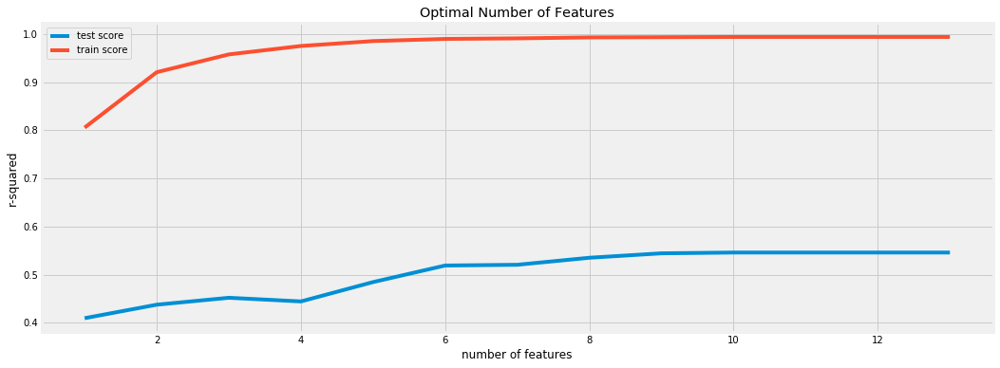

In [87]:
plt.figure(figsize = (16,6))

plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_test_score"])
plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_train_score"])
plt.xlabel('number of features')
plt.ylabel('r-squared')
plt.title("Optimal Number of Features")
plt.legend(['test score', 'train score'], loc = 'upper left')

In [88]:
# Final model - CatBoost
start_time = time.time()

n_optimal = 10

rfe = RFE(reg_cat, n_features_to_select = n_optimal)             
reg_cat_optima = rfe.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Learning rate set to 0.034446
0:	learn: 4.5572941	total: 7.26ms	remaining: 7.26s
1:	learn: 4.4902587	total: 8.99ms	remaining: 4.48s
2:	learn: 4.4253837	total: 10.9ms	remaining: 3.63s
3:	learn: 4.3662093	total: 12.3ms	remaining: 3.07s
4:	learn: 4.3077307	total: 13.9ms	remaining: 2.76s
5:	learn: 4.2523057	total: 15.4ms	remaining: 2.54s
6:	learn: 4.1981435	total: 17.1ms	remaining: 2.43s
7:	learn: 4.1449215	total: 20.3ms	remaining: 2.52s
8:	learn: 4.0947864	total: 24.9ms	remaining: 2.74s
9:	learn: 4.0424012	total: 27.7ms	remaining: 2.74s
10:	learn: 3.9904097	total: 29.7ms	remaining: 2.67s
11:	learn: 3.9404084	total: 31.5ms	remaining: 2.59s
12:	learn: 3.8986094	total: 32.9ms	remaining: 2.5s
13:	learn: 3.8506734	total: 34.3ms	remaining: 2.42s
14:	learn: 3.8074714	total: 36.3ms	remaining: 2.38s
15:	learn: 3.7655093	total: 37.8ms	remaining: 2.33s
16:	learn: 3.7242996	total: 39.5ms	remaining: 2.28s
17:	learn: 3.6907999	total: 60.1ms	remaining: 3.28s
18:	learn: 3.6512823	total: 61.6ms	remaining:

215:	learn: 1.7429979	total: 465ms	remaining: 1.69s
216:	learn: 1.7406258	total: 467ms	remaining: 1.68s
217:	learn: 1.7362550	total: 469ms	remaining: 1.68s
218:	learn: 1.7291673	total: 470ms	remaining: 1.68s
219:	learn: 1.7244486	total: 472ms	remaining: 1.67s
220:	learn: 1.7209180	total: 474ms	remaining: 1.67s
221:	learn: 1.7168374	total: 481ms	remaining: 1.68s
222:	learn: 1.7126978	total: 483ms	remaining: 1.68s
223:	learn: 1.7068127	total: 486ms	remaining: 1.68s
224:	learn: 1.7008161	total: 488ms	remaining: 1.68s
225:	learn: 1.6963034	total: 489ms	remaining: 1.68s
226:	learn: 1.6939424	total: 491ms	remaining: 1.67s
227:	learn: 1.6909895	total: 492ms	remaining: 1.67s
228:	learn: 1.6877881	total: 494ms	remaining: 1.66s
229:	learn: 1.6833877	total: 498ms	remaining: 1.67s
230:	learn: 1.6789358	total: 501ms	remaining: 1.67s
231:	learn: 1.6765310	total: 503ms	remaining: 1.67s
232:	learn: 1.6728960	total: 505ms	remaining: 1.66s
233:	learn: 1.6716909	total: 507ms	remaining: 1.66s
234:	learn: 

434:	learn: 1.1053765	total: 926ms	remaining: 1.2s
435:	learn: 1.1050597	total: 928ms	remaining: 1.2s
436:	learn: 1.1023057	total: 930ms	remaining: 1.2s
437:	learn: 1.1019999	total: 933ms	remaining: 1.2s
438:	learn: 1.1011777	total: 934ms	remaining: 1.19s
439:	learn: 1.0997995	total: 936ms	remaining: 1.19s
440:	learn: 1.0971995	total: 937ms	remaining: 1.19s
441:	learn: 1.0949532	total: 939ms	remaining: 1.19s
442:	learn: 1.0934061	total: 940ms	remaining: 1.18s
443:	learn: 1.0906280	total: 942ms	remaining: 1.18s
444:	learn: 1.0896750	total: 944ms	remaining: 1.18s
445:	learn: 1.0883296	total: 947ms	remaining: 1.18s
446:	learn: 1.0859227	total: 950ms	remaining: 1.18s
447:	learn: 1.0831455	total: 952ms	remaining: 1.17s
448:	learn: 1.0800492	total: 953ms	remaining: 1.17s
449:	learn: 1.0776736	total: 955ms	remaining: 1.17s
450:	learn: 1.0773672	total: 956ms	remaining: 1.16s
451:	learn: 1.0772197	total: 958ms	remaining: 1.16s
452:	learn: 1.0760290	total: 959ms	remaining: 1.16s
453:	learn: 1.07

648:	learn: 0.7661605	total: 1.38s	remaining: 747ms
649:	learn: 0.7631590	total: 1.38s	remaining: 745ms
650:	learn: 0.7616387	total: 1.38s	remaining: 742ms
651:	learn: 0.7595528	total: 1.39s	remaining: 740ms
652:	learn: 0.7590459	total: 1.39s	remaining: 737ms
653:	learn: 0.7585754	total: 1.39s	remaining: 735ms
654:	learn: 0.7581905	total: 1.39s	remaining: 734ms
655:	learn: 0.7576039	total: 1.4s	remaining: 732ms
656:	learn: 0.7558892	total: 1.4s	remaining: 730ms
657:	learn: 0.7554121	total: 1.4s	remaining: 728ms
658:	learn: 0.7549989	total: 1.4s	remaining: 725ms
659:	learn: 0.7536904	total: 1.4s	remaining: 723ms
660:	learn: 0.7529456	total: 1.41s	remaining: 721ms
661:	learn: 0.7524523	total: 1.41s	remaining: 719ms
662:	learn: 0.7522149	total: 1.41s	remaining: 716ms
663:	learn: 0.7517395	total: 1.41s	remaining: 714ms
664:	learn: 0.7514592	total: 1.42s	remaining: 713ms
665:	learn: 0.7487026	total: 1.42s	remaining: 711ms
666:	learn: 0.7480284	total: 1.42s	remaining: 709ms
667:	learn: 0.747

844:	learn: 0.5645705	total: 1.84s	remaining: 339ms
845:	learn: 0.5638713	total: 1.85s	remaining: 337ms
846:	learn: 0.5635644	total: 1.85s	remaining: 335ms
847:	learn: 0.5627059	total: 1.85s	remaining: 332ms
848:	learn: 0.5622020	total: 1.85s	remaining: 330ms
849:	learn: 0.5621059	total: 1.86s	remaining: 328ms
850:	learn: 0.5606734	total: 1.86s	remaining: 325ms
851:	learn: 0.5601357	total: 1.86s	remaining: 323ms
852:	learn: 0.5589957	total: 1.86s	remaining: 321ms
853:	learn: 0.5572508	total: 1.86s	remaining: 319ms
854:	learn: 0.5564752	total: 1.87s	remaining: 317ms
855:	learn: 0.5553870	total: 1.87s	remaining: 315ms
856:	learn: 0.5549258	total: 1.87s	remaining: 312ms
857:	learn: 0.5534627	total: 1.87s	remaining: 310ms
858:	learn: 0.5526272	total: 1.88s	remaining: 308ms
859:	learn: 0.5521980	total: 1.88s	remaining: 306ms
860:	learn: 0.5515567	total: 1.88s	remaining: 303ms
861:	learn: 0.5514965	total: 1.88s	remaining: 301ms
862:	learn: 0.5496801	total: 1.88s	remaining: 299ms
863:	learn: 

In [89]:
# R2 score model with hold-out set 
print(metrics.r2_score(y_train, reg_cat.predict(X_train)))
print(metrics.r2_score(y_test, reg_cat.predict(X_test)))

0.9907544390605402
0.36369110832013285


In [90]:
# R2 score model with optimal Ada model 
print(metrics.r2_score(y_train, reg_cat_optima.predict(X_train)))
print(metrics.r2_score(y_test, reg_cat_optima.predict(X_test)))

0.9907544390605402
0.36369110832013285


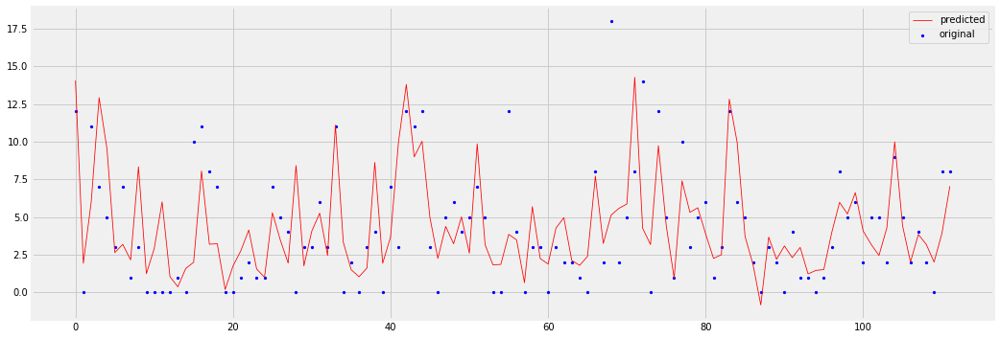

In [91]:
plt.figure(figsize = (16,6))

x_ax = range(len(y_test))
plt.scatter(x_ax, y_test, s = 5, color = "blue", label = "original")
plt.plot(x_ax, reg_cat_optima.predict(X_test), lw = 0.8, color = "red", label = "predicted")
plt.legend()
plt.show()